In [30]:
######################################### Libraries ##############################################

import numpy as np
import matplotlib
from matplotlib import pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
%matplotlib inline     

import tigramite
from tigramite import data_processing as pp
from tigramite.toymodels import structural_causal_processes as toys
from tigramite.toymodels import surrogate_generator 
from tigramite import plotting as tp
from tigramite.pcmci import PCMCI
from tigramite.independence_tests.parcorr import ParCorr
from tigramite.independence_tests.robust_parcorr import RobustParCorr
from tigramite.models import Models, Prediction

import math
import sklearn
from sklearn.linear_model import LinearRegression
import pandas as pd
from tigramite.independence_tests.parcorr_wls import ParCorrWLS 


In [31]:
cd

/Users/alondraalvarez


In [32]:
cd Desktop/REU 2025

/Users/alondraalvarez/Desktop/REU 2025


In [40]:
site = "S2"

path = f"{site}_data/30_min_CO2_aerosols/"

# Events
Events = pd.read_csv(path + f"{site}_resumen_night_10h.csv")

morning_events = list(zip(
    pd.to_datetime(Events['start_time']),
    pd.to_datetime(Events['end_time'])))

########################################################################################

# only_rainy_times = pd.read_csv(path + f"{site}_30_min_continuous_rain_periods.csv")

# start_r = rainy_times.extended_start
# end_r   = rainy_times.extended_end

# only_r_events = list(zip(
#     pd.to_datetime(only_rainy_times['extended_start']),
#     pd.to_datetime(only_rainy_times['extended_start'])))

In [41]:
Events 

,period,start_time,end_time,duration_hours,avg_precip
0,evening,2024-12-01 16:00:00,2024-12-02 02:00:00,10,0.000
1,evening,2024-12-02 16:00:00,2024-12-03 02:00:00,10,0.000
2,evening,2024-12-03 16:00:00,2024-12-04 02:00:00,10,0.000
3,evening,2024-12-04 16:00:00,2024-12-05 02:00:00,10,0.000
4,evening,2024-12-05 16:00:00,2024-12-06 02:00:00,10,0.000
...,...,...,...,...,...
162,evening,2025-06-06 16:00:00,2025-06-07 02:00:00,10,0.123
163,evening,2025-06-07 16:00:00,2025-06-08 02:00:00,10,0.178
164,evening,2025-06-08 16:00:00,2025-06-09 02:00:00,10,0.666
165,evening,2025-06-09 16:00:00,2025-06-10 02:00:00,10,0.008


Negative precipitation values in event 0: 0


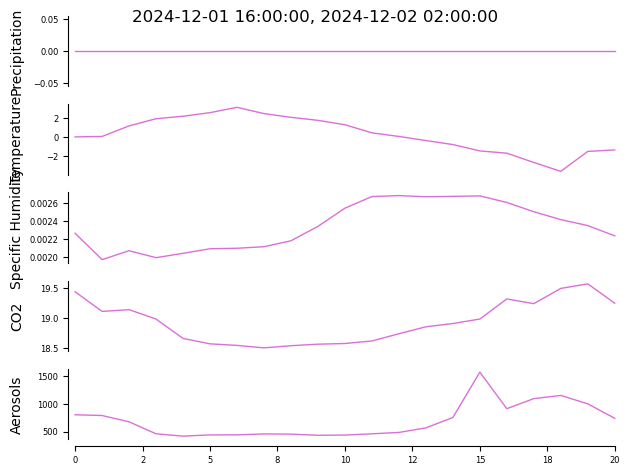


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


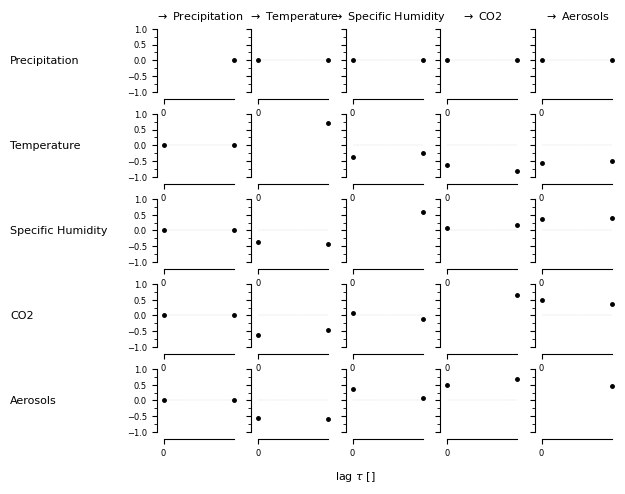

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.02004, |min_val| =  0.542

    Variable Specific Humidity has 1 link(s):
       

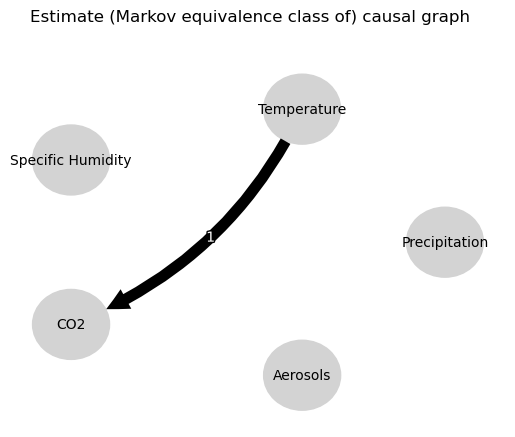

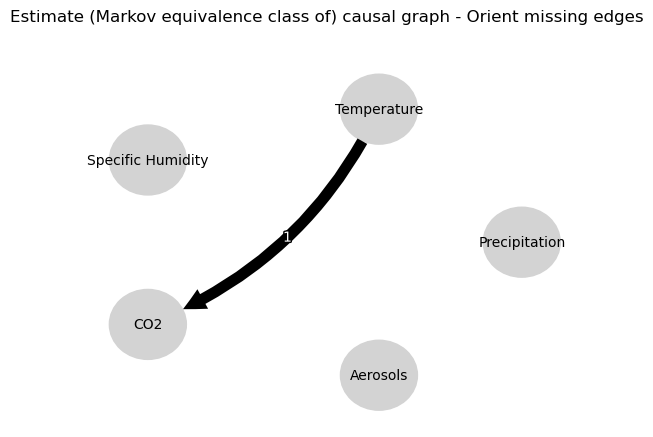

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.4526381520135014
-0.20001900393619643
0.18440172475469457
-0.3288157099121154
-0.6975404605055885
-0.1104943425782051
0.03854949846253998
-0.20001900393619643
-0.1367610755551098
0.0
-0.07819515673287422
-0.3933313994811057
0.22998516969620555
0.26009562823426824
-0.03396530605694353
-0.3288157099121154
-0.2170698512189662
-0.3933313994811057
-0.02946363145161253
0.0
0.3003202563470796
-0.016772493661331166
0.02346730905489398
-0.1104943425782051
-0.0572642044653896
0.26009562823426824
-0.03695120939578219
-0.016772493661331166
0.10331419664198291
0.0
-0.045829378279399216


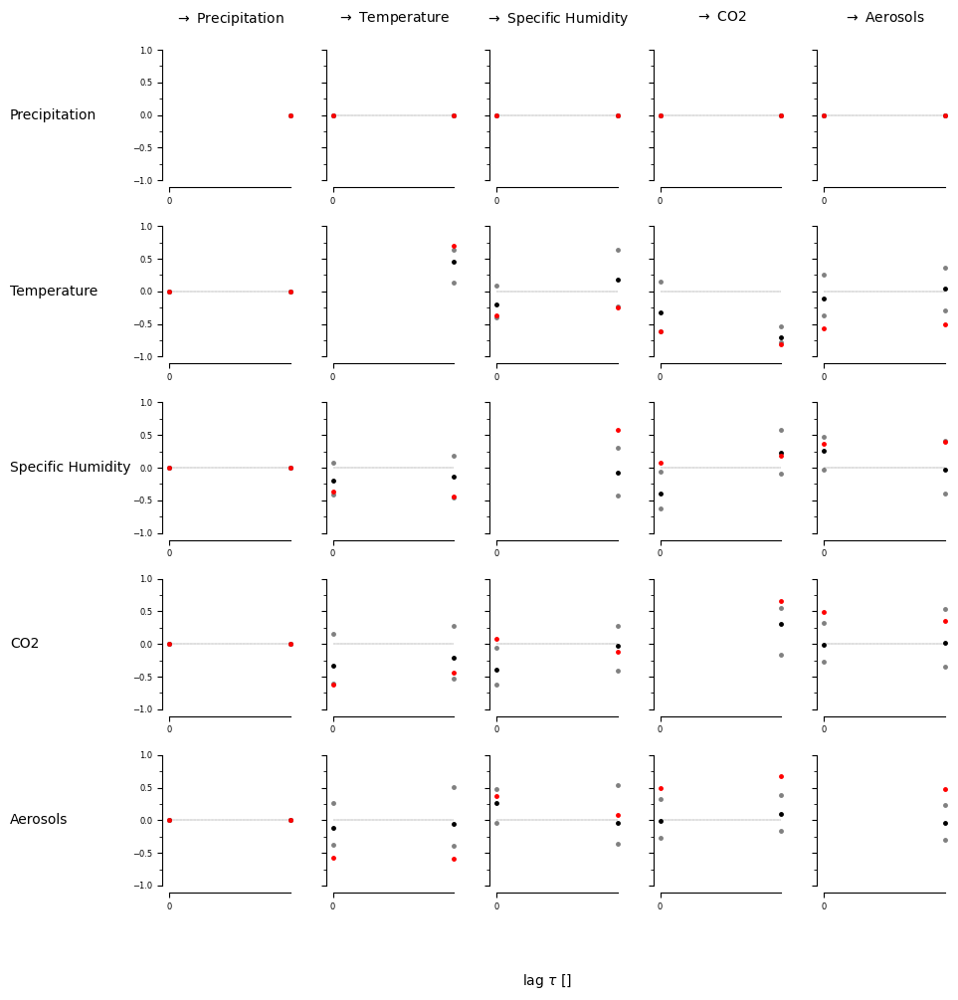

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False  True]
  [False False]]]


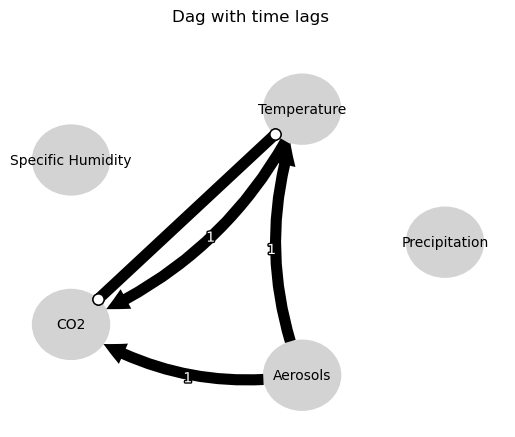

Negative precipitation values in event 1: 0


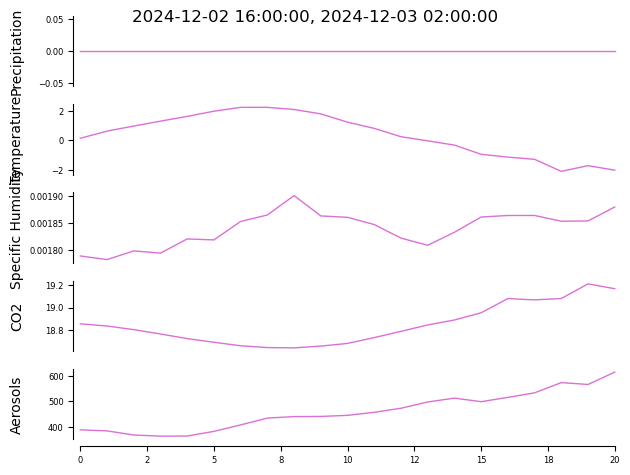


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


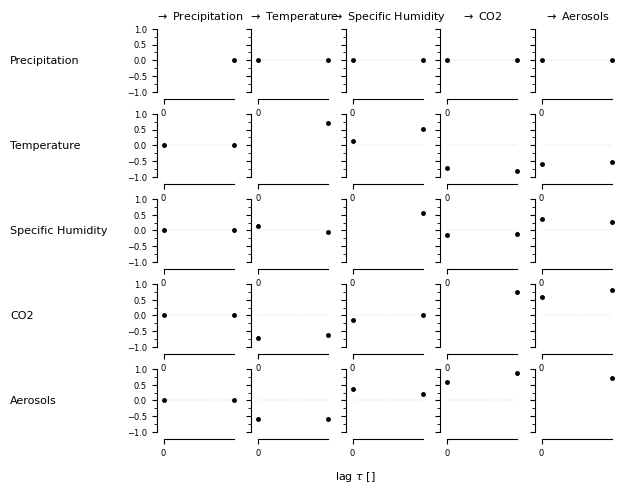

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.03711, |min_val| =  0.494



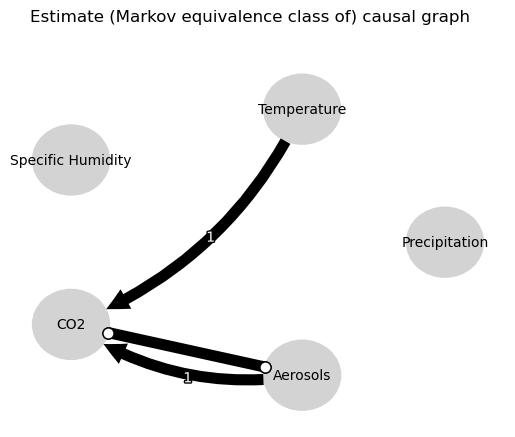

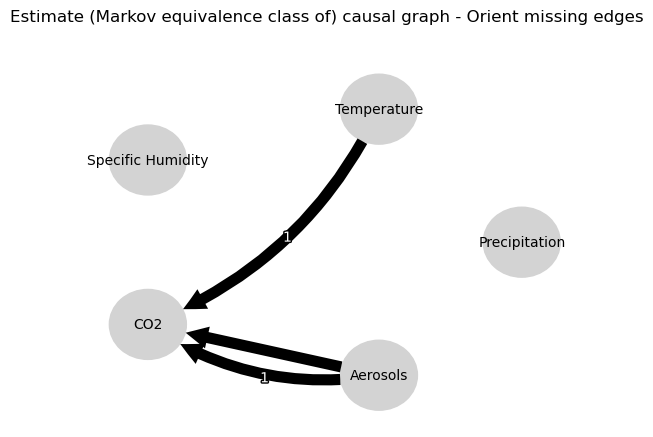

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.009166110724349742
-0.0040985363811706
0.06798710465041578
-0.052681403230784137
-0.7953128049067649
-0.6935985477024048
0.020891085098201045
-0.0040985363811706
-0.00020687898339704174
0.0
0.3884281235162899
0.0012994521880373459
0.004747709946720789
0.11514565660142996
-0.031723840060526025
-0.052681403230784137
-0.052358277329509824
0.0012994521880373459
-0.040009271451187337
0.0
-0.014863404928591268
0.040917588227393616
0.017884779715410543
-0.6935985477024048
-0.008154469550221847
0.11514565660142996
0.03112148325400798
0.040917588227393616
0.7694793711274546
0.0
-0.045829378279399216


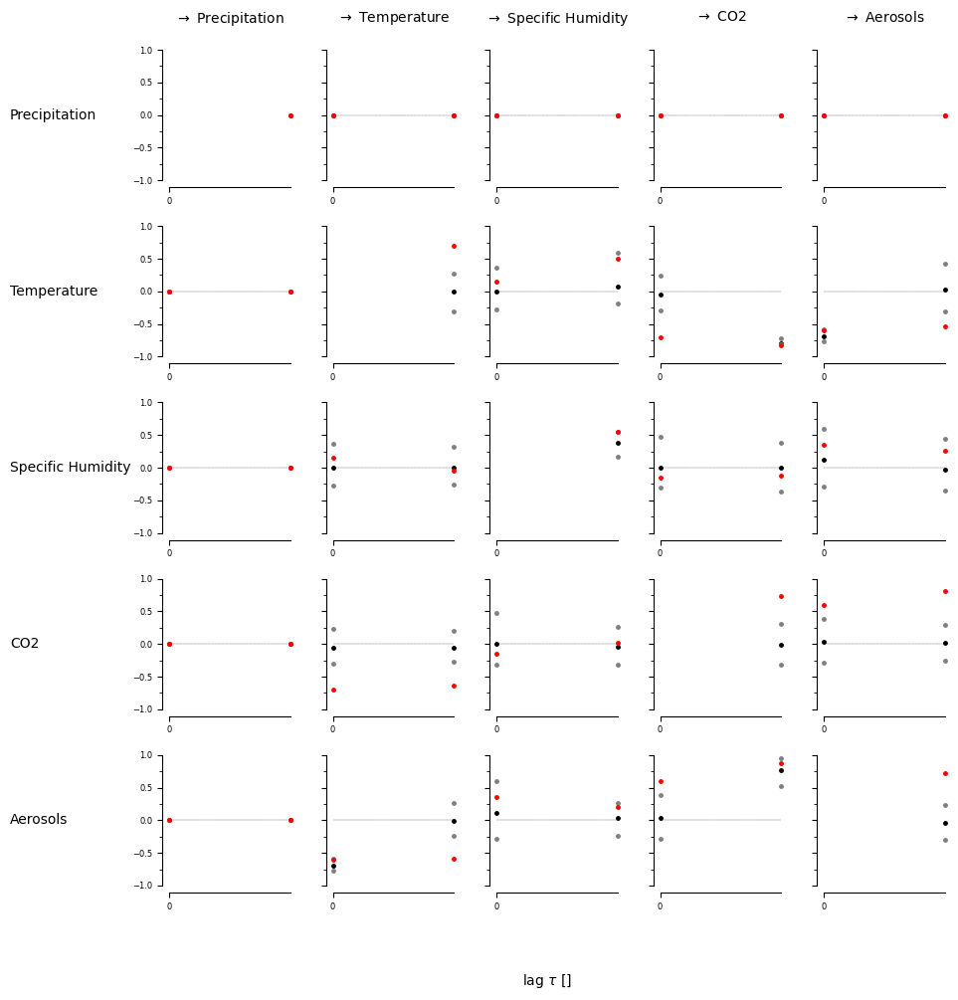

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [ True  True]
  [False  True]]]


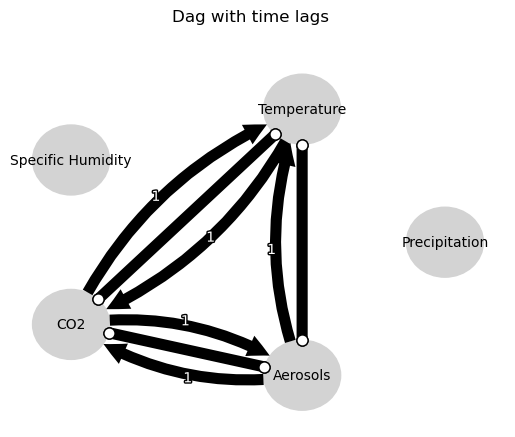

Negative precipitation values in event 2: 0


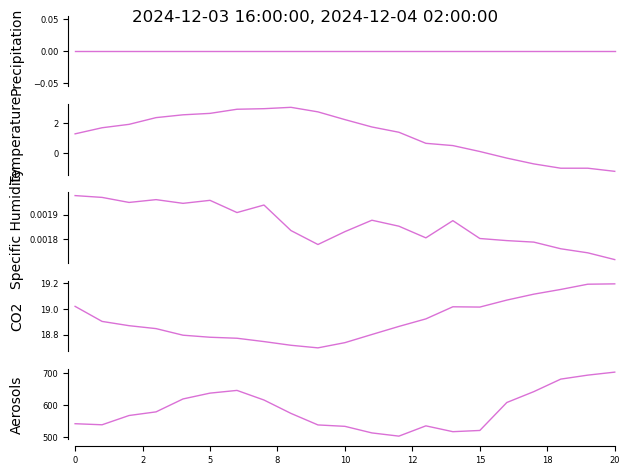


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


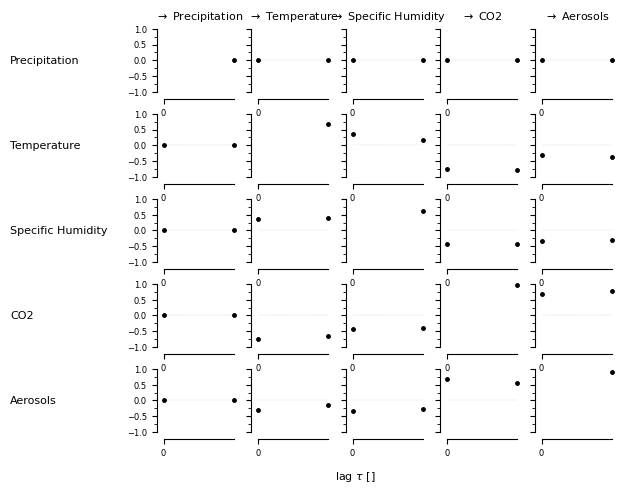

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00647, |min_val| =  0.601



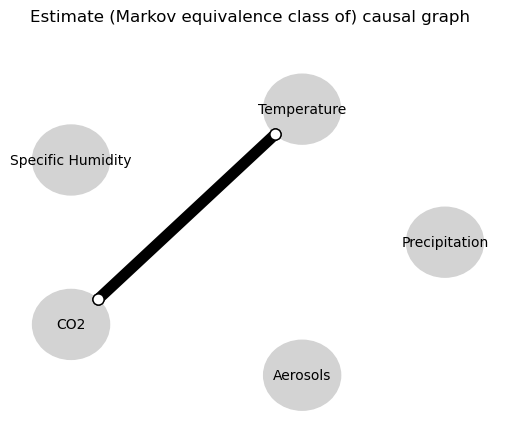

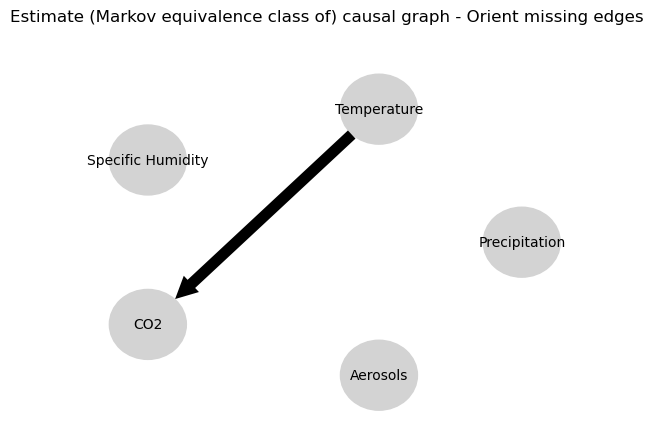

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.023896579126705078
0.6932991514132063
0.009500252743686377
-0.7050652485957011
-0.2574843916912846
-0.22834663210191908
-0.15466277272271267
0.6932991514132063
-0.014480048703246588
0.0
-0.03520524188720204
-0.4862928815509438
-0.14680769357033943
-0.09054326717881415
-0.06469058049745803
-0.7050652485957011
0.060615640796895104
-0.4862928815509438
0.04253452497884687
0.0
0.24651823947738122
0.3081790559648209
0.1873898920705874
-0.22834663210191908
0.10025835718885062
-0.09054326717881415
0.03324793545801464
0.3081790559648209
0.030138650117331835
0.0
0.5284394784734805


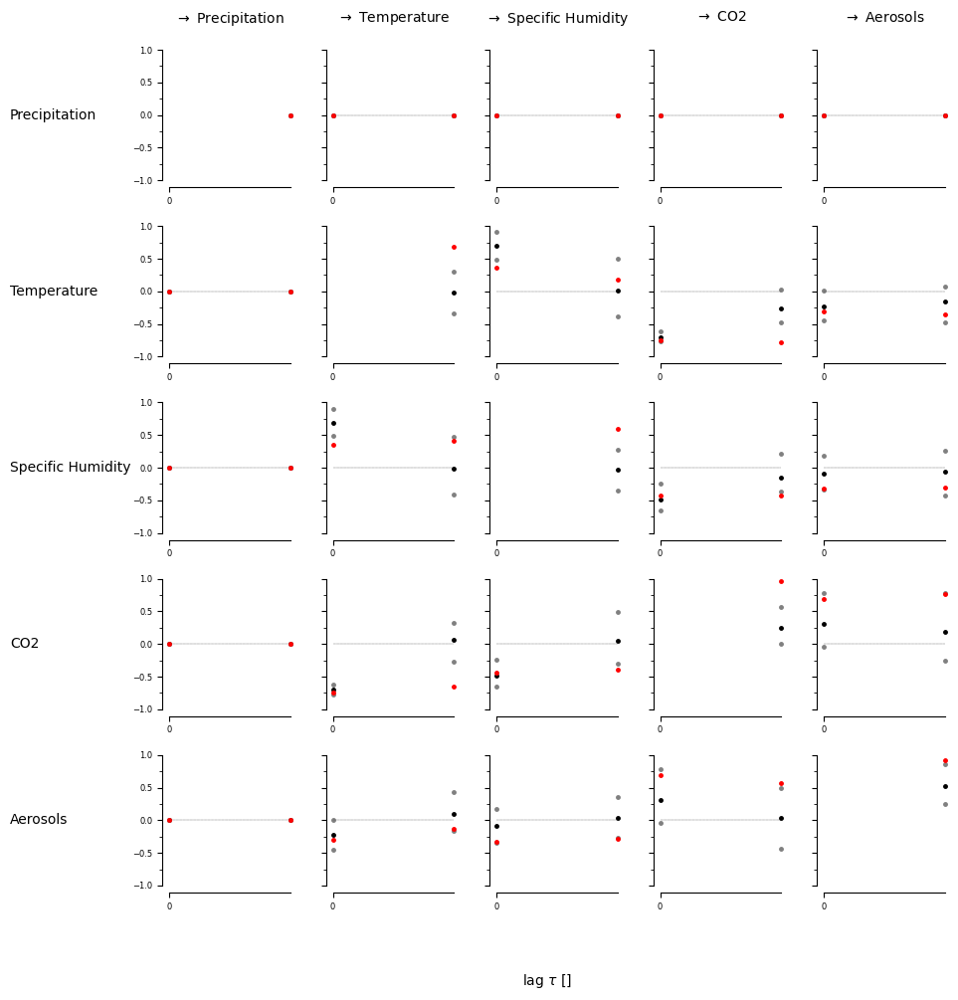

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False  True]]]


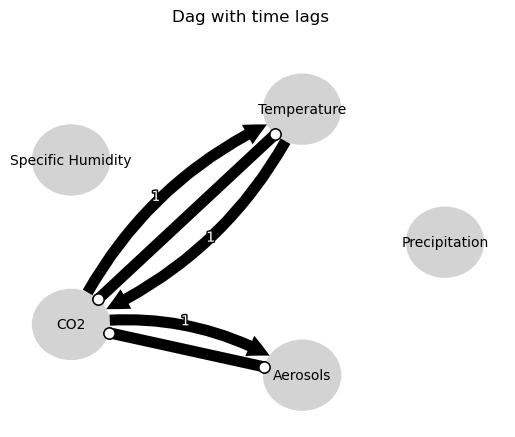

Negative precipitation values in event 3: 0


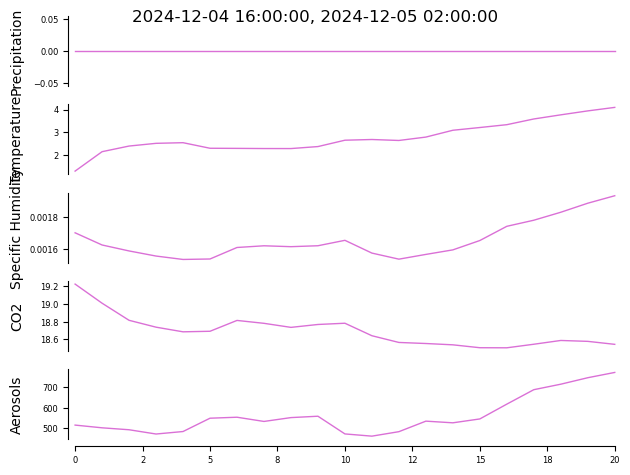


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


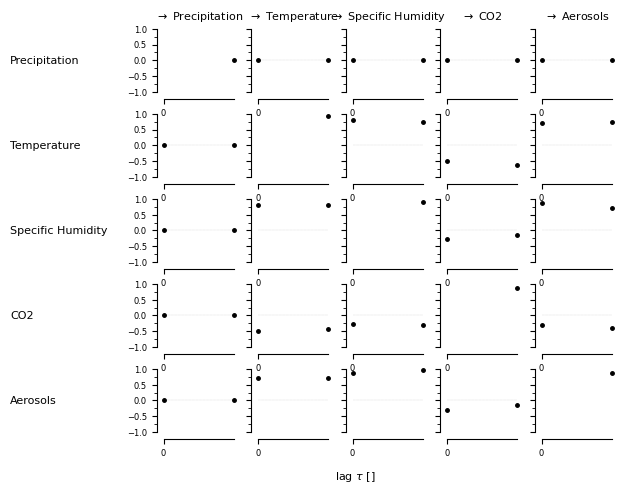

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 2 link(s):
        (Temperature -1): max_pval = 0.00000, |min_val| =  0.875
        (Specific Humidity -1): max_pval = 0.04091, |m

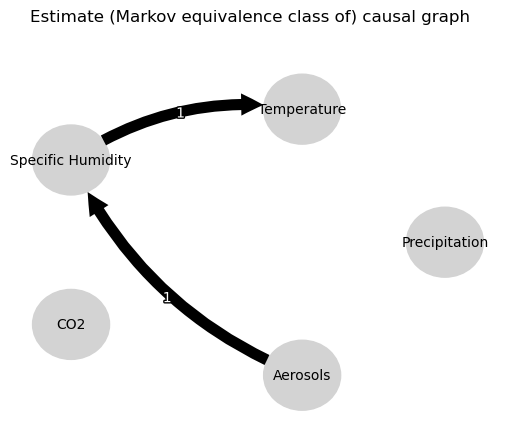

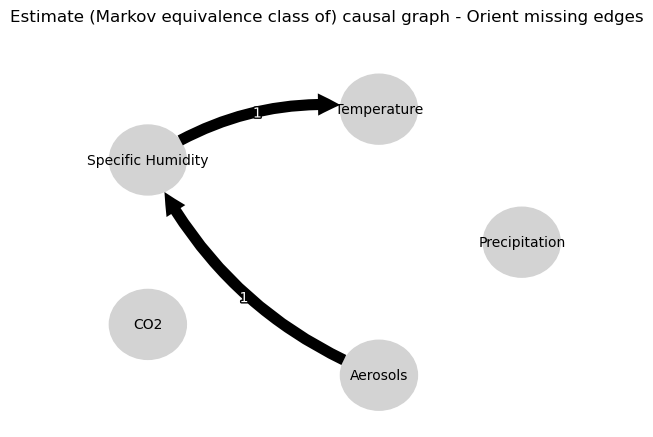

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.7969350435881598
0.722318853912262
0.6518876547156448
0.03779993727044847
0.06927864008452822
0.5622159652776636
0.5513311451084538
0.722318853912262
0.7509446527452462
0.0
0.7396043939347648
0.02316507673026279
0.05177424483321948
0.7567169130120265
0.5877329679023605
0.03779993727044847
0.016974155022399122
0.02316507673026279
0.0015651088853967743
0.0
0.308486631853125
0.021396757109042753
0.02414679051655485
0.5622159652776636
0.6084888078551419
0.7567169130120265
0.8128407139718113
0.021396757109042753
0.06476321793791132
0.0
0.6855486195080925


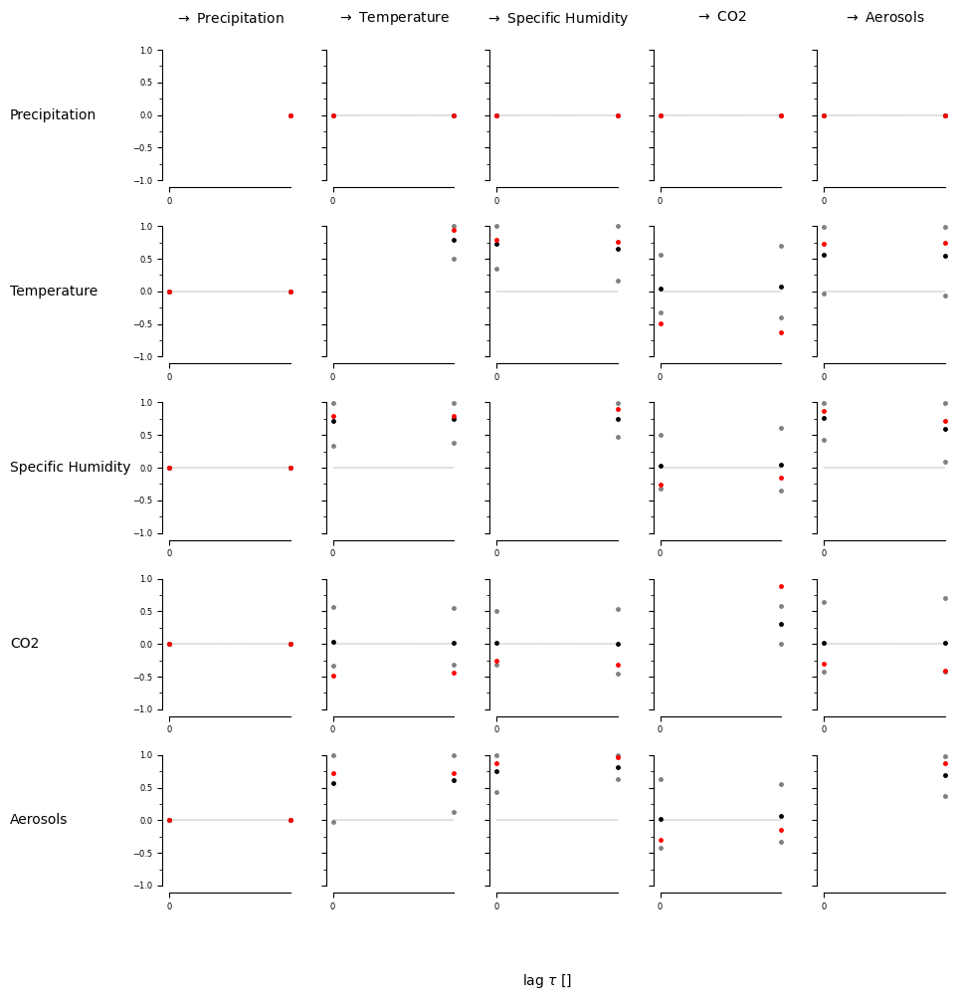

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [ True  True]
  [ True  True]
  [False False]
  [False  True]]]


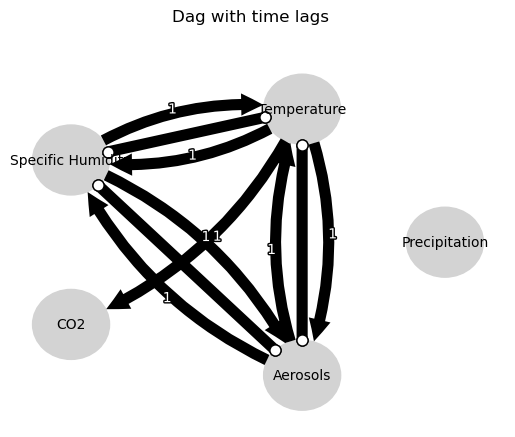

Negative precipitation values in event 4: 0


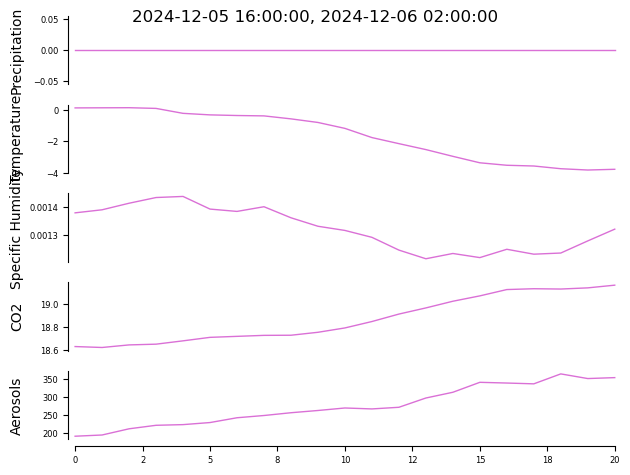


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


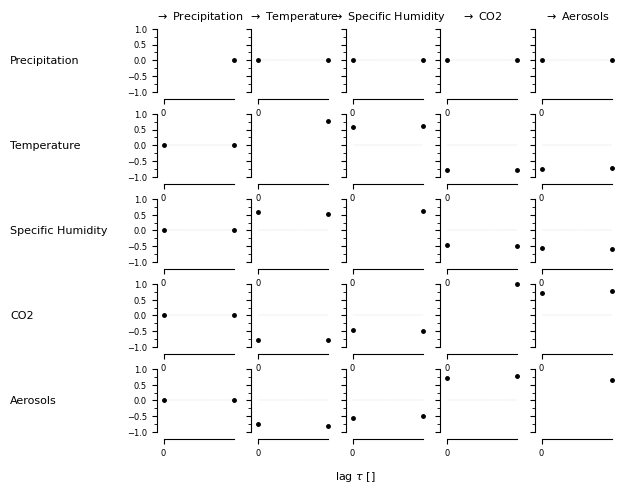

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 2 link(s):
        (Aerosols -1): max_pval = 0.01121, |min_val| =  0.582
        (CO2 -1): max_pval = 0.04197, |min_val| =  0.484


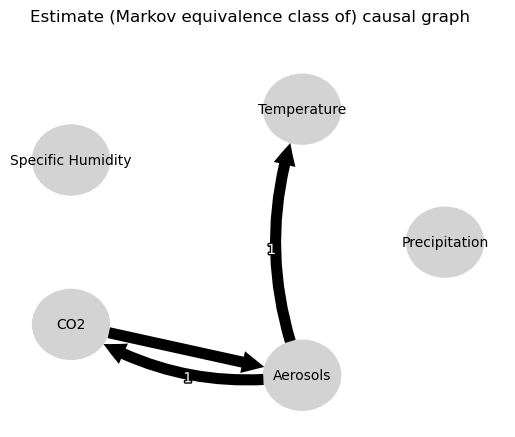

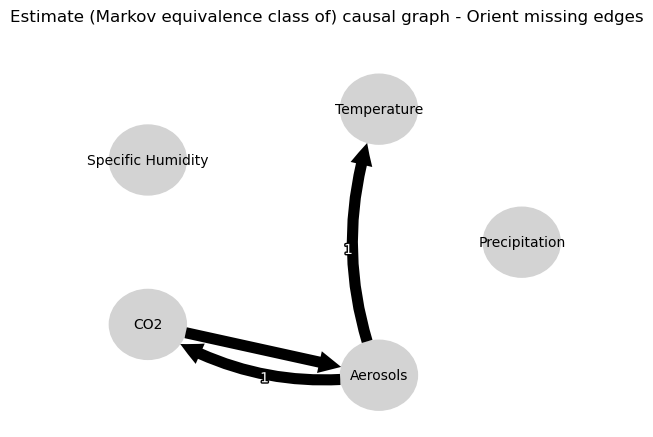

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.06268767623984525
0.20019388112702494
-0.07938868349817788
-0.3832122308198534
-0.2947460543961066
-0.0005875247918413315
-0.28460181689523323
0.20019388112702494
-0.004608607987024222
0.0
-0.03344354799790523
-0.08513406441109526
-0.046779622785623046
0.0076527350200822335
-0.03423852944535091
-0.3832122308198534
-0.19345939908608634
-0.08513406441109526
0.13413477587117714
0.0
0.5533618817786957
0.4494962485239327
0.5687594471559677
-0.0005875247918413315
-0.47385965407192127
0.0076527350200822335
0.12153973075572802
0.4494962485239327
0.31713118446958505
0.0
0.28773983225287125


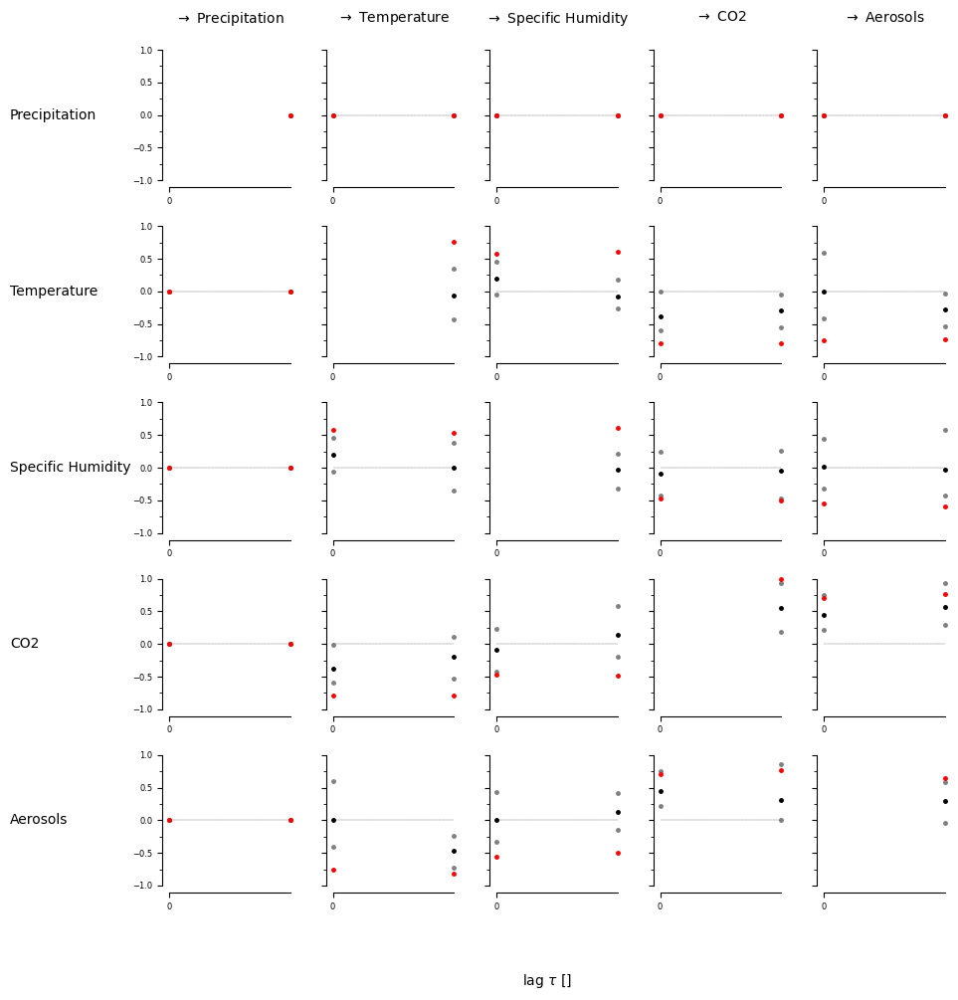

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True False]
  [False  True]
  [False False]
  [False  True]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [ True  True]
  [False  True]]]


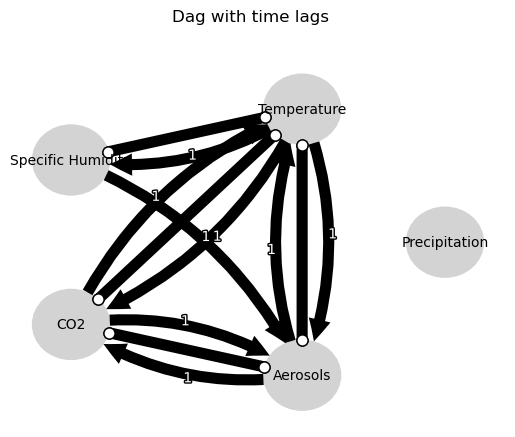

Negative precipitation values in event 5: 0


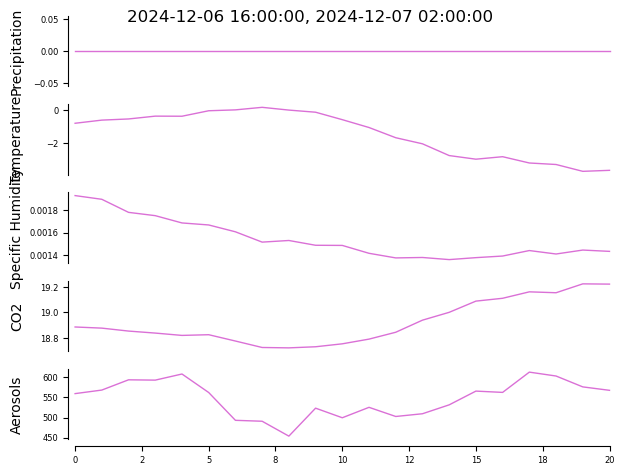


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


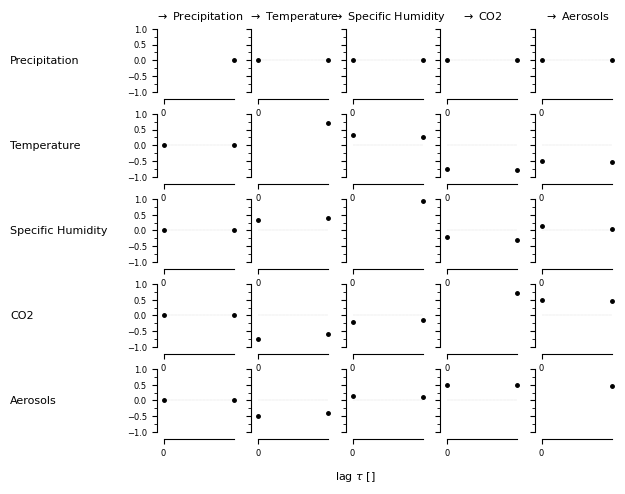

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.03541, |min_val| =  0.498

    Variable Specific Humidity has 1 link(s):
       

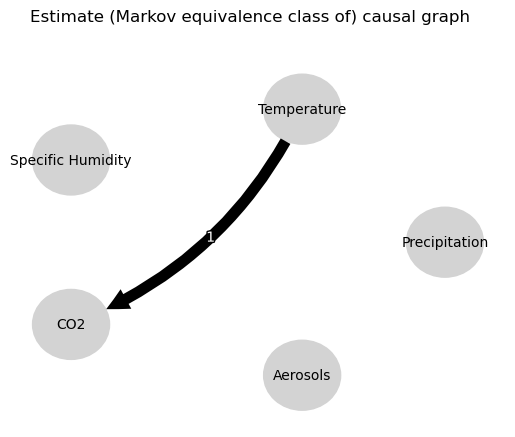

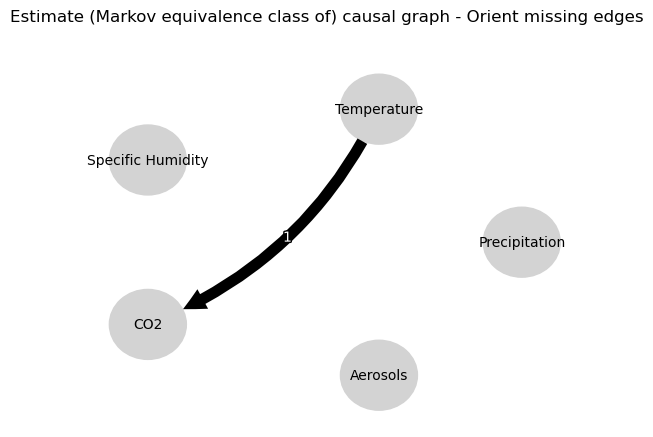

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.6343481824313658
0.03802902630938958
-0.02365074818988044
-0.5270868347751559
-0.7445834742287827
0.01663369791399351
-0.20868482183685325
0.03802902630938958
0.04277450335051669
0.0
0.4399915660192864
0.09055791776723404
-0.11348896025047218
0.09342271950992284
-0.10057923961143028
-0.5270868347751559
-0.4087251732185522
0.09055791776723404
0.06357847143593218
0.0
0.48444192957637355
0.341161701988603
0.1475805076703923
0.01663369791399351
0.04114769730716168
0.09342271950992284
-0.019212041097714
0.341161701988603
-0.08239530265926308
0.0
-0.0438664419562254


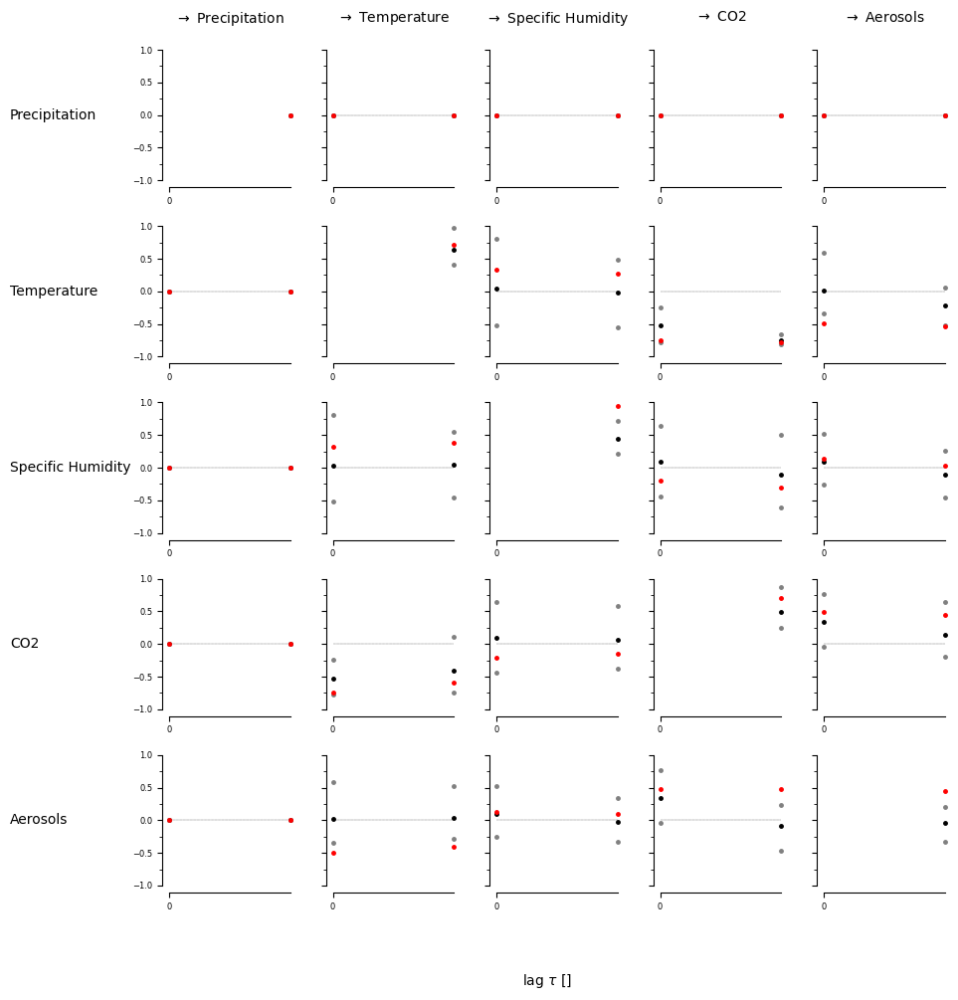

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


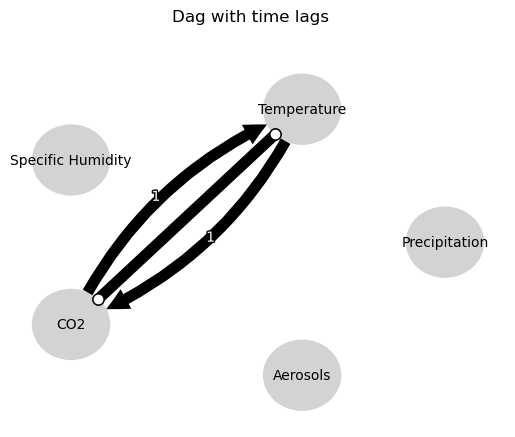

Negative precipitation values in event 6: 0


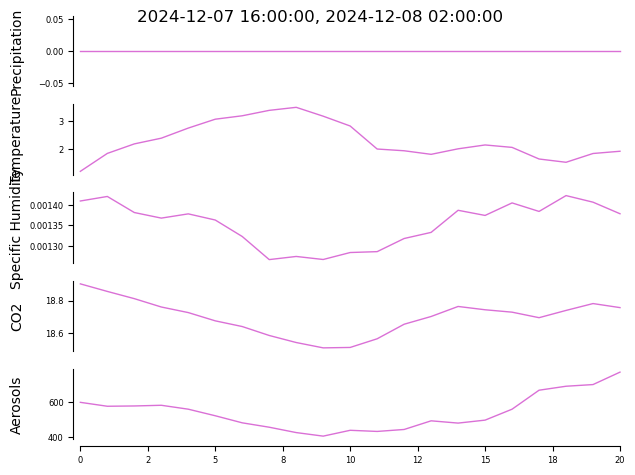


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


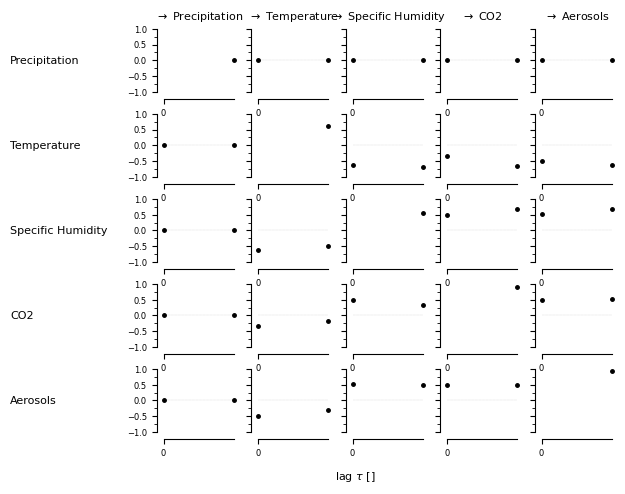

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Temperature -1): max_pval = 0.02629, |min_val| =  0.522

    Va

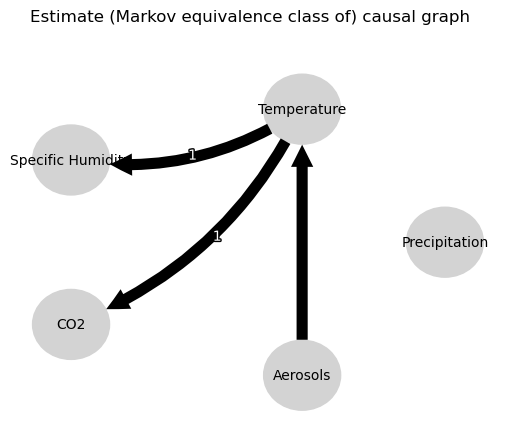

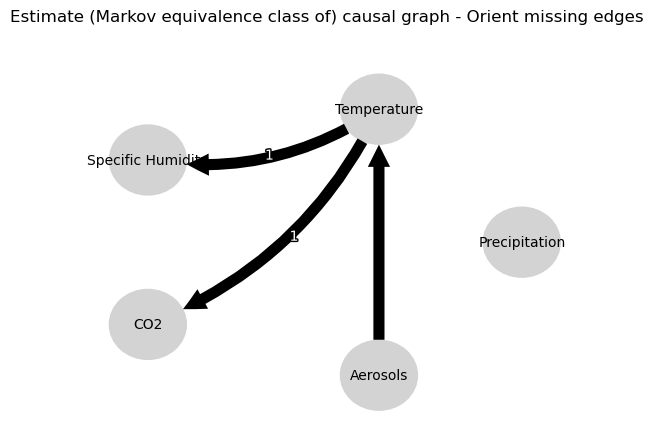

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.20722826962806692
-0.04620078368175757
-0.6705015700259335
-0.21820104043033453
-0.6973201014659062
-0.5032149676696112
-0.4392119613030571
-0.04620078368175757
-0.21733142753095713
0.0
0.058972440444260005
0.7519288607517243
0.27844424825267633
0.40734578183930925
0.32331128220317046
-0.21820104043033453
-0.21848721813684094
0.7519288607517243
0.2937774030044701
0.0
0.48043279144708756
0.5562180384034213
0.47784406558439263
-0.5032149676696112
-0.3149669343496087
0.40734578183930925
0.5102675340991621
0.5562180384034213
0.7260655769464118
0.0
0.6839143552659702


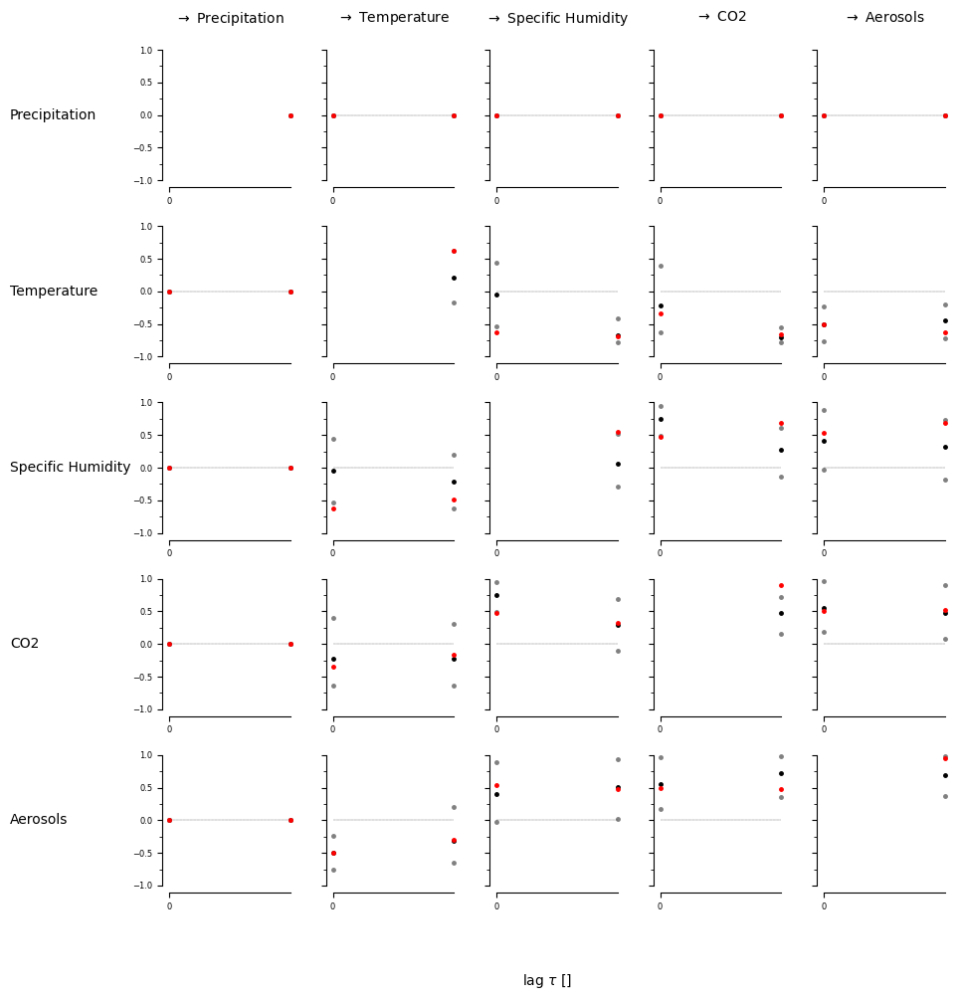

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [False  True]
  [False  True]]

 [[False False]
  [ True False]
  [False False]
  [False  True]
  [False  True]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


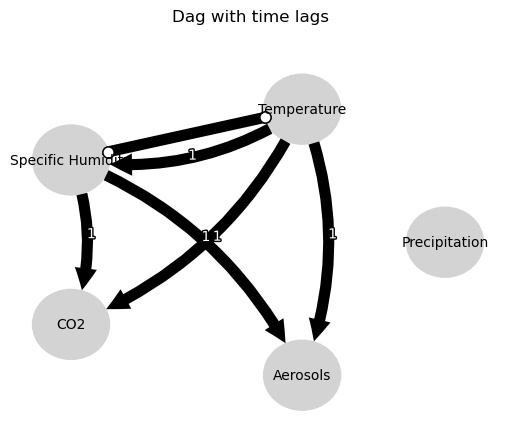

Negative precipitation values in event 7: 0


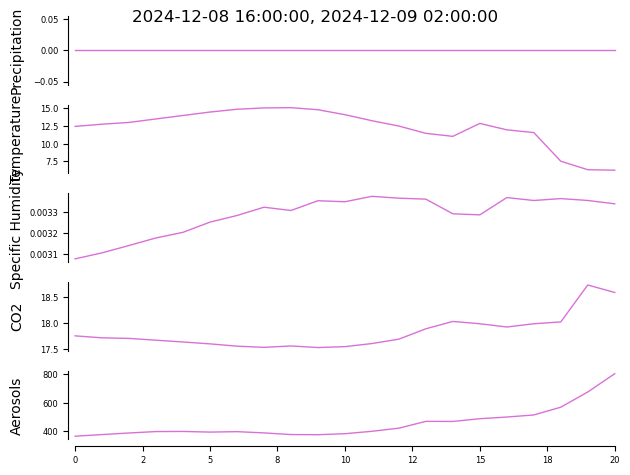


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


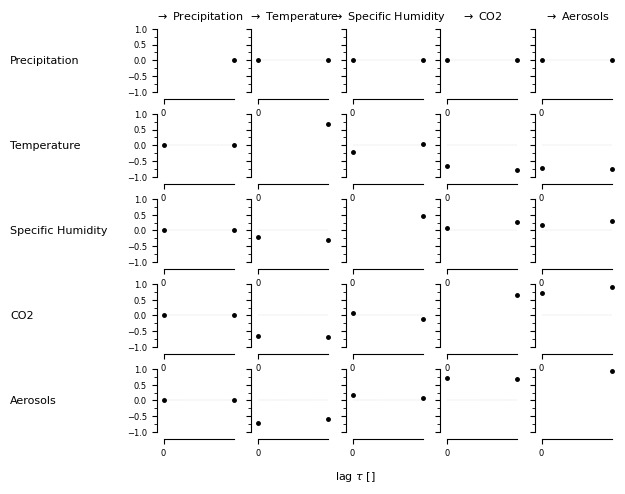

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 1 link(s):
        (Temperature -1): max_pval = 0.

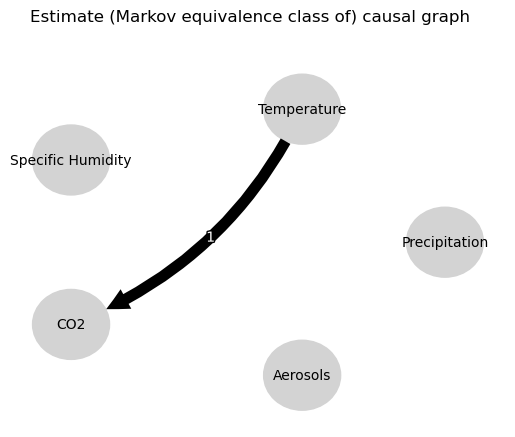

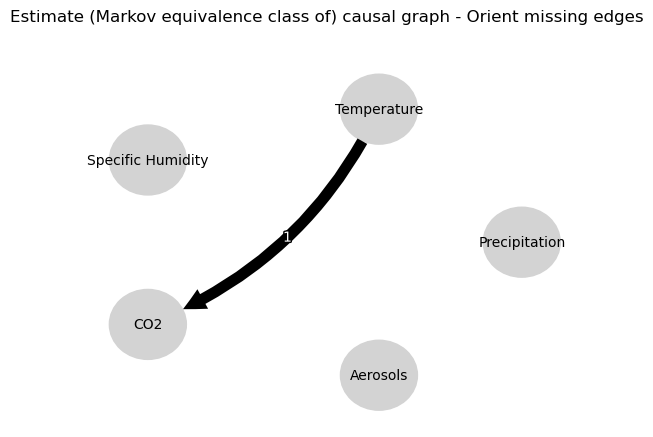

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.08378653367320928
-0.2400453454104041
-0.02729694165002623
-0.019977303330359315
-0.7846917649166013
0.043065875123867316
0.012513630448826366
-0.2400453454104041
-0.018740096227930835
0.0
-0.044316746523707914
0.08066861652705964
0.2636963336384425
-0.04569256398048281
-0.06049209454426839
-0.019977303330359315
0.050198619403857635
0.08066861652705964
0.0010030405066610746
0.0
-0.04721971326946624
0.012750048386684226
0.02499620304649967
0.043065875123867316
0.04761652290988364
-0.04569256398048281
-0.04363088722712562
0.012750048386684226
0.00037695202066942896
0.0
0.9332670864064521


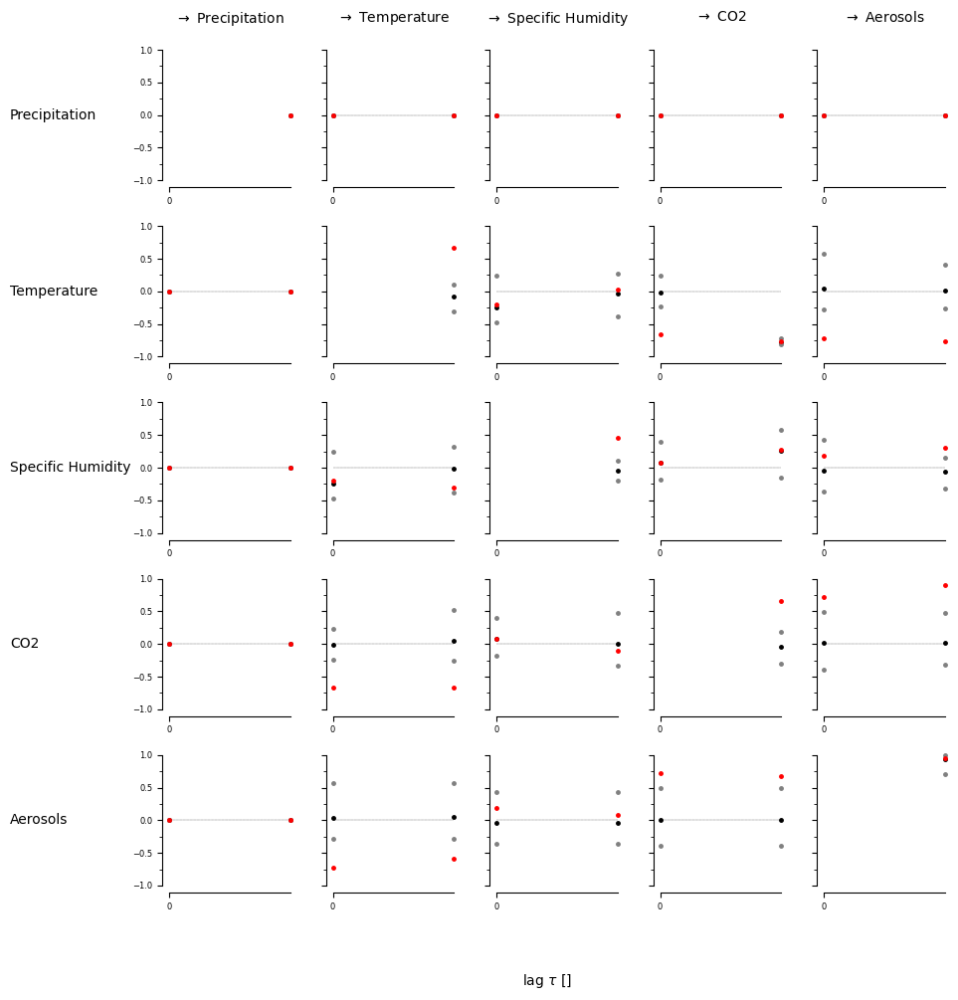

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [ True  True]
  [False  True]]]


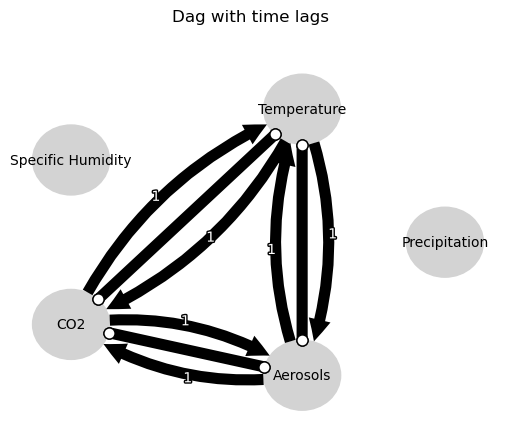

Negative precipitation values in event 8: 0


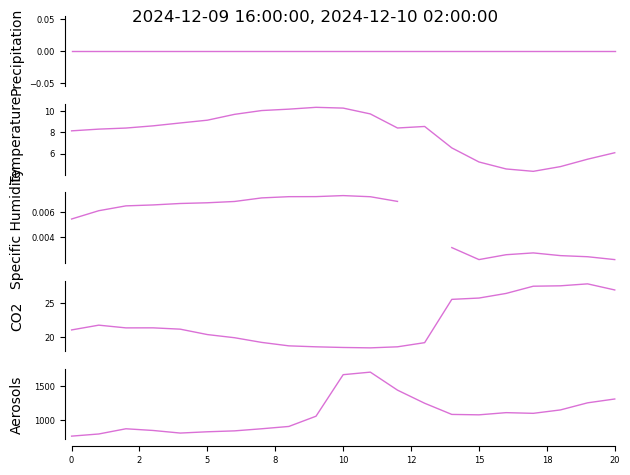


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


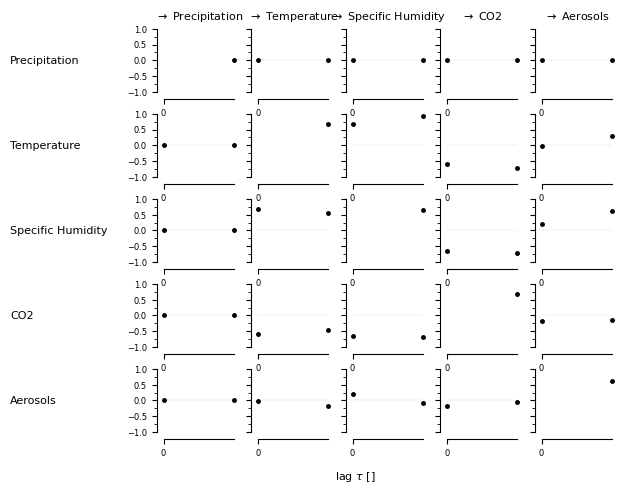

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Temperature -1): max_pval = 0.00000, |min_val| =  0.898

    Va

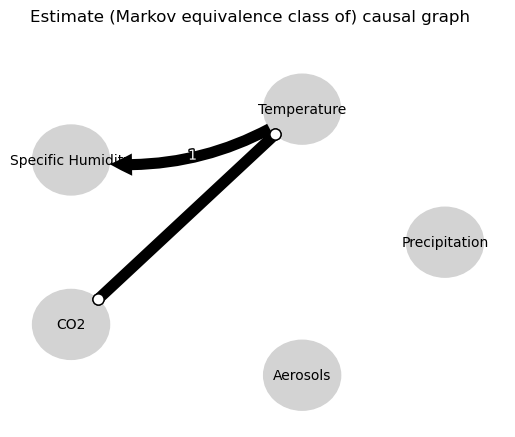

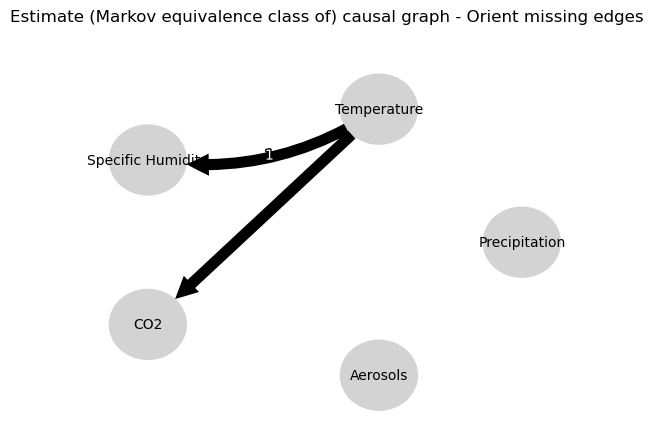

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.032488472243043
0.042097721518000966
0.8079782740227908
-0.7714475253369107
0.05236998208069989
0.1611504420404962
0.10056236093851369
0.042097721518000966
-0.05987177698227296
0.0
0.03100616843983781
-0.014441890634812504
0.0026519311766781293
0.12091228964379358
0.09751927076578792
-0.7714475253369107
0.06518766391965801
-0.014441890634812504
-0.6626076024877128
0.0
-0.10254954498727847
-0.16448295562615514
-0.07809697989423077
0.1611504420404962
-0.0291011358138157
0.12091228964379358
0.17399578624149567
-0.16448295562615514
-0.023741701184287044
0.0
0.4865305556251777


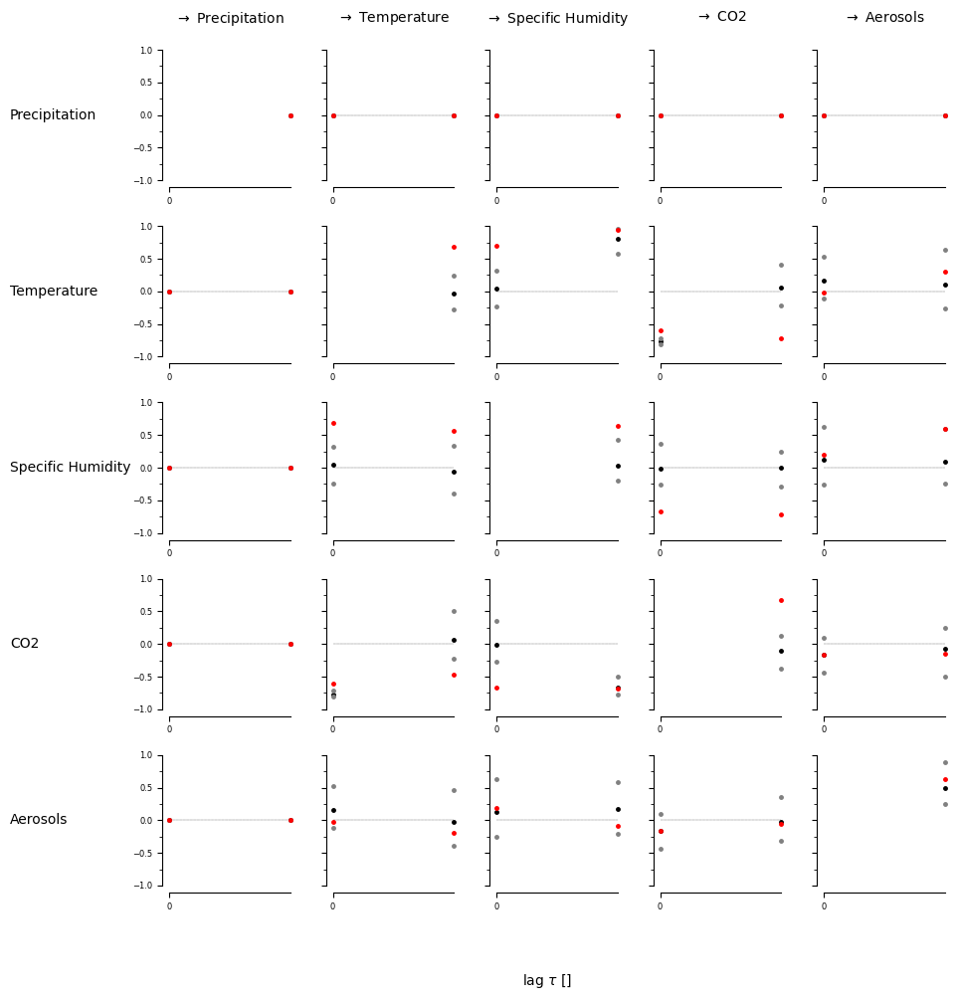

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True False]
  [False  True]
  [ True  True]
  [False  True]]

 [[False False]
  [ True False]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


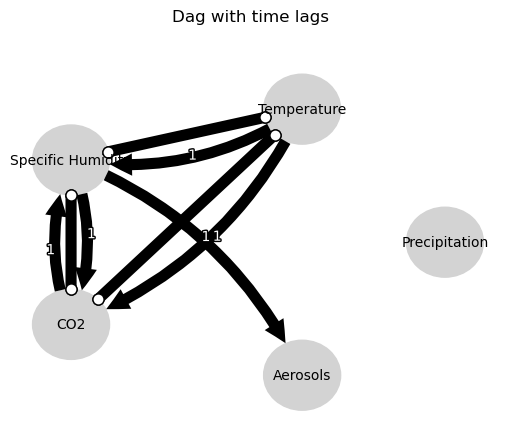

Negative precipitation values in event 9: 0


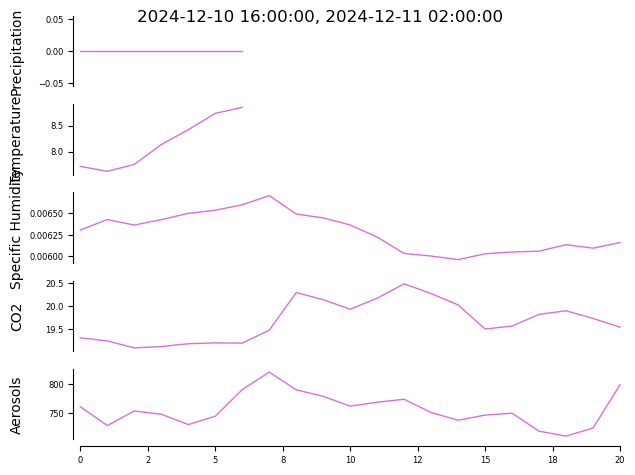


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


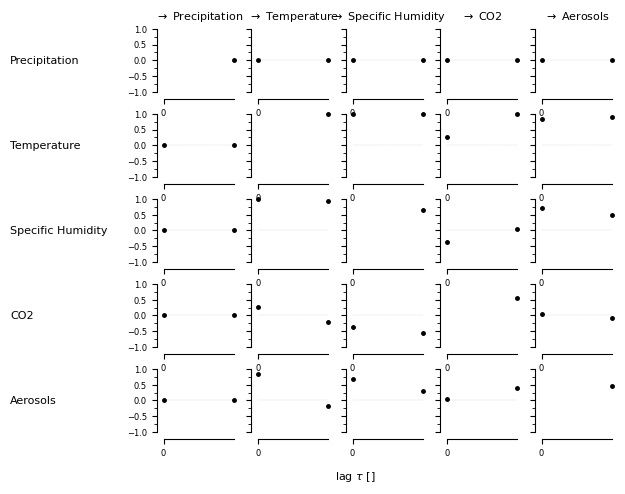

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00000, |min_val| =  1.000

    Variable Specific Humidity has 1 link(s):
       

/opt/anaconda3/lib/python3.11/site-packages/scipy/stats/_stats_py.py:4781: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))


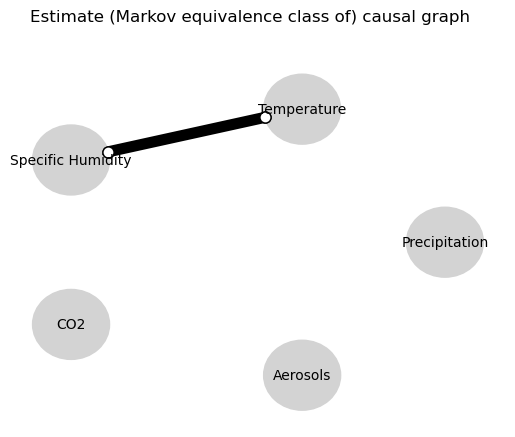

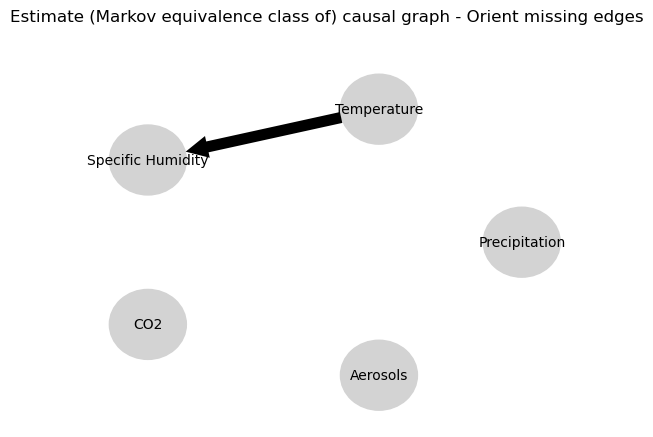

⚠️ Skipping event 10 ((Timestamp('2024-12-01 16:00:00'), Timestamp('2024-12-02 02:00:00')) → (Timestamp('2024-12-02 16:00:00'), Timestamp('2024-12-03 02:00:00'))) due to error: Less than 10 overlapping samples due to masking and/or missing values, cannot compute residual covariance!
Negative precipitation values in event 10: 0


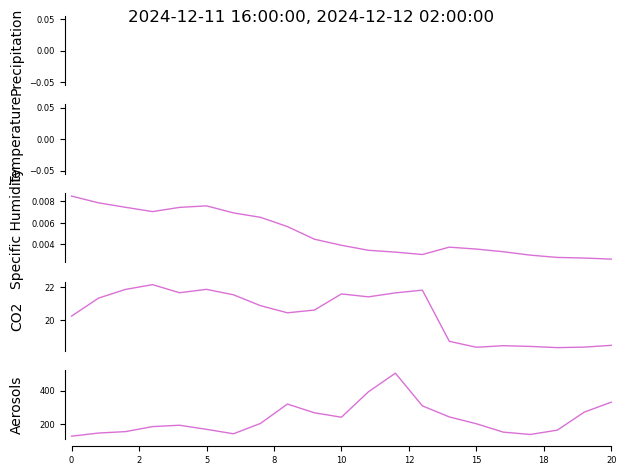


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1
⚠️ Skipping event 11 ((Timestamp('2024-12-01 16:00:00'), Timestamp('2024-12-02 02:00:00')) → (Timestamp('2024-12-02 16:00:00'), Timestamp('2024-12-03 02:00:00'))) due to error: No valid samples
Negative precipitation values in event 11: 0


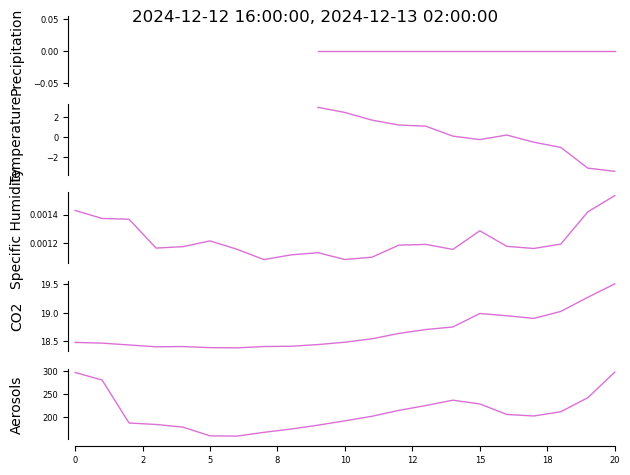


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


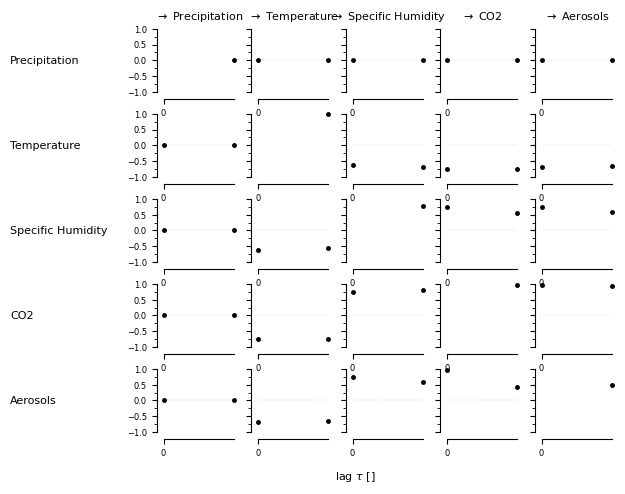

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00001, |min_val| =  0.965

    Variable Specific Humidity has 2 link(s):
       

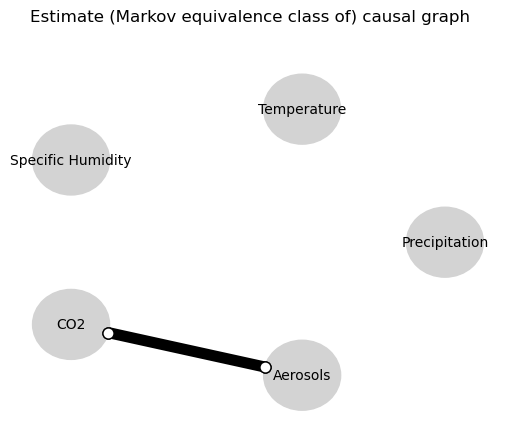

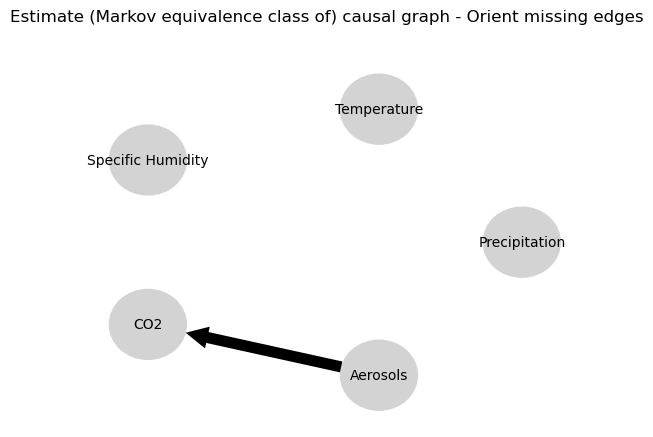

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.055255223275568886
-0.6886104077266358
0.03374508051007805
-0.7783816167870832
0.024591261150795428
-0.6263402041133218
0.04046924657659521
-0.6886104077266358
0.022278826561055502
0.0
-0.05320236510556641
0.8134016786040126
0.00909510380372527
0.8045826766742091
-0.025513552160202124
-0.7783816167870832
0.02993265988594779
0.8134016786040126
-0.049988967738296516
0.0
-0.034684184763183246
0.7199129794167743
-0.05266651859939228
-0.6263402041133218
0.013744762029718997
0.8045826766742091
-0.045602390608216116
0.7199129794167743
0.002351373978020253
0.0
-0.045275220151085545


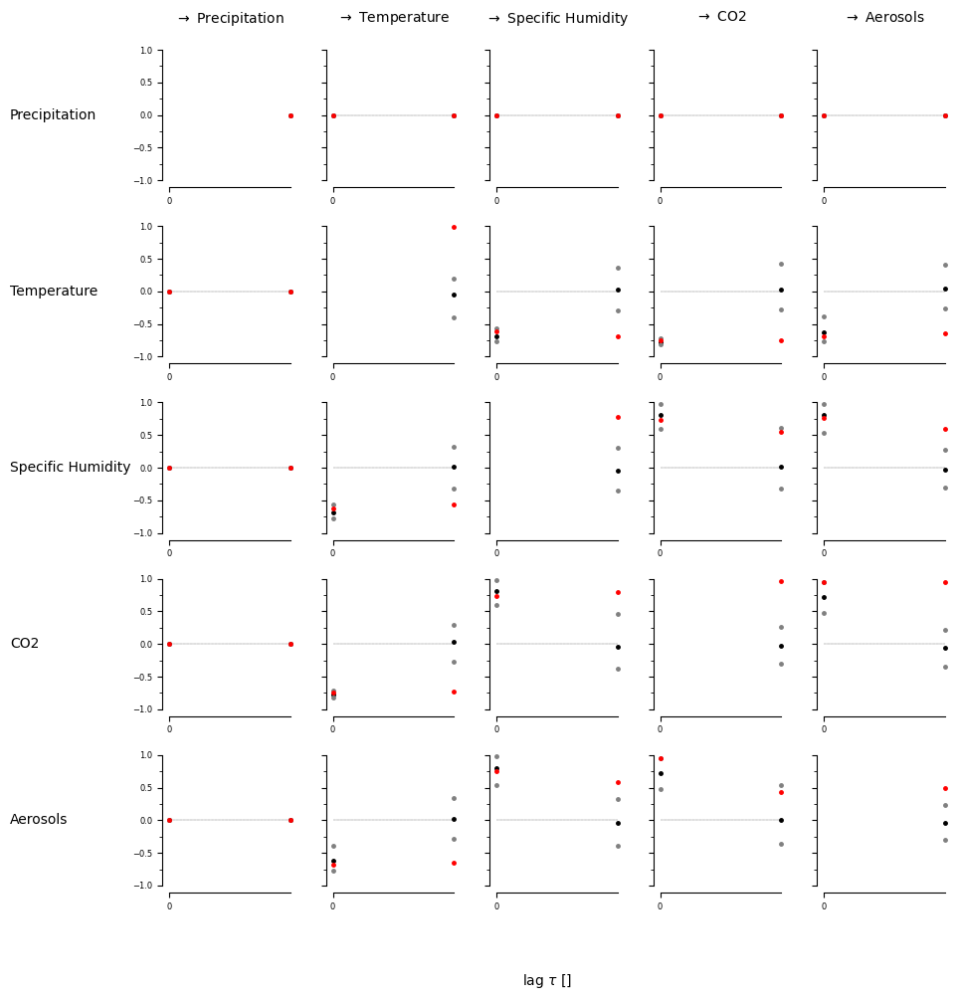

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True False]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [ True  True]
  [ True False]
  [False False]]]


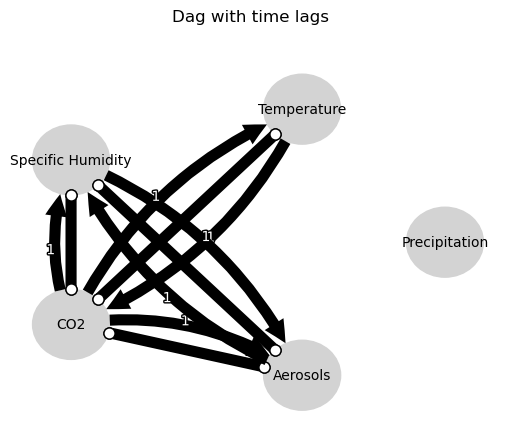

Negative precipitation values in event 12: 0


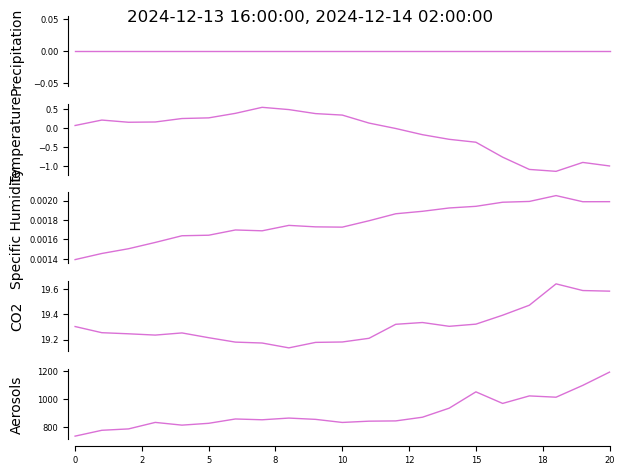


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


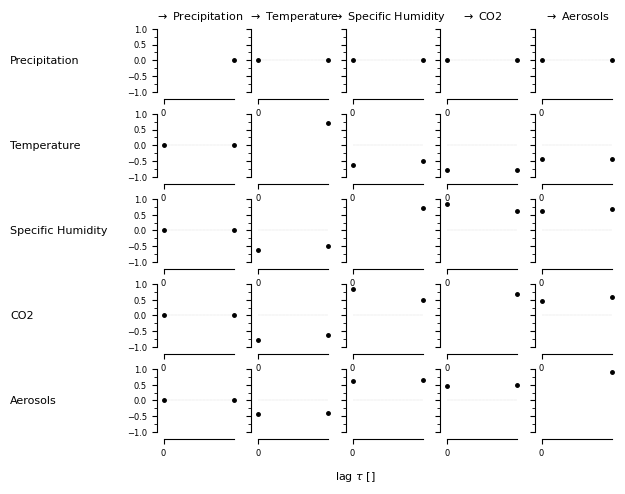

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.03921, |min_val| =  0.490



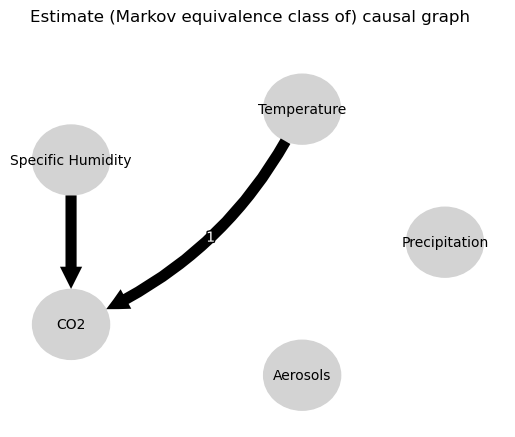

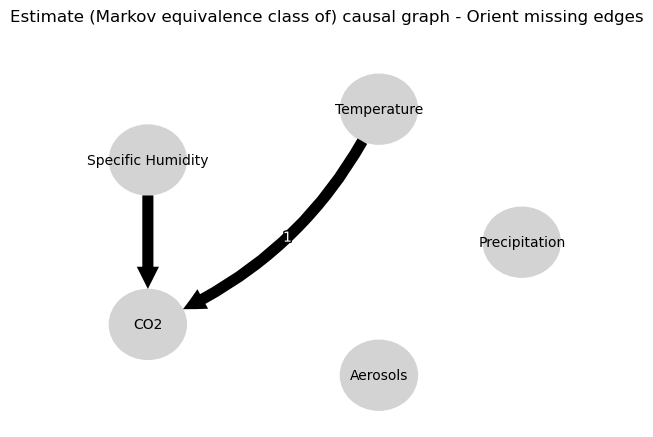

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.07664270165822101
-0.6244142875480984
0.07111440201348199
-0.012177827206951786
-0.7865070118836116
0.04785443507621994
0.049310427207473286
-0.6244142875480984
-0.006478357238723114
0.0
-0.06473560075660366
-0.028462015494796093
0.7022078872453502
-0.03998350469822507
-0.04052264320930475
-0.012177827206951786
0.06956403828447467
-0.028462015494796093
-0.03153091626520164
0.0
-0.0429532117058998
-0.04327957861514881
-0.01873341130511628
0.04785443507621994
0.1050261753018607
-0.03998350469822507
-0.06817635731331295
-0.04327957861514881
-0.006367470686065838
0.0
0.682414564763247


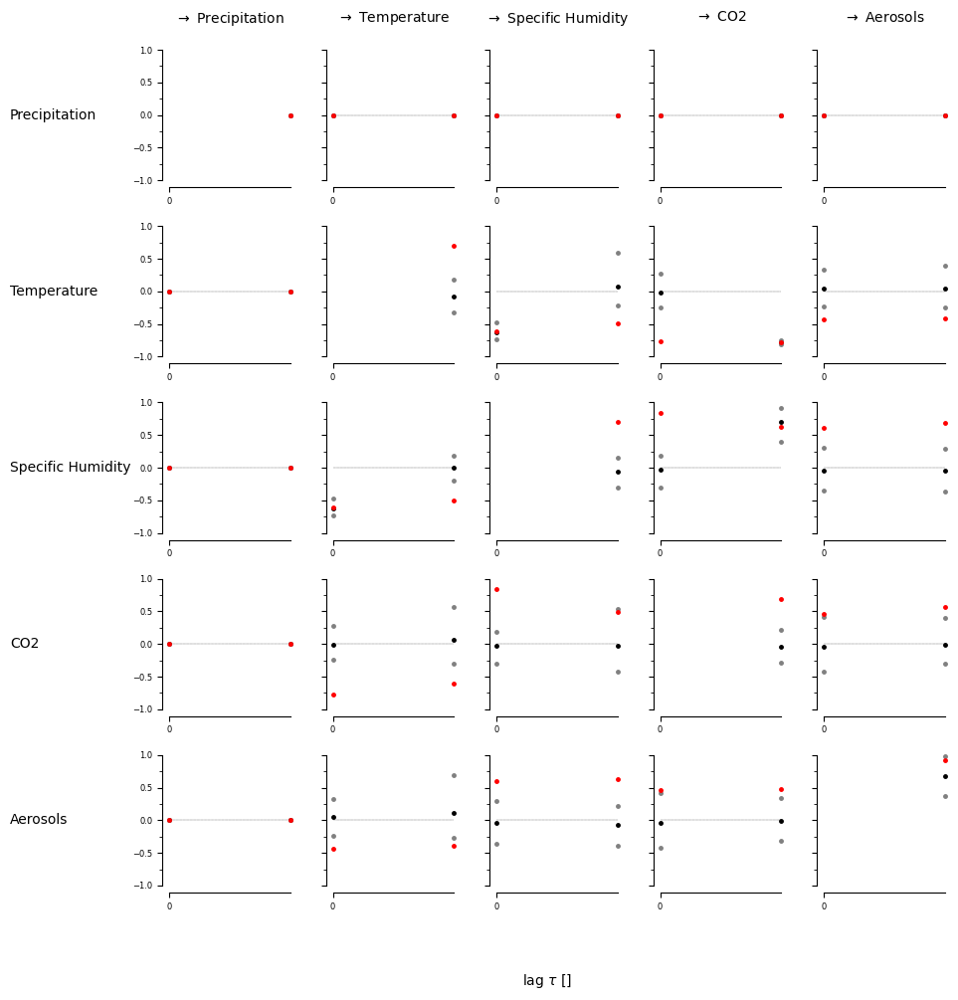

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True False]
  [ True  True]
  [False False]]

 [[False False]
  [ True False]
  [False  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [ True  True]
  [False False]
  [False  True]]]


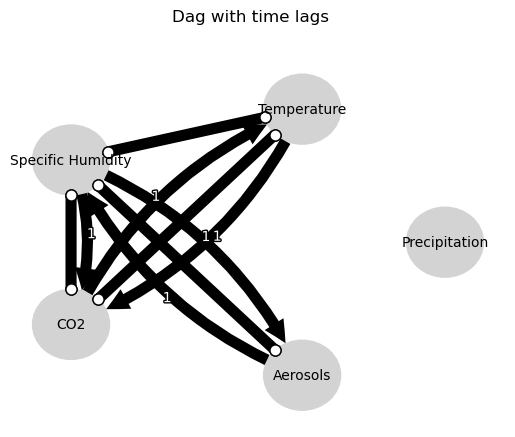

Negative precipitation values in event 13: 0


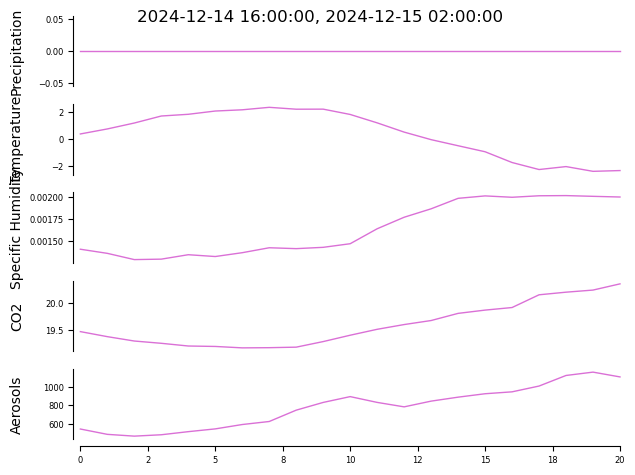


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


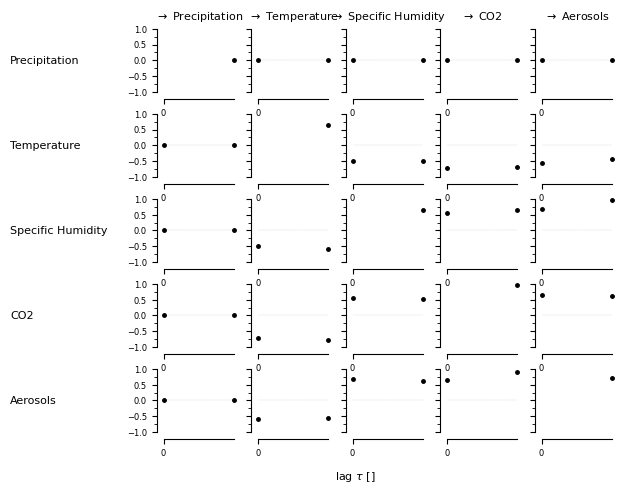

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.00788, |min_val| =  0.604

    Variable Specific Humidity has 0 link(s):

    Variable C

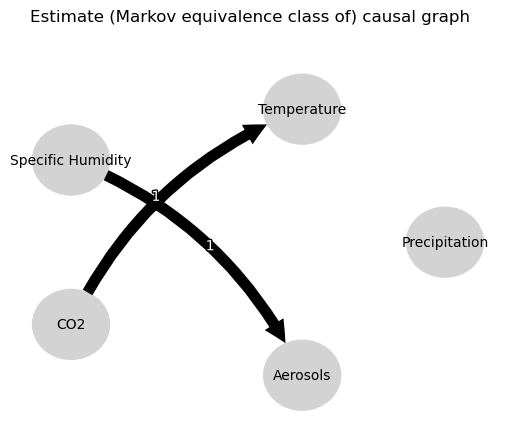

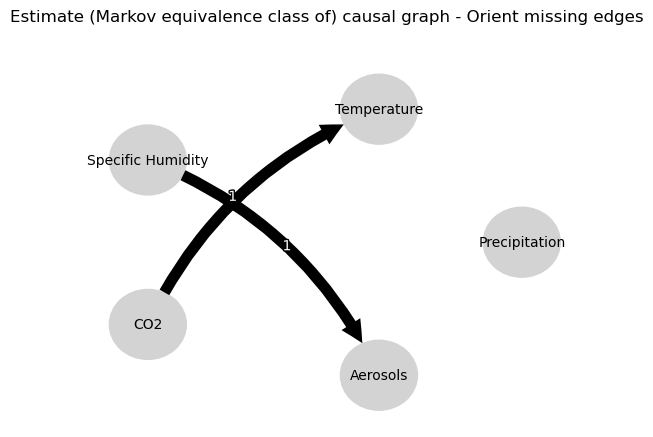

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.63457268118433
-0.026455914369408202
0.038940334754483
-0.6795815879996618
-0.584154575057403
0.05894360193896772
0.002199732228159993
-0.026455914369408202
-0.0559659727606699
0.0
-0.05593694010140428
0.08946997400814921
0.05789993340480595
0.008113820906642229
0.8165188078645299
-0.6795815879996618
-0.7167886289321365
0.08946997400814921
-0.05462346105925854
0.0
0.7462991585856694
0.07075266220901577
-0.007797184354922588
0.05894360193896772
-0.053848446054208514
0.008113820906642229
-0.11546950247239018
0.07075266220901577
0.02227692569973028
0.0
0.006008545857089284


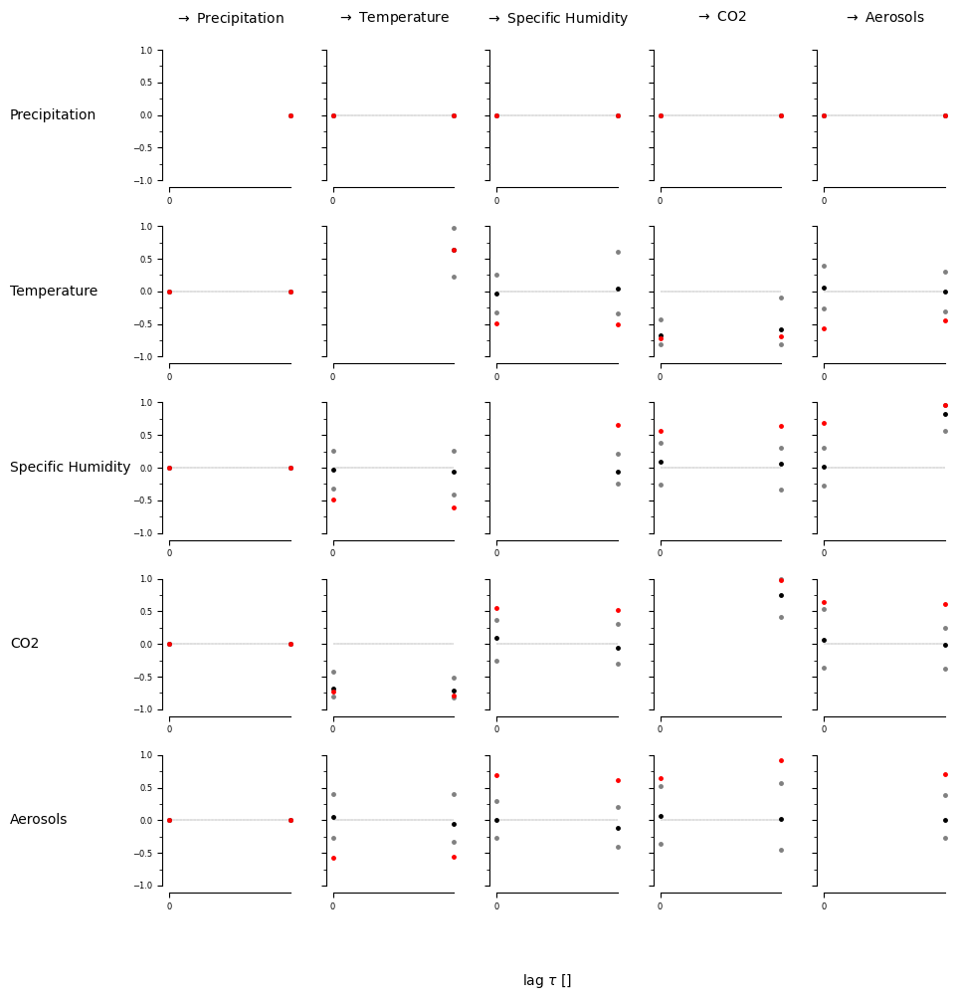

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [ True  True]
  [ True  True]
  [False  True]]]


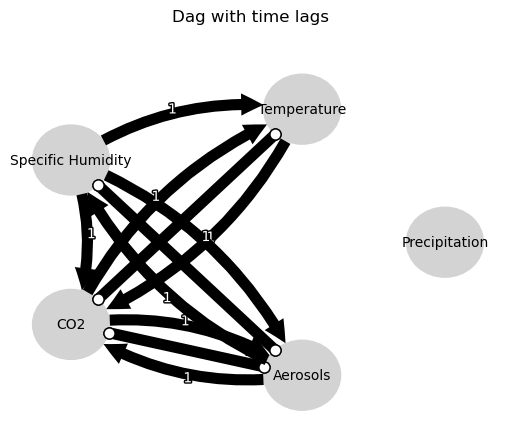

Negative precipitation values in event 14: 0


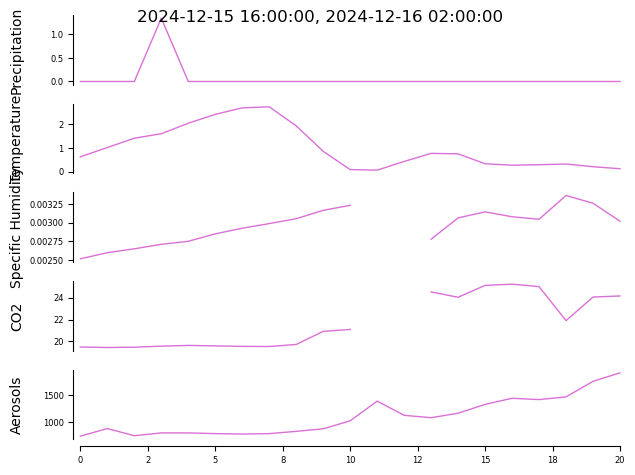


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


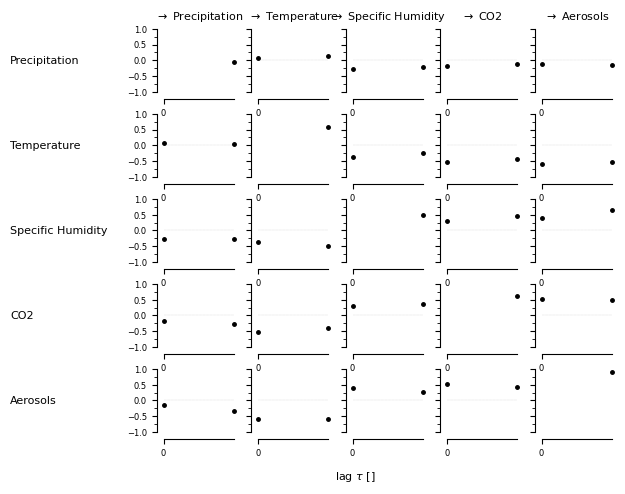

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 1 link(s):
        (CO2 -1): max_pval = 0.00965, |

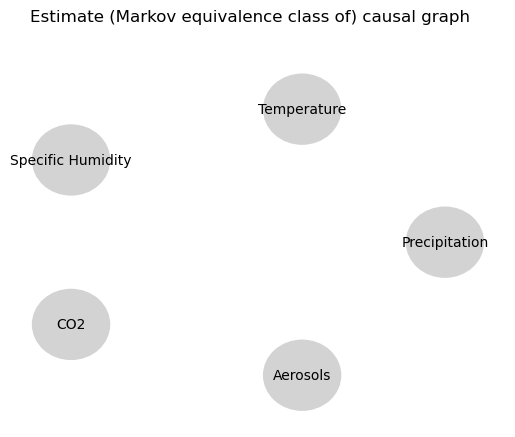

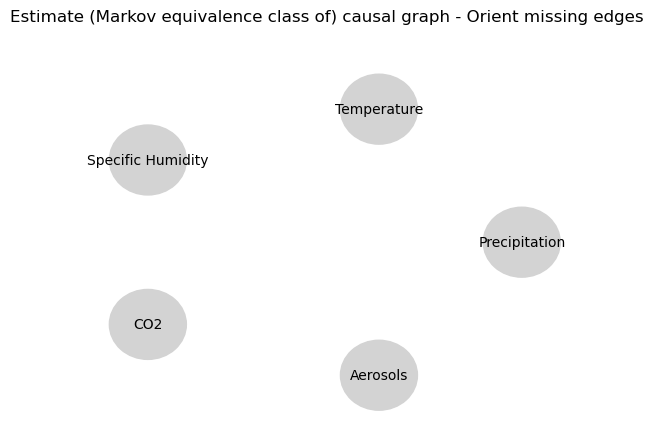

0.0
-0.033332475482433184
0.08279728174870207
-0.015060512400824044
-0.20617667825235483
-0.004475658477389437
-0.16916235892267814
0.05514630682199473
0.055069831788594543
-0.024745352837023612
0.08279728174870207
-0.036795130906610844
0.0
-0.030130127693874346
-0.4208849783500734
0.05277618450059496
-0.6149371680542124
0.04088631096929406
-0.0489364741057559
0.021778881678846958
-0.4208849783500734
-0.0236996207090807
0.0
-0.04727994577409338
0.3946771363207921
-0.05525065355772069
-0.041576460460953424
-0.0071460380816514455
-0.6149371680542124
-0.02627149671161864
0.3946771363207921
-0.045547275601504324
0.0
-0.09766029090230895
-0.03838430112801339
-0.018908767676550812
-0.0489364741057559
0.15918301883518282
-0.041576460460953424
-0.210033926560512
-0.03838430112801339
-0.12477980399228815
0.0
0.6534805117914149


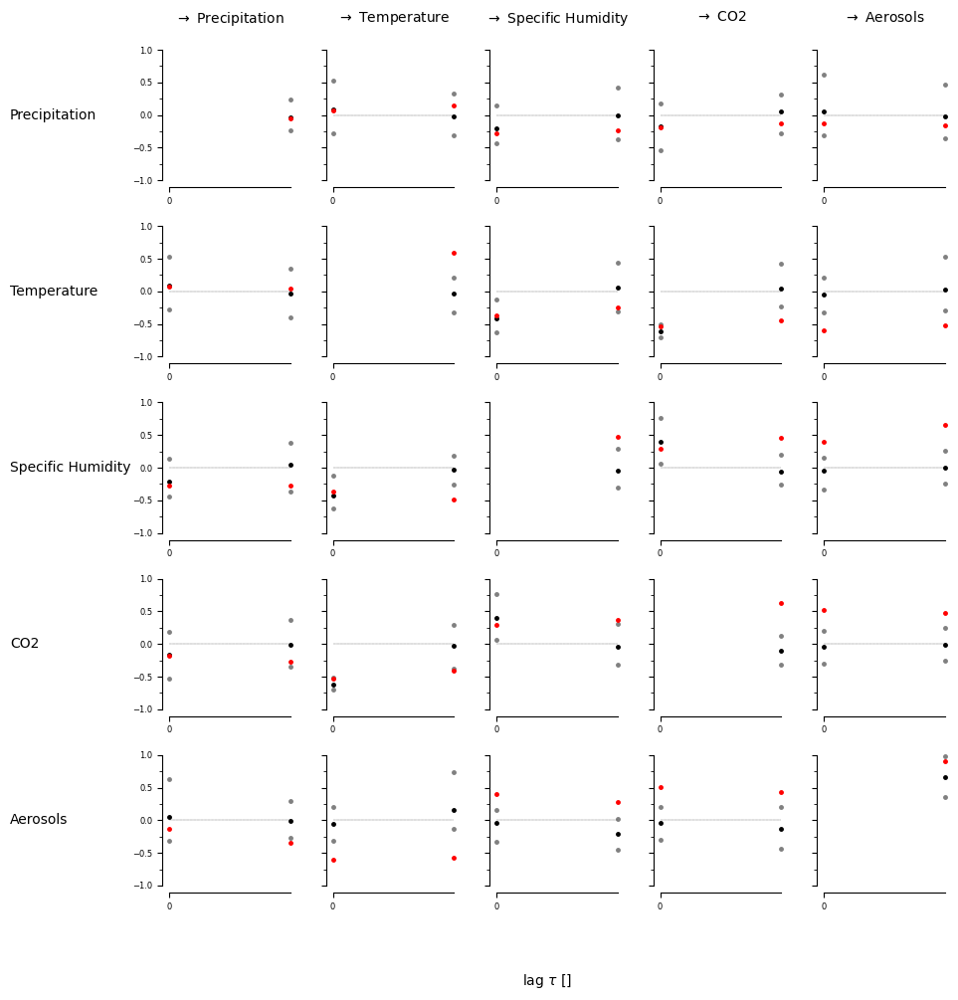

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [ True False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False False]
  [False  True]]]


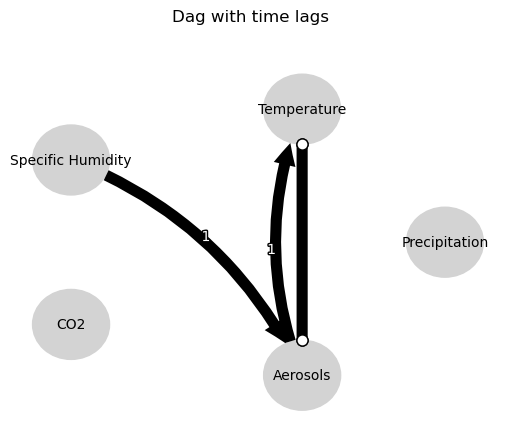

Negative precipitation values in event 15: 0


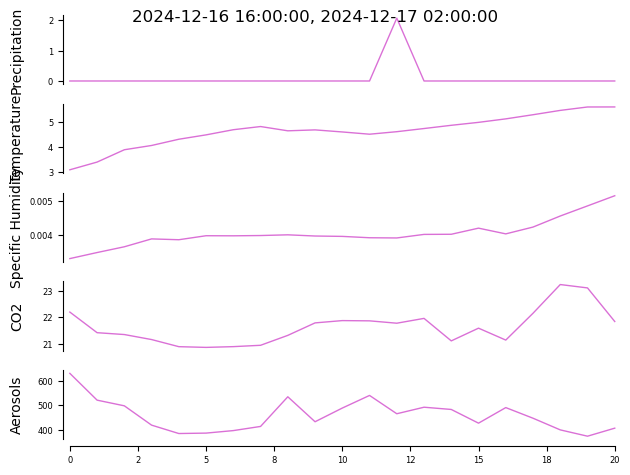


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


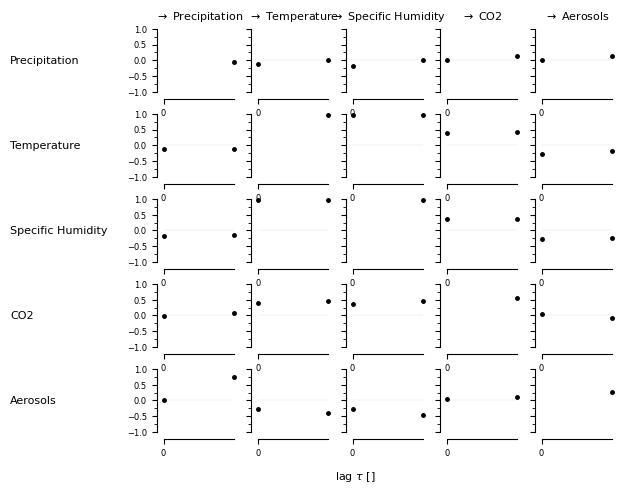

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Aerosols -1): max_pval = 0.00021, |min_val| =  0.752

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (T

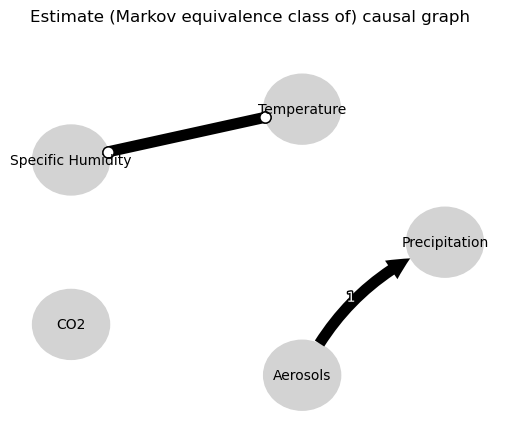

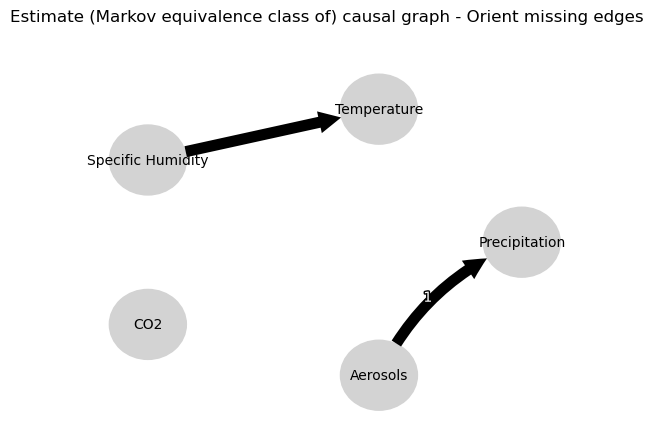

0.0
-0.043847995939210585
0.07899907241542065
0.0075418205791846216
0.01719065338491059
0.027114989361025386
-0.02976067595590215
-0.04020077190051262
-0.15068838628250655
-0.005315616571875343
0.07899907241542065
-0.15671884490833693
0.0
-0.04550113765702844
0.697761034733815
-0.059804245132170114
0.29001277648500096
0.15416047544233696
-0.32418285991211376
0.05968016747442329
0.697761034733815
-0.00833197989099917
0.0
-0.03140301646047175
0.14867352119411825
0.09844865266704585
-0.37404318992210345
0.06289523324034094
0.29001277648500096
-0.0847073251769875
0.14867352119411825
-0.04661787959344776
0.0
0.3213980865829043
-0.11869294621503095
0.014033694681413566
-0.32418285991211376
-0.04213412409023752
-0.37404318992210345
-0.04113017407614623
-0.11869294621503095
-0.0686676954307832
0.0
-0.045829378279399216


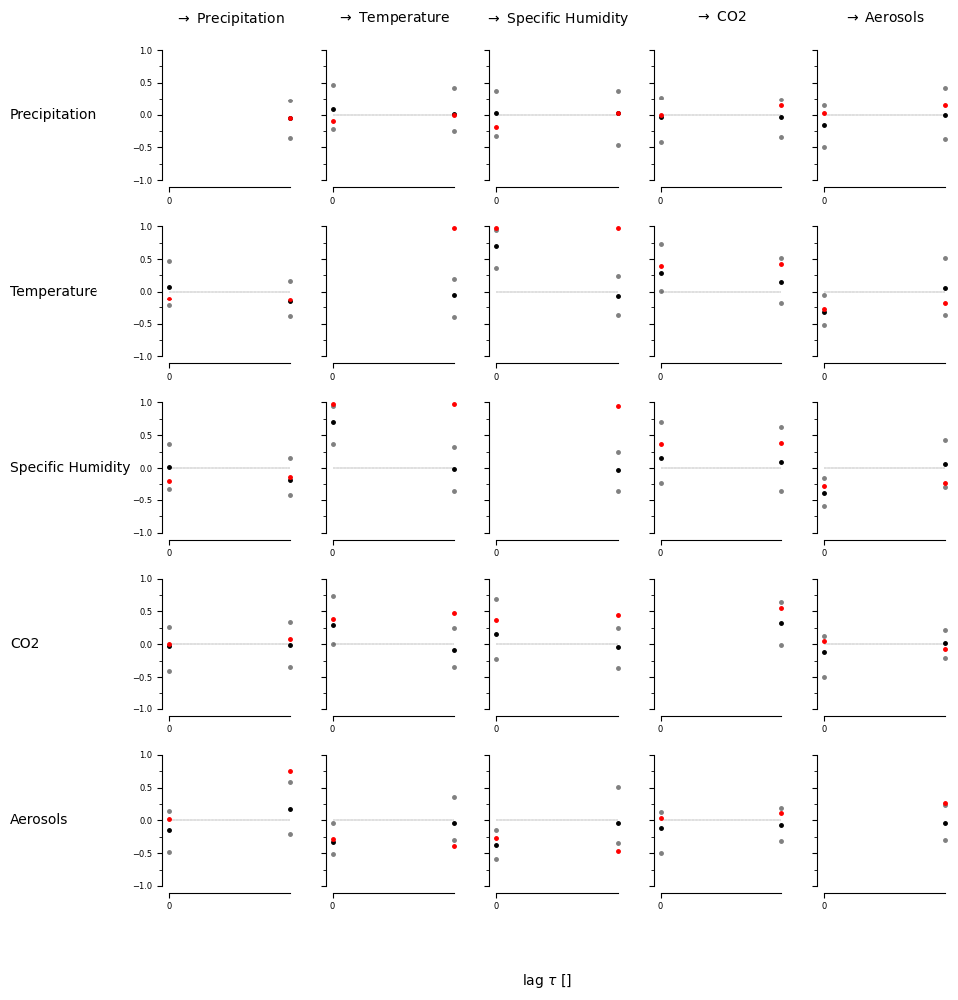

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False  True]
  [False False]
  [False False]
  [False False]
  [False False]]]


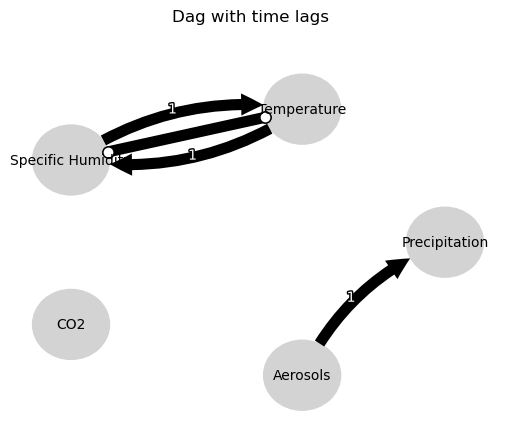

Negative precipitation values in event 16: 0


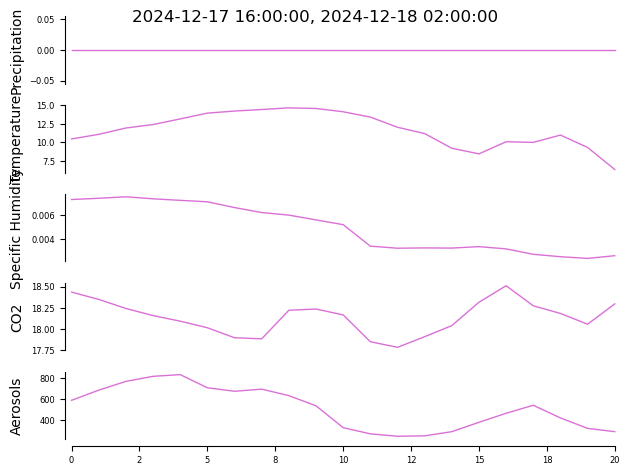


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


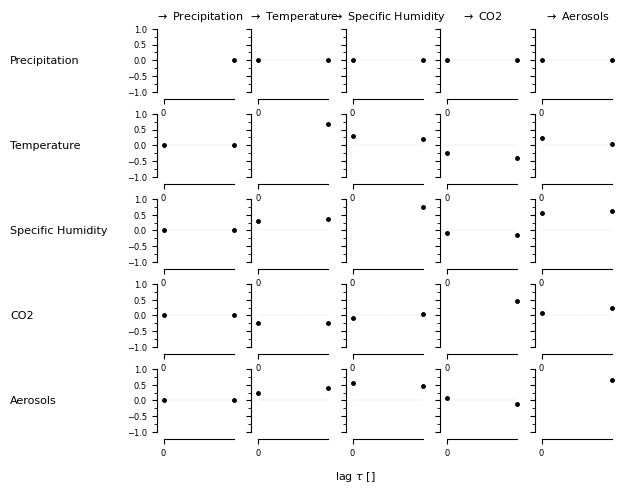

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00173, |min_val| =  0.669

    Variable Specific Humidity has 1 link(s):
       

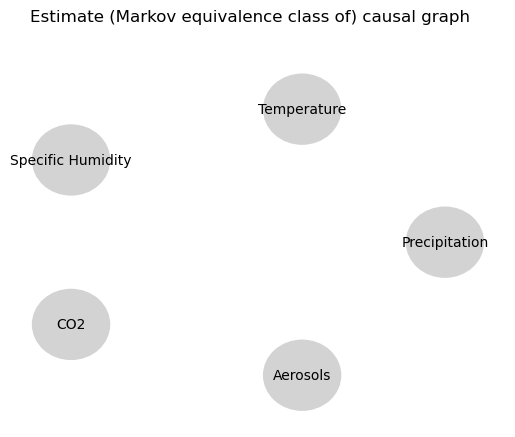

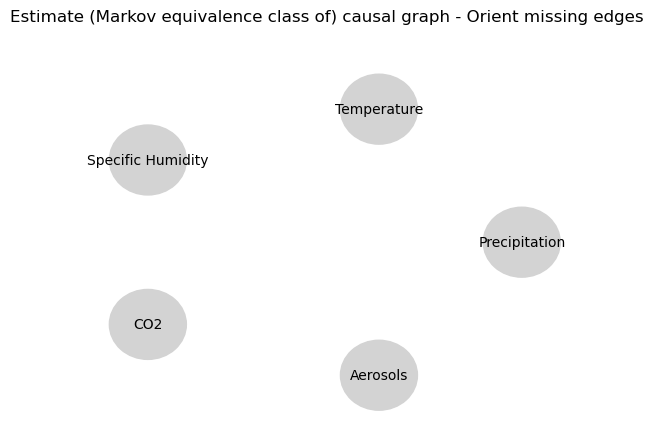

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.5323662332367933
0.057121487203965246
0.03592819290193623
0.05949876720851295
-0.1295781739277052
0.10891805773425836
0.05186314409813722
0.057121487203965246
0.03680883455460337
0.0
0.5407274382382056
0.12893263150134107
-0.14416623778490906
0.31615885573525654
0.21934742311545743
0.05949876720851295
0.04206085533502568
0.12893263150134107
0.04443216117160767
0.0
-0.0895674149535888
0.09410557419806481
0.14982777863999444
0.10891805773425836
0.038870399497064424
0.31615885573525654
0.1816099702642309
0.09410557419806481
-0.07916058091511938
0.0
0.5201101796773815


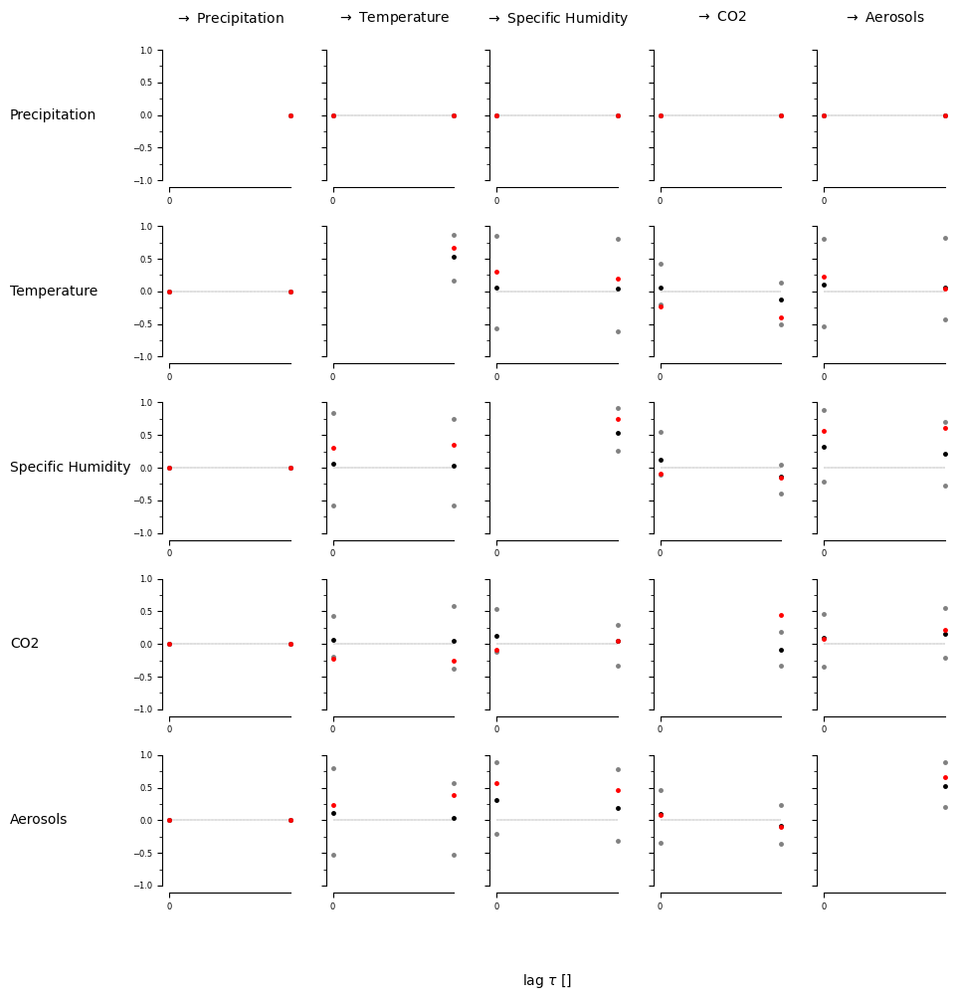

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False  True]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


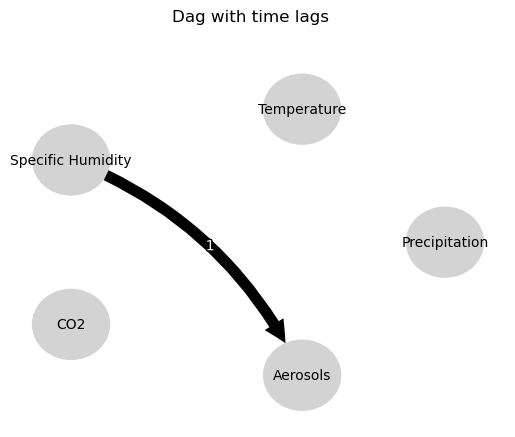

Negative precipitation values in event 17: 0


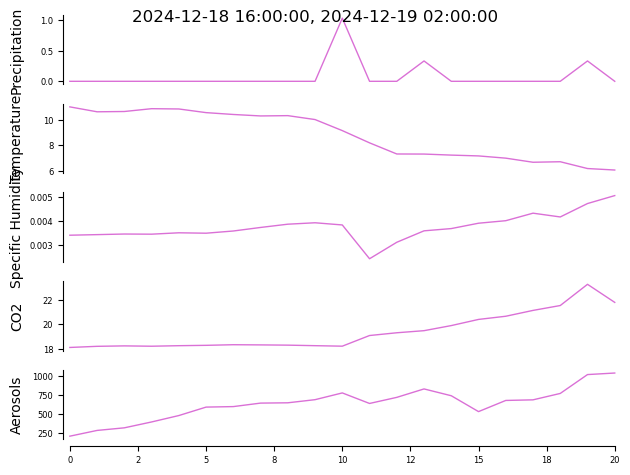


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


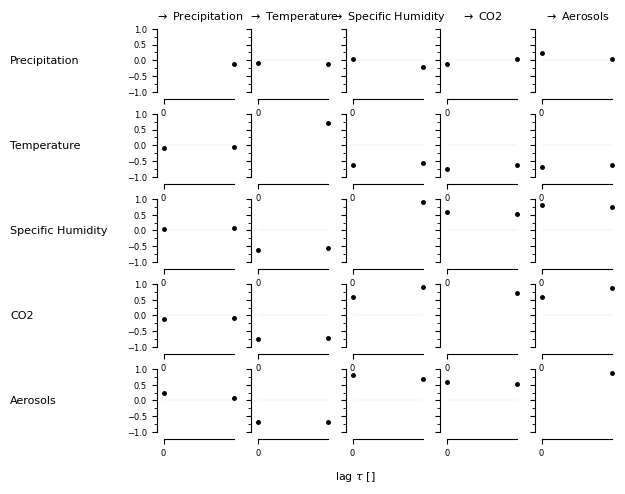

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 2 link(s):
        (CO2 -1): max_pval = 0.00175, |min_val| =  0.684
        (Specif

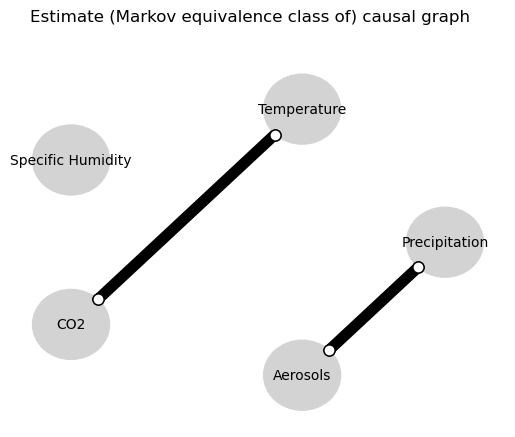

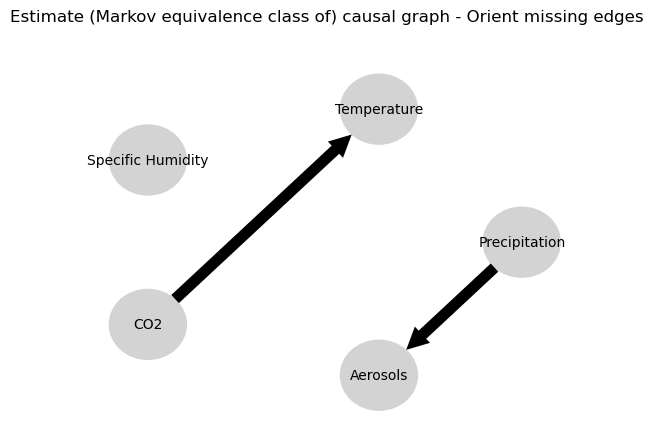

0.0
-0.06986541118138755
-0.05963454944505582
0.058093186291832986
0.08063535490591207
-0.011147901342452943
-0.06118853775952538
-0.041332410525186415
0.18303154035379388
0.12659229203913222
-0.05963454944505582
0.020420090432340998
0.0
-0.03602350181643204
-0.316519561018046
0.046057983217812674
-0.7079132806674205
0.023379226990756778
-0.07518140541135361
-0.044408575522429126
-0.316519561018046
0.036665475552529206
0.0
-0.074197141957045
0.5454705425832451
-0.07492242657755491
0.23562040008574284
0.22799584034088027
-0.7079132806674205
0.014350120467708364
0.5454705425832451
-0.019098699459714503
0.0
-0.047336309572081896
0.15230290109676967
0.0941945440380449
-0.07518140541135361
0.051047314095786916
0.23562040008574284
-0.15367726969751086
0.15230290109676967
-0.09569773025536747
0.0
0.47354512069809984


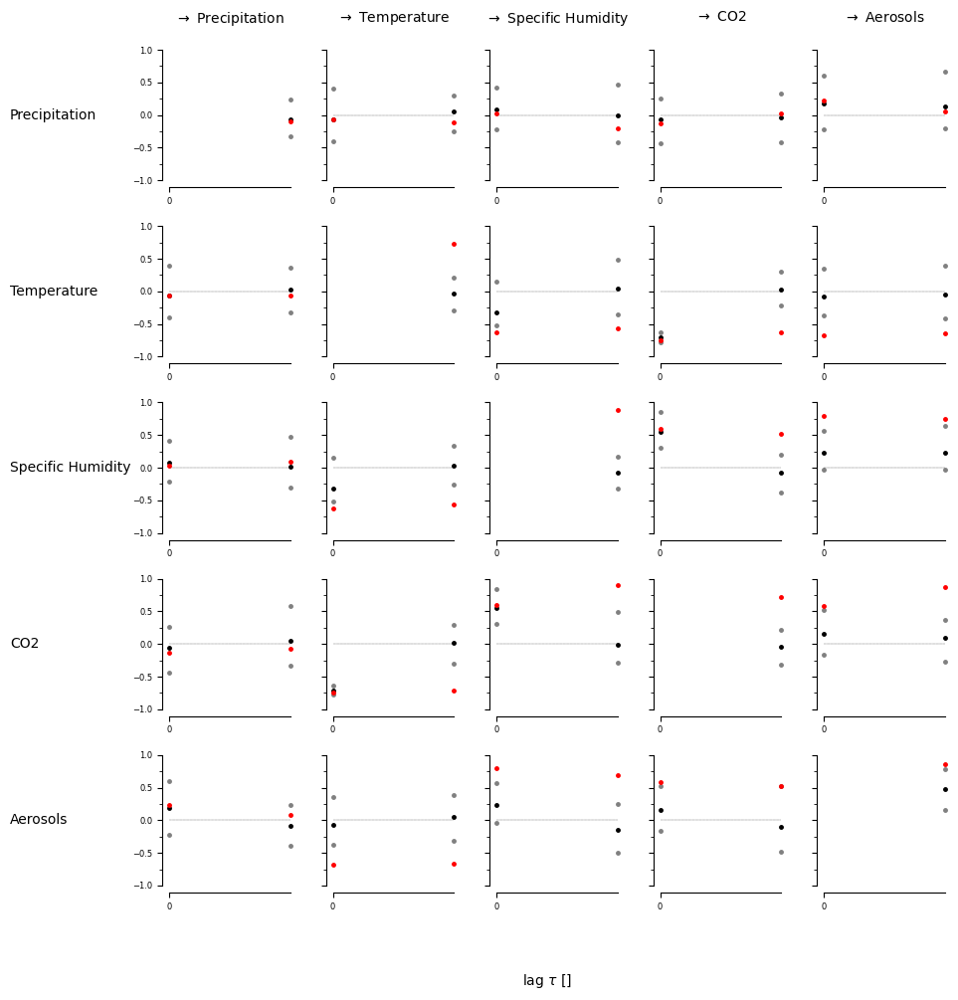

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True False]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True False]
  [False  True]
  [ True False]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [ True False]
  [False  True]]]


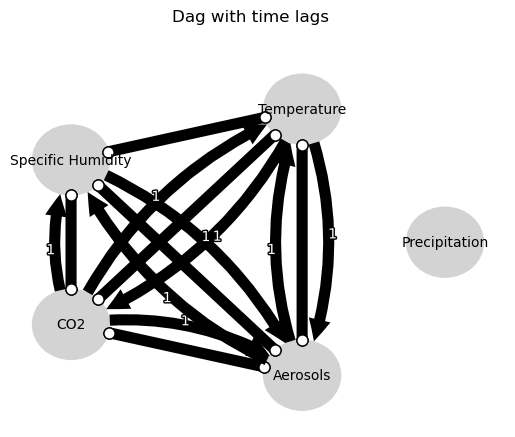

Negative precipitation values in event 18: 0


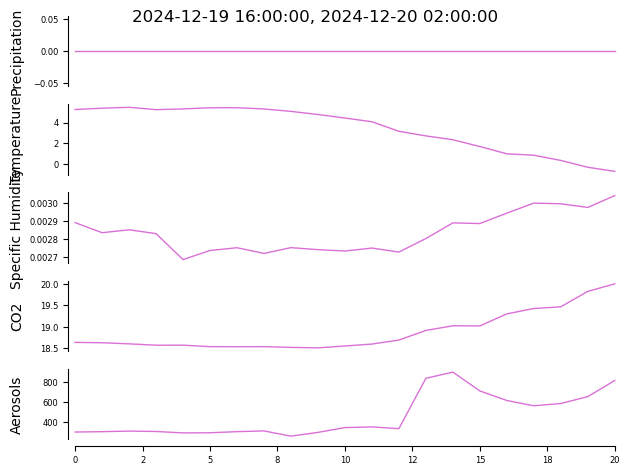


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


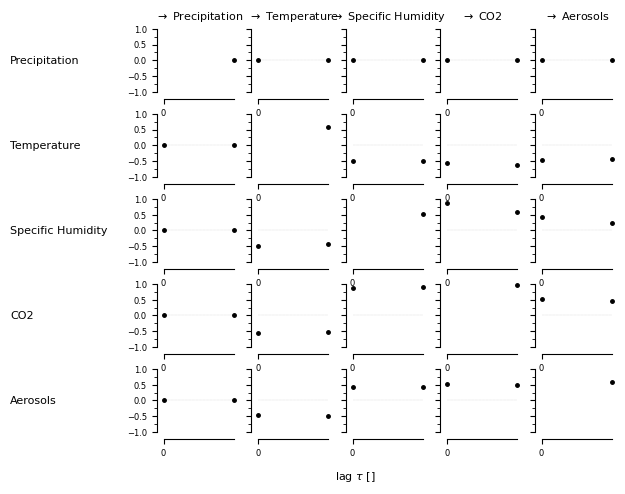

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (CO2 -1): max_pval = 0.00000, |min_val| =  0.864

    Variable C

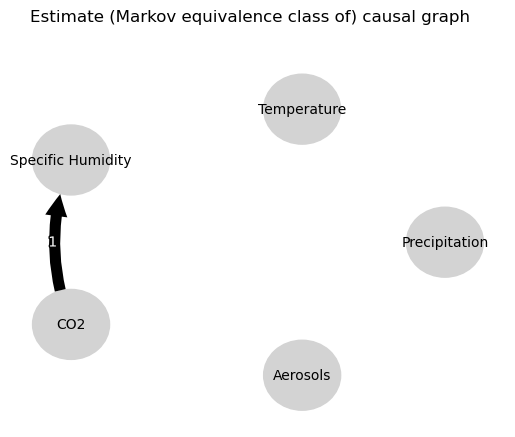

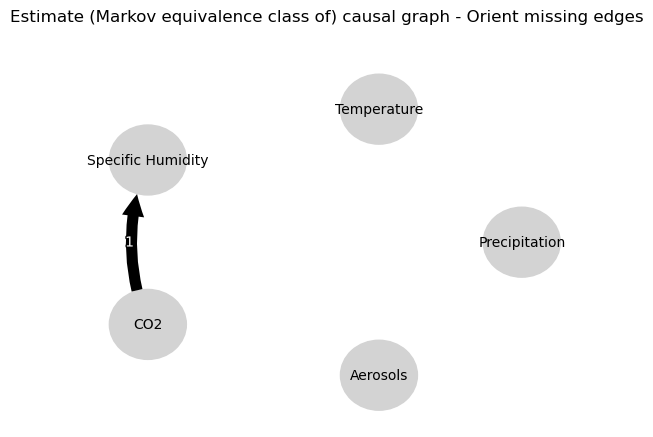

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.08522410031604764
0.010655969435277529
0.022204306176235575
0.011361927660827673
-0.008552182109931203
-0.11661361215120514
-0.12065979941283117
0.010655969435277529
-0.014884154887182617
0.0
0.6952213922372982
0.7688977196802956
0.7495665571772634
-0.08540898387640126
-0.08366650551893821
0.011361927660827673
0.06305502700665581
0.7688977196802956
0.8261982852883449
0.0
0.8561520958272834
-0.0013708715218289944
-0.05587780168100212
-0.11661361215120514
0.07057919368013718
-0.08540898387640126
0.016566413093821227
-0.0013708715218289944
0.022889792449212187
0.0
0.4960211995248282


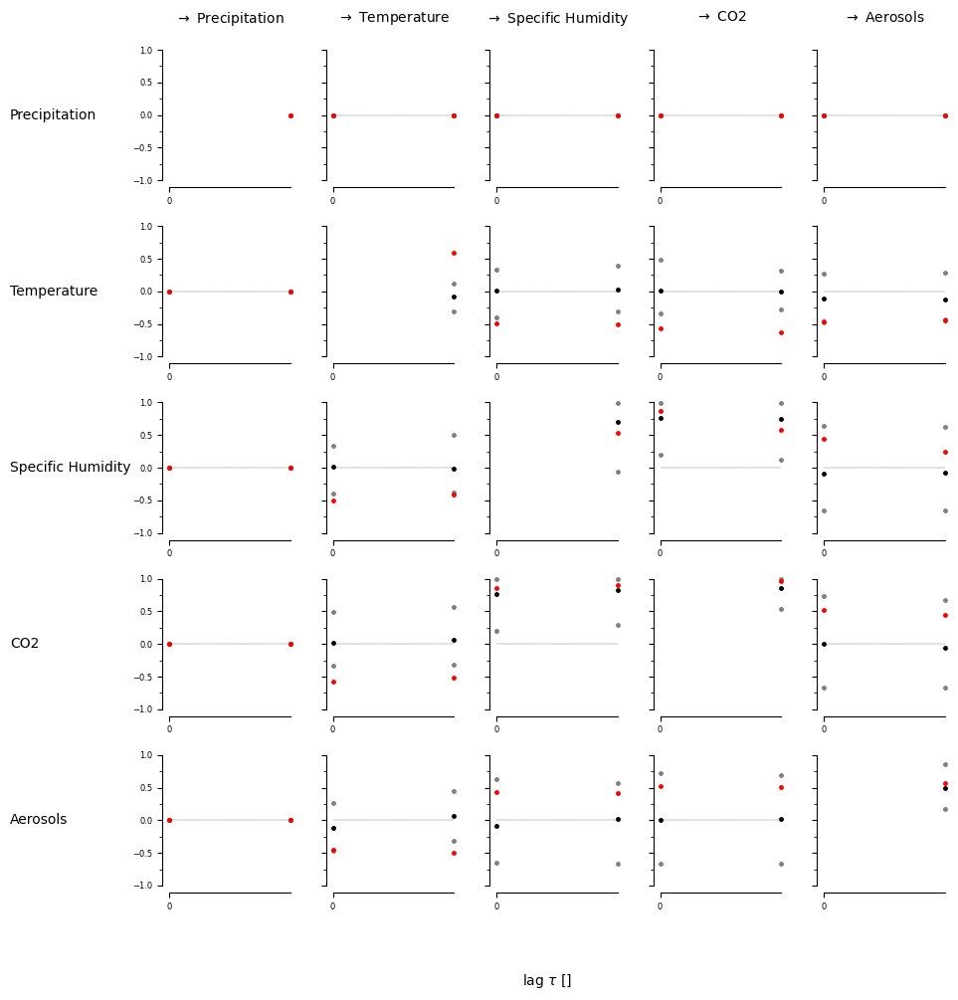

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [False False]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


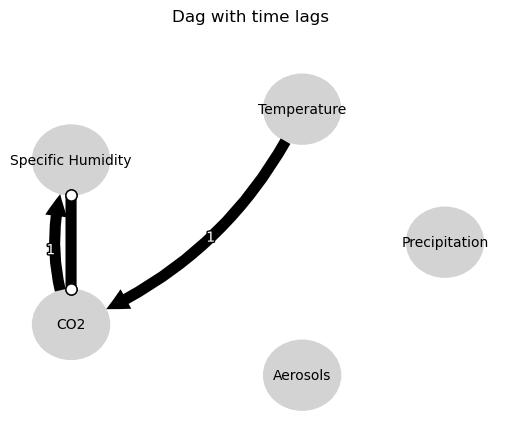

Negative precipitation values in event 19: 0


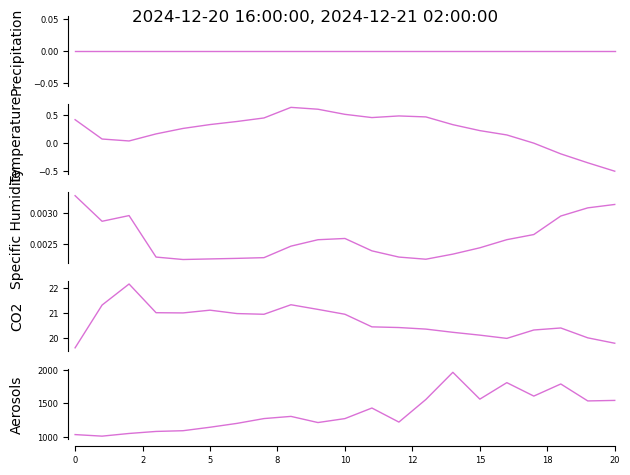


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


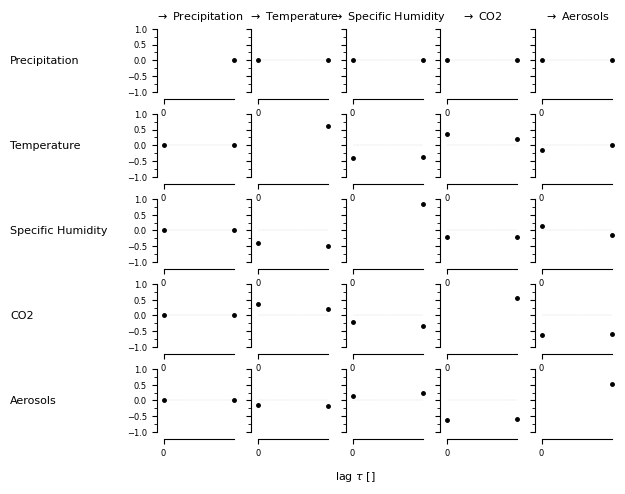

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.02417, |min_val| =  0.528

    Variable Specific Humidity has 1 link(s):
       

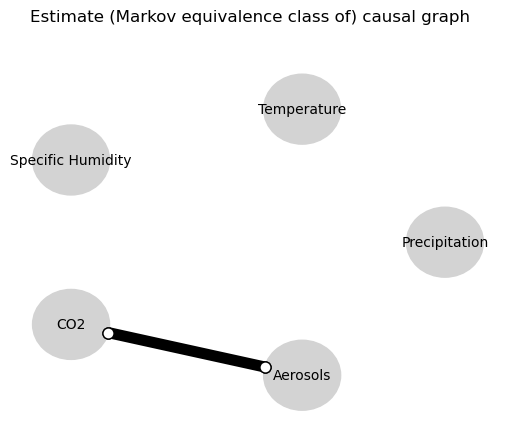

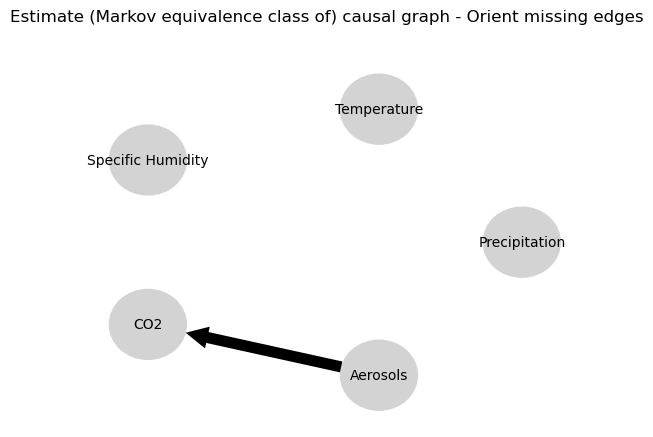

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.7299213460003894
0.03423797746577731
0.11414643245544327
-0.016653947492331737
-0.11535489412175544
-0.005747083179023998
0.15593073672862784
0.03423797746577731
0.015755140773843115
0.0
0.4381085715397761
-0.16071741236664938
0.01713637934837619
0.29957232830595426
-0.04077079181927827
-0.016653947492331737
0.035400089618545585
-0.16071741236664938
-0.11383037902670932
0.0
-0.05345861677774463
-0.5929103932922387
0.028933773015524952
-0.005747083179023998
0.04075561611954126
0.29957232830595426
0.21475906249383145
-0.5929103932922387
0.02054629751683275
0.0
-0.045829378279399216


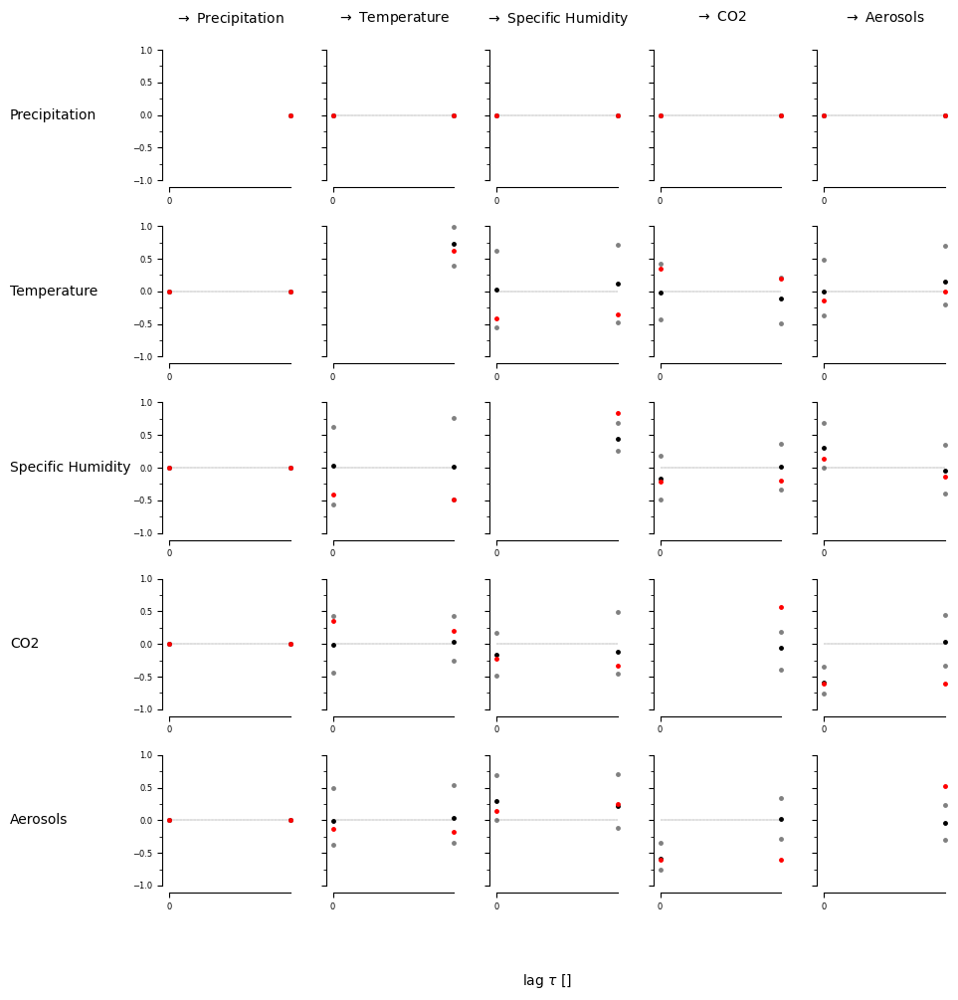

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False False]]]


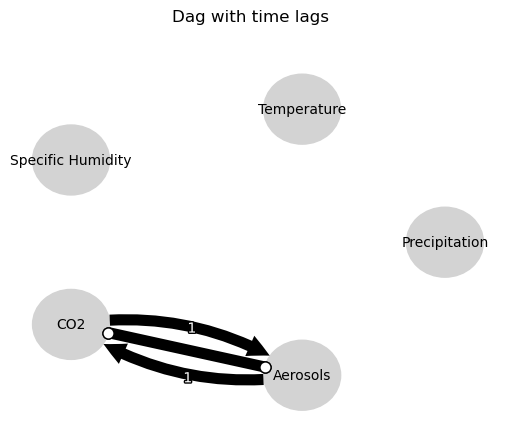

Negative precipitation values in event 20: 0


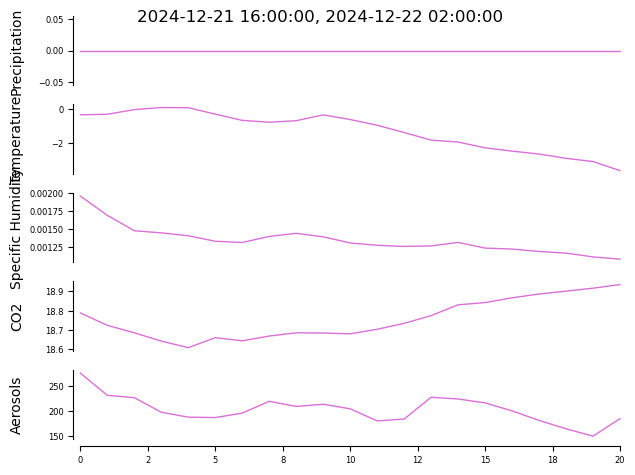


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


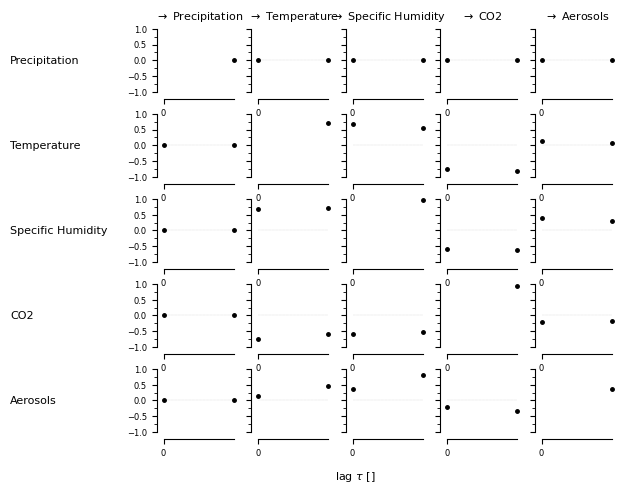

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 2 link(s):
        (Specific Humidity -1): max_pval = 0.02669, |min_val| =  0.521
        (Temperature -1): max_pval = 0.03385, |m

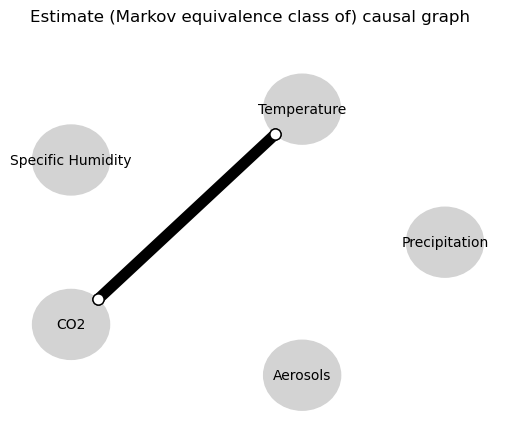

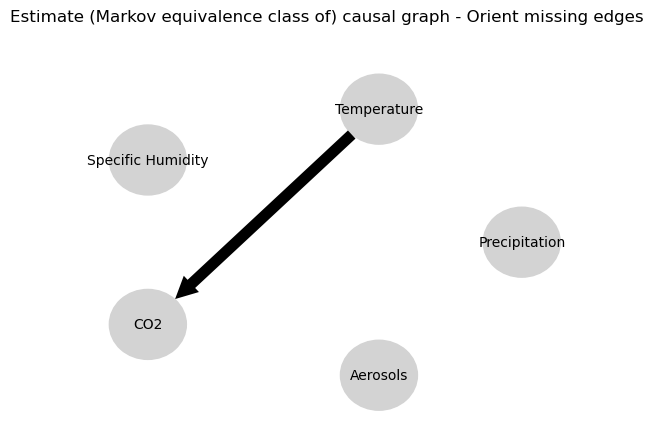

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.037619583010874105
0.22547006323853017
0.08477572133179052
-0.6783506666256545
-0.26970234846354907
0.4496541488624923
0.000640428752331954
0.22547006323853017
-0.04628952041905973
0.0
0.3537281235945005
-0.3233471176676538
-0.1516692476768524
0.2260216962855511
-0.10229805679159062
-0.6783506666256545
0.10431863500289183
-0.3233471176676538
-0.13380991767603492
0.0
0.25687169660241094
-0.32045689833369423
0.021613668204894625
0.4496541488624923
0.03973179116911796
0.2260216962855511
0.09712705217055176
-0.32045689833369423
-0.1592443142586523
0.0
-0.04411405507028838


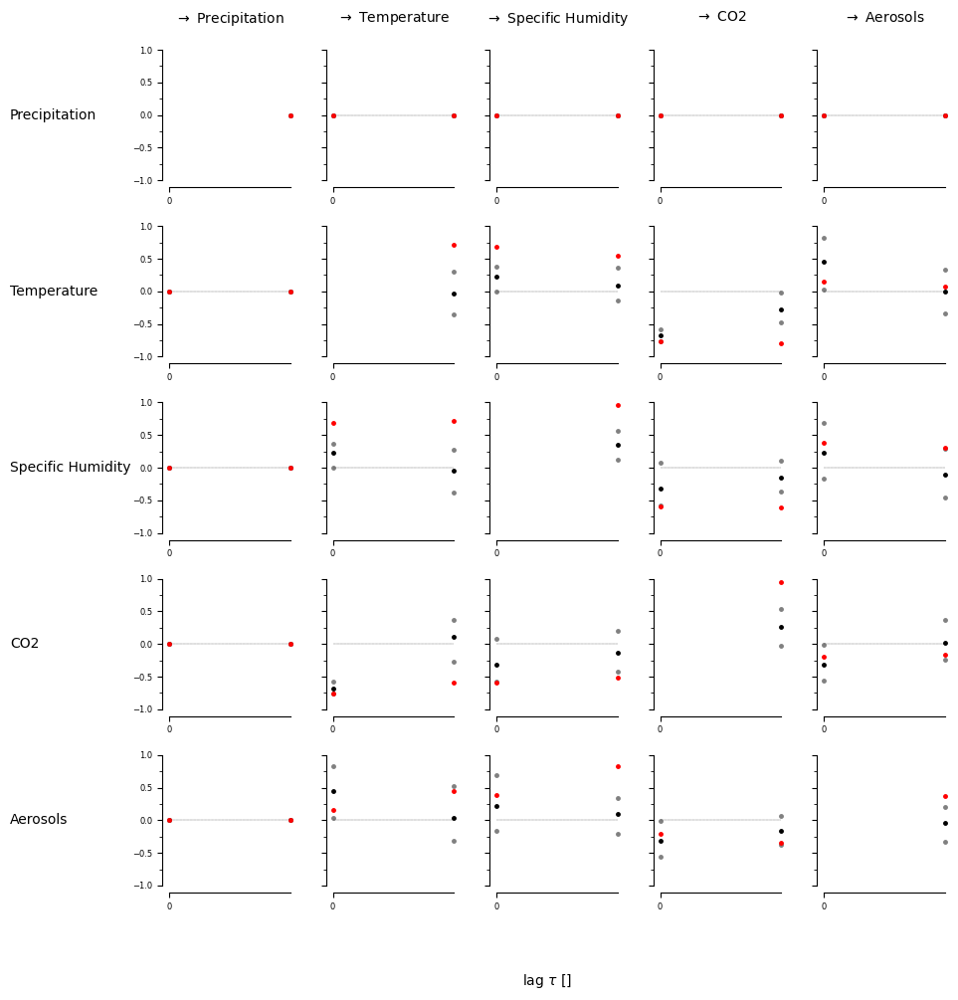

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True False]
  [ True  True]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True  True]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]]


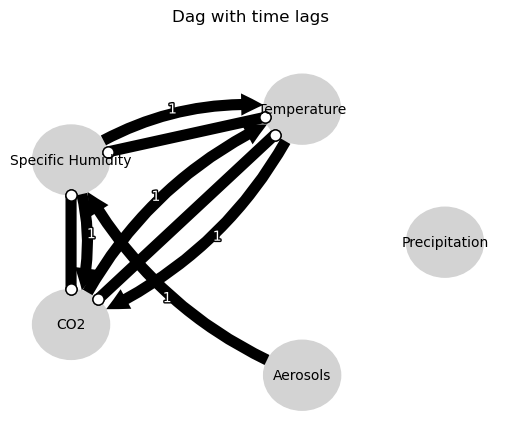

Negative precipitation values in event 21: 0


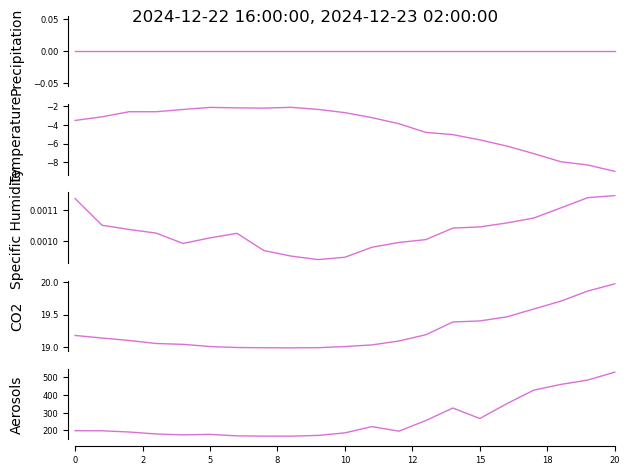


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


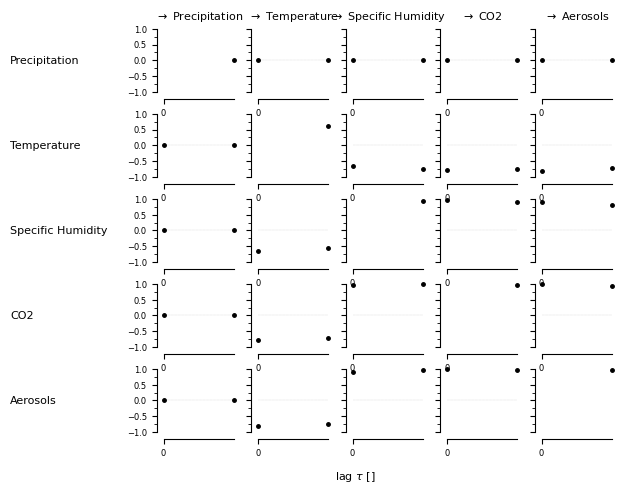

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (CO2 -1): max_pval = 0.00011, |min_val| =  0.786

    Variable C

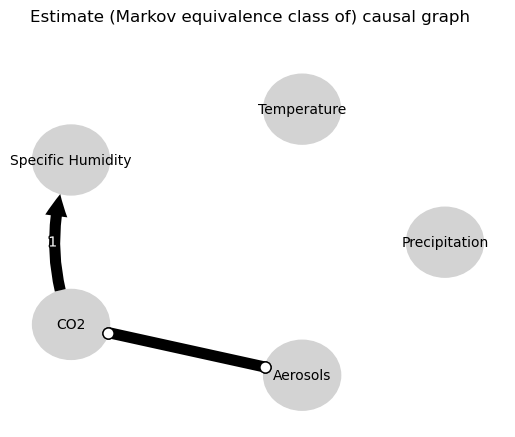

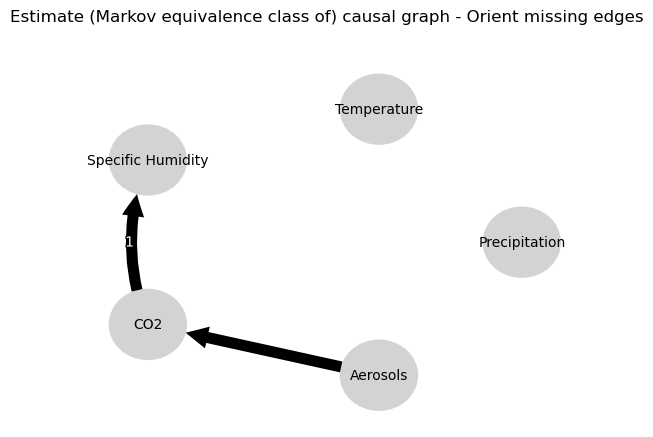

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.018467382384714837
-0.01571269529057141
-0.7311556501025563
-0.786778038521518
0.04949514658140531
-0.7915837079133035
0.061030844500896346
-0.01571269529057141
-0.030043469660953576
0.0
-0.06618841278311552
-0.014128351251580077
0.014157725525456539
-0.026959296111998984
0.014423461057758484
-0.786778038521518
-0.028862041265820617
-0.014128351251580077
0.8812945550919417
0.0
-0.03070807322213417
0.9424219662986583
-0.04183254016124793
-0.7915837079133035
-0.016149049202335168
-0.026959296111998984
0.8751939300284536
0.9424219662986583
-0.03476882995276573
0.0
-0.045829378279399216


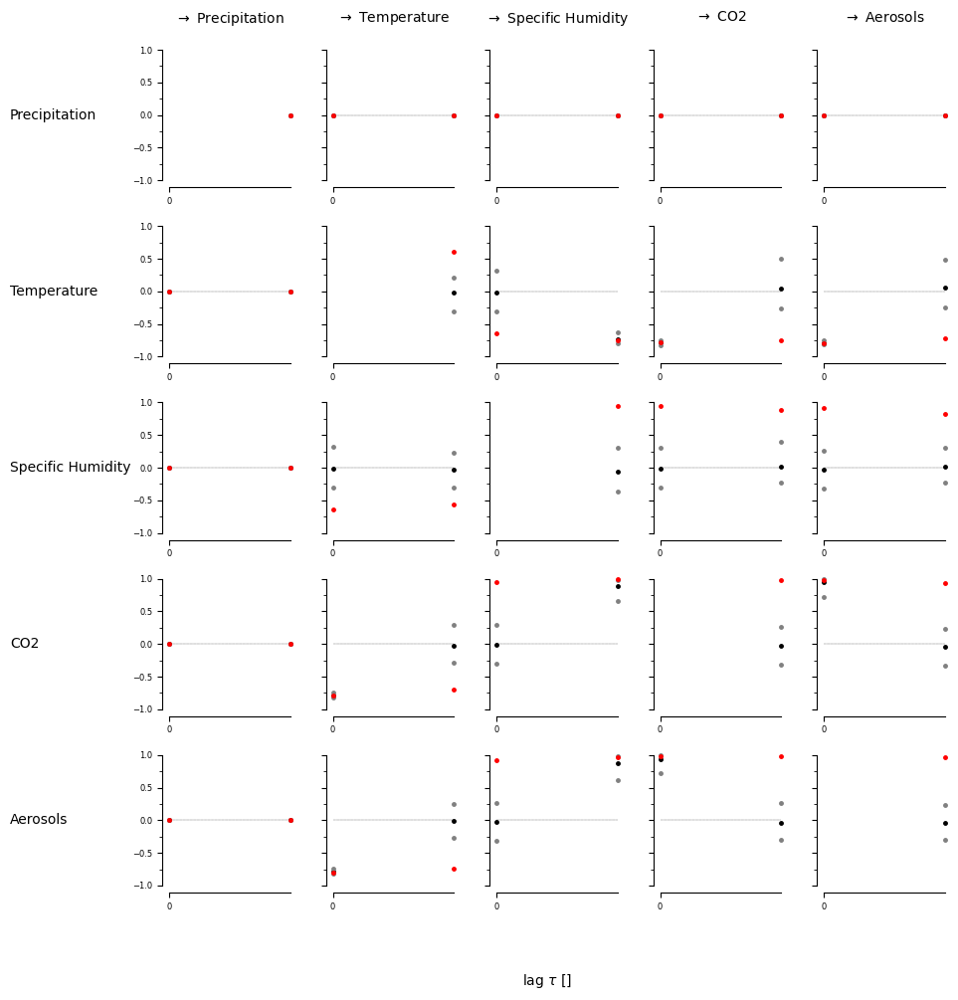

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True False]
  [False  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [ True  True]
  [False  True]]]


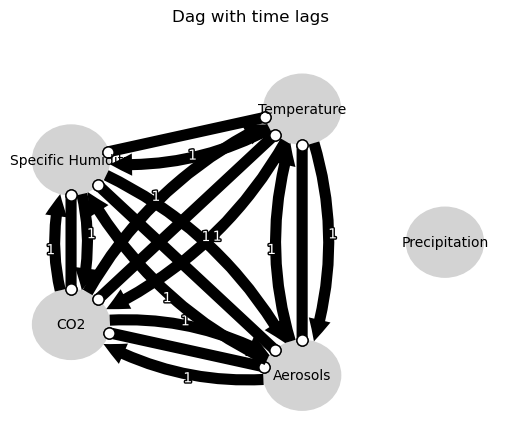

Negative precipitation values in event 22: 0


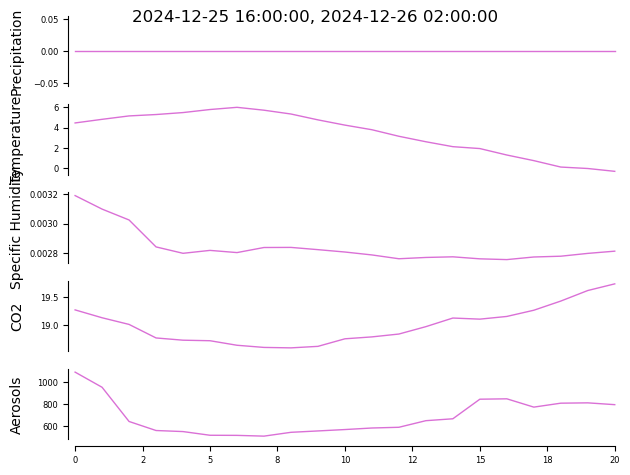


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


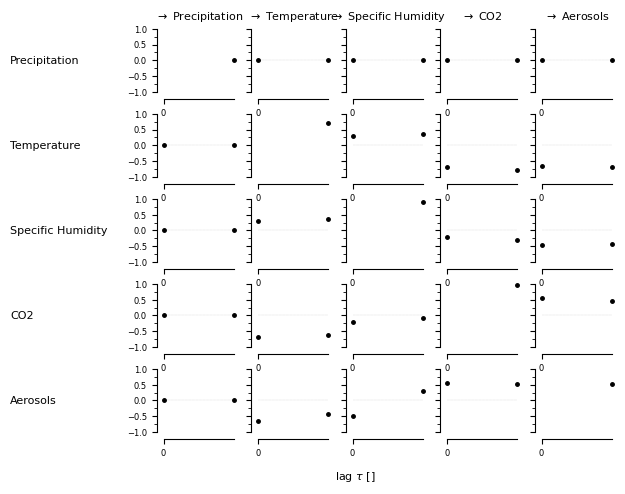

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.02279, |min_val| =  0.533

    Variable Specific Humidity has 1 link(s):
       

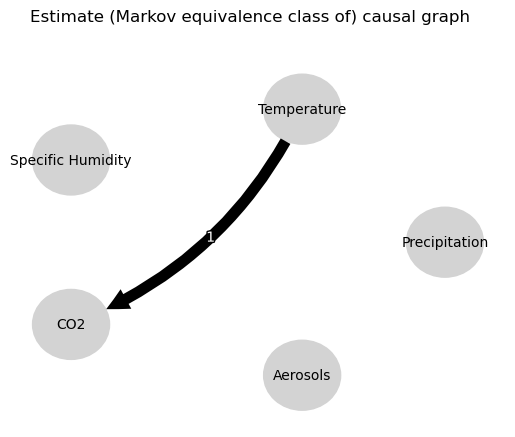

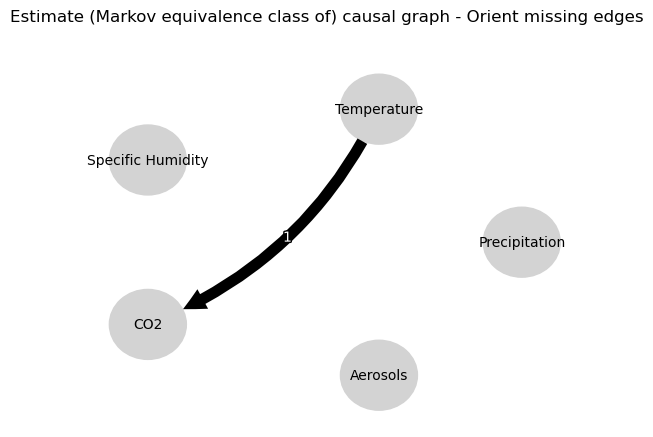

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.76497097972735
-0.0510034258413625
-0.051849356185436325
-0.573603141597792
-0.6644521504360046
-0.012414961888961159
-0.14408296169183984
-0.0510034258413625
0.03528608457632273
0.0
0.35961142179925826
0.2625238251697811
0.06423101954809043
0.05030515780633472
-0.0549694043251434
-0.573603141597792
-0.49824032268142265
0.2625238251697811
0.20048274553887438
0.0
0.6926640569235756
0.09827906384229164
0.06927884477642578
-0.012414961888961159
-0.012110755683969429
0.05030515780633472
-0.03510943483541513
0.09827906384229164
0.009412286792519885
0.0
-0.0438664419562254


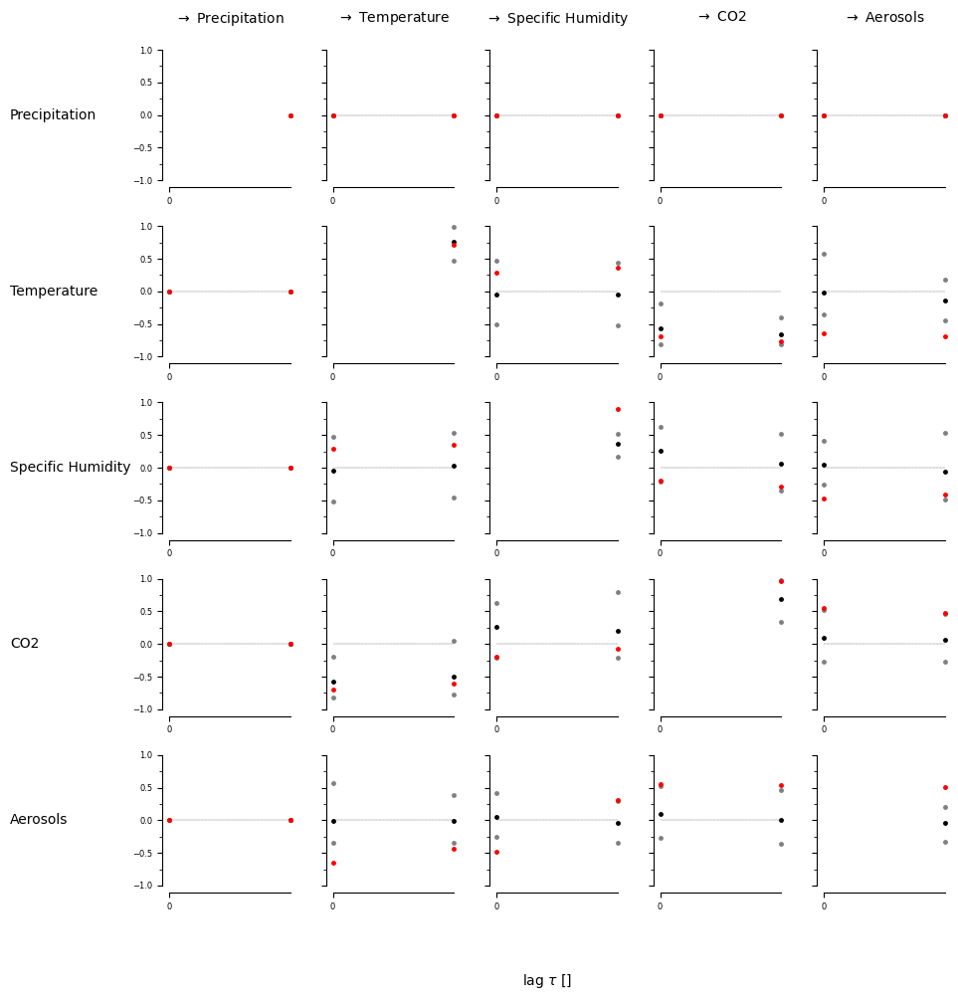

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]]


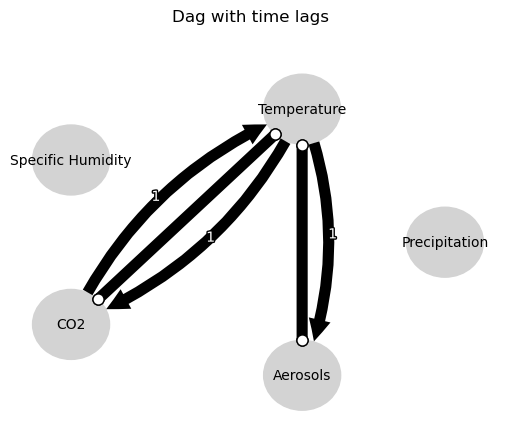

Negative precipitation values in event 23: 0


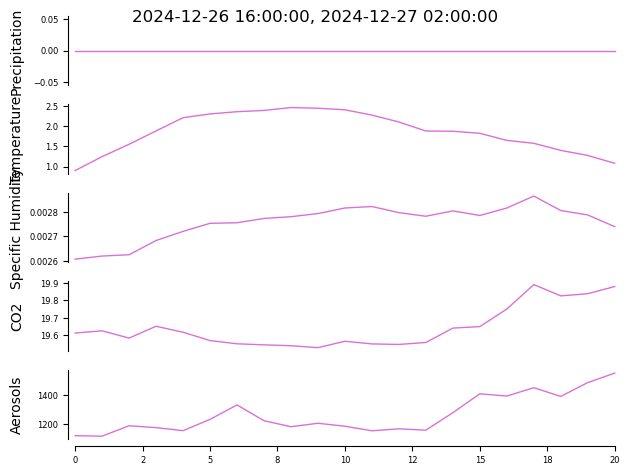


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


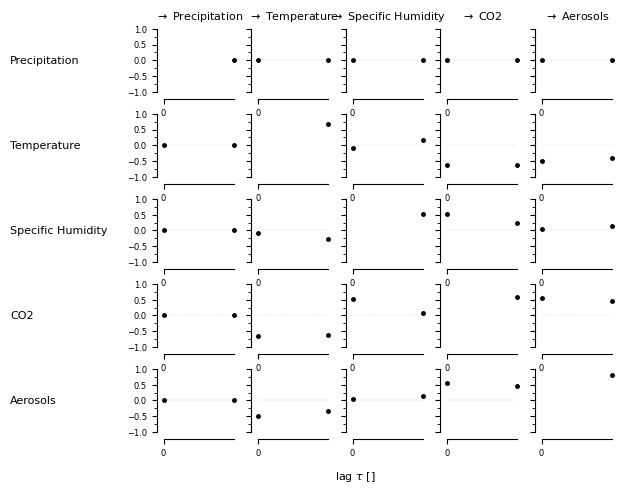

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.01940, |min_val| =  0.531



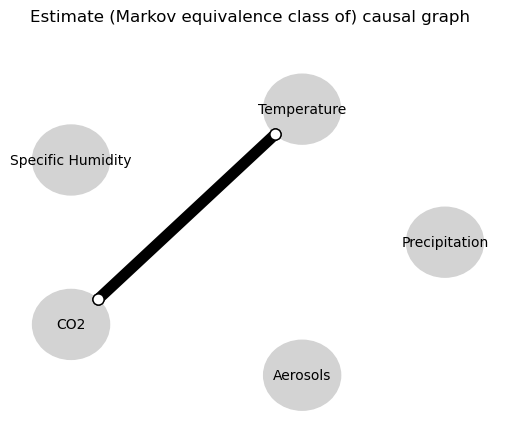

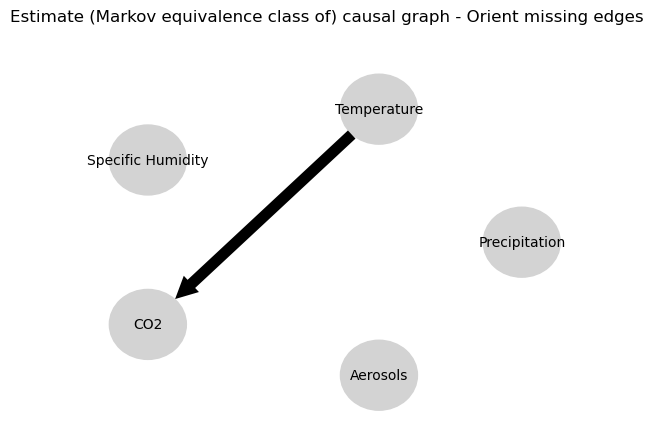

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.026435136708789088
0.18564949642127074
0.028418687544392886
-0.6280271532077385
0.025865746522486483
-0.13893396797276072
-0.09719152870016959
0.18564949642127074
-0.025105071542934388
0.0
-0.09504713682678449
0.16618983885657002
0.004953957084494528
0.03213773734370011
0.015612845232211237
-0.6280271532077385
0.04238333170583495
0.16618983885657002
-0.08844060441721244
0.0
-0.07416082087292303
0.18209958312302665
0.06445850021586386
-0.13893396797276072
0.07694508574308916
0.03213773734370011
0.059878501087091
0.18209958312302665
-0.028053888121867137
0.0
0.5462695190702944


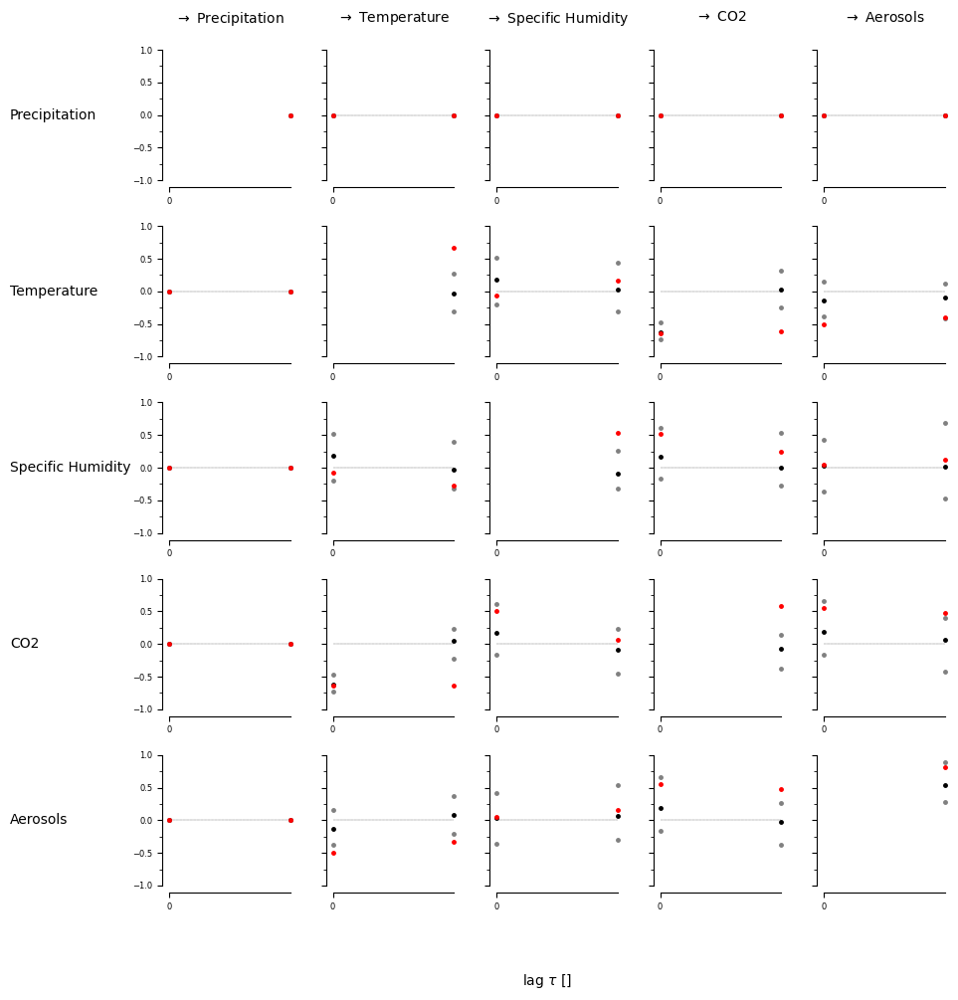

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


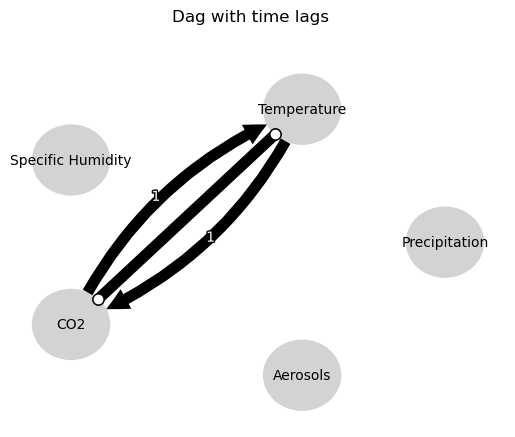

Negative precipitation values in event 24: 0


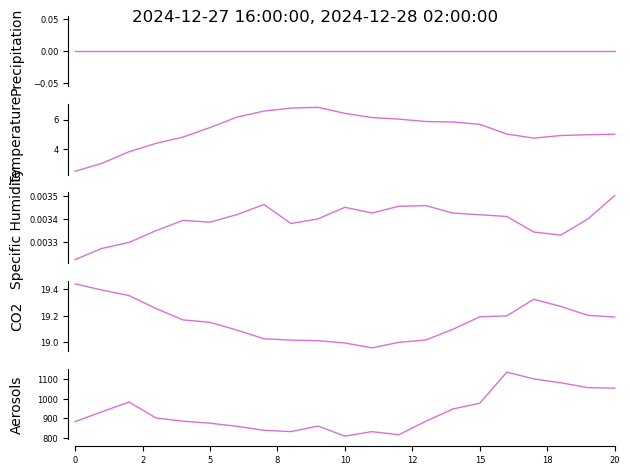


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


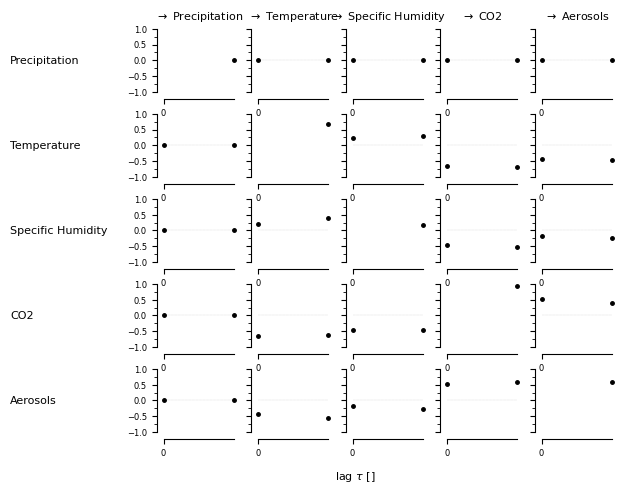

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 2 link(s):
        (CO2 -1): max_pval = 0.00000, |

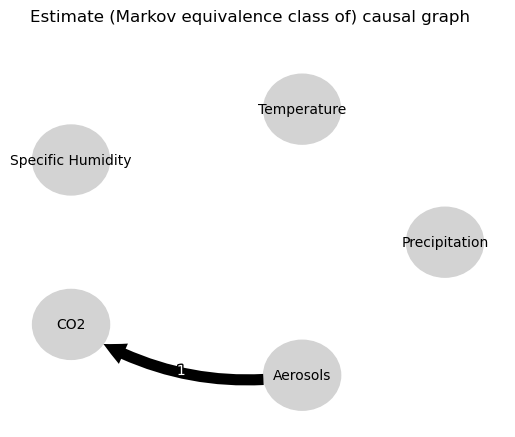

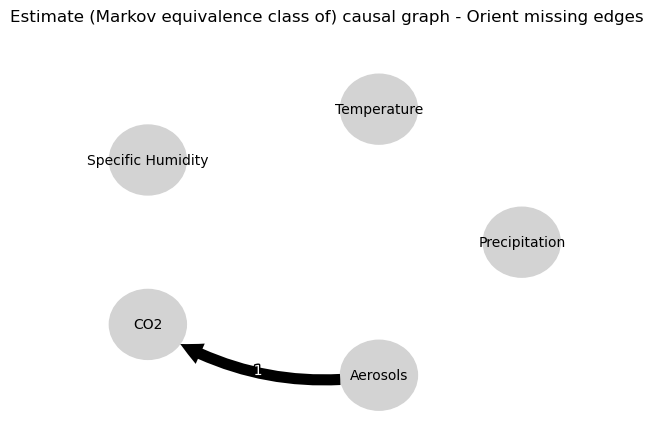

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.02969729778863217
0.6732467411598085
0.011398304062101367
-0.1565090618566469
-0.2691615555229739
-0.4652022675174378
-0.006269313279529006
0.6732467411598085
0.011582239741106065
0.0
-0.022431102481945
-0.175246059004131
-0.21879435079250842
-0.26658521810743985
-0.016705134613518562
-0.1565090618566469
-0.003077650105379696
-0.175246059004131
0.004485865041484744
0.0
0.41459150184069177
0.09485793130780672
-0.03757012113986387
-0.4652022675174378
0.001640837146141443
-0.26658521810743985
-0.021904783714963297
0.09485793130780672
0.4513664019388021
0.0
-0.045829378279399216


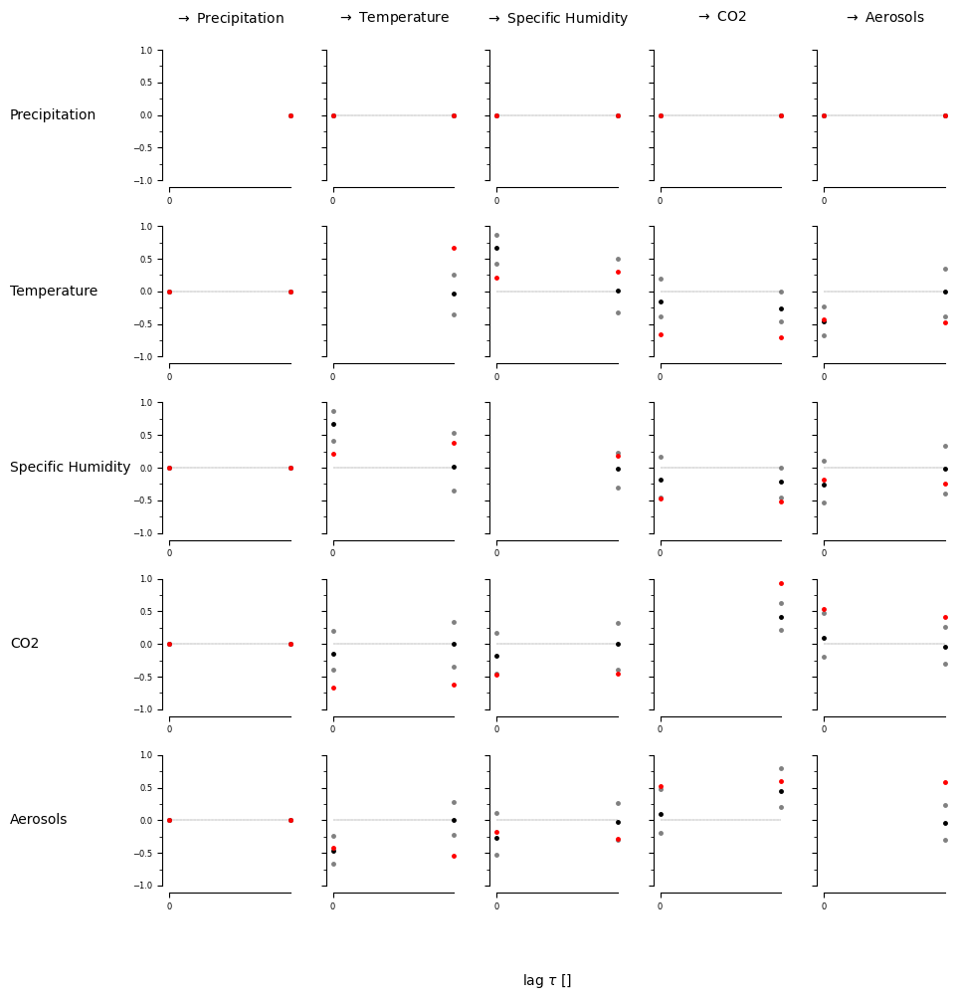

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False  True]]]


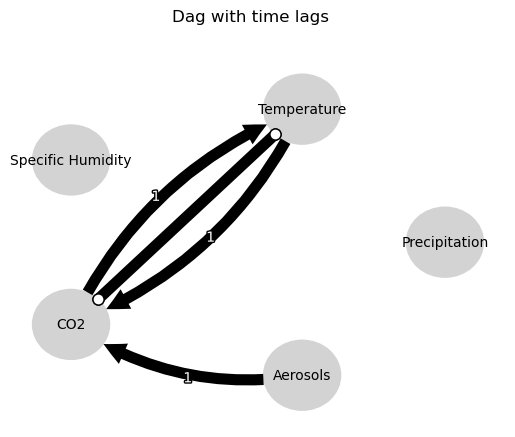

Negative precipitation values in event 25: 0


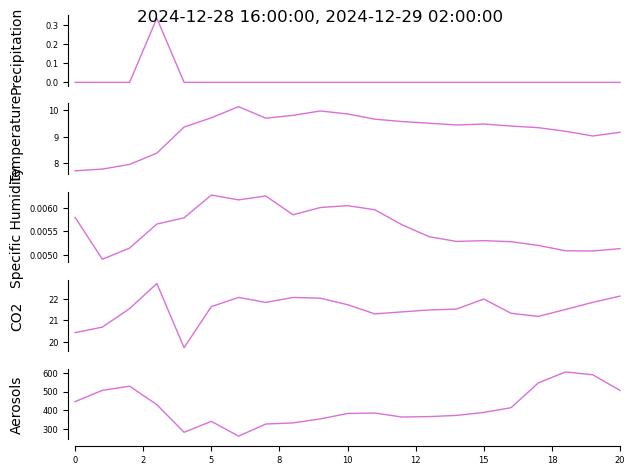


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


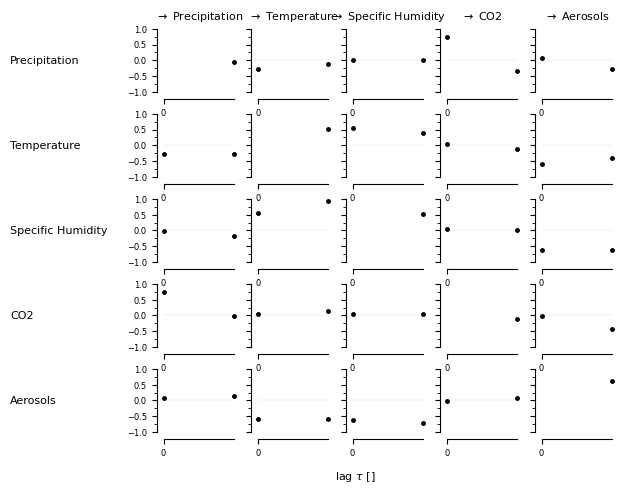

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00000, |min_val| =  0.908

    Variable Specific Humidity has 1 link(s):
 

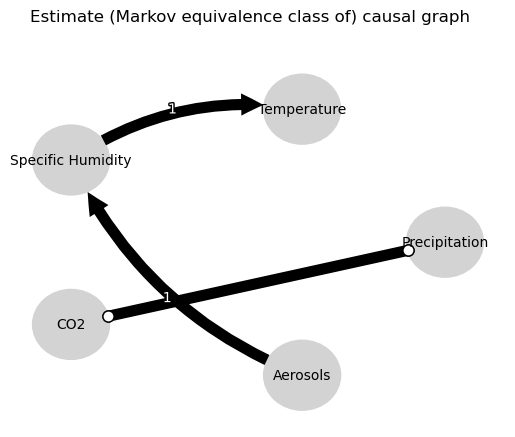

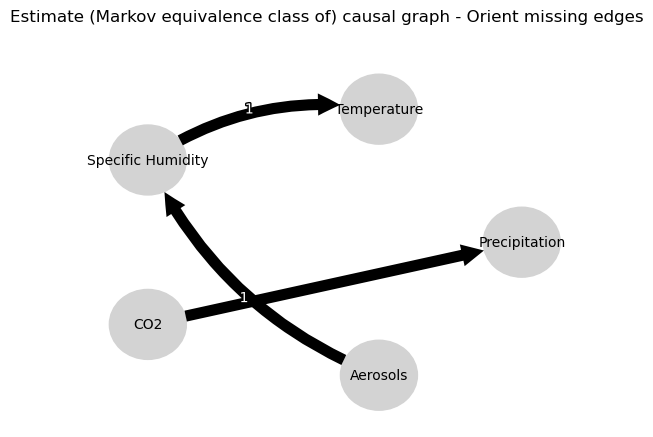

0.0
-0.051917727167498276
-0.10791924527186006
0.13328008245257317
0.23239436013295028
-0.059036897447078115
0.36566277165690386
-0.006240759364869433
0.034807607001895904
-0.035765441451985874
-0.10791924527186006
-0.018651304752839278
0.0
-0.058547753473507616
0.07503996388754867
0.031077169664097425
0.1272699333376009
-0.015299934365310519
-0.11934749593375207
0.1030198917502909
0.07503996388754867
0.5188309646587196
0.0
0.12193797659539113
0.11442800285212176
-0.04385280779658766
-0.20912992034724534
-0.09008351648995182
0.1272699333376009
0.07457034132400425
0.11442800285212176
-0.05213996904013252
0.0
-0.004491947587437314
0.12483032548428843
0.011448115716565883
-0.11934749593375207
-0.06973604903713994
-0.20912992034724534
-0.5390757805337675
0.12483032548428843
0.037517391963558994
0.0
-0.0438664419562254


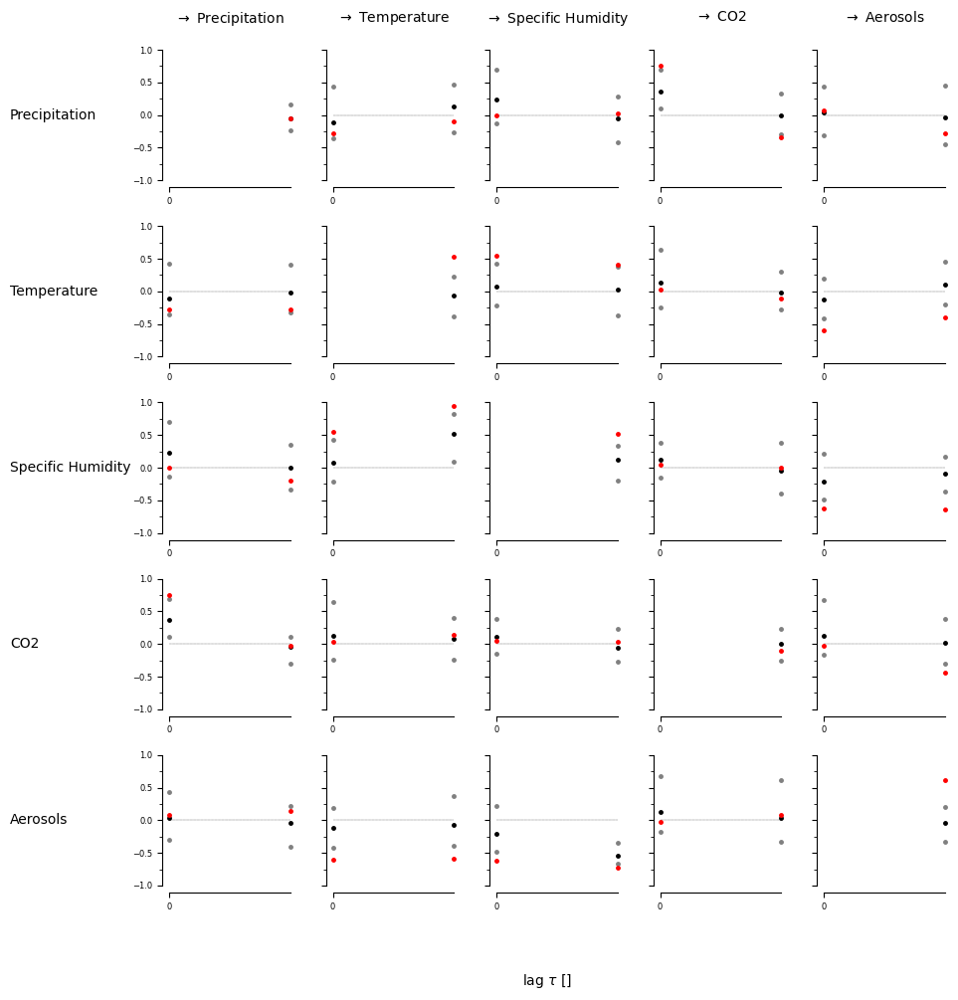

[[[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [ True False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [ True  True]]

 [[ True False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [ True  True]
  [False False]
  [False  True]]]


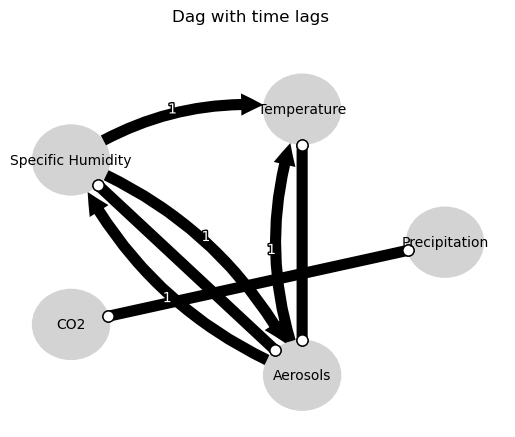

Negative precipitation values in event 26: 0


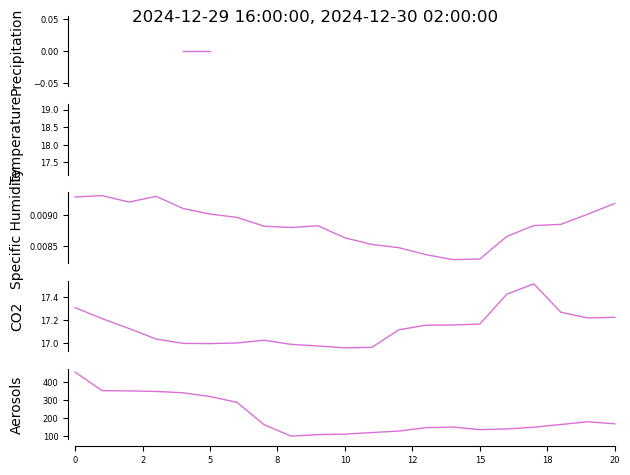


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1
⚠️ Skipping event 27 ((Timestamp('2024-12-01 16:00:00'), Timestamp('2024-12-02 02:00:00')) → (Timestamp('2024-12-02 16:00:00'), Timestamp('2024-12-03 02:00:00'))) due to error: No valid samples
Negative precipitation values in event 27: 0


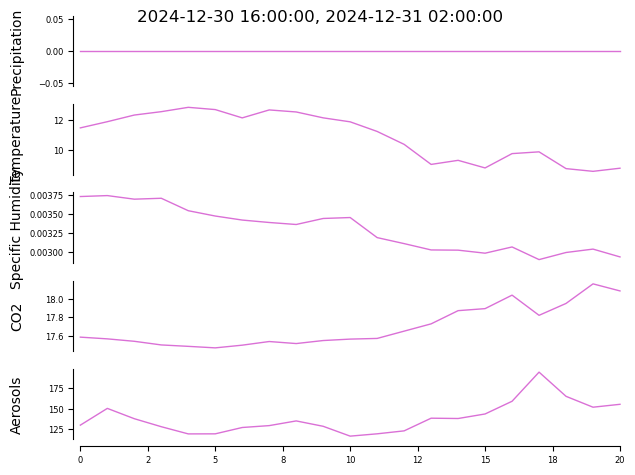


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


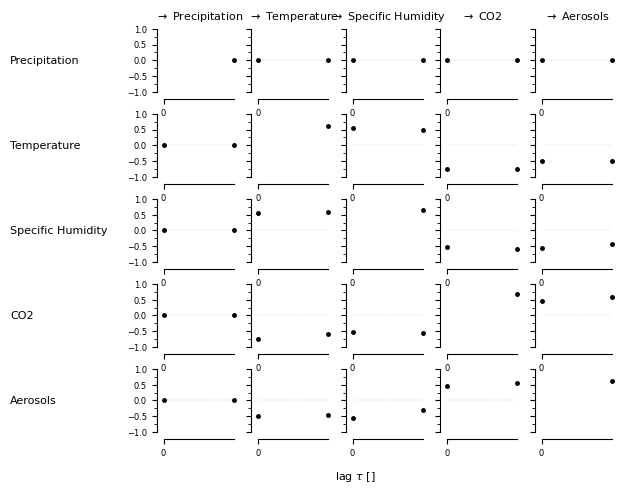

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.03672, |min_val| =  0.495

    Variable Specific Humidity has 1 link(s):
       

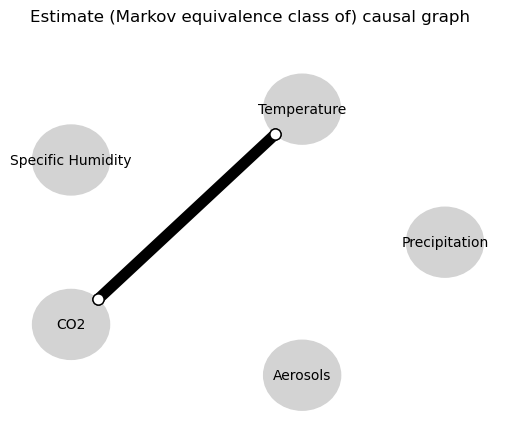

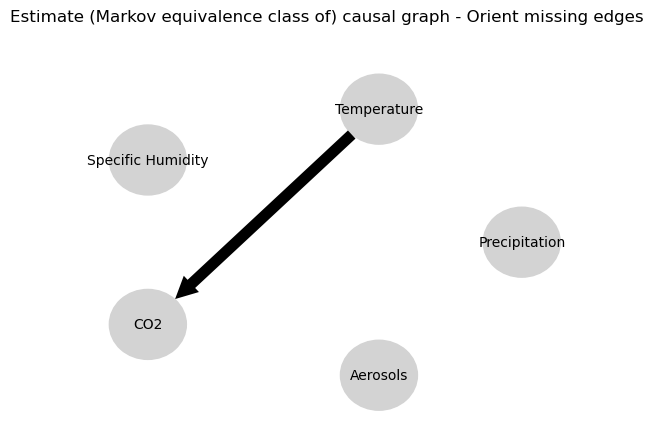

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.02639685587882718
0.7843854655027417
0.013261658010604829
-0.7217661672128777
0.04382002160761414
-0.20357273022911976
-0.14323481673057914
0.7843854655027417
-0.0568958766989515
0.0
-0.03298709938231821
-0.6362724108595386
0.06947621160482773
-0.26603522150914
-0.15192828052971916
-0.7217661672128777
0.05146874523155668
-0.6362724108595386
0.01317483790067773
0.0
-0.10962228111122568
0.2175256834069366
0.10182760857315287
-0.20357273022911976
-0.0033719408018481343
-0.26603522150914
-0.02325100762803314
0.2175256834069366
0.06330459557264394
0.0
0.46393624831709523


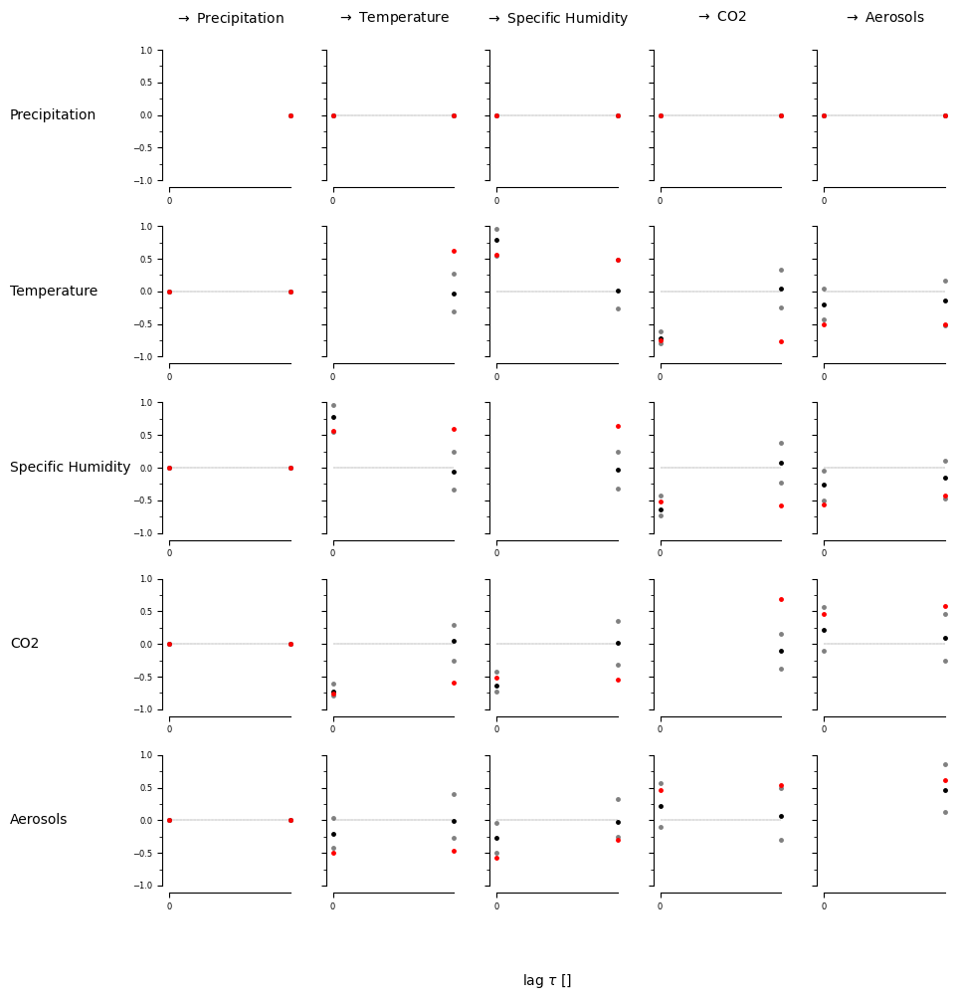

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [False  True]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False  True]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


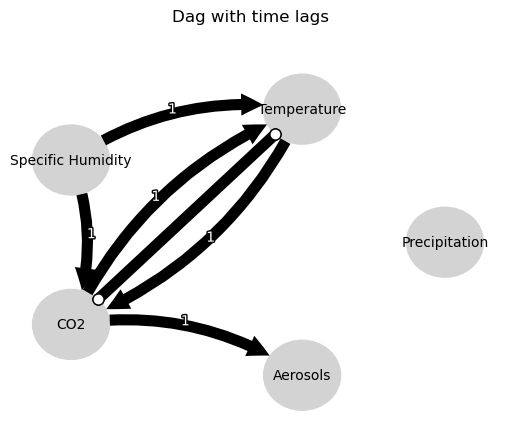

Negative precipitation values in event 28: 0


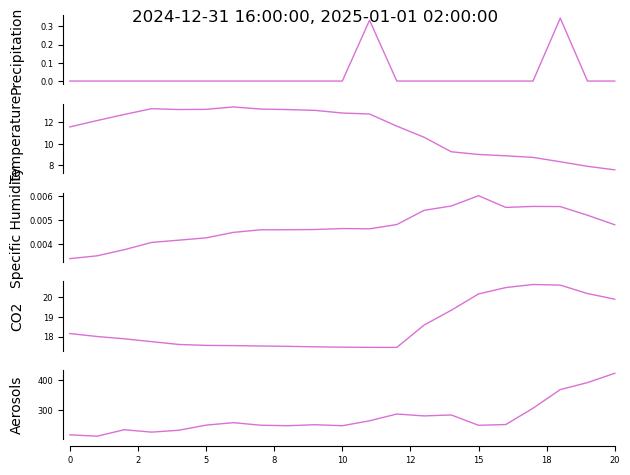


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


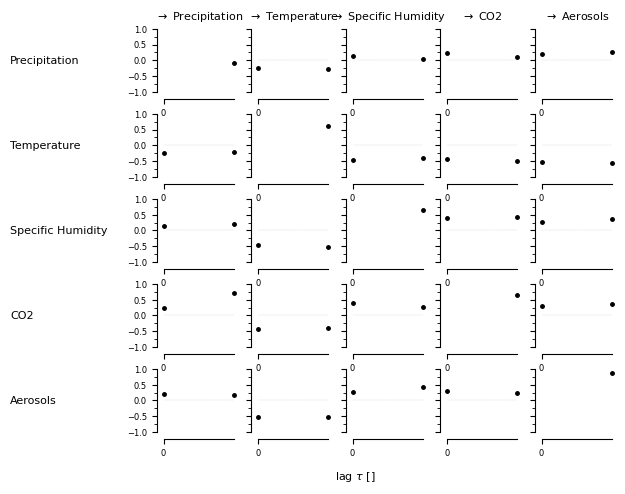

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (CO2 -1): max_pval = 0.00047, |min_val| =  0.723

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.03622, |min_val| =  0.4

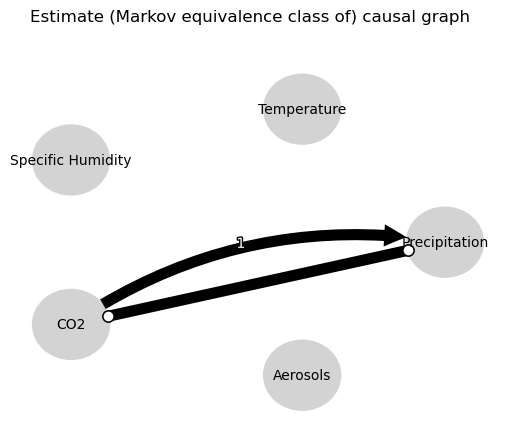

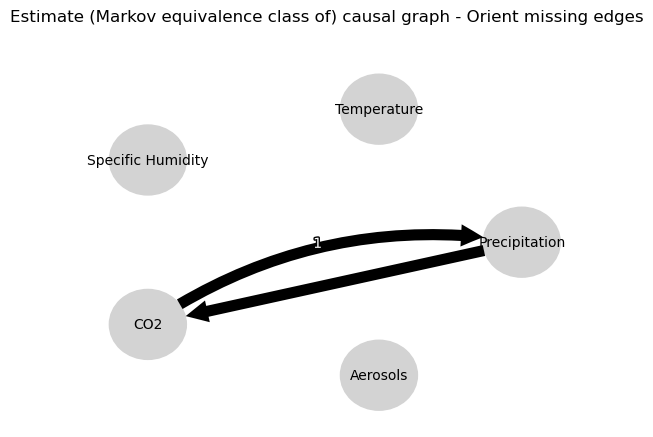

0.0
-0.07569246216366529
0.10883662043383893
0.008545483865626239
-0.023840716779654183
-0.047946904593571114
-0.005922656673373979
0.025428106915836954
-0.06335773198555704
-0.06049701786565197
0.10883662043383893
-0.0027588863279106894
0.0
-0.03794767918664203
-0.5767100933149357
0.0438914547045276
-0.08354954700711614
-0.058046501180745044
0.007489920003906458
-0.014384176136183664
-0.5767100933149357
0.0563690727649619
0.0
-0.09931385612764236
0.15753629936977054
0.11269064750394717
0.0035235635792176907
0.01917262144291437
-0.08354954700711614
0.06919439556675516
0.15753629936977054
-0.23828448725981577
0.0
0.569798486571177
-0.11518125826696654
-0.126795756172955
0.007489920003906458
0.025062704066461317
0.0035235635792176907
0.01997706411660829
-0.11518125826696654
-0.055542449973319426
0.0
0.873464648700881


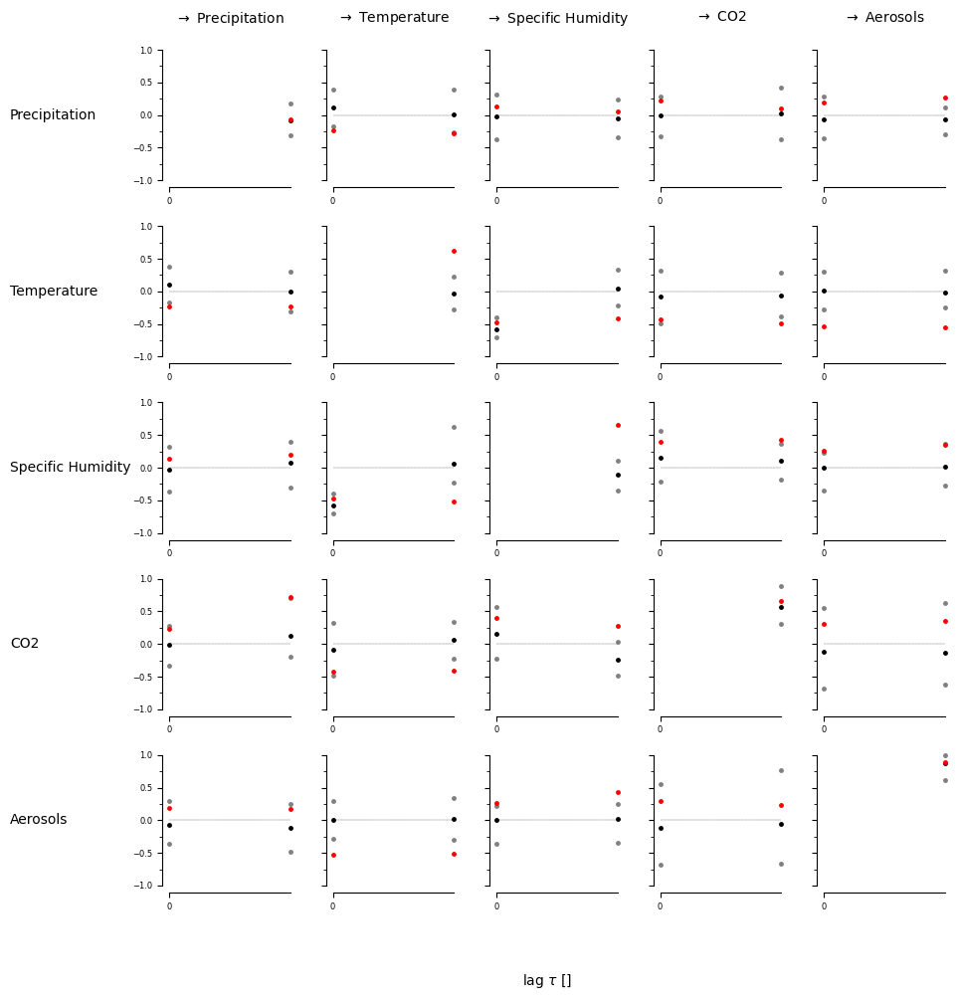

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False  True]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


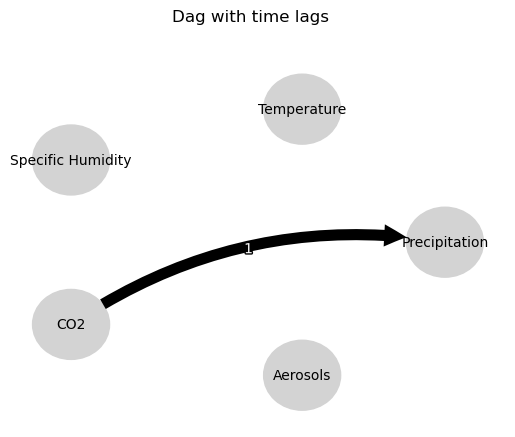

Negative precipitation values in event 29: 0


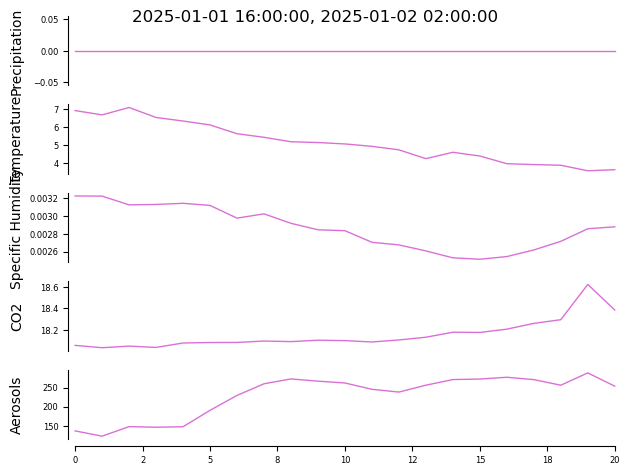


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


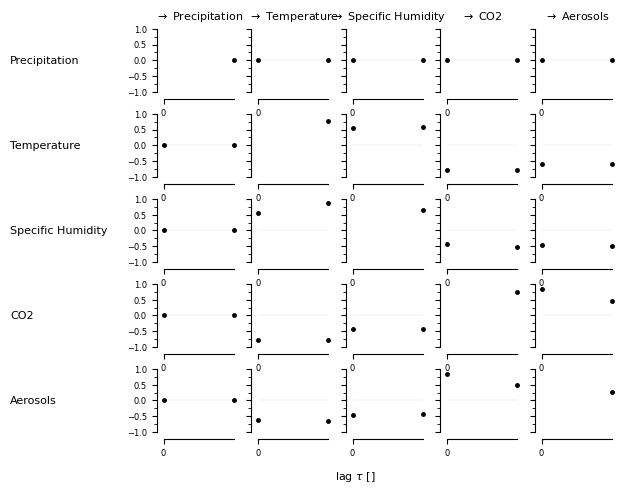

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 2 link(s):
        (Specific Humidity -1): max_pval = 0.00001, |min_val| =  0.853
        (CO2 -1): max_pval = 0.01209, |min_val| 

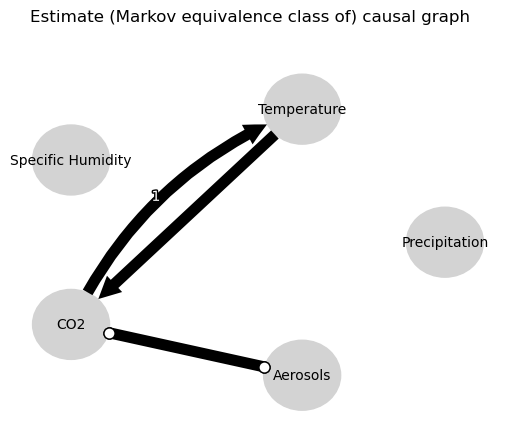

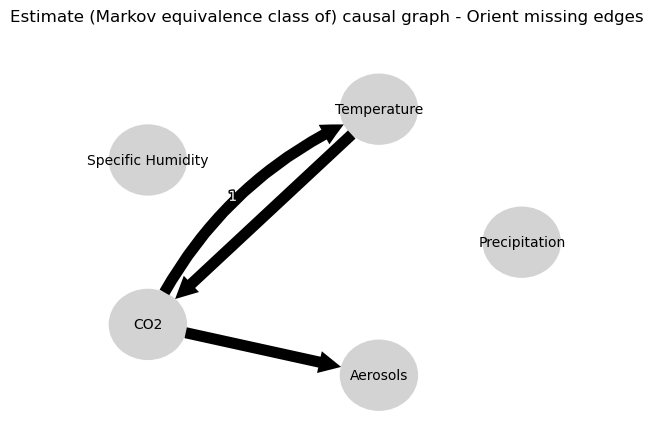

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.20470079220728765
-0.1164725475350295
-0.07492896154141858
-0.4663720514781711
-0.14644850863496534
-0.6043900189724943
-0.017151756471106127
-0.1164725475350295
-0.26413568771482415
0.0
0.45358812766882894
0.2835828380947413
0.07518278096167402
-0.05100983153446472
0.16597274478732751
-0.4663720514781711
-0.48845003760300604
0.2835828380947413
0.2052214029260462
0.0
0.2977634339354288
0.3997365143716777
0.15419663952679052
-0.6043900189724943
-0.19335968350102684
-0.05100983153446472
-0.043473760815137756
0.3997365143716777
0.11287238077956692
0.0
0.022857561605692012


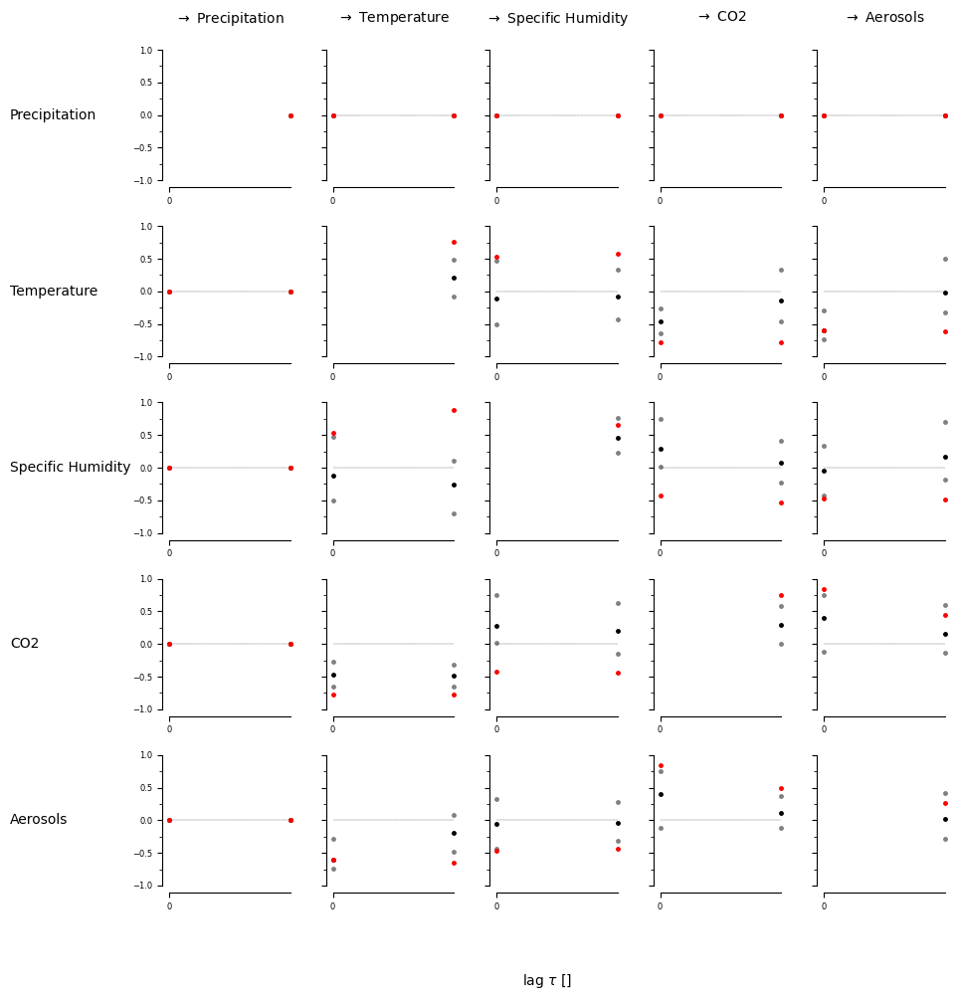

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True False]]

 [[False False]
  [ True  True]
  [False False]
  [ True False]
  [False False]]]


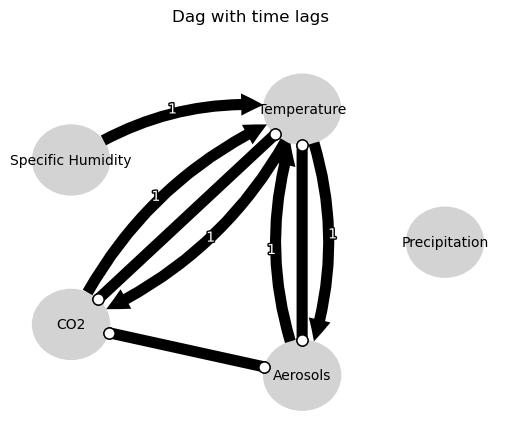

Negative precipitation values in event 30: 0


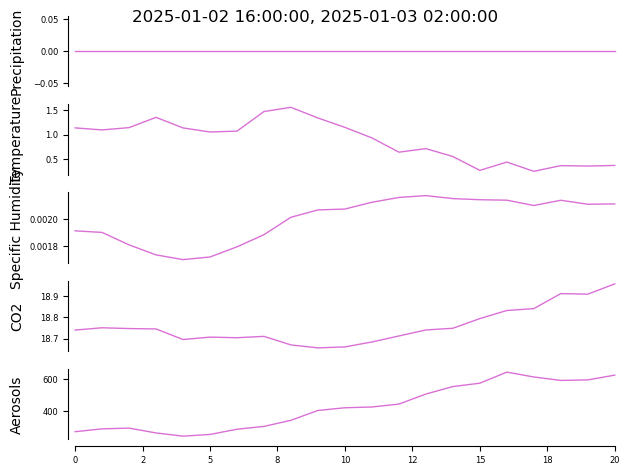


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


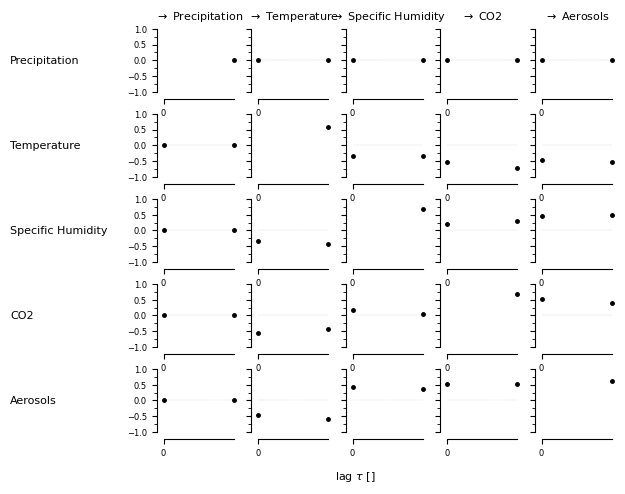

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00142, |min_val| =  0.678



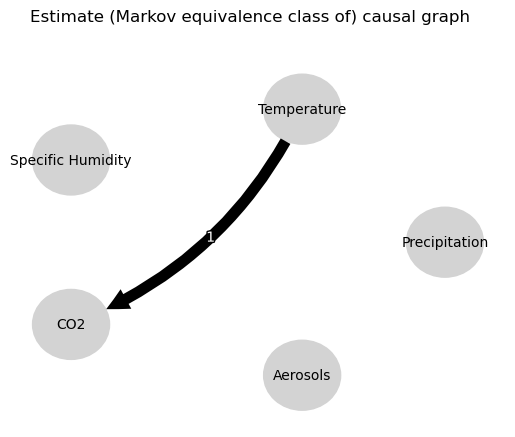

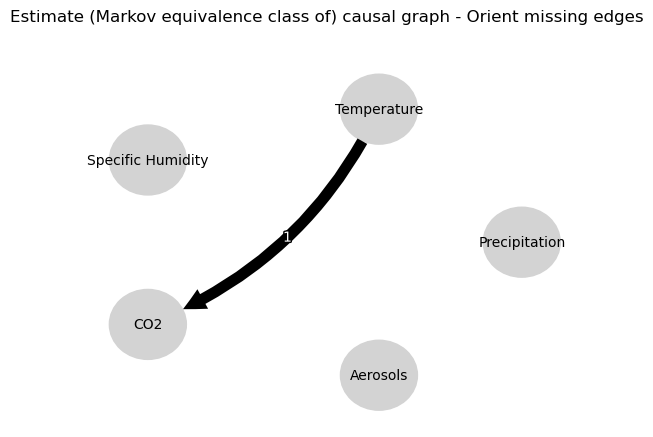

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.017903213209461668
0.09562745485582731
0.13316783606566204
-0.013495739518862406
-0.7006061725857339
-0.702891475474583
0.028273806483077386
0.09562745485582731
-0.09413354093911376
0.0
0.516539296636127
-0.09703319067509027
-0.06423839975170177
-0.007429480810902697
0.004700030599759556
-0.013495739518862406
-0.04192398028565942
-0.09703319067509027
-0.11538210460866338
0.0
-0.06784789020656432
-0.01867003261385499
0.02141595584654115
-0.702891475474583
-0.009459026569571705
-0.007429480810902697
-0.009458018058539503
-0.01867003261385499
0.684018855478266
0.0
-0.045829378279399216


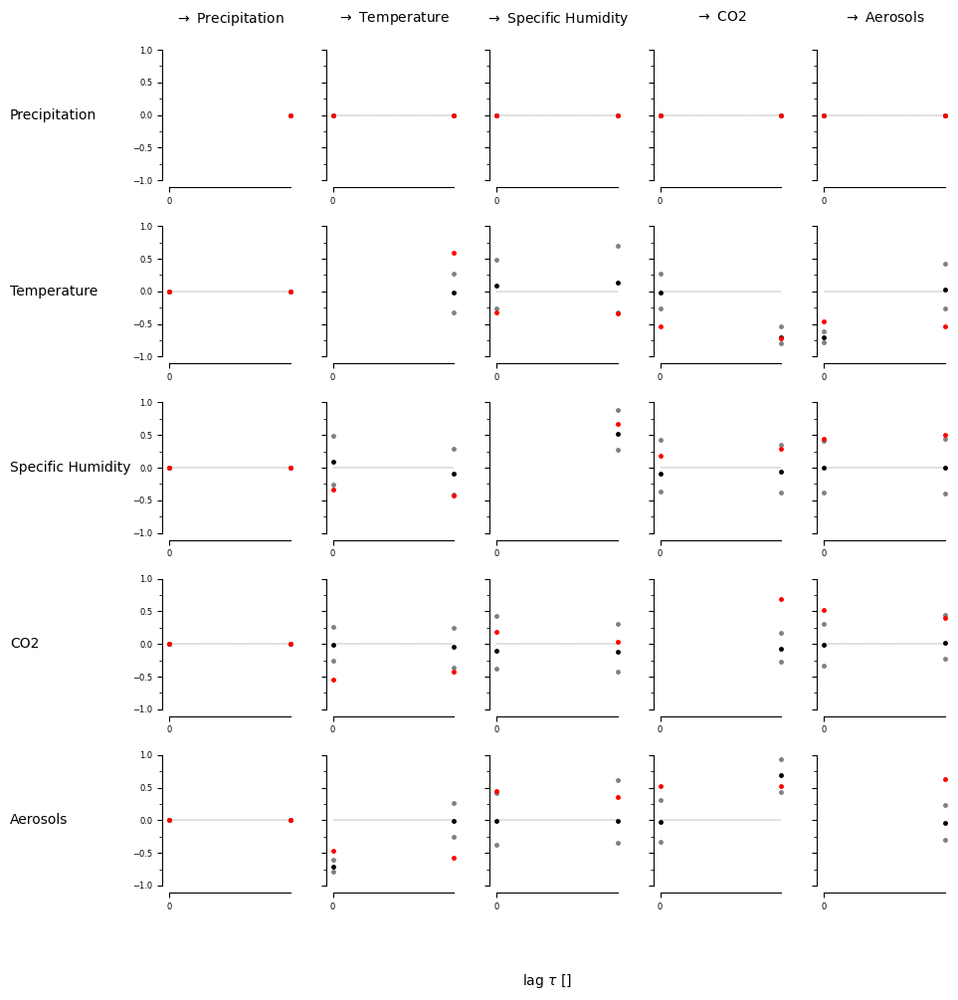

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False  True]]]


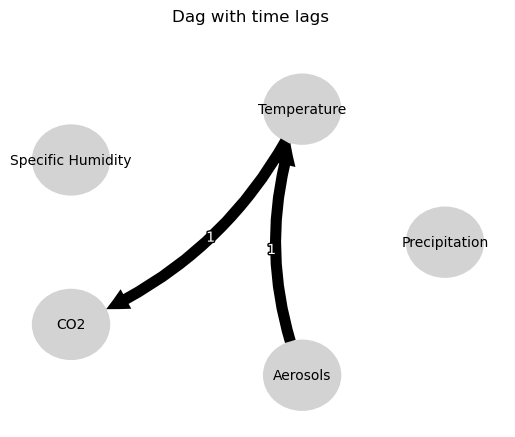

Negative precipitation values in event 31: 0


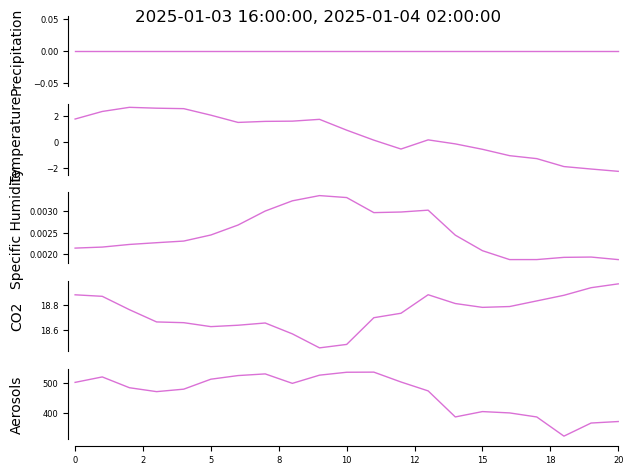


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


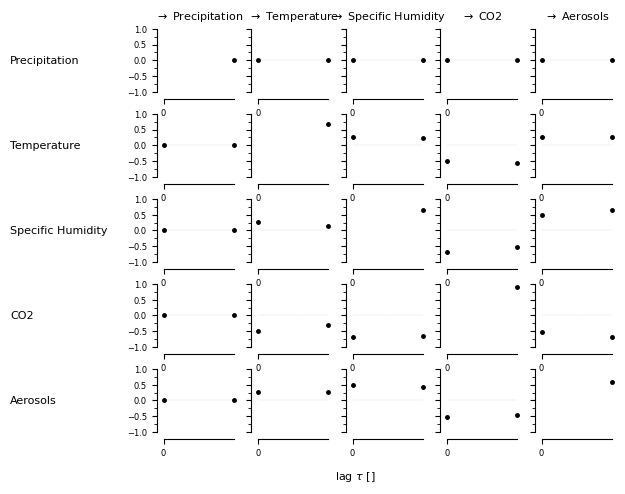

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00107, |min_val| =  0.690

    Variable Specific Humidity has 0 link(s):

    Va

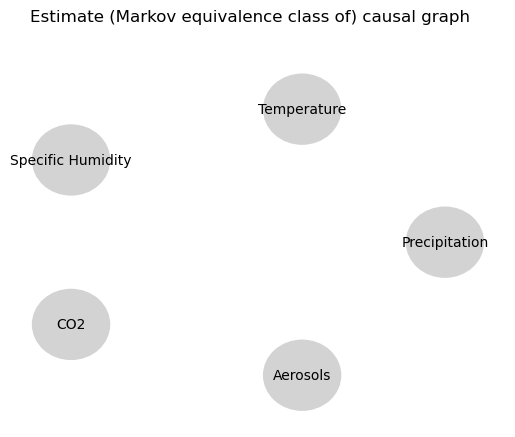

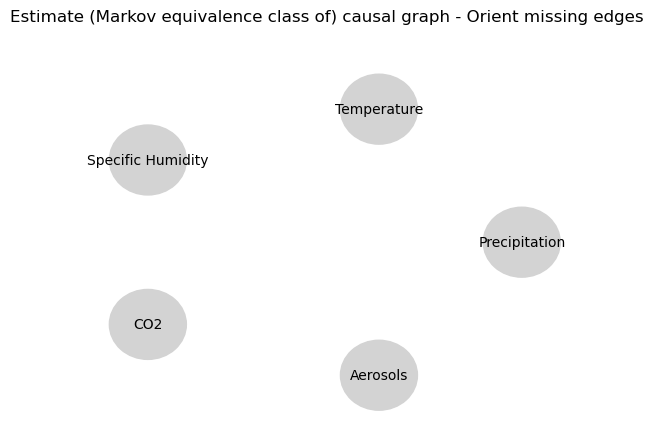

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.5750858732192915
-0.016180670465306534
0.07894106156705515
-0.02452209435419914
-0.0316397051215614
0.02815553525030077
0.12629223009921625
-0.016180670465306534
-0.027805854864900465
0.0
-0.011910498527417318
-0.07150760233535552
-0.07549334678567592
0.6476852744360996
0.019699528780491252
-0.02452209435419914
-0.06725854733947753
-0.07150760233535552
-0.0012146839502509999
0.0
0.46577154130718984
-0.14914422501755545
0.02358126800956608
0.02815553525030077
-0.00523692059894913
0.6476852744360996
-0.005143453463476942
-0.14914422501755545
-0.14954869766351356
0.0
-0.0438664419562254


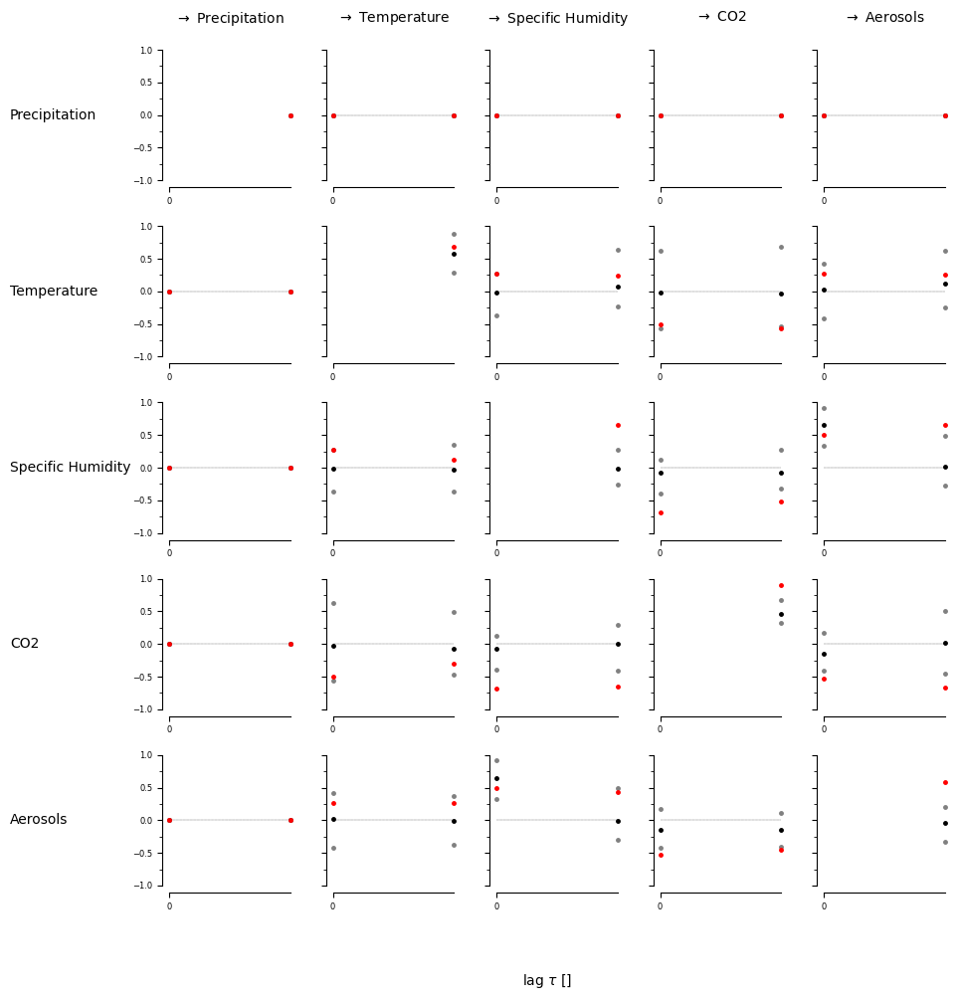

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True False]
  [False  True]]

 [[False False]
  [False False]
  [ True  True]
  [False  True]
  [False  True]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


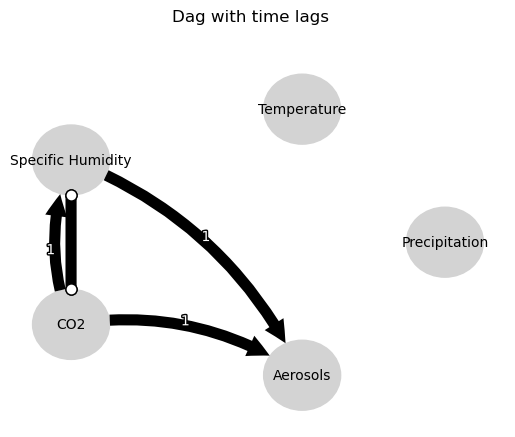

Negative precipitation values in event 32: 0


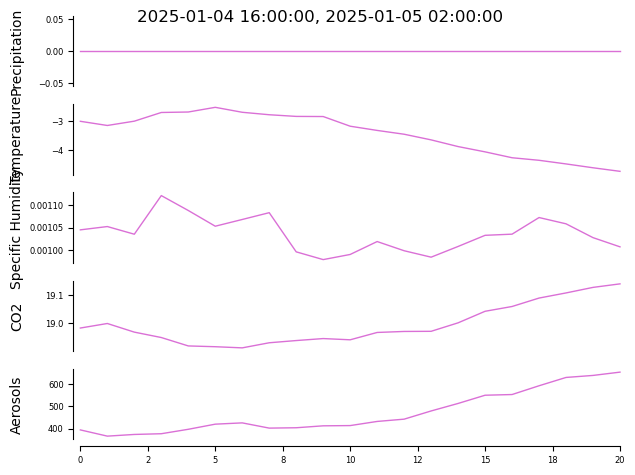


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


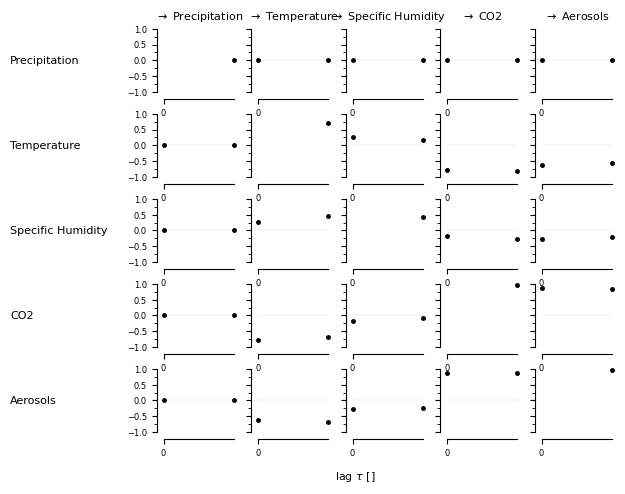

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Aerosols -1): max_pval = 0.04908, |min_val| =  0.470

    Variable Specific Humidity has 0 link(s):

    Varia

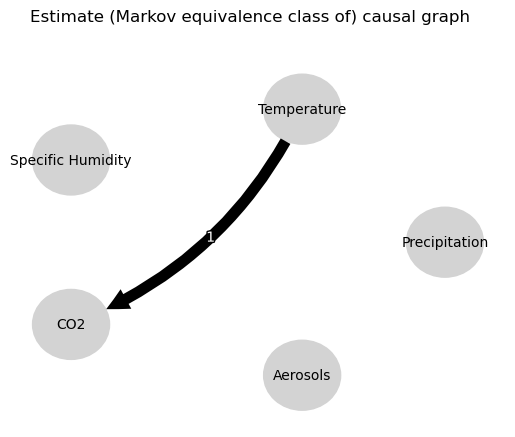

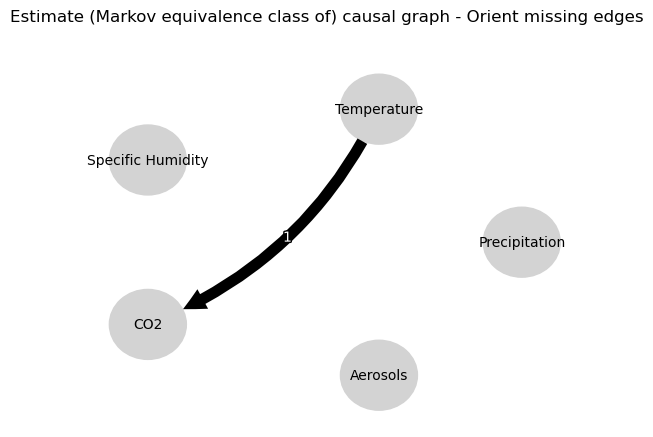

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.037777678614431556
0.17666221652993294
0.037318862950216344
0.13453906379420616
-0.6549119597741931
-0.051020159492400526
-0.051499439306134286
0.17666221652993294
0.021483295950722344
0.0
-0.0267601440130571
0.055038317866323704
-0.17004967147797187
0.005476354403629589
0.027136787669243028
0.13453906379420616
0.11890587135508902
0.055038317866323704
0.05441971040979614
0.0
0.21428941288256473
0.06590330792778086
0.052093435015466164
-0.051020159492400526
0.024668379512891584
0.005476354403629589
0.05661152847600548
0.06590330792778086
0.16312644551424801
0.0
0.7028829350205643


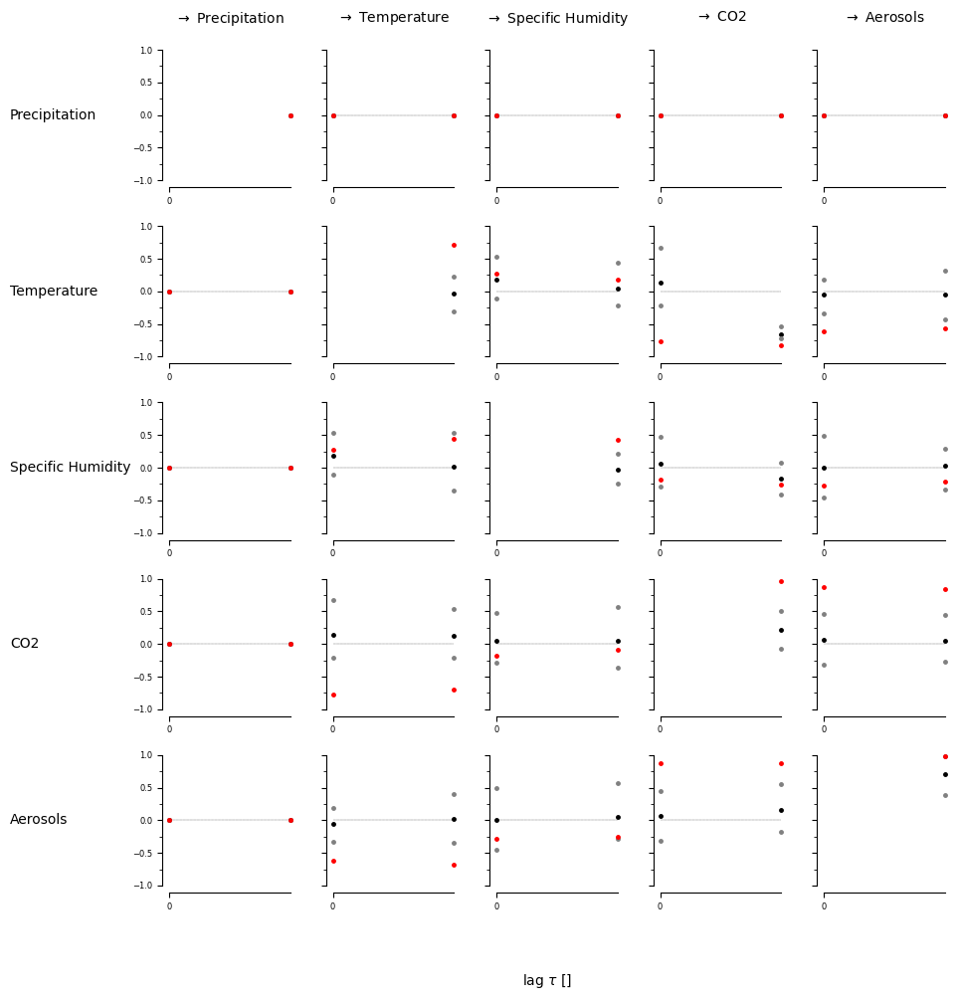

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [ True  True]
  [False  True]]]


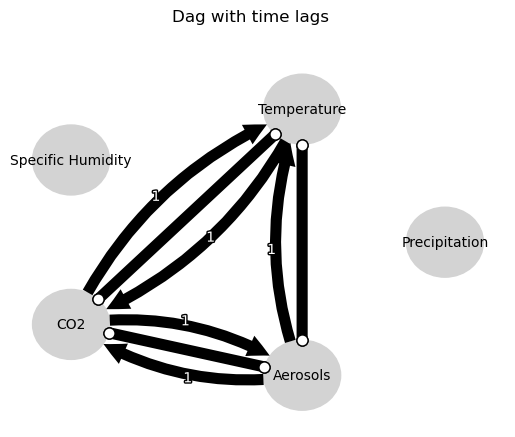

Negative precipitation values in event 33: 0


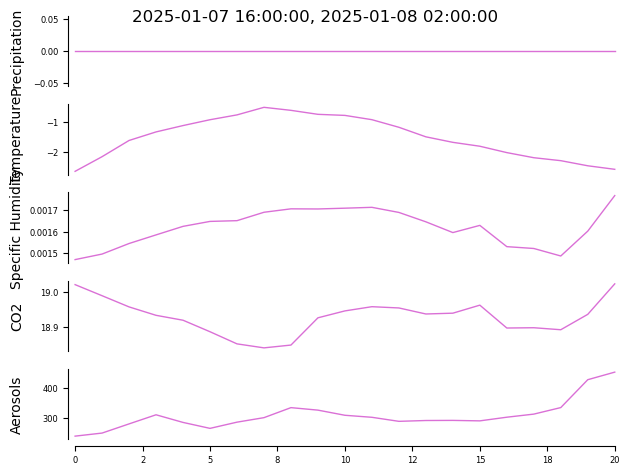


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


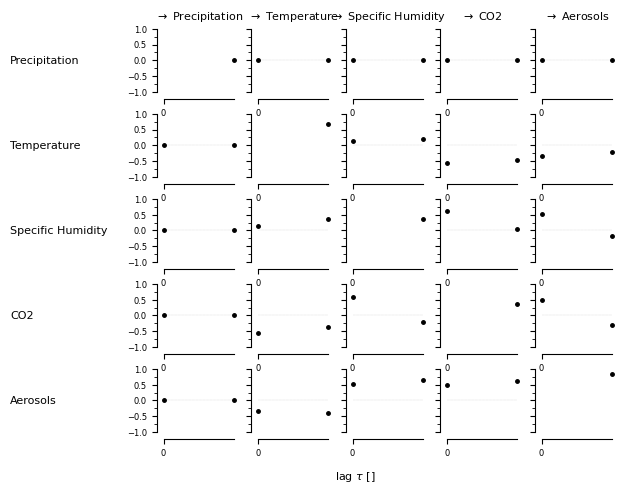

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00121, |min_val| =  0.685

    Variable Specific Humidity has 1 link(s):
       

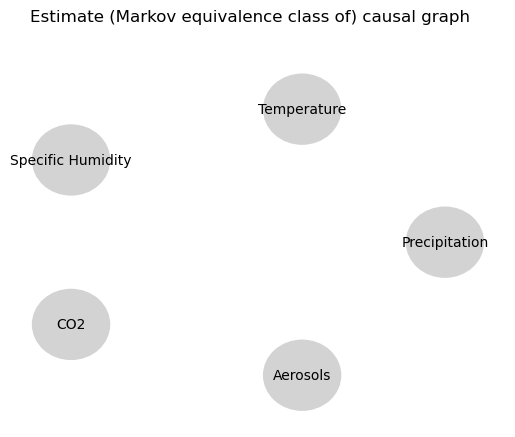

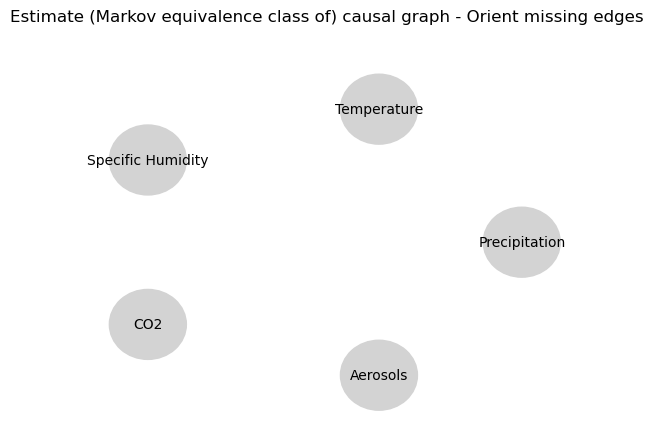

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.4477158508753
-0.04723579916010746
0.027675788194001287
-0.03517679418509326
0.050728406717857825
0.09668683150034572
0.035819093381263795
-0.04723579916010746
-0.04422703172167464
0.0
-0.0777187774409435
-0.04060828683147603
-0.017714137331402532
-0.048299359930794955
-0.05629675042890826
-0.03517679418509326
-0.024982533034982327
-0.04060828683147603
0.07361632196472491
0.0
-0.07166880468969405
-0.011186688648261079
-0.02898943301736081
0.09668683150034572
0.07016227157068067
-0.048299359930794955
0.06083758995573821
-0.011186688648261079
0.038949950505570055
0.0
0.6842583262345773


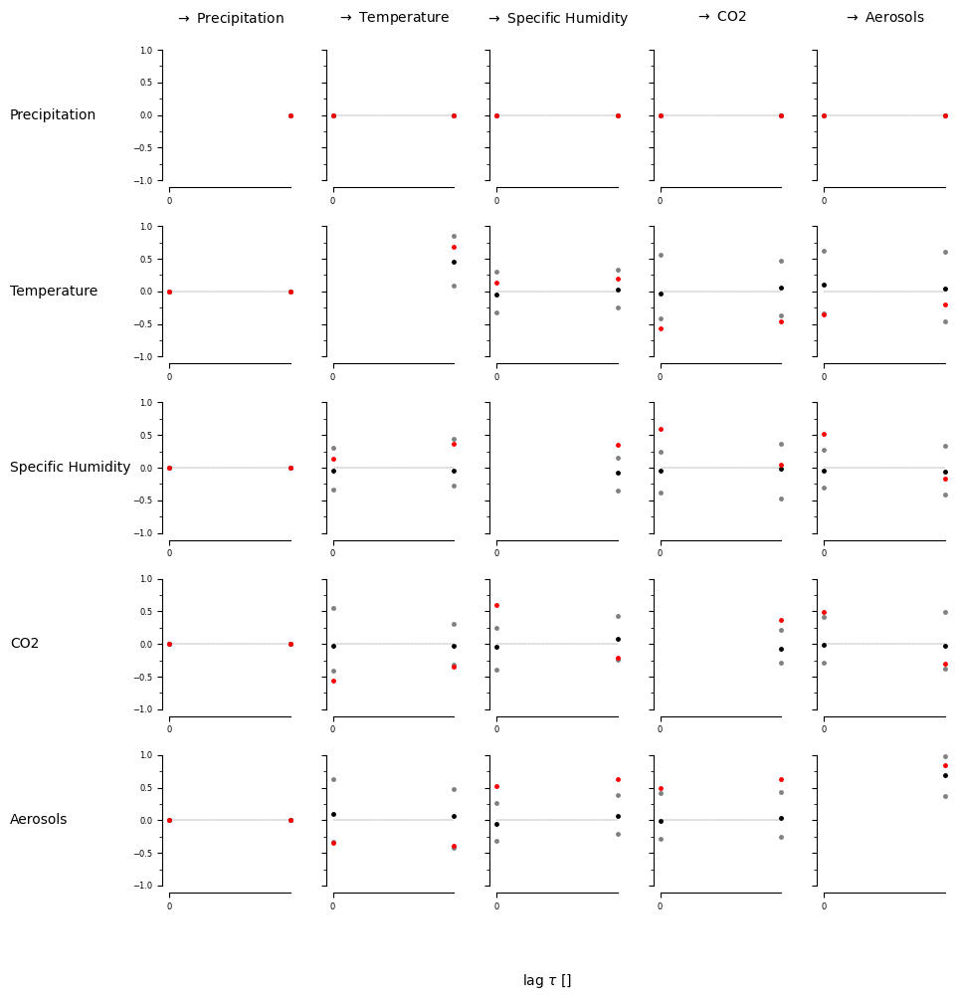

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False  True]
  [False  True]]]


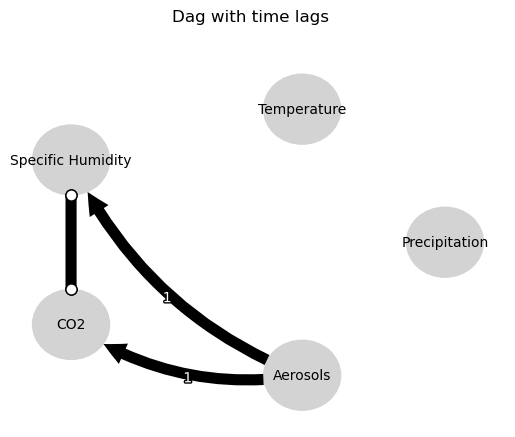

Negative precipitation values in event 34: 0


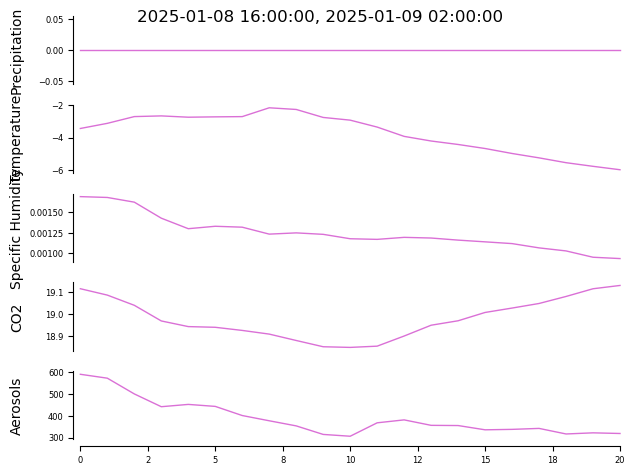


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


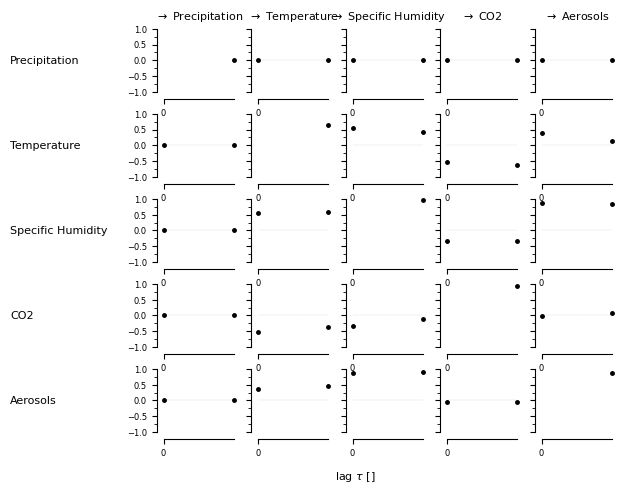

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.02407, |min_val| =  0.529

    Variable Specific Humidity has 1 link(s):
       

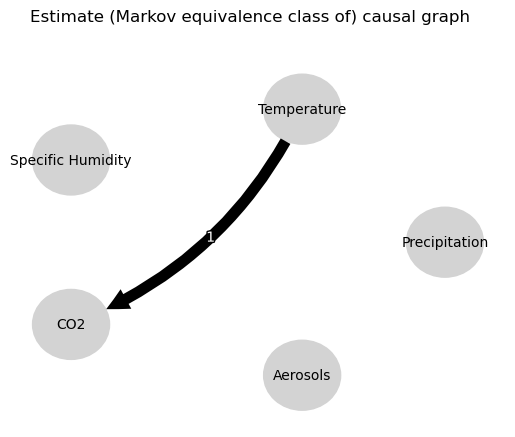

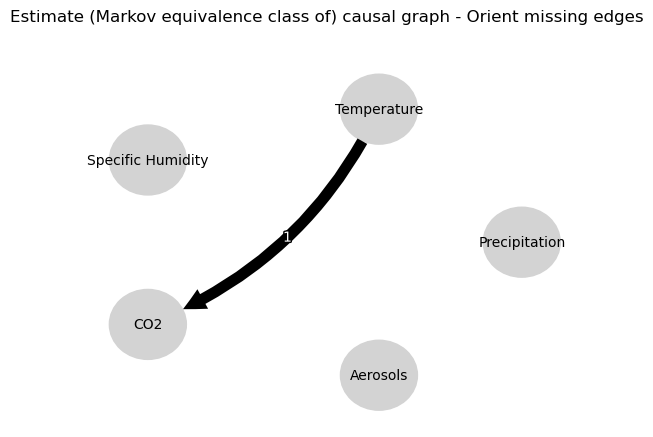

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.734750501983013
0.02654152326915226
0.07413253888994999
-0.5839241377933153
-0.6779363582049505
0.05065917939269197
0.06407950009793248
0.02654152326915226
-0.003667336095011159
0.0
0.5547816347409006
0.037819597247049655
0.05925615835687504
0.22475474758965244
0.1349336839143971
-0.5839241377933153
-0.5320901691190763
0.037819597247049655
-0.007342036289205341
0.0
0.7594231802642192
-0.0024704836323575174
-0.02323435101999645
0.05065917939269197
0.0987408261845983
0.22475474758965244
0.22413032423472942
-0.0024704836323575174
-0.06194524663484946
0.0
0.4918857567765187


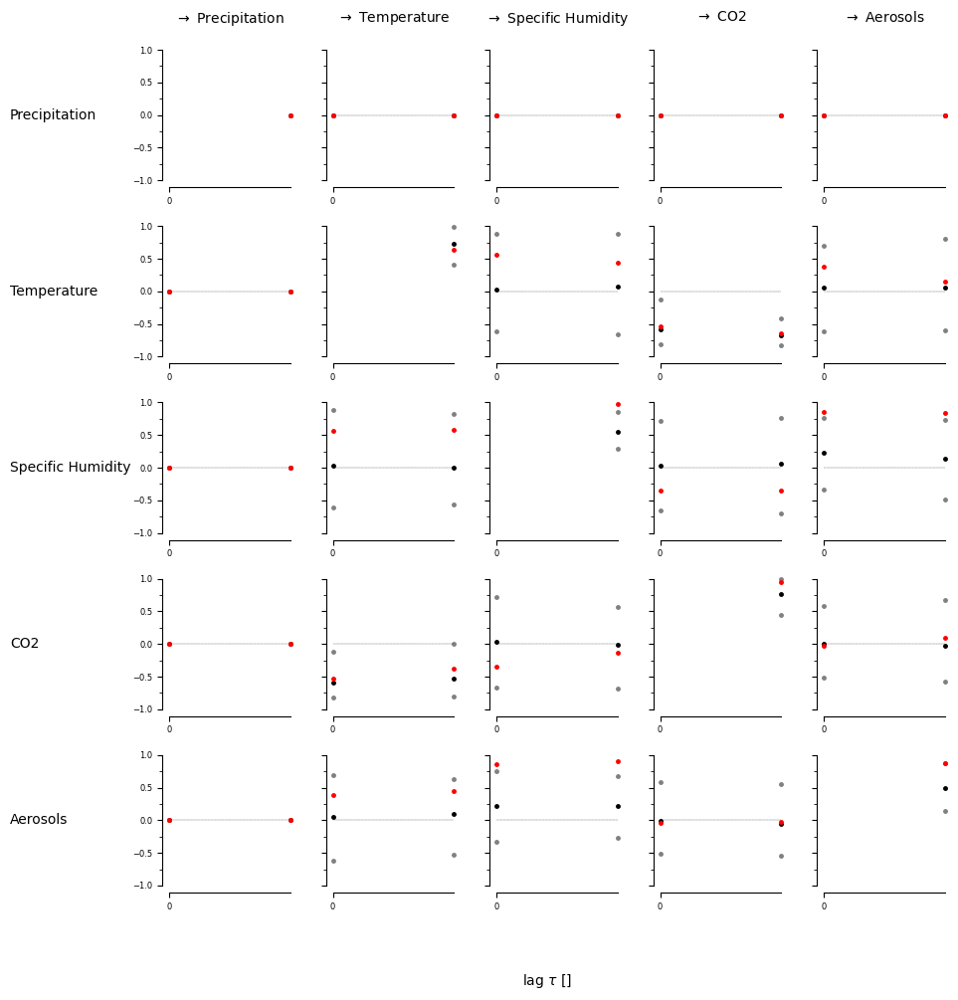

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [ True  True]
  [False False]
  [False  True]]]


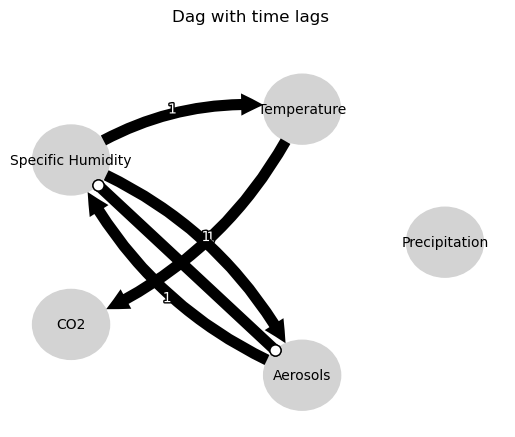

Negative precipitation values in event 35: 0


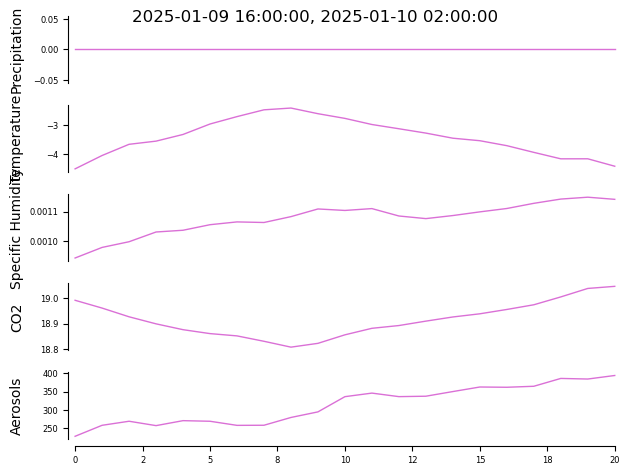


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


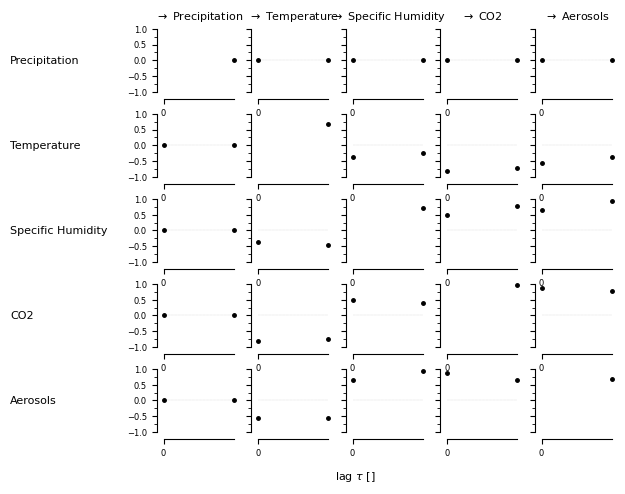

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Aerosols -1): max_pval = 0.00001, |min_val| =  0.855

    Varia

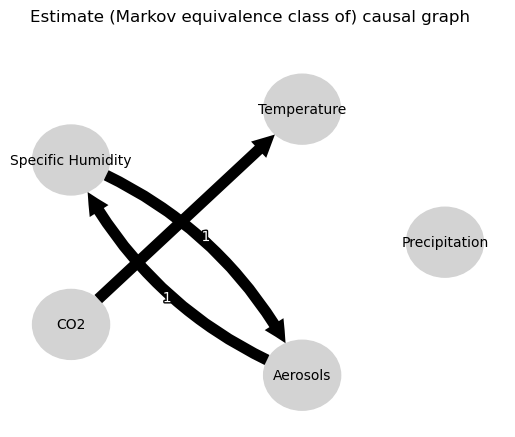

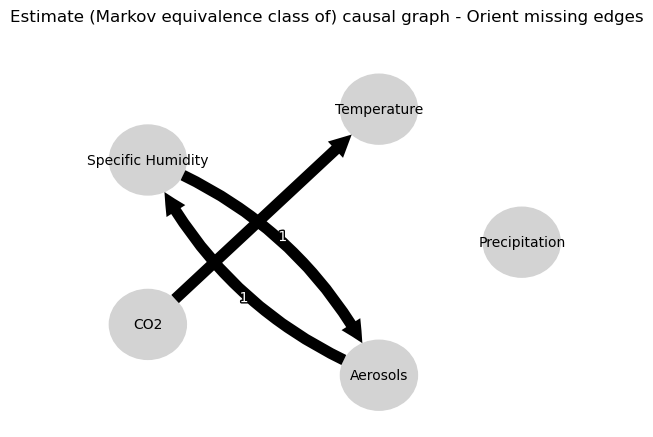

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.5210203424406616
0.006551274366626799
-0.10152006615944394
-0.6646797062231115
-0.4623567427923696
-0.23642280938288185
0.020669277409583766
0.006551274366626799
-0.11254274095358895
0.0
-0.45286074504181906
0.10757726482560757
0.11475265047613567
-0.5757221015309218
0.5952789364102371
-0.6646797062231115
-0.6637766274643122
0.10757726482560757
0.04007649079879362
0.0
0.5960193070150254
0.17959670329077473
0.09552081818851073
-0.23642280938288185
-0.10668414377913192
-0.5757221015309218
0.6450151998390704
0.17959670329077473
0.08115570470625329
0.0
-0.4334115668724447


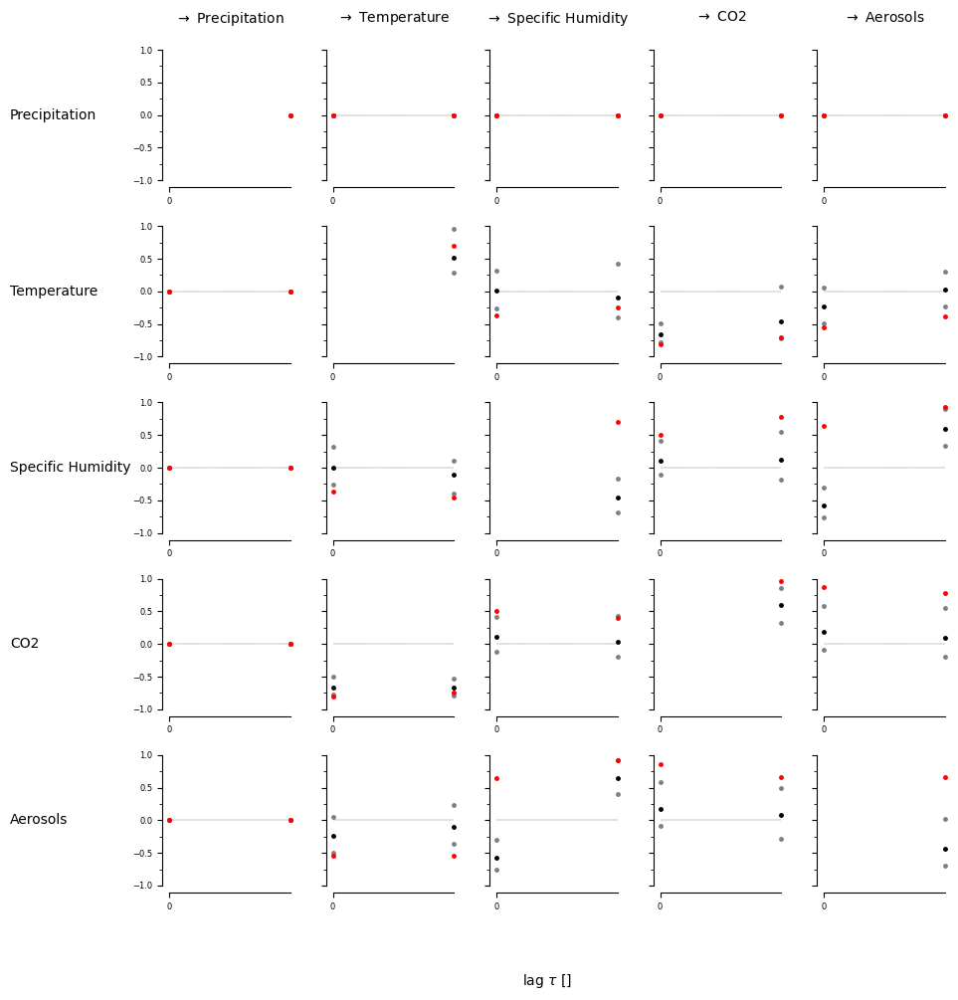

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [ True  True]
  [ True  True]
  [False  True]]]


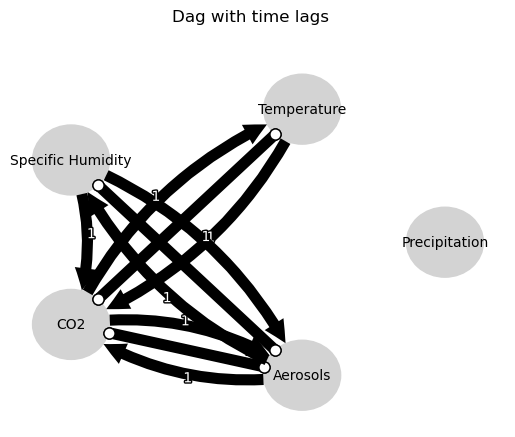

Negative precipitation values in event 36: 0


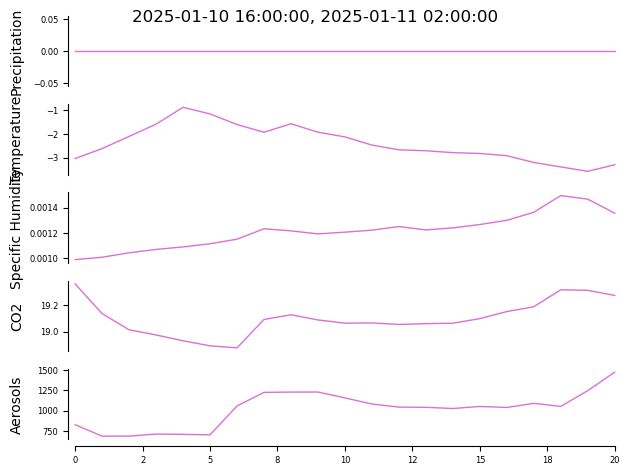


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


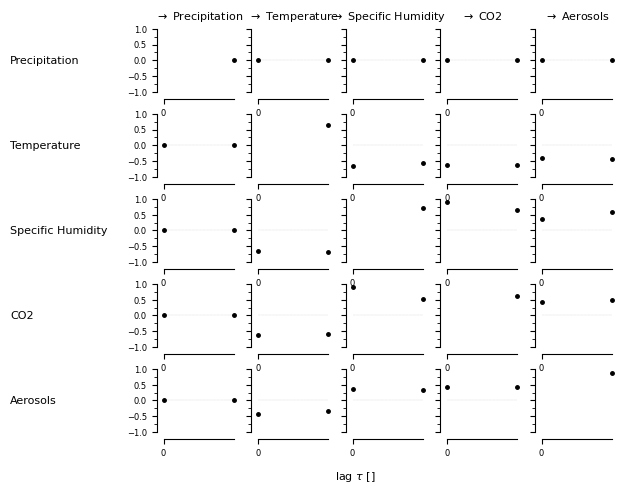

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.01715, |min_val| =  0.554



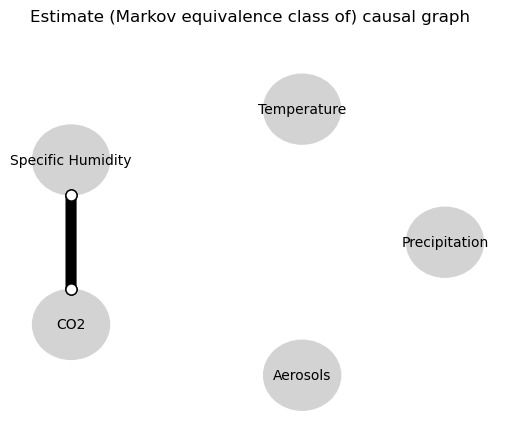

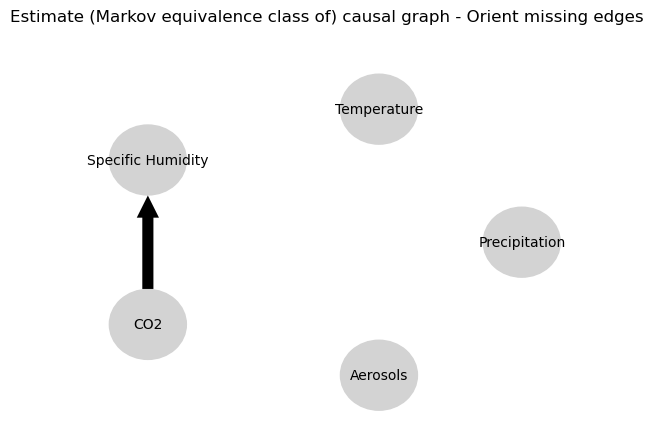

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.07502421482865808
-0.5853019162688322
0.04507893442693564
-0.6705565643200356
-0.018362476943929968
0.017677097607214646
-0.011620737250405964
-0.5853019162688322
-0.024731415572726605
0.0
-0.006521132194610035
0.6562923795011991
0.008275538103139276
0.08901638957219712
0.1143511409453583
-0.6705565643200356
0.03672108423746558
0.6562923795011991
-0.05763112864328467
0.0
-0.04079797228047731
0.009385814623515872
0.01950848350062847
0.017677097607214646
0.04934869178887729
0.08901638957219712
-0.11038880712837355
0.009385814623515872
-0.018903097593107095
0.0
0.520613021459738


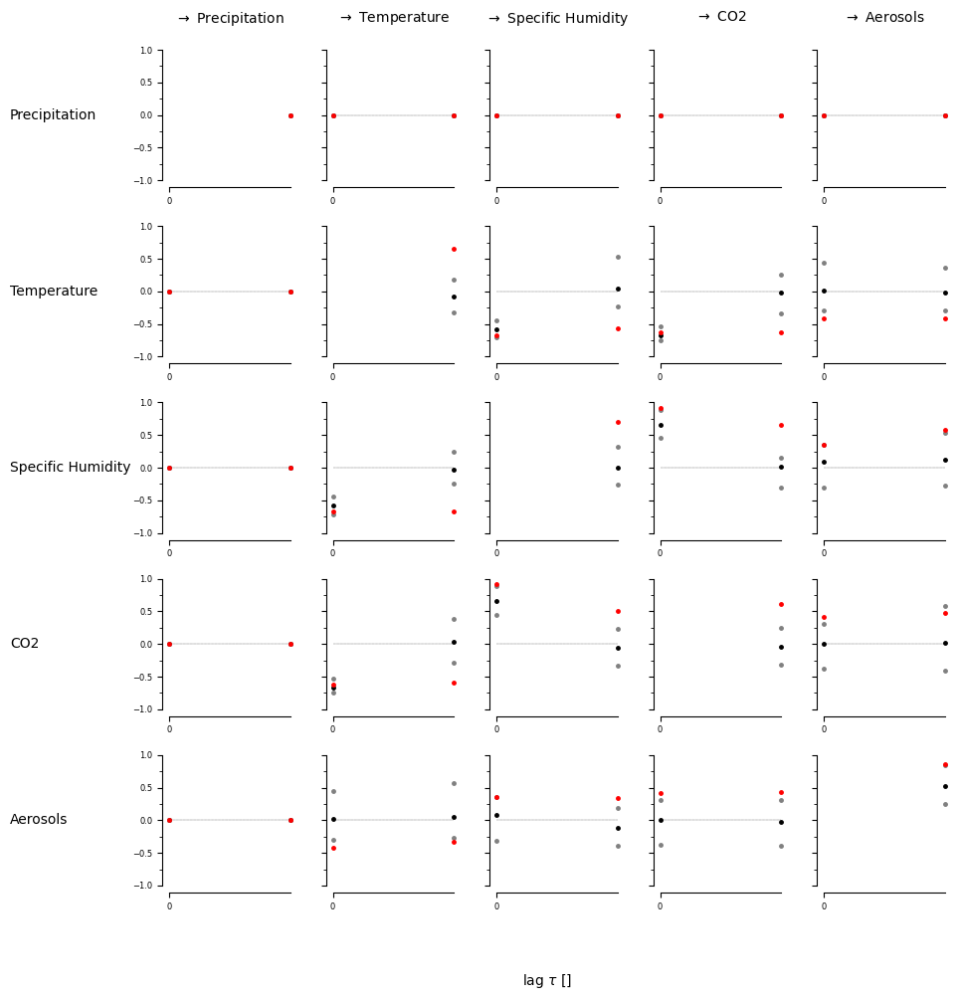

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True False]
  [ True  True]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [ True  True]
  [False  True]]

 [[False False]
  [ True  True]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


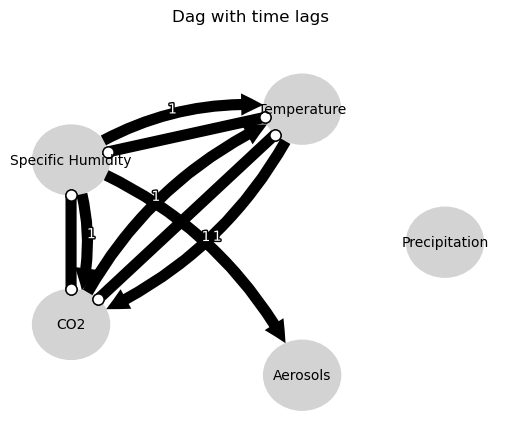

Negative precipitation values in event 37: 0


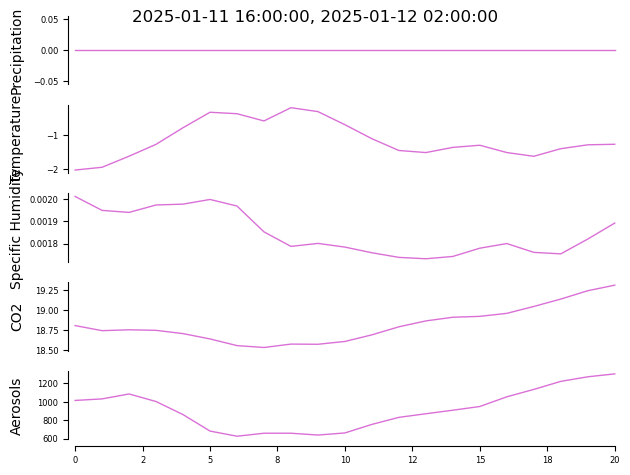


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


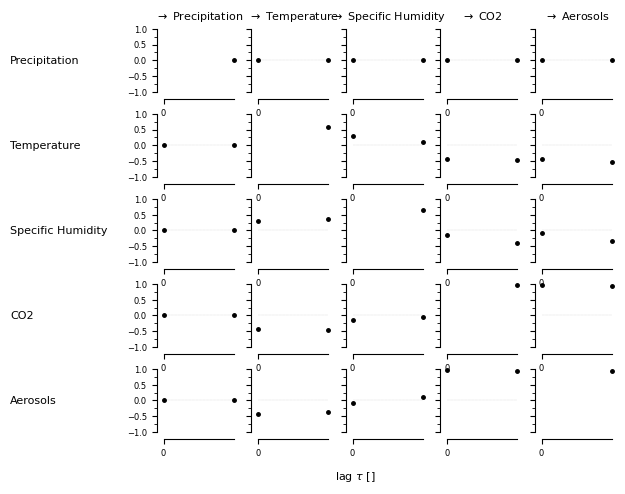

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.04687, |min_val| =  0.474

    Variable Specific Humidity has 1 link(s):
       

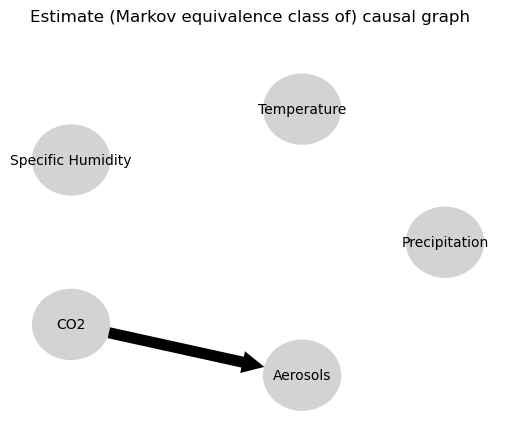

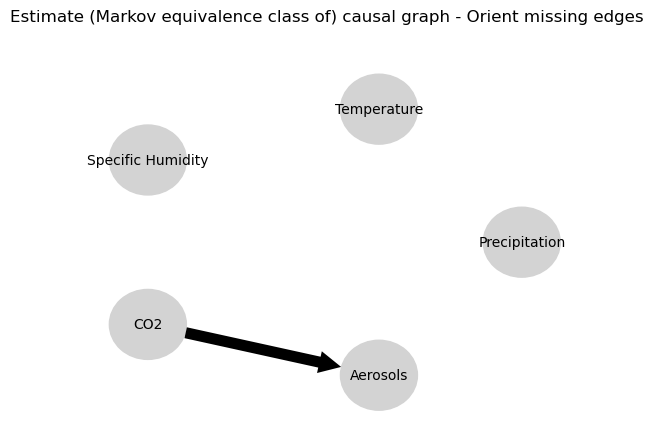

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.4173078593276371
0.2541428421443745
0.12498413954242081
0.008837122611517942
-0.003877690223116681
0.04926999467428259
-0.0352899848964499
0.2541428421443745
0.17140988499059964
0.0
0.4444448297451605
0.01371408311905387
0.01701034764121334
0.013996349533981722
-0.03146372194645336
0.008837122611517942
0.07145537053255566
0.01371408311905387
0.07212309903070485
0.0
0.8353728102321251
0.7873269046254925
0.7950827647429859
0.04926999467428259
0.12658965046291212
0.013996349533981722
0.06660749961222588
0.7873269046254925
0.6944208471709779
0.0
0.6416290747660582


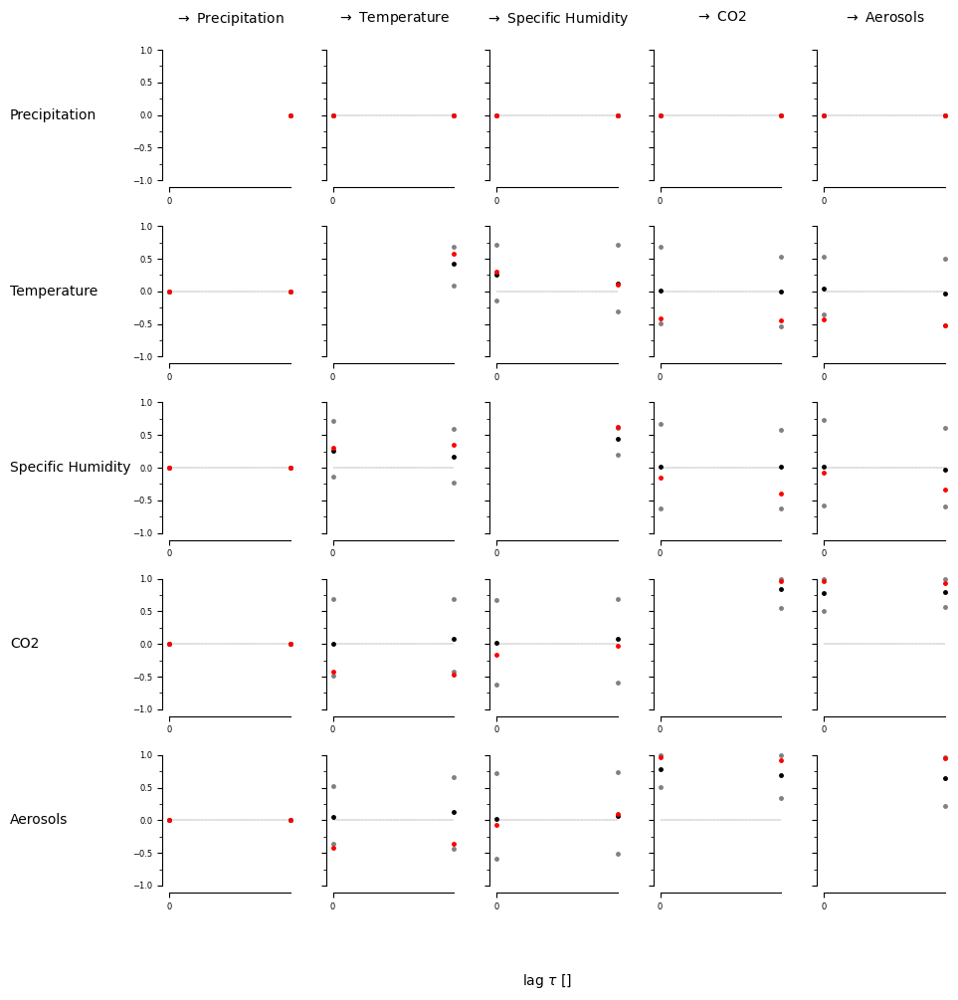

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False  True]]]


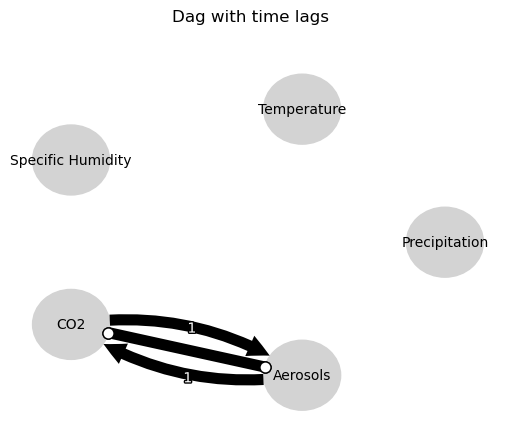

Negative precipitation values in event 38: 0


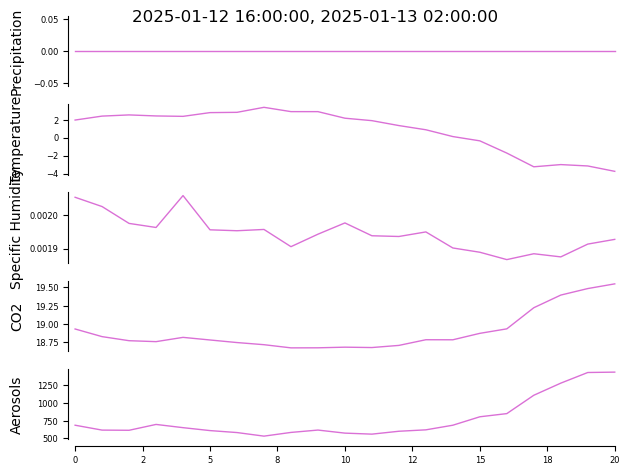


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


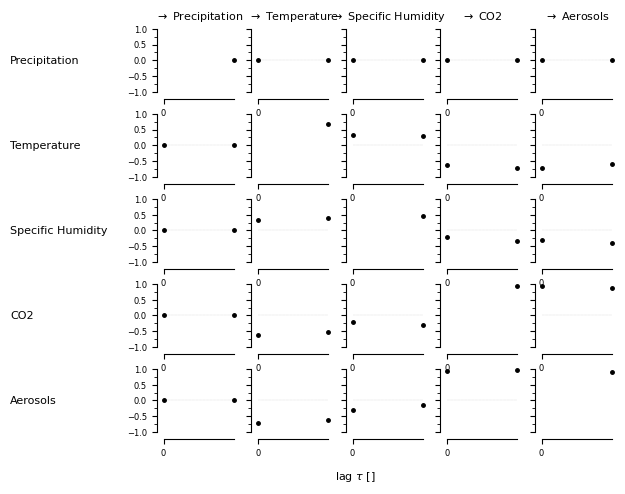

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 2 link(s):
        (Aerosols -1): max_pval = 0.000

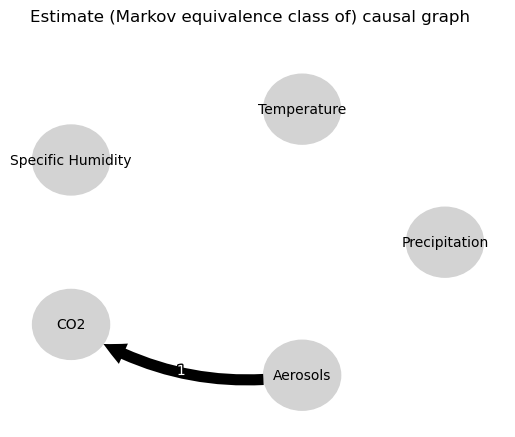

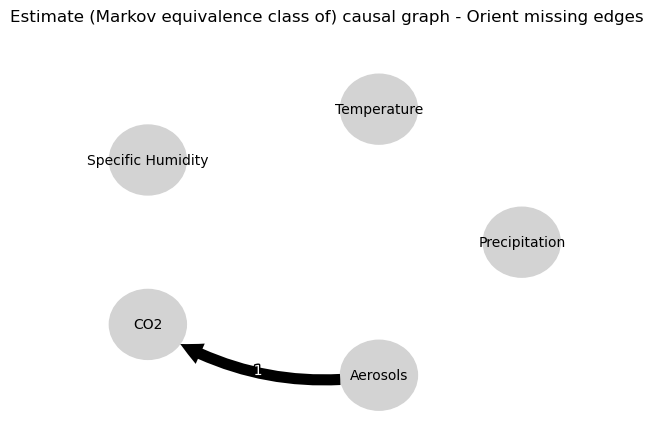

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.03855991283484468
0.5860049979828342
-0.027589323129265993
0.03498722134500561
0.02027254962382268
0.020795316931812125
0.044499009816218585
0.5860049979828342
-0.007460935018016822
0.0
-0.04499430321943048
0.0726373775811758
0.025783996408871575
0.025656700010646905
0.038884800556812316
0.03498722134500561
0.09217573164705138
0.0726373775811758
0.12975493376735878
0.0
0.8575866330574218
0.9411718118636146
0.8585484282812709
0.020795316931812125
0.10176281682651295
0.025656700010646905
0.14423867127726916
0.9411718118636146
0.8952011204502955
0.0
0.8455604937005461


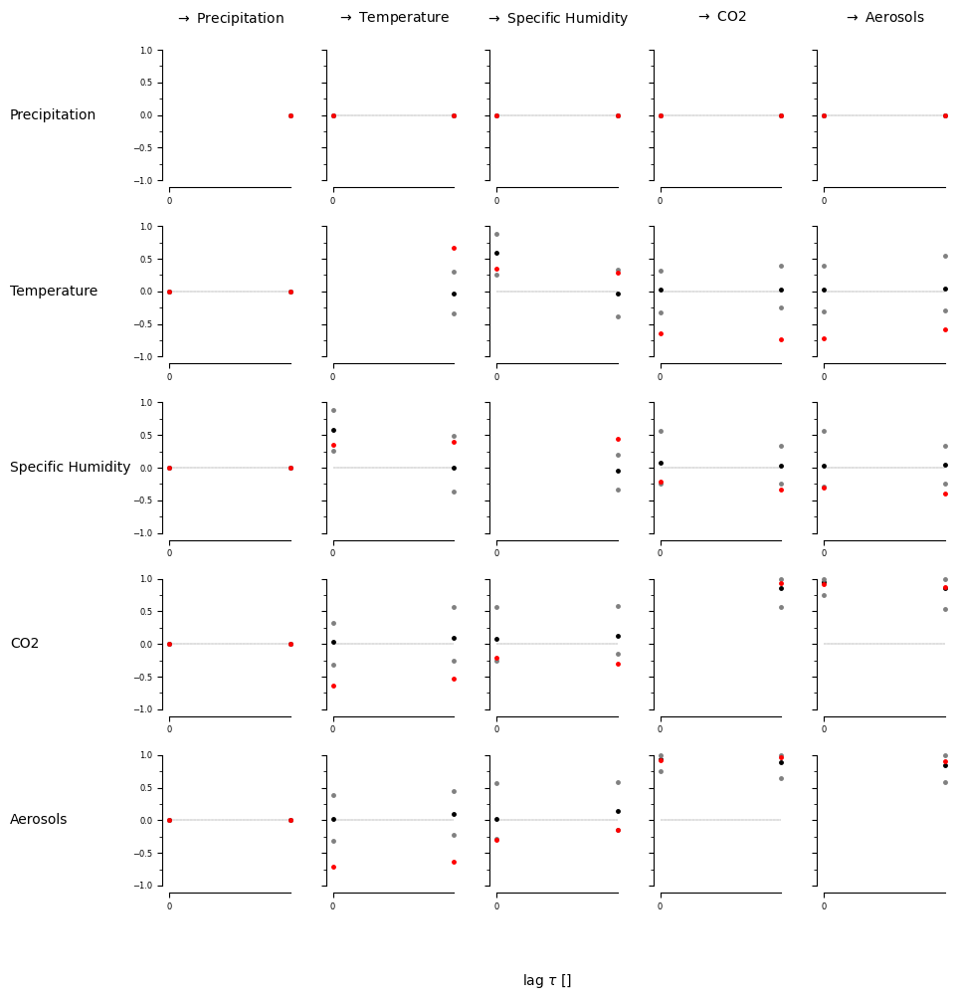

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [ True  True]
  [False  True]]]


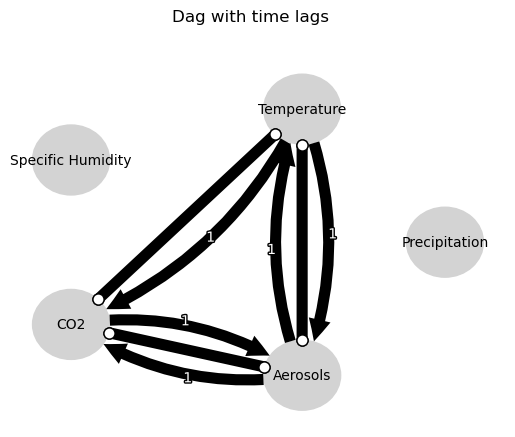

Negative precipitation values in event 39: 0


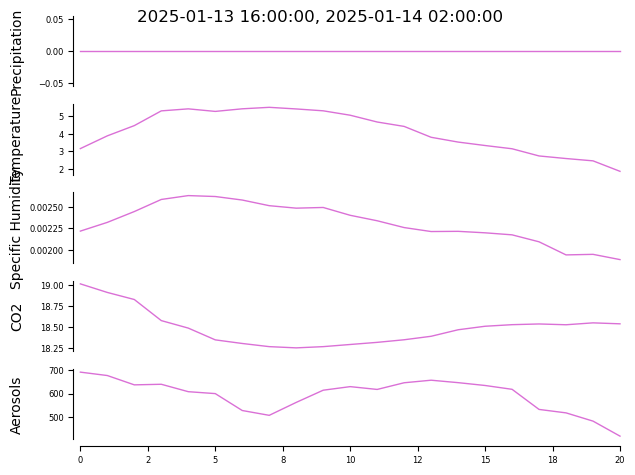


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


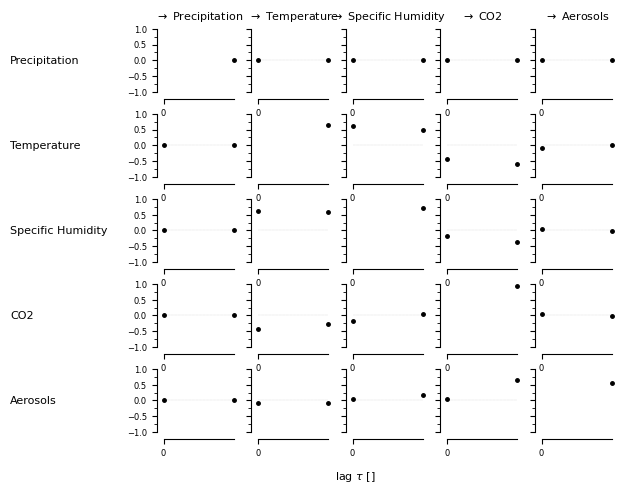

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.04544, |min_val| =  0.477

    Variable Specific Humidity has 1 link(s):
       

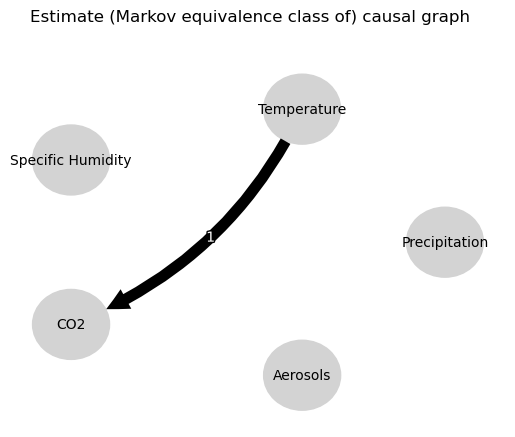

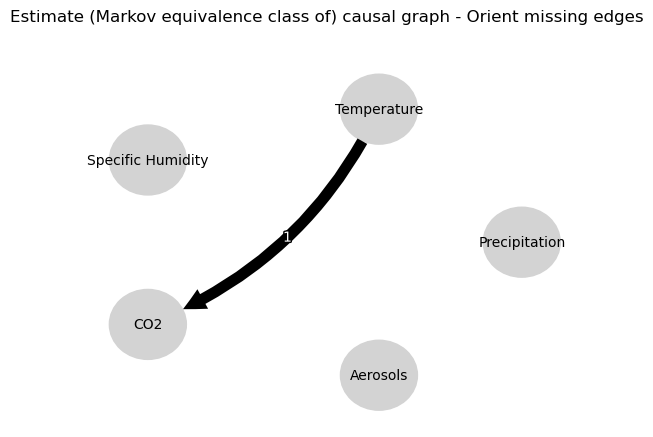

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.5875822040728179
0.6677770167573557
0.4790183488413344
-0.3874168217418525
-0.49302433185286837
-0.06534822369919412
-0.03292653413452093
0.6677770167573557
0.4900922670084034
0.0
0.6508248521524762
-0.3218922742692014
-0.43435707231928794
-0.06470116231776064
-0.007917861592485176
-0.3874168217418525
-0.29739214997582747
-0.3218922742692014
-0.2870462681589549
0.0
0.5602037094229639
0.14099123194949695
0.03815702914440347
-0.06534822369919412
-0.07760416248483197
-0.06470116231776064
-0.10952663335361776
0.14099123194949695
0.07613221711894581
0.0
0.547978125290616


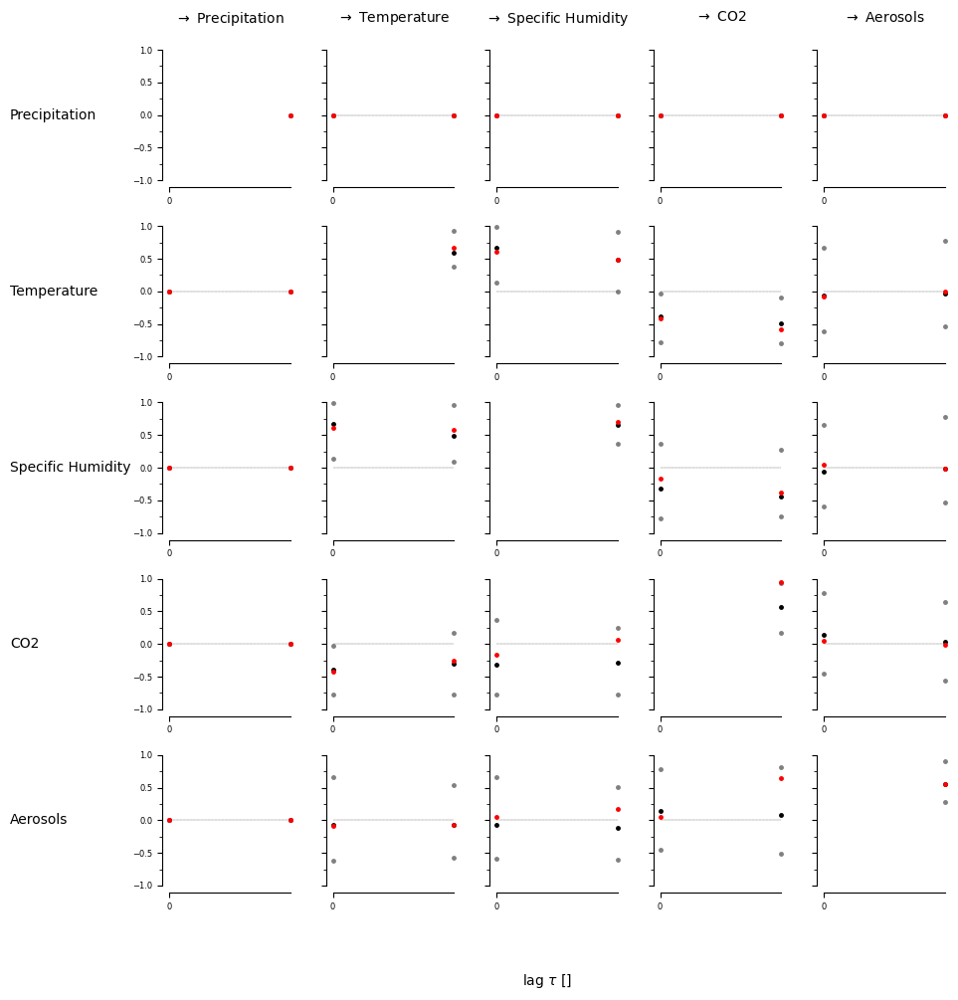

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]]


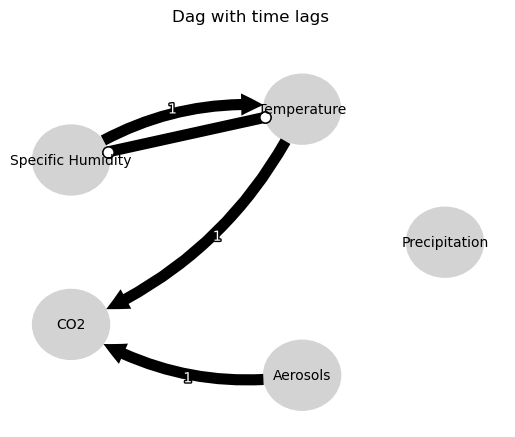

Negative precipitation values in event 40: 0


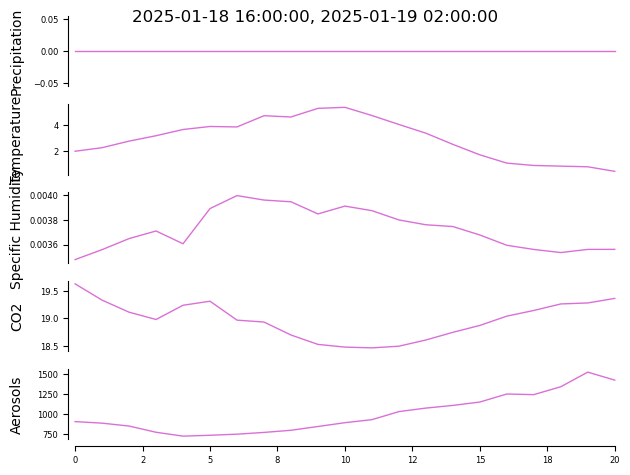


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


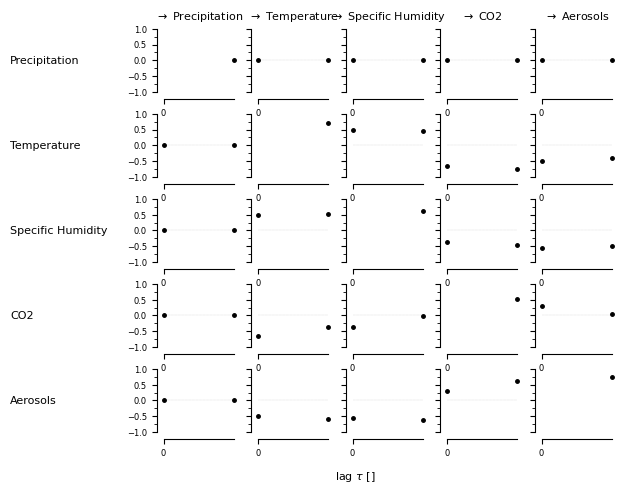

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.01058, |min_val| =  0.586

    Variable Specific Humidity has 1 link(s):
       

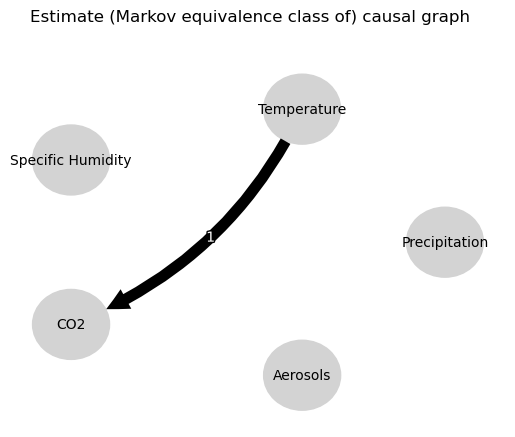

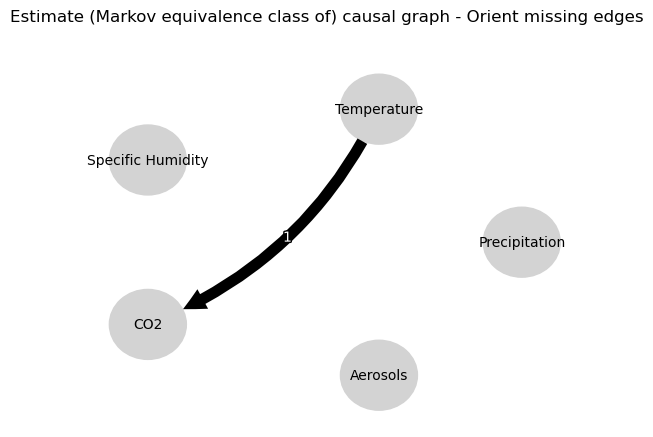

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.5763786683916696
0.010762382523846965
-0.040733456528176504
-0.24490473249105052
-0.5802218177942946
-0.22589223372217637
-0.18328848723197927
0.010762382523846965
0.00104293898683283
0.0
-0.07430240884914767
0.11349143211137161
-0.02316095142497482
0.019984344163886666
0.05076231787113901
-0.24490473249105052
-0.17852279509506014
0.11349143211137161
0.040523757612393
0.0
0.23995041908232587
0.07580330857547407
0.035688974584205606
-0.22589223372217637
-0.18808409673982038
0.019984344163886666
-0.04442862838260163
0.07580330857547407
0.2255833809942473
0.0
0.6534915280059207


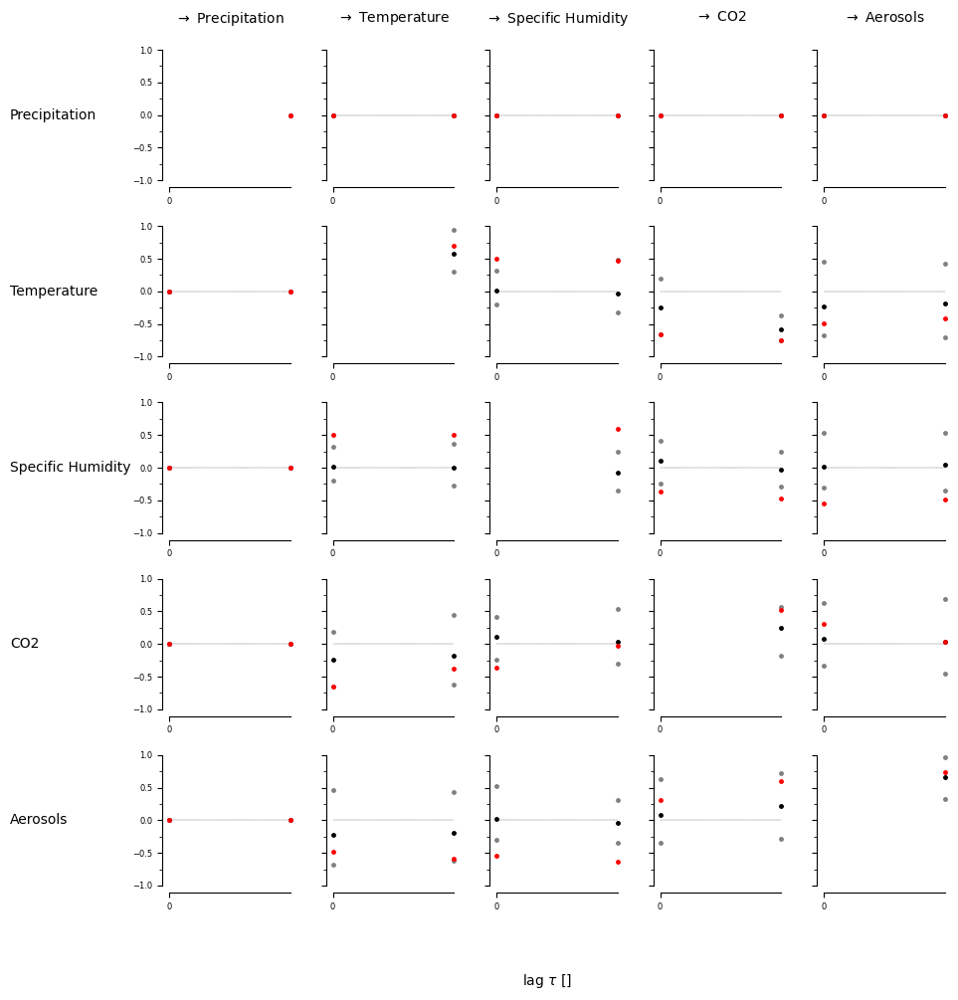

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [False  True]
  [False  True]]]


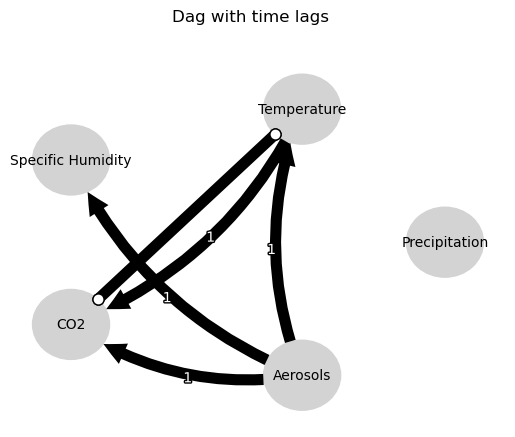

Negative precipitation values in event 41: 0


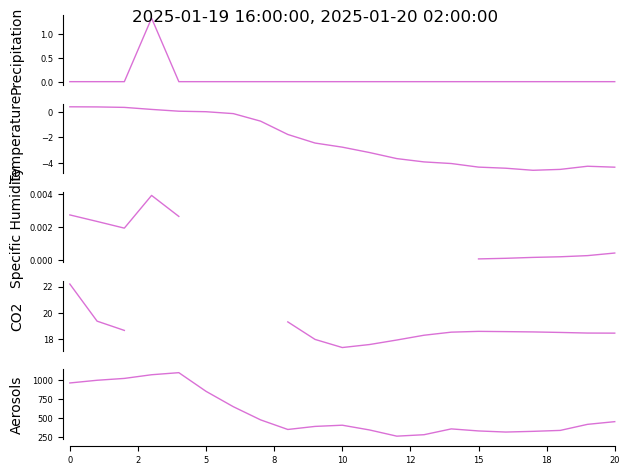


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


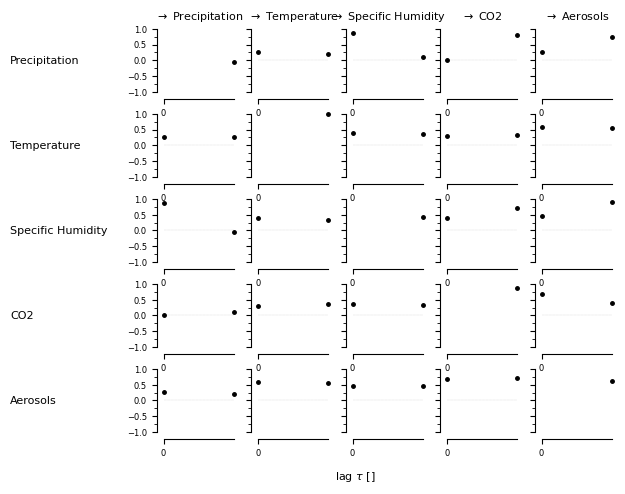

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00000, |min_val| =  0.971

    Variable Specific Humidity has 0 link(s):

    Va

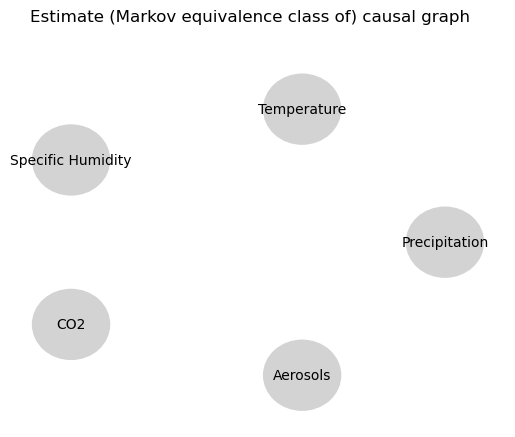

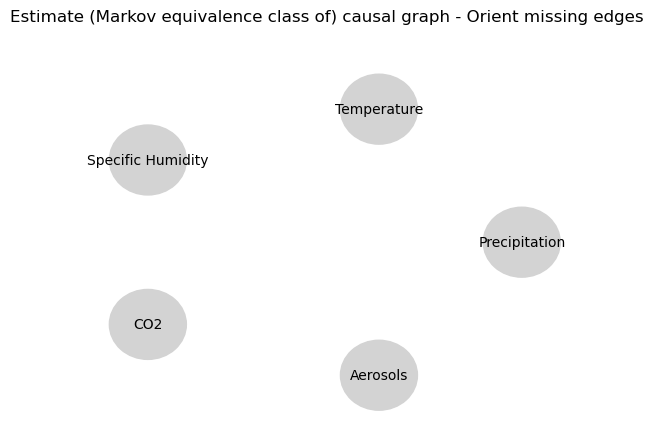

⚠️ Skipping event 42 ((Timestamp('2024-12-01 16:00:00'), Timestamp('2024-12-02 02:00:00')) → (Timestamp('2024-12-02 16:00:00'), Timestamp('2024-12-03 02:00:00'))) due to error: Less than 10 overlapping samples due to masking and/or missing values, cannot compute residual covariance!
Negative precipitation values in event 42: 0


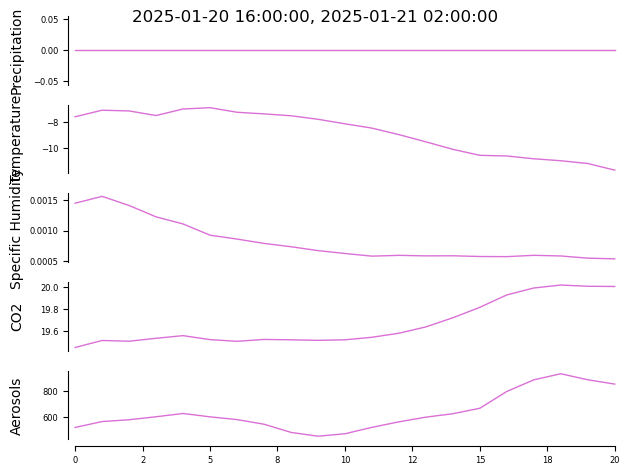


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


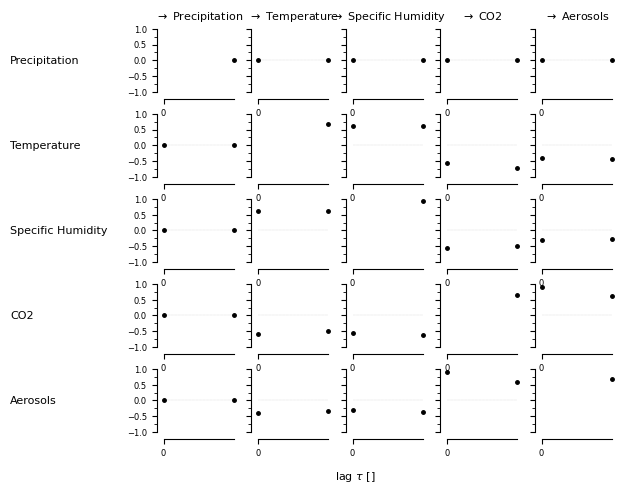

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.03331, |min_val| =  0.503

    Variable Specific Humidity has 1 link(s):
       

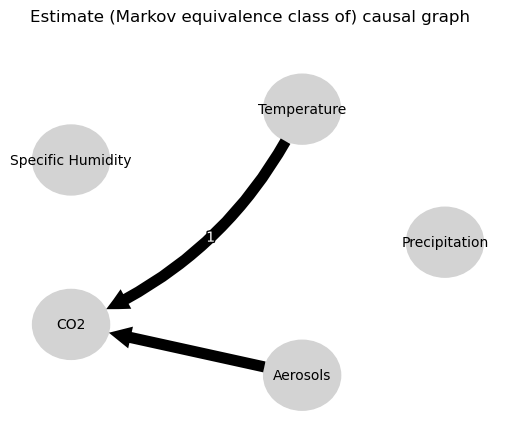

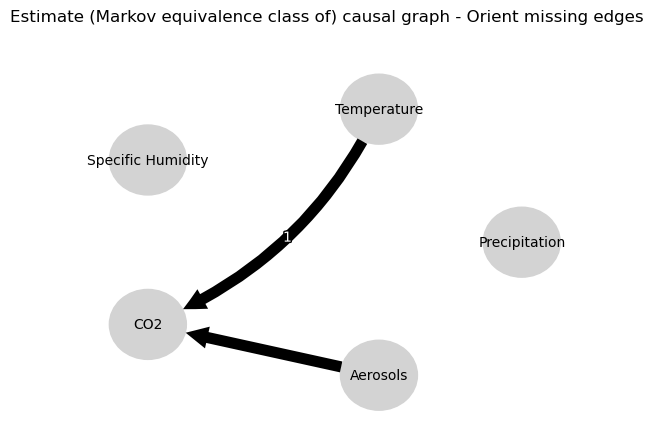

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.7188670589582205
0.12750704420974174
0.027983217480647235
-0.3133724985142636
-0.48402984503183494
-0.012119737227671857
-0.16327134575918095
0.12750704420974174
0.11221134404376155
0.0
0.4420639025848946
-0.011035169265524569
-0.10286562978814733
0.0027357724576073292
-0.11397875928293316
-0.3133724985142636
-0.24384581053431142
-0.011035169265524569
0.036129134872946535
0.0
0.18098086504689537
0.7524935933965515
0.04297589653032651
-0.012119737227671857
0.018998039523619014
0.0027357724576073292
0.014219822196573743
0.7524935933965515
-0.05944255705807618
0.0
-0.0438664419562254


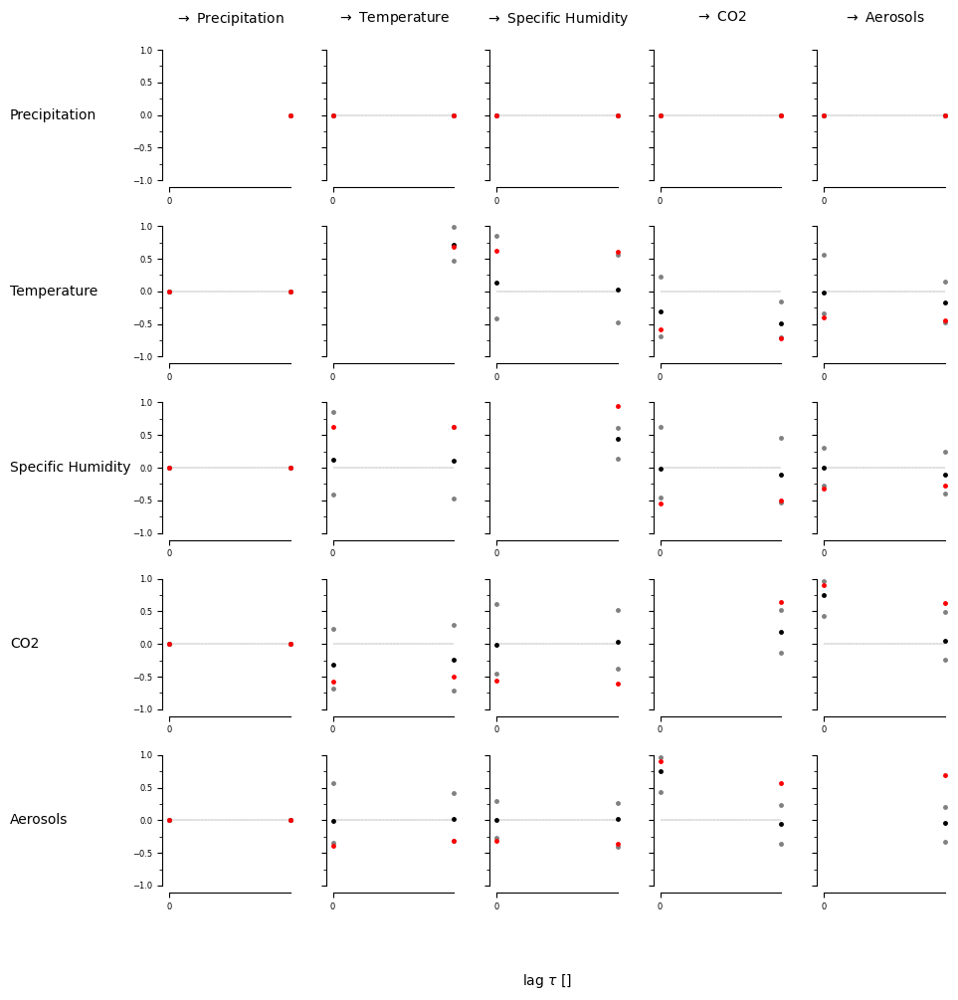

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False  True]]]


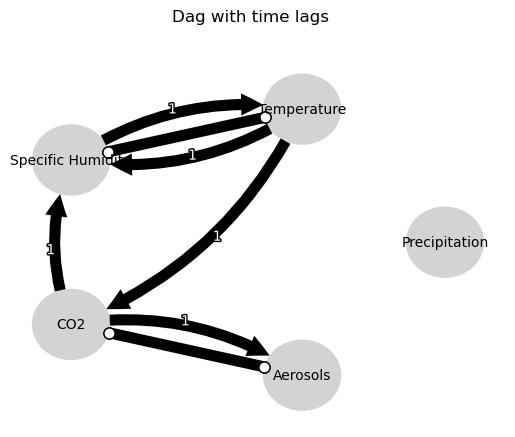

Negative precipitation values in event 43: 0


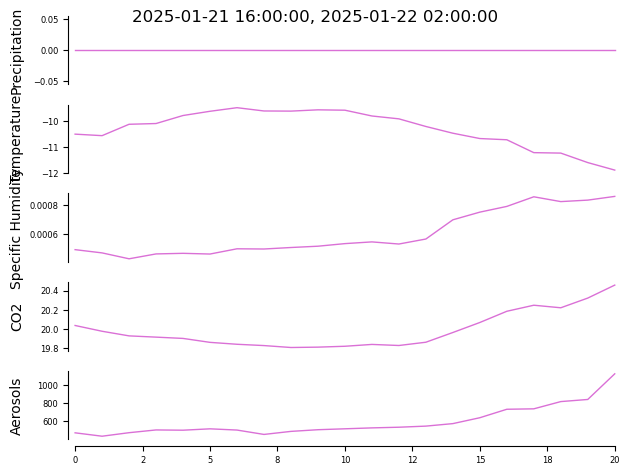


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


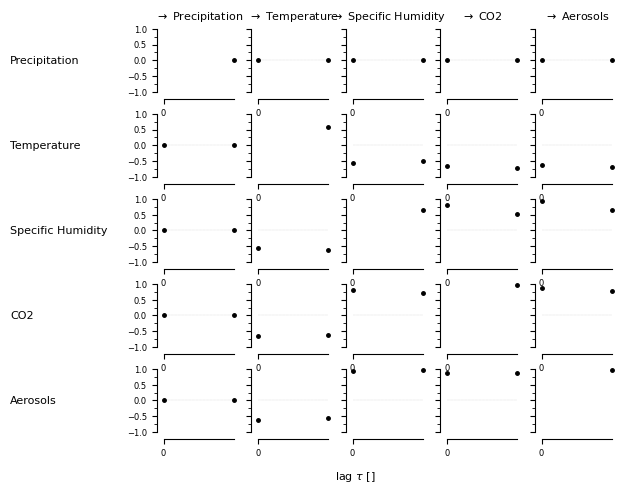

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Aerosols -1): max_pval = 0.00000, |min_val| =  0.911

    Varia

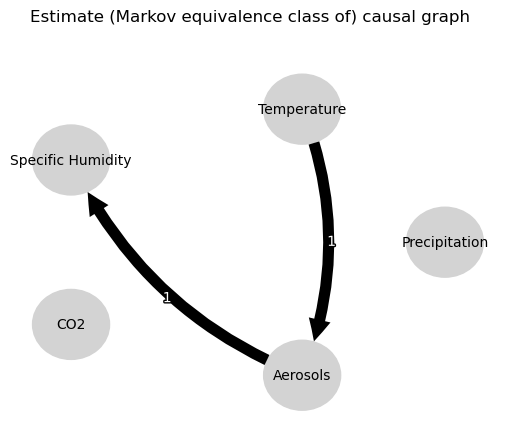

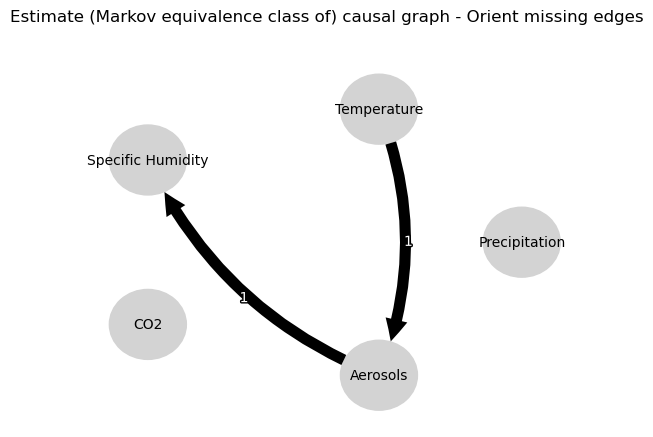

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.06873811101149348
-0.006132940440467769
0.036501015796954285
-0.0839379692865075
-0.04700625302693979
0.04491413100382875
-0.08824502949681642
-0.006132940440467769
-0.004049551560169248
0.0
0.7425436208248976
0.2432778743374658
0.21013920412748607
0.7894736214482609
0.7864752330849688
-0.0839379692865075
-0.03748906060727954
0.2432778743374658
0.23128670442851879
0.0
0.8739759949156405
0.2667771519279692
0.2472239336874367
0.04491413100382875
0.024009021328341387
0.7894736214482609
0.8484271683389808
0.2667771519279692
0.2186110979900441
0.0
0.8225608522398896


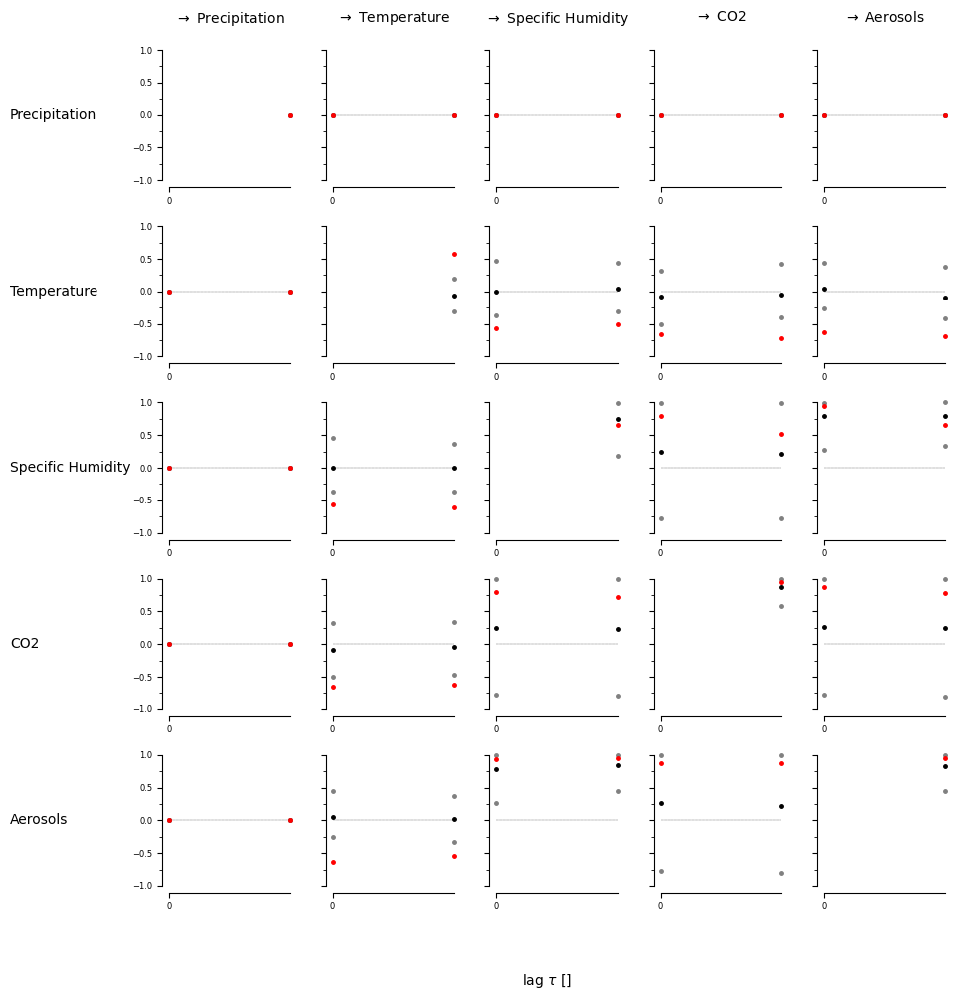

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False  True]
  [False  True]
  [ True False]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True False]
  [ True  True]
  [ True  True]
  [False  True]]]


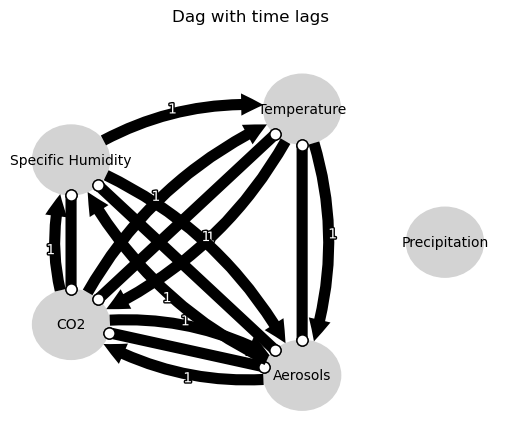

Negative precipitation values in event 44: 0


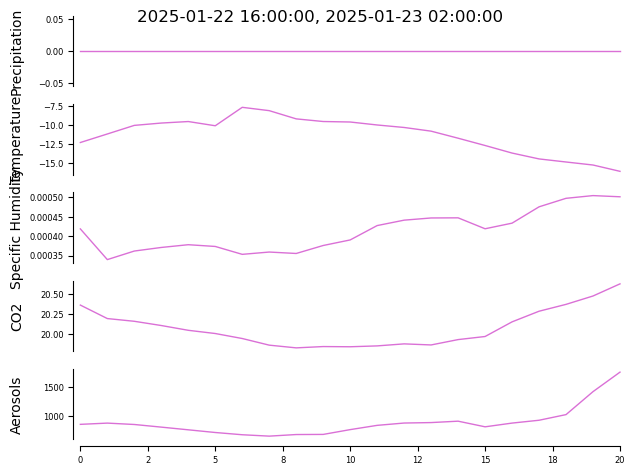


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


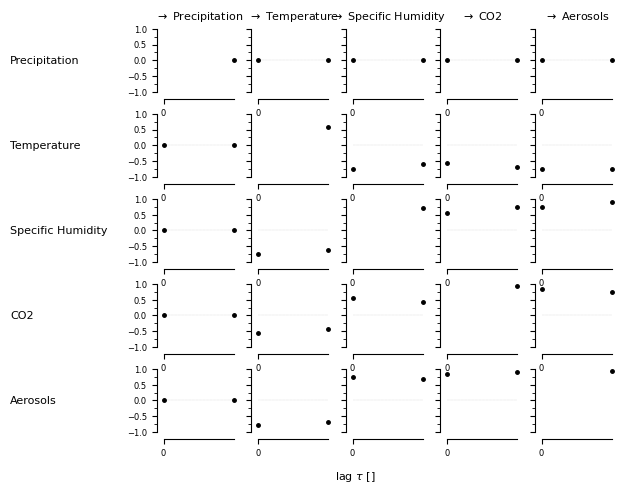

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 1 link(s):
        (CO2 -1): max_pval = 0.00001, |

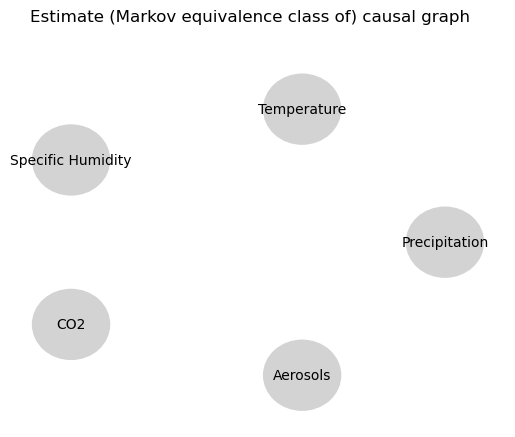

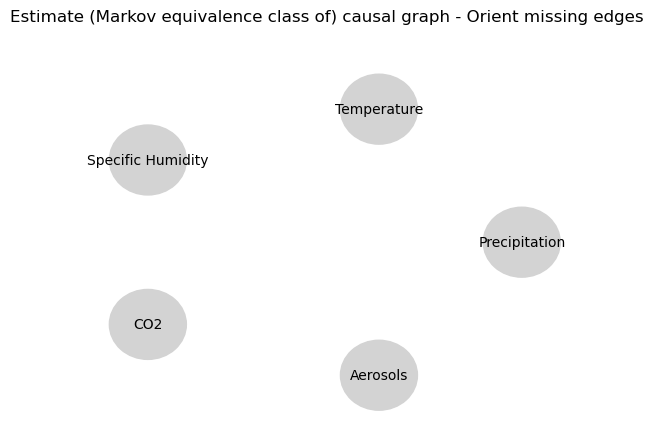

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.08042309604509482
-0.6897007504693261
0.05009111122383361
-0.13665460257482628
-0.14820887933687868
0.03522386261462375
0.021211173361577868
-0.6897007504693261
-0.010222986263251299
0.0
-0.01705471888353379
0.1079289614556079
0.10859244965770196
-0.04480470477705243
-0.041268014510768176
-0.13665460257482628
0.2144199157625618
0.1079289614556079
-0.25452483044058255
0.0
0.6639782016053305
0.03066423813489675
-0.0044993325658899165
0.03522386261462375
0.04588670083483444
-0.04480470477705243
-0.07053003221097545
0.03066423813489675
0.02096433055956054
0.0
0.9611805457686059


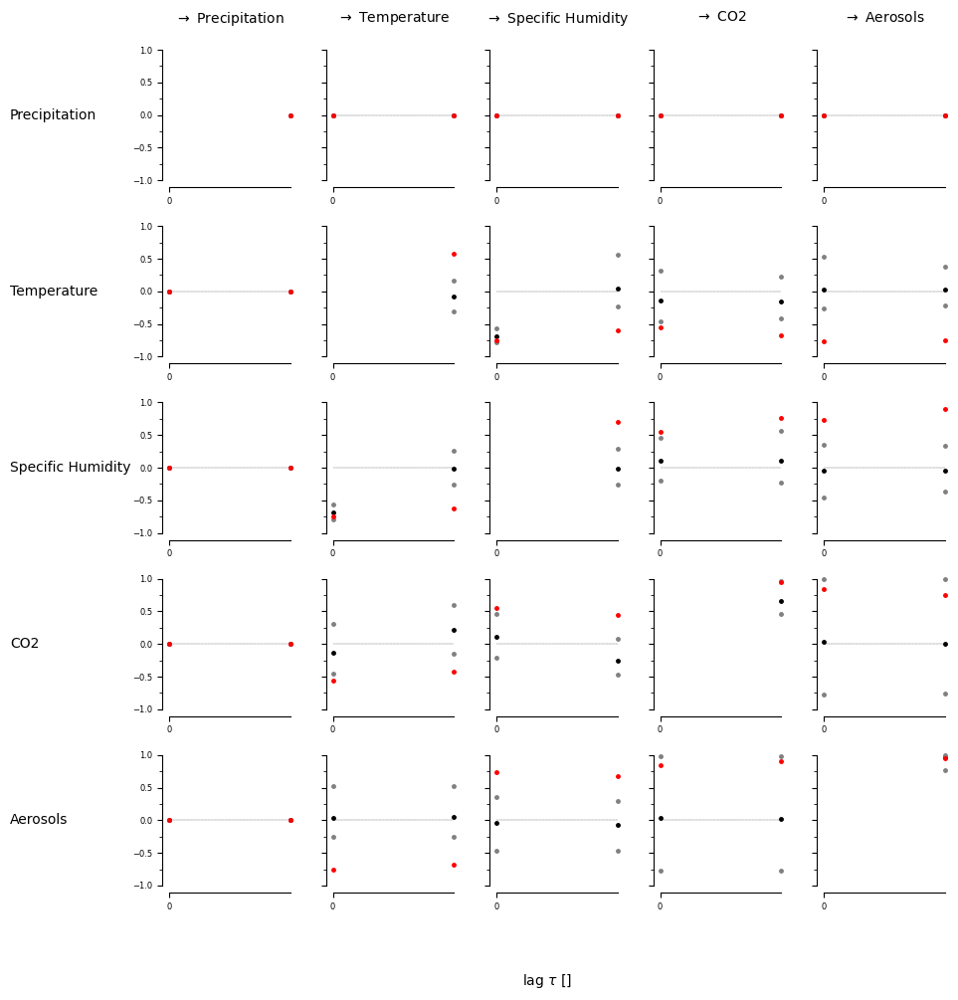

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False  True]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [ True  True]
  [False  True]]]


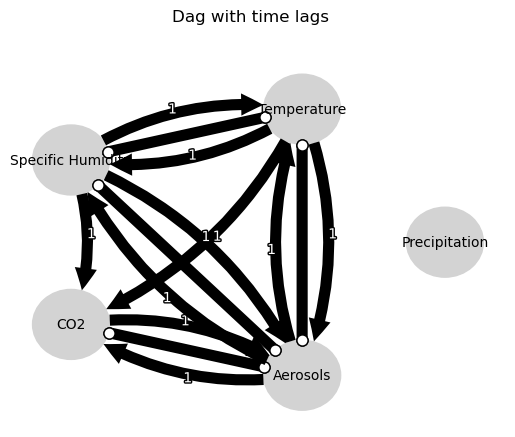

Negative precipitation values in event 45: 0


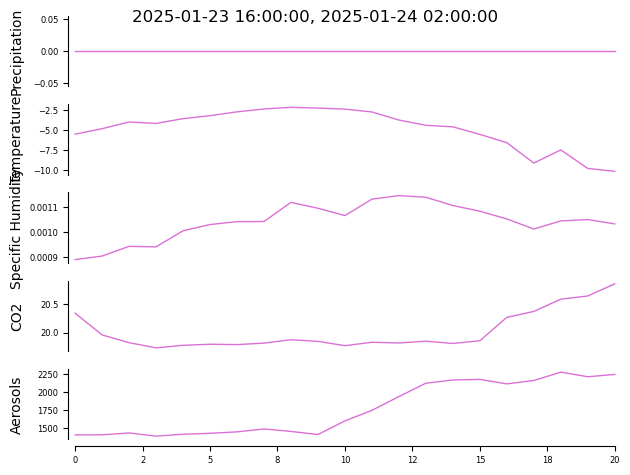


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


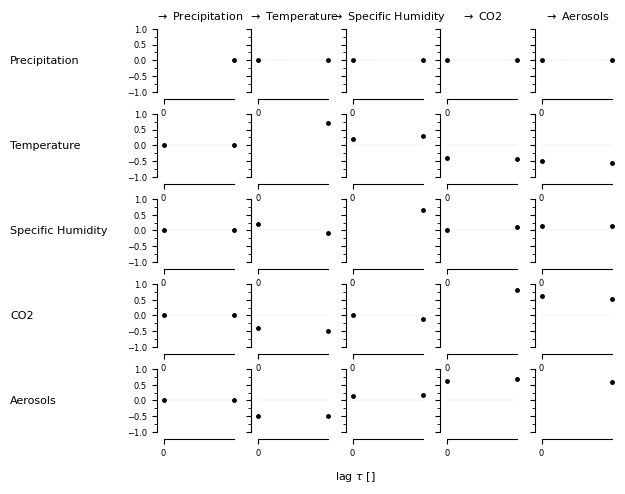

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00484, |min_val| =  0.633

    Variable Specific Humidity has 1 link(s):
       

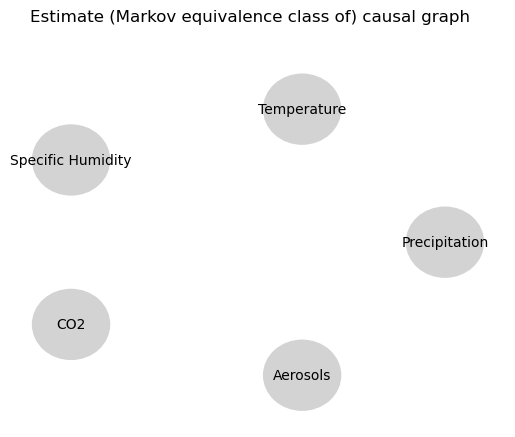

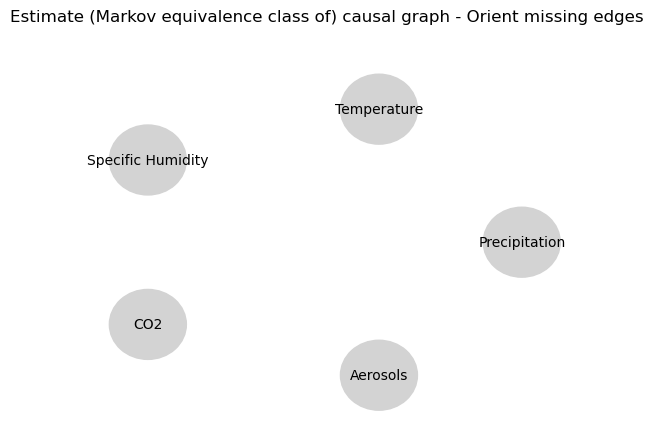

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.6874597558495903
0.09952890285651735
0.04364024423850808
-0.11314408544617348
-0.10016542825325644
-0.03878161289523452
0.1846146711749919
0.09952890285651735
0.09824838212049282
0.0
0.4139306720500425
0.060242088490194454
0.06021115792467998
-0.12995906776363023
0.03537861314517712
-0.11314408544617348
-0.07534955092750178
0.060242088490194454
0.02103306562537334
0.0
0.6849346118943568
0.033261415544452985
-0.20051005486409273
-0.03878161289523452
0.014526648391691377
-0.12995906776363023
-0.09918937640392672
0.033261415544452985
0.01358544104660721
0.0
-0.045829378279399216


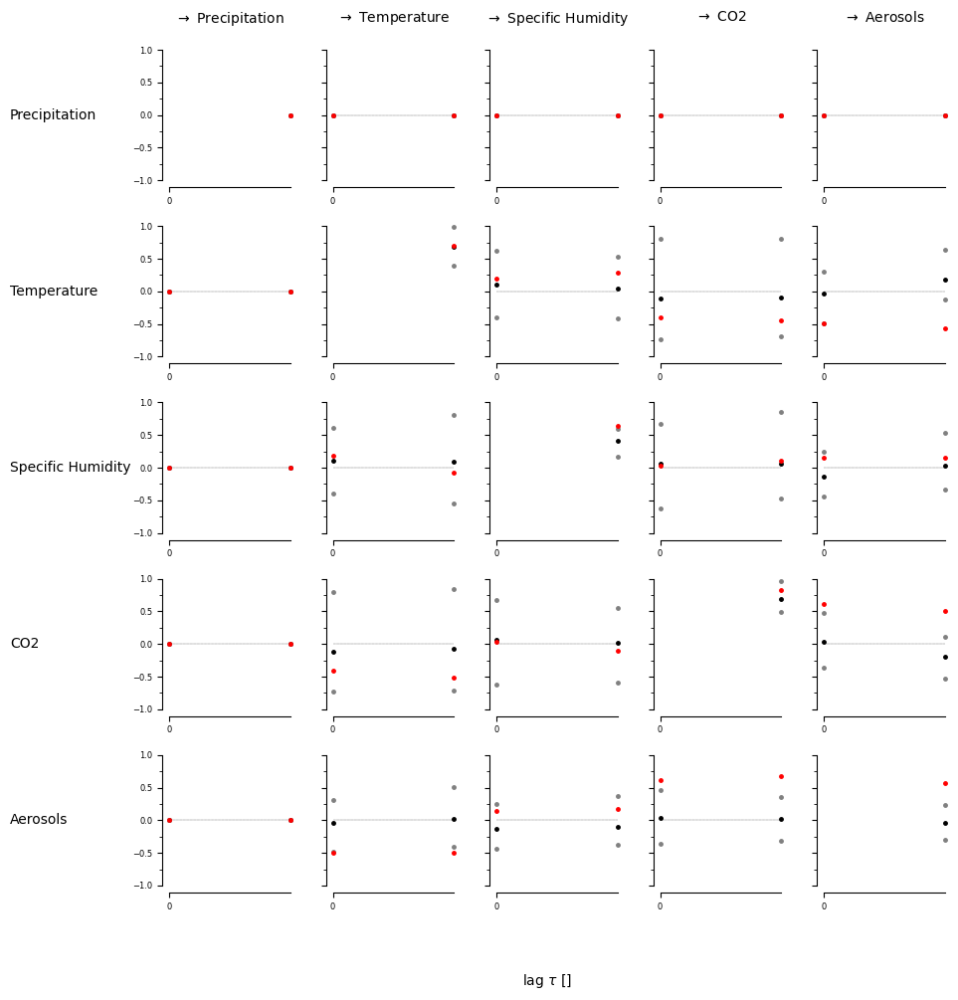

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True False]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False False]]]


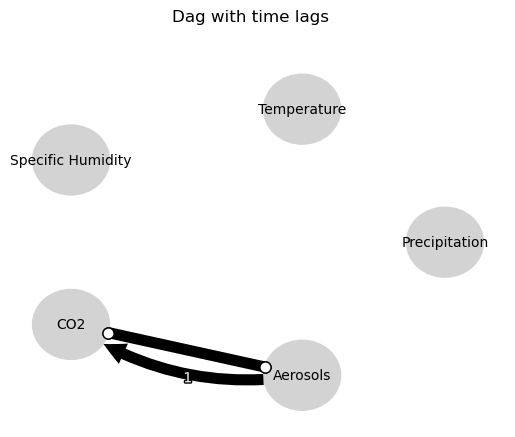

Negative precipitation values in event 46: 0


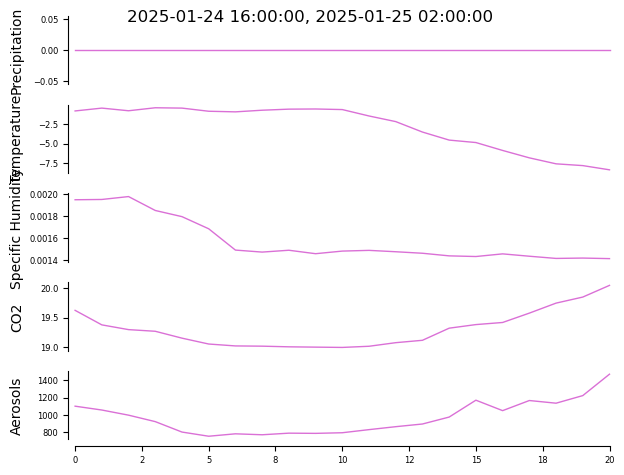


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


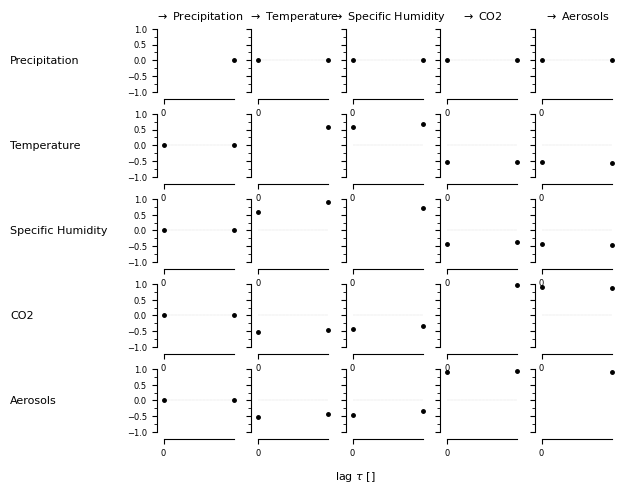

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00001, |min_val| =  0.856

    Variable Specific Humidity has 2 link(s):
 

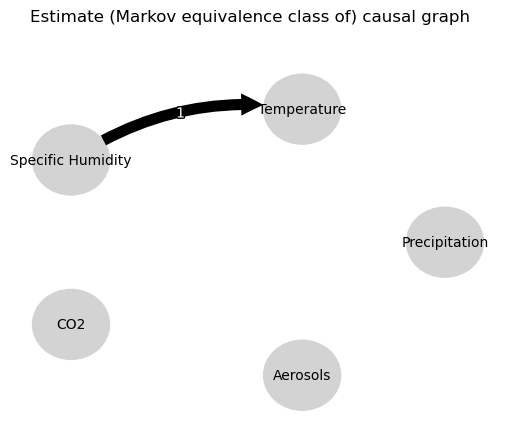

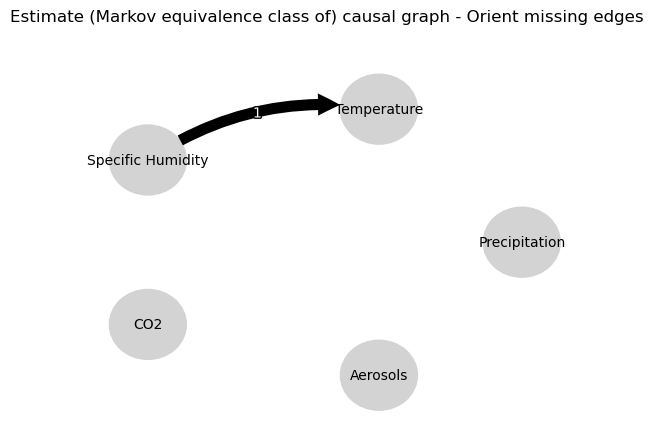

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.06012932231882225
0.06510551759037811
0.07188100777206864
-0.022009285727361234
-0.018919107270597025
0.04492415325362577
0.035834123778017764
0.06510551759037811
0.1389792195844324
0.0
0.4550167814136005
-0.12174940807843035
-0.10263696780906775
-0.1206639444436536
-0.12065484963829874
-0.022009285727361234
0.05229800783776313
-0.12174940807843035
-0.057933050136029736
0.0
0.7601253476995421
0.5315159908570088
0.4743214305638578
0.04492415325362577
0.08699705490218435
-0.1206639444436536
-0.05928352285714005
0.5315159908570088
0.48504386183545767
0.0
0.7307514687011636


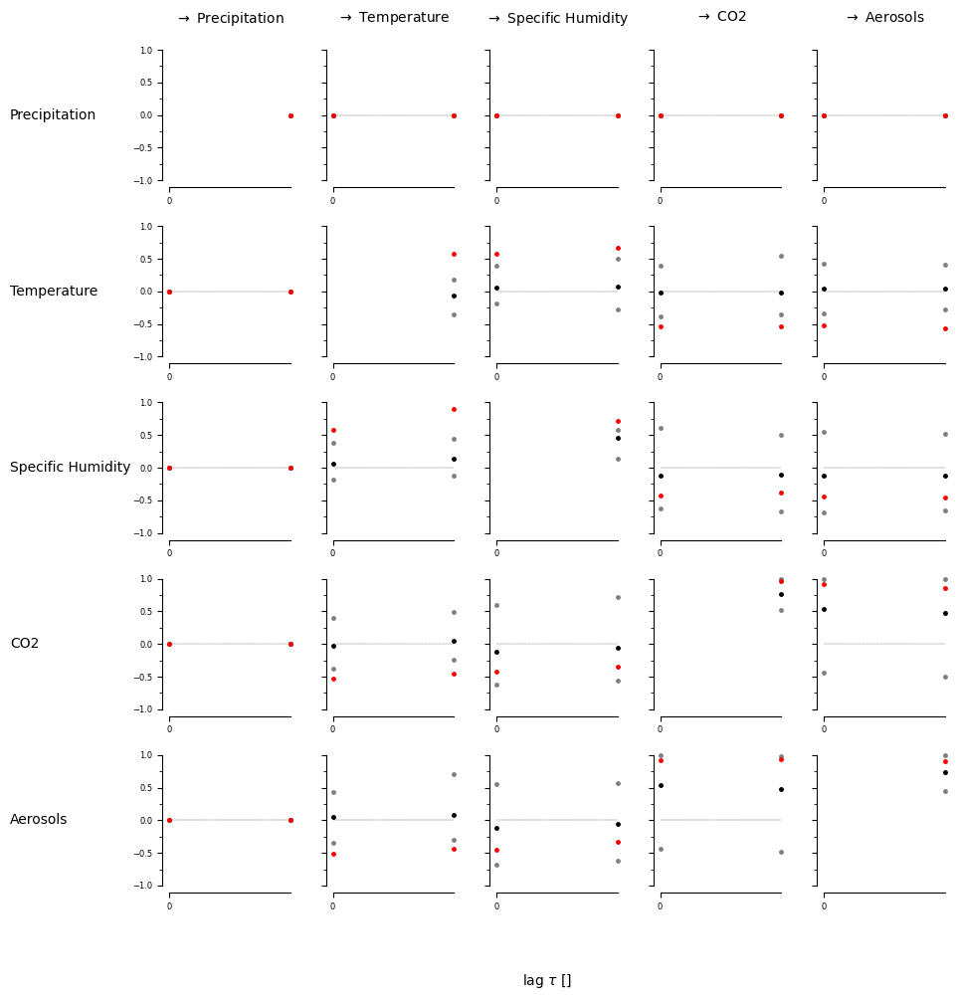

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False  True]]]


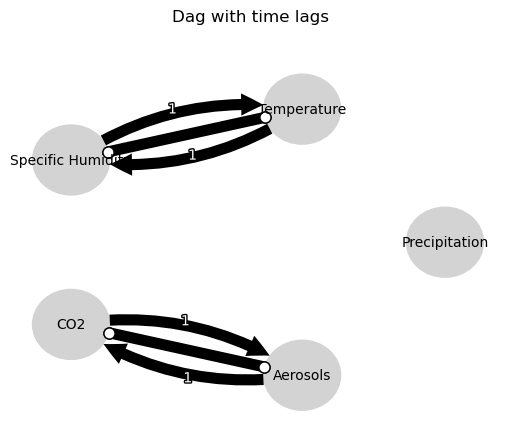

Negative precipitation values in event 47: 0


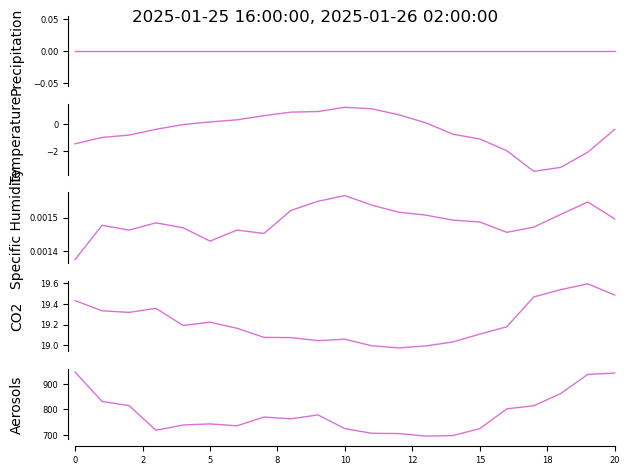


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


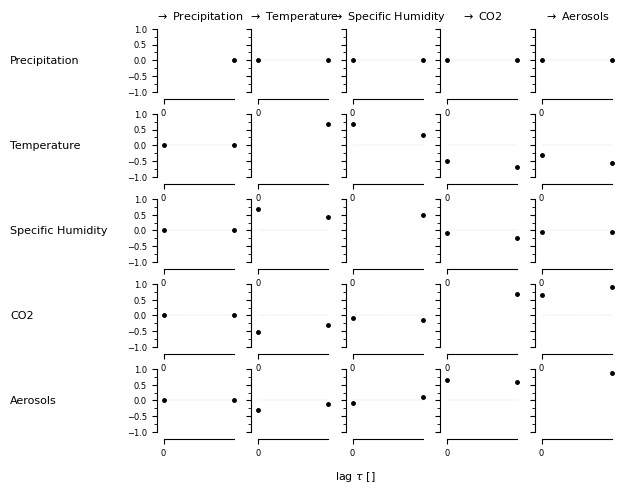

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00136, |min_val| =  0.680

    Variable Specific Humidity has 1 link(s):
       

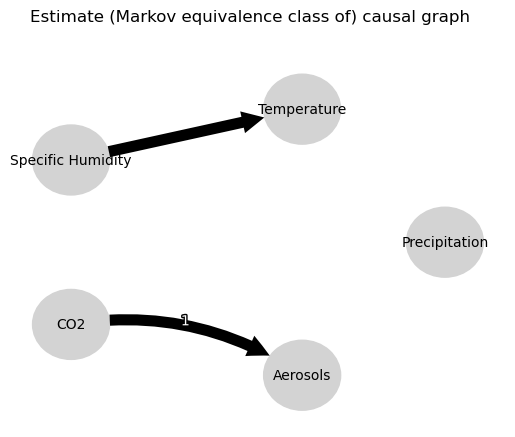

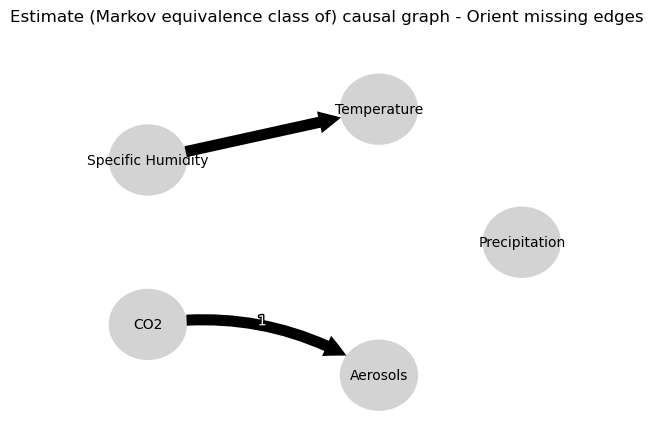

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.448135105221005
0.09882298887362895
-0.0911571339197808
0.03056295022737667
-0.01110611239702407
-0.03535417341028662
0.06576619446011124
0.09882298887362895
0.066697837644083
0.0
-0.07648366610591452
-0.06643321963475737
0.02476146143046555
0.03825969588099836
-0.09260554074299118
0.03056295022737667
0.02218554487131452
-0.06643321963475737
-0.03566558305292514
0.0
-0.06249097967428271
0.07623833227096632
0.7503042548168488
-0.03535417341028662
-0.05352953378817214
0.03825969588099836
0.027165711534910233
0.07623833227096632
-0.08904723807499265
0.0
0.07025846467918749


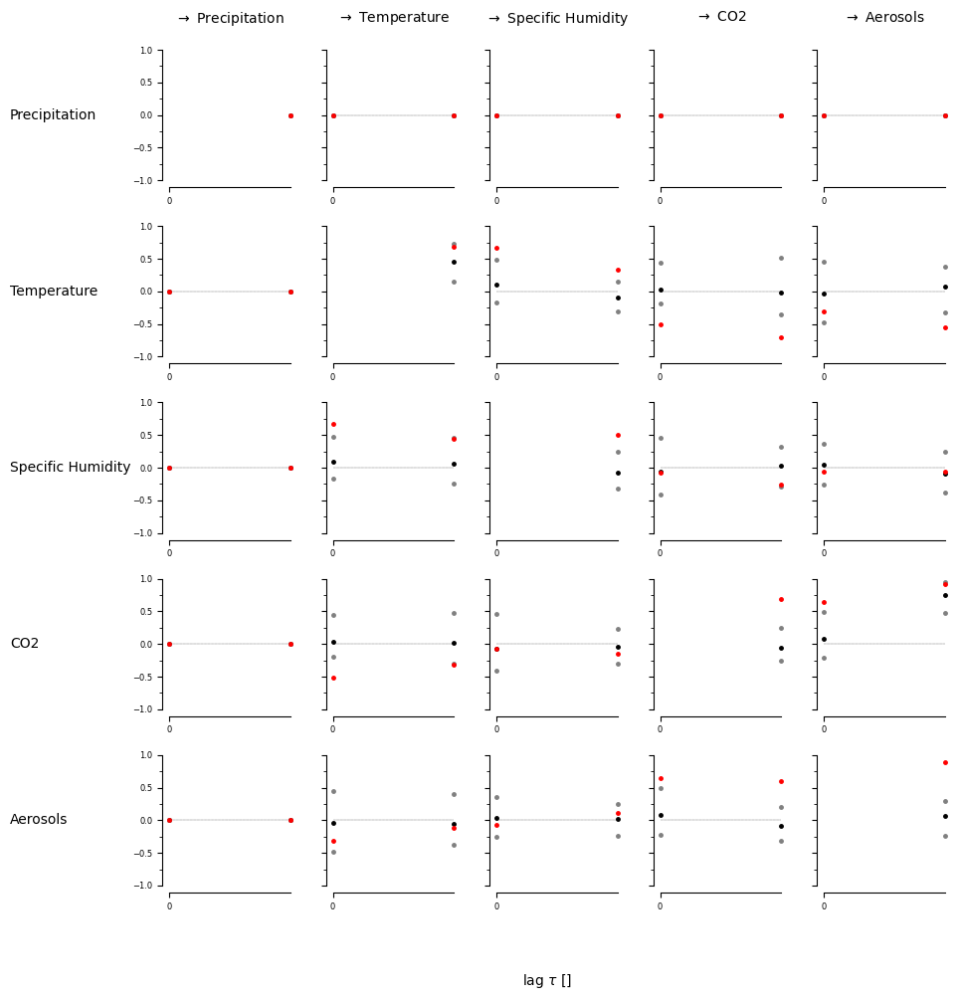

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False  True]]]


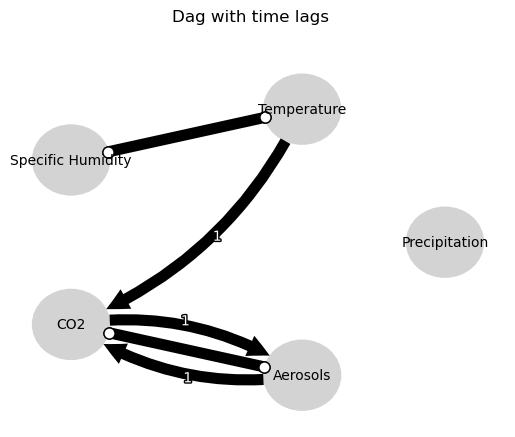

Negative precipitation values in event 48: 0


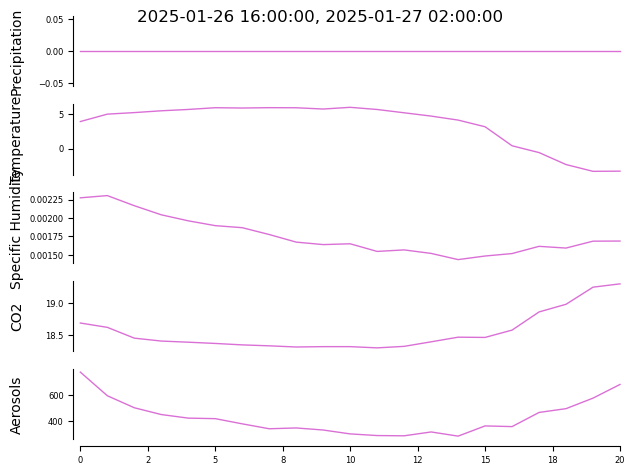


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


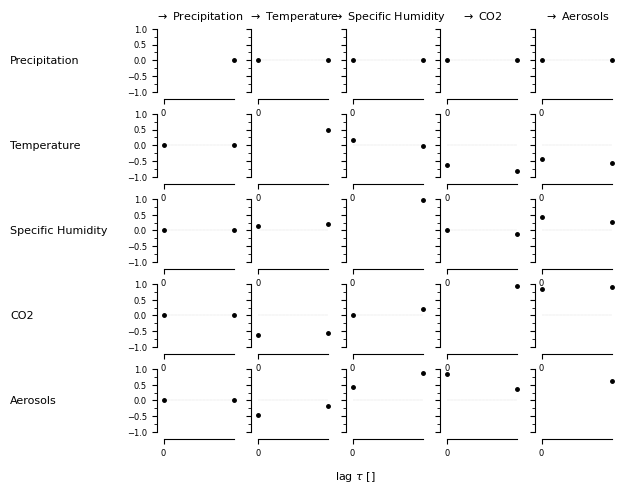

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 2 link(s):
        (Specific Humidity -1): max_pval = 0.00001, |min_val| =  0.851
 

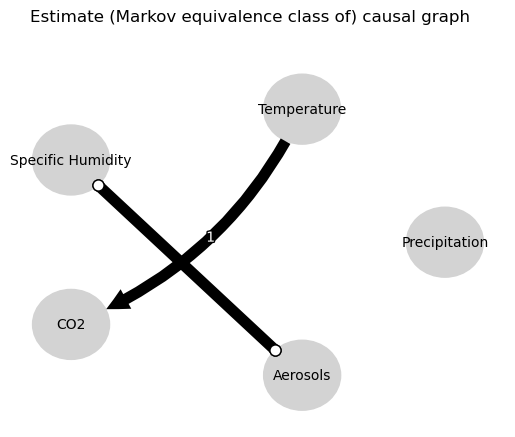

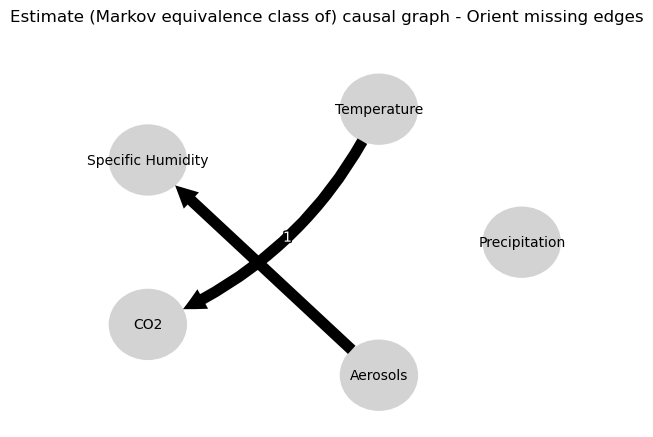

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.03972803184242591
0.23480539089379354
0.005602894065048305
0.05154086900328936
-0.780516899336596
-0.5180562015870943
-0.006122016242295525
0.23480539089379354
-0.04001143722505234
0.0
-0.0332548880844961
0.04275162118043067
-0.2431569800590542
0.43877226108772915
-0.04036656295830451
0.05154086900328936
0.04378326307522086
0.04275162118043067
0.05507609427624761
0.0
0.044800668828437695
0.01449420685015466
-0.003715370093258653
-0.5180562015870943
0.013693054806198056
0.43877226108772915
0.0011496841647695025
0.01449420685015466
0.5158335800981357
0.0
-0.045829378279399216


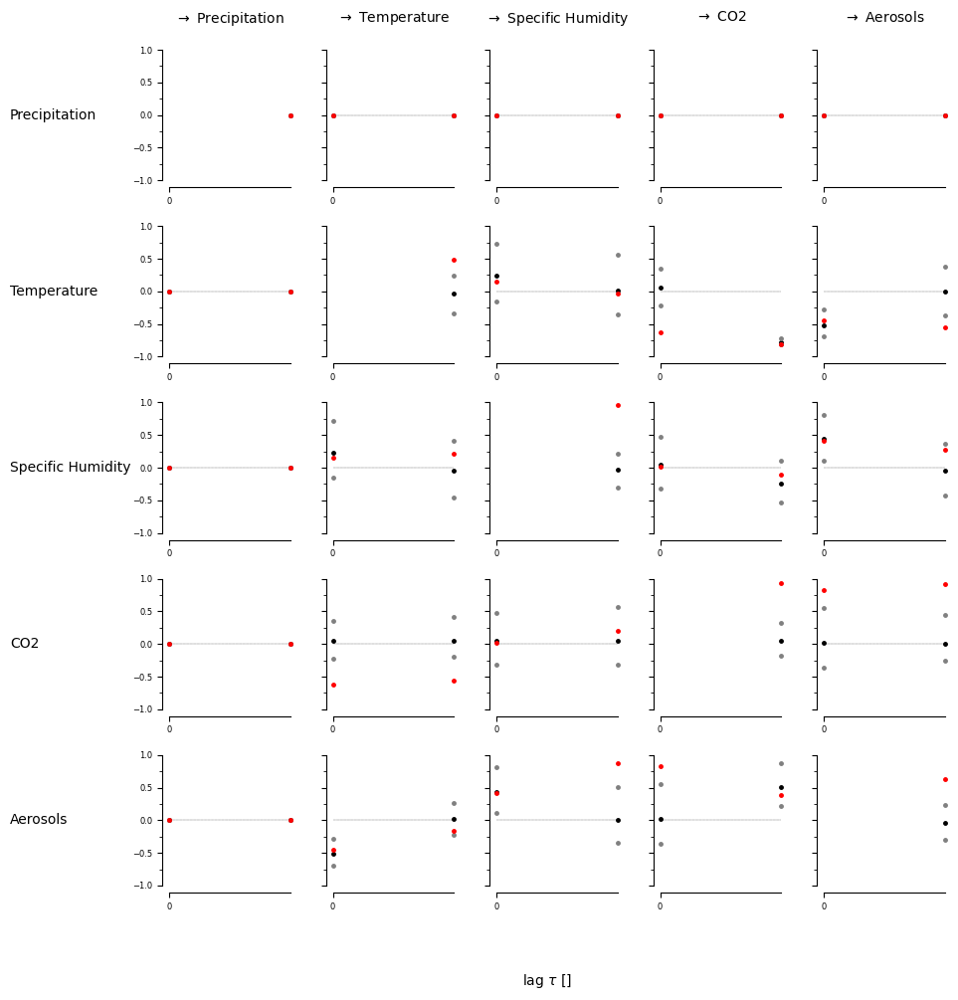

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [ True False]
  [False  True]]]


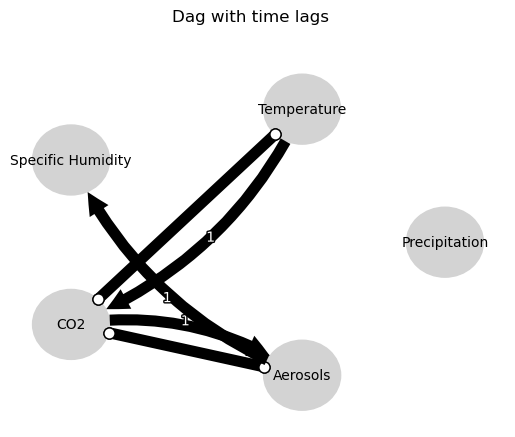

Negative precipitation values in event 49: 0


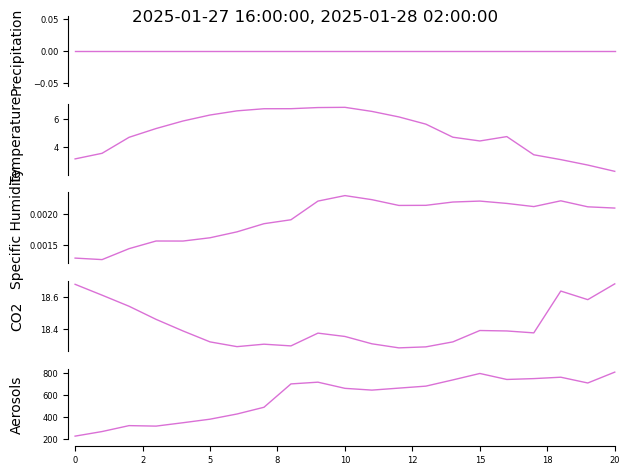


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


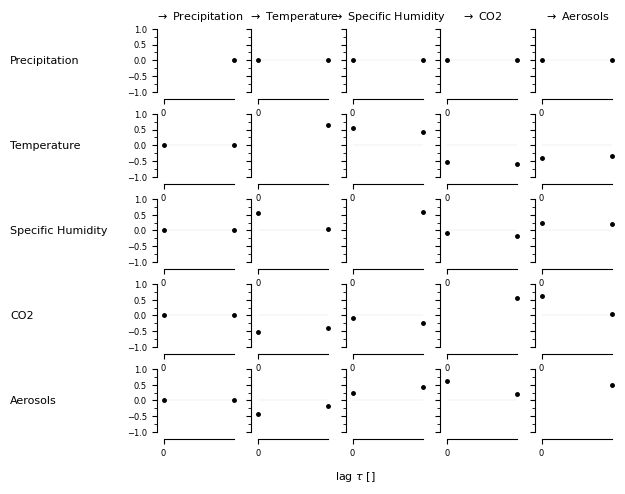

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00312, |min_val| =  0.641

    Variable Specific Humidity has 1 link(s):
       

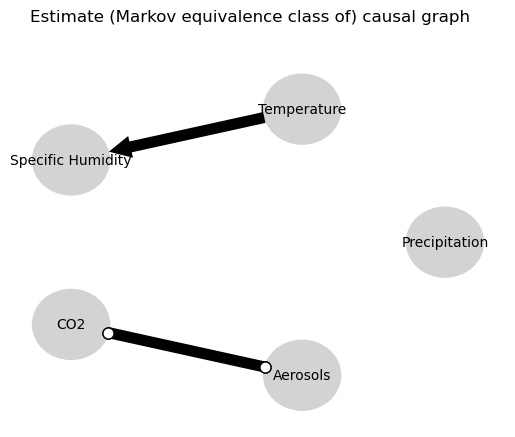

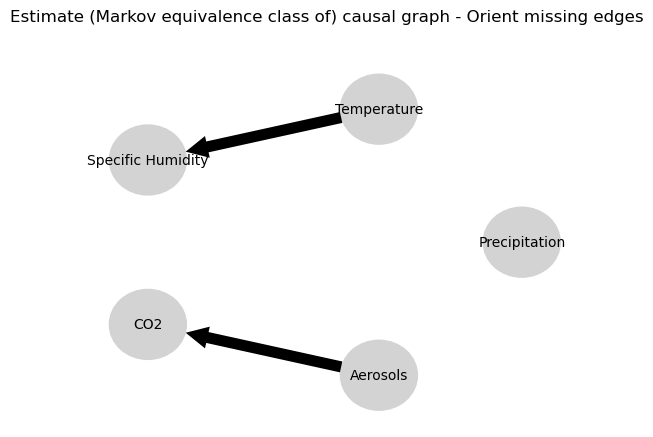

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.021984674985486754
0.10210774620419064
0.1475294741794763
-0.65058876360732
0.041491109802584
-0.24132661357813992
-0.019983038621701758
0.10210774620419064
-0.10853892770573788
0.0
0.4683553750358737
-0.024034056820724688
0.08909260864856326
0.07897002288291964
-0.04077661252162487
-0.65058876360732
0.07437812617413635
-0.024034056820724688
-0.06846337526069624
0.0
-0.11860266058821038
0.030787157854424502
0.06115044117979674
-0.24132661357813992
0.007277987202836846
0.07897002288291964
-0.008884480894003897
0.030787157854424502
0.02966915739608855
0.0
-0.045829378279399216


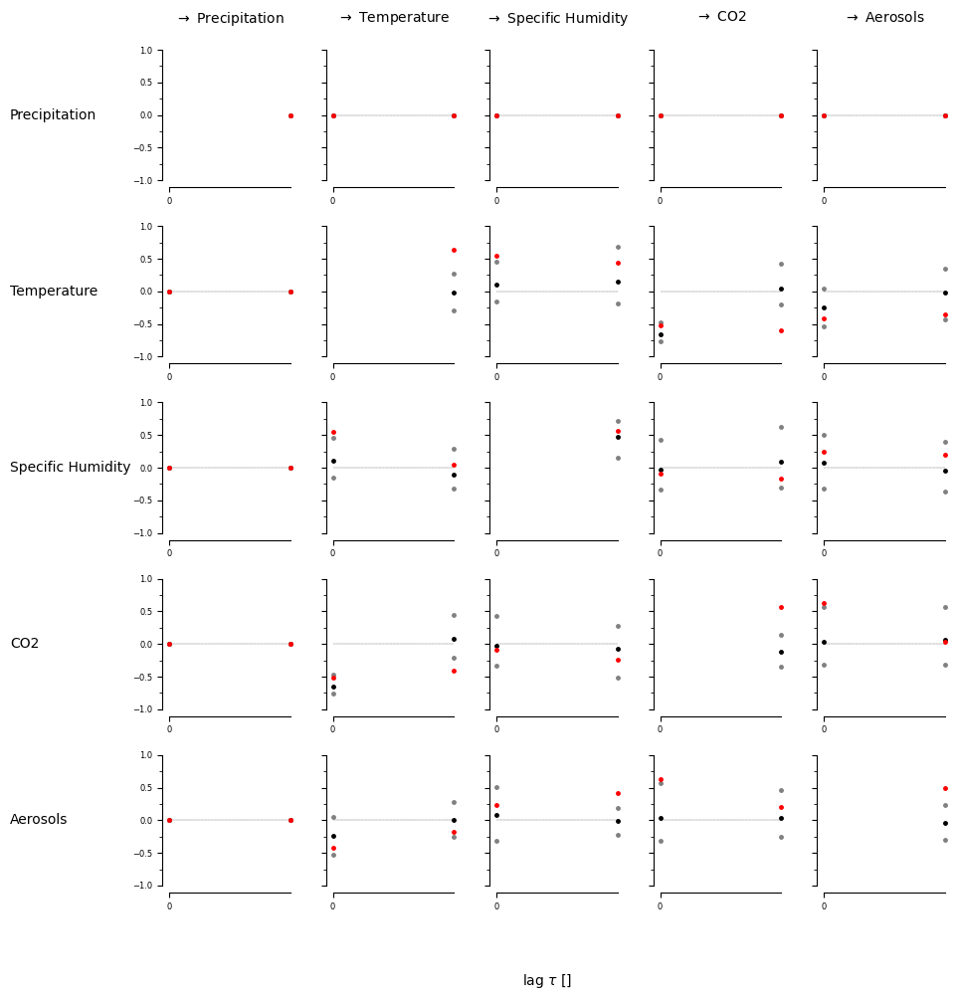

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [ True False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]]


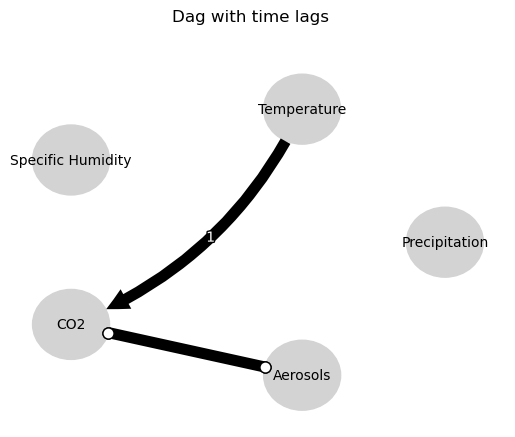

Negative precipitation values in event 50: 0


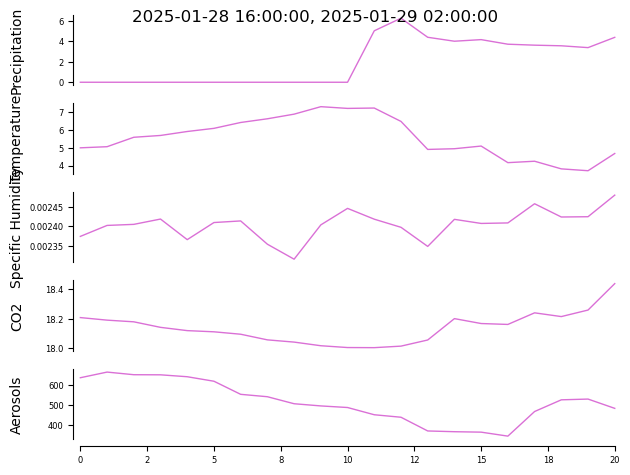


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


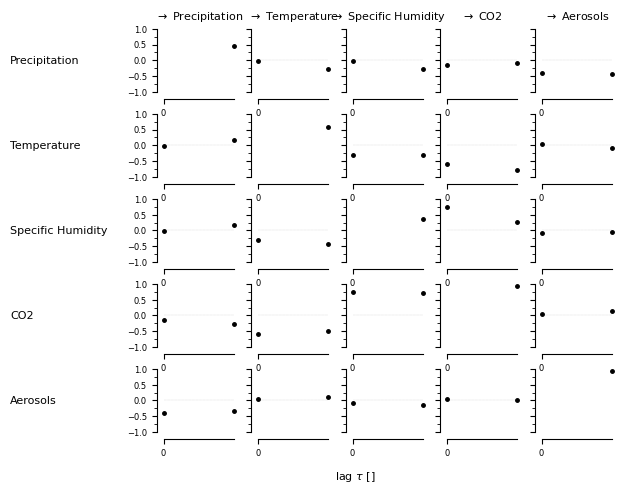

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.04372, |min_val| =  0.467

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
     

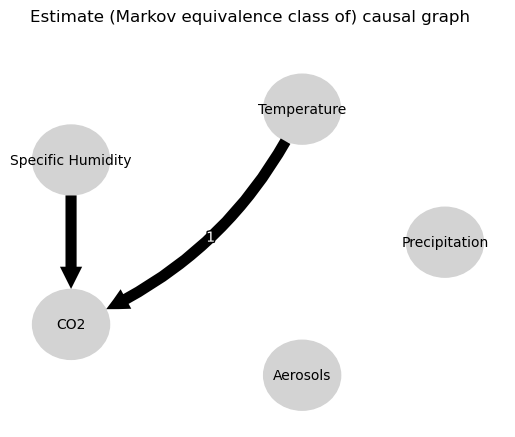

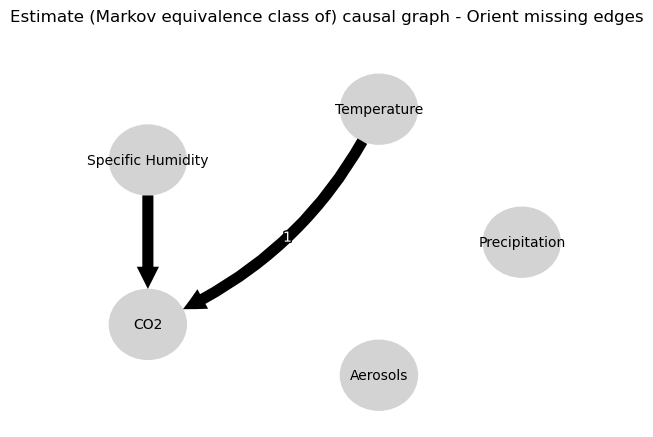

0.0
0.49044143179817645
0.11326552815900906
-0.0346532356457707
0.12544545802036963
-0.10487741216856475
-0.03757451634648381
-0.09377099255916187
-0.060347951739641546
-0.044632649021771977
0.11326552815900906
0.10965886728097358
0.0
-0.057982915613420526
-0.23265624219784112
-0.009662982374052342
0.06834685252331878
-0.7286808098597705
-0.2189200167309042
-0.11704177967167007
-0.23265624219784112
0.09927631855196503
0.0
-0.05960882693223354
0.16669094245542818
0.2012764068499754
0.17826817441111242
0.07125896408597798
0.06834685252331878
0.06447336186263988
0.16669094245542818
0.019976384464067777
0.0
-0.08625151101202479
0.07938242875952754
0.03404813194348697
-0.2189200167309042
0.04002186103137711
0.17826817441111242
-0.019142022725088203
0.07938242875952754
0.2330148328605042
0.0
0.4989156980255744


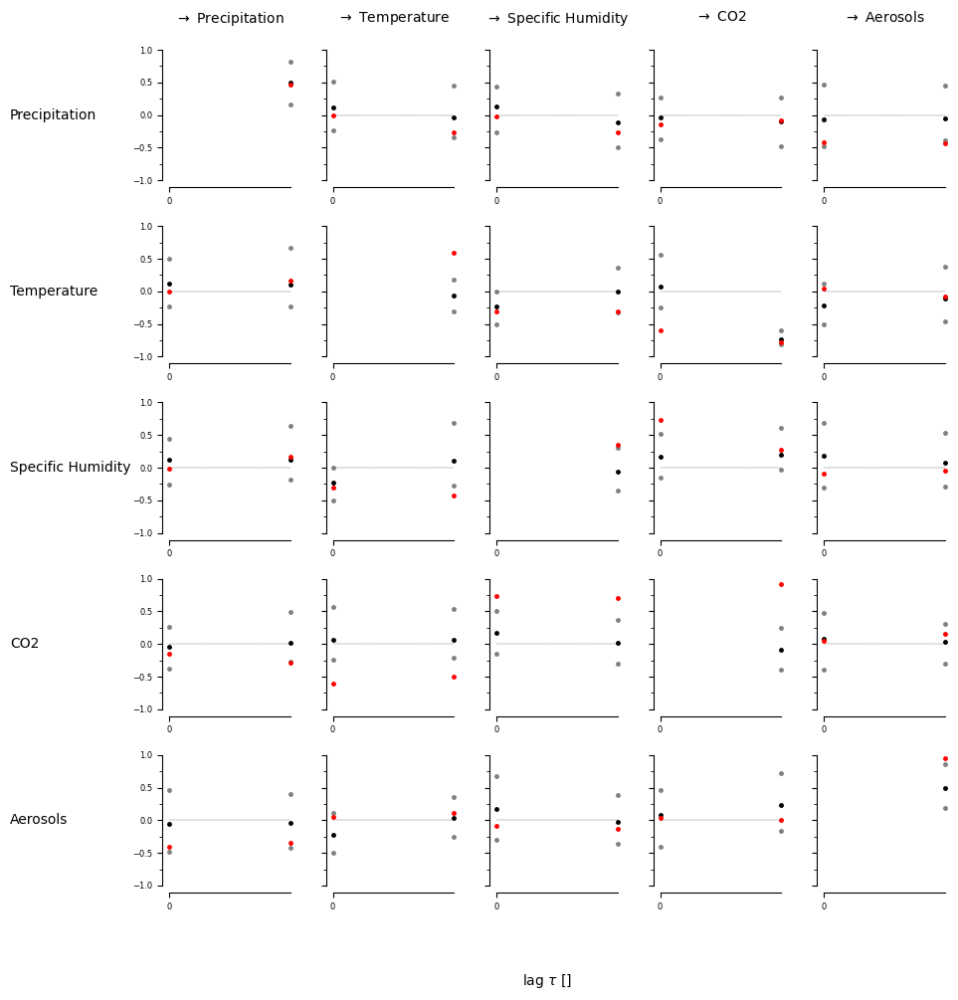

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [ True False]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


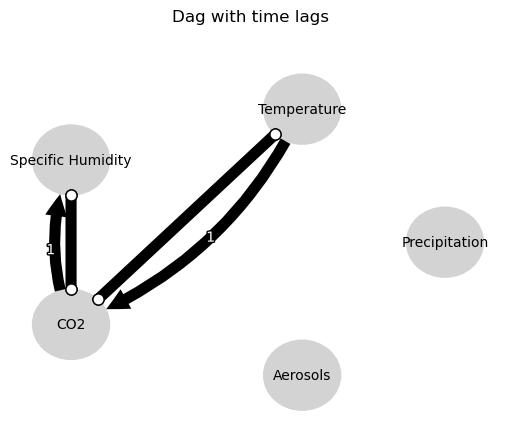

Negative precipitation values in event 51: 0


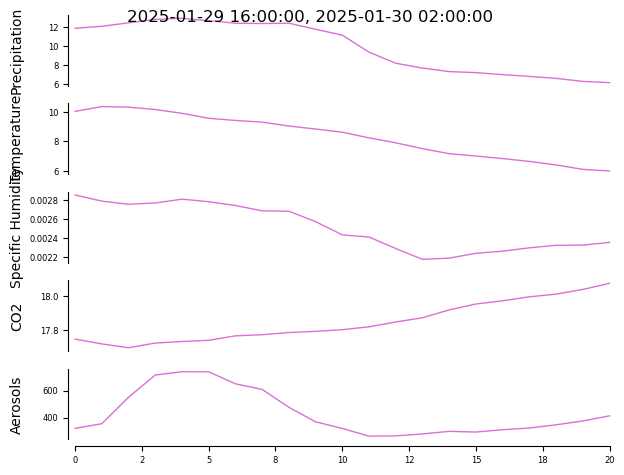


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


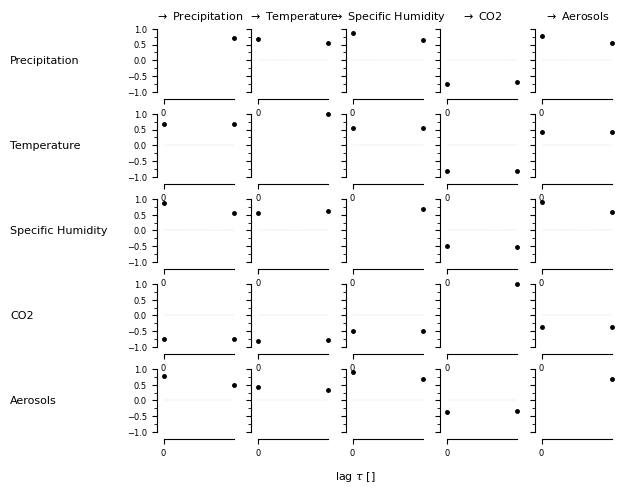

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (CO2 -1): max_pval = 0.02870, |min_val| =  0.515

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00000, |min_val| =  1.0

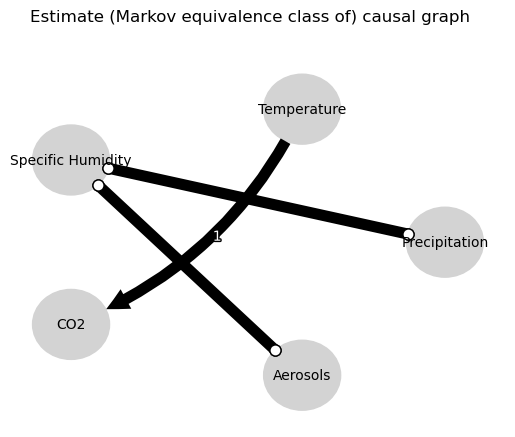

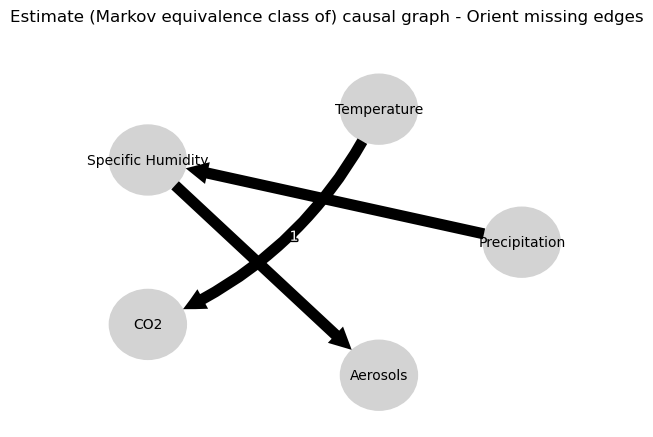

0.0
-0.07573725723850491
-0.04834406554577987
-0.13163355966629028
0.8333480875974628
-0.0867427046279925
0.0598925723806983
0.06327033868108618
0.6339332456827119
-0.060502191980899005
-0.04834406554577987
-0.029700441170479135
0.0
0.5587768121553742
0.011153469354047941
-0.07514673622616576
-0.49032955082589663
-0.5684558541221582
-0.07053257007850734
0.017470934083769016
0.011153469354047941
-0.042613393080862066
0.0
-0.1041450685018872
0.1296787822070402
0.021825132270878424
0.7100850778919217
-0.09365589022785324
-0.49032955082589663
-0.3881245300952823
0.1296787822070402
0.06284891232469984
0.0
0.5406781889662171
0.22110974586231308
-0.040422081844560684
-0.07053257007850734
-0.10187283867894863
0.7100850778919217
-0.06835037040930224
0.22110974586231308
0.07056070437450729
0.0
-0.08968107319315564


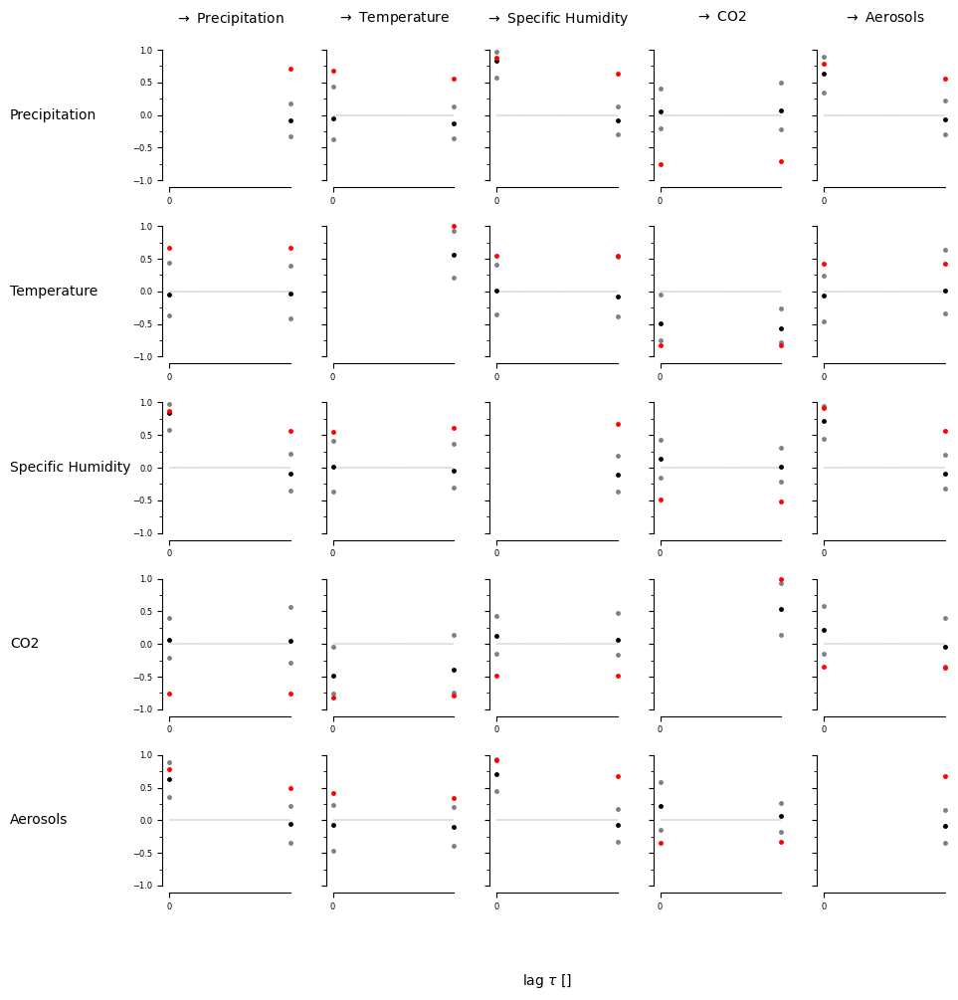

[[[False  True]
  [ True False]
  [ True  True]
  [ True  True]
  [ True False]]

 [[ True  True]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[ True False]
  [False  True]
  [False  True]
  [False False]
  [ True False]]

 [[ True  True]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[ True False]
  [False False]
  [ True  True]
  [False False]
  [False  True]]]


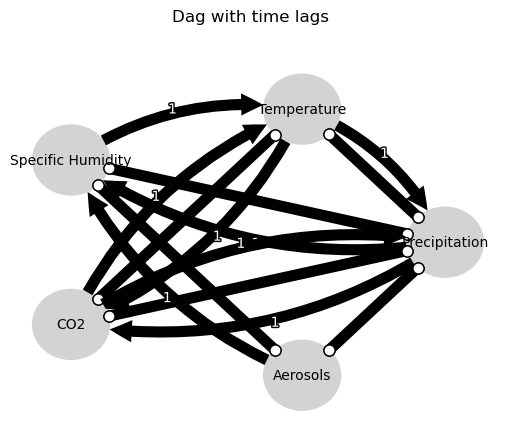

Negative precipitation values in event 52: 0


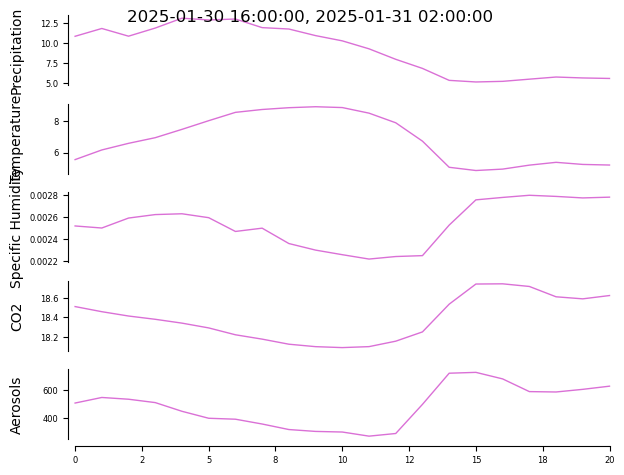


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


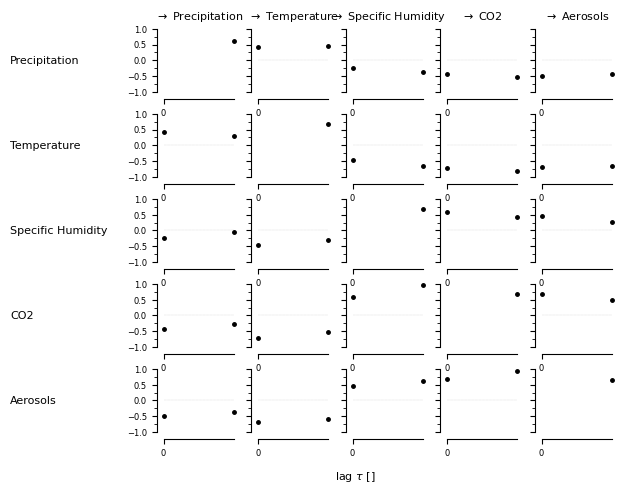

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.00518, |min_val| =  0.614

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.04346, |min_v

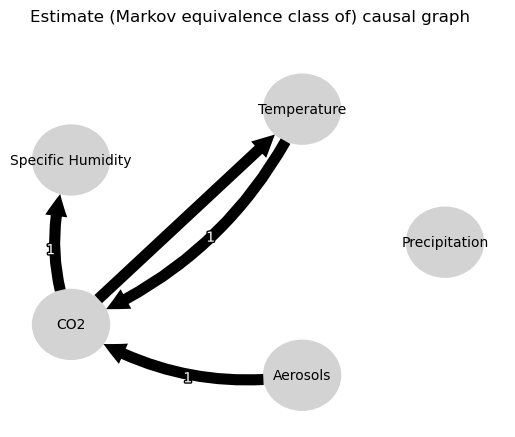

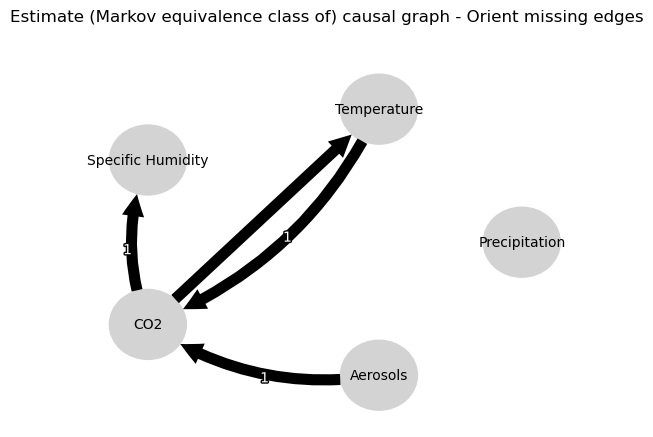

0.0
-0.030692353491882103
0.2895857777164564
0.44705923502359235
0.128052714462842
-0.06792415560214672
-0.15490661849369813
-0.47634496357066974
-0.545096272917392
-0.005710260900222472
0.2895857777164564
-0.10422673854149928
0.0
0.38292698258825814
-0.23366636304598717
-0.5785240074909268
-0.6999686478765206
-0.5244395847610144
-0.05682092498490298
0.08024853720715736
-0.23366636304598717
-0.08293107835811118
0.0
0.30178975133928404
0.388510510711219
0.14851767366910135
0.017487689340388312
-0.07538977211056727
-0.6999686478765206
-0.3549780176262218
0.388510510711219
0.687883208357487
0.0
0.41230795900160033
0.022814838098112154
-0.08499753152347075
-0.05682092498490298
-0.44952247356204567
0.017487689340388312
-0.05158387022752916
0.022814838098112154
0.5162481270150558
0.0
-0.045829378279399216


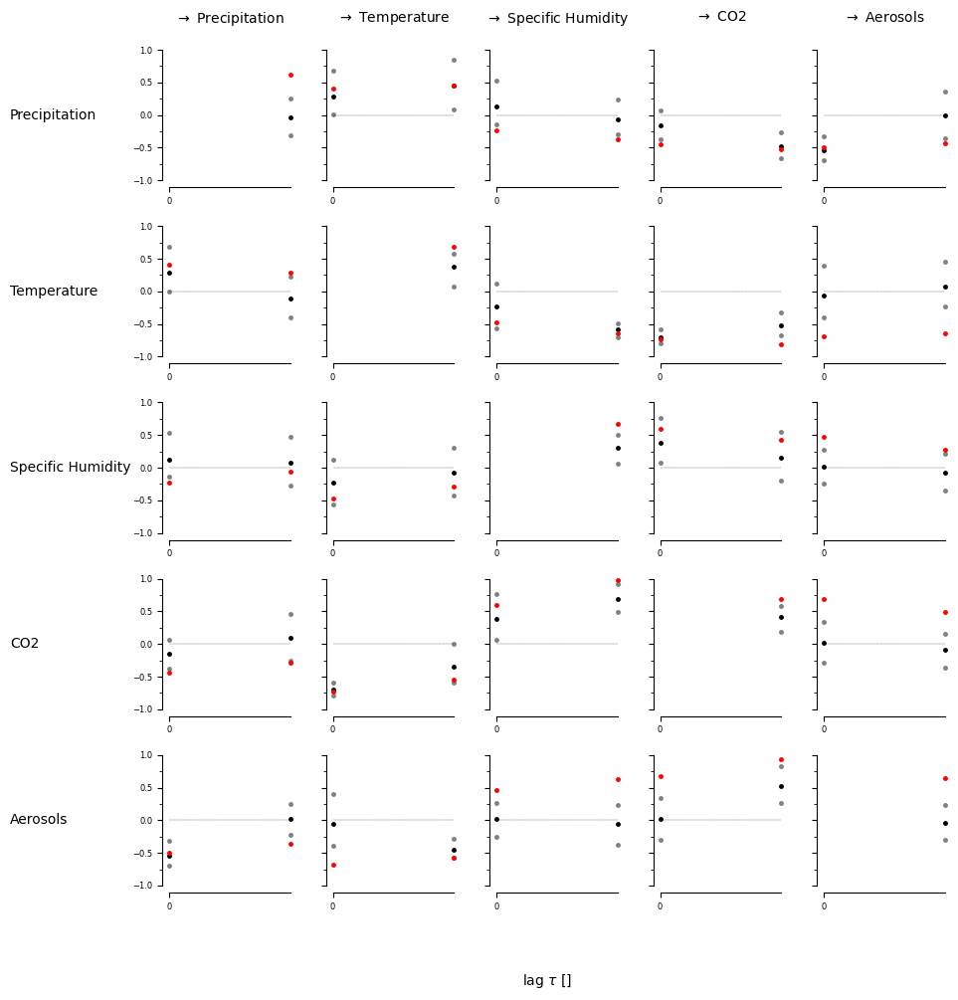

[[[False  True]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [ True False]
  [False False]]

 [[False False]
  [ True False]
  [ True  True]
  [False  True]
  [ True False]]

 [[False False]
  [ True False]
  [False  True]
  [ True  True]
  [False  True]]]


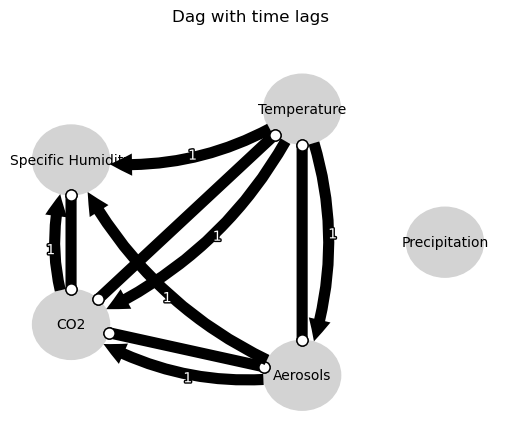

Negative precipitation values in event 53: 0


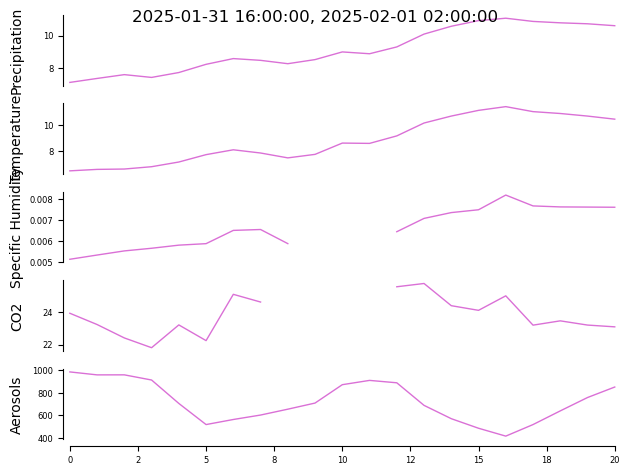


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


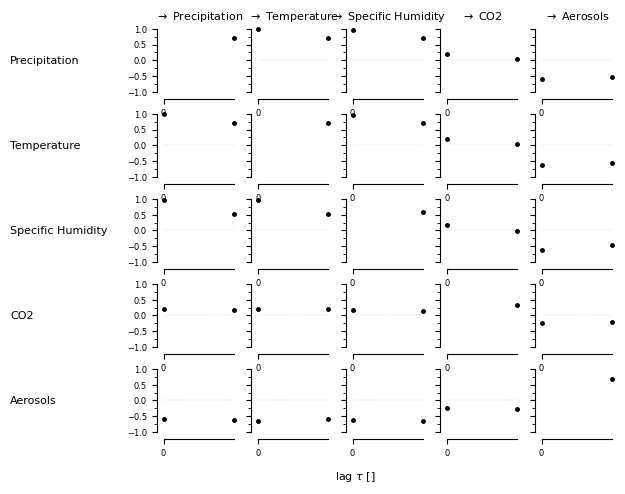

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Specific Humidity -1): max_pval = 0.03258, |min_val| =  0.535

    Variable Temperature has 1 link(s):
        (Specific Humidity -1): max_pval = 0.035

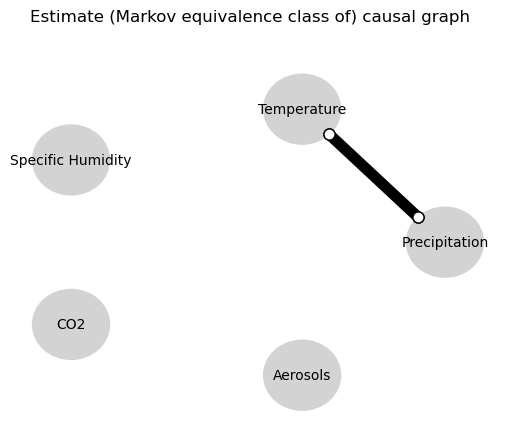

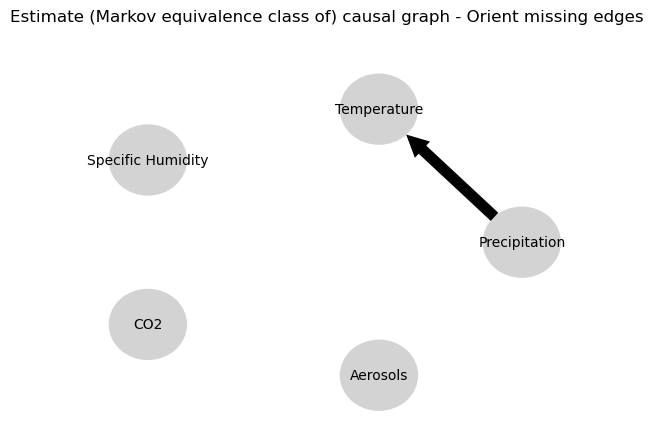

0.0
-0.10443823966960236
0.9558113824483414
-0.0943417425085908
0.9168072001506263
-0.07219753513487244
0.3131264750776922
-0.036840293925926595
-0.38285558636097405
0.04908283927261899
0.9558113824483414
-0.11100956349159835
0.0
-0.10120162329996761
0.8962738749107982
-0.0952578553512428
0.3322198857443706
-0.044078012697770994
-0.4052994586732572
0.05449520568699799
0.8962738749107982
-0.09272710242948776
0.0
-0.08237560245853805
0.3120761072180491
-0.016337666429594184
-0.4411800731133632
0.04915317568732646
0.3322198857443706
0.011404057476484274
0.3120761072180491
-0.007186648453238024
0.0
-0.027025889938739053
-0.28158253644397707
0.015260534375039292
-0.4052994586732572
0.005541315808058016
-0.4411800731133632
0.021862433974744126
-0.28158253644397707
0.020628528396583284
0.0
-0.04596803662864672


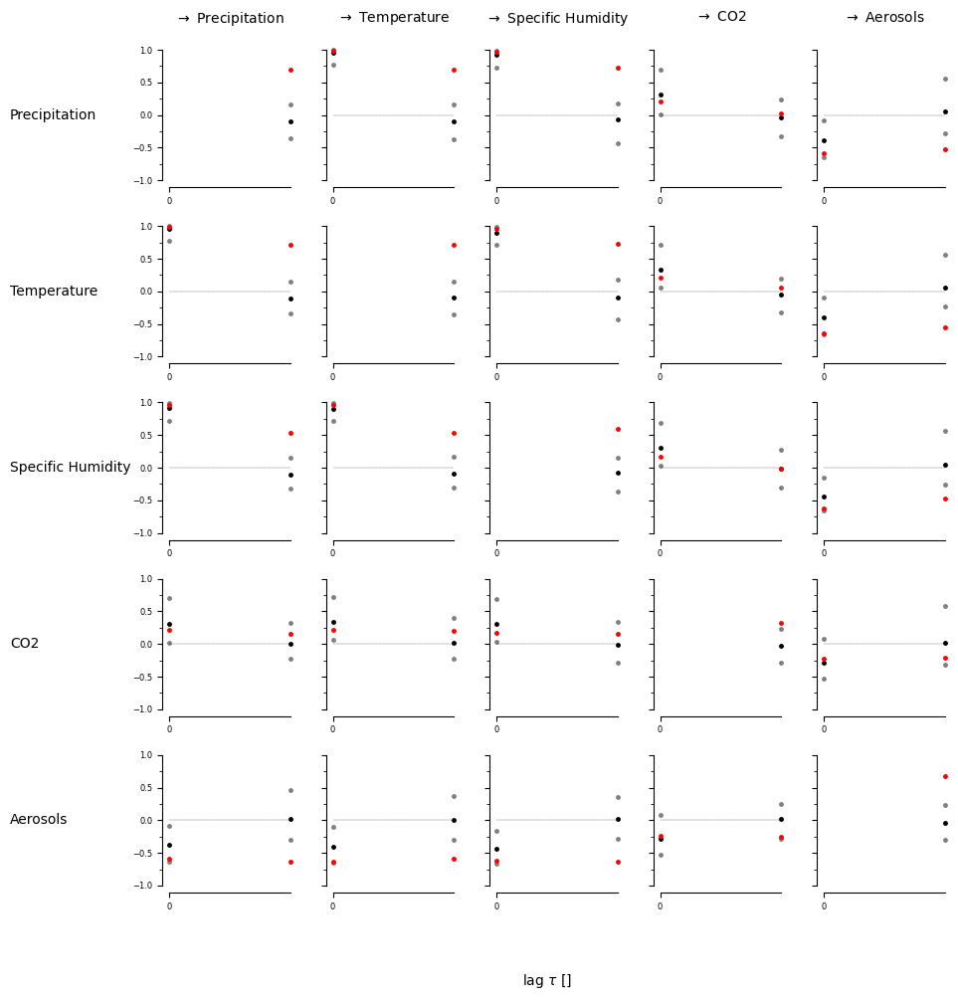

[[[False  True]
  [ True  True]
  [ True  True]
  [False False]
  [ True False]]

 [[ True  True]
  [False  True]
  [ True  True]
  [False False]
  [ True False]]

 [[ True False]
  [ True False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[ True  True]
  [ True  True]
  [False  True]
  [False False]
  [False  True]]]


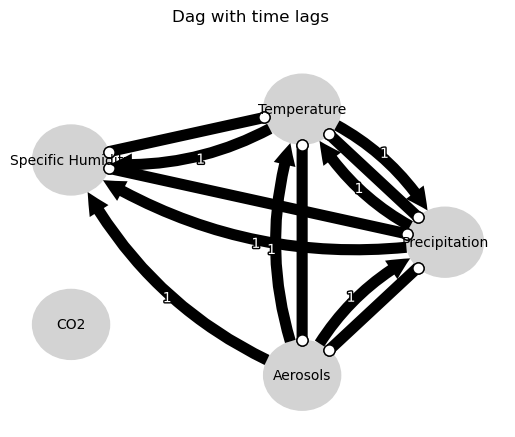

Negative precipitation values in event 54: 5


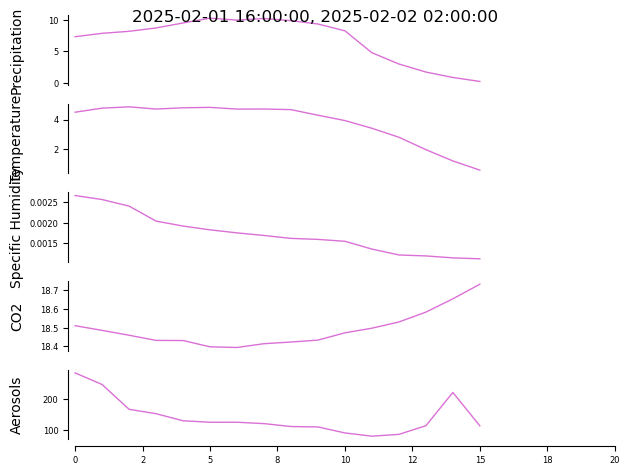


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


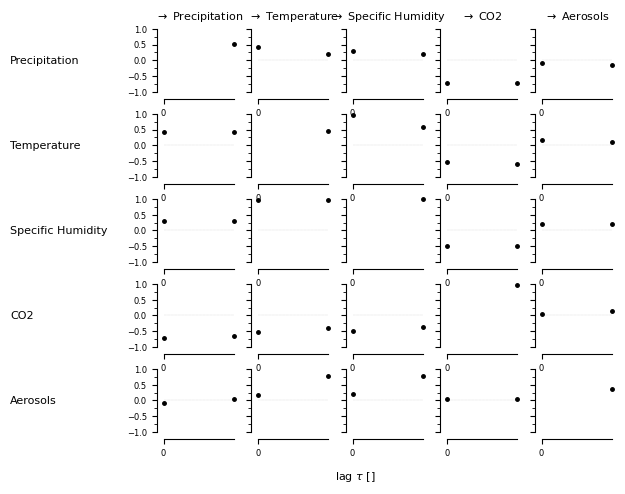

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (CO2 -1): max_pval = 0.01407, |min_val| =  0.638

    Variable Temperature has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00000, |min_val| 

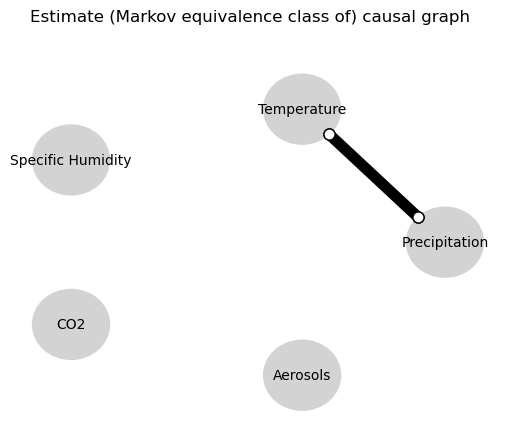

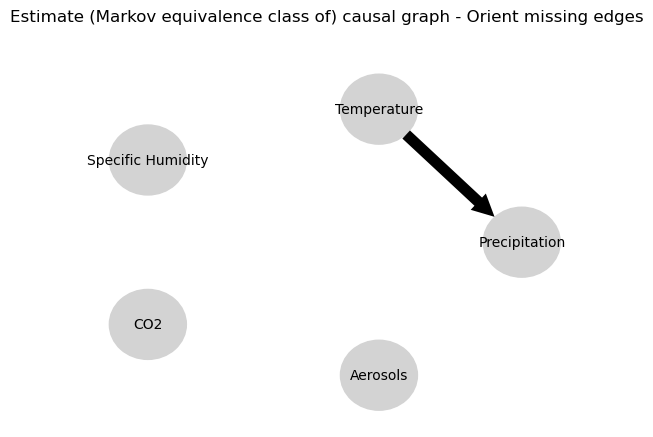

0.0
0.0028152165942852154
0.9324256455237333
0.008807046848913033
0.07748184238736963
0.07116554106863442
0.05646363730807104
0.0005901635787328608
-0.08094733904360649
-0.01653833382811106
0.9324256455237333
-0.01837029971758496
0.0
-0.028079958791215203
0.04876914378863161
0.06015163231129265
0.056310697706338744
-0.009730041047572812
-0.01749508584380403
-0.052068402236552486
0.04876914378863161
-0.0030288069729630367
0.0
0.476790186331155
0.08528546681847894
0.0807794519377089
0.07636334115127719
-0.11178563096889031
0.056310697706338744
0.08053040226068367
0.08528546681847894
0.08903521086695518
0.0
0.9766776245177812
0.1538522127256338
0.17872650700969236
-0.01749508584380403
-0.015363587835785083
0.07636334115127719
0.08210788209974536
0.1538522127256338
0.1355853125409775
0.0
-0.045829378279399216


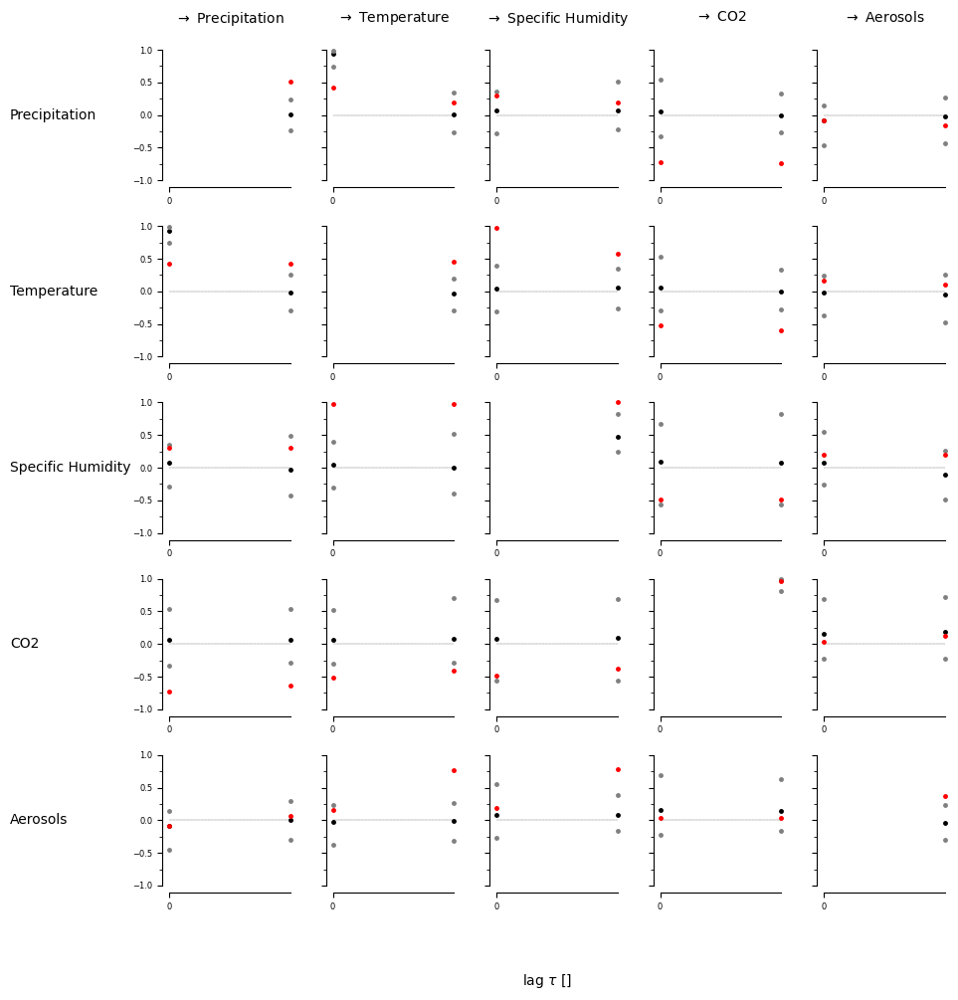

[[[False False]
  [False False]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [False False]
  [False False]]

 [[ True False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [False False]
  [False False]]]


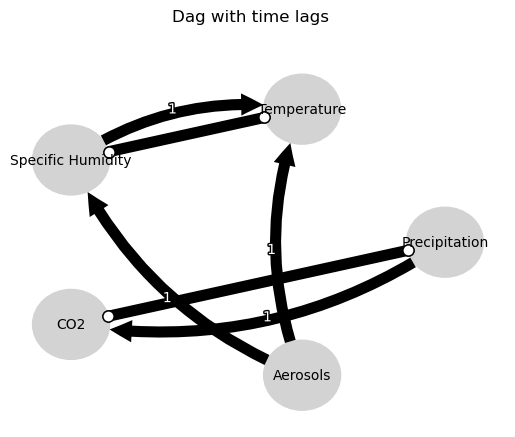

Negative precipitation values in event 55: 1


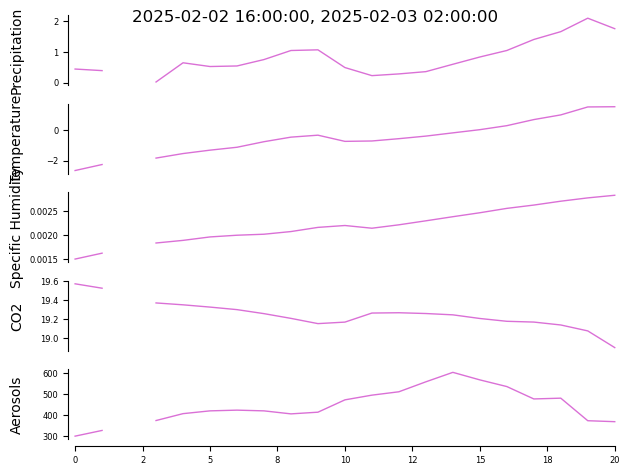


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


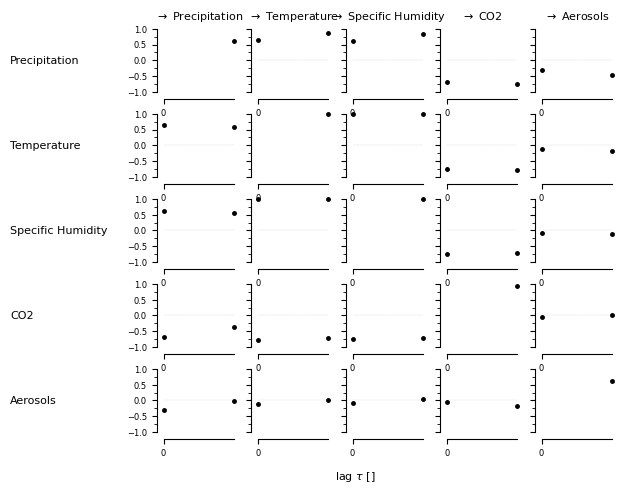

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 2 link(s):
        (Specific Humidity -1): max_pval = 0.00077, |min_val| =  0.753
 

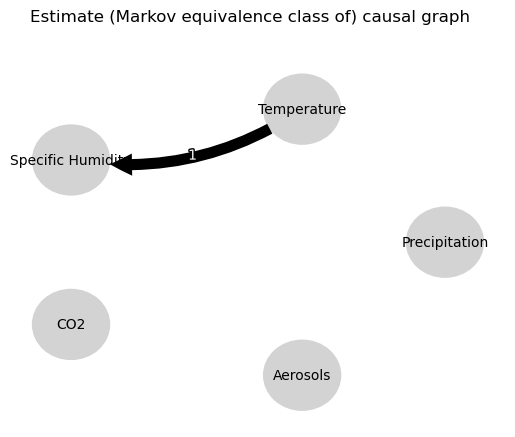

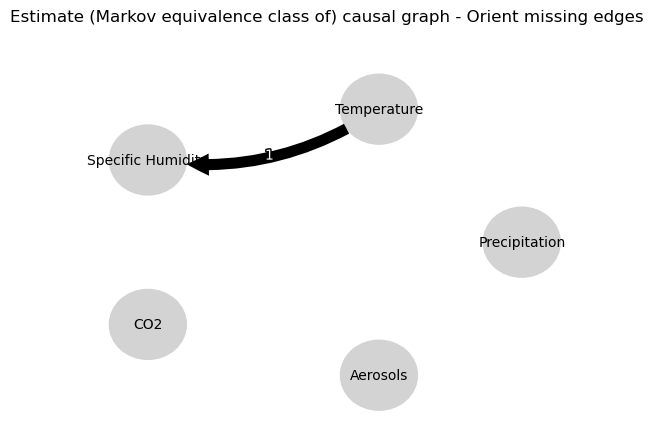

0.0
-0.04002681969447785
0.7747779924288075
0.003835207263036424
0.078371981224524
0.07309240099812866
-0.19503961274939194
-0.12019825602172897
-0.2758582941289109
-0.010957361419945943
0.7747779924288075
-0.049166525796854356
0.0
-0.050467051936675646
0.04486514911823751
0.10732930623444177
-0.1751125782637694
-0.12422859413142341
0.06316033490577405
-0.046496952544979445
0.04486514911823751
-0.0195811790814462
0.0
0.5474138792950771
-0.4729560493767431
-0.3759928975942333
-0.024294278806811263
-0.011711738034844398
-0.1751125782637694
0.04860554133377155
-0.4729560493767431
-0.3488728411494889
0.0
0.5905252404635756
0.06932558045982298
-0.22527566145177724
0.06316033490577405
-0.023954814108132515
-0.024294278806811263
0.049265715915612705
0.06932558045982298
-0.027612555914966485
0.0
-0.045829378279399216


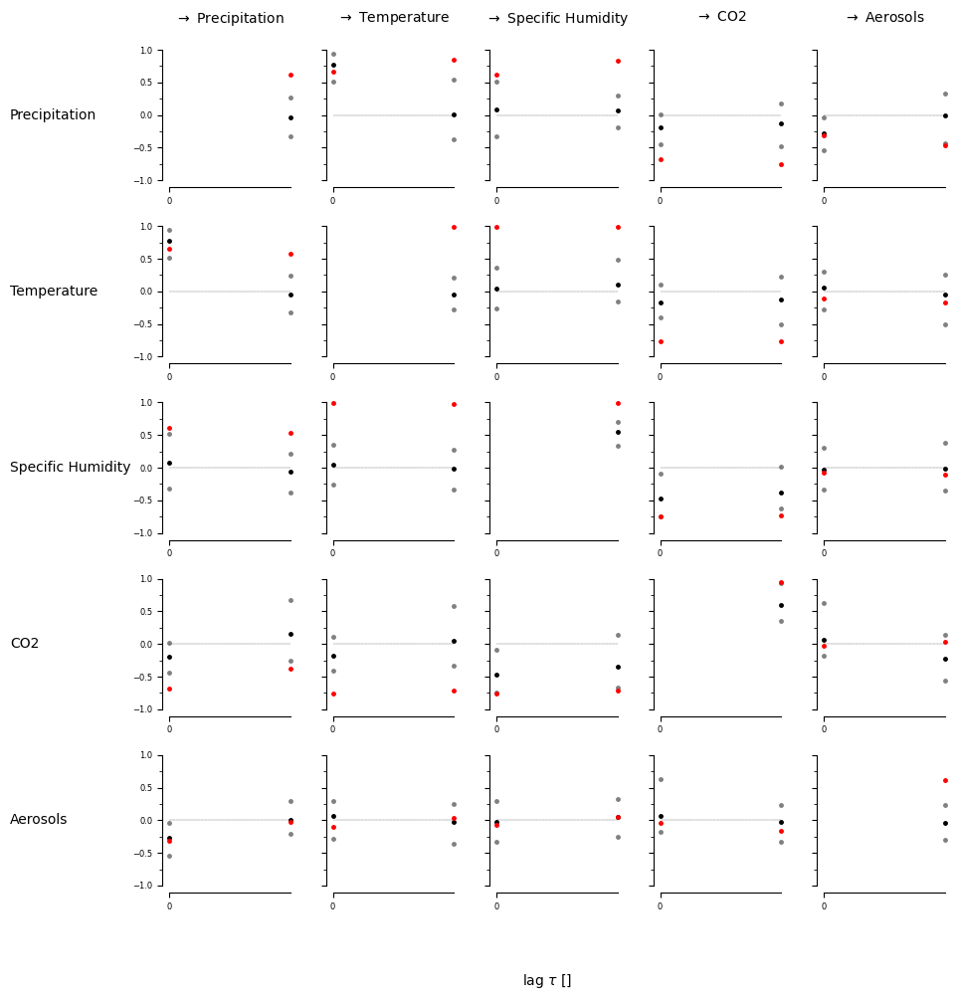

[[[False  True]
  [ True  True]
  [ True  True]
  [ True  True]
  [False False]]

 [[ True False]
  [False  True]
  [ True  True]
  [ True  True]
  [False False]]

 [[ True False]
  [ True  True]
  [False  True]
  [ True  True]
  [False False]]

 [[ True False]
  [ True  True]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


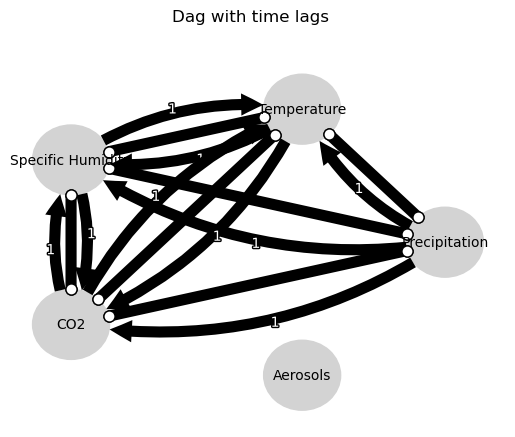

Negative precipitation values in event 56: 0


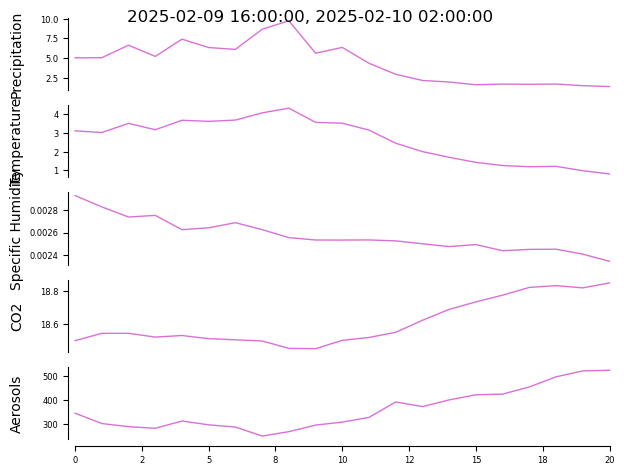


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


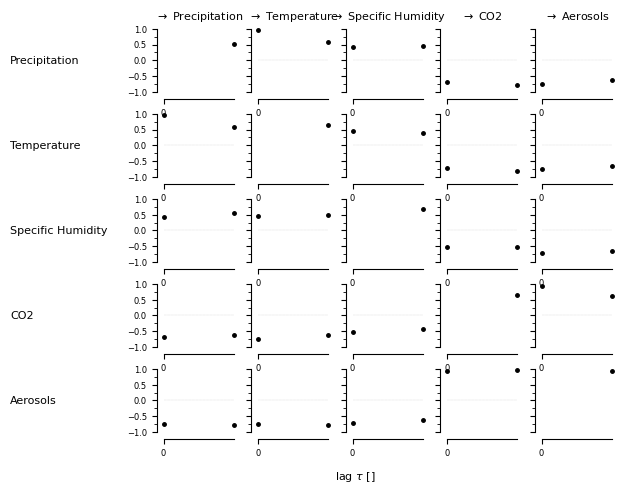

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Aerosols -1): max_pval = 0.00730, |min_val| =  0.609

    Variable Temperature has 1 link(s):
        (Aerosols -1): max_pval = 0.01034, |min_val| =  0

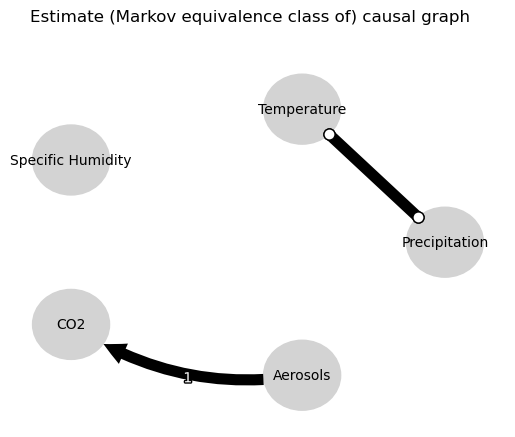

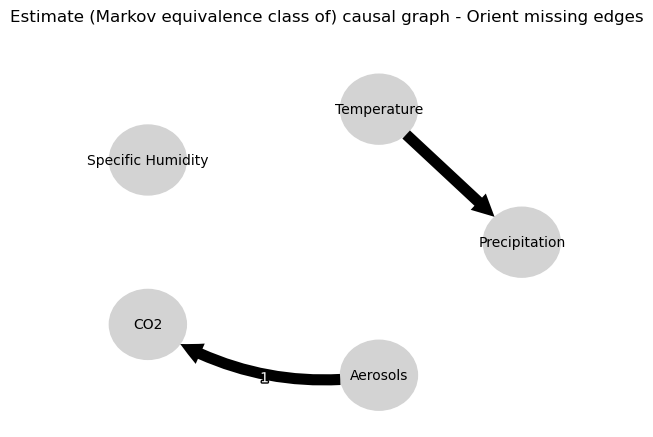

0.0
-0.02683313888999396
0.8963418897150278
-0.020616491712880804
0.5650997247811883
-0.013452421144167363
-0.004146376222506213
-0.01880299046012869
-0.08561357694601114
-0.04740726697460813
0.8963418897150278
-0.013087451645787264
0.0
-0.03110578696733264
0.6443667806289415
-0.007981753507419306
-0.06156433287500151
-0.011437437758270963
-0.07502088818552302
-0.05662396074900758
0.6443667806289415
-0.04063689854566966
0.0
-0.0452706411478806
0.08096618041928785
-0.04234393668806593
-0.07915676177073214
-0.05024555279374647
-0.06156433287500151
0.08204281562816984
0.08096618041928785
0.1378203431636491
0.0
0.5148046705354912
0.6994239426170149
0.5653726307875477
-0.07502088818552302
0.03922222585388636
-0.07915676177073214
0.1899772439563679
0.6994239426170149
0.7527386105122746
0.0
0.6809210868807126


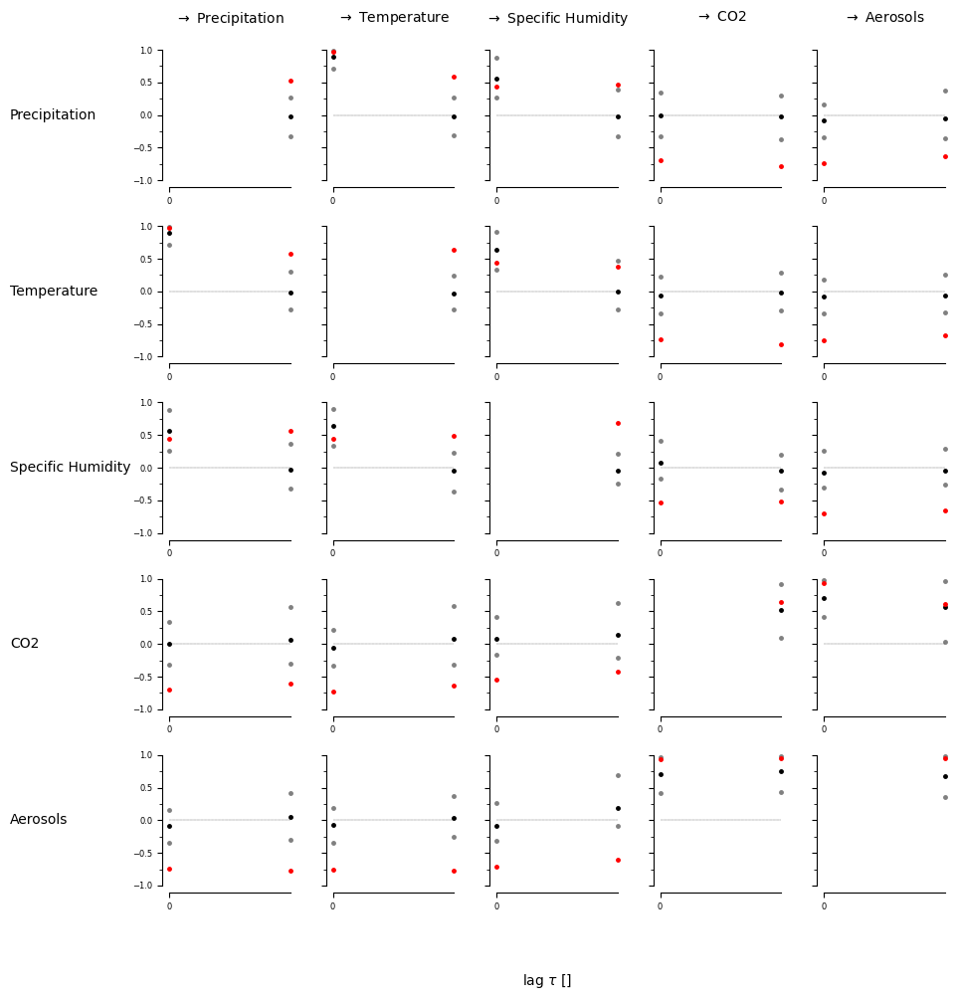

[[[False False]
  [ True  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[ True False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True  True]]

 [[ True  True]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[ True  True]
  [ True  True]
  [ True  True]
  [ True  True]
  [False  True]]]


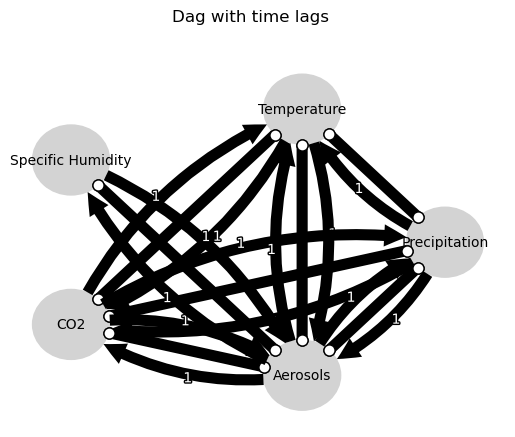

Negative precipitation values in event 57: 5


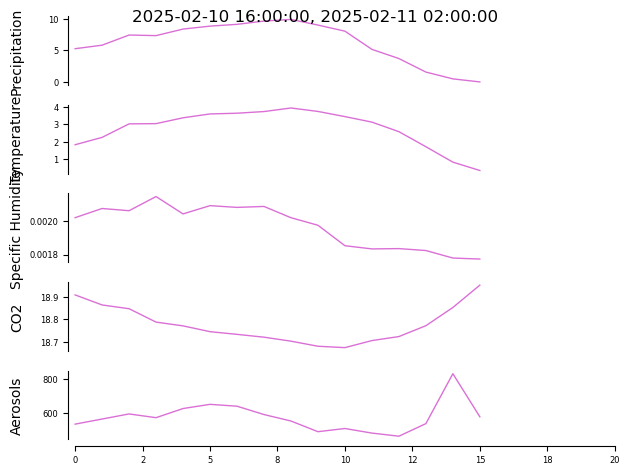


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


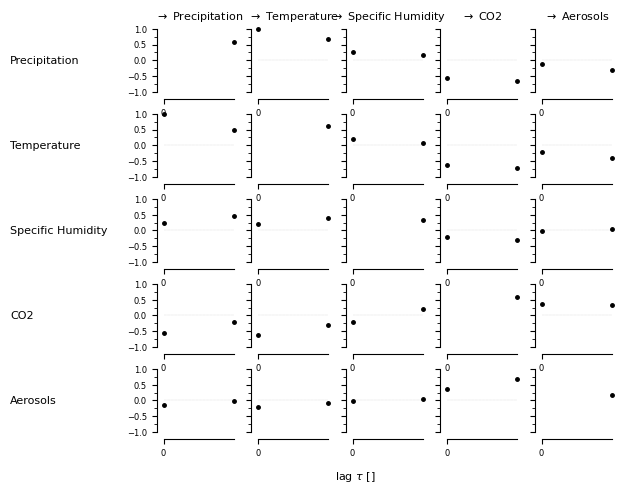

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.02907, |min_val| =  0.582

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    

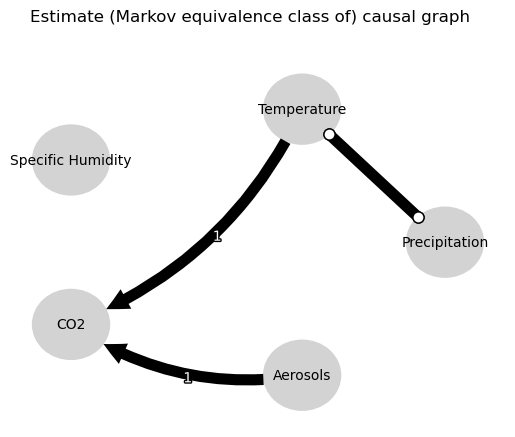

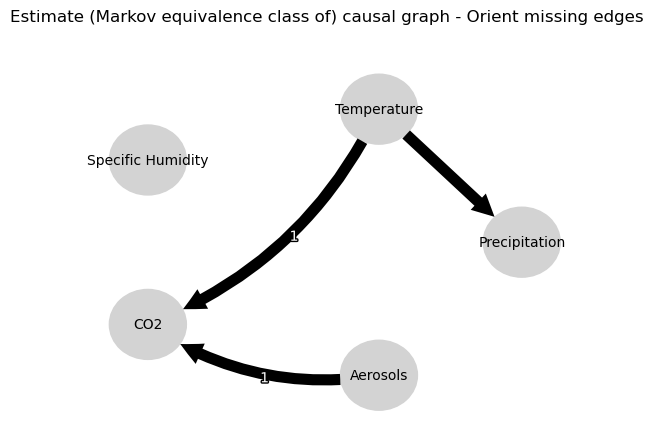

0.0
-0.03177170096583186
0.8633758272018791
-0.041059244122591765
0.6323585984125143
-0.021226996933147956
0.07658547242881045
-0.719089150780062
-0.045310171128498125
0.03152038926581983
0.8633758272018791
-0.01497820455725067
0.0
-0.02285476283627429
0.486529297218906
-0.01949831567236709
0.0434597968749725
-0.7766876557484395
-0.22940803030124718
0.005966226073888055
0.486529297218906
-0.03633994496300518
0.0
-0.05836398039977679
0.1873469511410665
-0.42321418513088127
0.22288965639645414
0.06239598217487987
0.0434597968749725
0.07693740928652922
0.1873469511410665
0.006862977312219793
0.0
-0.08026303548377858
0.06350709269153261
0.04520421842461771
-0.22940803030124718
0.02609528822211695
0.22288965639645414
0.012614180147078054
0.06350709269153261
0.2787628976967431
0.0
-0.0438664419562254


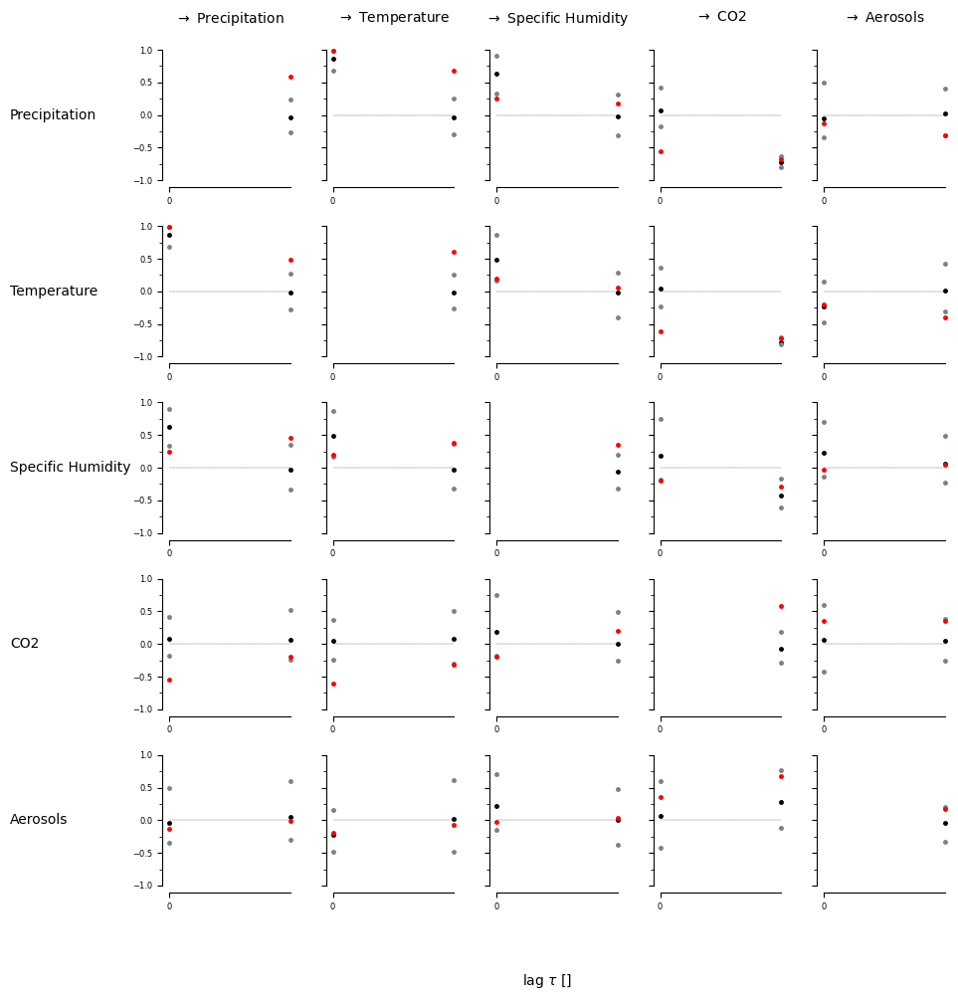

[[[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[ True False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]]


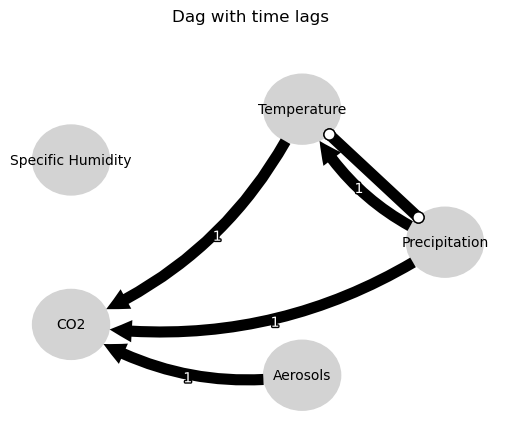

Negative precipitation values in event 58: 14


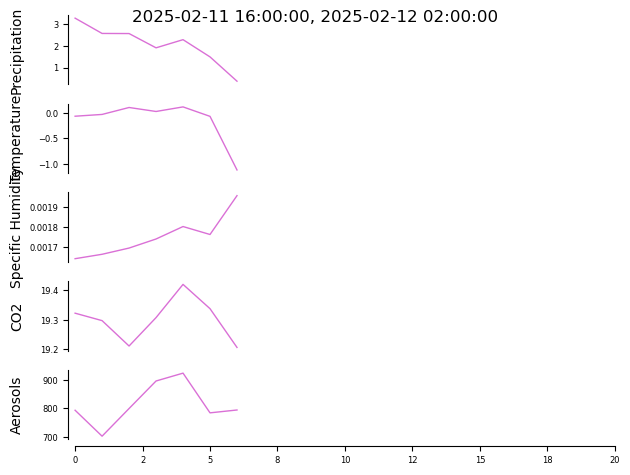


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


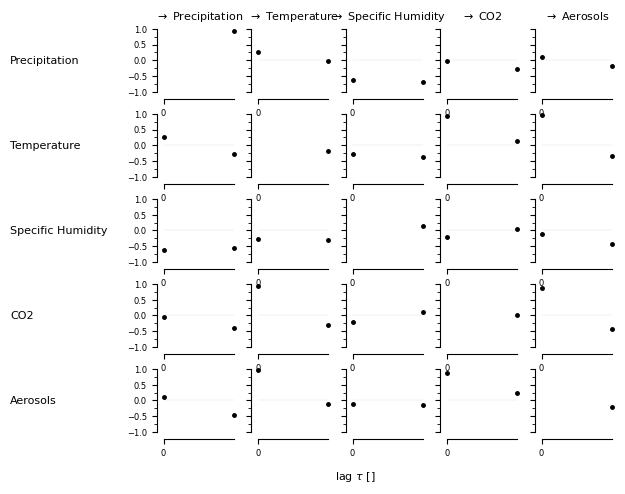

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.01576, |min_val| =  0.944

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    

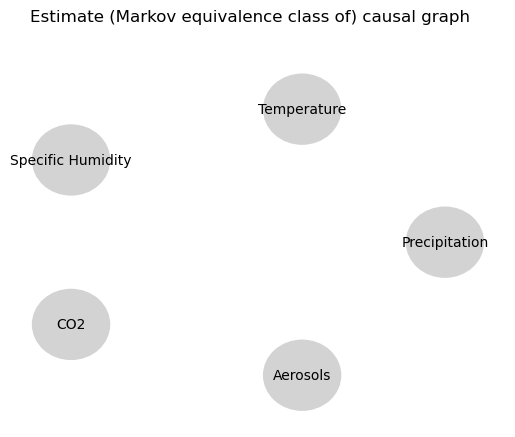

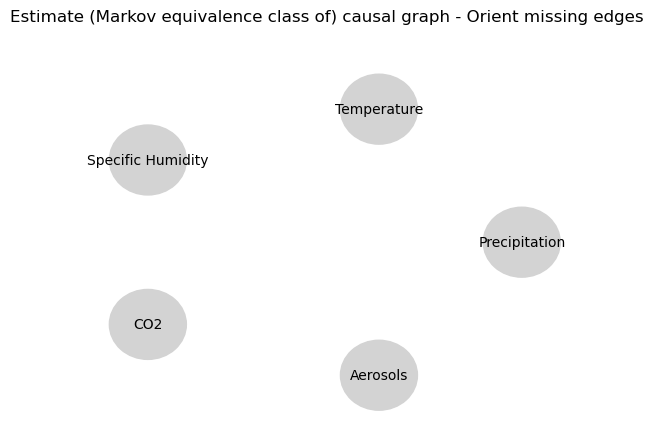

⚠️ Skipping event 59 ((Timestamp('2024-12-01 16:00:00'), Timestamp('2024-12-02 02:00:00')) → (Timestamp('2024-12-02 16:00:00'), Timestamp('2024-12-03 02:00:00'))) due to error: Less than 10 overlapping samples due to masking and/or missing values, cannot compute residual covariance!
Negative precipitation values in event 59: 0


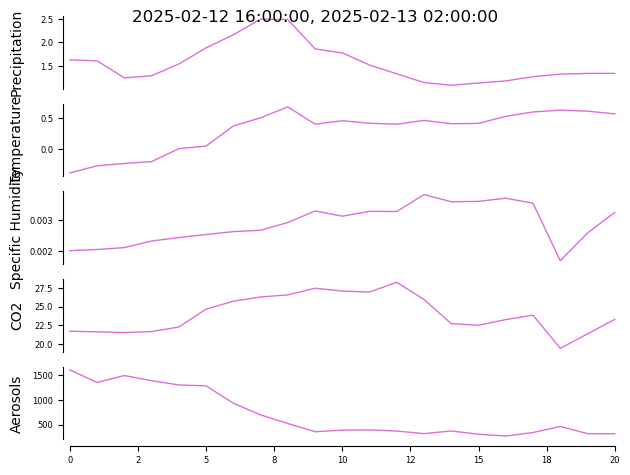


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


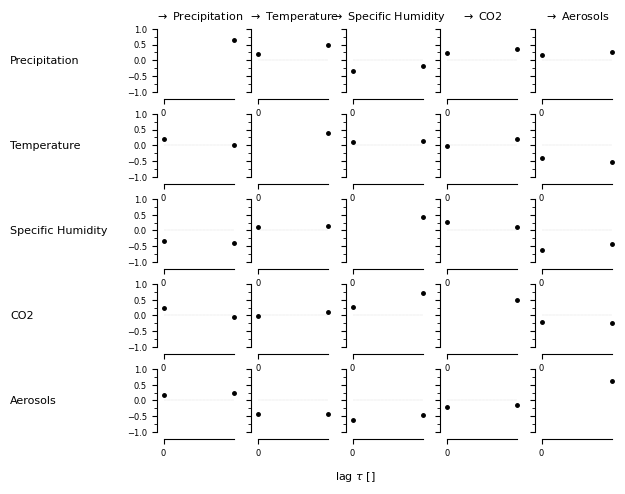

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.00254, |min_val| =  0.651

    Variable Temperature has 1 link(s):
        (Precipitation -1): max_pval = 0.03884, |min

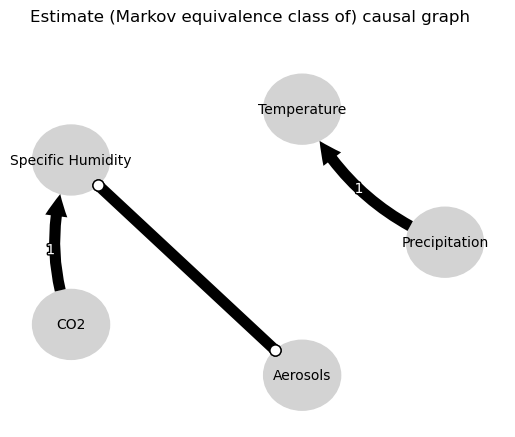

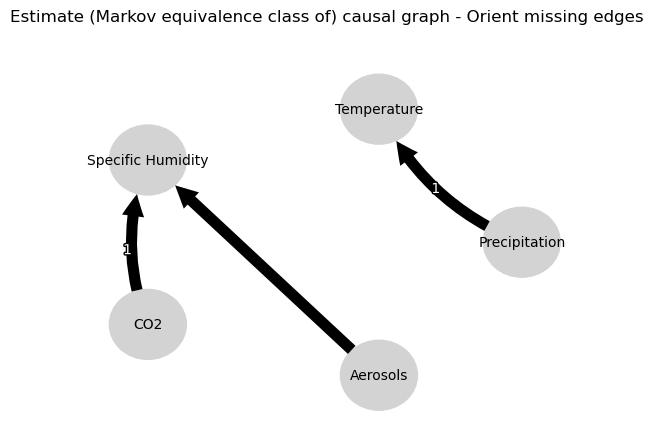

0.0
0.46613109481784715
0.06729215128296478
0.03557717034243214
-0.1775012493938522
0.04966611774228142
-0.028064443900435127
0.057717123358326995
0.20596720534109977
-0.02693173105684115
0.06729215128296478
0.002277519166052225
0.0
-0.04095139825968342
0.3474135686703843
0.1015620300659477
0.21290213838113123
-0.005625948089791896
-0.689270855737074
-0.013664100011496878
0.3474135686703843
-0.039596805433643155
0.0
0.0006343817617290942
0.2927637833305541
-0.010201691620625074
-0.48844754833558446
0.04765151798542013
0.21290213838113123
-0.06497845529505923
0.2927637833305541
0.17148078895416666
0.0
-0.04024242196202725
-0.2088292385328837
0.01908344897704319
-0.689270855737074
0.10845512510487323
-0.48844754833558446
-0.07269904673915535
-0.2088292385328837
0.05147392052473618
0.0
-0.0438664419562254


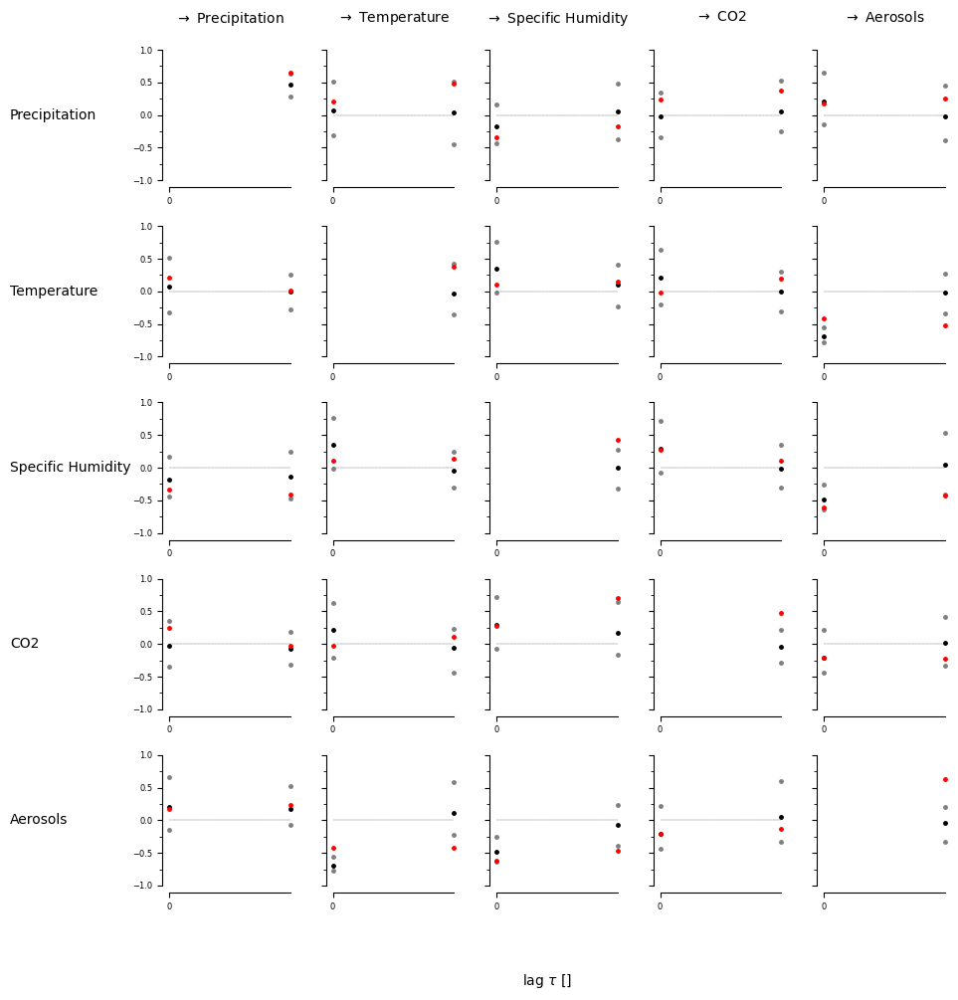

[[[False  True]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [ True False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False  True]]]


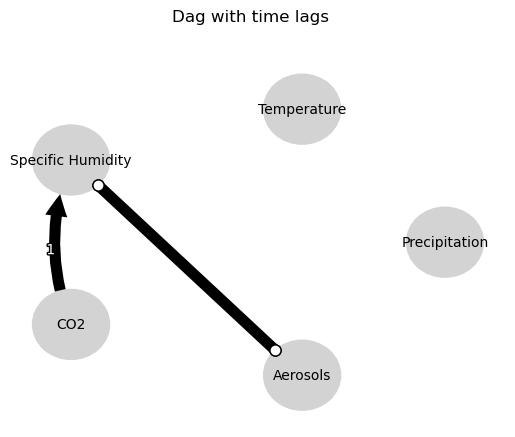

Negative precipitation values in event 60: 0


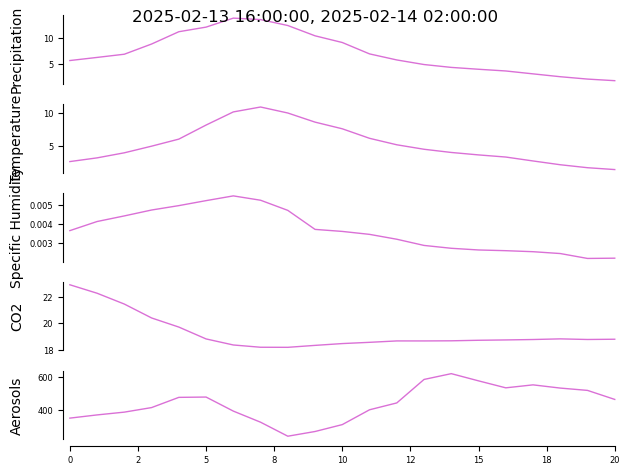


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


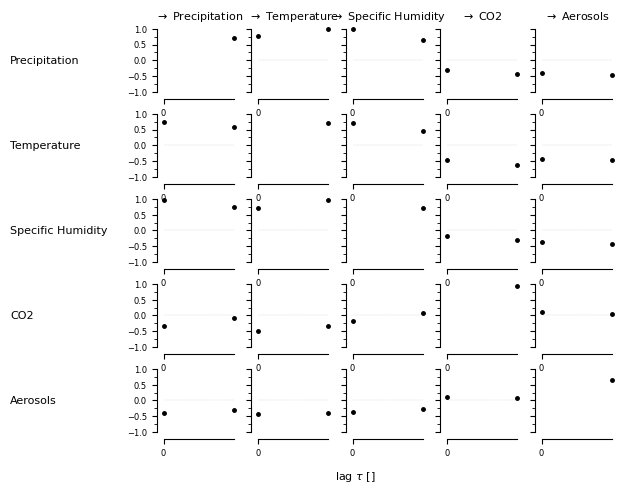

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Precipitation -1): max_pval = 0.00011, |min_val| =  0.787

    Variable Specific Humidity has 1 link(s):
     

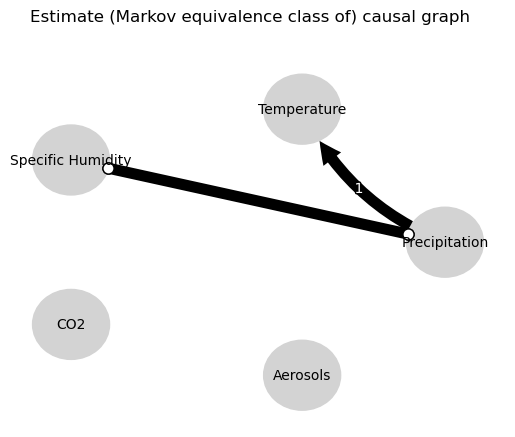

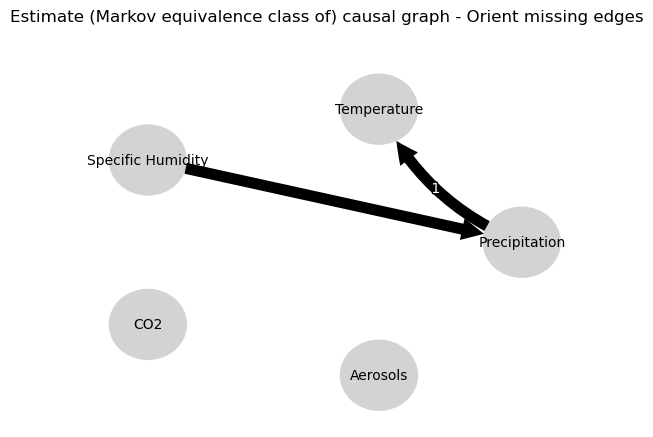

0.0
-0.07952355341632278
-0.044227005999272075
0.953574829470268
0.9002259719368298
-0.07271617974133635
-0.13897315424362797
-0.02391179290844985
-0.1666674296276132
-0.1586840899169456
-0.044227005999272075
-0.10211787351255167
0.0
-0.03243132913961819
-0.04559304361279927
-0.09578625095307401
-0.09024527697896292
-0.0020739658801914567
-0.17795710278903076
-0.12119844465596412
-0.04559304361279927
0.8791025343426473
0.0
-0.09239463365389819
0.0644371845976303
-0.05596830333984017
-0.16222063746728332
-0.17010649438727052
-0.09024527697896292
-0.12246620737132562
0.0644371845976303
-0.033931514452720725
0.0
-0.10594414111790468
0.14675249417858066
0.06406521950127306
-0.17795710278903076
-0.18467384117222893
-0.16222063746728332
0.08539099328484372
0.14675249417858066
0.03130166115314096
0.0
0.4867255374259592


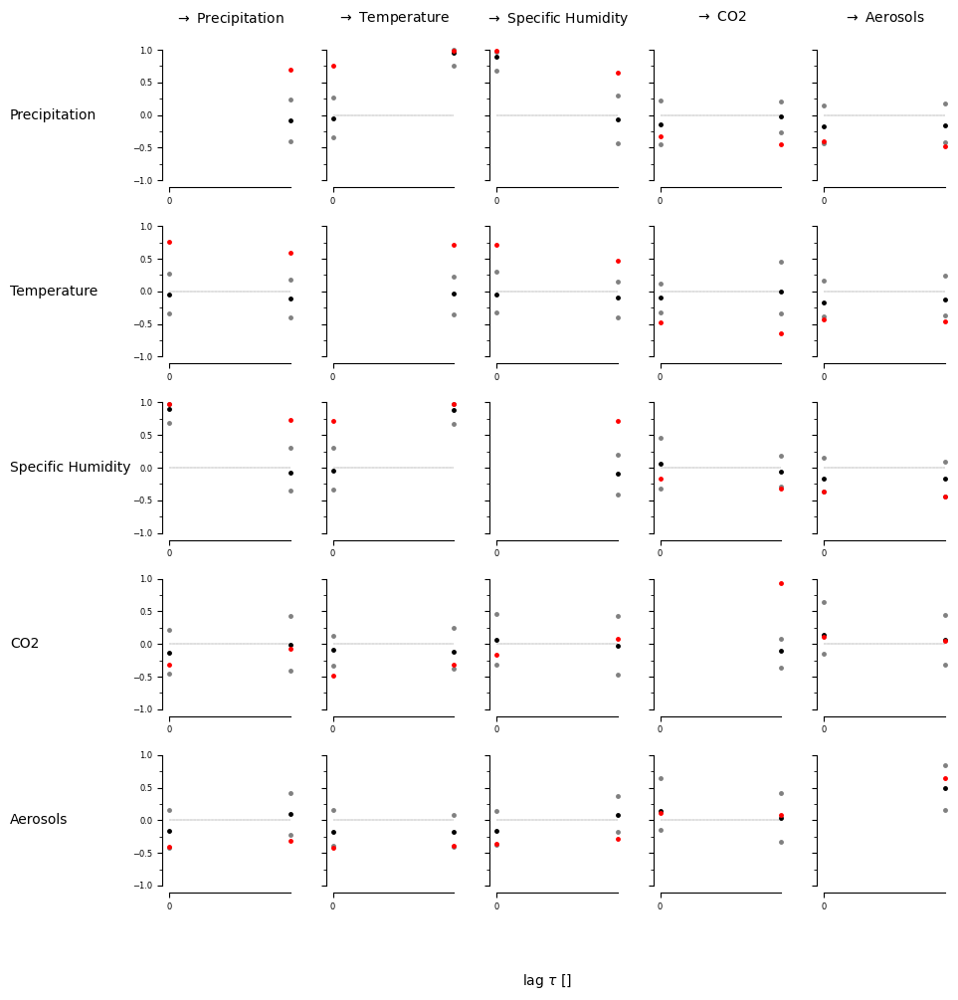

[[[False  True]
  [ True  True]
  [ True  True]
  [False False]
  [False False]]

 [[ True  True]
  [False  True]
  [ True False]
  [False  True]
  [False False]]

 [[ True  True]
  [ True  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


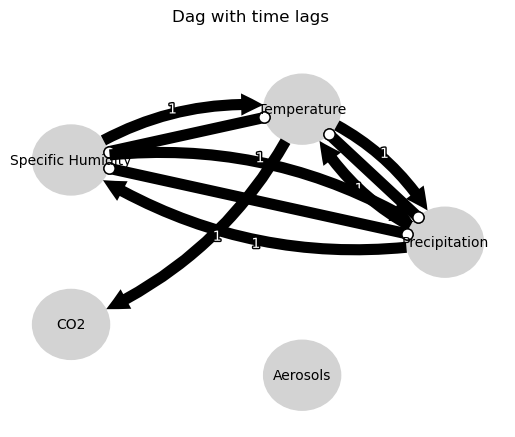

Negative precipitation values in event 61: 7


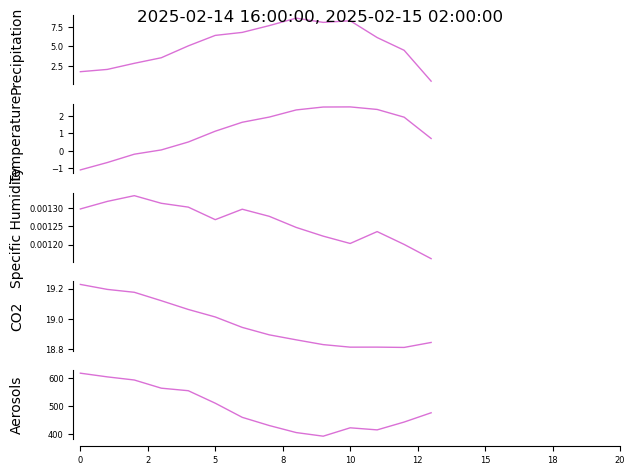


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


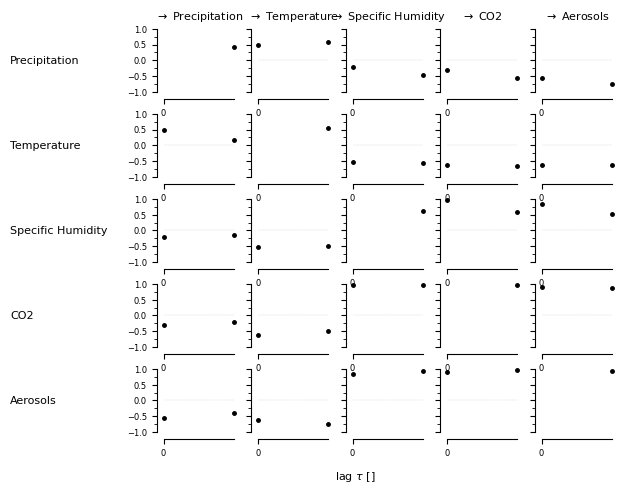

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (CO2 -1): max_pval = 0.00123, |min_val| =  0.839

    Variable C

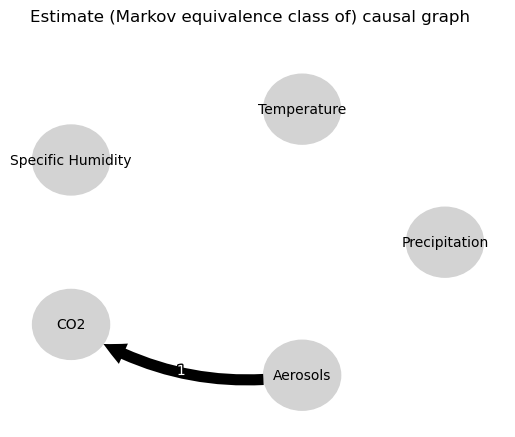

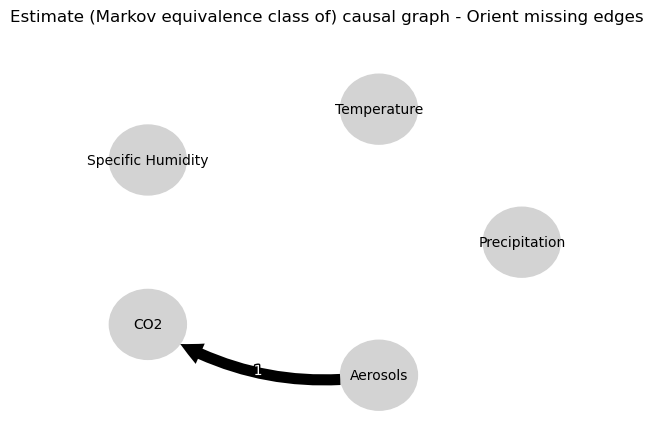

0.0
-0.03838135925563084
0.7261244092186655
-0.020542765016409333
-0.07860169926455862
-0.024786674469633934
-0.10018064420713434
-0.1792528413532262
-0.3269765982147764
-0.22629062325180918
0.7261244092186655
-0.02935929374027204
0.0
-0.06750065625548372
-0.4443088367868154
0.04277633677432645
-0.1003382957187937
-0.1329947883896851
-0.23536321092950377
-0.14654850818159326
-0.4443088367868154
0.08521769432042374
0.0
-0.12048714228107694
0.013564766761932795
-0.07065792002088819
-0.10462468811479668
-0.11678654476284518
-0.1003382957187937
0.0734373259640422
0.013564766761932795
0.08217187247617462
0.0
0.5710527916125093
0.7051492225989004
0.30162203680871486
-0.23536321092950377
0.016584627757762104
-0.10462468811479668
0.11646762981374432
0.7051492225989004
0.6556205271501777
0.0
0.4931304823309963


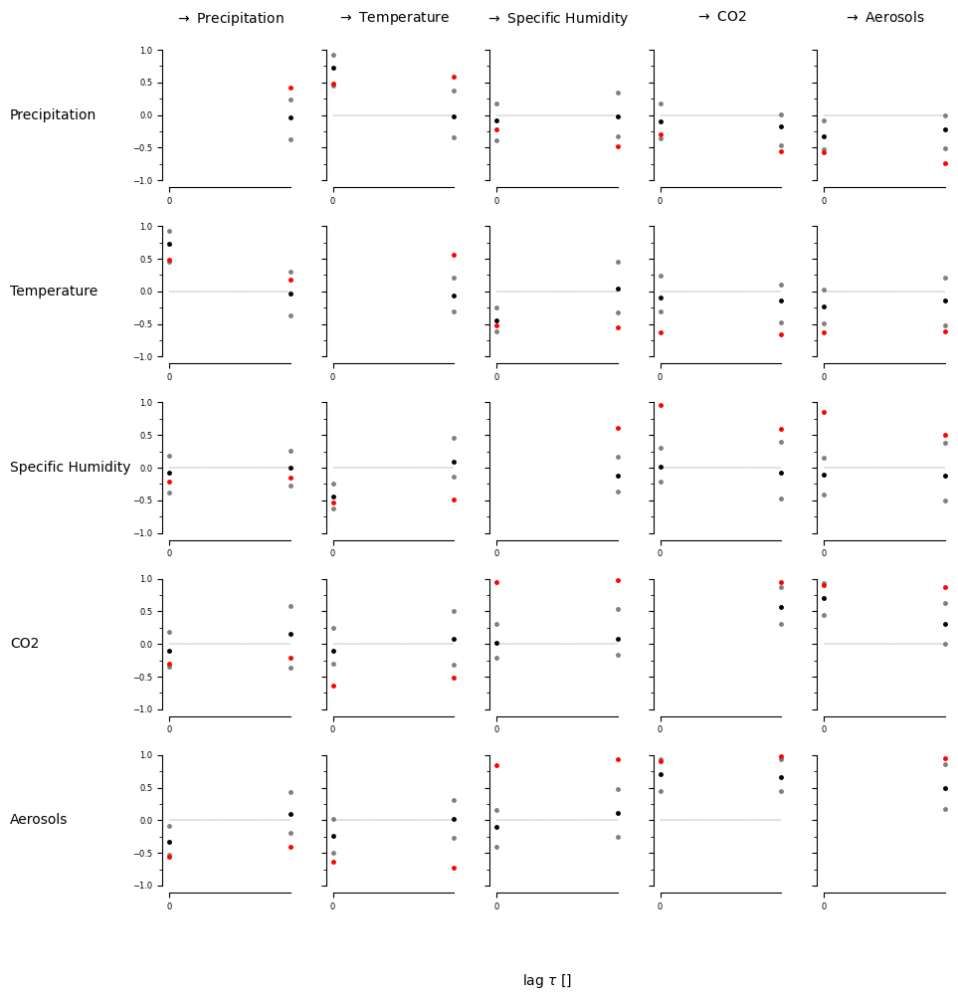

[[[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [ True False]]

 [[False False]
  [False False]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [False  True]
  [ True  True]
  [ True  True]
  [False  True]]]


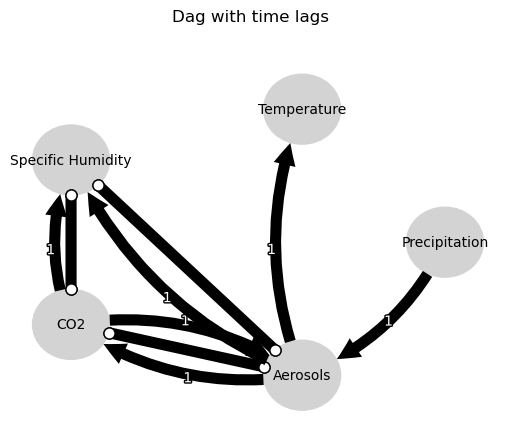

Negative precipitation values in event 62: 0


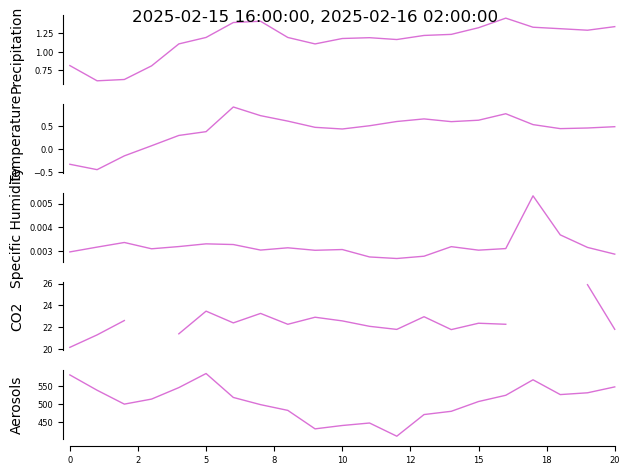


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


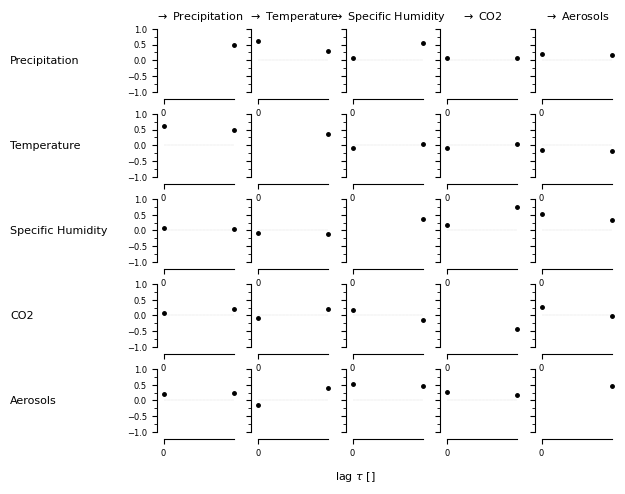

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Precipitation -1): max_pval = 0.01427, |min_val| =  0.552

    

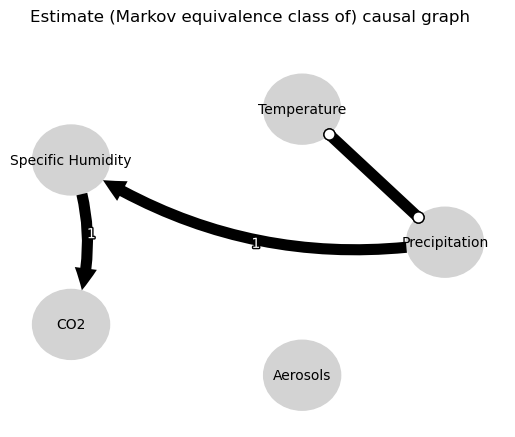

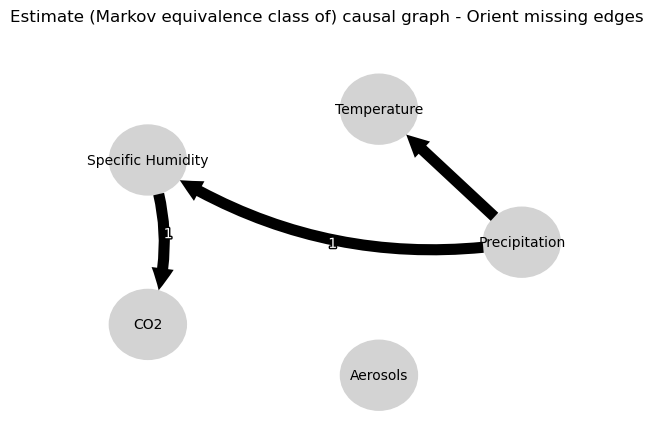

0.0
-0.04952493266757909
0.8148958296215966
-0.08414875210898581
-0.37648902050431243
0.3529278472433076
0.07984894874574434
-0.3036918537042283
0.09819901634204228
0.045770068776350634
0.8148958296215966
-0.05598746542790601
0.0
-0.08923039343913336
-0.3863042451239725
0.3409404760166671
0.13667426997611123
-0.3120456089634919
-0.15052649421768993
0.02684202395851639
-0.3863042451239725
0.09201823795305056
0.0
-0.2276894665685074
-0.2527477155136206
0.6332834202873907
0.40683253815115866
-0.016438960147452858
0.13667426997611123
-0.0068399329744167365
-0.2527477155136206
-0.00664954879966583
0.0
-0.19421148213424308
-0.03324827652170872
-0.029464383772445858
-0.15052649421768993
0.0708391996990073
0.40683253815115866
-0.09161694963005156
-0.03324827652170872
0.34368496343008187
0.0
-0.04440070983052916


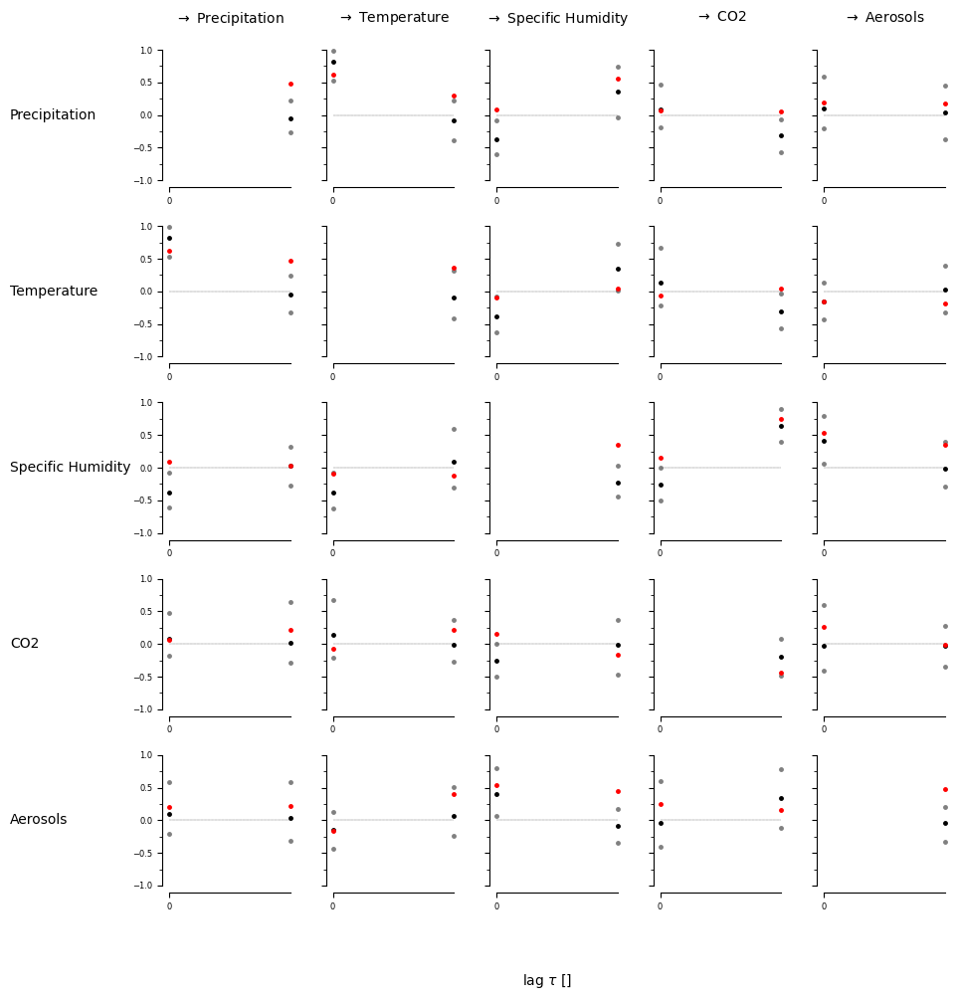

[[[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]

 [[ True False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


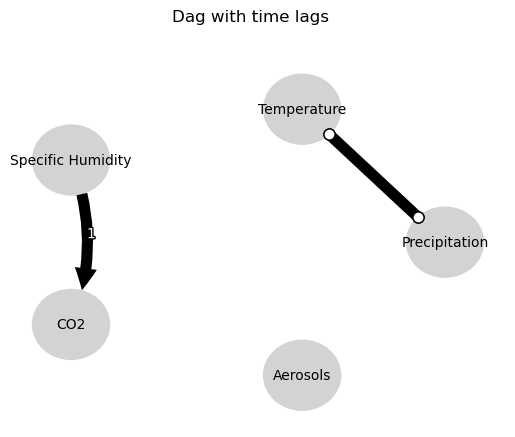

Negative precipitation values in event 63: 0


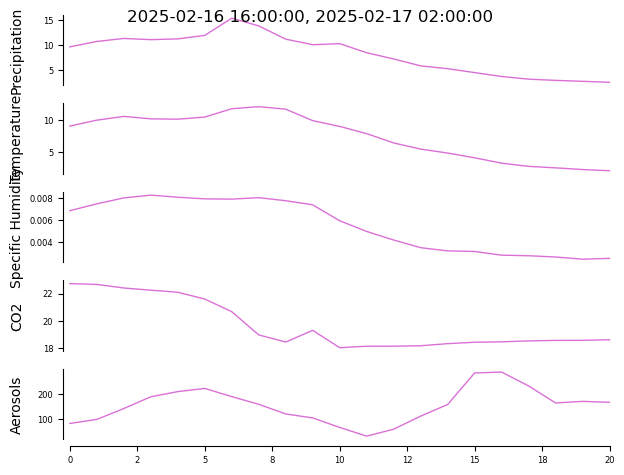


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


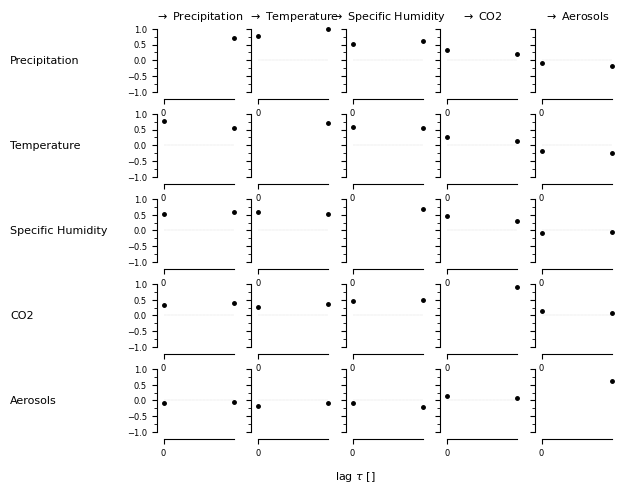

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.01365, |min_val| =  0.569

    Variable Temperature has 1 link(s):
        (Precipitation -1): max_pval = 0.00000, |min

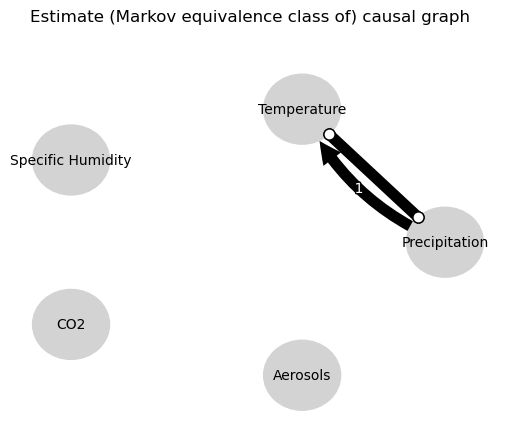

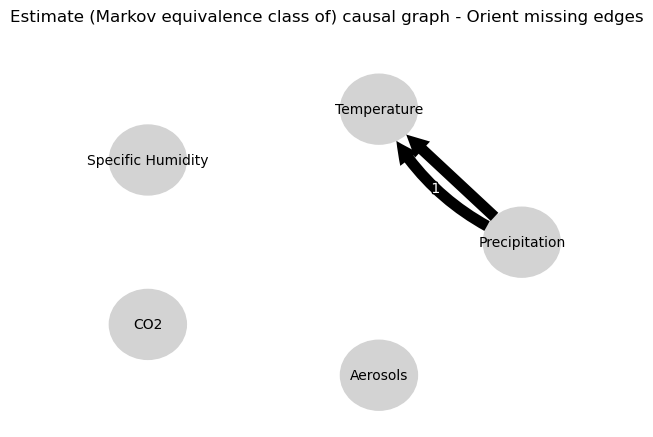

0.0
0.5706047401380605
0.7913817203350803
0.789444852792449
0.18581109759429557
0.11448585239290764
0.19322973102645594
-0.18699385811709907
0.002761005373800914
0.021849241016542183
0.7913817203350803
0.5114341062384832
0.0
0.6119839197560686
0.19103600832953432
0.10502815245555878
0.097962453667127
-0.17368613033597657
0.021339009502834235
0.04933199922464674
0.19103600832953432
0.14025300195300555
0.0
0.6163949853294762
0.1122211820680989
-0.2208633929541045
0.16277184031149344
0.03605291896104148
0.097962453667127
0.15336543210713213
0.1122211820680989
0.05665990873069768
0.0
-0.12175021491081517
0.08159447732430535
0.055883040028527654
0.021339009502834235
0.0003092416310780772
0.16277184031149344
0.020166270375045505
0.08159447732430535
-0.0672749552208794
0.0
0.4607033981082509


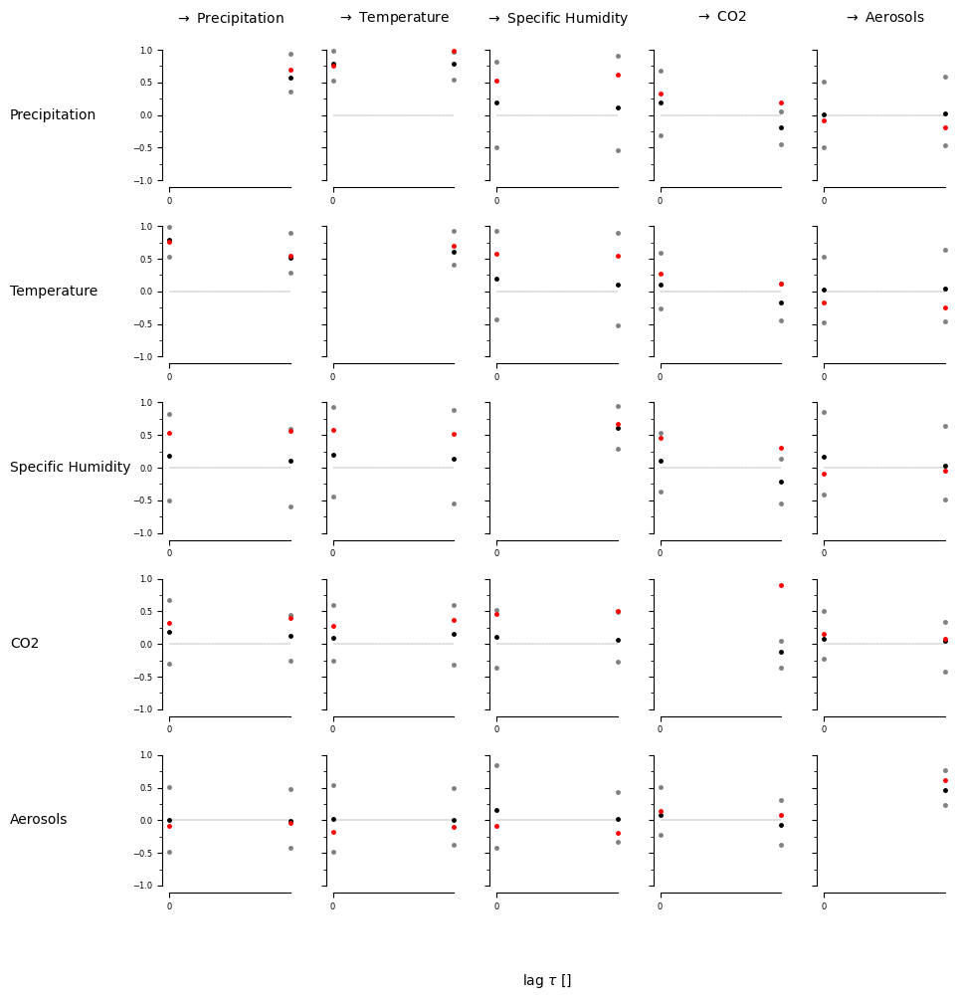

[[[False  True]
  [ True  True]
  [False  True]
  [False False]
  [False False]]

 [[ True False]
  [False  True]
  [ True False]
  [False False]
  [False False]]

 [[False False]
  [ True False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


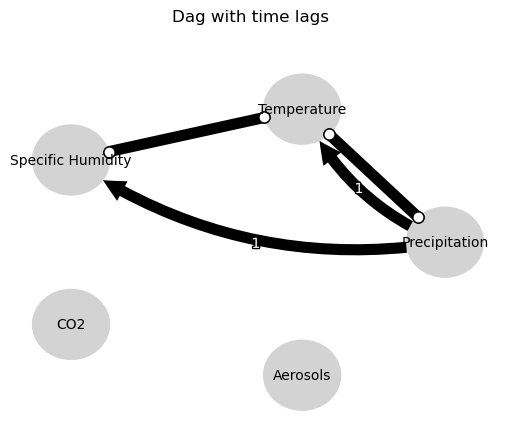

Negative precipitation values in event 64: 7


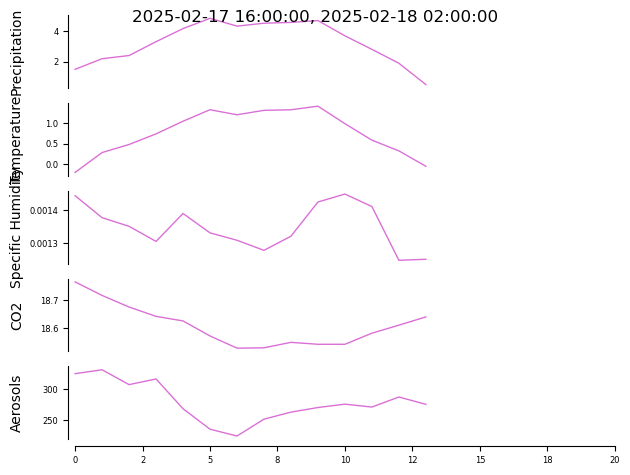


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


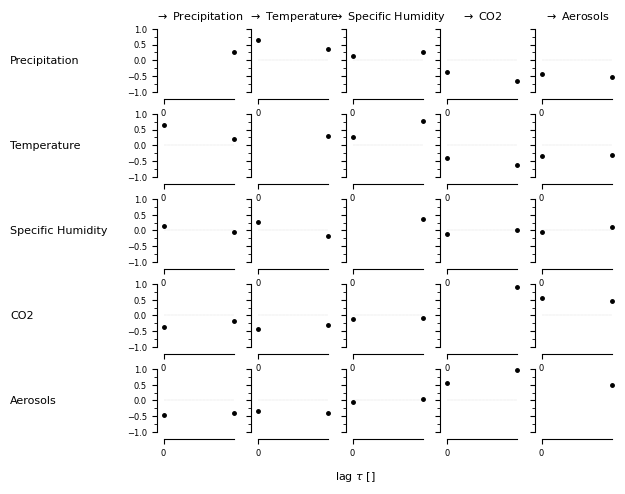

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Temperature -1): max_pval = 0.00267, |min_val| =  0.782

    Va

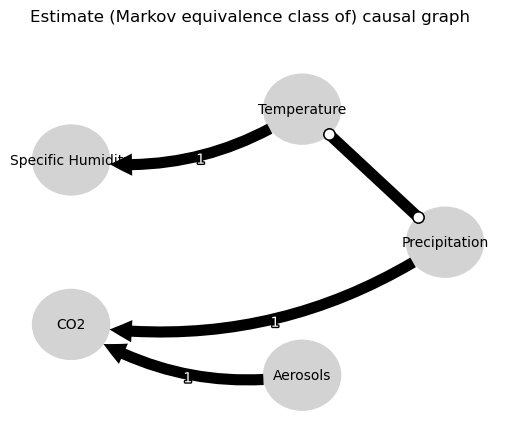

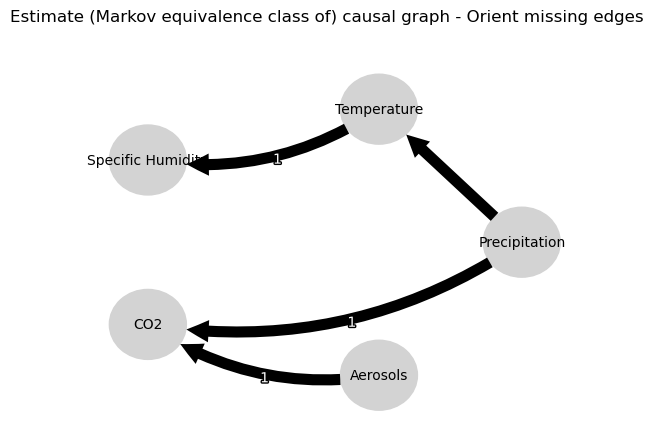

0.0
-0.05812911028284508
0.9542482718454124
-0.04520151669896902
0.10983085708804681
0.14670395243996107
0.0338497756100167
-0.7334789934816182
-0.42064132903075496
0.039713291146260966
0.9542482718454124
-0.03783258133403266
0.0
-0.03666444720324009
0.04446281513620482
0.16121205507368658
0.02390573915579833
-0.7473398831376152
-0.46832824113975147
0.027339751469977337
0.04446281513620482
-0.007401606291658684
0.0
-0.00936532446525067
-0.16797333919993224
0.10677300294965605
0.36452347842752264
0.0221167875512892
0.02390573915579833
0.04567106872400518
-0.16797333919993224
0.021676355017693712
0.0
-0.10033140031004374
-0.028373692277519687
0.023531804174706253
-0.46832824113975147
0.00354067099779756
0.36452347842752264
-0.1494719001922664
-0.028373692277519687
0.6897803550116096
0.0
-0.04576938815154766


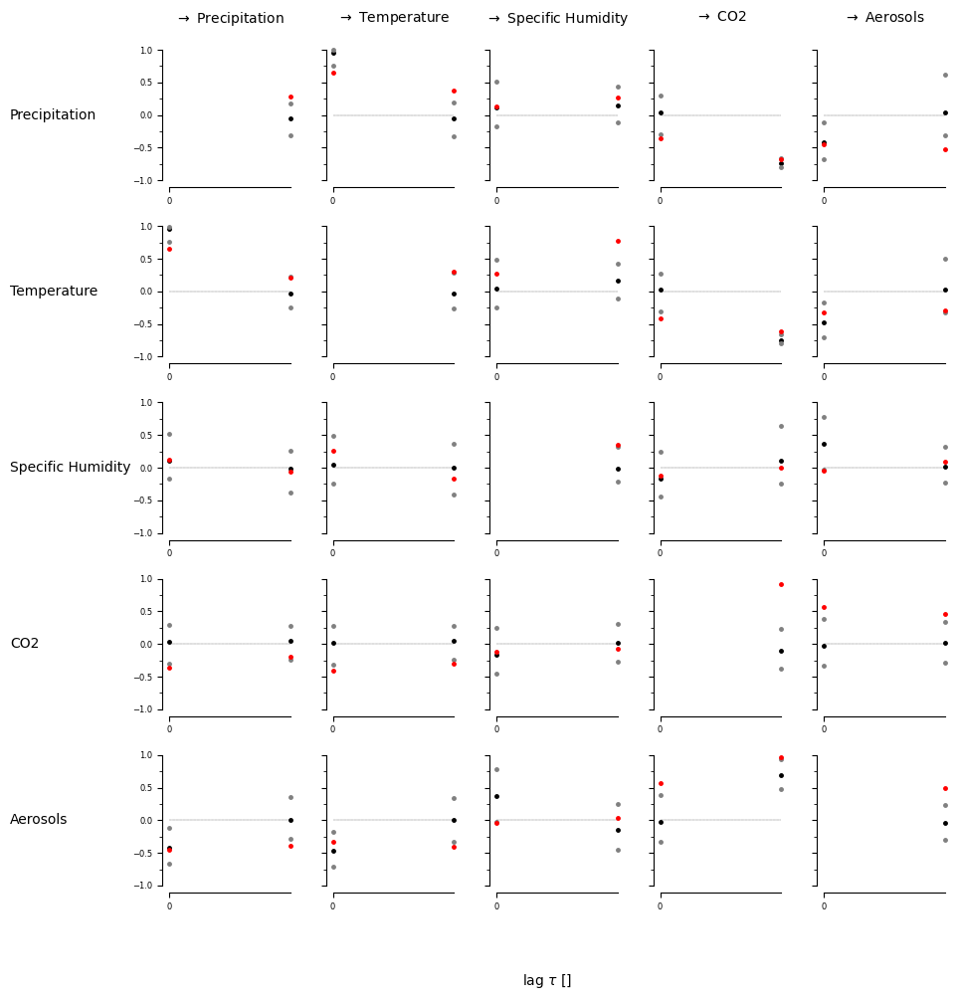

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]]


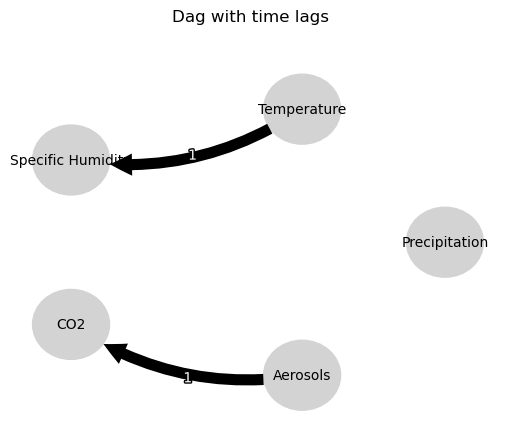

Negative precipitation values in event 65: 14


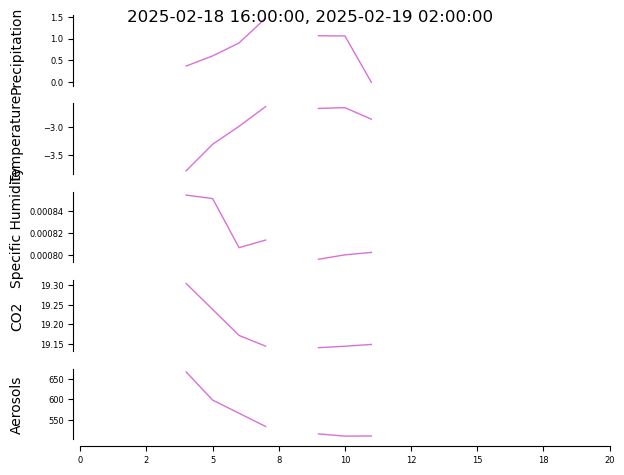


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


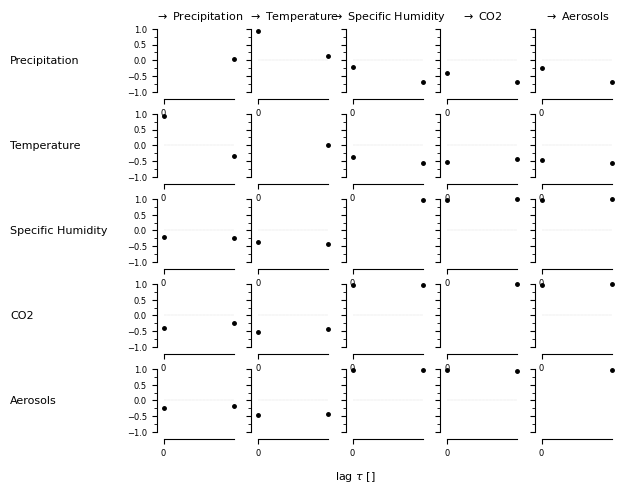

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 0 link(s):

    Variable Aerosols has 2 link(s):
 

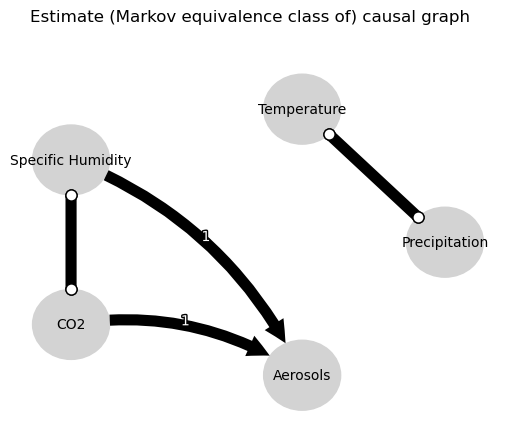

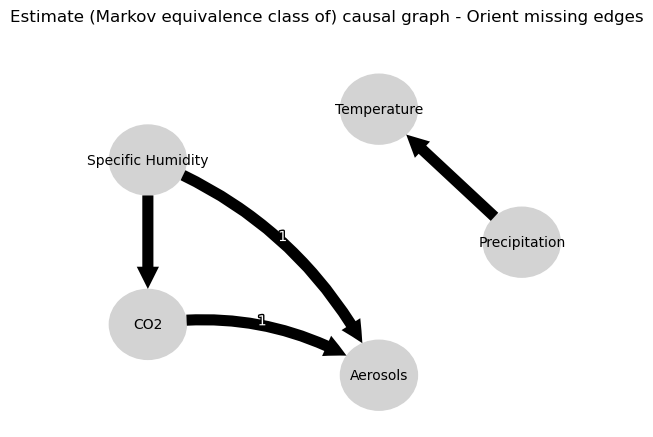

⚠️ Skipping event 66 ((Timestamp('2024-12-01 16:00:00'), Timestamp('2024-12-02 02:00:00')) → (Timestamp('2024-12-02 16:00:00'), Timestamp('2024-12-03 02:00:00'))) due to error: Less than 10 overlapping samples due to masking and/or missing values, cannot compute residual covariance!
Negative precipitation values in event 66: 17


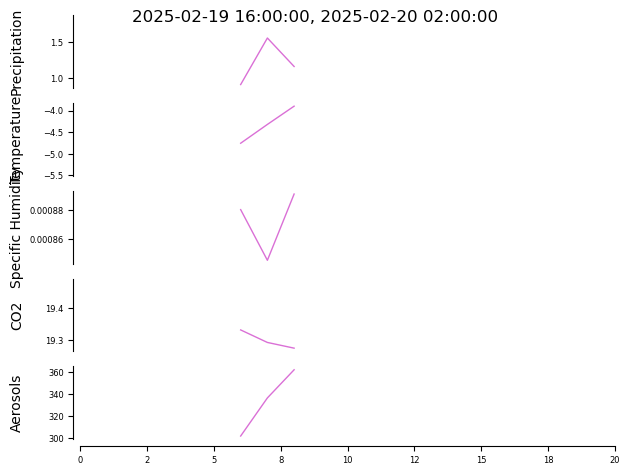


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


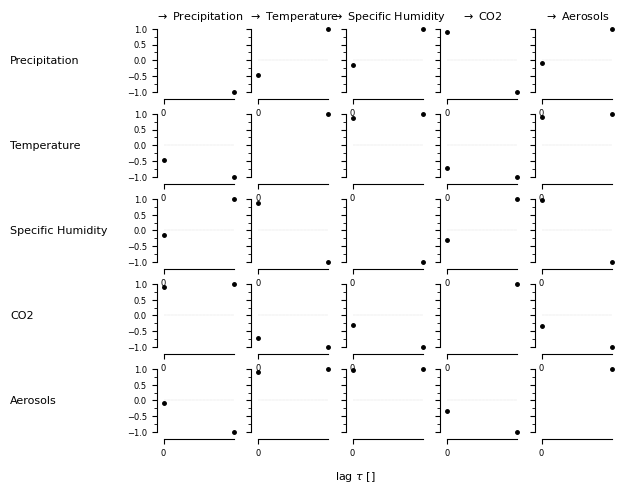

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 0 link(s):

    Variable Aerosols has 0 link(s):



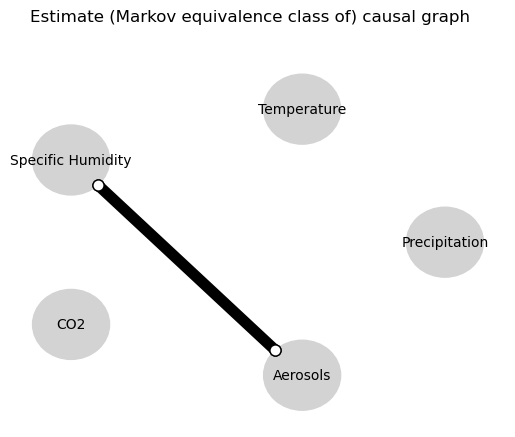

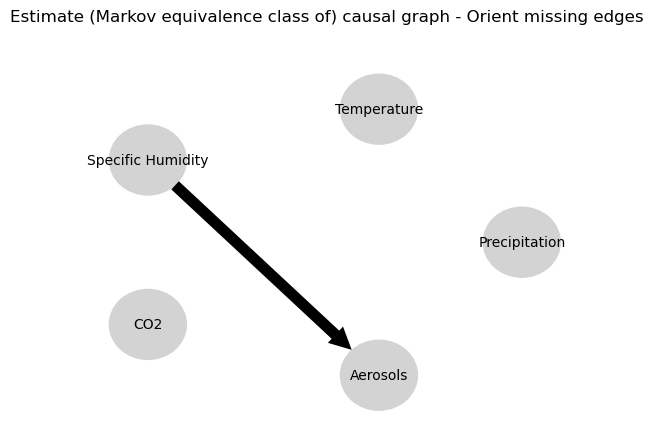

⚠️ Skipping event 67 ((Timestamp('2024-12-01 16:00:00'), Timestamp('2024-12-02 02:00:00')) → (Timestamp('2024-12-02 16:00:00'), Timestamp('2024-12-03 02:00:00'))) due to error: Less than 10 overlapping samples due to masking and/or missing values, cannot compute residual covariance!
Negative precipitation values in event 67: 21


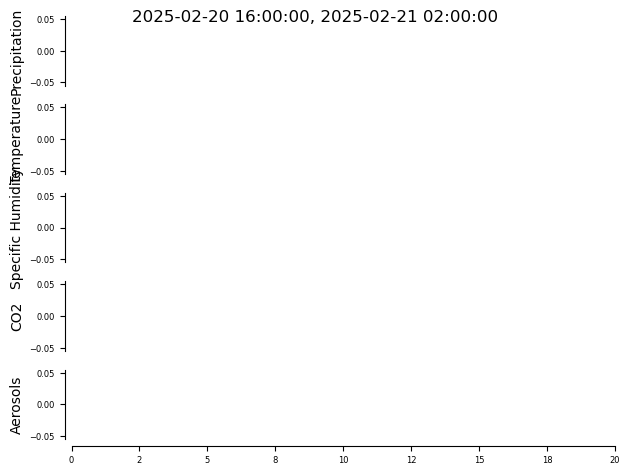


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1
⚠️ Skipping event 68 ((Timestamp('2024-12-01 16:00:00'), Timestamp('2024-12-02 02:00:00')) → (Timestamp('2024-12-02 16:00:00'), Timestamp('2024-12-03 02:00:00'))) due to error: No valid samples
Negative precipitation values in event 68: 8


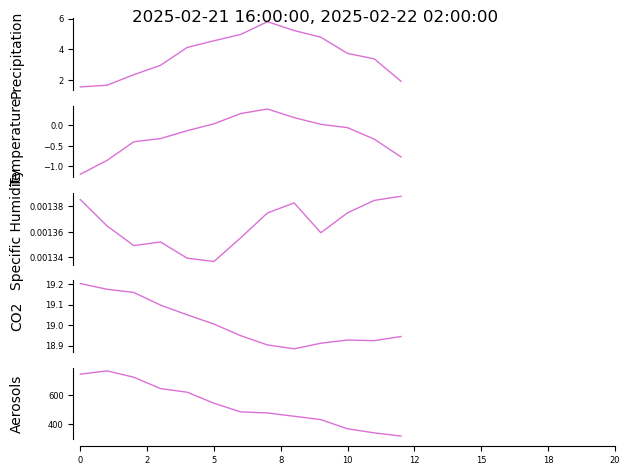


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


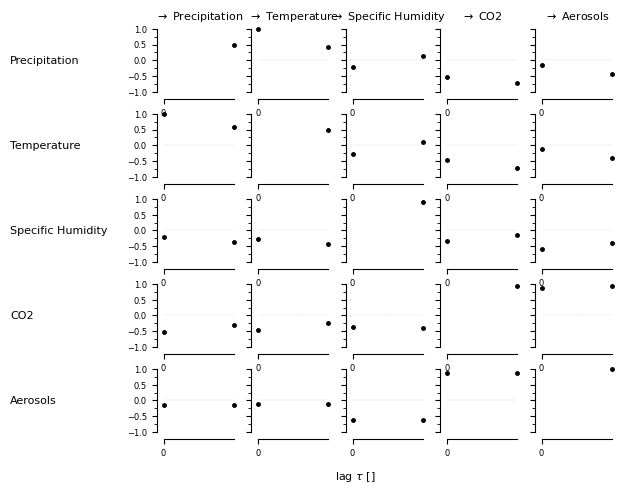

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00088, |min_val| =  0.876



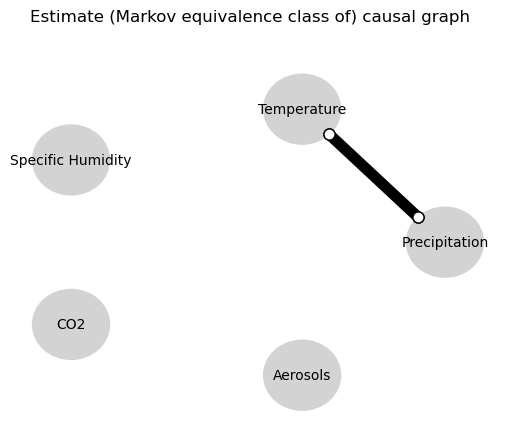

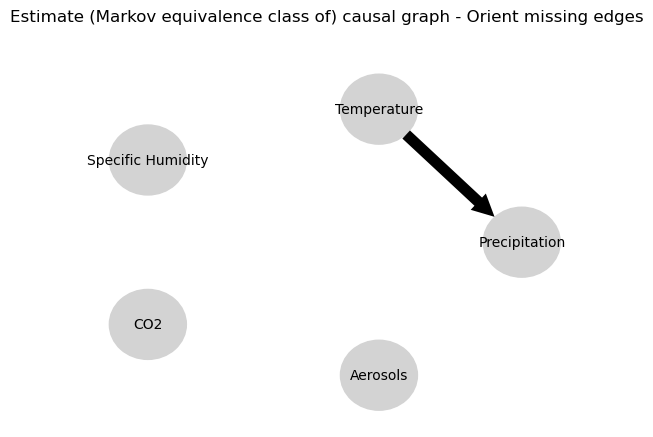

0.0
-0.04123874412971668
0.8960448494198666
-0.044653334883425
0.20432623269500938
0.104307591103379
-0.31005495962731033
-0.2096079995580638
-0.043168747860060815
-0.04006541191235278
0.8960448494198666
-0.02980424458561502
0.0
-0.04843875158575237
0.17886039391000932
0.08028584752798115
-0.32762487040562116
-0.2254404469636716
-0.11138201914706955
-0.10074894386763107
0.17886039391000932
-0.02875061129552662
0.0
0.36058019647339185
-0.2803879642606828
-0.15701740660767036
-0.048436867387608565
-0.047385130855481454
-0.32762487040562116
0.1464292502114164
-0.2803879642606828
-0.13606804635573985
0.0
0.4911168427252039
0.1667587469771851
0.1567994845223853
-0.11138201914706955
0.1126024324462985
-0.048436867387608565
-0.04560039166708287
0.1667587469771851
0.06659758327218032
0.0
0.5531278470242448


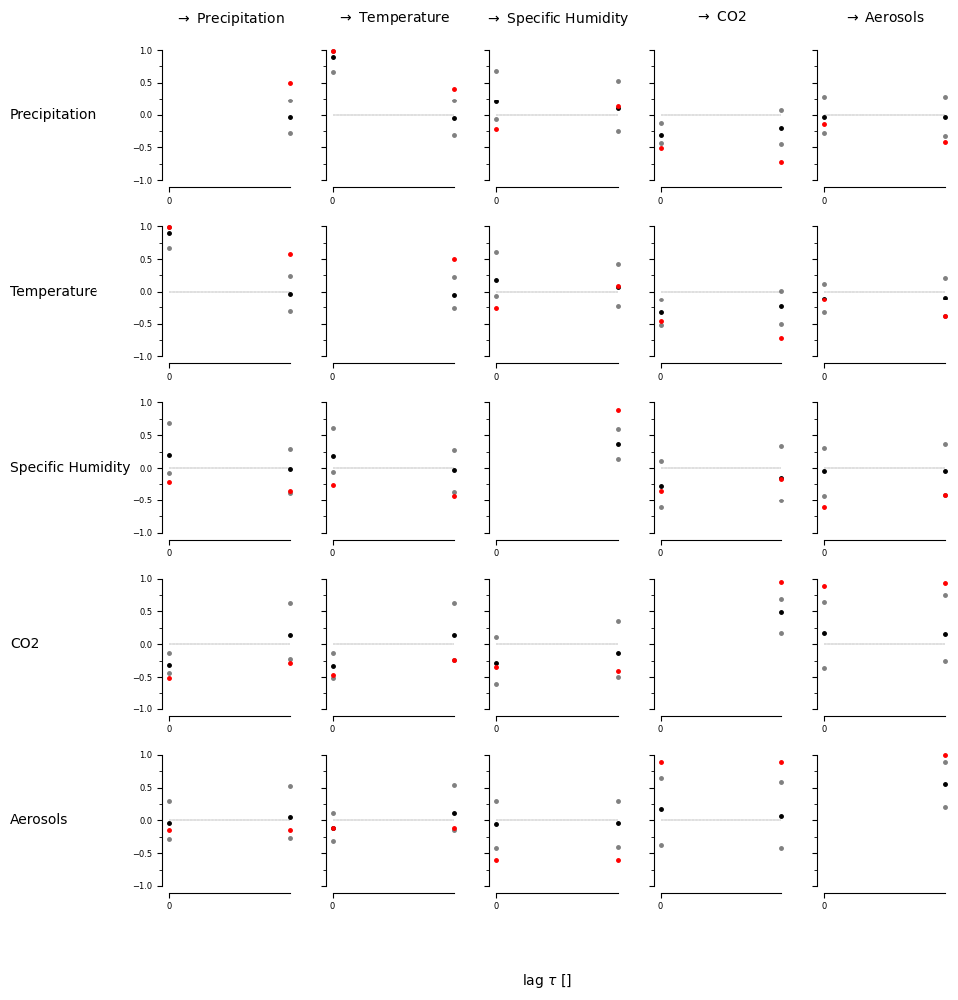

[[[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]

 [[ True False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False  True]]]


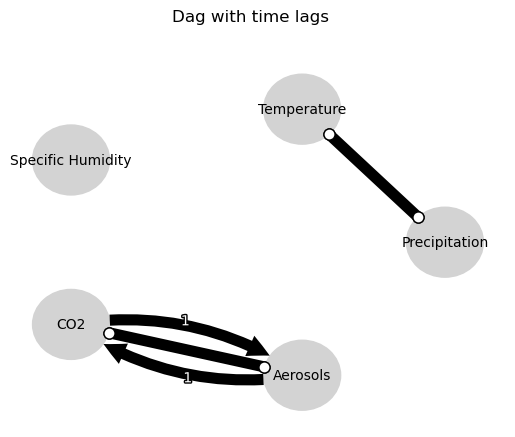

Negative precipitation values in event 69: 0


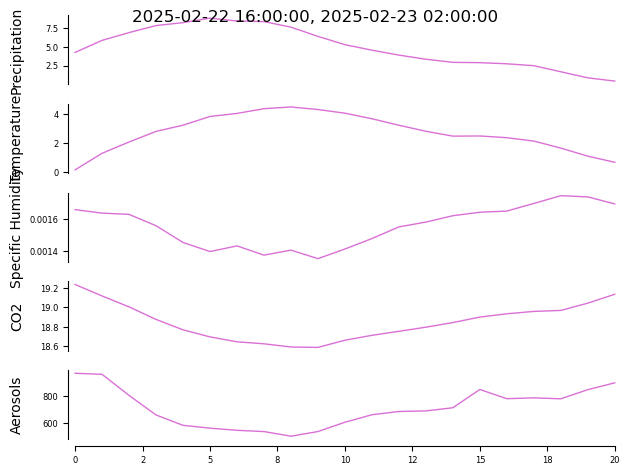


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


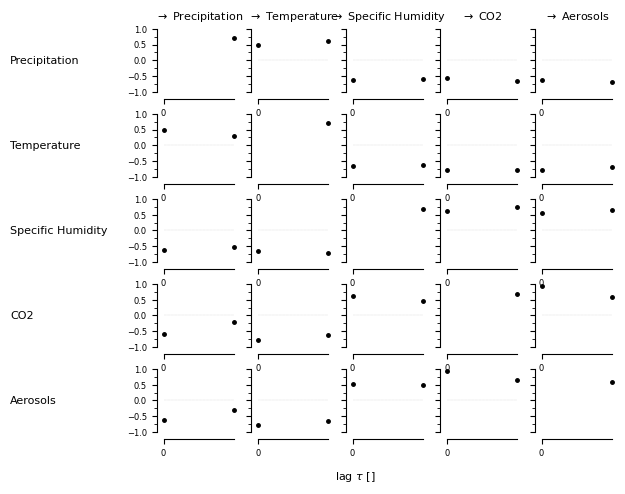

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.01732, |min_val| =  0.553

    Variable Temperature has 2 link(s):
        (Specific Humidity -1): max_pval = 0.03930, 

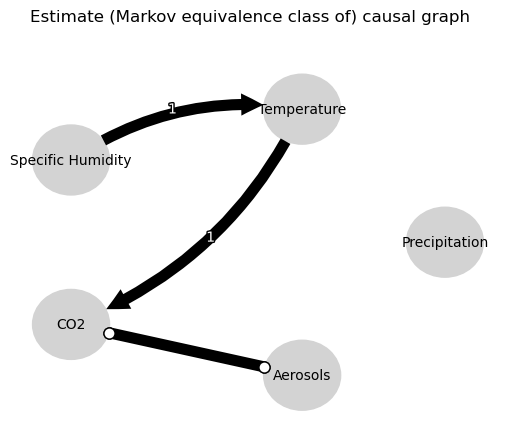

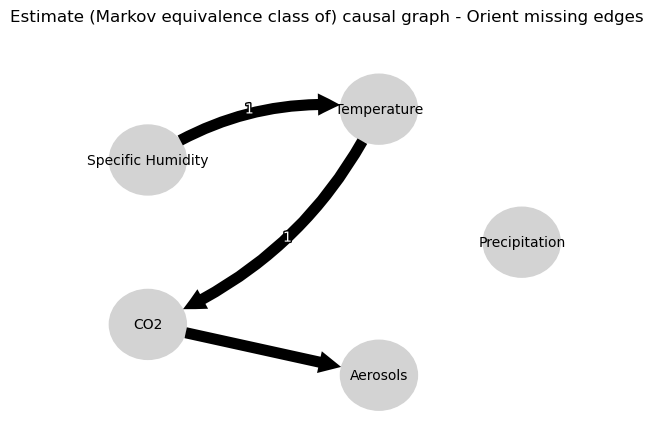

0.0
0.637732088076215
-0.02693116582755257
-0.0860663481584384
0.036767364290219436
-0.0747213382919694
0.0051155989702668945
0.11462810907683553
0.006125190772445618
0.15555560411468808
-0.02693116582755257
-0.04584839842597956
0.0
-0.06420364436636077
0.00902369279090945
0.10944356389196559
-0.005564164081033983
-0.751230658414081
-0.02872530657440735
-0.6900112059189223
0.00902369279090945
-0.7620705463793762
0.0
-0.06133932021261943
-0.005539488766913476
-0.039699682415701674
-0.002782478633229379
-0.054646448755511605
-0.005564164081033983
-0.02967811371084217
-0.005539488766913476
-0.0662418907136013
0.0
0.020244734789511682
0.9196746951795723
-0.020251643220661884
-0.02872530657440735
-0.02341593297305521
-0.002782478633229379
-0.041710659382345076
0.9196746951795723
0.03541840811572824
0.0
-0.010927275251576862


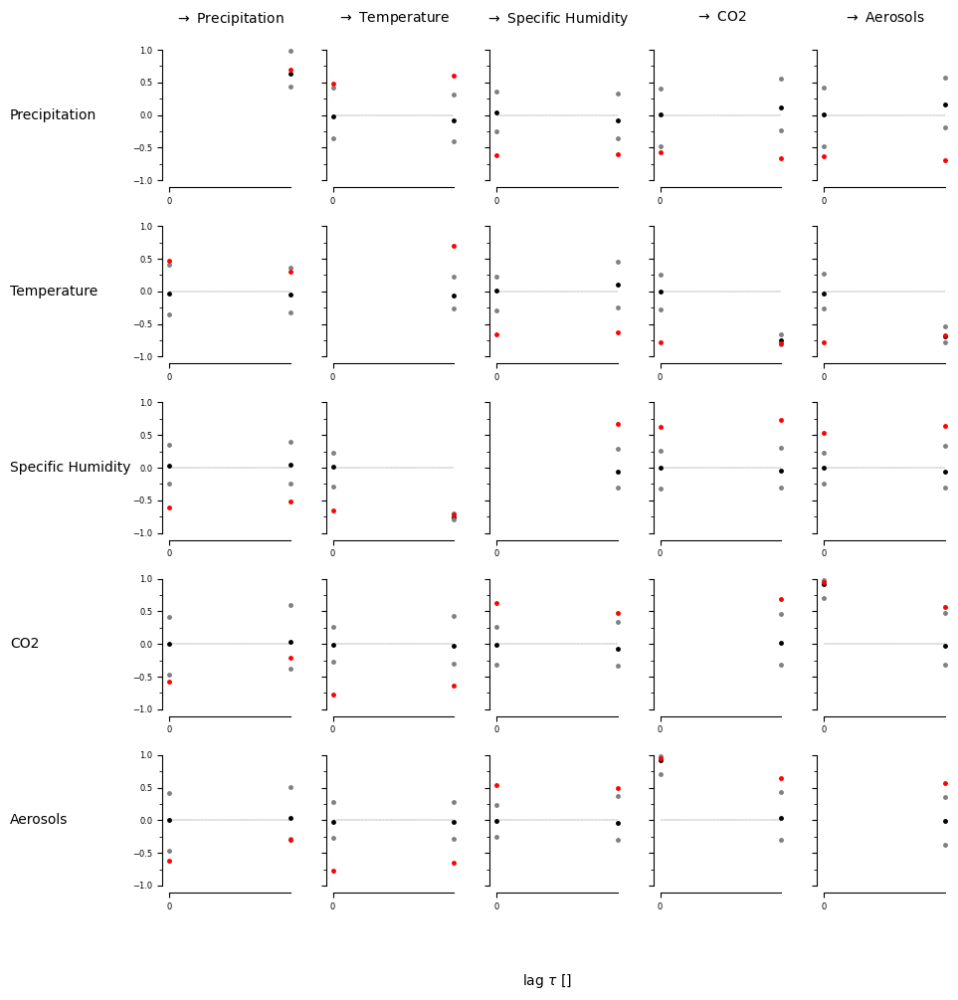

[[[False  True]
  [False  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [False  True]
  [ True  True]
  [ True  True]
  [ True  True]]

 [[ True False]
  [ True  True]
  [False  True]
  [ True  True]
  [False  True]]

 [[False False]
  [ True  True]
  [ True False]
  [False  True]
  [ True False]]

 [[ True False]
  [ True  True]
  [False False]
  [ True  True]
  [False False]]]


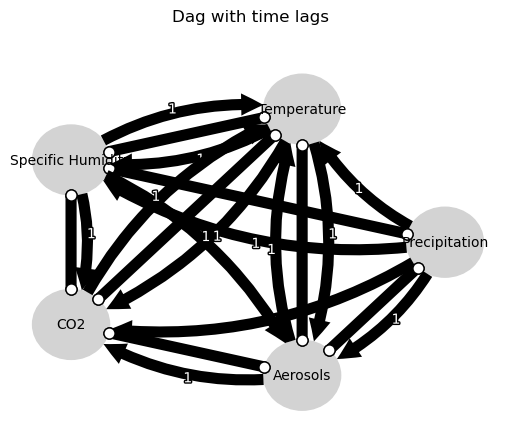

Negative precipitation values in event 70: 0


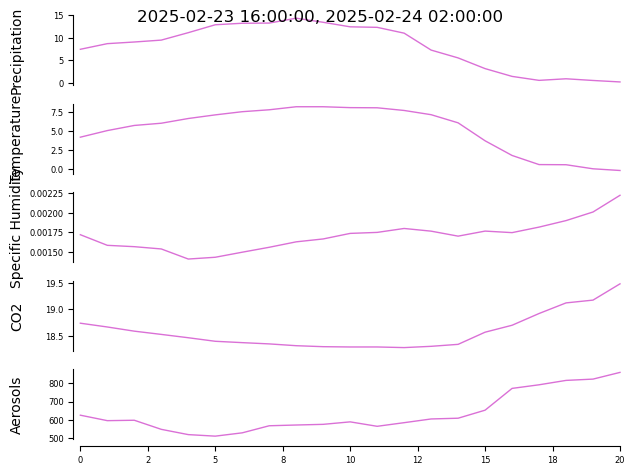


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


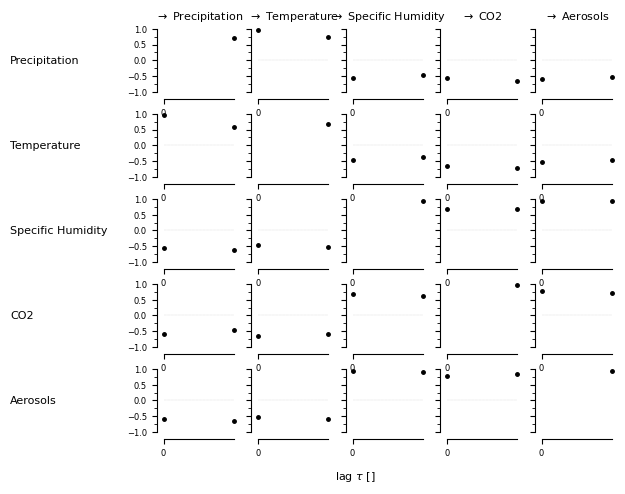

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.02816, |min_val| =  0.517

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
     

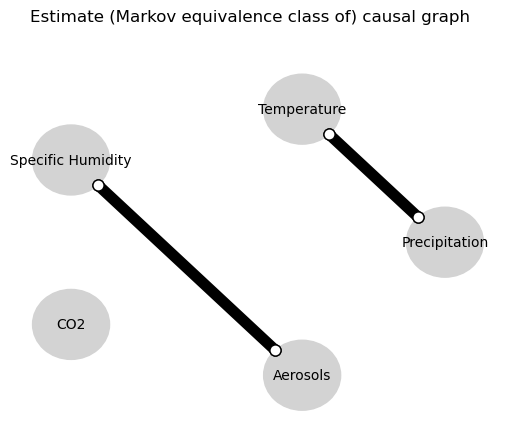

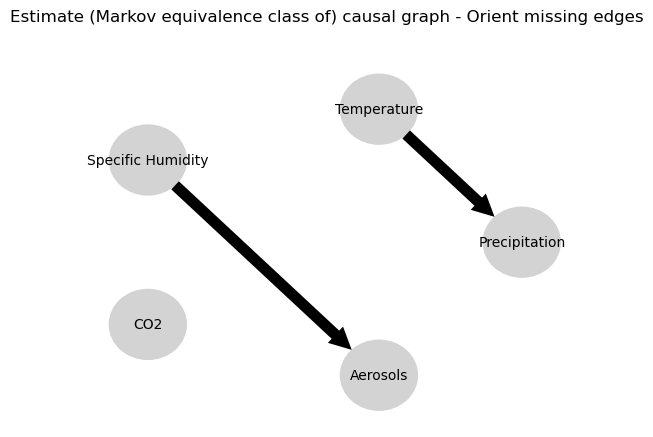

0.0
-0.026194294862254344
0.878642427818145
-0.054772637219242165
-0.5297676016481201
0.04045676710541934
0.09571715640419409
0.02340075151977457
-0.7189408274481217
0.03033194026964776
0.878642427818145
-0.0160852505213098
0.0
-0.058510035756702675
-0.5103657438699181
0.03735341179840337
0.12187151076567465
0.05381014432686729
-0.7351392414441956
0.031092926162120137
-0.5103657438699181
0.03627638721190862
0.0
-0.08923968548888929
-0.02664648753728819
-0.02992240122383104
0.7800678575976904
-0.09132128758397946
0.12187151076567465
0.1593868529517882
-0.02664648753728819
-0.05139405276809505
0.0
0.9517408411115361
-0.09367334764952231
-0.12388671977414957
-0.7351392414441956
0.04311152825319006
0.7800678575976904
-0.0644014171291034
-0.09367334764952231
-0.04432271105008298
0.0
-0.06101459810238975


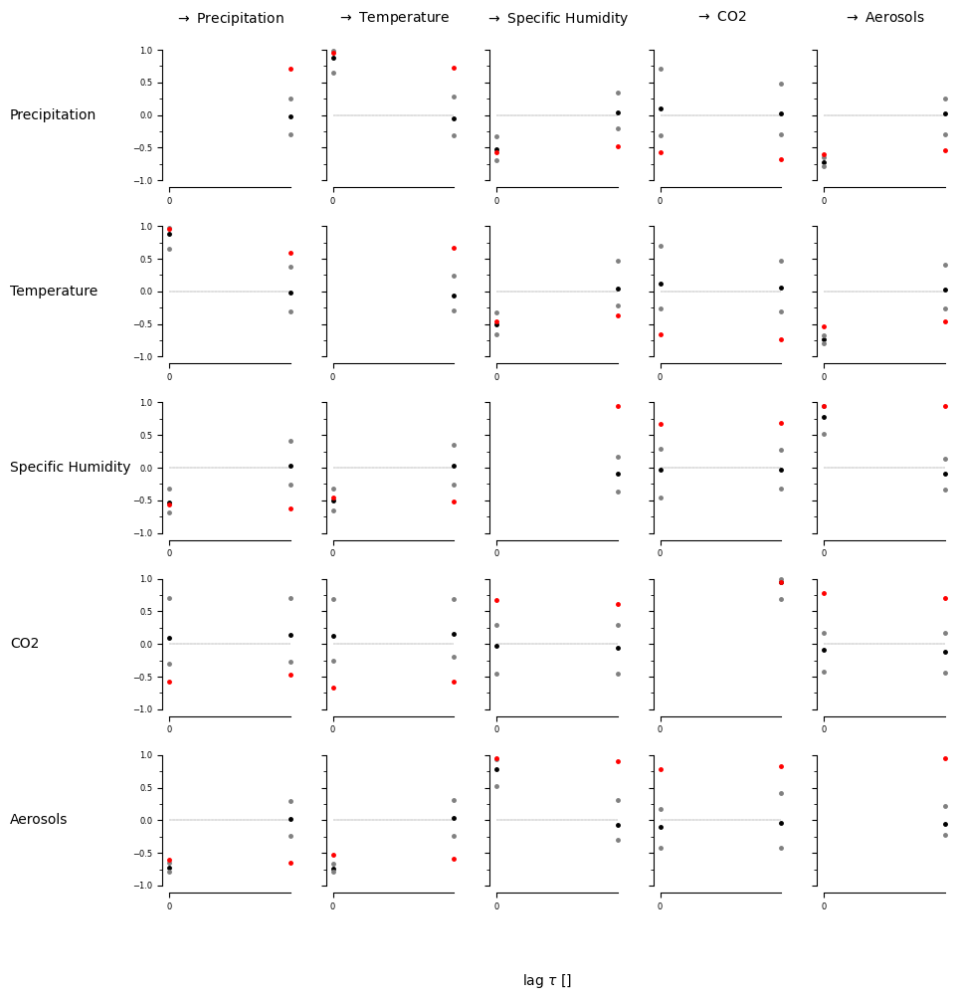

[[[False  True]
  [ True  True]
  [False False]
  [ True  True]
  [ True False]]

 [[ True  True]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False  True]
  [False False]
  [False  True]
  [ True  True]
  [ True  True]]

 [[ True False]
  [ True False]
  [ True  True]
  [False  True]
  [ True  True]]

 [[ True  True]
  [False  True]
  [ True  True]
  [ True  True]
  [False  True]]]


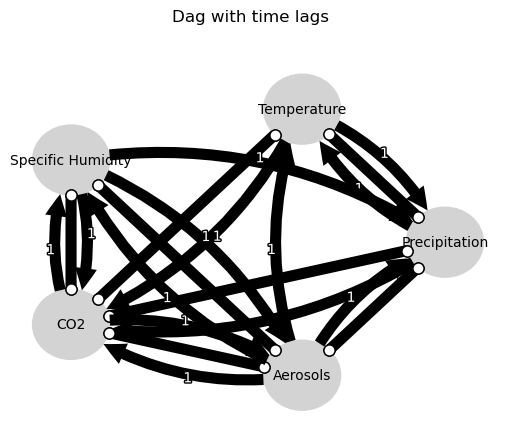

Negative precipitation values in event 71: 0


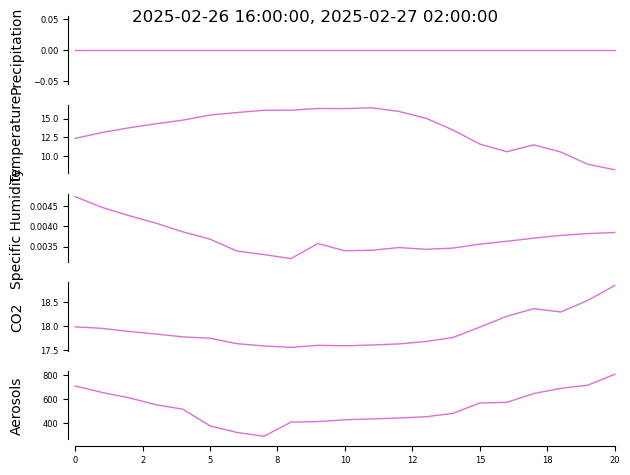


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


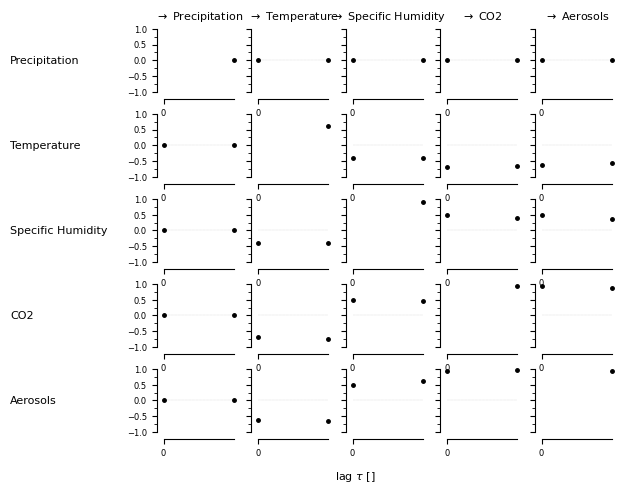

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.03651, |min_val| =  0.496

    Variable Specific Humidity has 1 link(s):
        (Specif

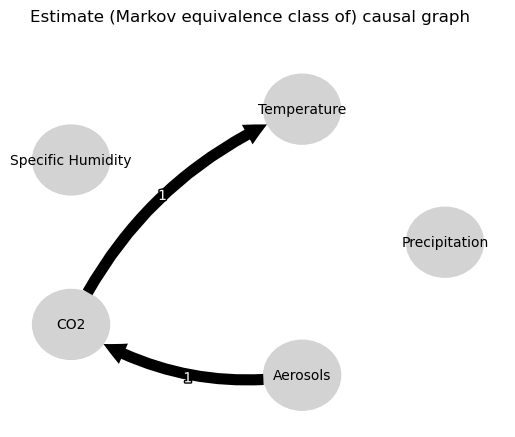

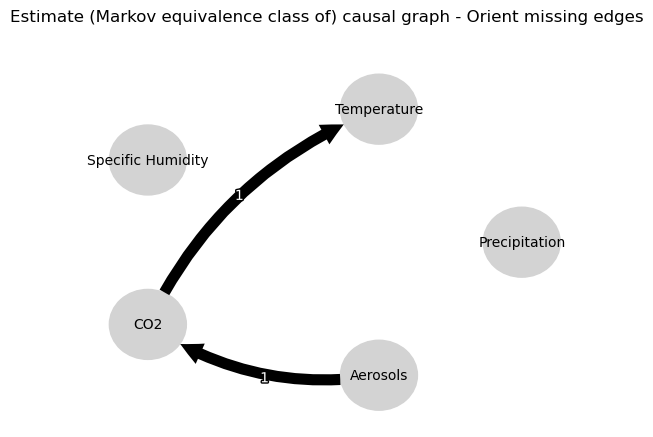

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.8592530684139231
0.12501122507137938
0.18426102627325322
-0.8017838662280671
-0.7783629595762587
0.031097471605359025
0.035961118944344075
0.12501122507137938
0.11580182711216208
0.0
0.40786731406107635
-0.09438917000399462
-0.12900443930037236
0.21027439921678157
0.17214768644039455
-0.8017838662280671
-0.7699134605133569
-0.09438917000399462
-0.11828270386420921
0.0
0.9731934386232263
0.01649140890834531
1.9738894744463405e-05
0.031097471605359025
0.04116728769289544
0.21027439921678157
0.07880230293466935
0.01649140890834531
0.011411844205145176
0.0
0.5367885362422125


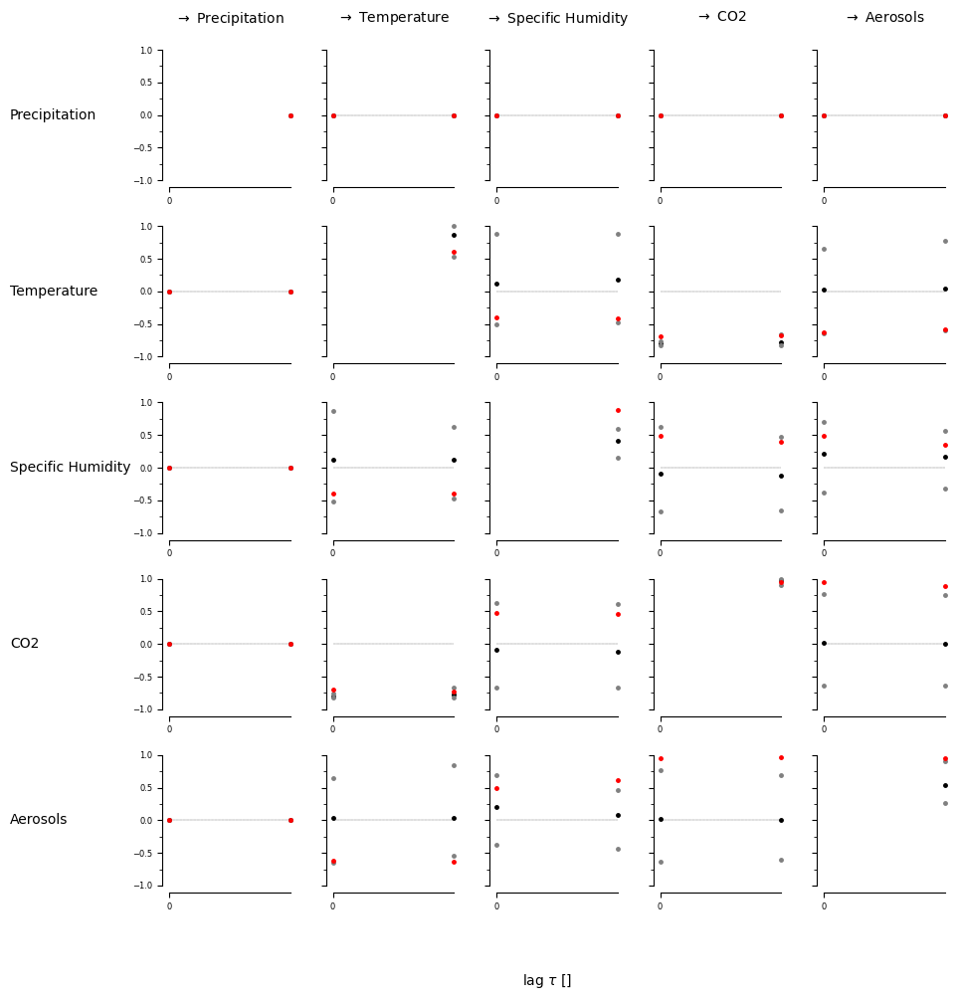

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False  True]
  [ True  True]
  [False  True]]]


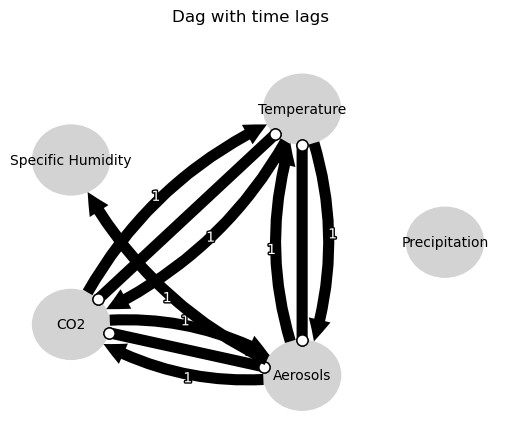

Negative precipitation values in event 72: 0


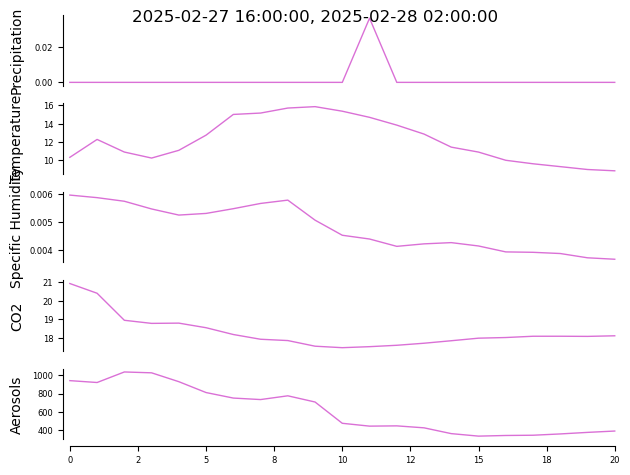


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


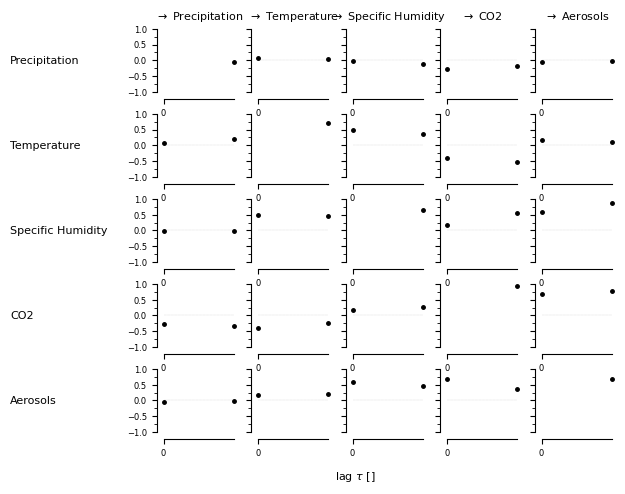

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00076, |min_val| =  0.704

    Variable Specific Humidity has 1 link(s):
       

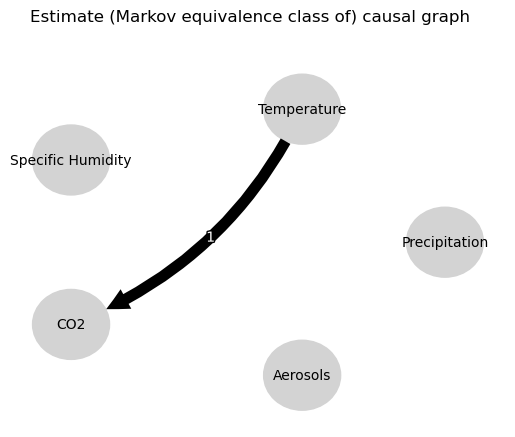

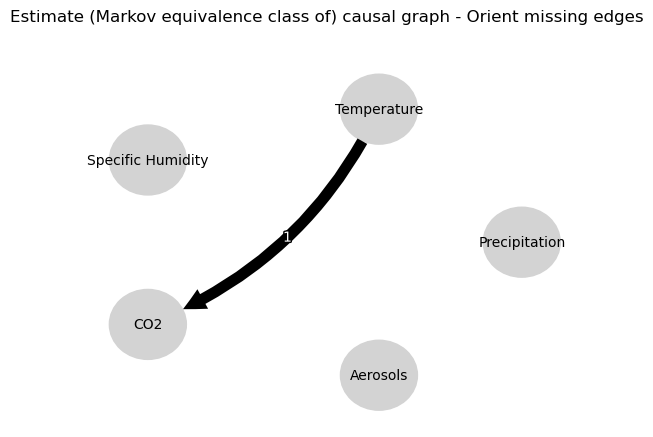

0.0
-0.09450196231876487
-0.038978074032593936
-0.012056623763652229
-0.05141582687589454
0.04544898749778213
-0.01595865033940822
0.03519657160274477
-0.09323094626521282
0.05485102857386151
-0.038978074032593936
0.03897752914710737
0.0
0.5400913993251195
0.20131181346598107
-0.14316551582719006
-0.10434468786073188
-0.34922831300579715
0.17961990097713765
-0.10012864652995139
0.20131181346598107
0.1732601281219551
0.0
-0.06270549851329199
0.1767891494283006
-0.015419008636645736
0.8475788581949311
-0.06571466688448452
-0.10434468786073188
-0.09249639743631875
0.1767891494283006
0.01451350865878347
0.0
0.4346800195448448
0.1170680414105399
0.010969077549544891
0.17961990097713765
0.17046154413119594
0.8475788581949311
-0.033757785569524204
0.1170680414105399
-0.025313022401593055
0.0
-0.045829378279399216


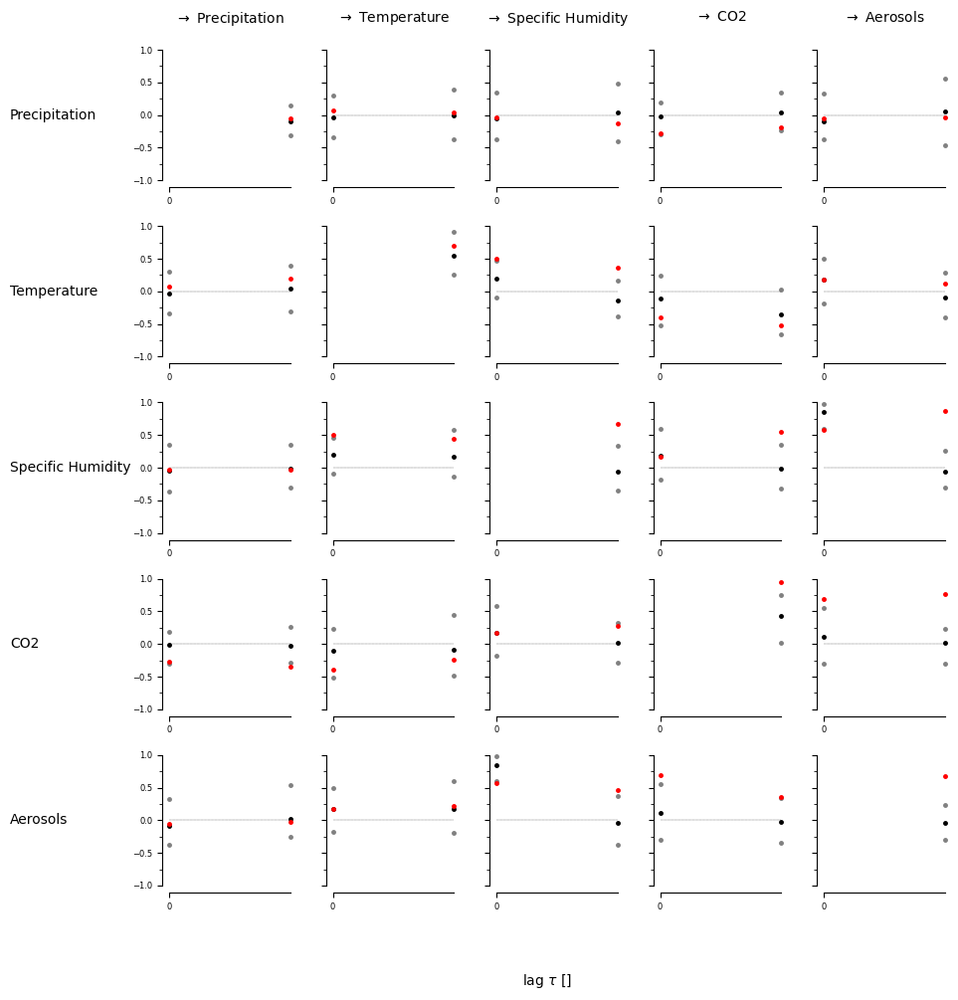

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False  True]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False  True]]]


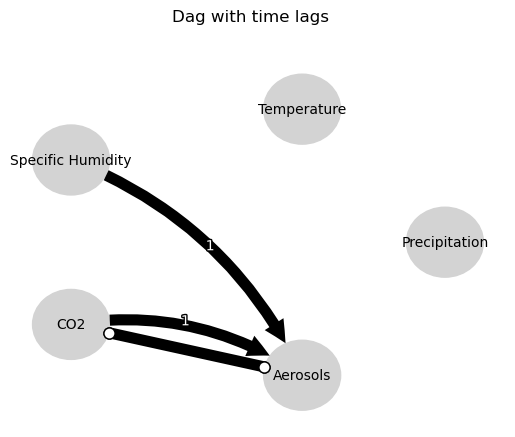

Negative precipitation values in event 73: 0


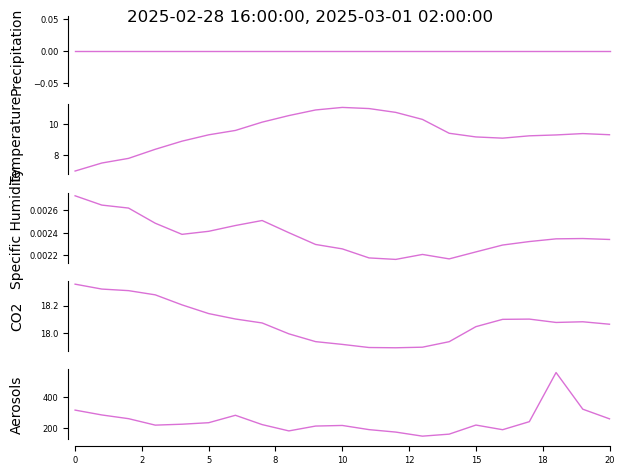


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


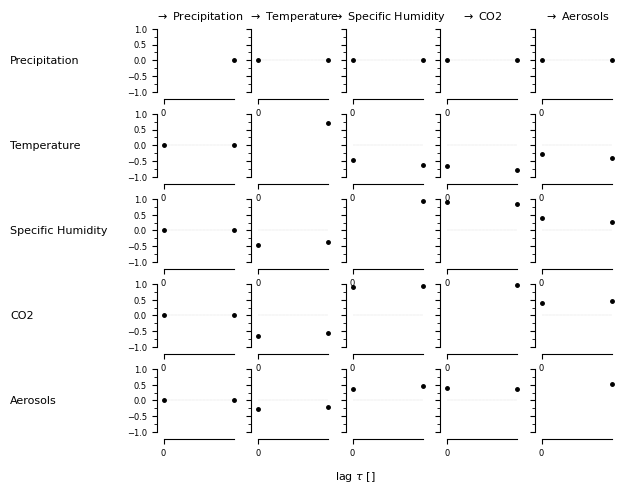

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.02579, |min_val| =  0.523

    Variable Specific Humidity has 1 link(s):
       

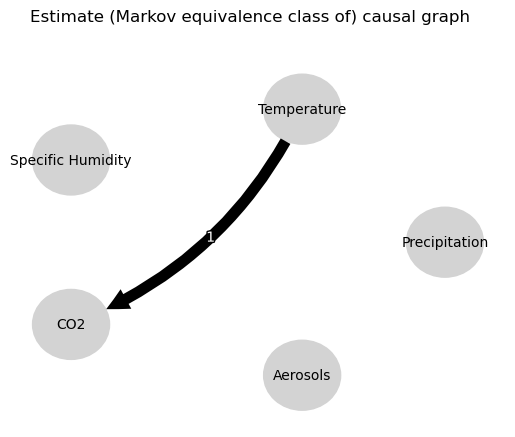

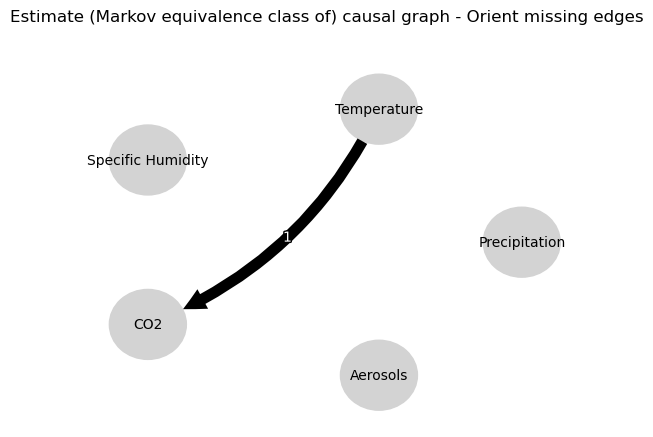

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.44070954097775944
0.193954321663558
-0.0774008286472264
-0.32968526748454335
-0.7328571181096781
0.01769231082307481
0.028887736811446636
0.193954321663558
0.09690553977375313
0.0
-0.057537415770927886
0.09494662716508138
-0.1470208791837366
0.08704180146142103
-0.026362615330893034
-0.32968526748454335
-0.17479273482110402
0.09494662716508138
0.06829936983540028
0.0
0.41305913612511974
-0.05787429980229593
-0.0679213985980673
0.01769231082307481
-0.0020981877174405805
0.08704180146142103
-0.0537880411803664
-0.05787429980229593
0.01059238194836734
0.0
0.22494471032234267


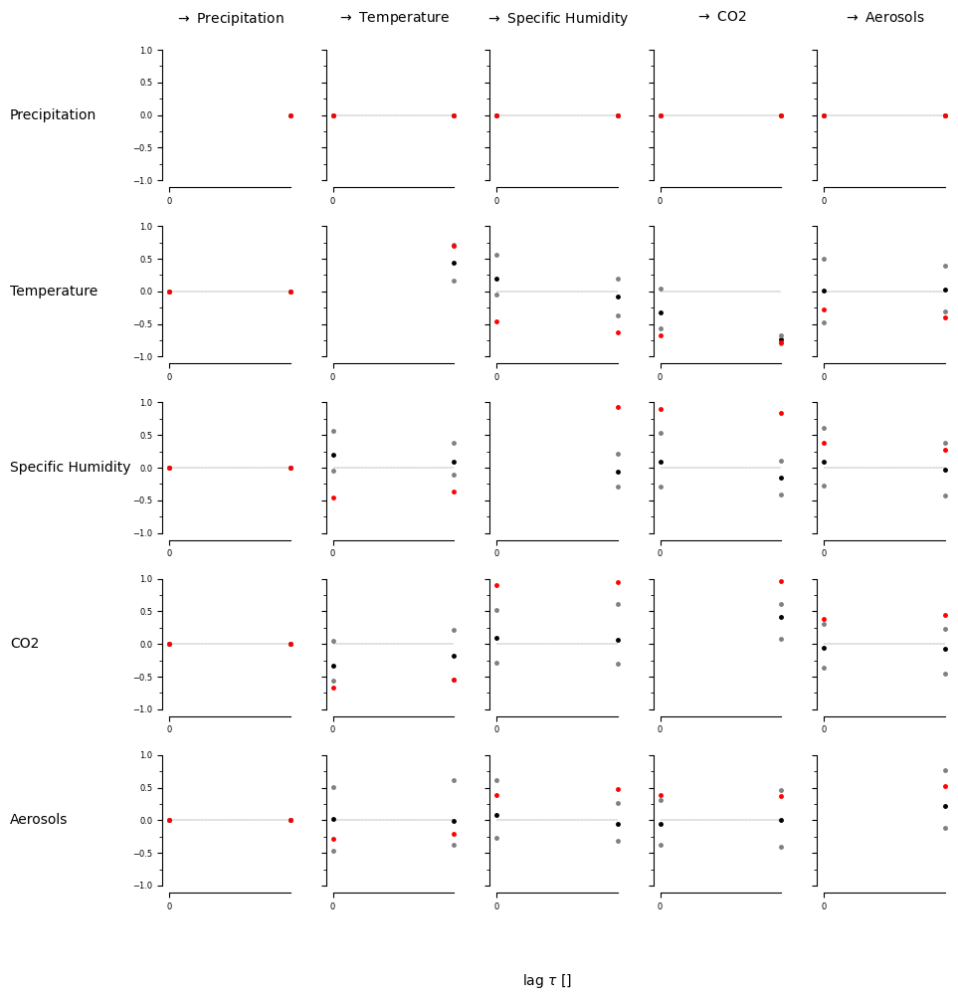

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True False]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


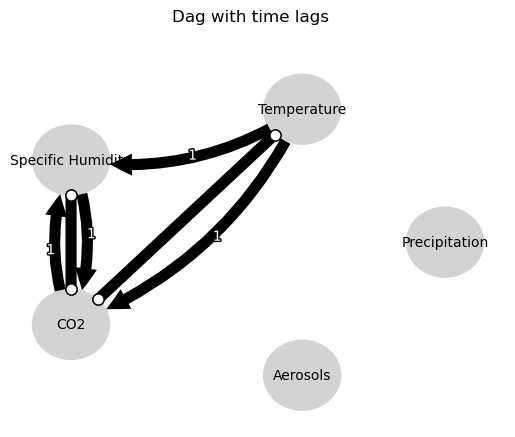

Negative precipitation values in event 74: 0


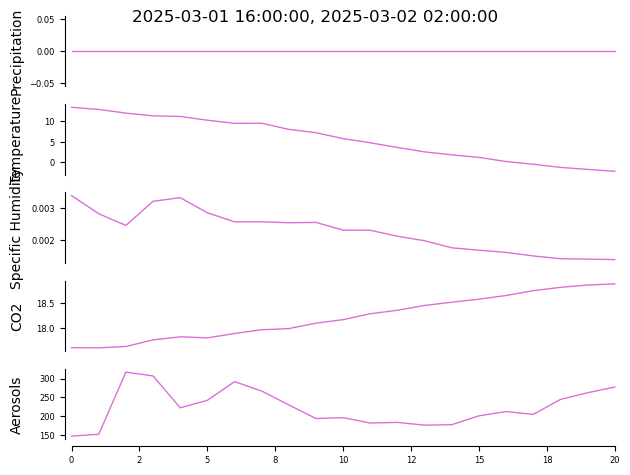


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


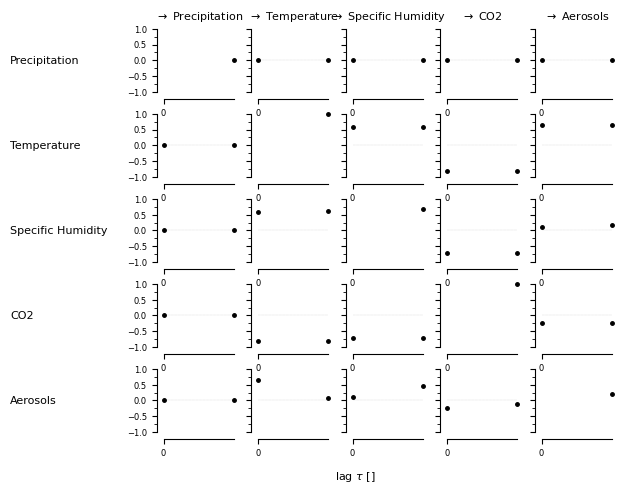

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00000, |min_val| =  0.992

    Variable Specific Humidity has 2 link(s):
       

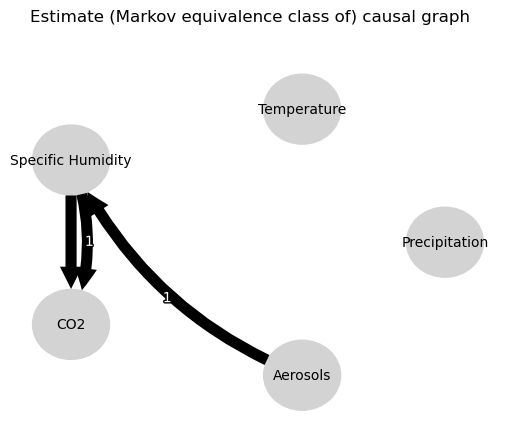

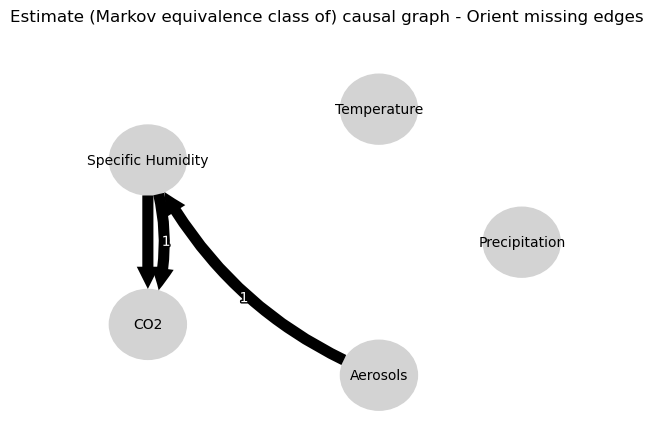

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.03077452044515575
0.7736838189228675
0.06657220113122105
0.560200129315107
-0.12314585790536743
0.25234840947473286
0.01871650943153404
0.7736838189228675
-0.009230514173144721
0.0
-0.02193363288649144
0.6412164310551554
-0.20718051592344486
0.002206929218691843
0.02583485755911905
0.560200129315107
0.0883463064855262
0.6412164310551554
0.052184291742665034
0.0
0.2168402556824752
-0.025447550110014126
0.12809113671703337
0.25234840947473286
0.0363686837212785
0.002206929218691843
0.3640523828657207
-0.025447550110014126
0.1286991579767845
0.0
-0.04170012874025469


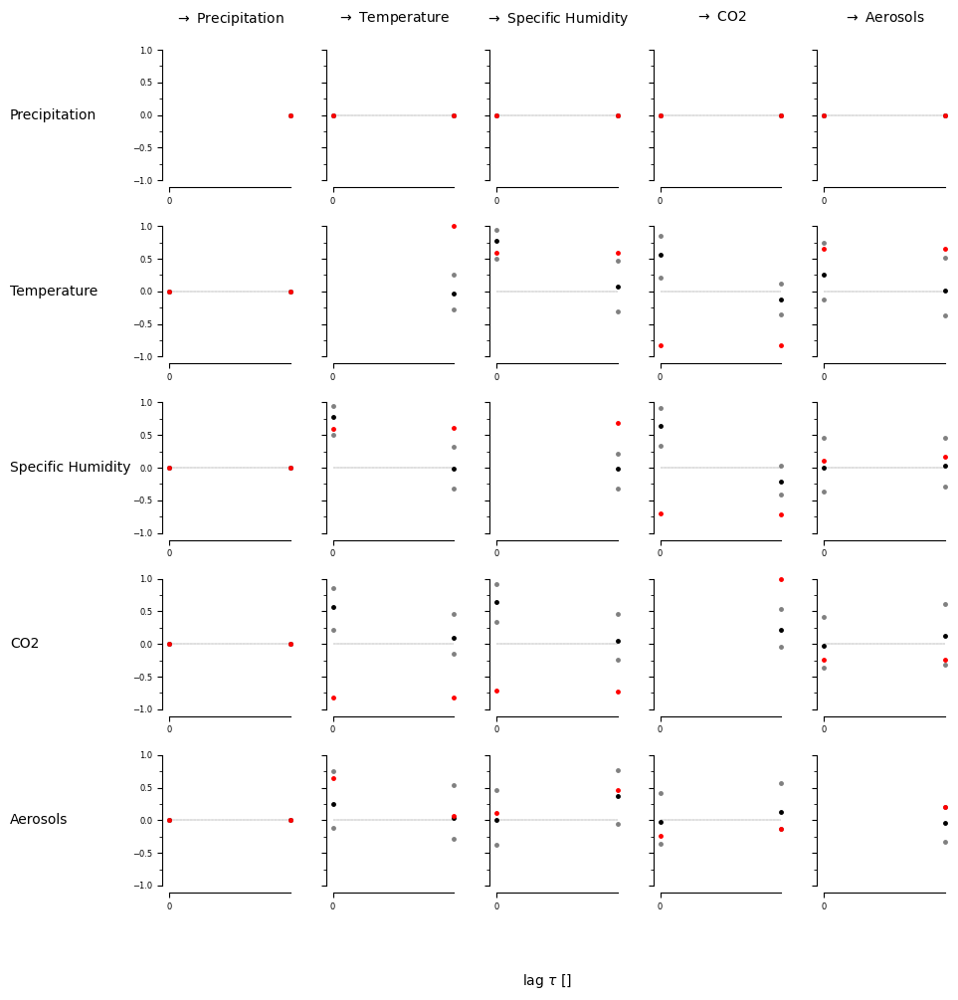

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]]


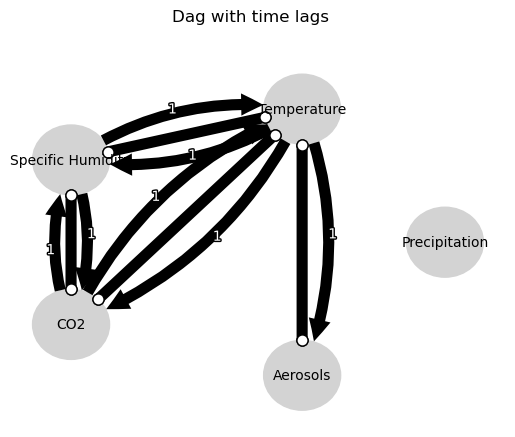

Negative precipitation values in event 75: 0


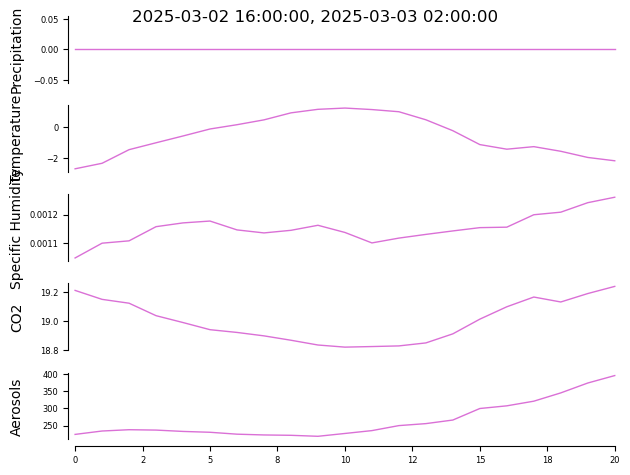


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


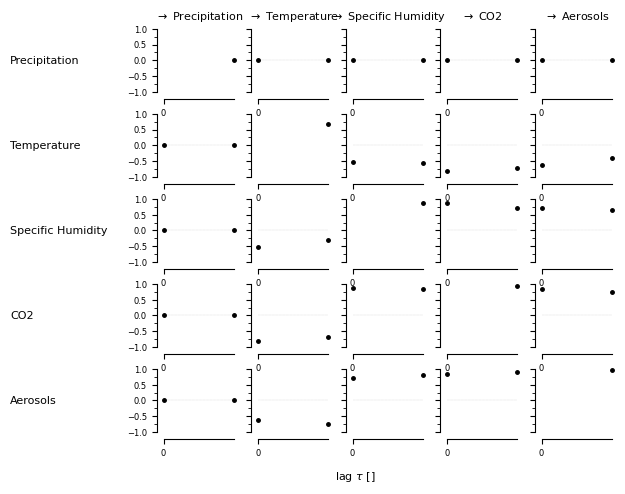

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 2 link(s):
        (Aerosols -1): max_pval = 0.00343, |min_val| =  0.651
        (Temperature -1): max_pval = 0.02656, |min_val| =

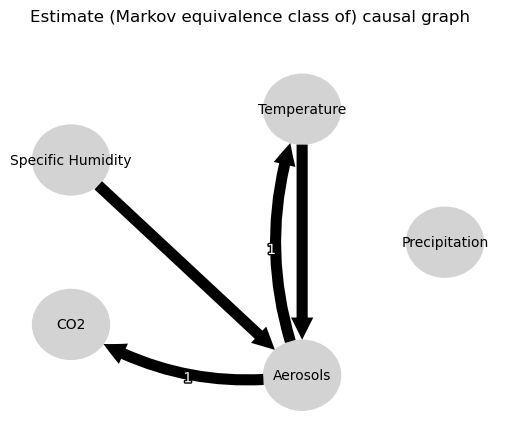

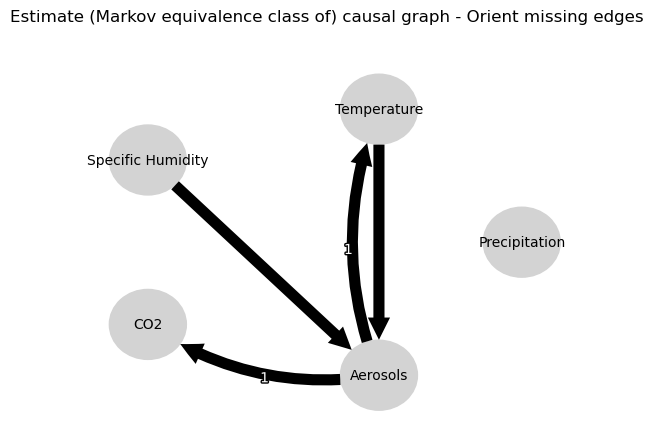

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.7463208390206082
-0.03737699330159884
-0.033021857491436504
-0.8057024600223585
-0.6840658093795796
-0.7379845456080522
-0.7228947161313684
-0.03737699330159884
0.018995817557352506
0.0
0.46616001916446564
0.05215646397093792
-0.00506694514681998
-0.012695226597929129
0.020181771964490402
-0.8057024600223585
-0.694169273447428
0.05215646397093792
0.016387891566162646
0.0
0.8061954543636772
0.8784192364277358
0.8639007231216002
-0.7379845456080522
-0.7473538177084732
-0.012695226597929129
-0.002268544300230227
0.8784192364277358
0.9045062903236112
0.0
0.969276186596369


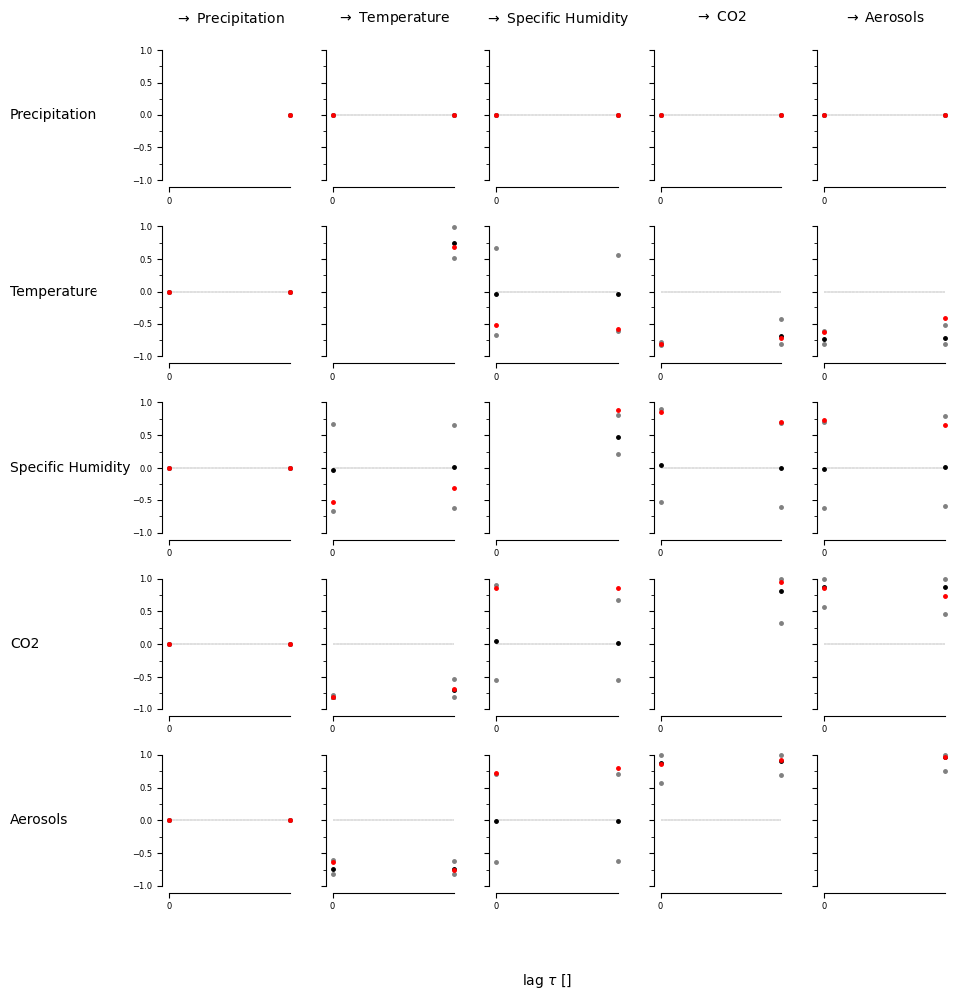

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [ True  True]
  [ True False]]

 [[False False]
  [False False]
  [False  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [ True  True]
  [False  True]]]


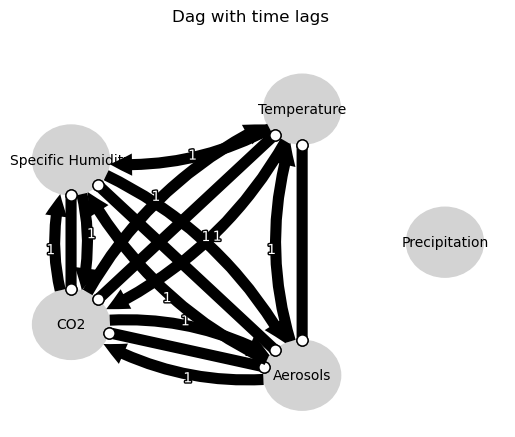

Negative precipitation values in event 76: 0


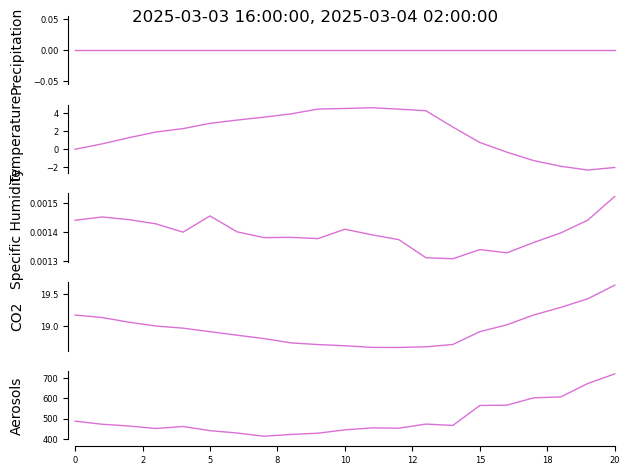


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


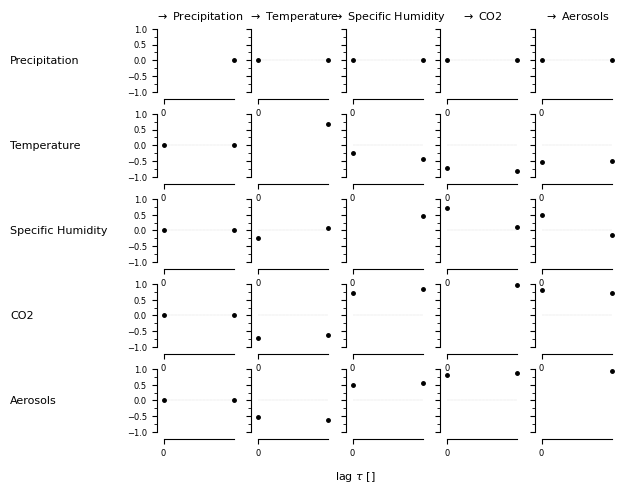

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.02726, |min_val| =  0.519

    Variable Specific Humidity has 2 link(s):
       

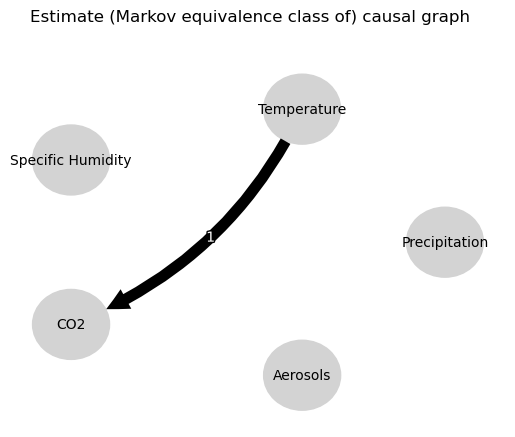

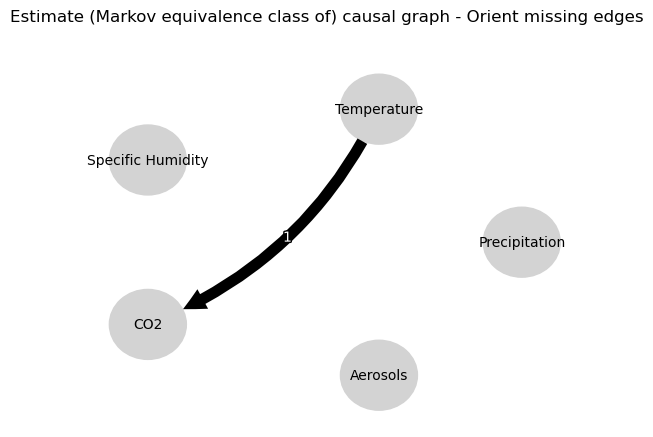

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.5727550941484324
0.1747690511264478
-0.20205082567479576
-0.5523951579394223
-0.7021306703172839
-0.10342212708696884
-0.1376725819197076
0.1747690511264478
0.1409512215691785
0.0
-0.04504656242325094
0.23432801952404242
-0.12492091467418437
-0.012657258410867166
0.010087188572131586
-0.5523951579394223
-0.3957228246296893
0.23432801952404242
0.17916348745801144
0.0
0.5695152559430231
0.16374732263302821
0.1519439897141707
-0.10342212708696884
-0.07180777510151404
-0.012657258410867166
0.043619091525767706
0.16374732263302821
0.15818156935872013
0.0
0.8384808851276067


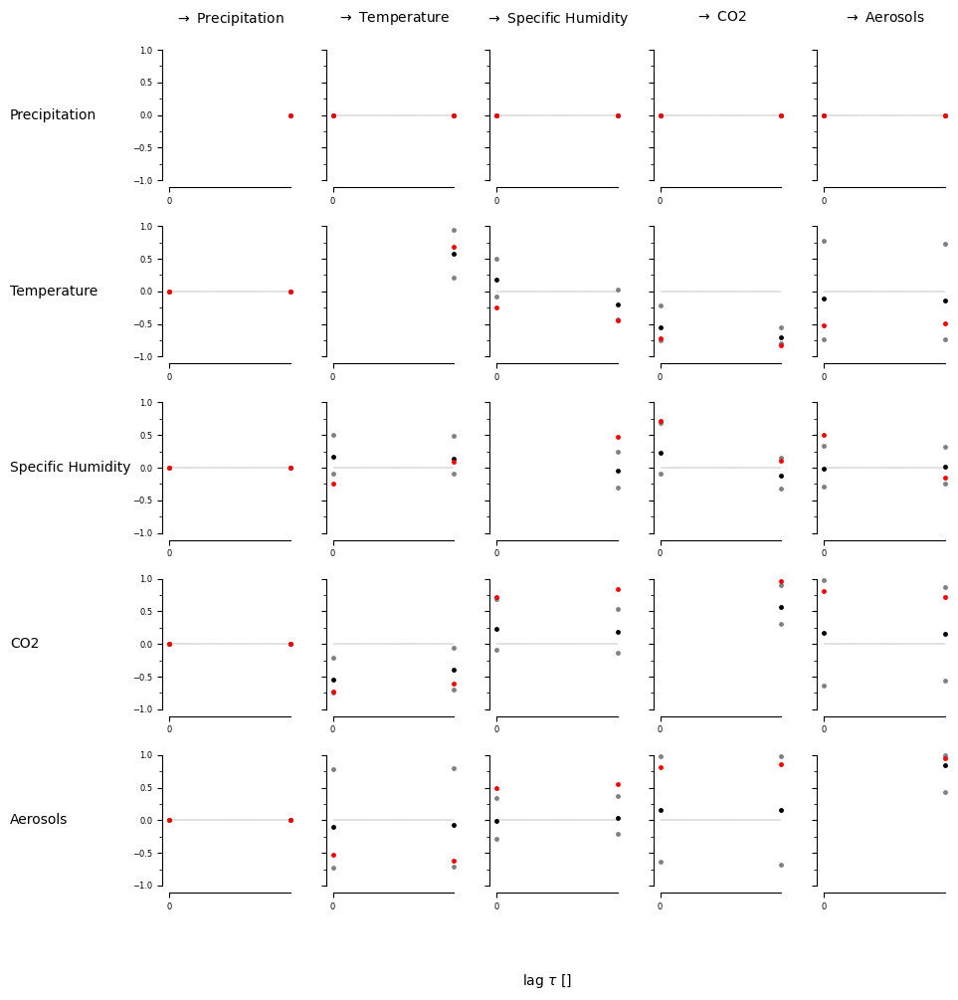

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False  True]]]


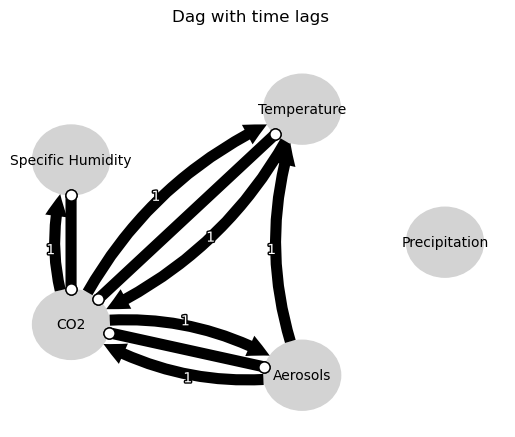

Negative precipitation values in event 77: 0


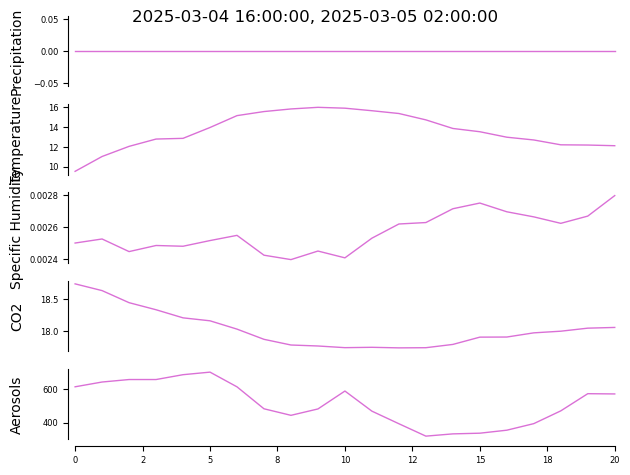


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


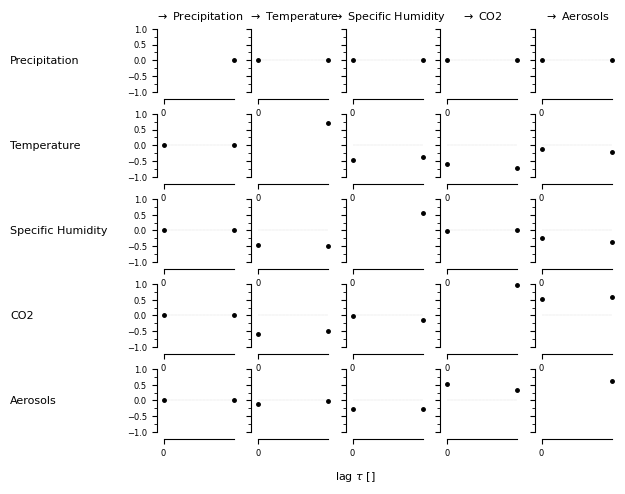

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.01183, |min_val| =  0.579

    Variable Specific Humidity has 1 link(s):
       

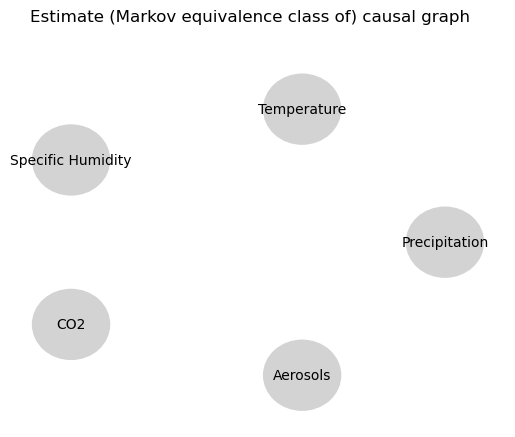

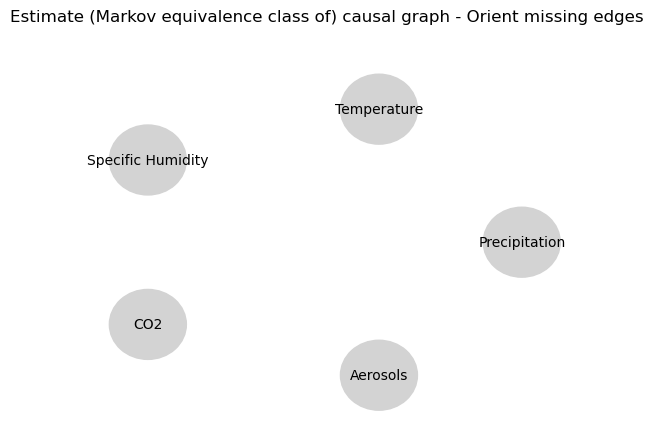

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.3842600699054704
-0.3650224534667742
0.16644776195919075
-0.4738947943470648
-0.27654134541030095
-0.09382249761791324
-0.07288157978057126
-0.3650224534667742
-0.235405334025179
0.0
-0.026274211512059963
0.37875761187737356
0.23505020830342846
-0.033240013208698384
0.005191870197555648
-0.4738947943470648
-0.28066651602760034
0.37875761187737356
-0.16081866193737196
0.0
0.44909621241343495
0.4365095125295847
0.26234079811601035
-0.09382249761791324
-0.06261215078955731
-0.033240013208698384
0.003950032696595724
0.4365095125295847
0.2694333338723922
0.0
0.49691222785167105


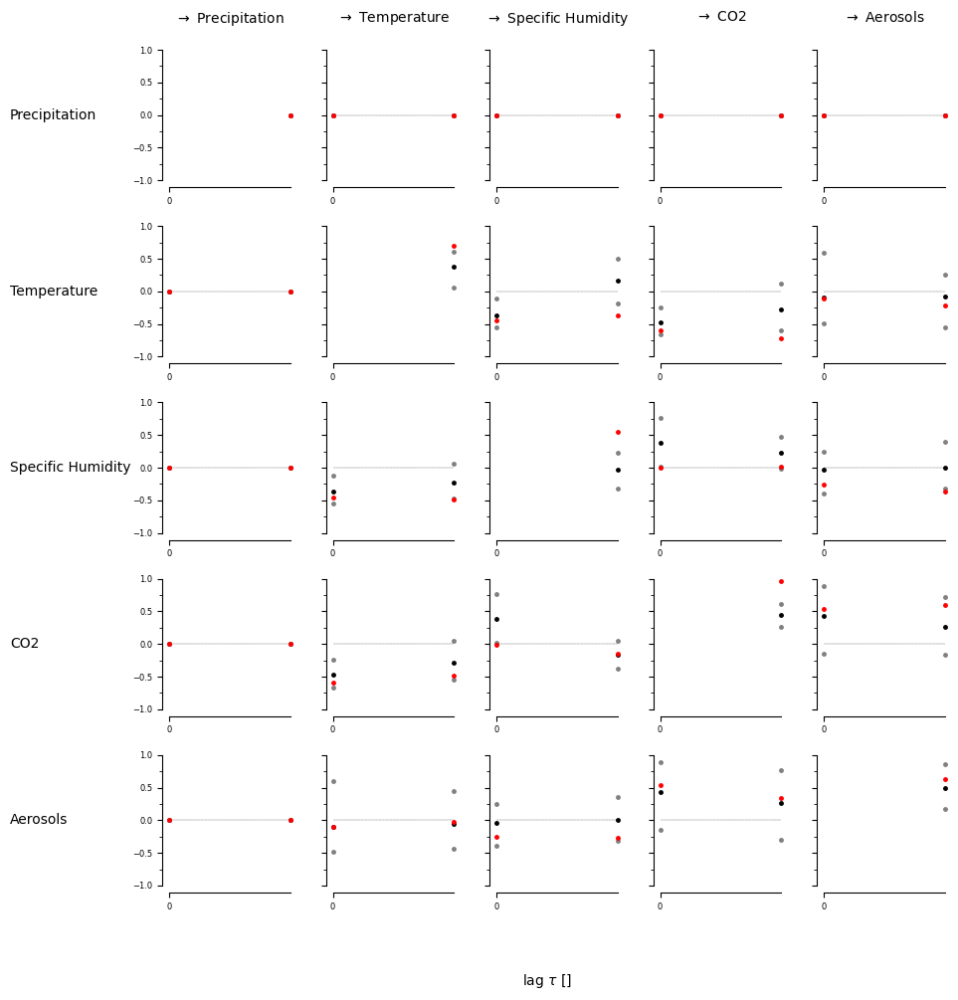

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False  True]
  [False  True]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


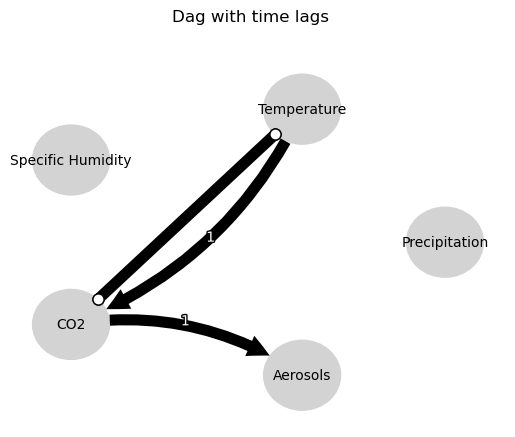

Negative precipitation values in event 78: 0


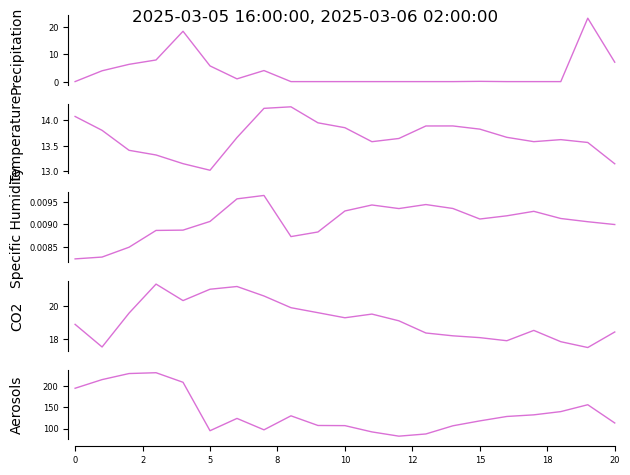


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


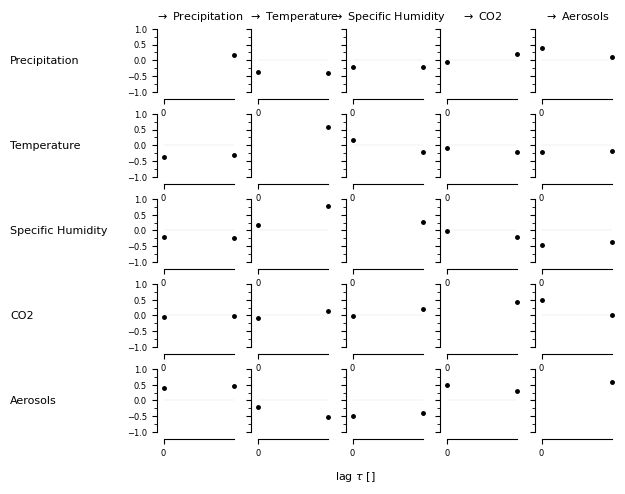

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Aerosols -1): max_pval = 0.04476, |min_val| =  0.465

    Variable Temperature has 2 link(s):
        (Specific Humidity -1): max_pval = 0.00008, |min_

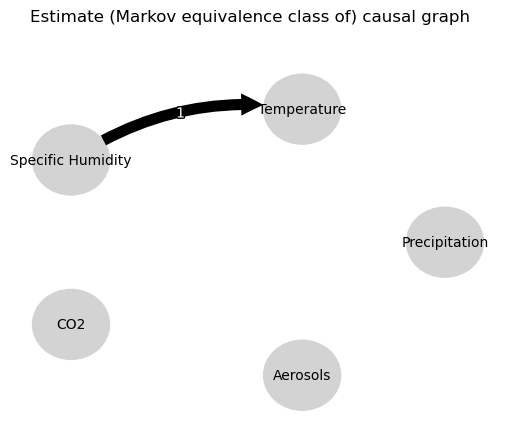

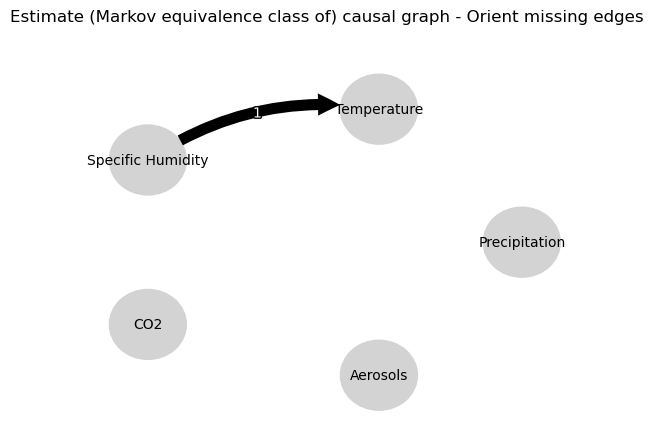

0.0
-0.07642310643524083
-0.32436383326306645
-0.08885190705401404
-0.27458401626100554
0.04916951456923677
-0.0064304274755978535
-0.08444912399665182
-0.026769608118942762
-0.022780452528132752
-0.32436383326306645
0.04955223047954762
0.0
-0.03847680964635891
-0.03586392375209524
-0.05178403669482208
-0.09444104415562446
-0.022343134094600918
0.23253702775915328
0.15167305420086036
-0.03586392375209524
0.3172394750233041
0.0
-0.032884733212824084
0.10413095600404464
-0.08242599293079826
-0.1759120826657812
-0.09430095107156442
-0.09444104415562446
-0.01049066778913431
0.10413095600404464
0.05418811999798002
0.0
-0.05955611037915387
-0.20810164568954062
-0.1359676250761466
0.23253702775915328
-0.11273841586997418
-0.1759120826657812
-0.03875274460384948
-0.20810164568954062
0.007984978324247298
0.0
0.4599515102559801


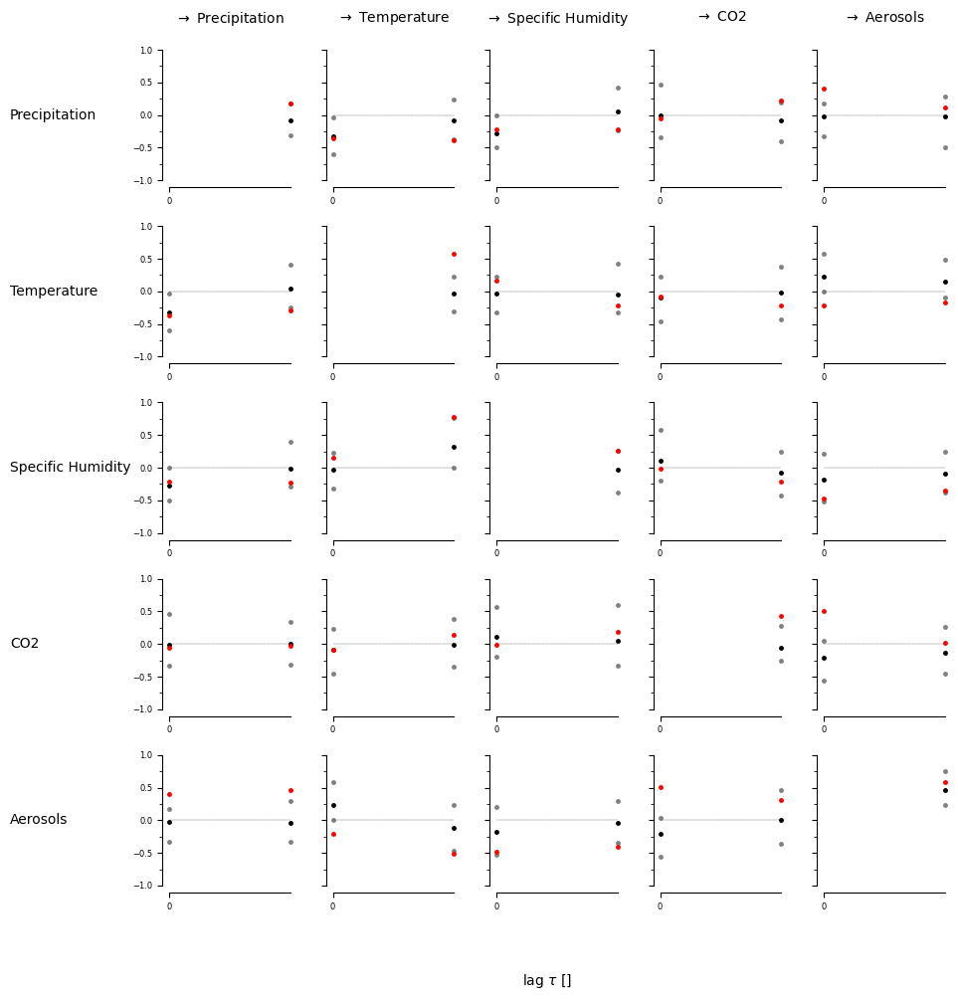

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


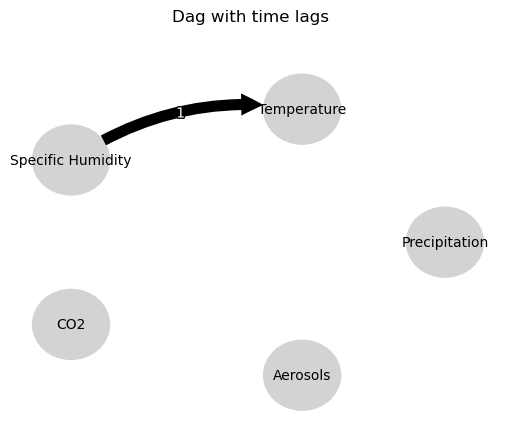

Negative precipitation values in event 79: 0


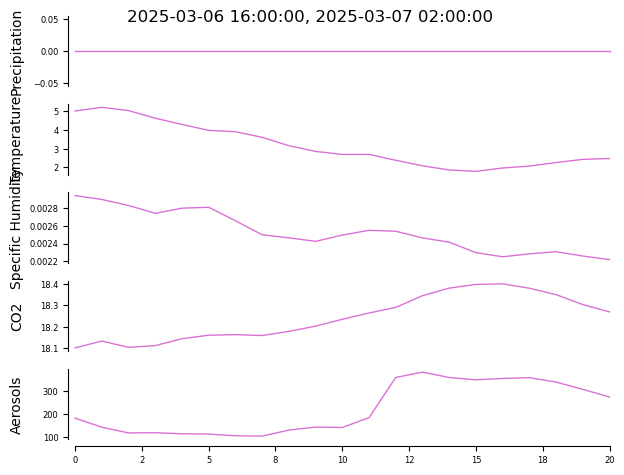


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


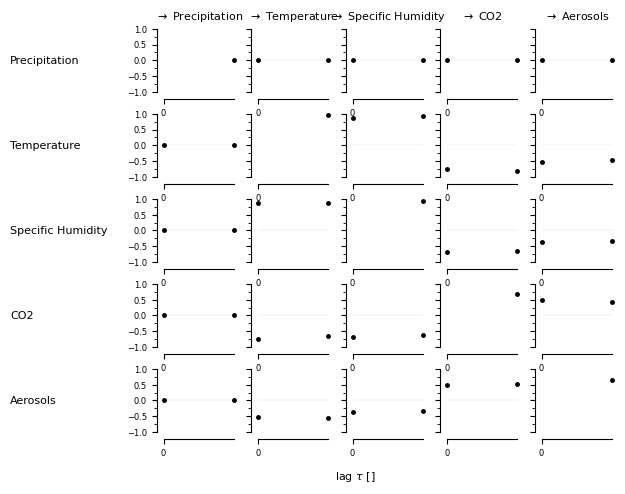

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 2 link(s):
        (Temperature -1): max_pval = 0.00000, |min_val| =  0.899
        (Aerosols -1): max_pval = 0.03245, |min_val| =

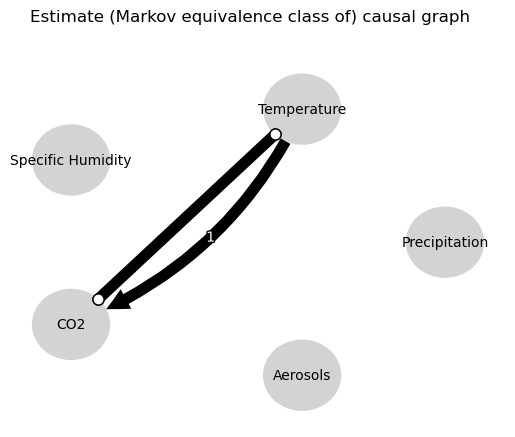

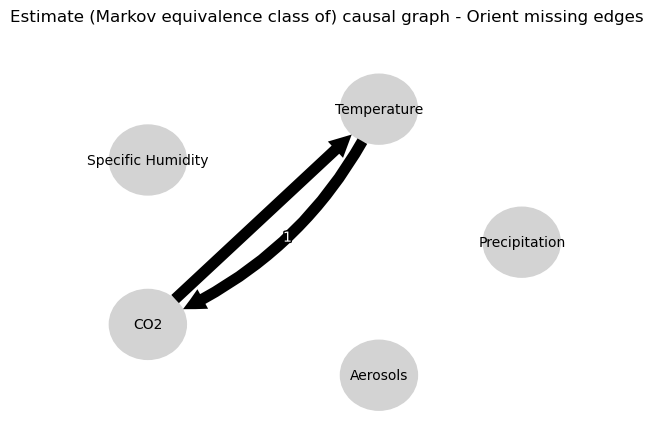

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.49776711262945383
0.06617115820893874
0.05146799513059464
-0.26222006103677226
-0.5045718646288444
-0.34316916742299747
-0.18735252921920362
0.06617115820893874
0.013677650474608668
0.0
0.5140691063080319
0.020396137450044368
-0.04280913574478342
0.018642974457835356
-0.034934975137050885
-0.26222006103677226
-0.1658527323988984
0.020396137450044368
-0.03431962778113028
0.0
0.14199875630015976
0.14181144236967252
0.07164208518201742
-0.34316916742299747
-0.21877051152426824
0.018642974457835356
-0.009369023061445521
0.14181144236967252
0.1973637594576318
0.0
0.5283411591292633


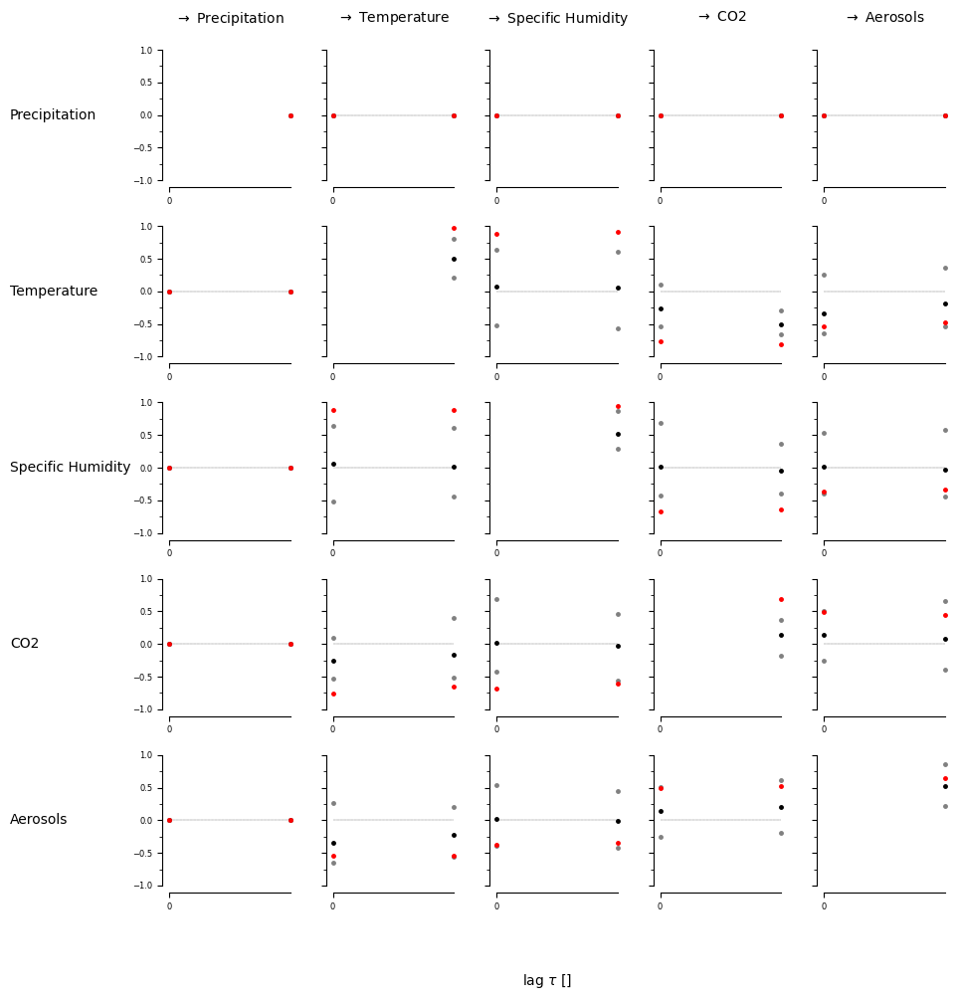

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


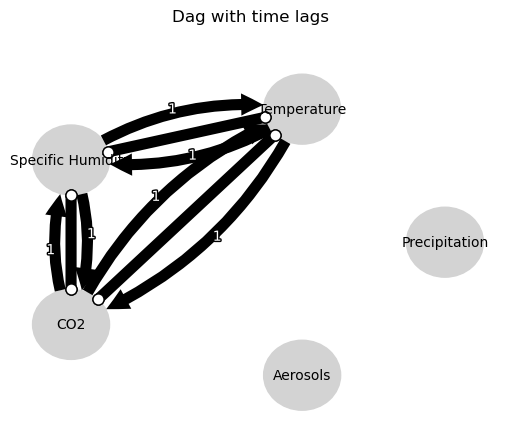

Negative precipitation values in event 80: 0


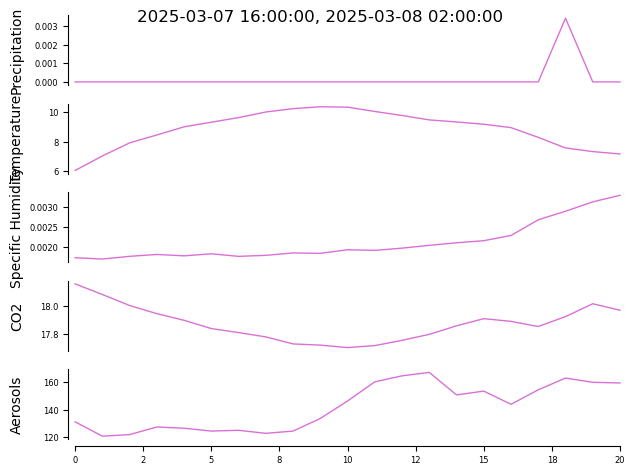


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


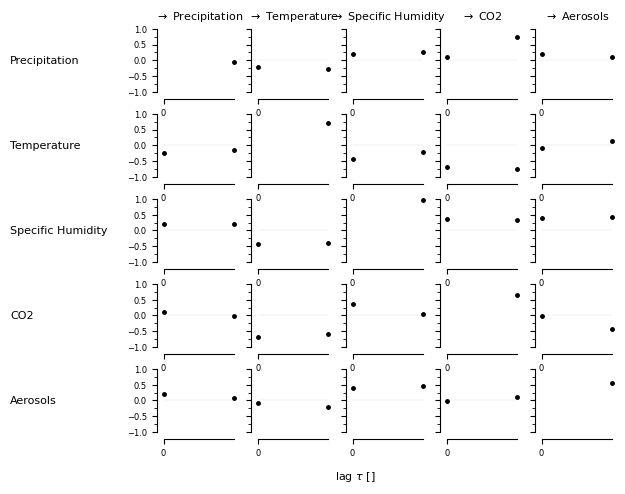

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.04455, |min_val| =  0.479

    Variable Specific Humidity has 1 link(s):
       

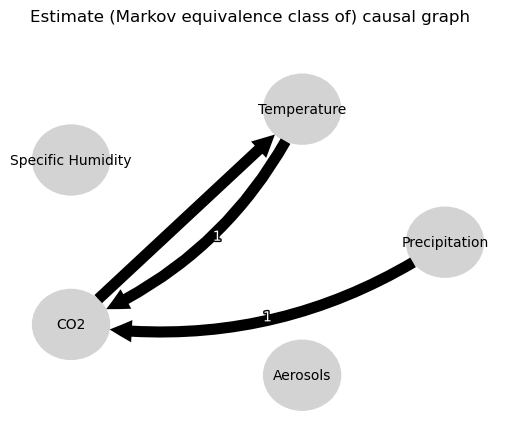

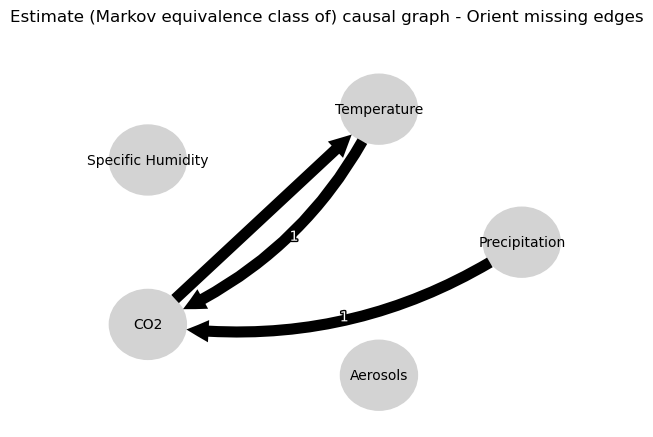

0.0
-0.05336197053941978
-0.2615760164297389
-0.29067048809215446
0.018461972786439778
0.0405419596711862
0.021358173443851214
0.39101697035280003
0.17646928486502017
-0.035447990392962564
-0.2615760164297389
0.0750839216102208
0.0
0.4904186311317252
0.11238794204733198
0.09404050978418362
-0.5742410924740738
-0.626293386782028
-0.4380603250544623
0.08756674811914701
0.11238794204733198
0.13842801828192494
0.0
0.9396961064907688
-0.10963006672259326
-0.10175391578472048
-0.03586431879101427
-0.07001466482236994
-0.5742410924740738
-0.34257448263516005
-0.10963006672259326
-0.11502475704805408
0.0
0.44505972563823754
0.17223077886906643
-0.03858113211349897
-0.4380603250544623
-0.3060720203909119
-0.03586431879101427
-0.07607930605558201
0.17223077886906643
0.4049963151009627
0.0
-0.043810455435720375


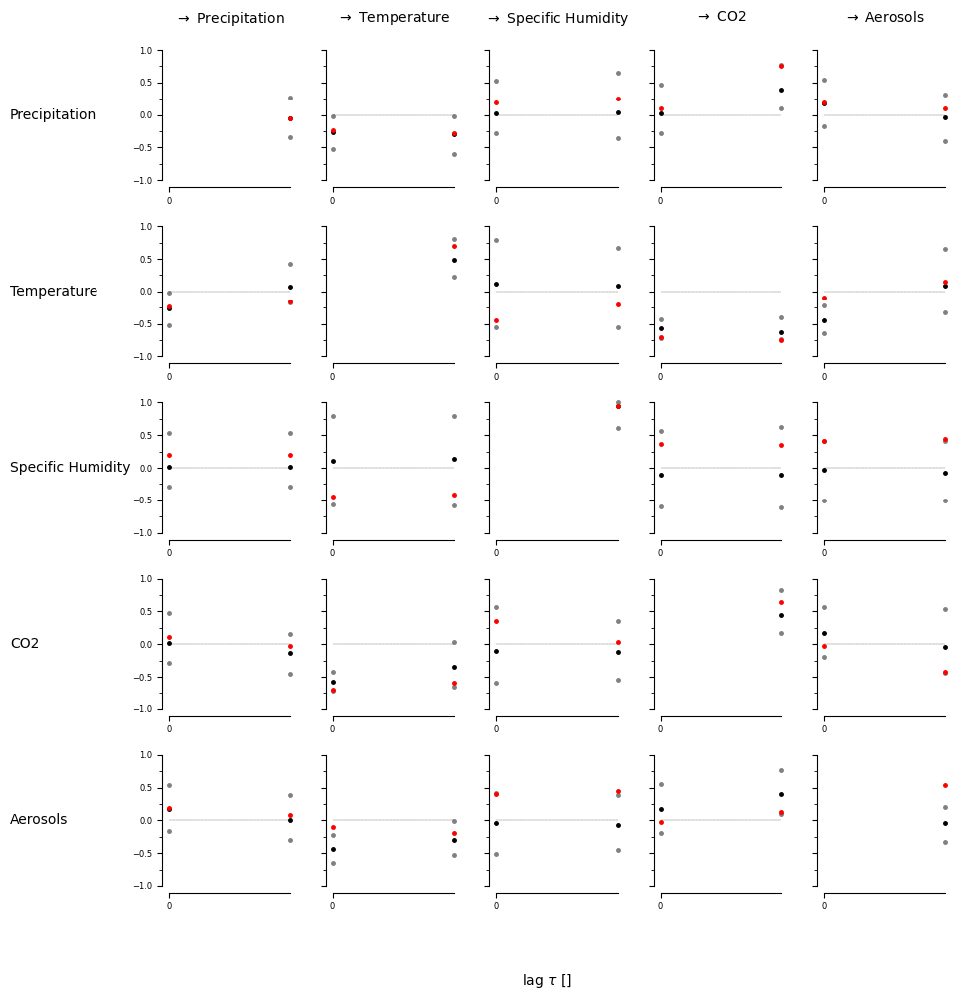

[[[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


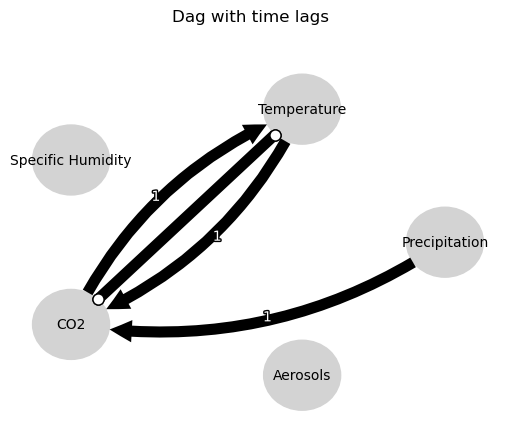

Negative precipitation values in event 81: 0


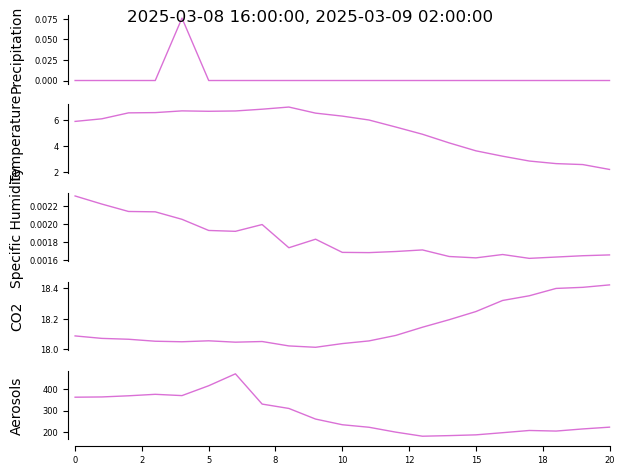


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


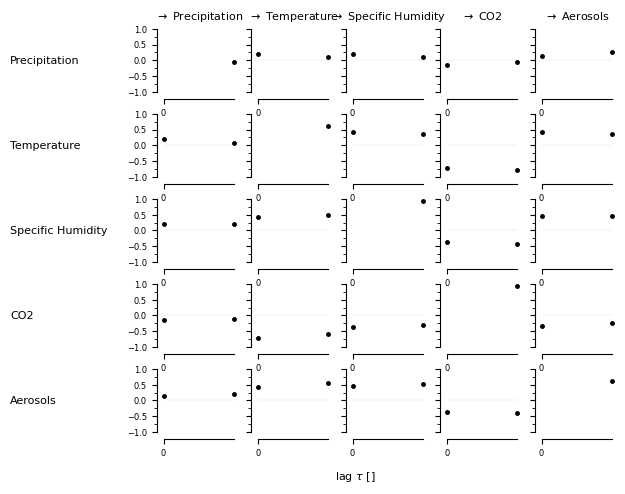

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00000, |min_val| =  0.910



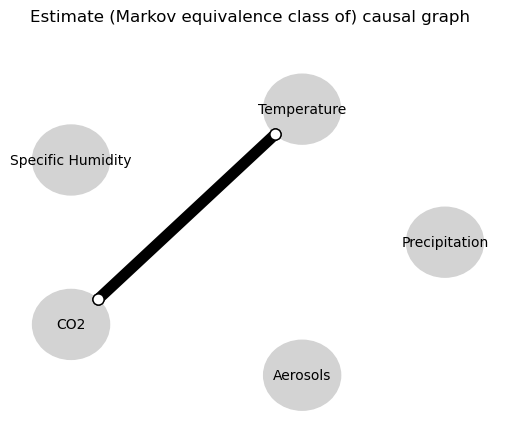

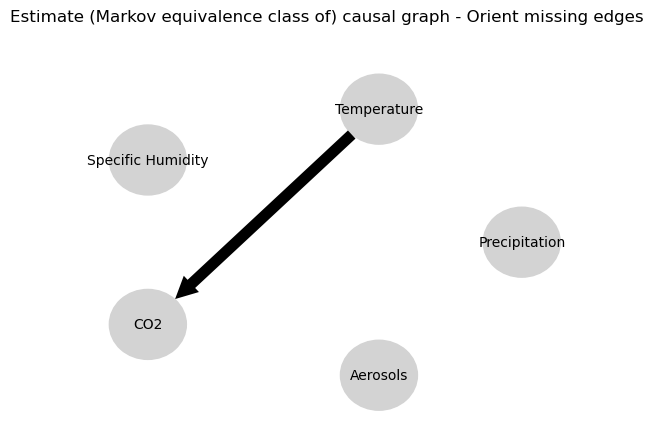

0.0
-0.059456175219576114
0.21180477285960286
0.01891803461558898
0.24148113709652527
-0.029824258924695854
-0.14657056355676376
-0.06814155956893907
0.06008905979715953
0.023395194692899673
0.21180477285960286
-0.03641367329800539
0.0
-0.031903267494745306
0.6203348438884304
0.014875685143851533
-0.7901997508300773
0.03650923269737831
0.009960622888739605
0.009156742686766658
0.6203348438884304
-0.04338998350898639
0.0
-0.00016857092996924543
-0.48788179996258807
0.0411877519659517
0.06620919074600562
0.0733522913229827
-0.7901997508300773
0.0732238567938101
-0.48788179996258807
0.005146744020599668
0.0
-0.09960865688005437
-0.01552732889778394
0.005450096467917032
0.009960622888739605
-0.002568058870939686
0.06620919074600562
-0.013128738568010837
-0.01552732889778394
-0.06043861780701235
0.0
0.49752271917923296


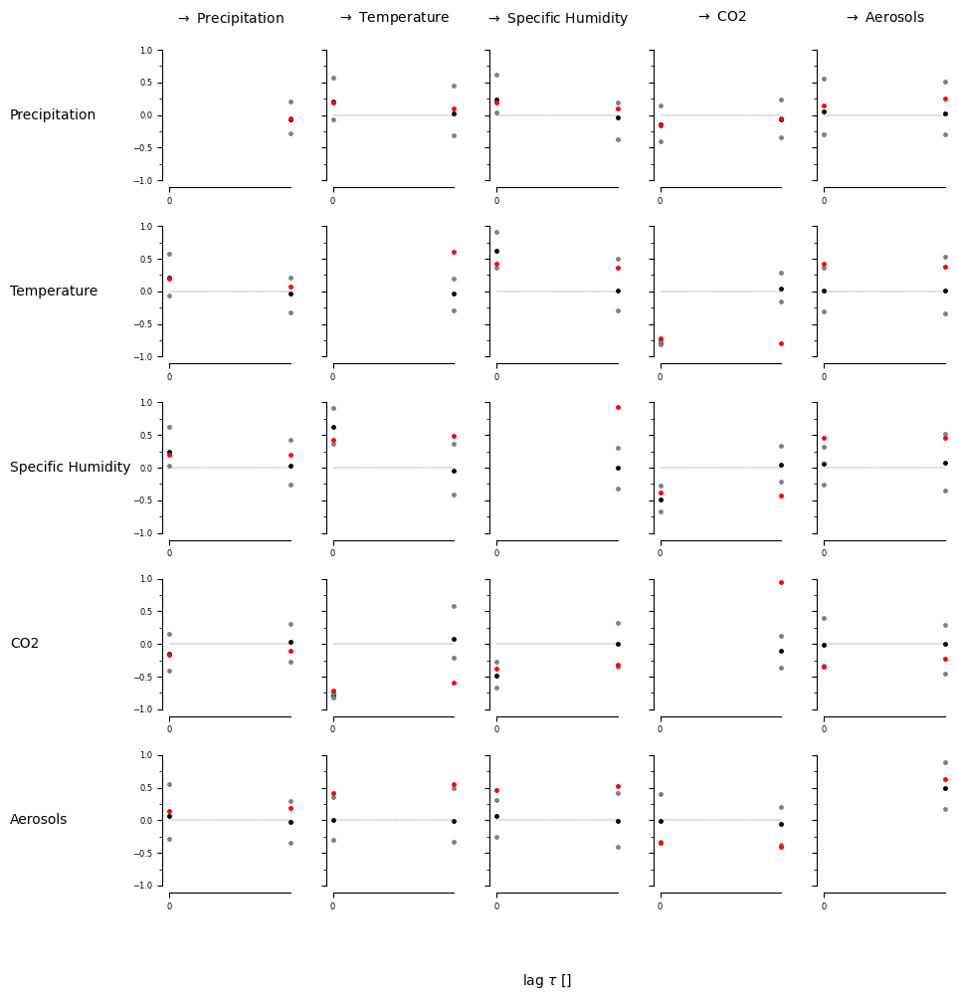

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


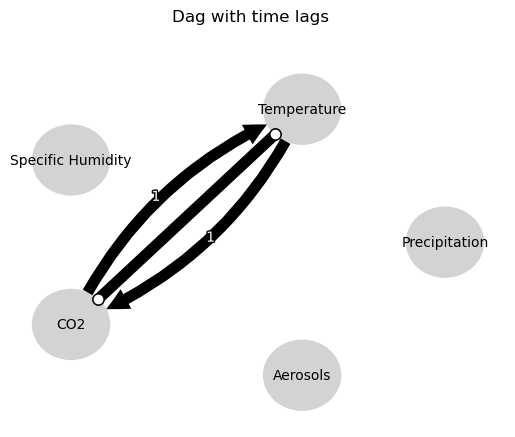

Negative precipitation values in event 82: 0


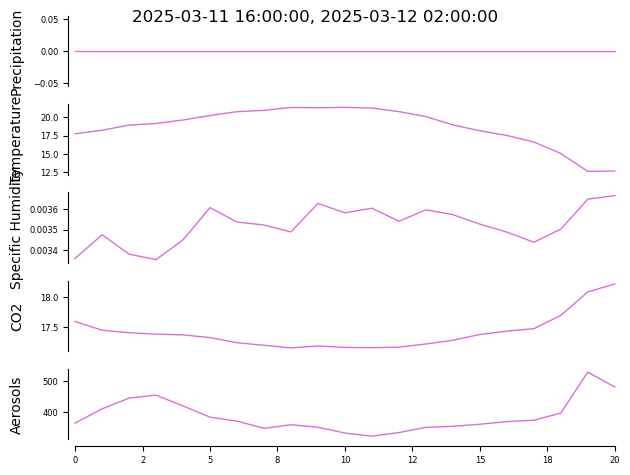


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


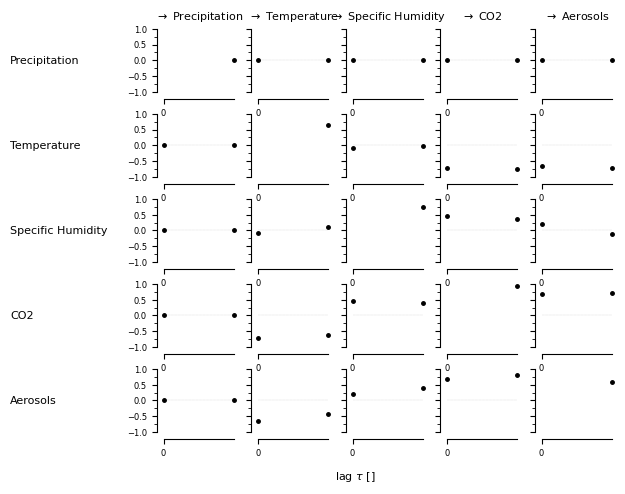

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00029, |min_val| =  0.741



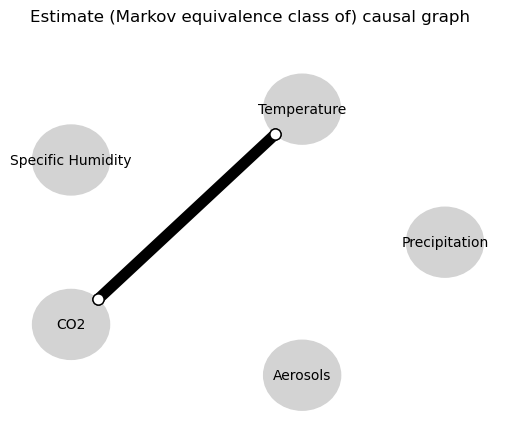

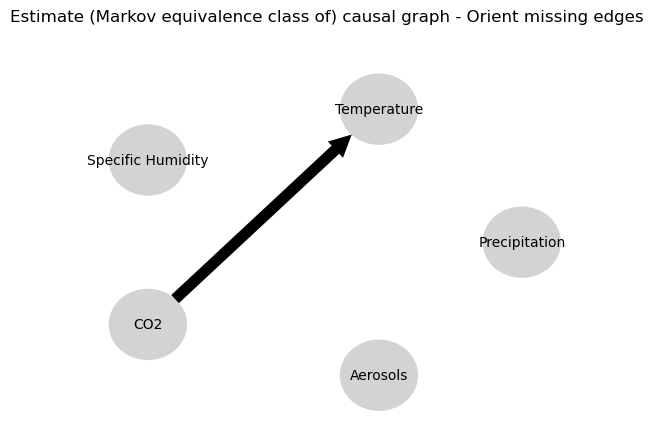

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.8281866046238693
-0.033090023732613445
-0.05547850286517335
-0.7965018066931576
-0.772872467895742
0.04176235996287511
0.0001248778673074232
-0.033090023732613445
-0.04834579623551414
0.0
0.29911564841014876
0.09912823444836165
0.029921666528514013
0.0641191015079738
-0.05841415284620669
-0.7965018066931576
-0.7508968410974735
0.09912823444836165
0.056451976470554985
0.0
0.9009161603985512
-0.016853495967510724
-0.02019264421744253
0.04176235996287511
-0.012272157140699127
0.0641191015079738
-0.027170896779268743
-0.016853495967510724
-0.020992871347807772
0.0
-0.0438664419562254


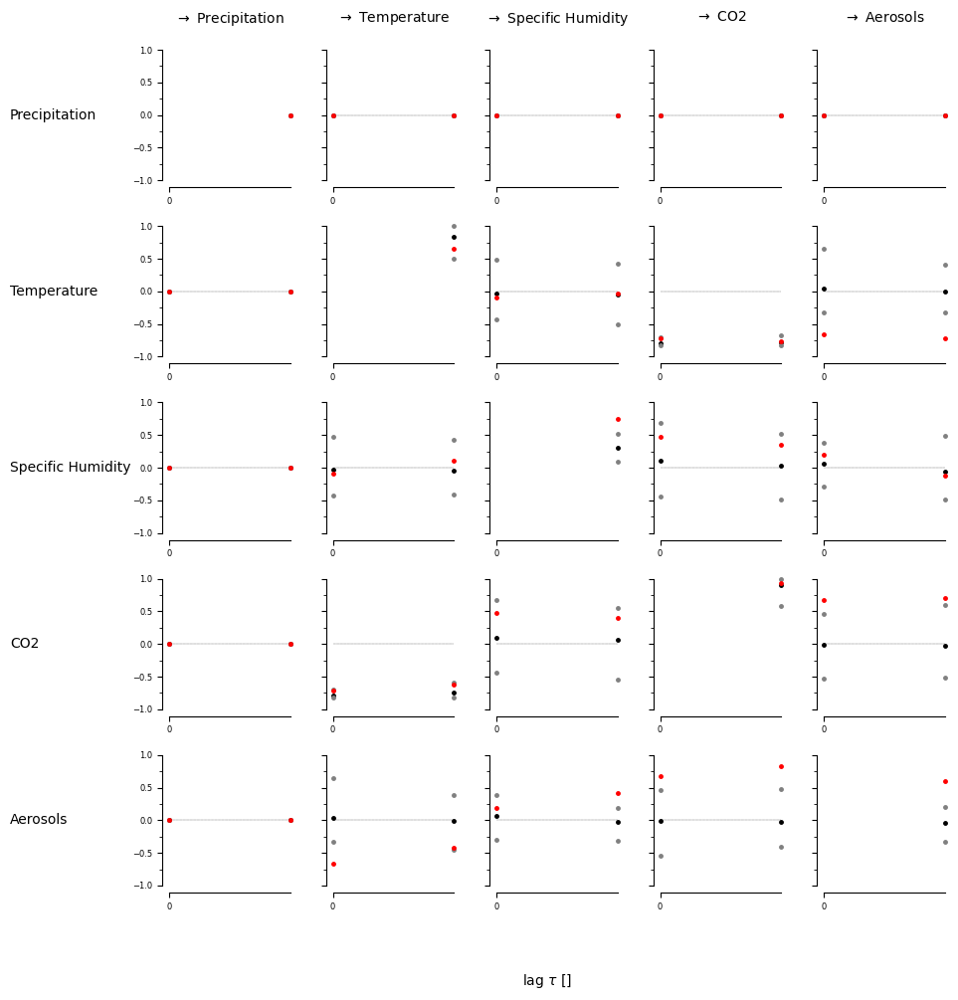

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True False]
  [False False]
  [ True  True]
  [False  True]]]


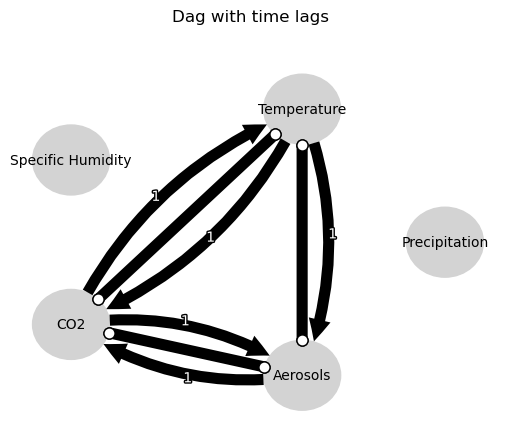

Negative precipitation values in event 83: 0


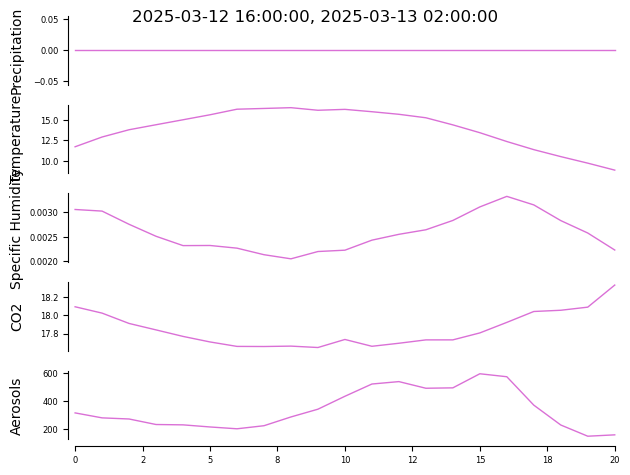


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


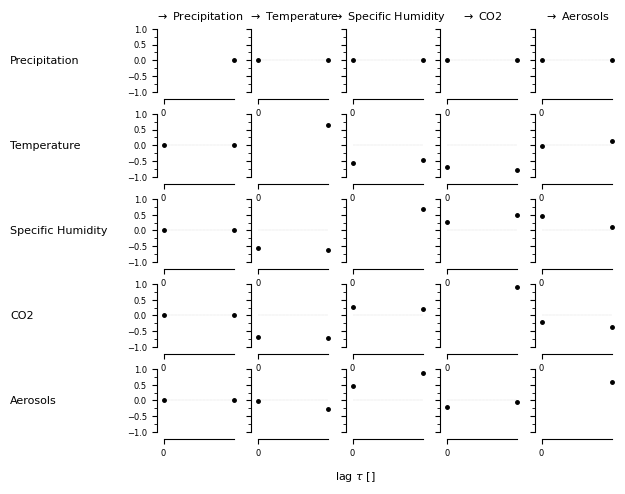

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 2 link(s):
        (CO2 -1): max_pval = 0.03380, |min_val| =  0.502
        (Specific Humidity -1): max_pval = 0.04098, |min_val| 

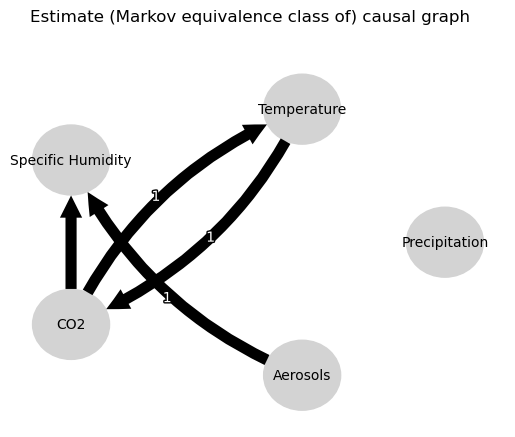

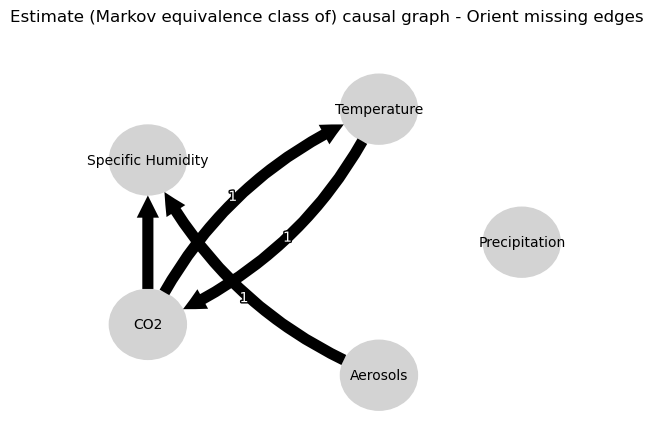

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.8203812976118652
0.9936517399700355
-0.8170331490996102
0.9988896436873225
-0.8214594561988711
0.025831645360396147
-0.008139561428651462
0.9936517399700355
-0.8146046901832826
0.0
-0.8108036481383808
0.9955420736612309
-0.8133170249177385
0.03577122520506014
-0.005253597015349129
0.9988896436873225
-0.8199211615883986
0.9955420736612309
-0.8157639955420165
0.0
-0.8197262764544377
0.02939778921065271
-0.00557337057301529
0.025831645360396147
-0.0023166284674156416
0.03577122520506014
0.012578129770897414
0.02939778921065271
0.00031784987571444506
0.0
0.5004785920058249


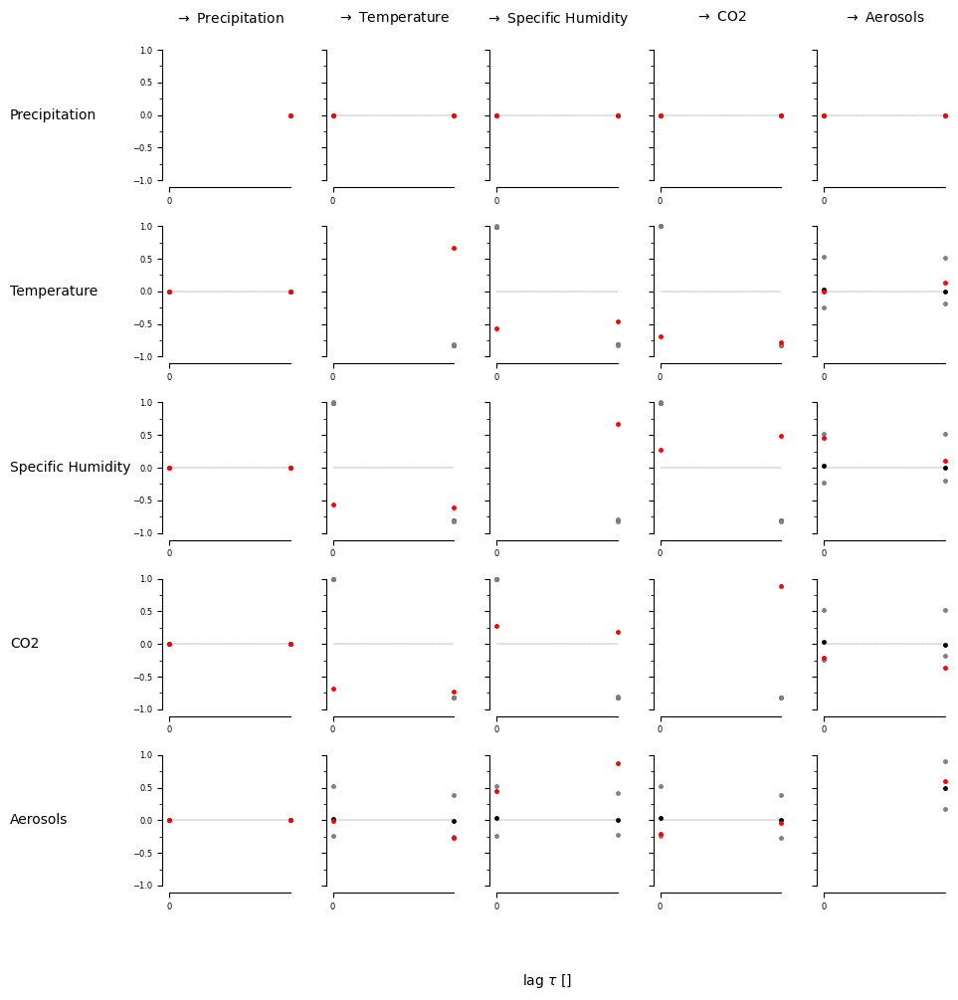

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False  True]]]


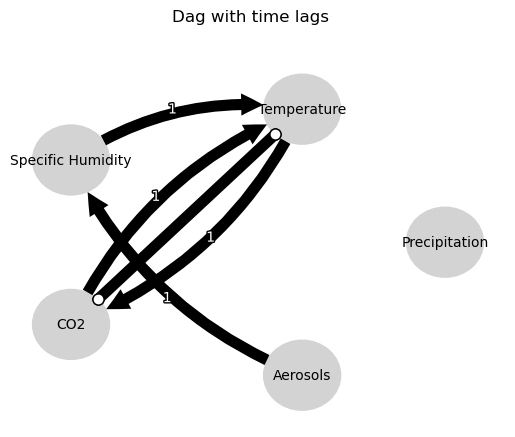

Negative precipitation values in event 84: 0


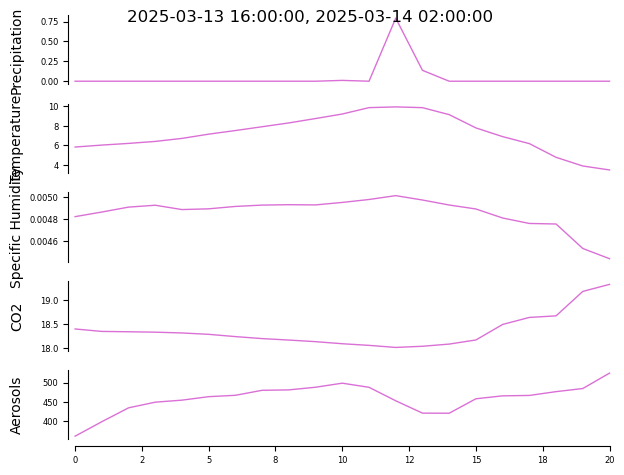


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


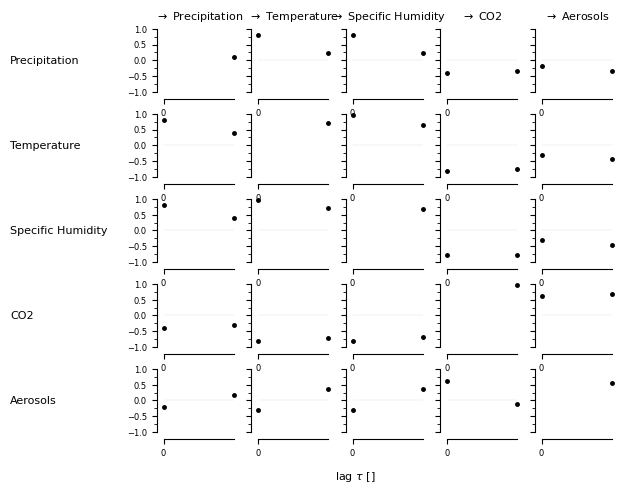

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 1 link(s):
        (CO2 -1): max_pval = 0.00000, |

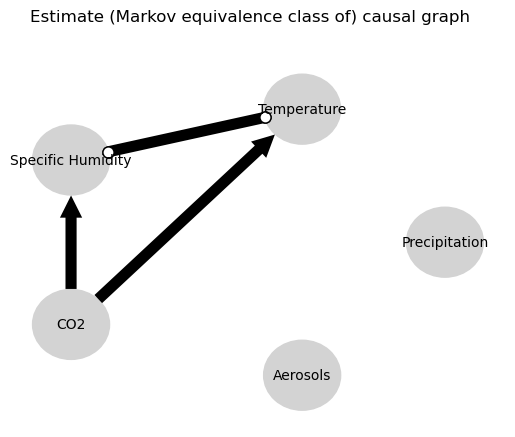

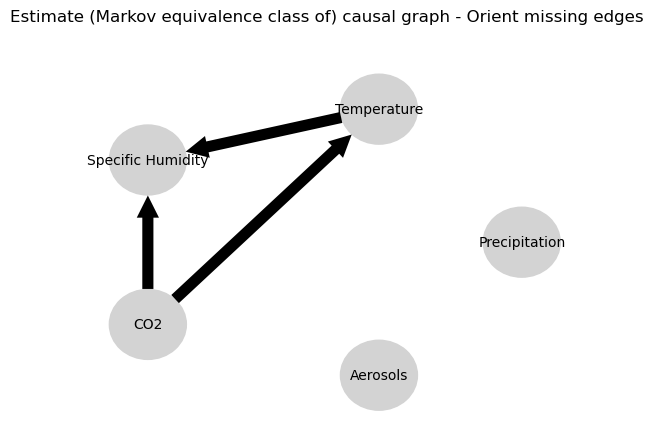

0.0
-0.07861991891105294
0.0996506100851422
0.03821322829986316
0.07460753502927345
0.016129758965393683
-0.09165404099837068
-0.05998418041847096
-0.30303544564777224
-0.2011794289607792
0.0996506100851422
0.07338710394536994
0.0
0.922546808915564
0.953110997100497
0.9364910334857088
-0.7941865204504239
-0.7797915013452538
-0.12454168714218632
-0.11973163404259204
0.953110997100497
0.9521667498160619
0.0
0.9423417997666133
-0.8141514488283915
-0.7868630140845136
-0.10590581783790233
-0.11379357860662598
-0.7941865204504239
-0.7922812030406359
-0.8141514488283915
-0.7934649282621471
0.0
0.9032259538914241
0.1909094257613078
0.16781105382390585
-0.12454168714218632
-0.09591924296838467
-0.10590581783790233
-0.0812727389858247
0.1909094257613078
0.14260561546800957
0.0
0.4424002180338254


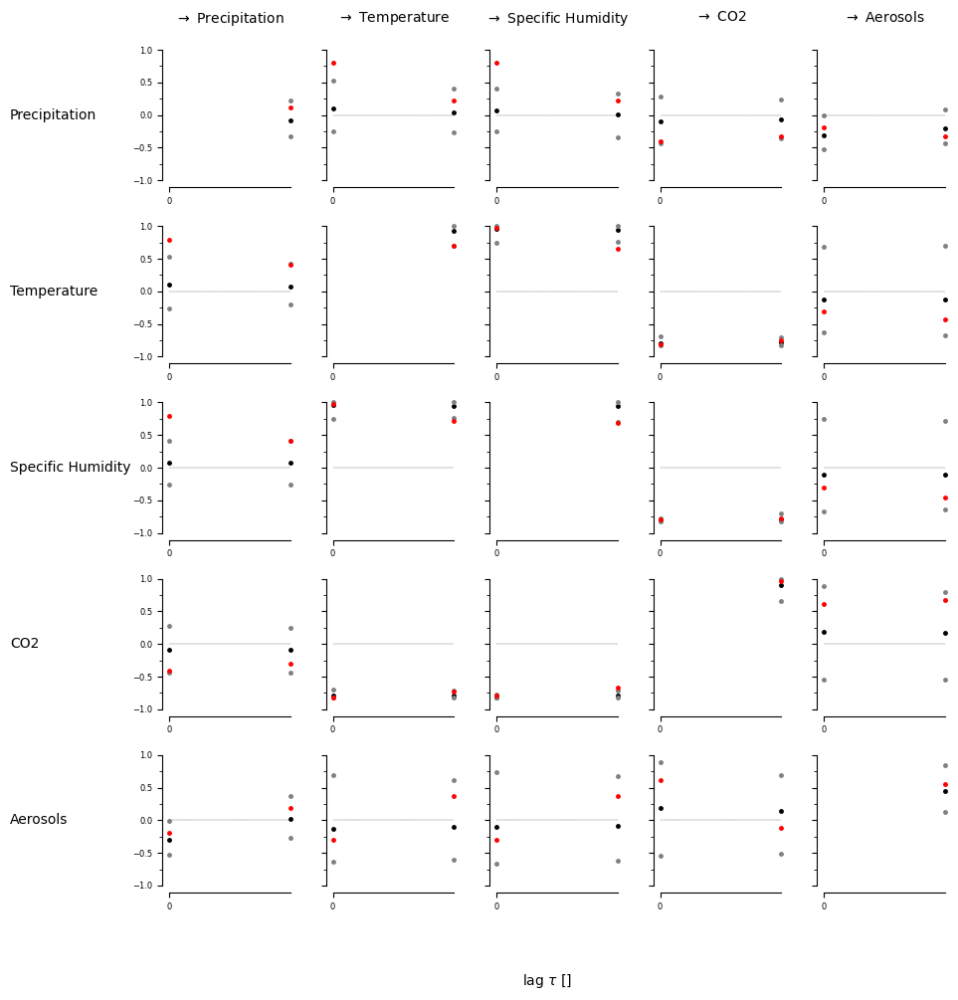

[[[False False]
  [ True False]
  [ True False]
  [False False]
  [False False]]

 [[ True False]
  [False  True]
  [ True  True]
  [ True  True]
  [False False]]

 [[ True False]
  [ True  True]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]]


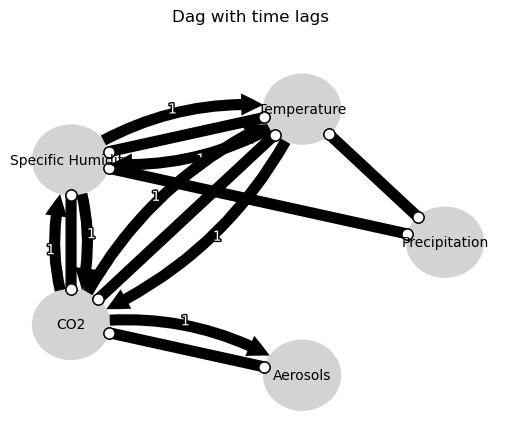

Negative precipitation values in event 85: 0


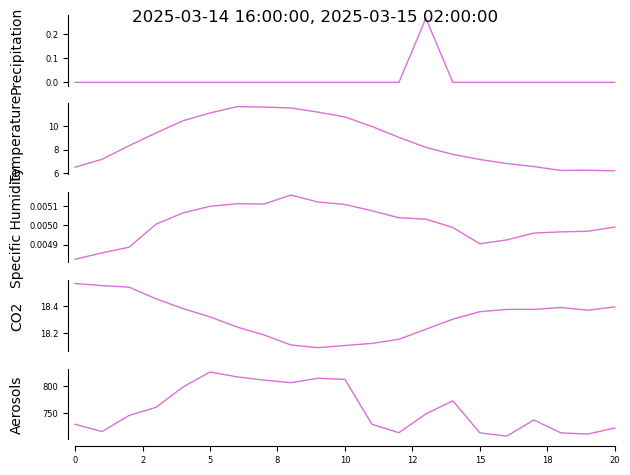


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


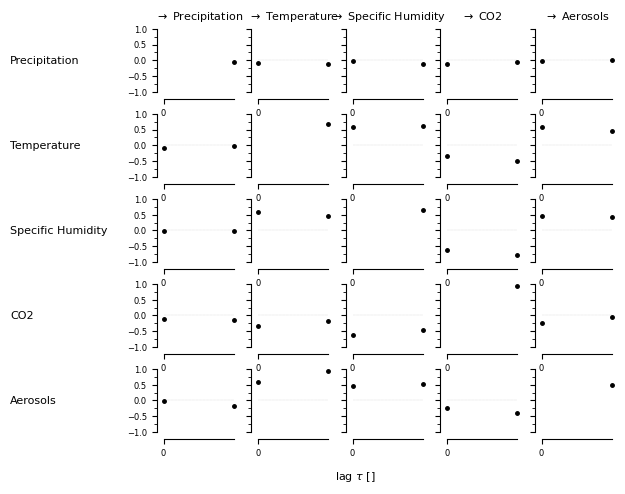

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Aerosols -1): max_pval = 0.00000, |min_val| =  0.872

    Variable Specific Humidity has 0 link(s):

    Varia

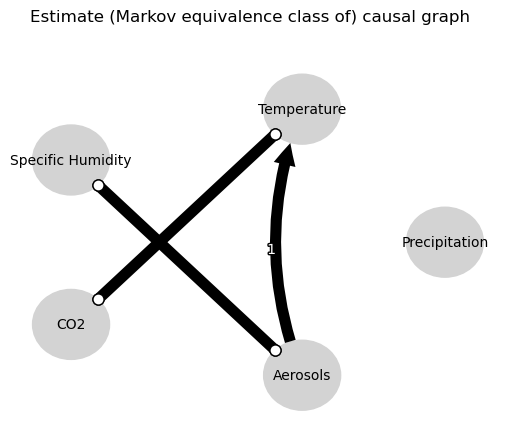

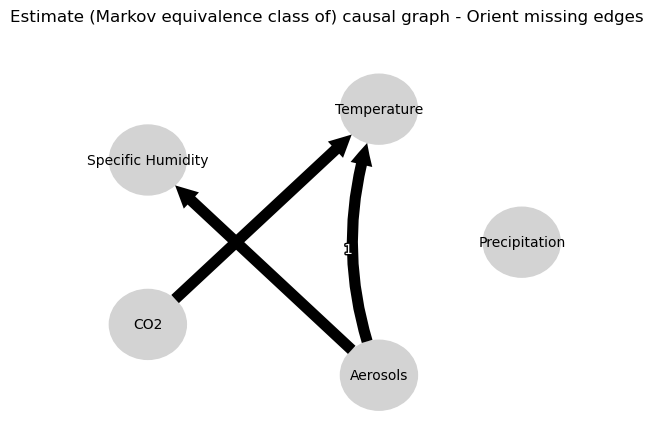

0.0
-0.07038947704797424
0.07917441617701368
-0.10947280733435097
0.03947273067581858
-0.016659947711667206
-0.08422449287620147
0.022229894115458455
-0.07569212040327253
-0.0032651958128844002
0.07917441617701368
-0.058020698034172626
0.0
0.06871962453334413
0.2078642351301709
0.022000731632575907
-0.0961343684526196
-0.014088167326537476
0.1831988539851794
-0.03336374371797092
0.2078642351301709
0.5500590539434076
0.0
-0.04788101763060835
-0.6861612849641445
0.053012140082542354
0.7038270366032742
-0.01989115958528859
-0.0961343684526196
-0.34300023692590176
-0.6861612849641445
-0.0024031779369485446
0.0
-0.041692690811717566
-0.4237032861960966
-0.013583767996559217
0.1831988539851794
0.7289508388359014
0.7038270366032742
-0.007093578380091577
-0.4237032861960966
0.000989690696803755
0.0
-0.04596803662864672


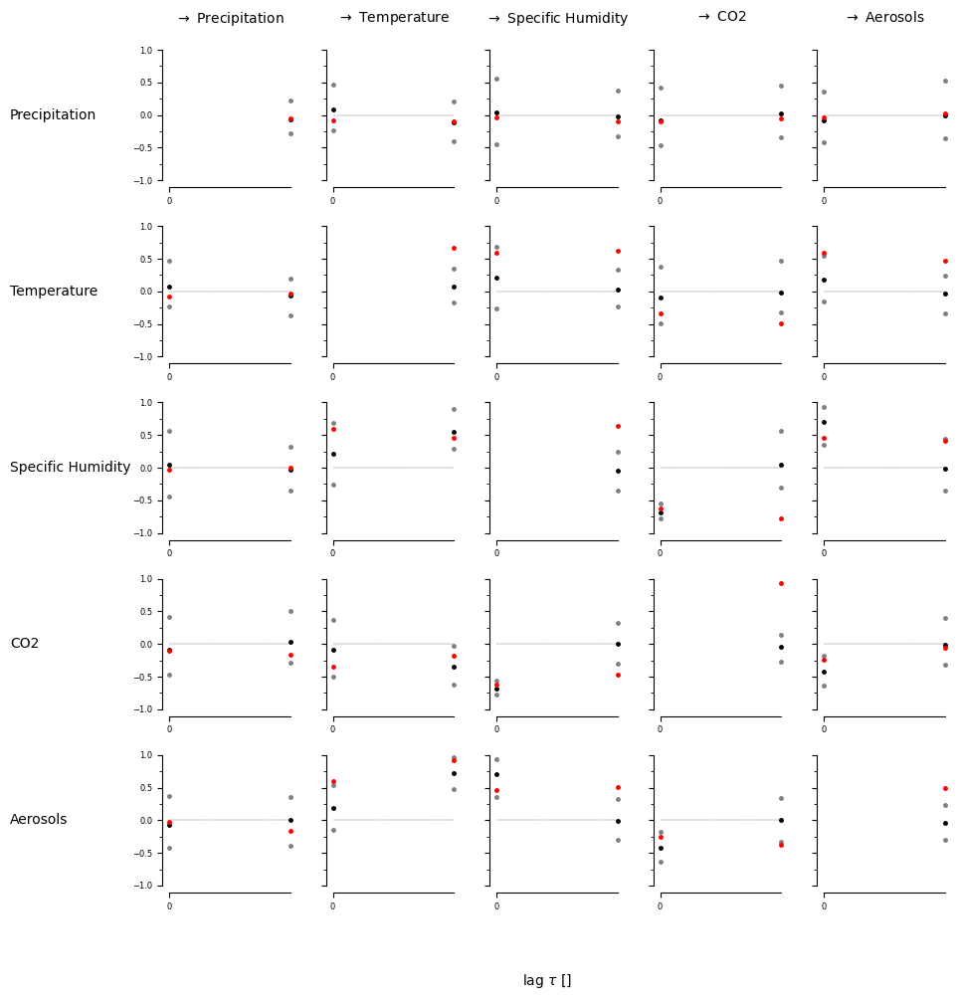

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [False False]
  [ True False]]

 [[False False]
  [ True False]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False False]
  [False False]]]


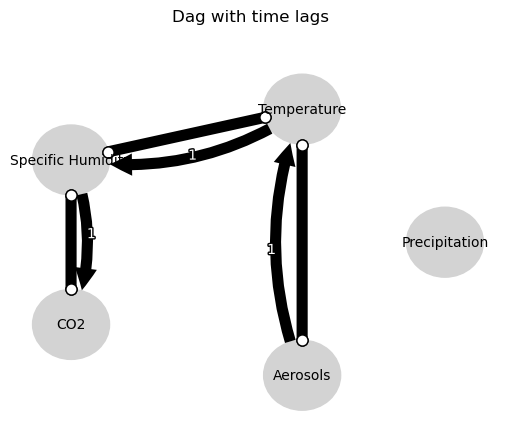

Negative precipitation values in event 86: 0


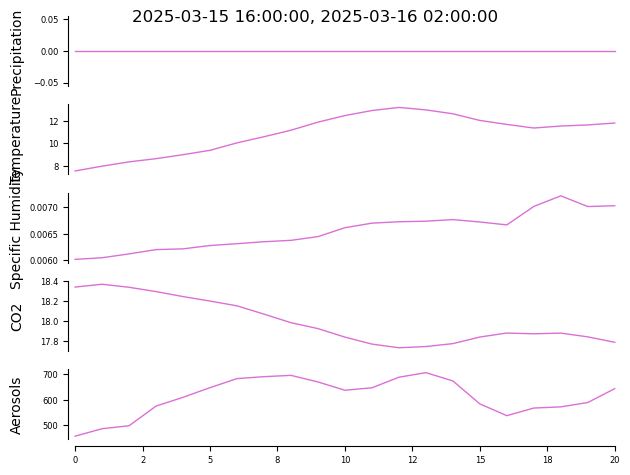


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


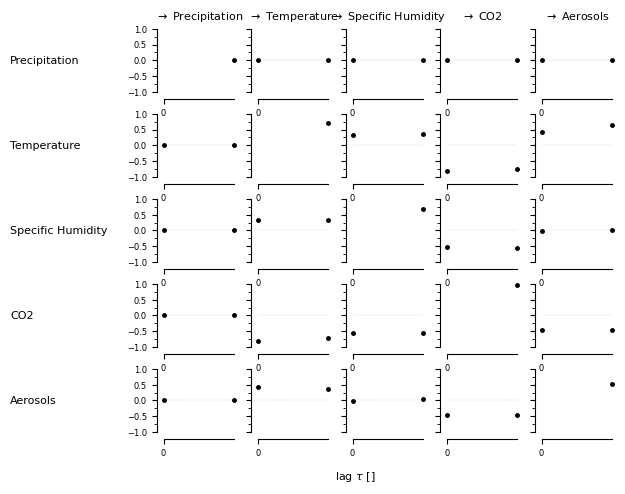

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.02521, |min_val| =  0.525



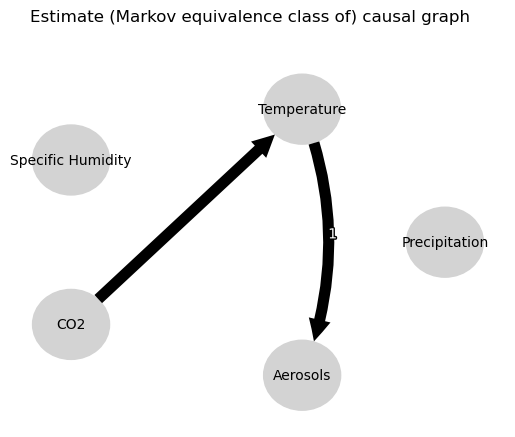

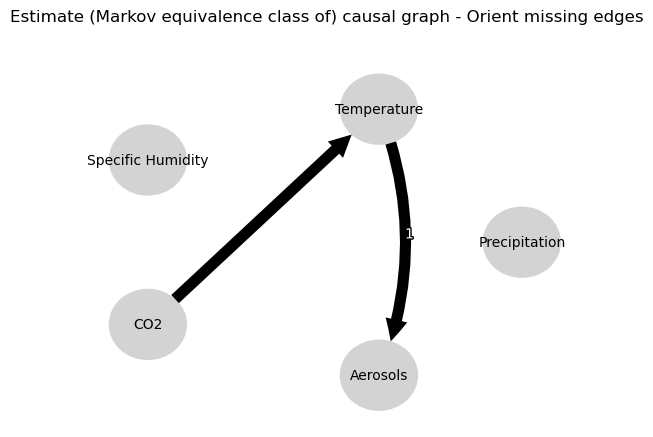

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.33552386202073664
-0.10152262794789432
0.031288517159689985
-0.6805777474327431
-0.4872150562317406
0.48023199511639425
0.04960664922442794
-0.10152262794789432
0.10031354554722767
0.0
-0.04280271943879022
-0.03422630168843697
-0.021075638785692293
-0.12041718877028136
0.017622560404211476
-0.6805777474327431
-0.4062036311800503
-0.03422630168843697
-0.0019130367374616513
0.0
0.5799532694248675
-0.3526873295822886
0.003185258488761014
0.48023199511639425
0.20079033133271956
-0.12041718877028136
0.0384800121446143
-0.3526873295822886
-0.27745444492528737
0.0
0.01944656018753124


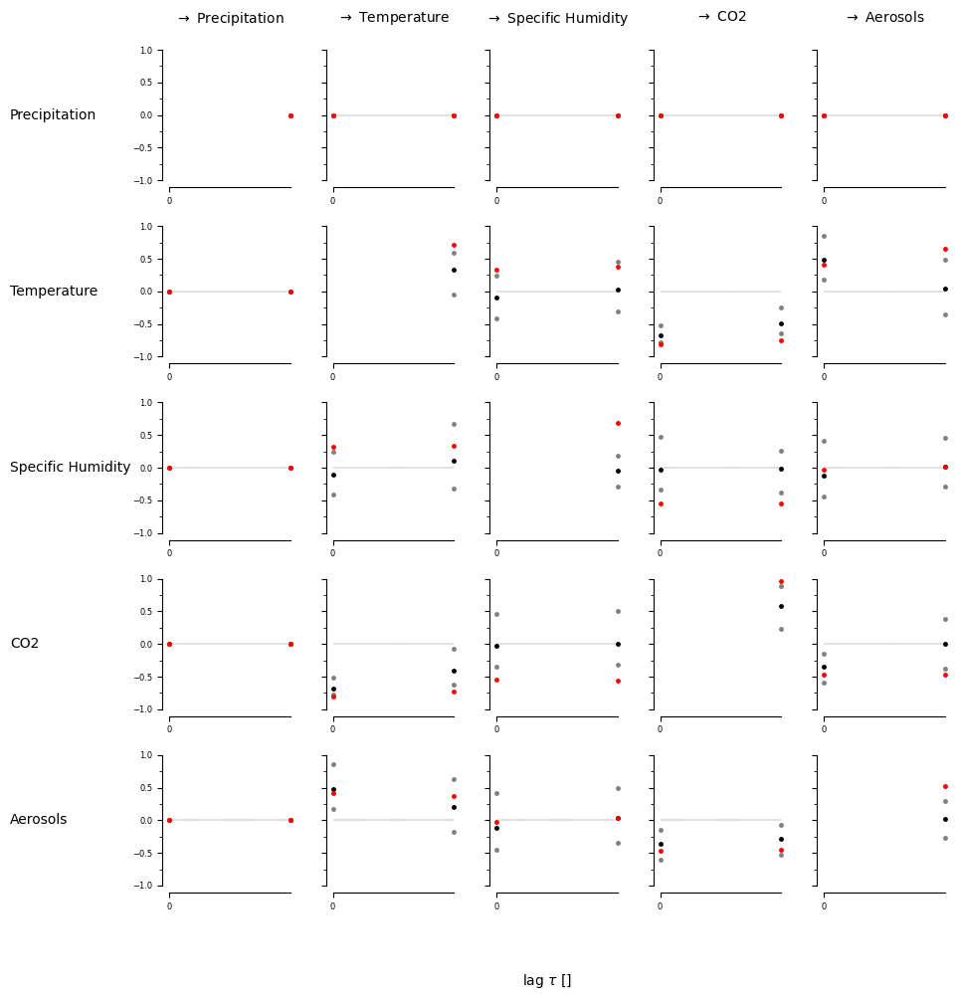

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


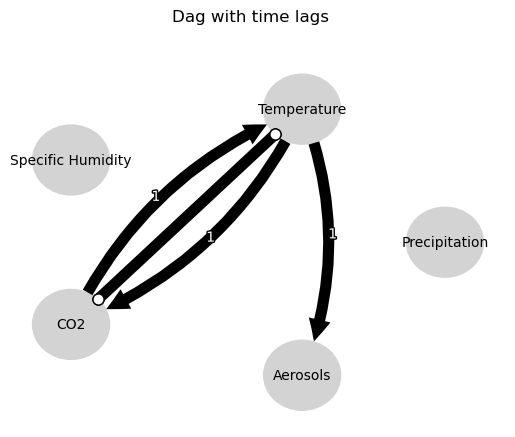

Negative precipitation values in event 87: 0


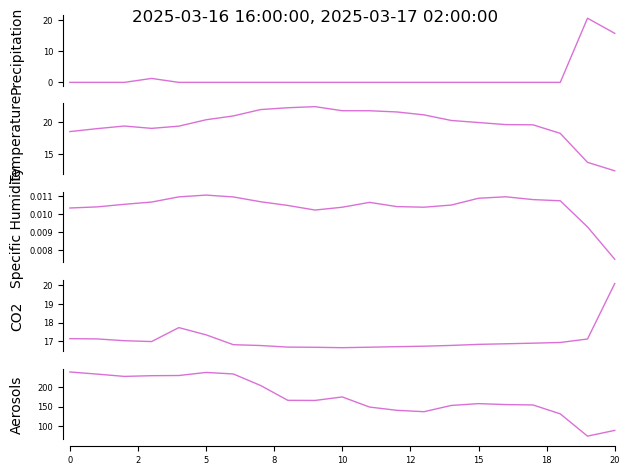


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


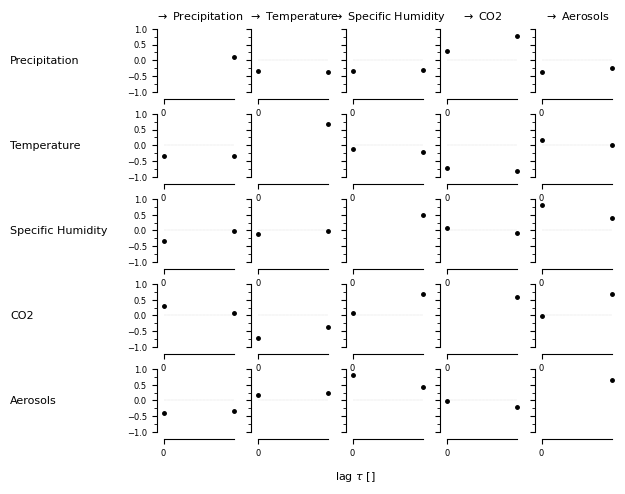

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00193, |min_val| =  0.664

    Variable Specific Humidity has 1 link(s):
       

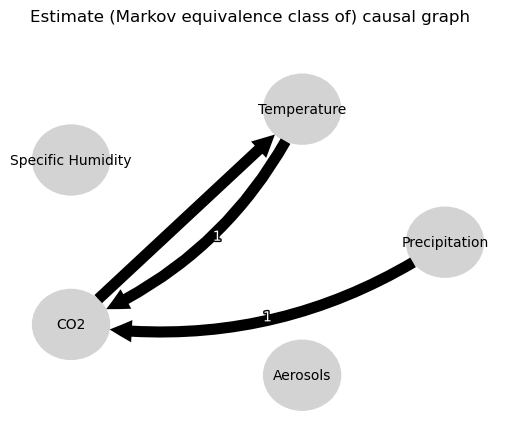

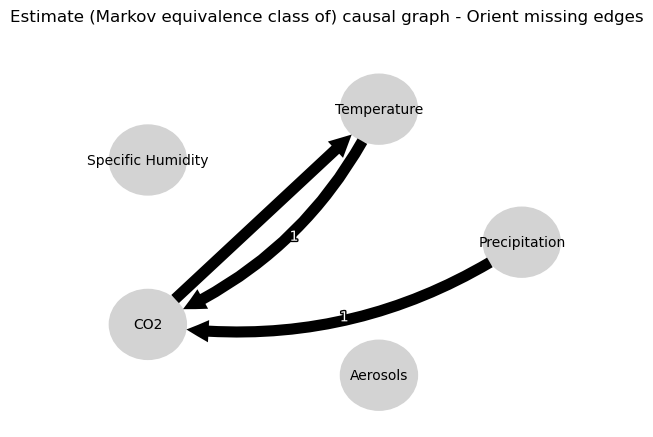

0.0
-0.07638298120524784
-0.23565295992784252
-0.5529380017439295
-0.6299365340582281
0.030302082169692327
-0.10759347694573648
0.829493506931816
-0.11483068173252838
-0.1268145764127442
-0.23565295992784252
0.08021508630028927
0.0
0.3382866116275325
-0.014335600564950837
-0.08554694459842463
-0.5783876079109057
-0.48107156412032487
0.1901989450225491
0.18636401735086958
-0.014335600564950837
0.4129303371119156
0.0
-0.011682549894743906
0.07017592319168324
-0.5066498649910129
0.0259213868438708
0.040777223244277634
-0.5783876079109057
-0.0997364583861211
0.07017592319168324
0.0986419854352426
0.0
0.12291571594236585
-0.11138148890330432
-0.07645655170329071
0.1901989450225491
0.03772403132562617
0.0259213868438708
-0.00924912846640071
-0.11138148890330432
-0.16402881896936808
0.0
0.5425985212223005


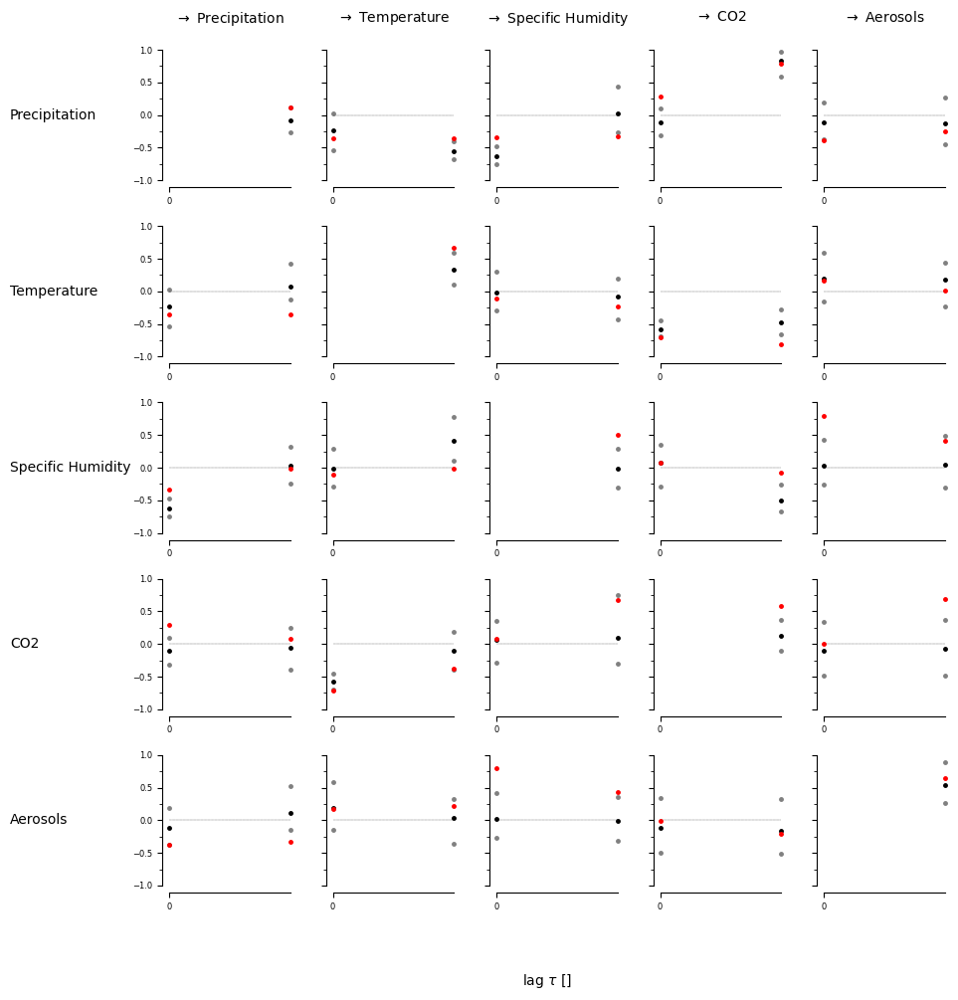

[[[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [ True False]]

 [[False False]
  [ True False]
  [False  True]
  [False  True]
  [False  True]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False  True]]]


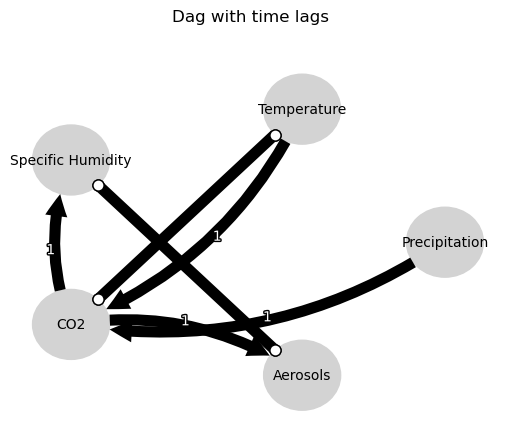

Negative precipitation values in event 88: 0


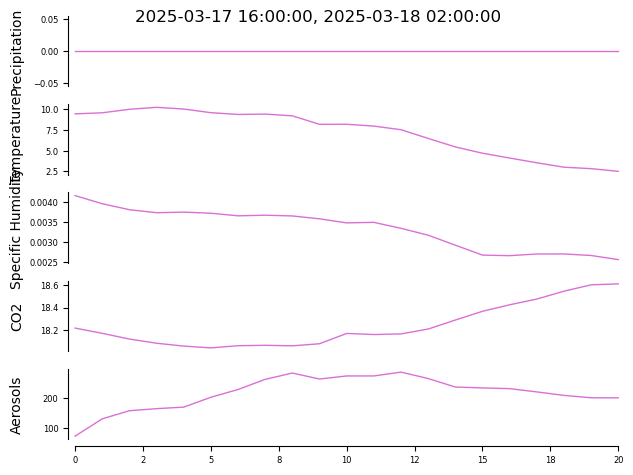


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


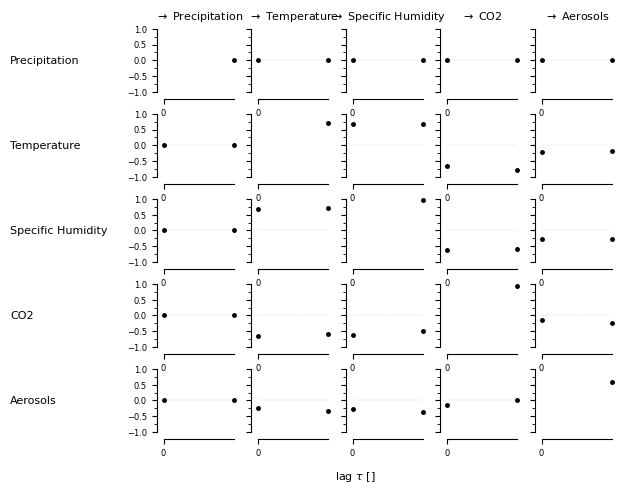

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 2 link(s):
        (Temperature -1): max_pval = 0.02516, |min_val| =  0.525
        (Specific Humidity -1): max_pval = 0.03992, |m

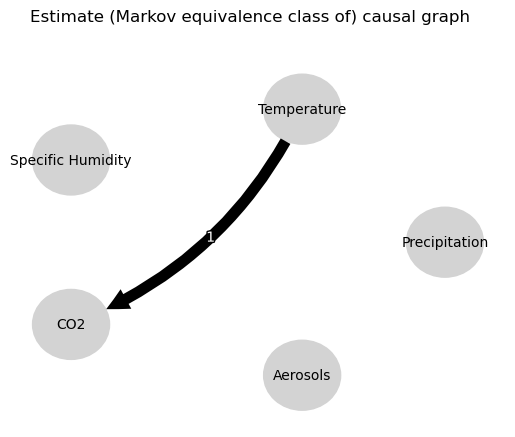

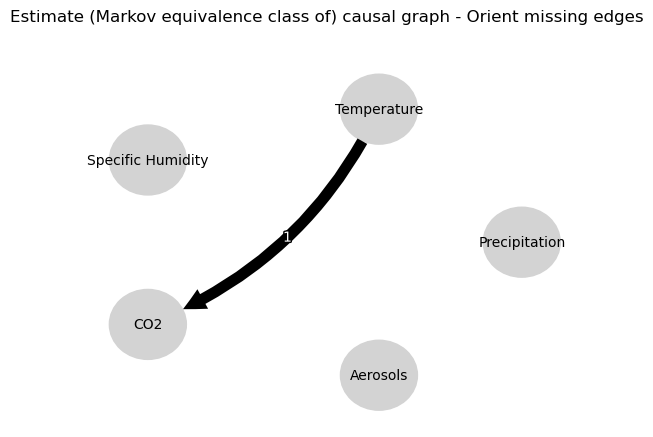

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.03713076861997107
0.018235503577851326
0.013066043734432643
0.14577492229936212
-0.6839112264750277
-0.14415863457743652
-0.031006882818282646
0.018235503577851326
-0.07375210106492737
0.0
0.5009111804195947
0.00670065139683564
-0.0135150427197365
0.006479548205931157
-0.04074245356411841
0.14577492229936212
0.10670426061052055
0.00670065139683564
0.0021042243430969164
0.0
0.1946694104170291
-0.021912470750070124
-0.01300486698737015
-0.14415863457743652
-0.0005605786696799675
0.006479548205931157
-0.02204216627795453
-0.021912470750070124
0.10675544898383184
0.0
-0.045829378279399216


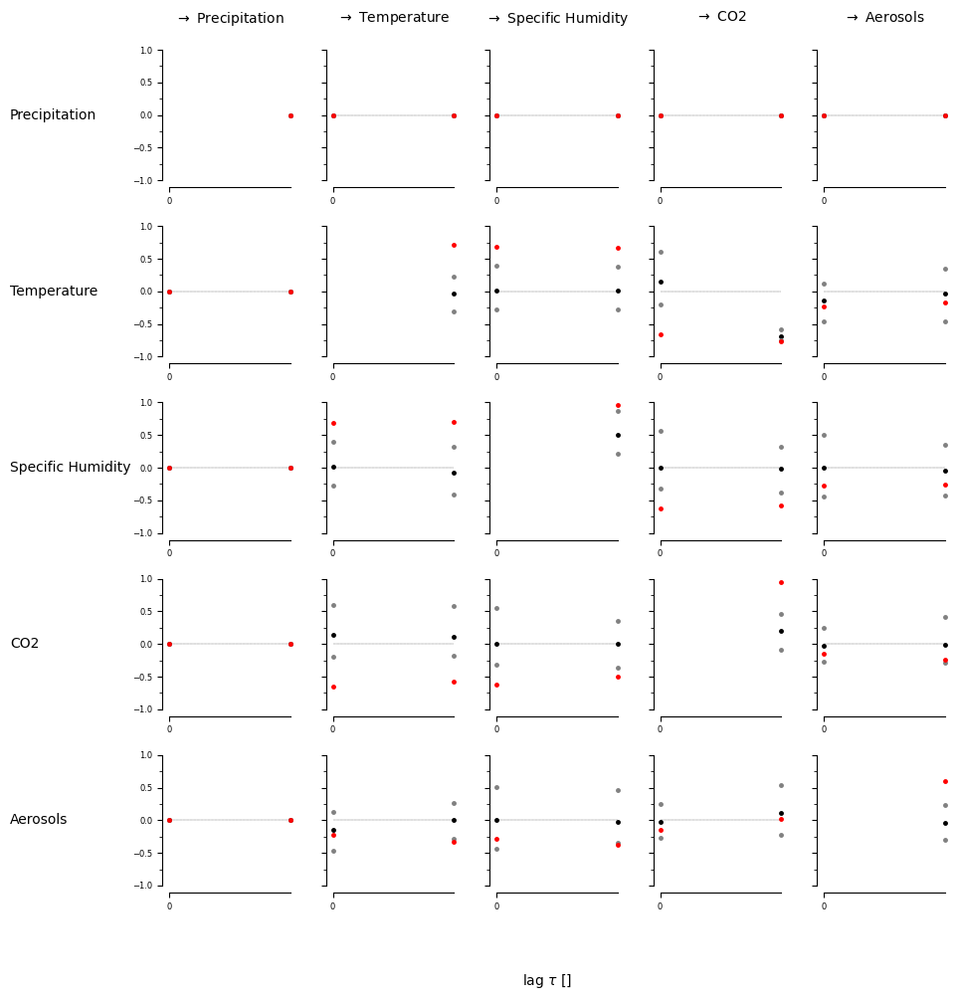

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True False]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


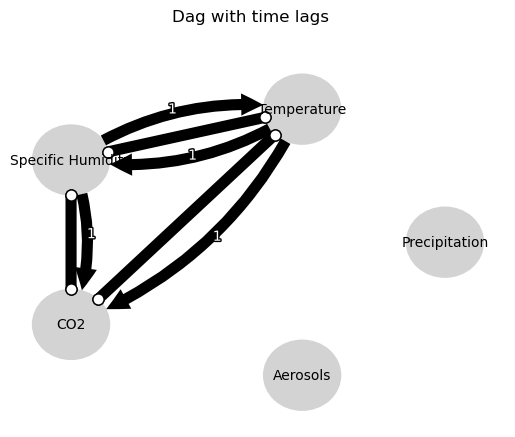

Negative precipitation values in event 89: 0


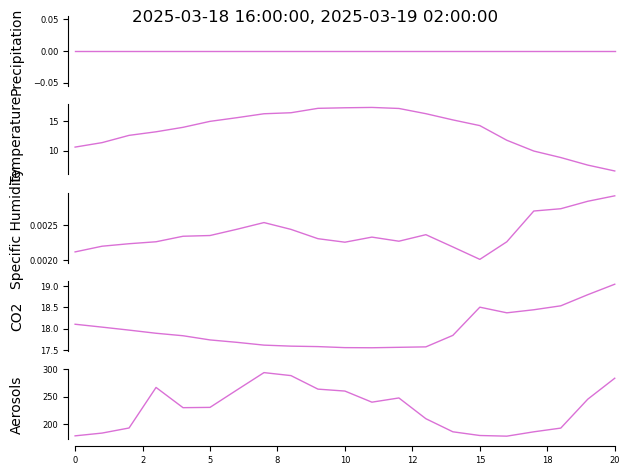


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


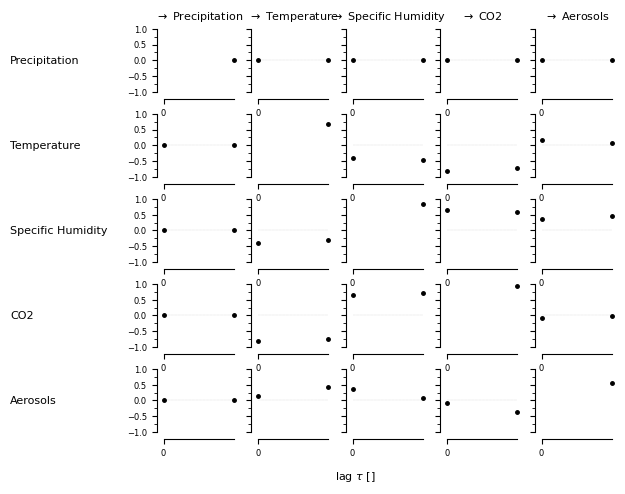

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 2 link(s):
        (Specific Humidity -1): max_pval = 0.00013, |min_val| =  0.781
 

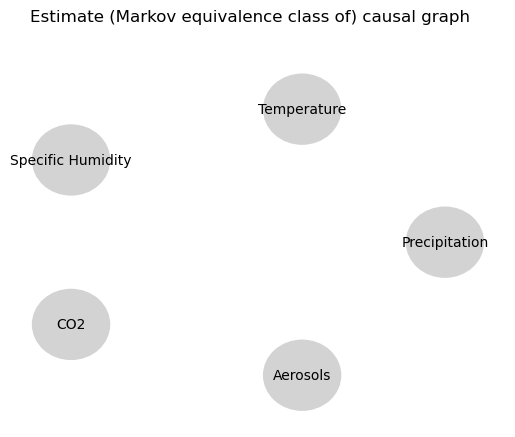

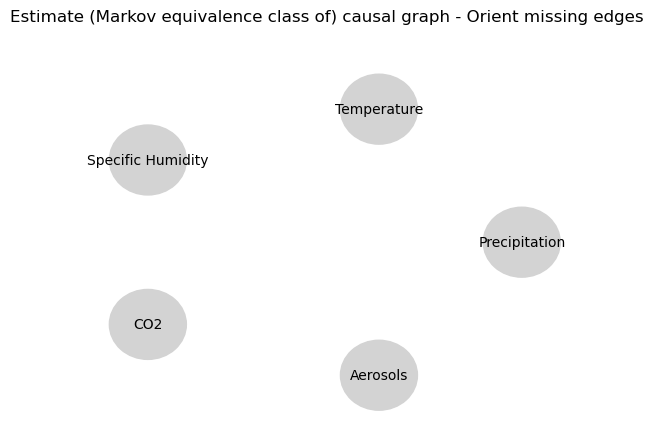

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.08929324407702782
-0.2648549892249875
-0.11429801694277084
-0.06868826163324017
-0.11245394793023548
-0.12140207129650232
-0.07677324573166021
-0.2648549892249875
0.0593347708911565
0.0
0.46840082912413145
-0.10731083247352222
-0.031512543803297106
0.09735211808157233
0.0987302657812473
-0.06868826163324017
0.029700840223018683
-0.10731083247352222
-0.027757904378455208
0.0
0.7151894323607985
-0.03901736455518446
-0.03510462262073606
-0.12140207129650232
0.046554680325459376
0.09735211808157233
0.09326328080772874
-0.03901736455518446
-0.02476074026616303
0.0
0.4719340320796767


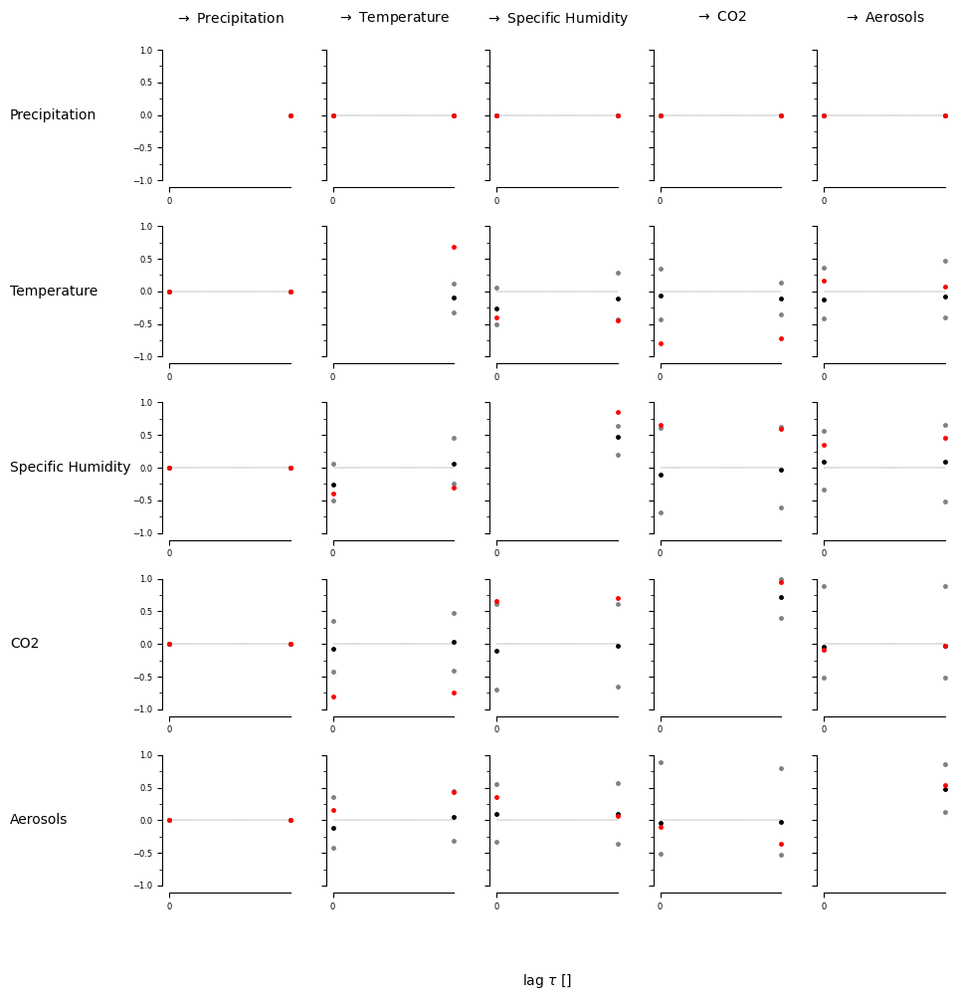

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


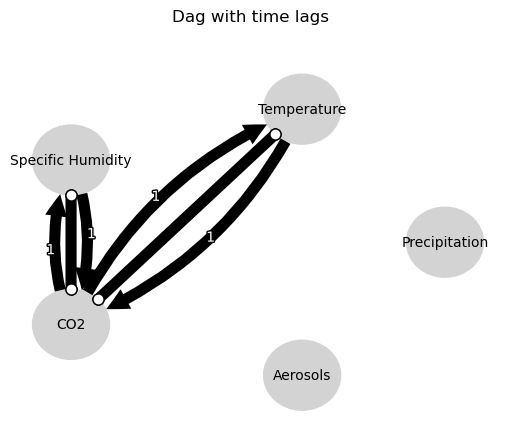

Negative precipitation values in event 90: 0


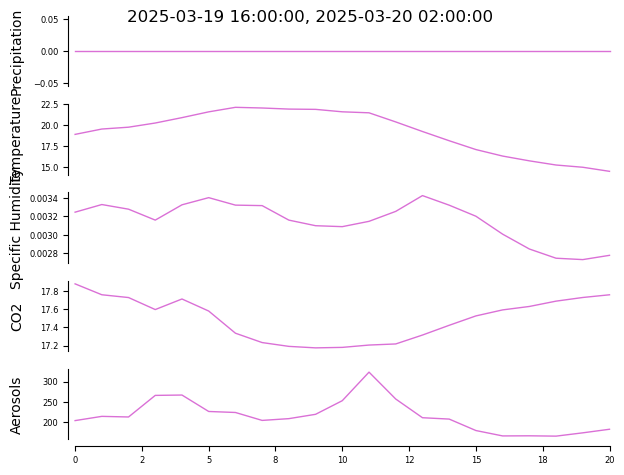


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


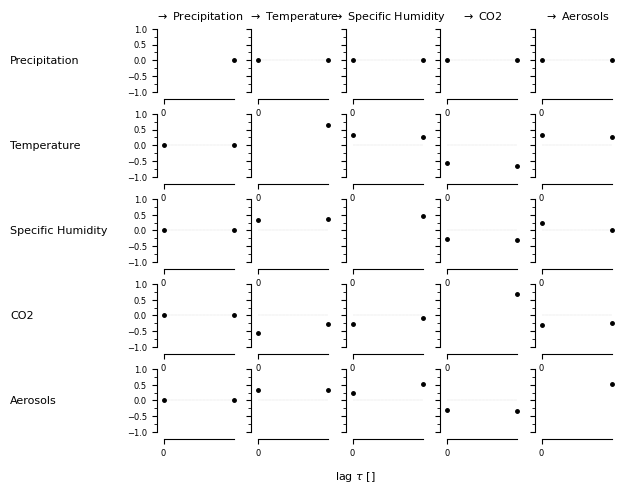

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00227, |min_val| =  0.656

    Variable Specific Humidity has 1 link(s):
       

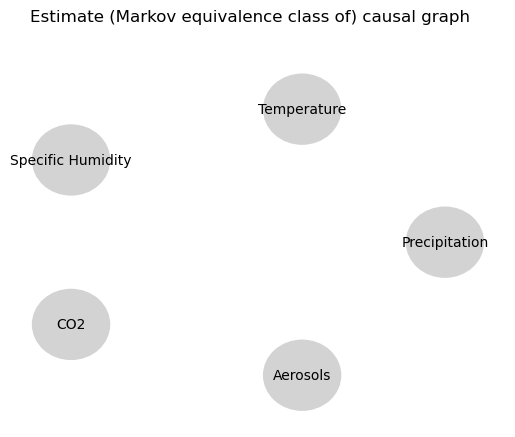

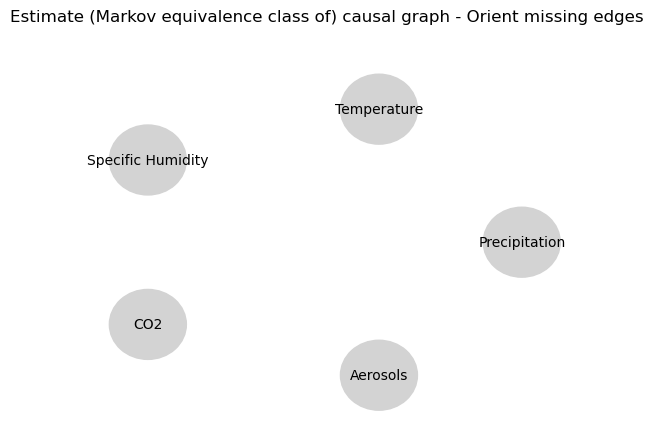

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.7242602080383675
-0.0005193248529776248
-0.01483092636480218
0.03421186795683819
-0.1063595459732782
0.061588063367300334
-0.09351859757600932
-0.0005193248529776248
-0.014166834104262758
0.0
-0.07332100020547208
-0.27405631136796427
0.01744291294864803
-0.036742775872545916
-0.0392243589662163
0.03421186795683819
0.04852889512714846
-0.27405631136796427
-0.007439511640877261
0.0
-0.04868745073168744
-0.06572016963242809
-0.04057705972960725
0.061588063367300334
0.04508586078778527
-0.036742775872545916
0.05124254108879398
-0.06572016963242809
0.00805520076551473
0.0
0.42301431345282836


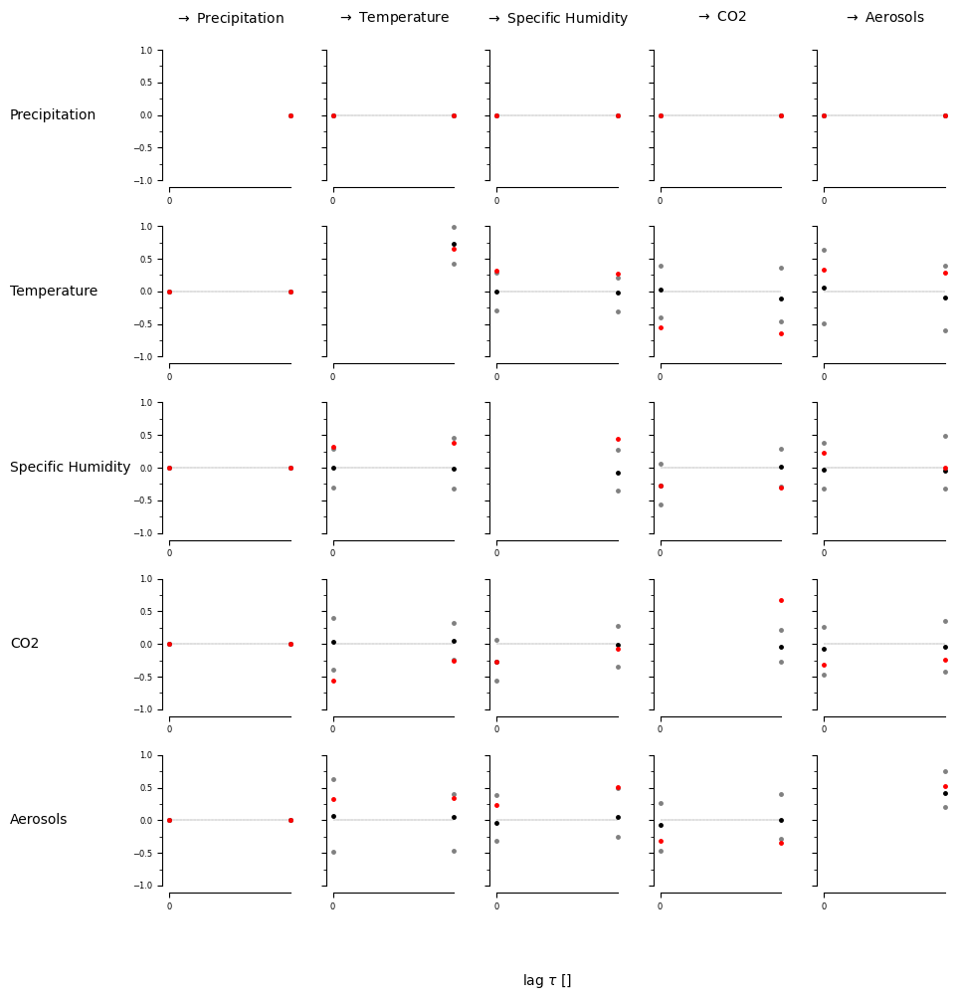

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


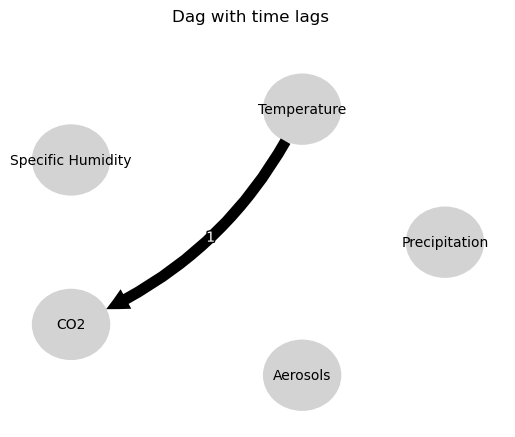

Negative precipitation values in event 91: 0


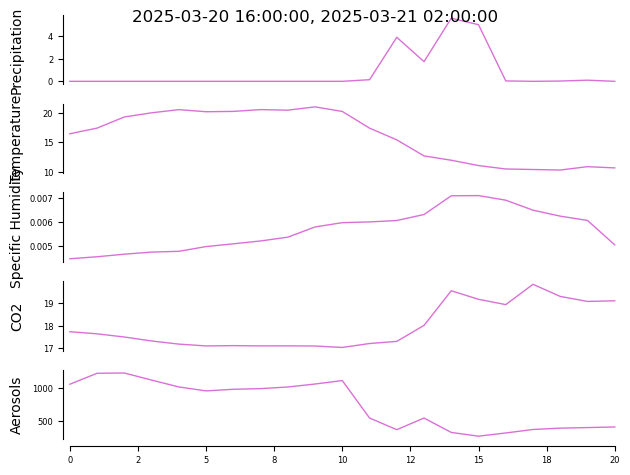


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


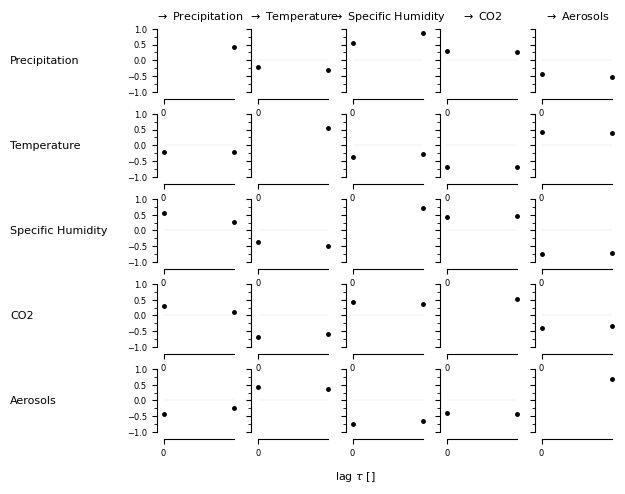

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Precipitation -1): max_pval = 0.00007, |min_val| =  0.801

    

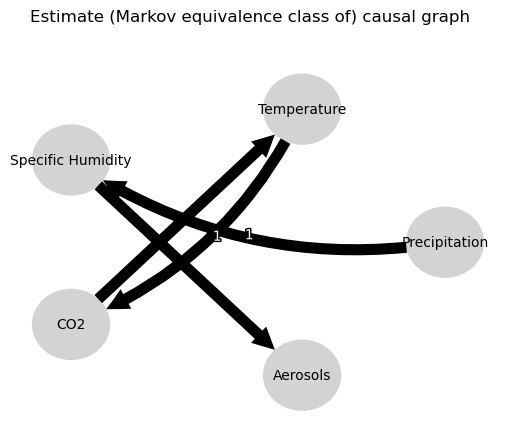

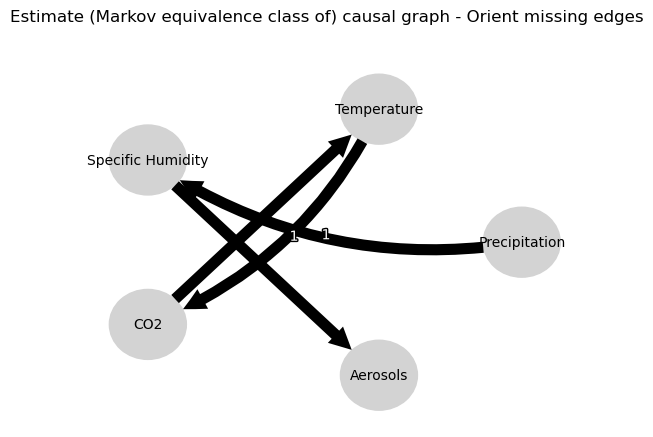

0.0
-0.09779322440491013
-0.15832948091123644
-0.12308410764575844
0.10690273482636634
0.5857699891600741
0.02378759818667883
0.08488091559650243
-0.1017009147574139
-0.3789637758447124
-0.15832948091123644
0.08290131630538161
0.0
0.5408374435043327
-0.1889595663561982
-0.03313183206500066
-0.4822816152414015
-0.6455465886397083
0.23497836685078546
-0.00993231432245543
-0.1889595663561982
-0.1498637511492006
0.0
0.035386605838442865
0.15601775678912952
0.1652102401571384
-0.6347265688980107
-0.04079383839782313
-0.4822816152414015
-0.3398996168457469
0.15601775678912952
-0.038150577153850555
0.0
0.36694436778382067
-0.0352854372827911
0.03257260545718118
0.23497836685078546
0.20604313953637296
-0.6347265688980107
-0.0017824897324956142
-0.0352854372827911
-0.2001794186983563
0.0
0.006097863208554136


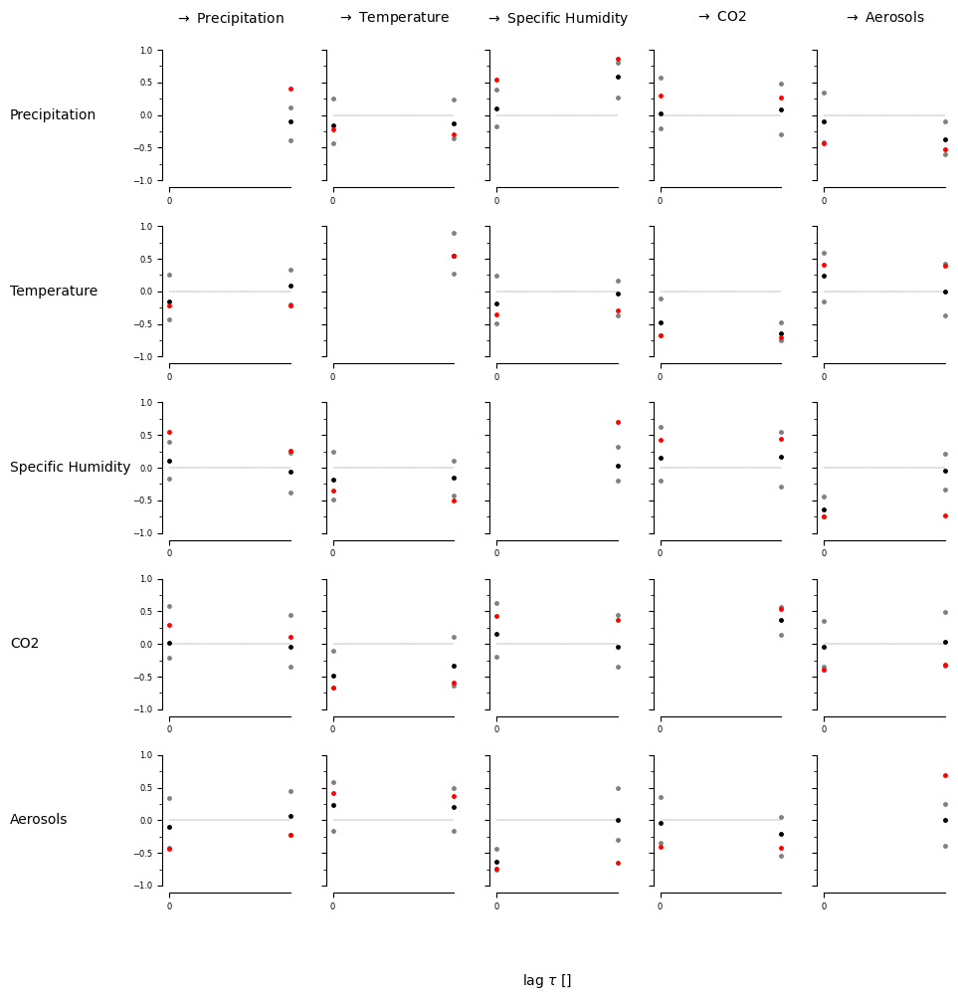

[[[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [ True  True]
  [False False]
  [False  True]]]


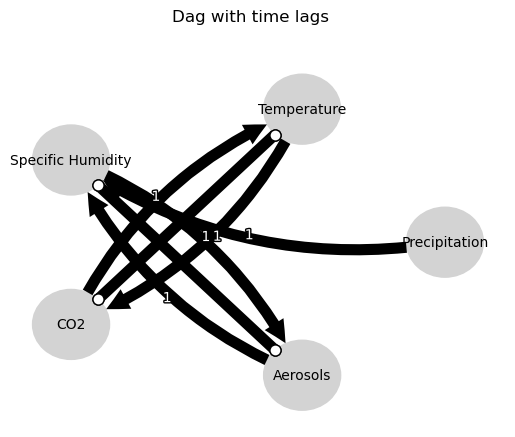

Negative precipitation values in event 92: 0


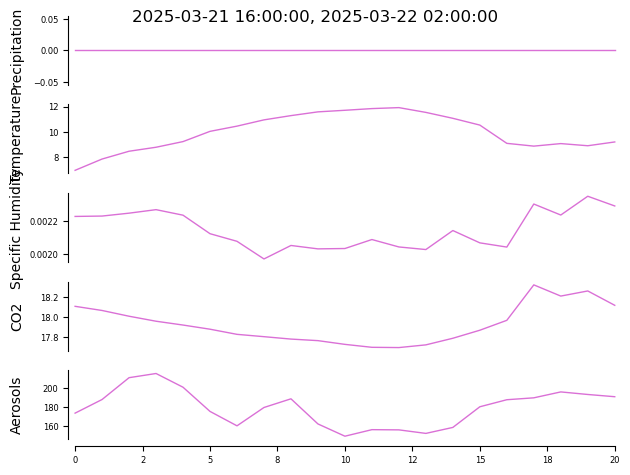


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


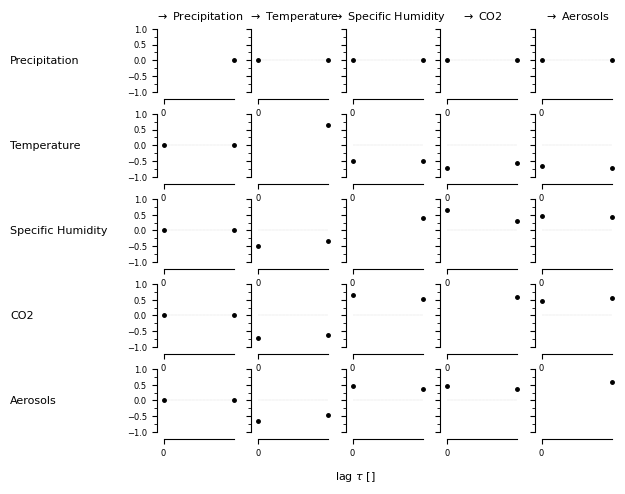

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 0 link(s):

    Variable Aerosols has 1 link(s):
 

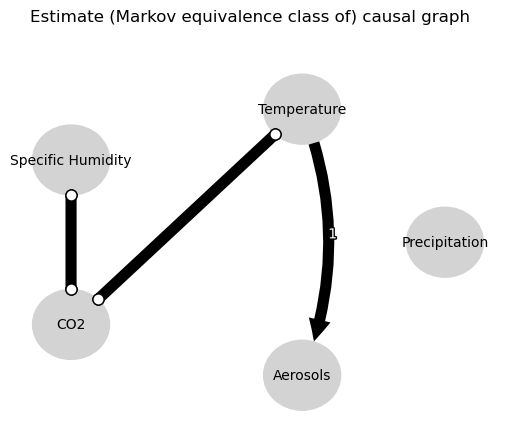

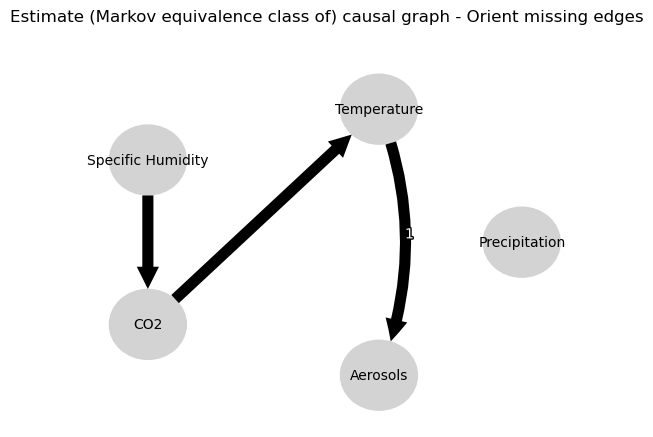

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.018205057060376482
-0.6186444632484492
-0.0067663391061625455
-0.6683043604192197
-0.02310598331065024
-0.10664236450716907
-0.6177618470834244
-0.6186444632484492
-0.004942123592496244
0.0
-0.06389374903913468
0.7598634034432027
-0.037280372920885464
0.019600359272889244
0.5253198175704299
-0.6683043604192197
-0.015089971853268576
0.7598634034432027
-0.023372091405391576
0.0
-0.04135380308669312
0.07569279790768971
0.5118629077785262
-0.10664236450716907
0.0526754453684158
0.019600359272889244
-0.018423206263276693
0.07569279790768971
-0.010526522208180171
0.0
0.020678459509901072


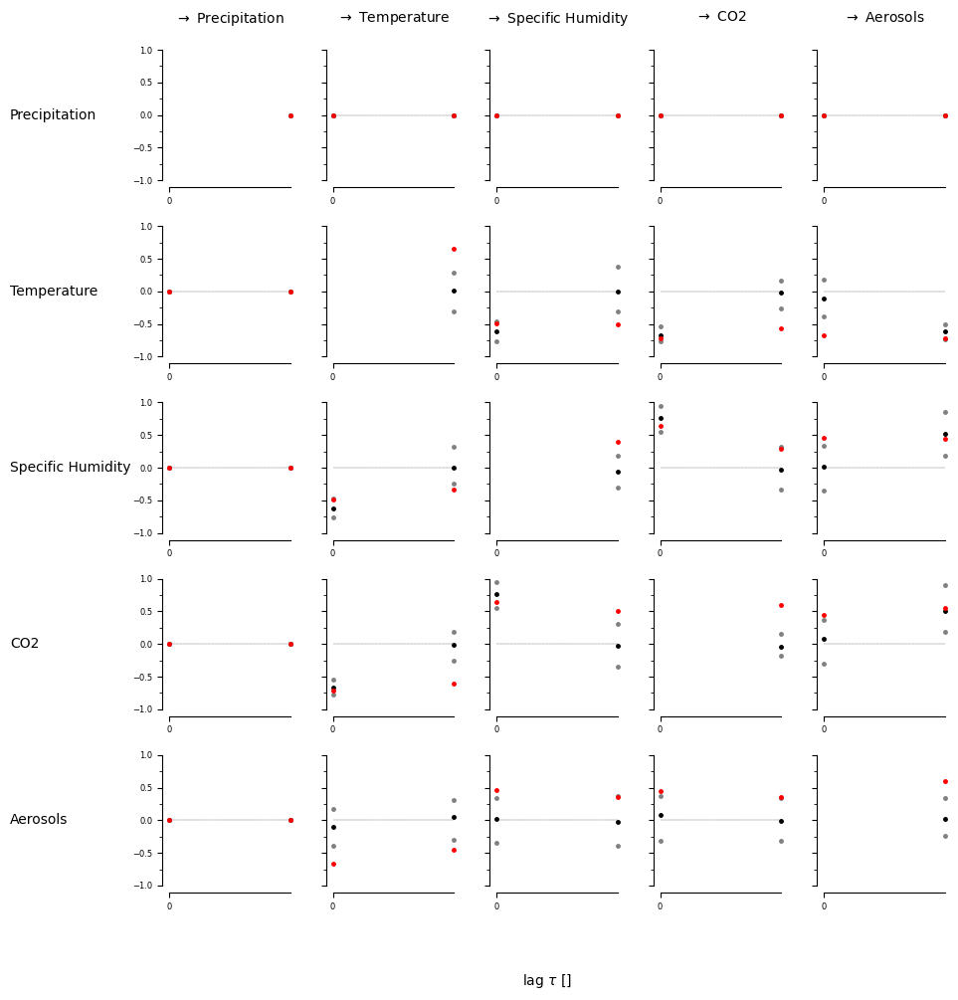

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True False]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [ True  True]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False False]
  [False  True]]]


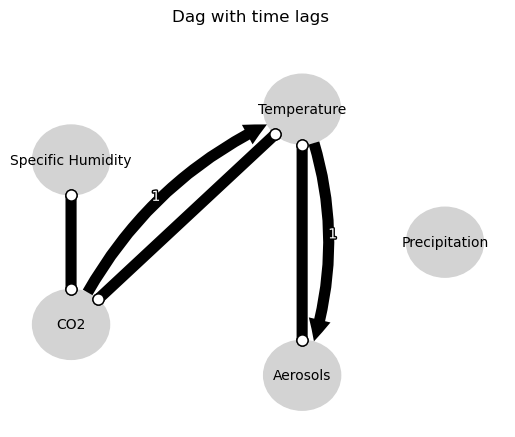

Negative precipitation values in event 93: 0


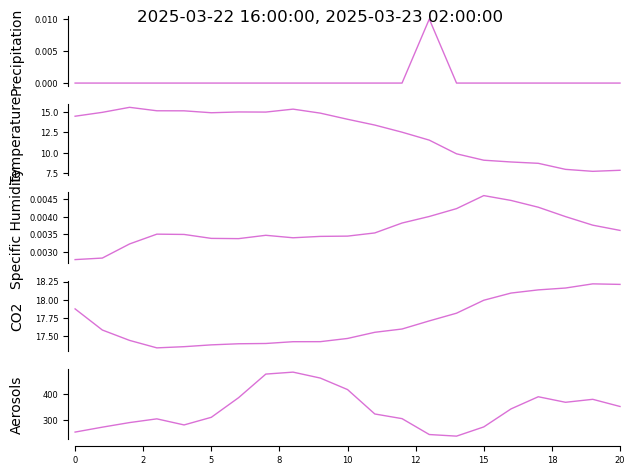


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


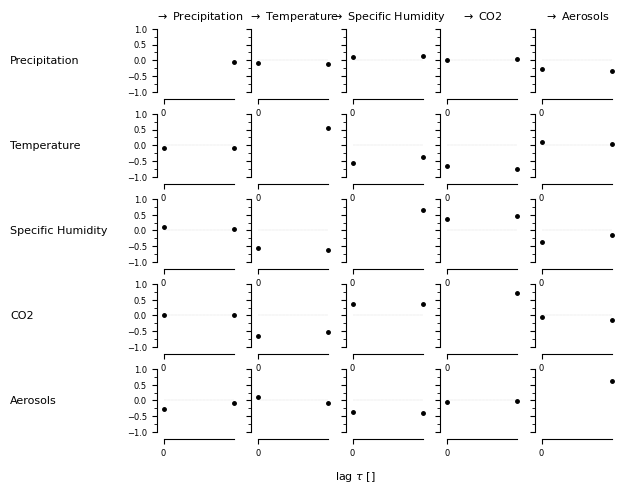

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00322, |min_val| =  0.639



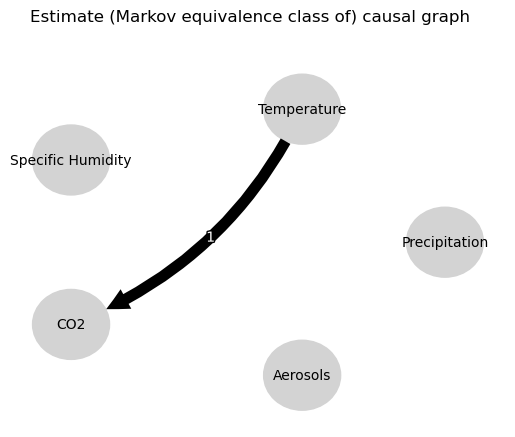

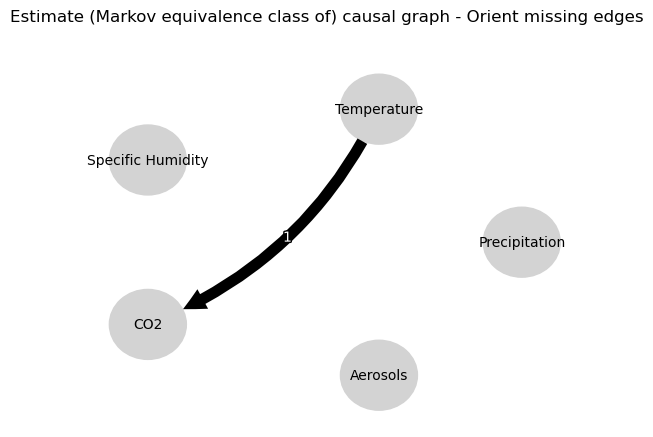

0.0
-0.0321330420244628
-0.015353970507455067
0.01774409077537221
0.18318706769787746
0.0258158838889186
-0.010005181211206443
0.000833264023403744
-0.20341683685151665
-0.1418128972176088
-0.015353970507455067
0.02841769707826512
0.0
-0.029201447397899007
0.07081203820617978
0.03825470561315669
0.03095974372505678
-0.8045165700521463
-0.011523891266594814
0.007842135928249871
0.07081203820617978
0.005684214702483617
0.0
0.42585545134929814
-0.04920143757760747
-0.07050477694845639
-0.15702312194902426
-0.09646787167179423
0.03095974372505678
0.08125650228523472
-0.04920143757760747
-0.03492844865755536
0.0
-0.10166039793862015
-0.03460779246008727
-0.0030394193123986072
-0.011523891266594814
-0.022342634841417998
-0.15702312194902426
-0.06788775593389254
-0.03460779246008727
-0.005170147758740362
0.0
0.4977167867670083


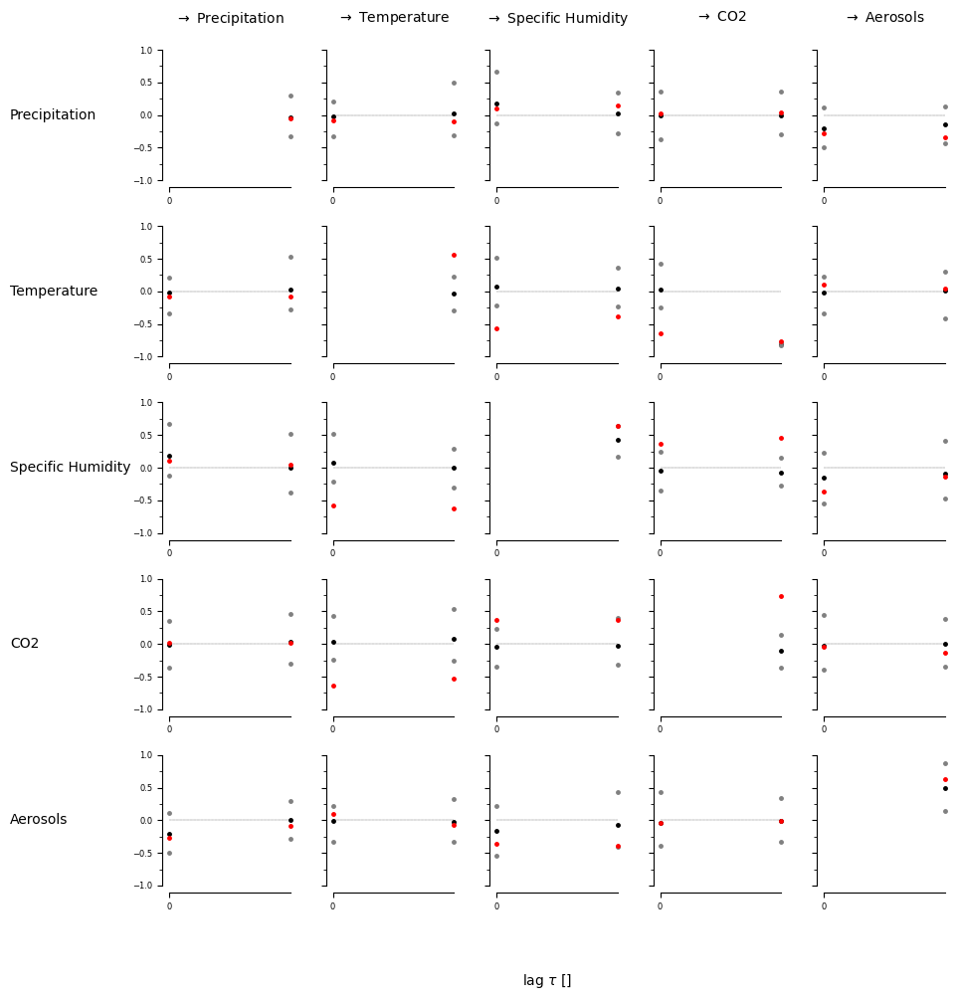

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


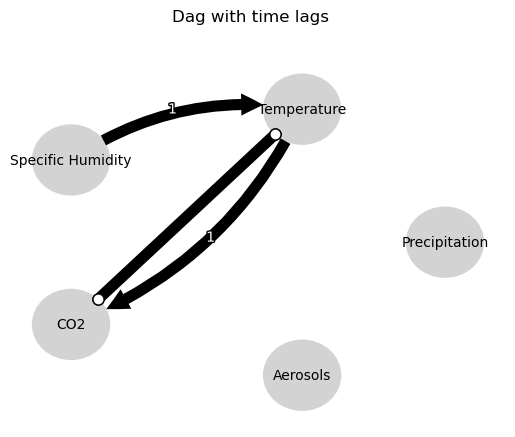

Negative precipitation values in event 94: 0


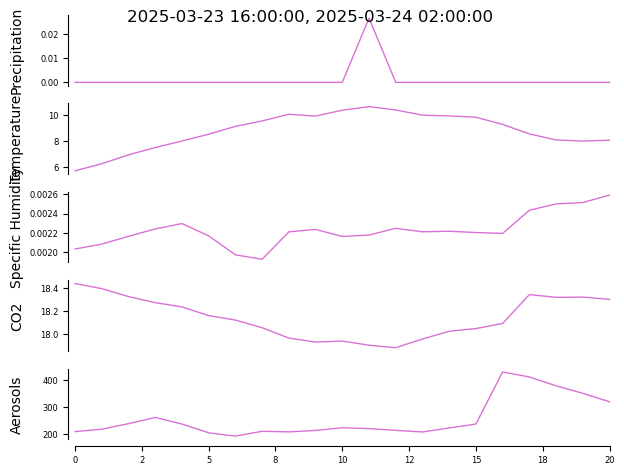


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


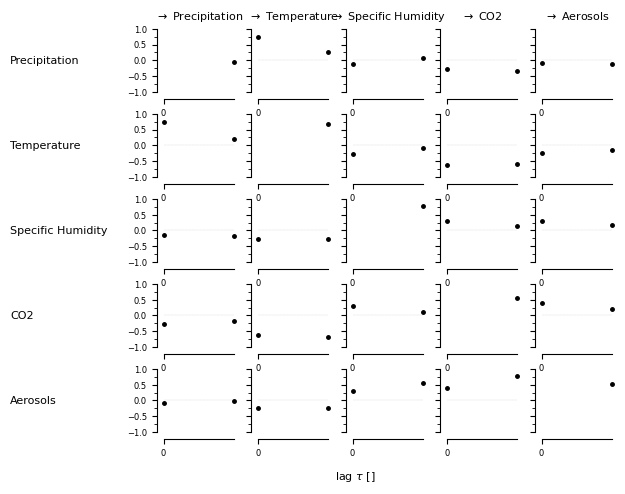

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 2 link(s):
        (Specific Humidity -1): max_pval = 0.00017, |min_val| =  0.772
 

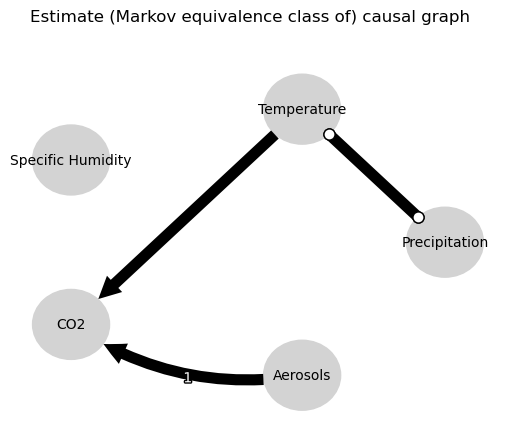

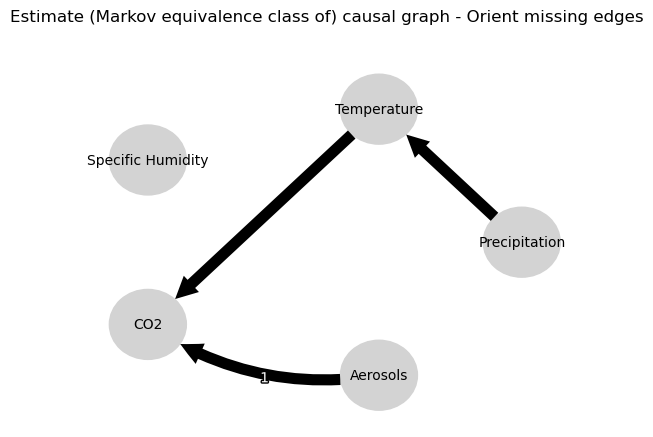

0.0
-0.05386318960828632
0.29349880575459797
-0.028083116422315726
-0.08121648309572062
-0.01527511766126744
-0.2740700054639752
0.021416626867522156
-0.07072269362242173
-0.04940359151164887
0.29349880575459797
0.017904067103918942
0.0
-0.04430328067099756
-0.13210584500031688
-0.09263535571951587
-0.7514312436604786
0.025201256870279017
-0.08095041088250914
-0.03501387157991273
-0.13210584500031688
0.0007646337775756814
0.0
0.49756237616379156
0.09186215004313766
0.024840162254882378
0.019983342704505382
0.0025403797673669254
-0.7514312436604786
0.052523955984564795
0.09186215004313766
0.07446947162307992
0.0
-0.00540876019924962
0.2376054382073683
0.11267519563671655
-0.08095041088250914
-0.038431914770687796
0.019983342704505382
0.0013995717396097433
0.2376054382073683
0.2832746514431511
0.0
0.492533315420769


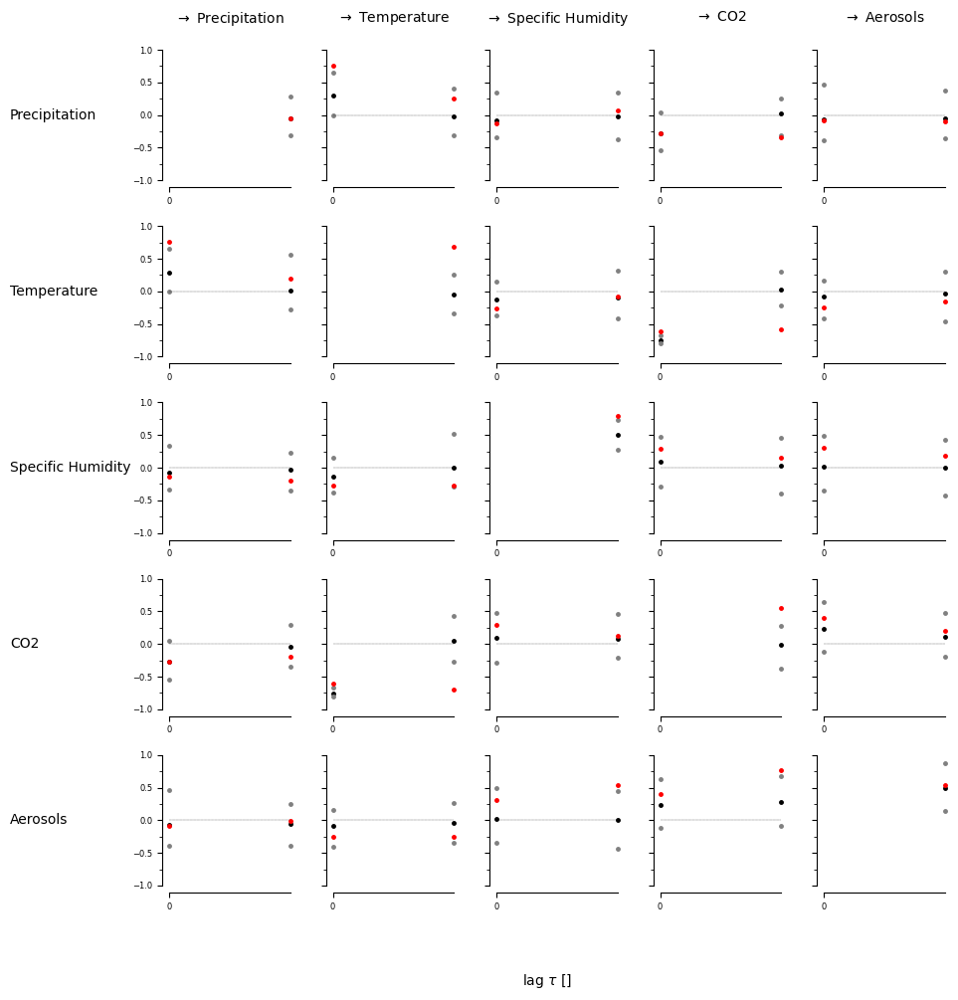

[[[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]

 [[ True False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]]


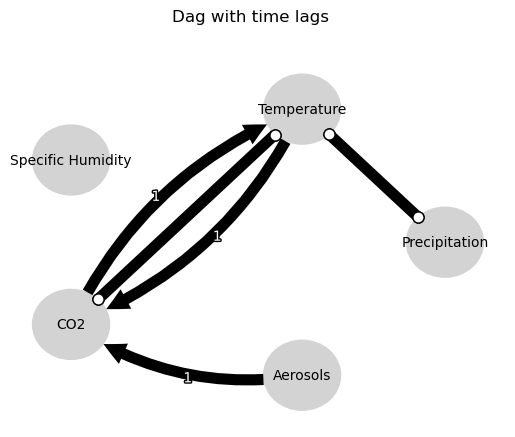

Negative precipitation values in event 95: 0


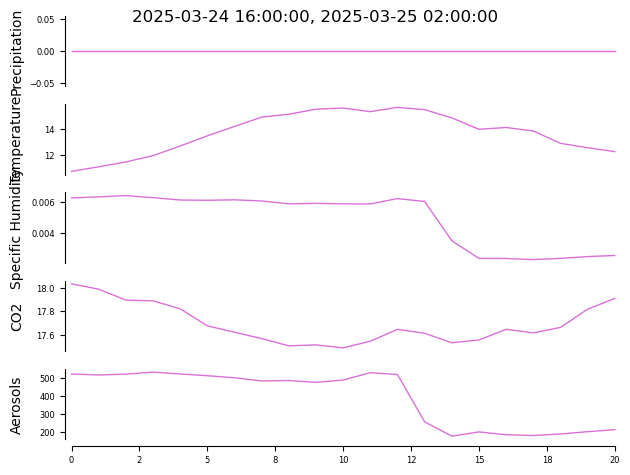


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


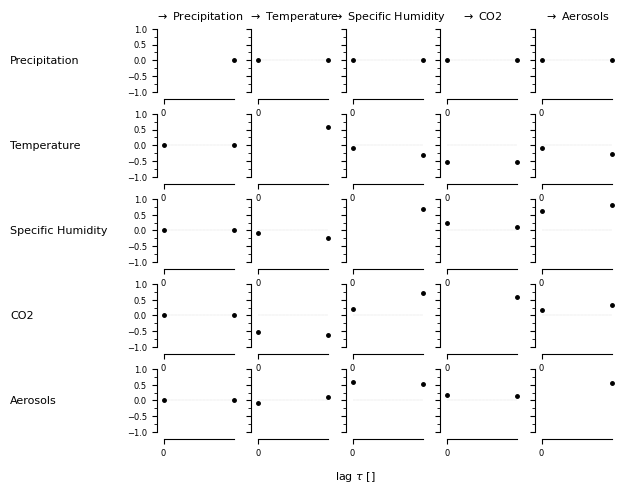

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 2 link(s):
        (CO2 -1): max_pval = 0.01111, |min_val| =  0.583
        (Specif

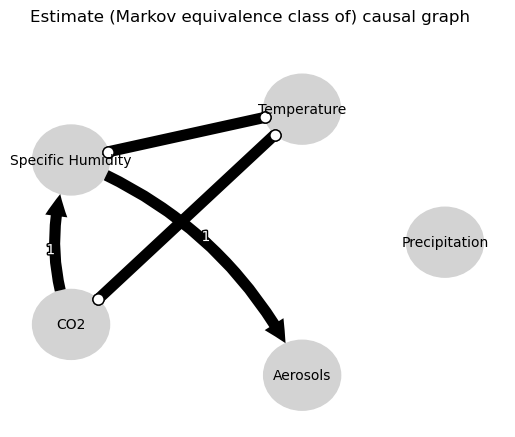

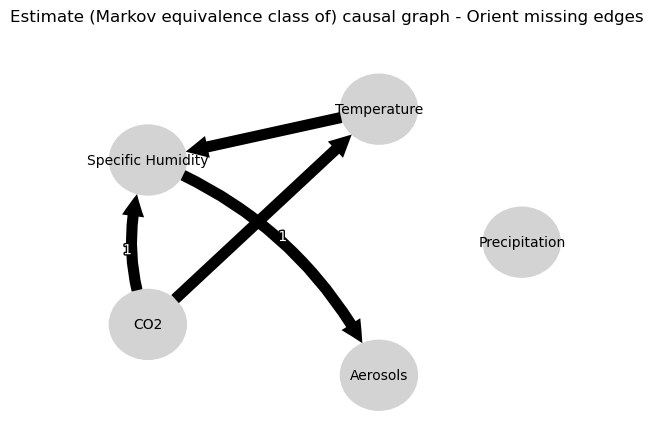

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.08429913056190227
0.5601734833319616
-0.5519279863135141
-0.7241337033776564
0.11470444979499797
0.006883647779008361
0.5599337945549886
0.5601734833319616
0.011403010811779328
0.0
-0.3408941703128956
-0.5111154099918788
-0.0014853666607438241
-0.2984909719618994
0.8639816376796584
-0.7241337033776564
0.04964554556581476
-0.5111154099918788
0.6606897361535096
0.0
-0.08934468499411197
-0.006694877858766769
-0.4968568139495955
0.006883647779008361
-0.06898686009730236
-0.2984909719618994
-0.04551379198888303
-0.006694877858766769
0.04065905974636423
0.0
-0.28211126979574785


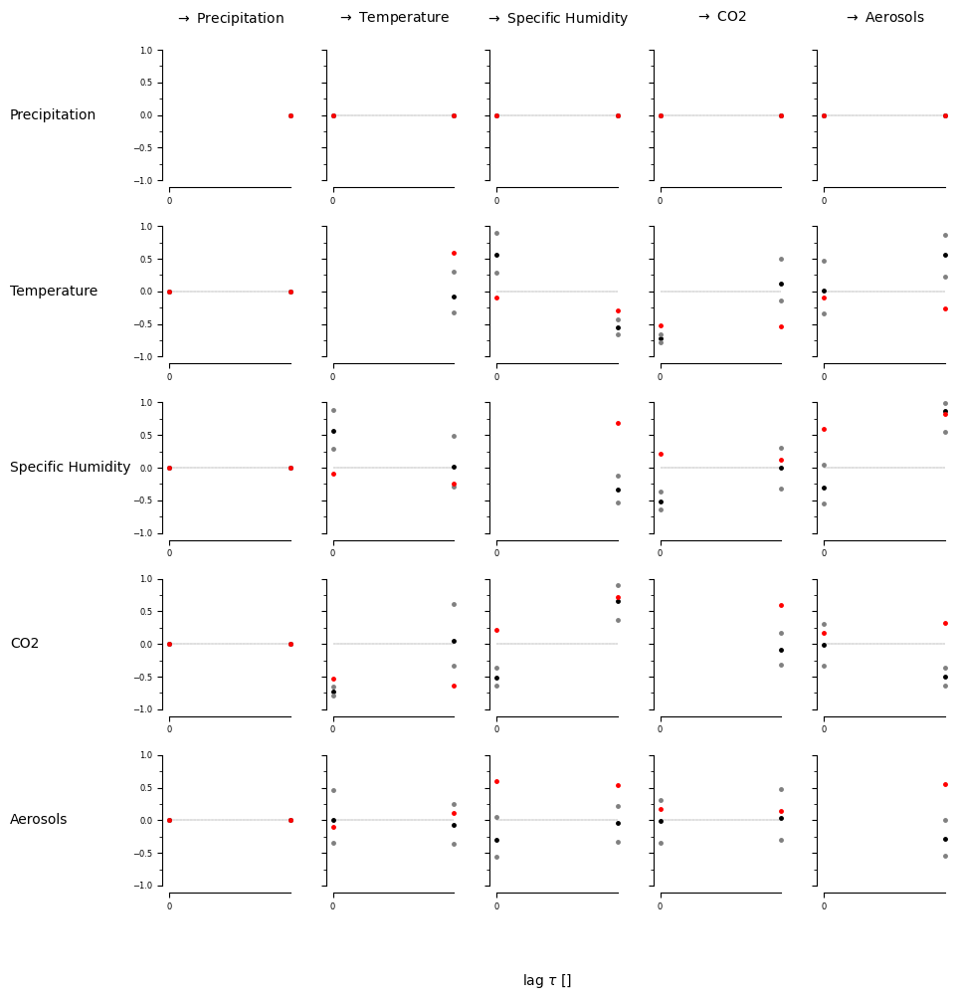

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [False  True]
  [False  True]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False False]]]


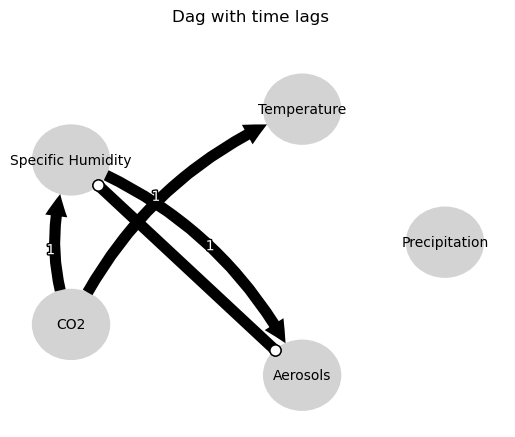

Negative precipitation values in event 96: 0


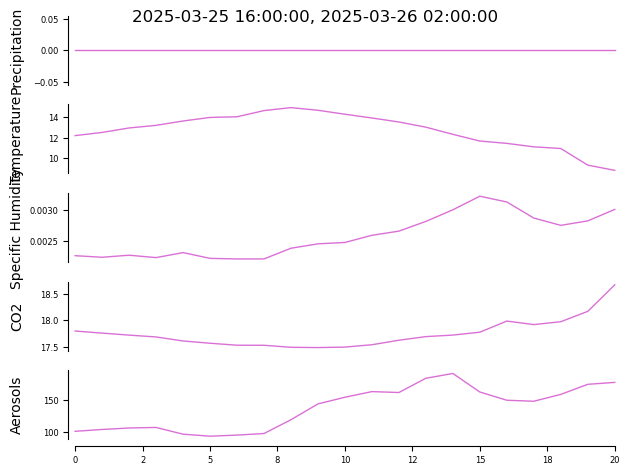


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


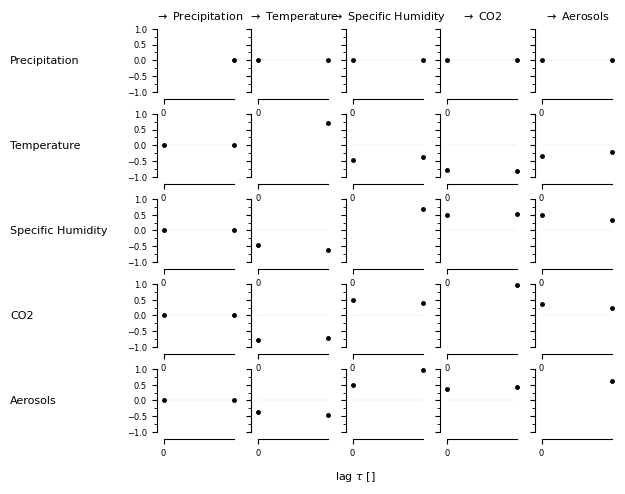

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Specific Humidity -1): max_pval = 0.03719, |min_val| =  0.494

    Variable Specific Humidity has 2 link(s):
 

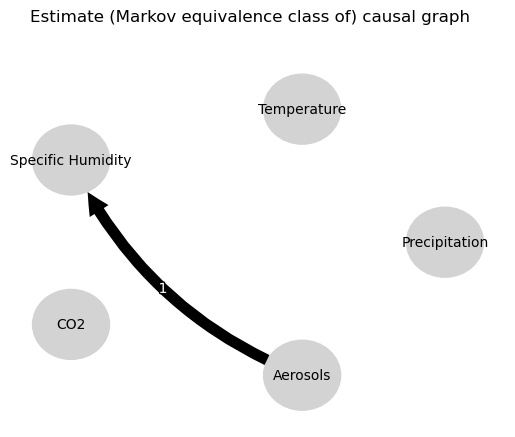

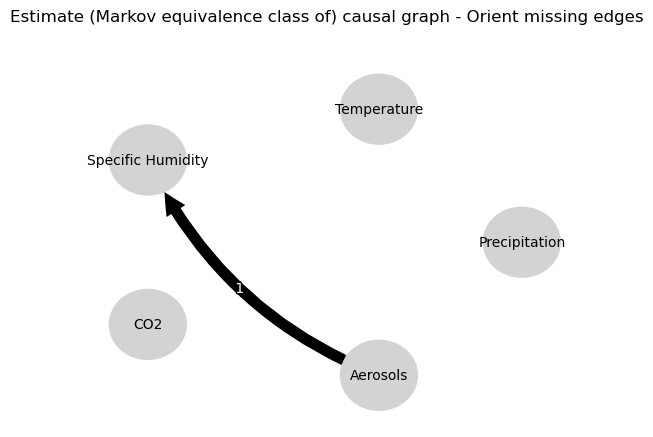

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.07962907889941603
-0.16286798489213006
0.0020914722308404475
-0.09519630744688842
-0.030566470158303573
-0.017208383994531697
0.014210656135072495
-0.16286798489213006
0.05393470082840672
0.0
0.272216756385453
0.012291312017354885
0.01265583475248739
0.356588210177955
0.20838471438178804
-0.09519630744688842
-0.09832801432729778
0.012291312017354885
0.018916256326127662
0.0
0.974136449906197
0.028050805290060085
0.018883951500619164
-0.017208383994531697
-0.04441740784214427
0.356588210177955
0.6900694264753721
0.028050805290060085
0.03497713184765613
0.0
0.5177213679832255


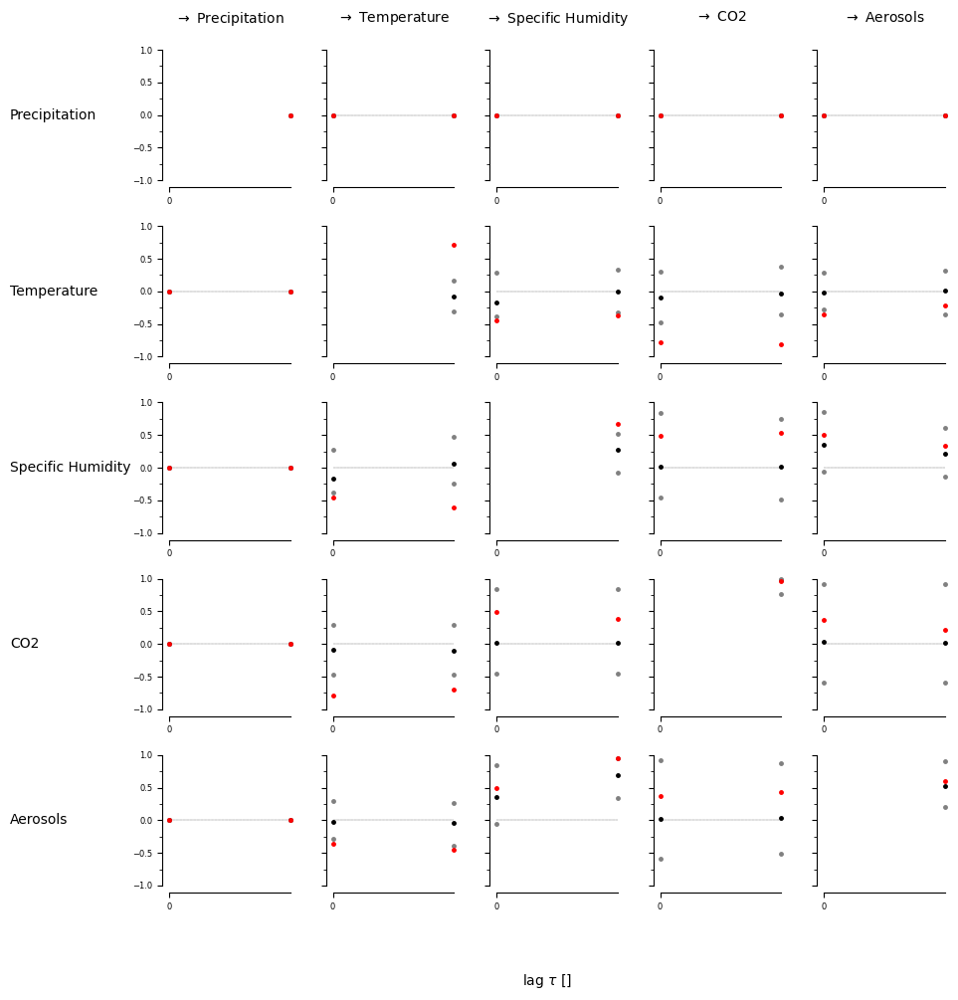

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False  True]]]


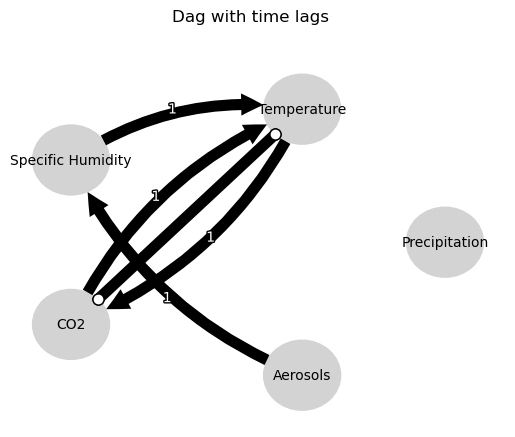

Negative precipitation values in event 97: 0


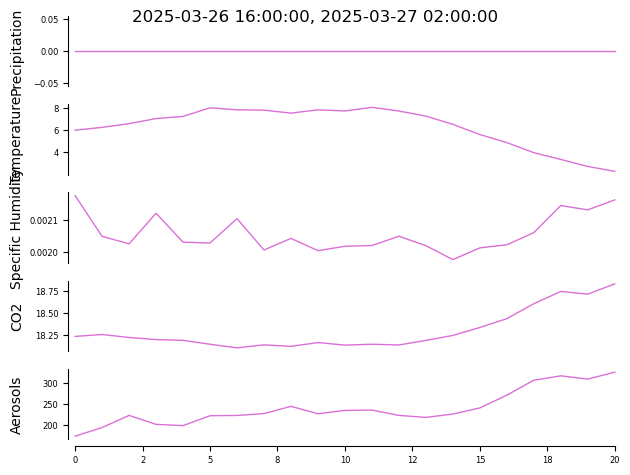


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


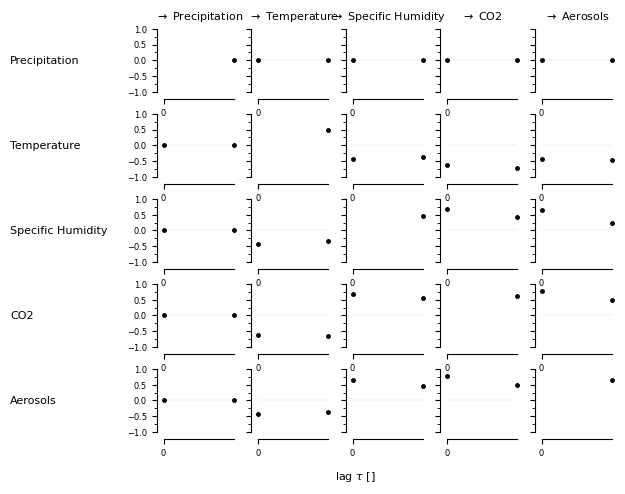

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.02920, |min_val| =  0.514

    Variable Specific Humidity has 1 link(s):
        (CO2 -1

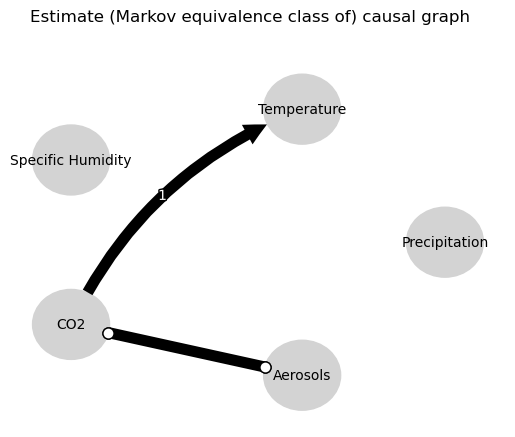

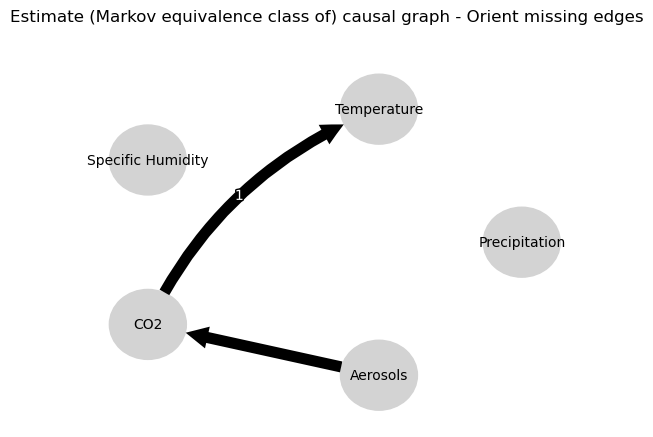

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.042174272020992
0.059476037723793306
0.024441939130363497
-0.03501921044725046
-0.008233646098844074
-0.006017906094016171
-0.05578987477085705
0.059476037723793306
-0.5266897693902878
0.0
-0.05209587686472813
0.6427817190089069
-0.0011465818266246813
0.5071158568241897
-0.019007586492278798
-0.03501921044725046
-0.7789010539069195
0.6427817190089069
-0.03821091491943576
0.0
-0.026333159013090288
0.8301092182163843
-0.03319226306123147
-0.006017906094016171
-0.7025730364594086
0.5071158568241897
-0.01533163409199012
0.8301092182163843
-0.020635499363881166
0.0
-0.045829378279399216


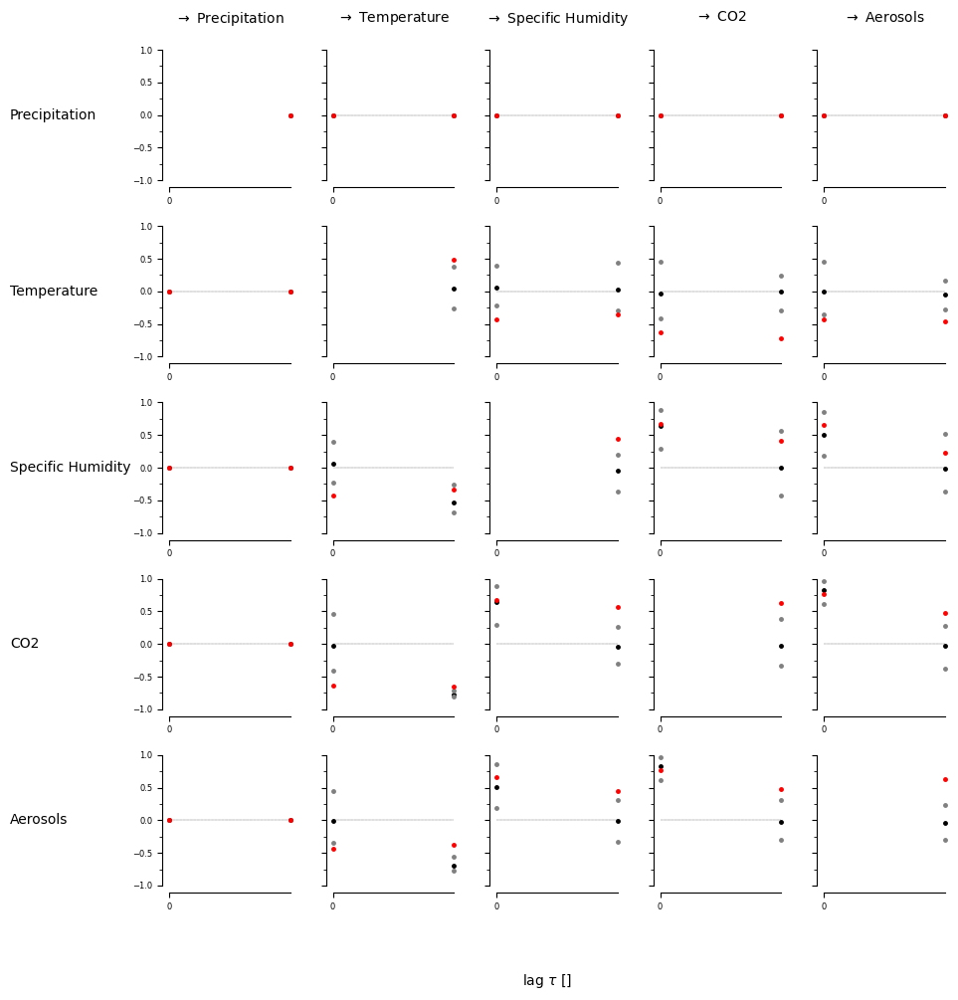

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [ True False]]

 [[False False]
  [ True  True]
  [ True False]
  [False  True]
  [ True False]]

 [[False False]
  [False False]
  [ True False]
  [ True False]
  [False  True]]]


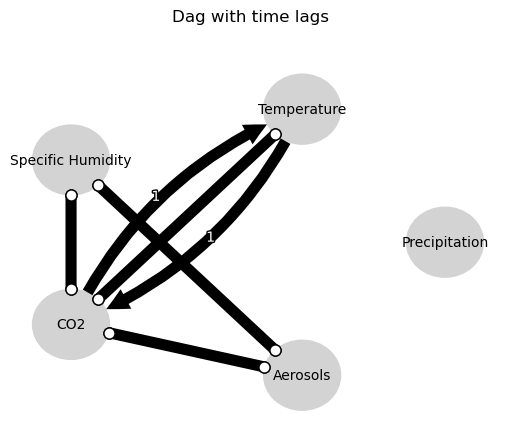

Negative precipitation values in event 98: 0


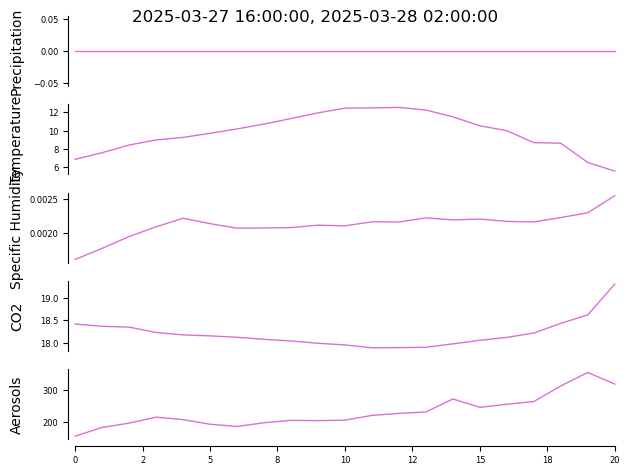


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


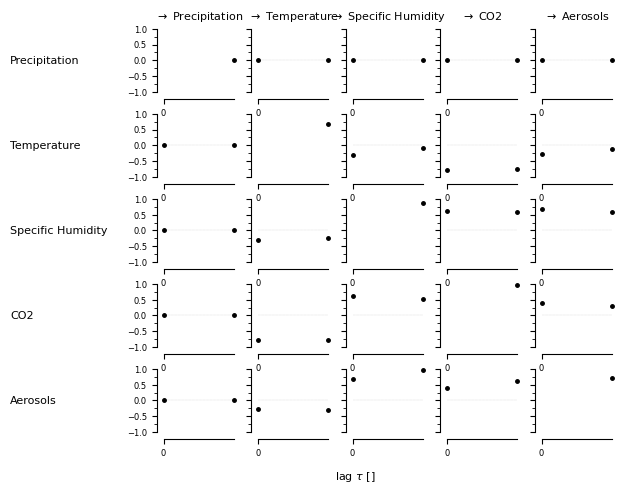

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.02356, |min_val| =  0.530

    Variable Specific Humidity has 1 link(s):
        (Aeroso

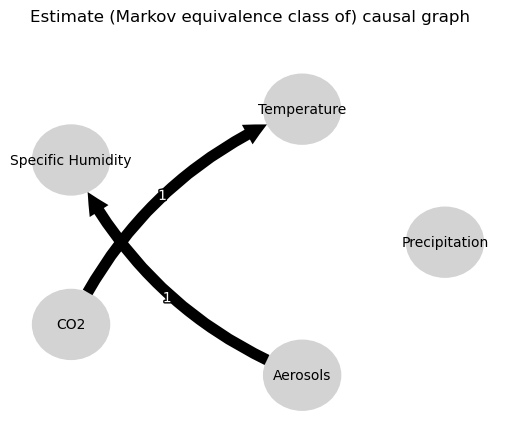

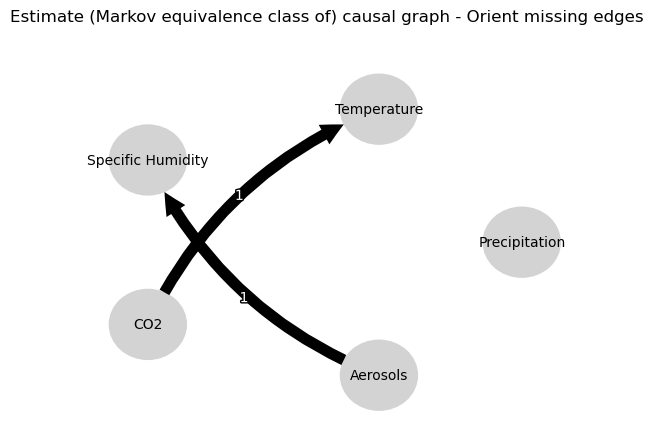

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.9866897229891468
-0.05135706892788947
-0.06261167206650928
-0.8104883511808114
-0.8086012112107589
0.04769909211320969
0.0593338717448061
-0.05135706892788947
-0.04374903676974494
0.0
0.20711107792132546
0.08679542607773034
0.060030442188819116
0.3384889794573318
0.16486158564223513
-0.8104883511808114
-0.8179419048408374
0.08679542607773034
0.06025954623012256
0.0
0.9448233601072964
0.022905133413013028
0.01742166569207123
0.04769909211320969
0.0186877287258333
0.3384889794573318
0.6565760486128495
0.022905133413013028
0.0476871994873692
0.0
0.5283411591292633


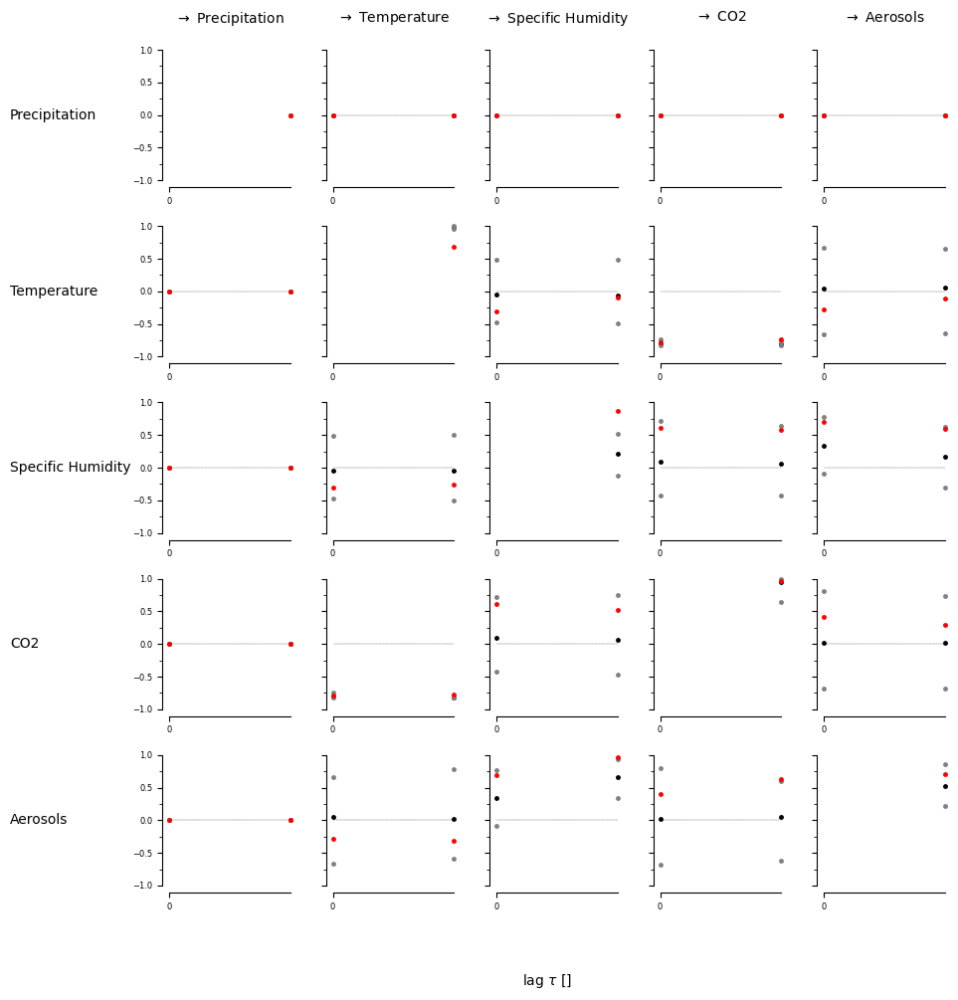

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [ True  True]
  [False  True]
  [False  True]]]


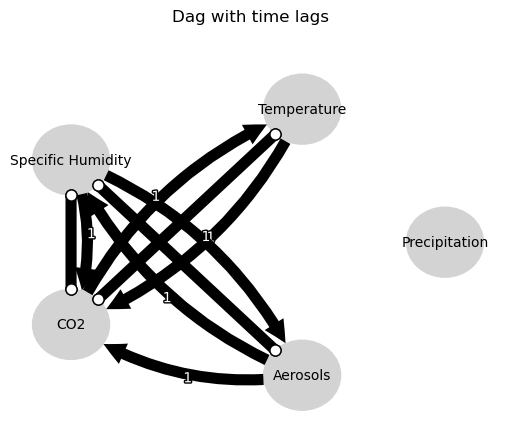

Negative precipitation values in event 99: 0


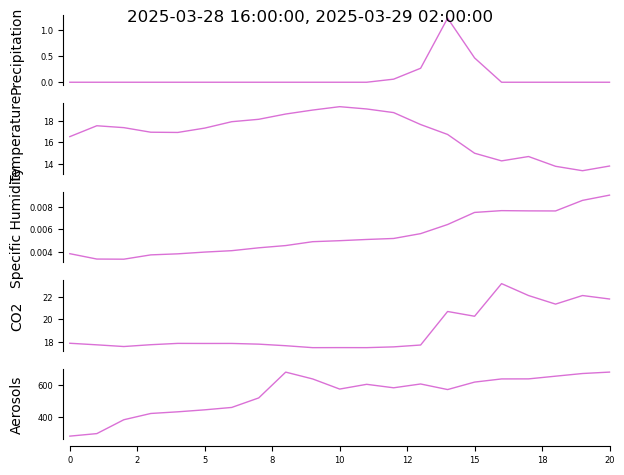


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


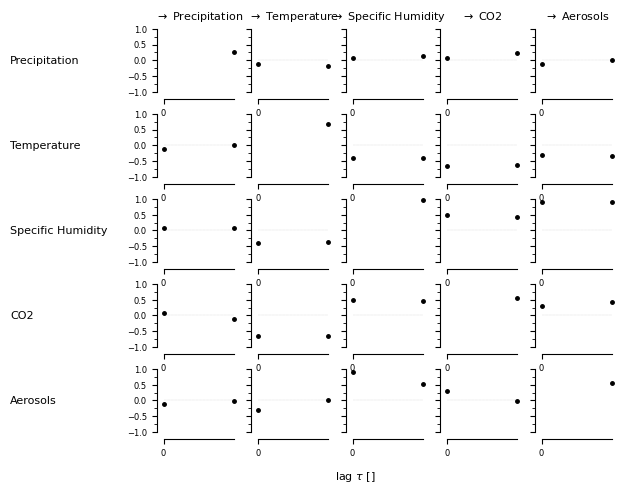

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00000, |min_val| =  0.968



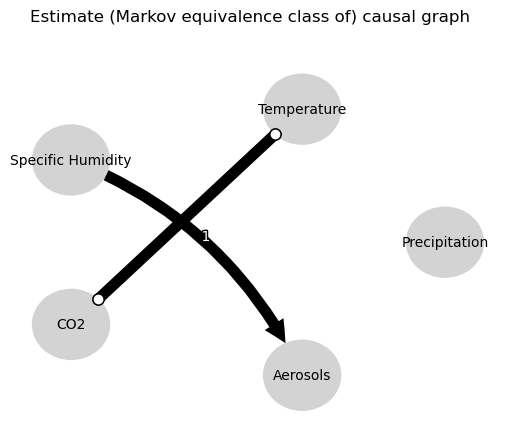

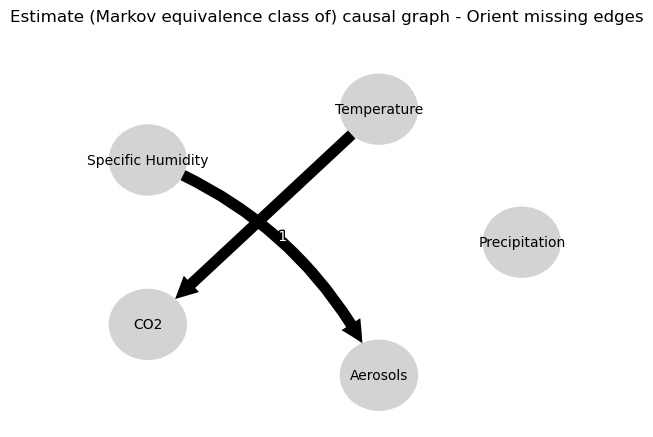

0.0
-0.05757549159887753
-0.08374709313462417
0.012594448540812844
0.12064028331104383
0.08103490686382243
0.17226419304142784
-0.08243562236129744
-0.08265875795665058
0.012107541124847255
-0.08374709313462417
-0.005829192968152736
0.0
-0.03654741059733437
0.01922784106674779
0.006925451377839481
-0.7294045011605773
0.07973790193650201
0.352986270168759
-0.013270821437334551
0.01922784106674779
0.08923743900613862
0.0
0.688033390096694
-0.07232320594726852
-0.11342220450958926
0.3630564976946845
0.331396010165725
-0.7294045011605773
0.05093010060018589
-0.07232320594726852
-0.038724694551459805
0.0
-0.10997183815700559
-0.23714064700702348
-0.0002184164966802645
0.352986270168759
-0.03494928125087011
0.3630564976946845
0.37524282983309276
-0.23714064700702348
0.011952627600639015
0.0
0.1473470474494995


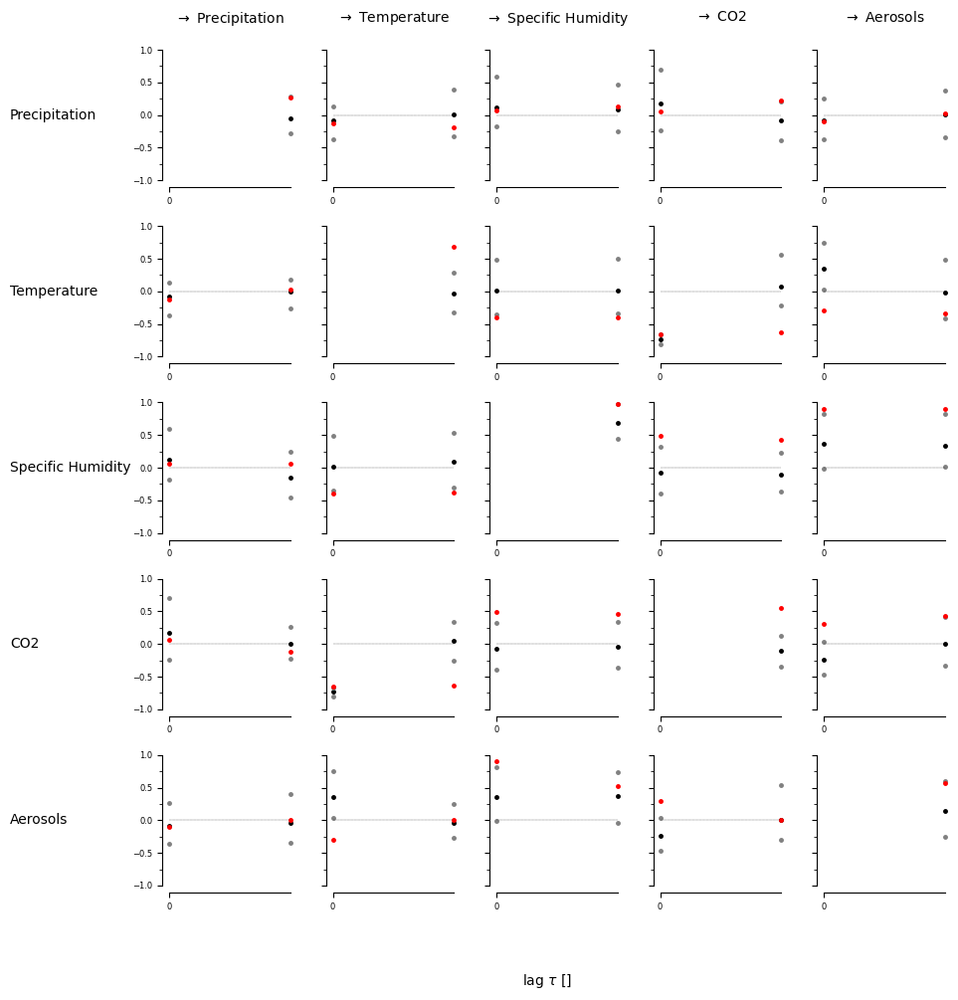

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False False]]]


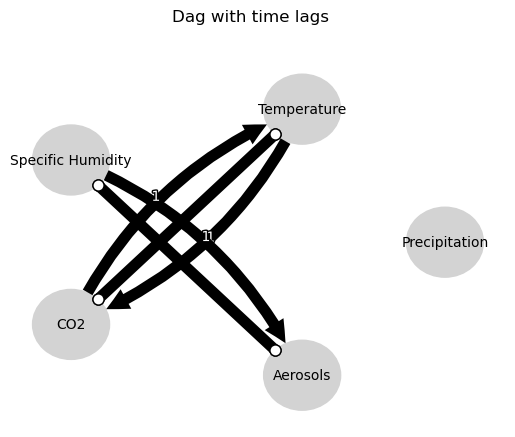

Negative precipitation values in event 100: 0


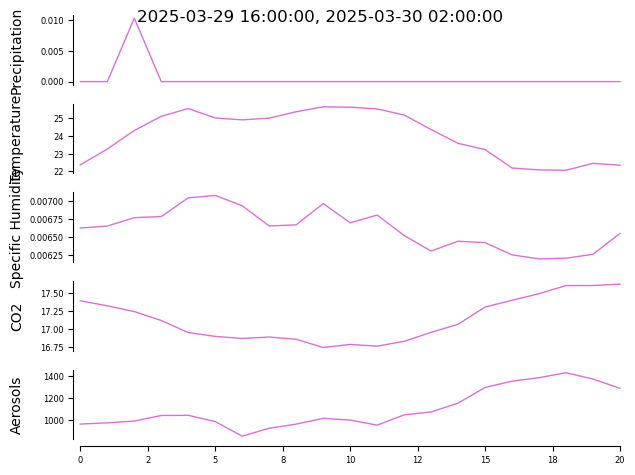


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


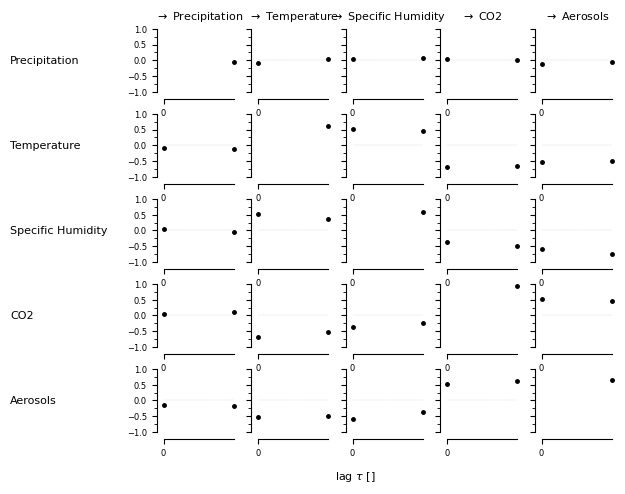

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00747, |min_val| =  0.593



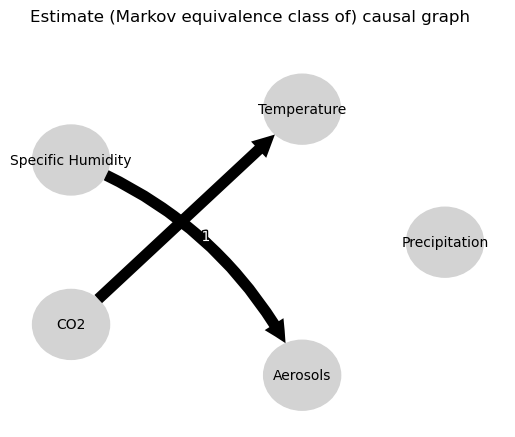

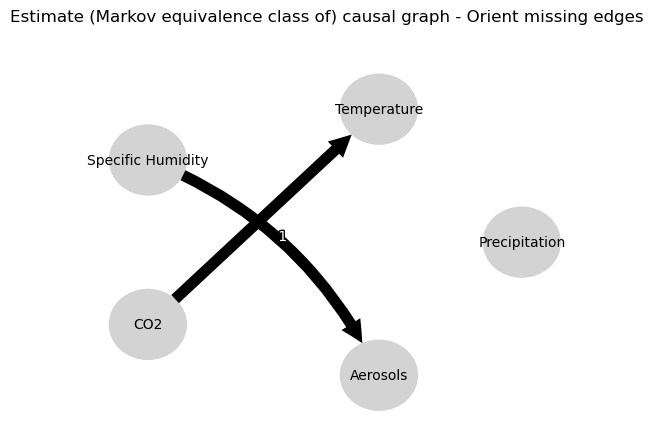

0.0
-0.047056467669201504
0.15540750986874674
0.010944331307379492
0.02920216190855734
0.0053457254366644285
-0.014392014635670285
-0.005753573672241383
-0.07256184282906733
0.0017013580207293913
0.15540750986874674
-0.05734336264160194
0.0
0.35437938353600285
0.34825988935743735
0.13167757544519745
-0.6868966522485864
-0.5116613076207382
-0.14430095376897178
-0.22402393981046861
0.34825988935743735
0.12100350693184266
0.0
0.45515020063732553
-0.2887909645856947
-0.2158622429650269
-0.45803821540044903
-0.5779475005406255
-0.6868966522485864
-0.33709727519135074
-0.2887909645856947
-0.04055415735923444
0.0
0.5597790715583089
0.1905923824007378
0.18301493747812878
-0.14430095376897178
-0.12479647953591039
-0.45803821540044903
-0.30093335435571045
0.1905923824007378
0.13108454195827784
0.0
0.36167639674720126


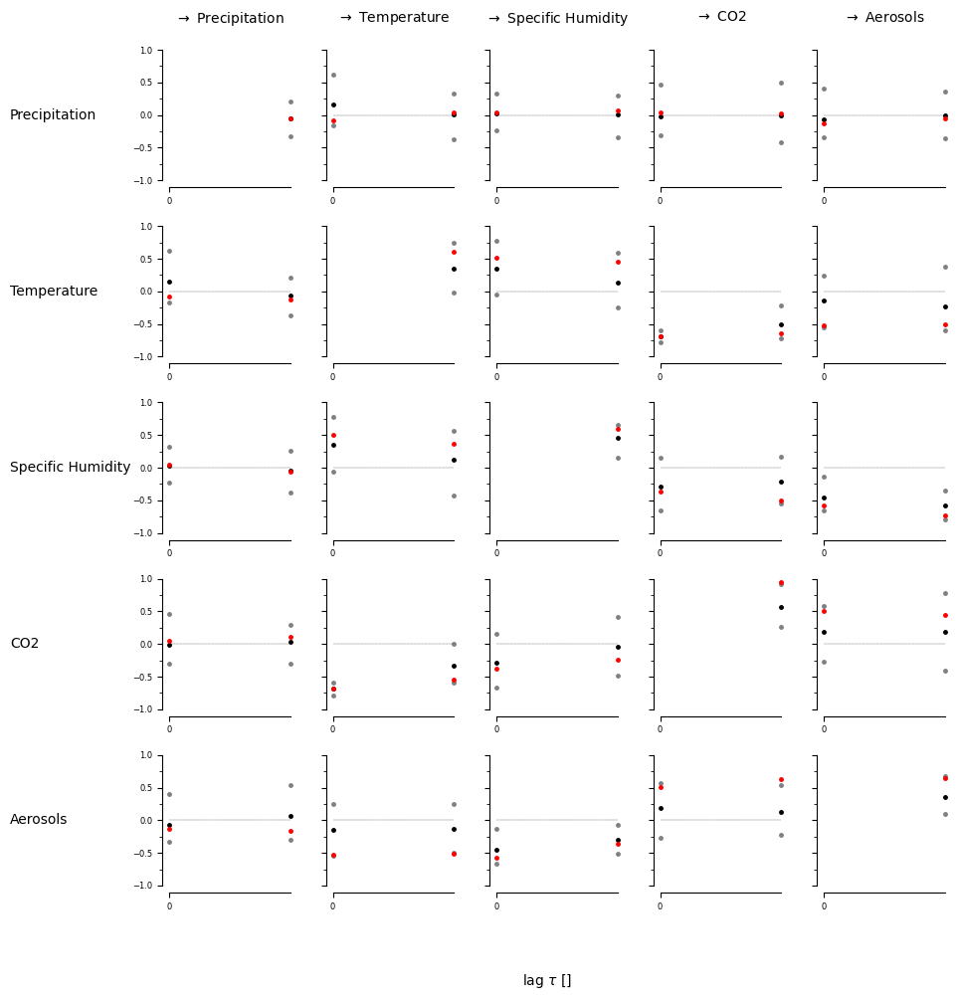

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [ True False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False  True]
  [False  True]]]


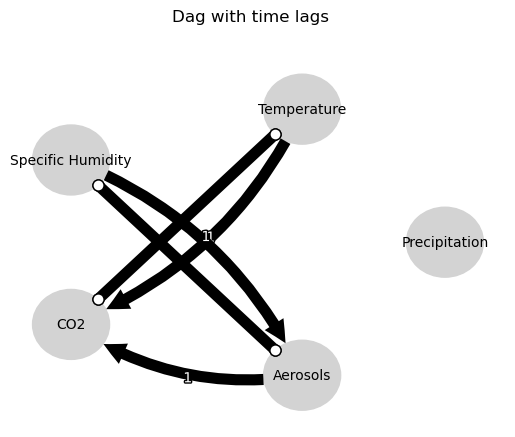

Negative precipitation values in event 101: 0


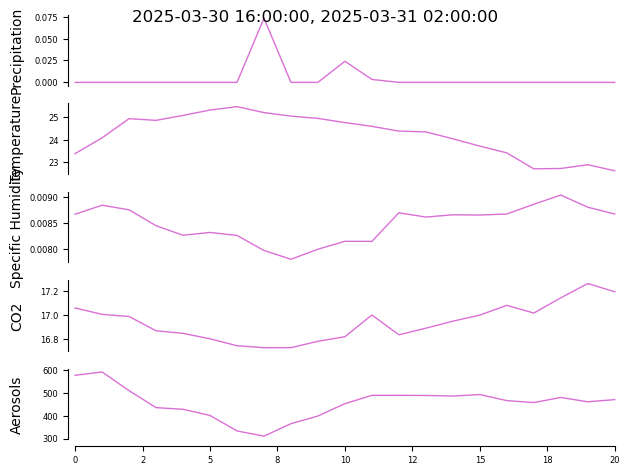


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


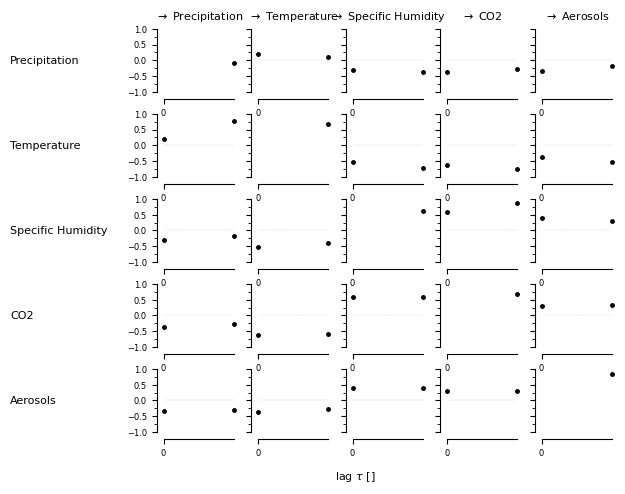

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Temperature -1): max_pval = 0.00015, |min_val| =  0.762

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.03921, |min_val

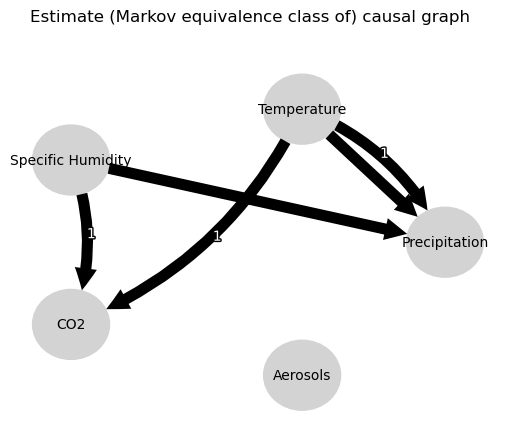

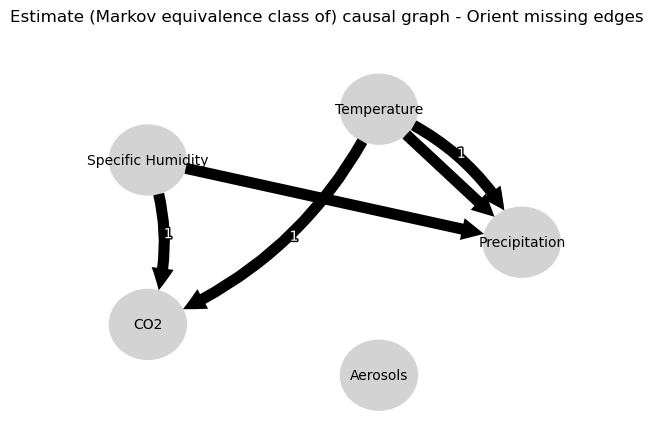

0.0
-0.02559974425376142
-0.028376987941305536
-0.04551868357854092
-0.28792918617388763
-0.04784054394057814
-0.08026426855265838
-0.045344897923564324
-0.07521021684691259
-0.01619418791971222
-0.028376987941305536
0.032497896636245735
0.0
0.5450244352162998
-0.013008828145418061
-0.07972501856770724
-0.4753278670461552
-0.6168388223851229
-0.09104350961569724
-0.003945570371466163
-0.013008828145418061
0.029827430379797834
0.0
-0.05807698497142841
-0.028131885481456474
0.22268602055715864
0.056582464106064705
-0.03393489928337805
-0.4753278670461552
-0.35502562357883277
-0.028131885481456474
0.06041209221521477
0.0
0.35936217173064716
-0.0027235553883289965
-0.02451073077650726
-0.09104350961569724
-0.0981945155680352
0.056582464106064705
0.06838133714954456
-0.0027235553883289965
0.11861725879266656
0.0
0.4899315858782


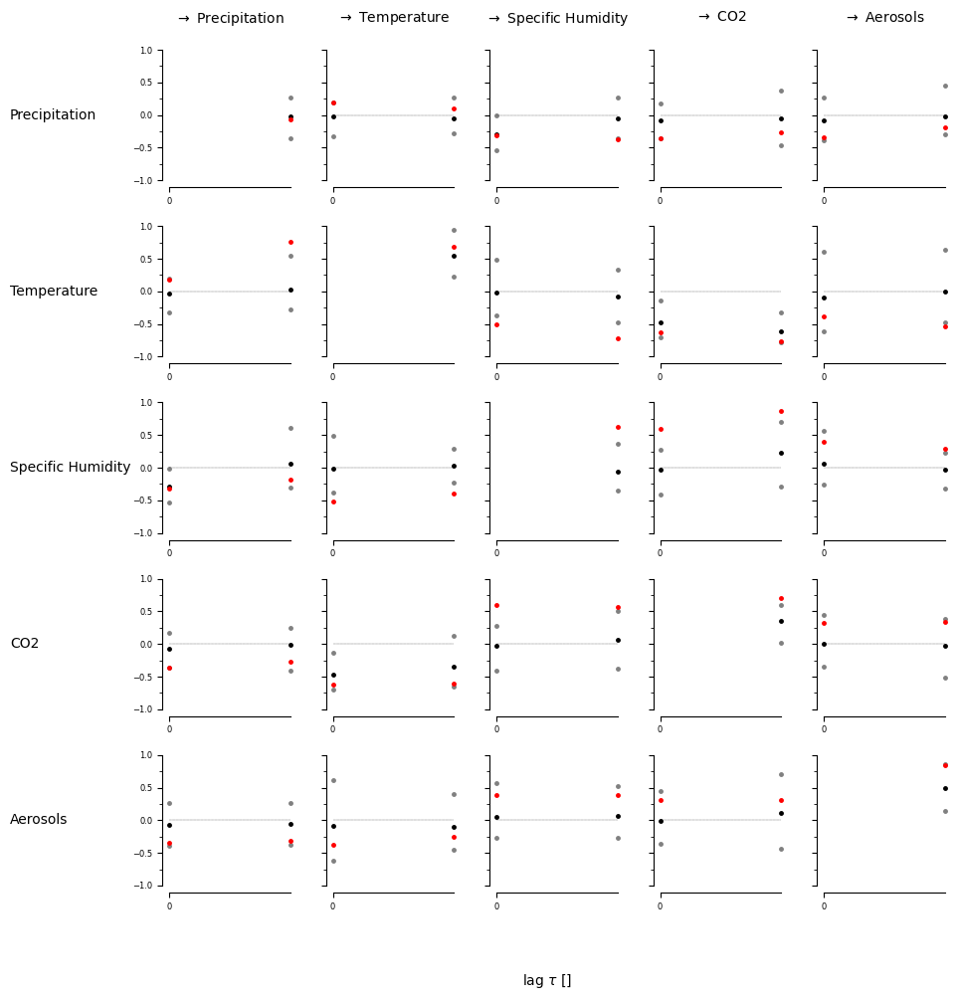

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False  True]
  [False  True]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True  True]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


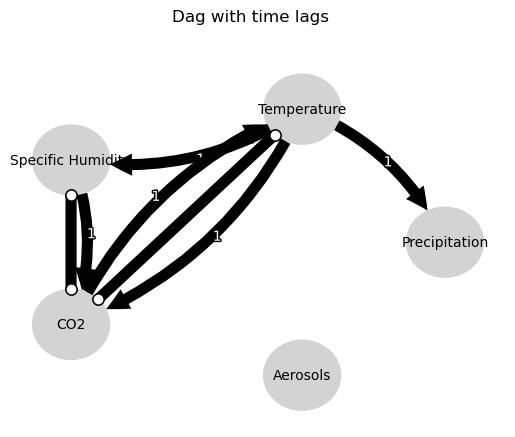

Negative precipitation values in event 102: 0


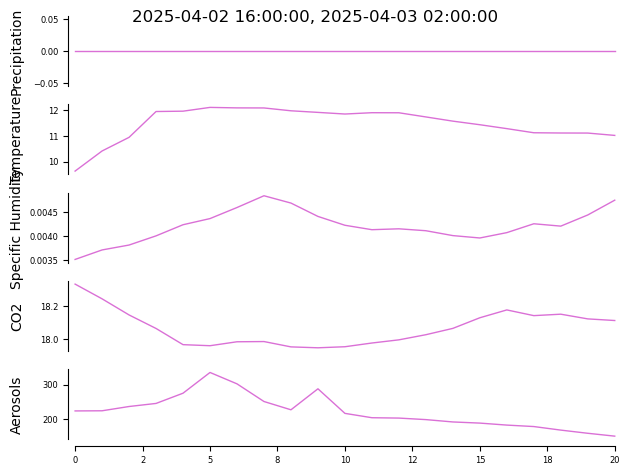


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


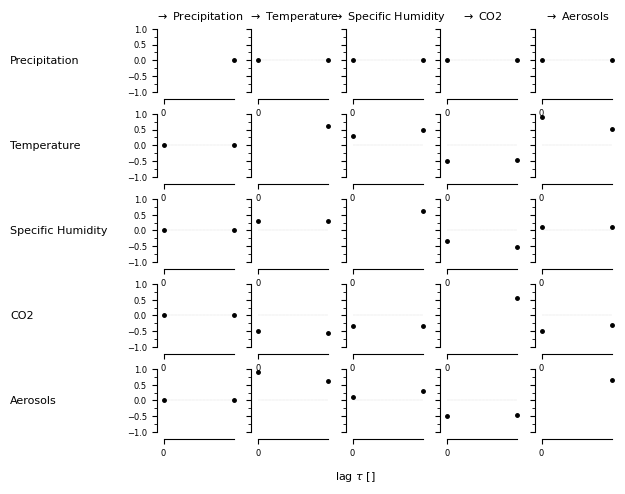

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.03876, |min_val| =  0.491



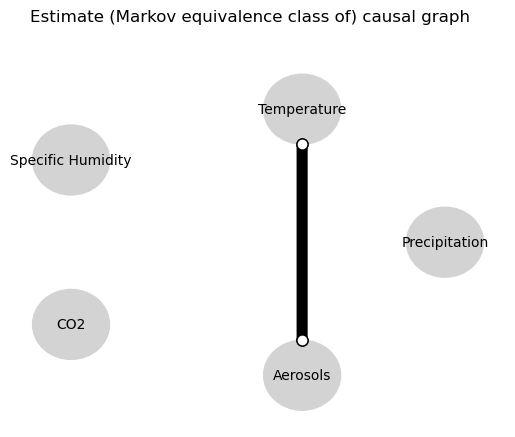

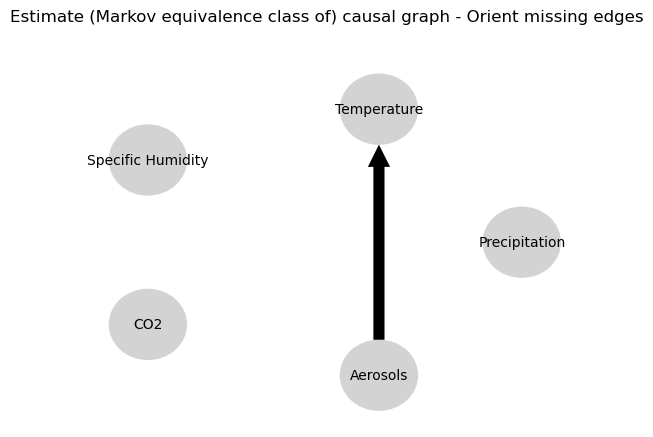

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.05586579421778161
0.003928398338192941
0.05244894887336612
-0.751025581238179
-0.004220950492421676
0.3950840972670404
-0.007063250711202954
0.003928398338192941
0.048611843046400656
0.0
0.42731257894902125
0.019309718117119384
-0.051363681421455816
0.0911940298078644
0.0477685410249795
-0.751025581238179
0.017166547745045245
0.019309718117119384
-0.018877133837002867
0.0
-0.03053381474624276
-0.42909850961910884
-0.000561817615039098
0.3950840972670404
-0.020429695889026715
0.0911940298078644
0.07718784896641252
-0.42909850961910884
0.028048291974696993
0.0
-0.0438664419562254


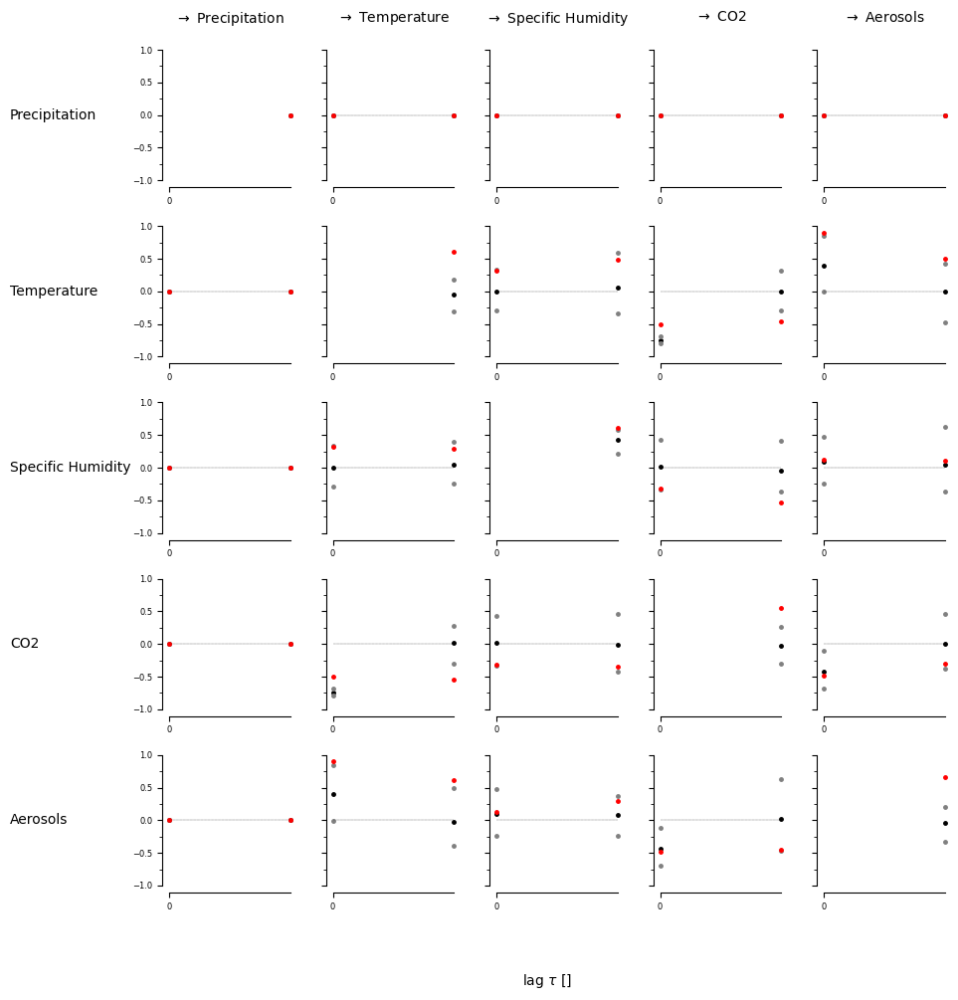

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [ True False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False False]
  [False  True]]]


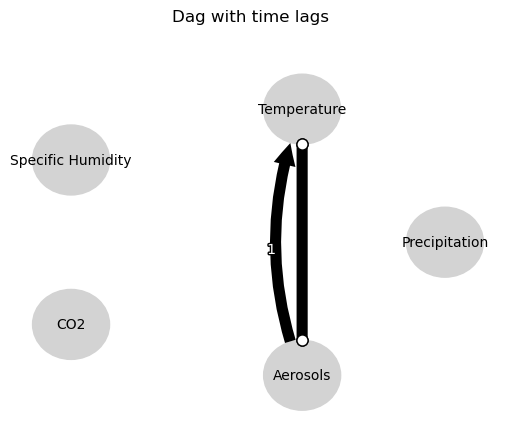

Negative precipitation values in event 103: 0


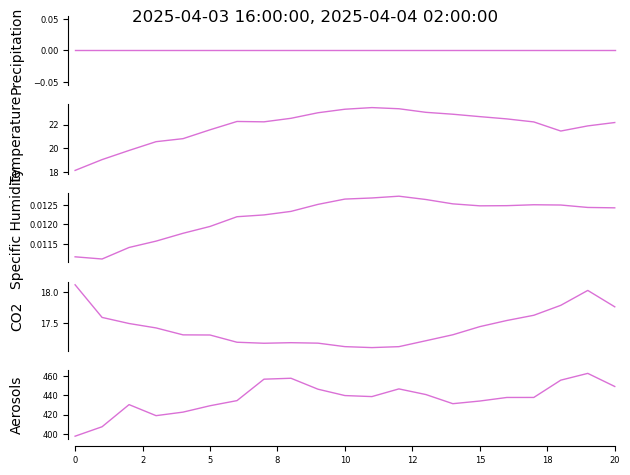


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


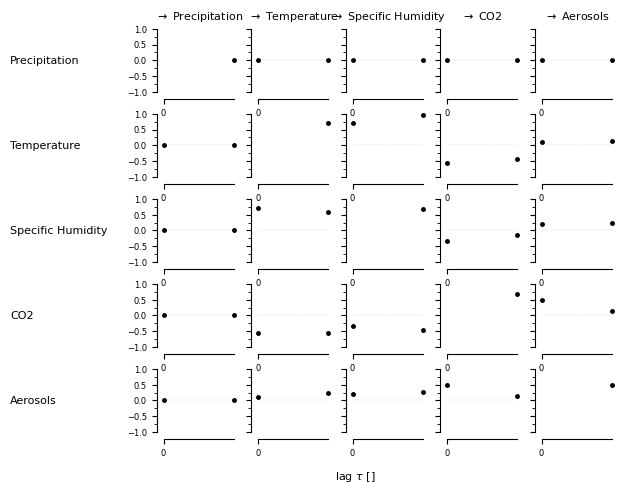

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.03802, |min_val| =  0.492

    Variable Specific Humidity has 1 link(s):
       

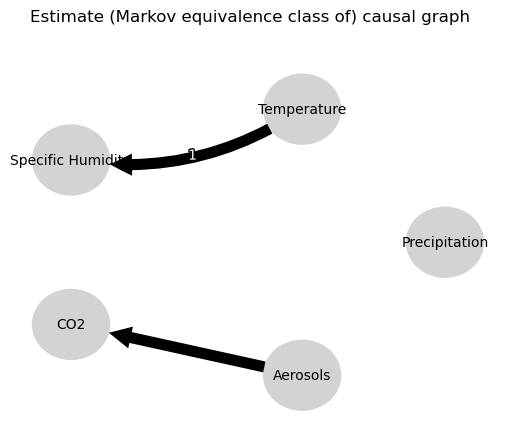

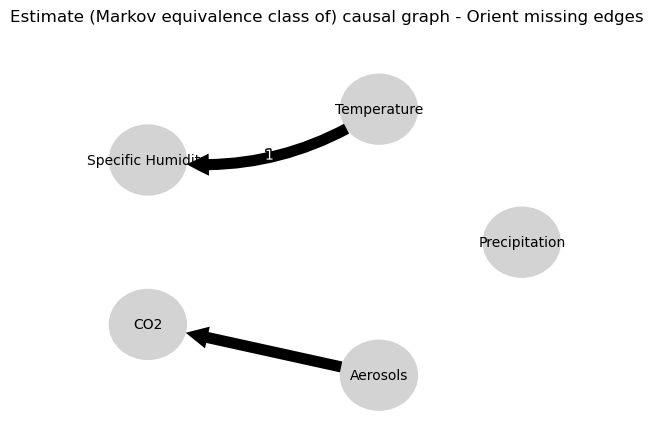

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.39048139518436875
0.3861978179243918
0.6318623672873969
-0.2568492178744142
-0.1139775914043896
-0.03261119791193718
-0.011098187973463468
0.3861978179243918
0.16913128826501025
0.0
0.2193281575336906
0.042752898844922456
0.0542067912569443
0.24480689243754242
0.04370112352384716
-0.2568492178744142
-0.13341099956992225
0.042752898844922456
-0.27359228013728387
0.0
0.45333175055778285
0.3972904746676383
-0.07199446745024726
-0.03261119791193718
0.01015118109494052
0.24480689243754242
-0.03154445053017397
0.3972904746676383
0.23821706730284067
0.0
-0.045829378279399216


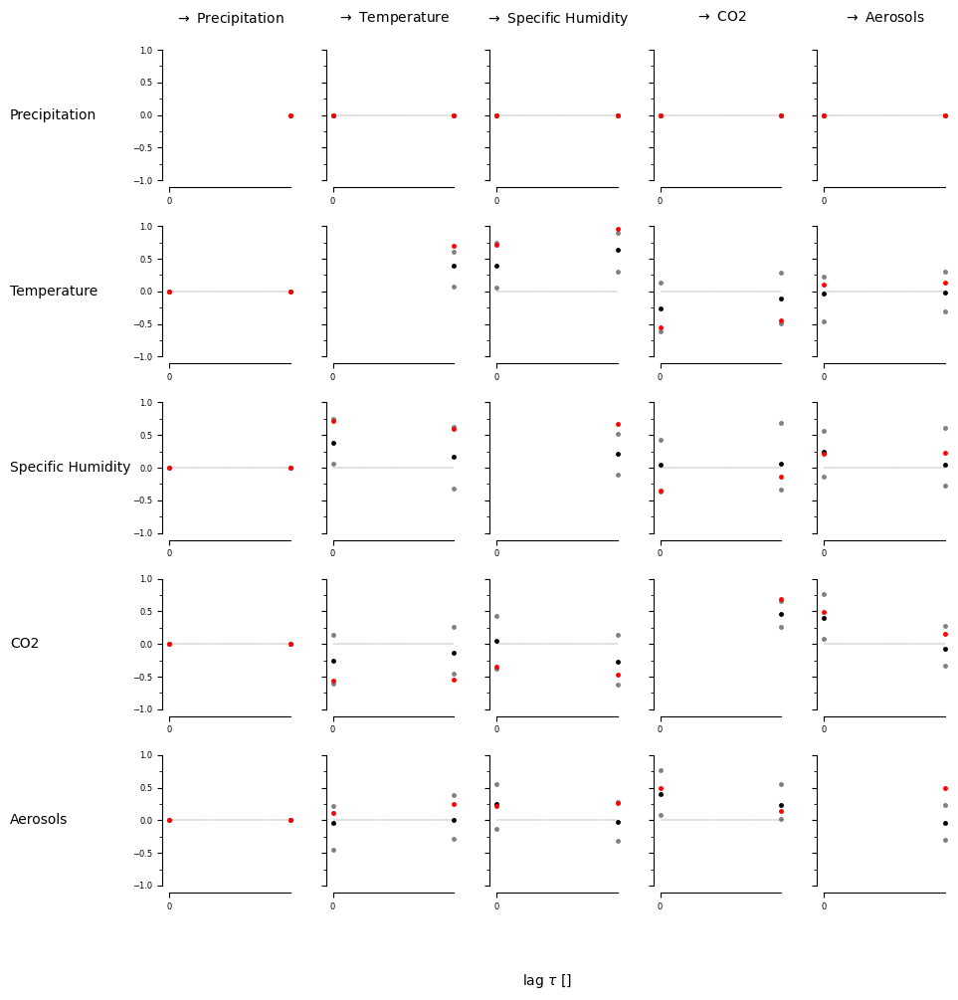

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


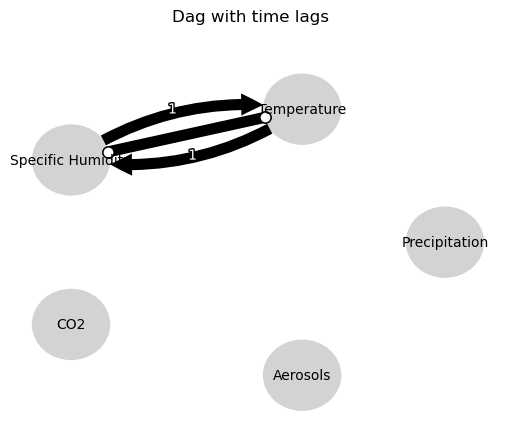

Negative precipitation values in event 104: 0


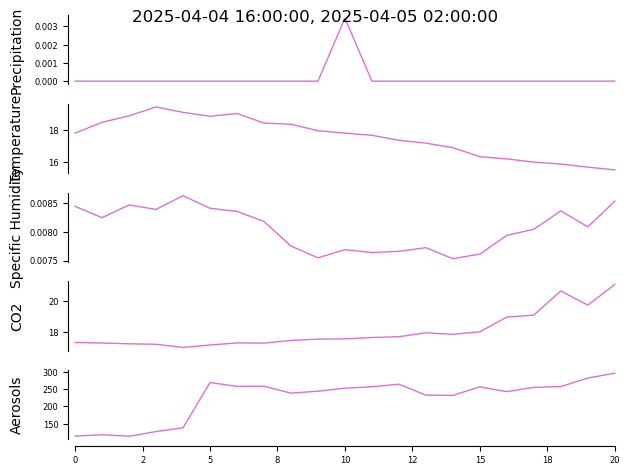


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


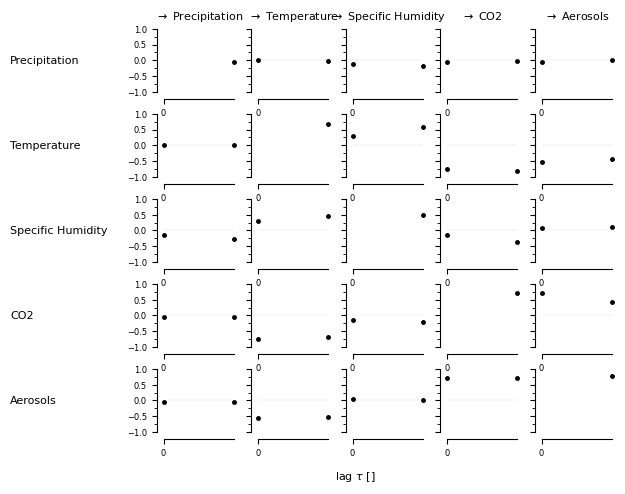

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Temperature -1): max_pval = 0.04435, |min_val| =  0.479

    Va

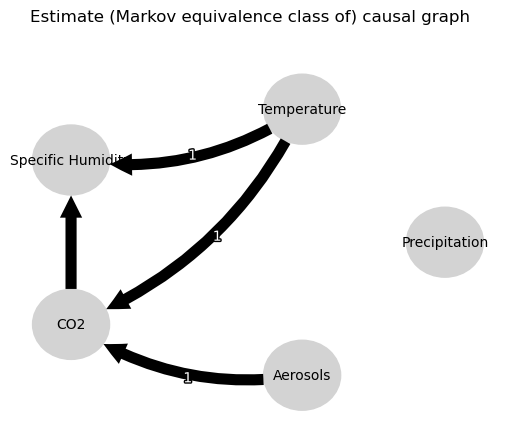

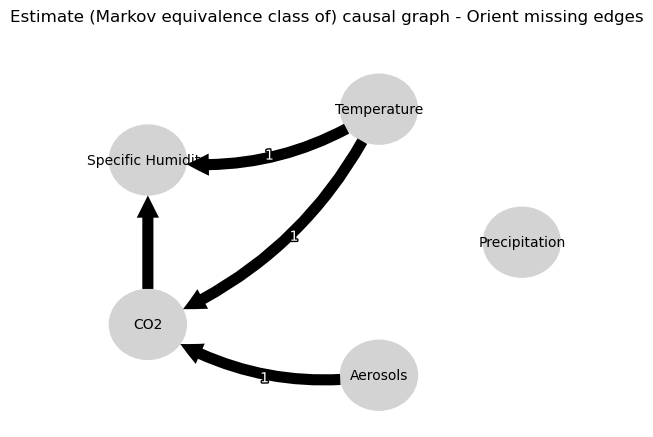

0.0
-0.041934432923619376
-0.002102654269353874
-0.021421619615606013
-0.12101500374451189
-0.008802270280044523
-0.011427577985300518
-0.04284433793507512
0.072084598820976
0.08041479087930745
-0.002102654269353874
0.019040526486353276
0.0
-0.03384056169299695
0.14652853013654313
0.1604689997836297
0.07298309235138851
-0.7102612036963368
-0.019244721005909435
-0.008889181622827131
0.14652853013654313
-0.006992729768636207
0.0
-0.08004827038484538
0.06828740010415398
-0.11720888094556406
0.023531028334543843
0.040787854785194234
0.07298309235138851
0.09818982744369116
0.06828740010415398
0.042907603785302124
0.0
-0.0706265662205904
0.06756251699404893
0.036030110751614754
-0.019244721005909435
0.03411880944472437
0.023531028334543843
-0.05704080540270635
0.06756251699404893
0.0007518495618286272
0.0
0.4877111828545644


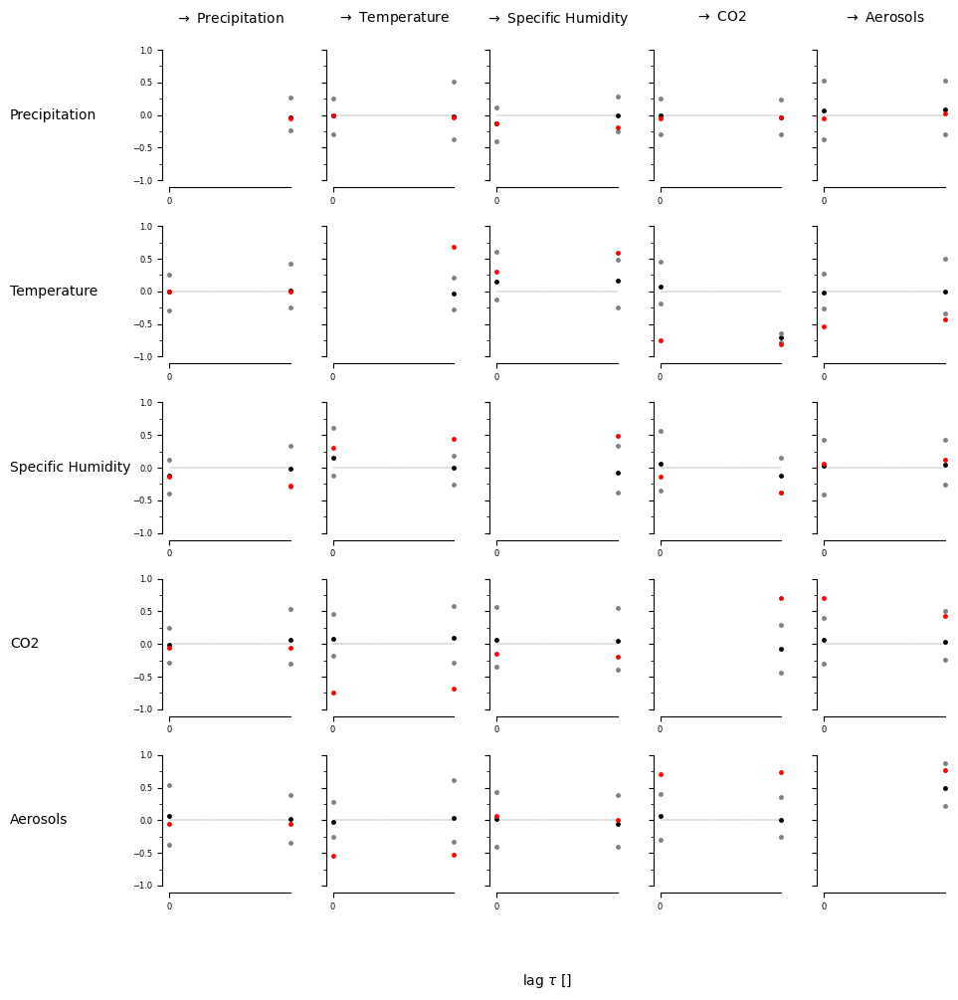

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True False]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False  True]]]


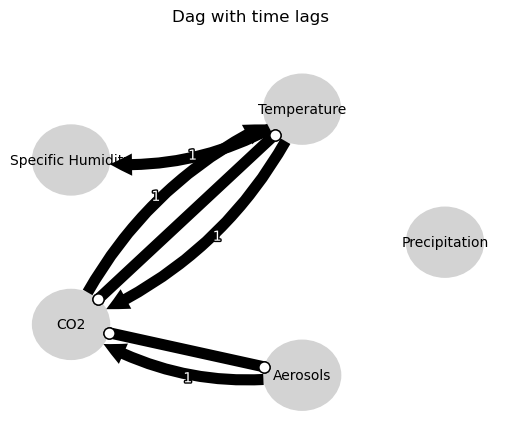

Negative precipitation values in event 105: 0


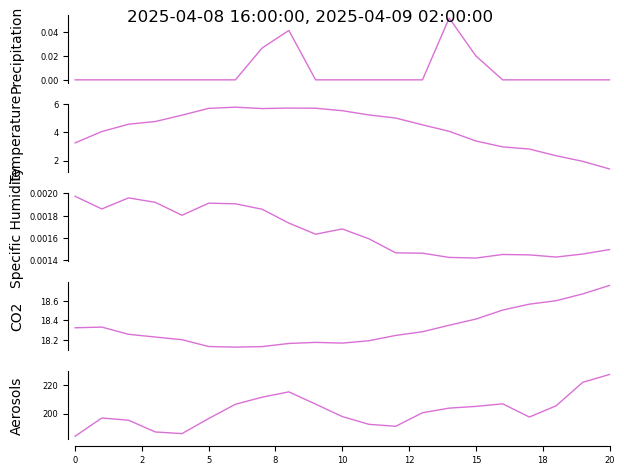


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


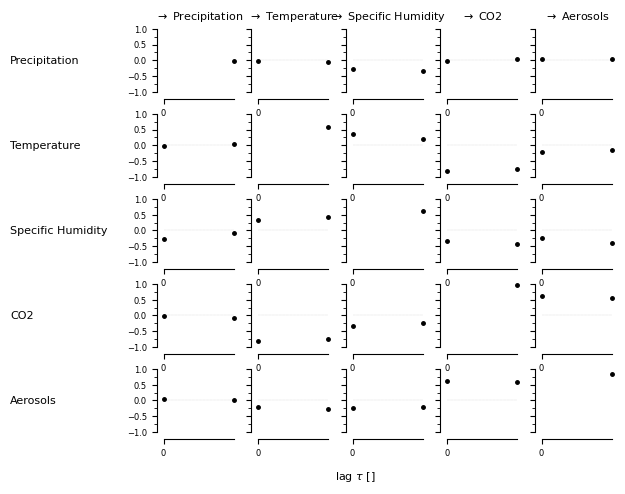

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.02078, |min_val| =  0.540

    Variable Specific Humidity has 1 link(s):
        (Specif

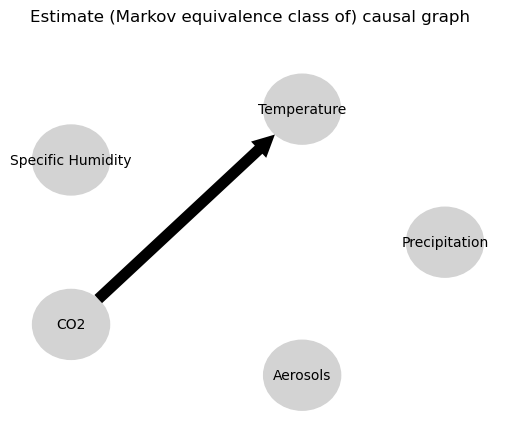

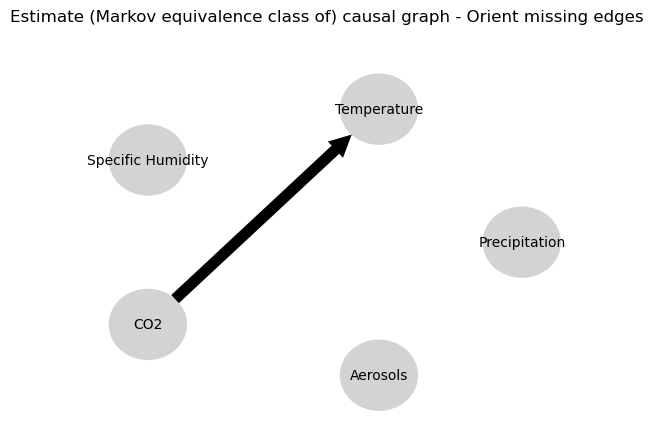

0.0
-0.06490867691227874
-0.01987923402097714
0.010621354939684092
-0.06111917558665103
-0.02264127608708709
0.042076160538610956
-0.016987141255081276
0.06903148813658624
0.014969761965321298
-0.01987923402097714
0.025718462674297626
0.0
0.8429398698649669
0.023126829098731136
-0.07165319499040804
-0.7777560590234692
-0.7342117338744711
0.0963825342242245
0.11082713852282058
0.023126829098731136
-0.022438607096129198
0.0
-0.0697774757556269
-0.07635987737430552
-0.007263299554426212
-0.09783957206918902
-0.054170121596148195
-0.7777560590234692
-0.745736971212972
-0.07635987737430552
0.08103619718355604
0.0
0.8308369900524374
-0.07407279455344774
-0.08752282889473052
0.0963825342242245
0.048813635438997235
-0.09783957206918902
-0.054561055052213106
-0.07407279455344774
-0.04303767888316182
0.0
0.48232409529054276


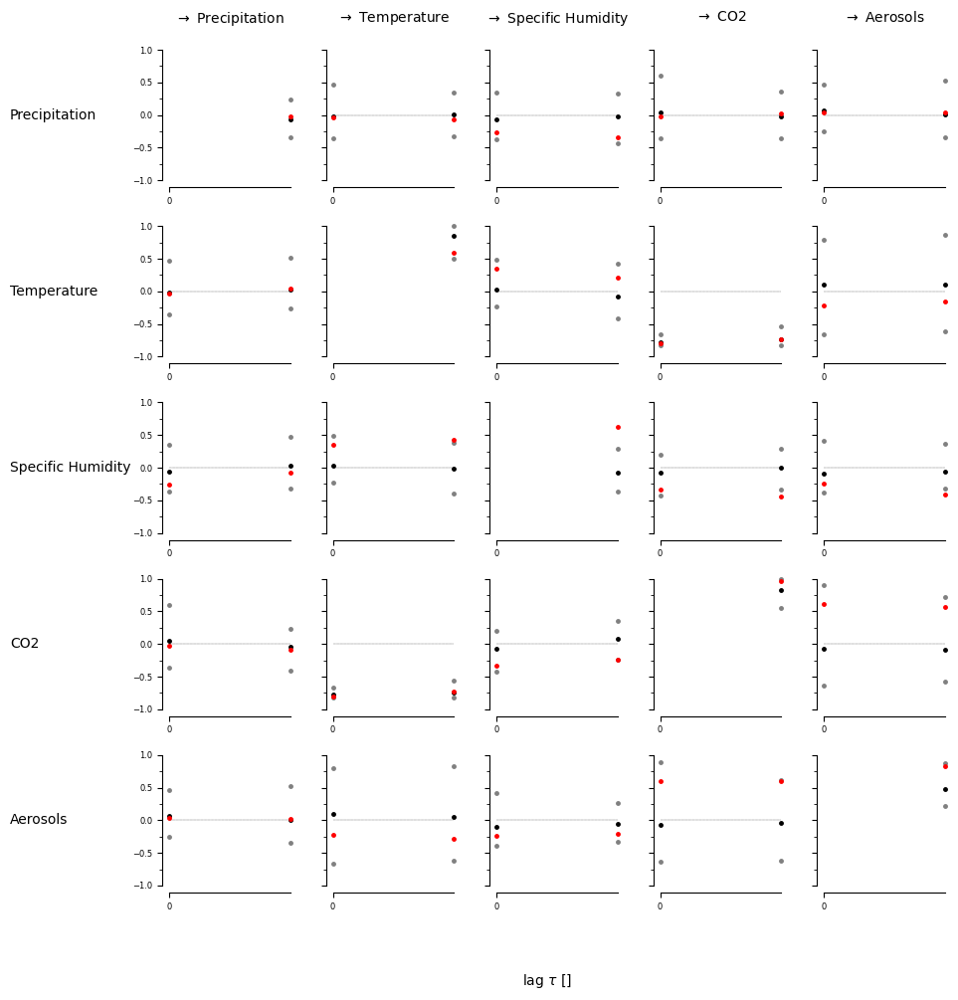

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True False]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False  True]]]


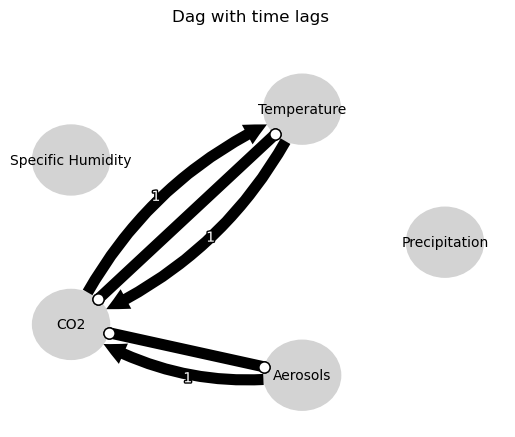

Negative precipitation values in event 106: 0


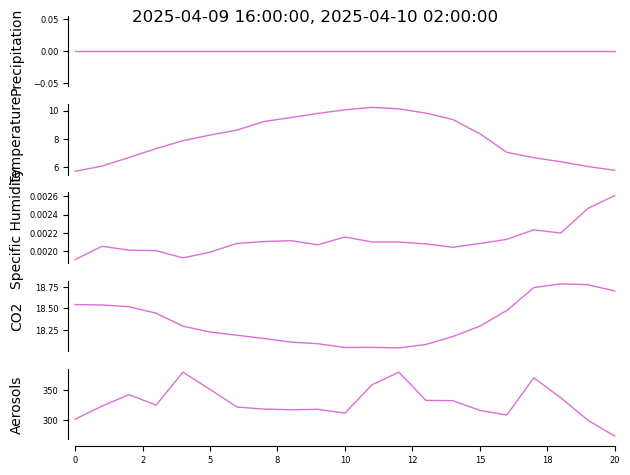


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


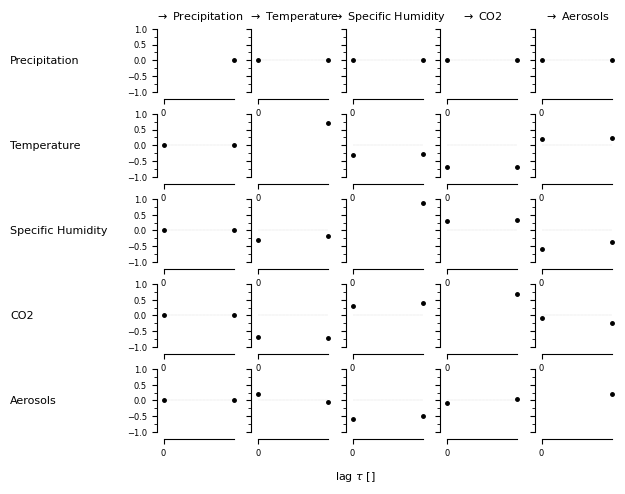

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00001, |min_val| =  0.840



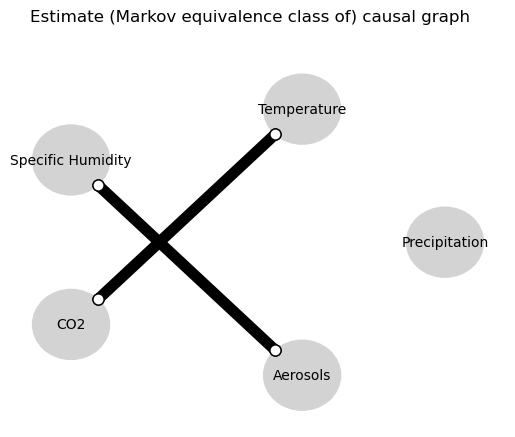

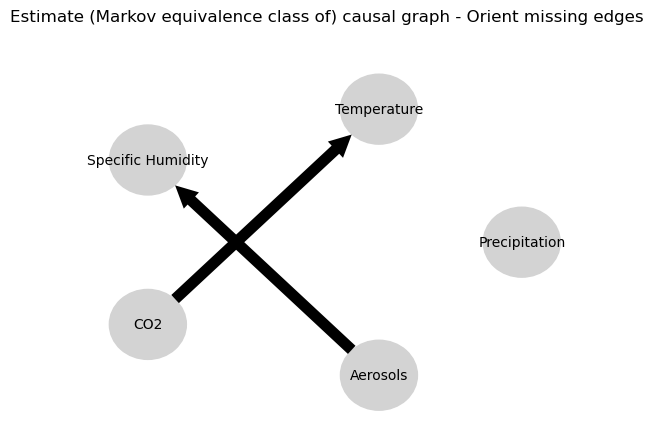

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.05880563763103957
-0.16698188295571537
-0.12460417399342734
-0.7696796831892793
0.044519461043269315
0.2732644953848687
0.05423076021620961
-0.16698188295571537
0.0976668385541837
0.0
0.5932005518438944
0.17235356624314635
-0.09626619011034152
-0.1949656056464534
0.10022005007007
-0.7696796831892793
0.050826475822764575
0.17235356624314635
0.12207853523354086
0.0
-0.06184962184032341
-0.21917276605391015
-0.03871305963215824
0.2732644953848687
0.004497779815235568
-0.1949656056464534
-0.17745494155764993
-0.21917276605391015
-0.031490602921236614
0.0
-0.0438664419562254


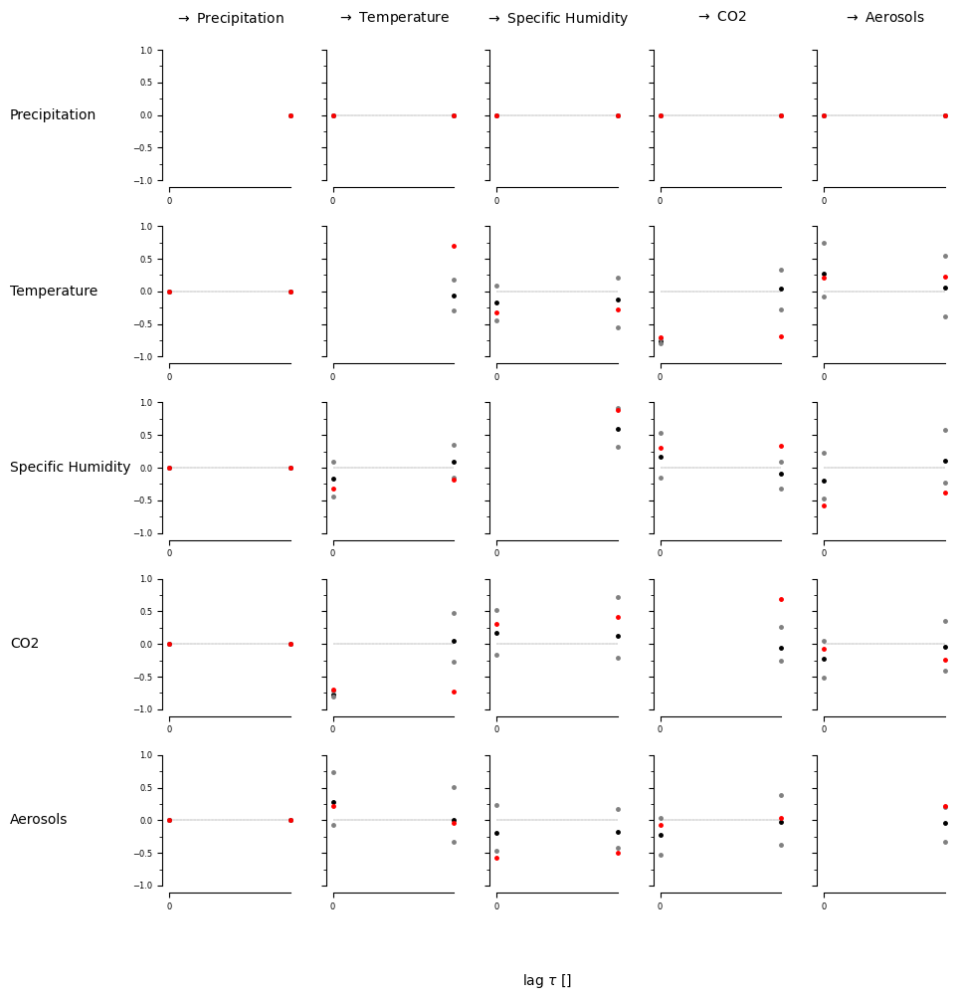

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False False]]]


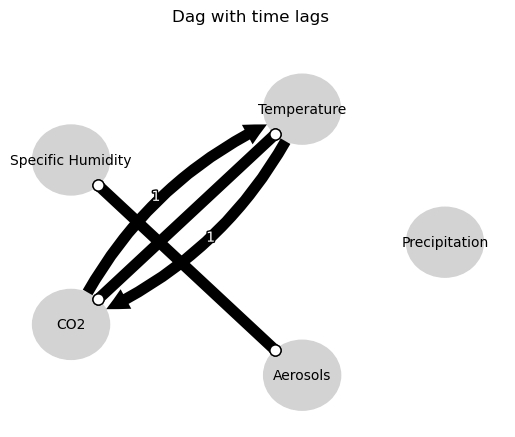

Negative precipitation values in event 107: 0


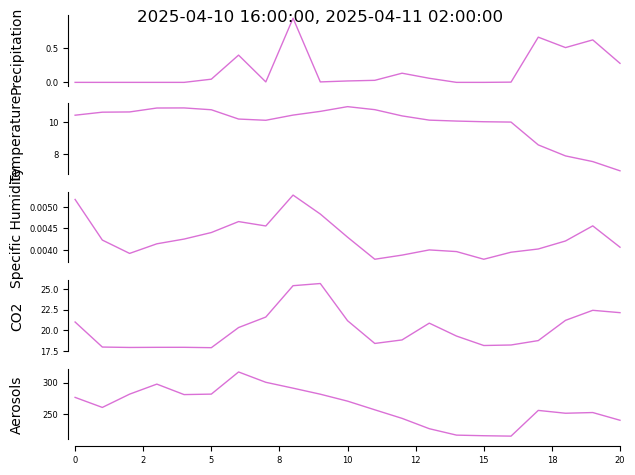


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


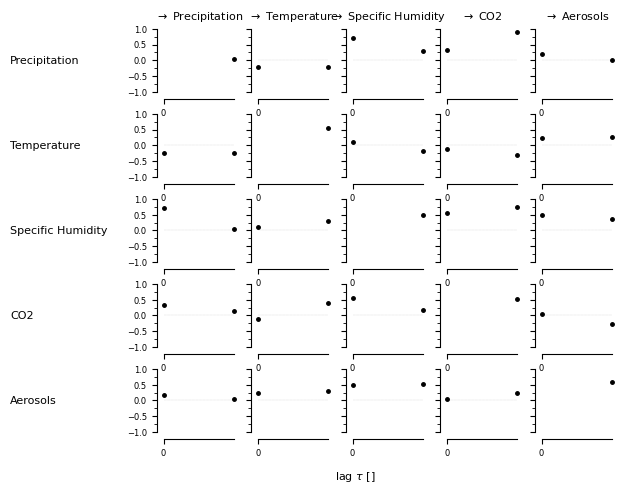

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.01359, |min_val| =  0.555

    Variable Specific Humidity has 0 link(s):

    Va

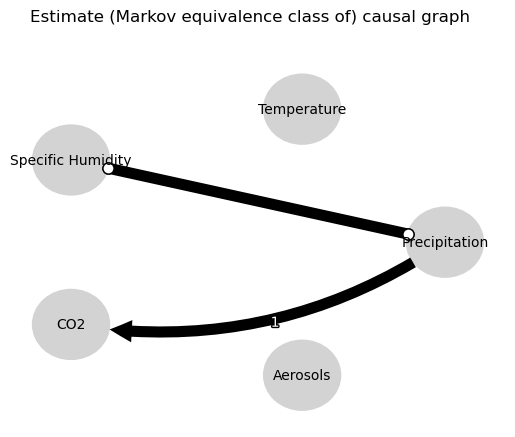

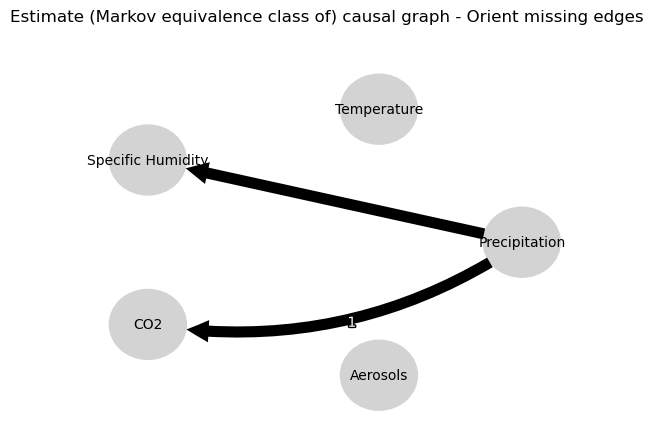

0.0
0.013512294861330541
-0.006388335290082396
0.009325398262649574
0.4570559904190519
-0.07249811725210997
0.3288130986141184
0.6322990801444132
0.1333788478092733
0.12671872334309284
-0.006388335290082396
0.04790675880987542
0.0
0.8547435956239122
-0.0024161158652250547
-0.05906520414475527
0.020494882251576037
-0.0014713926935781422
0.04199701962801027
0.07910608383560294
-0.0024161158652250547
-0.044755846175321454
0.0
-0.08336345336729942
0.3554859208761511
0.23724075828559038
0.030574988510003356
0.05571091527552812
0.020494882251576037
-0.0018076976880304204
0.3554859208761511
-0.12721512233902266
0.0
0.14655751815122162
0.03936278966920135
0.02073926928089927
0.04199701962801027
0.022006421581007744
0.030574988510003356
-0.06069852112124904
0.03936278966920135
0.1234269216375763
0.0
0.48850881531966334


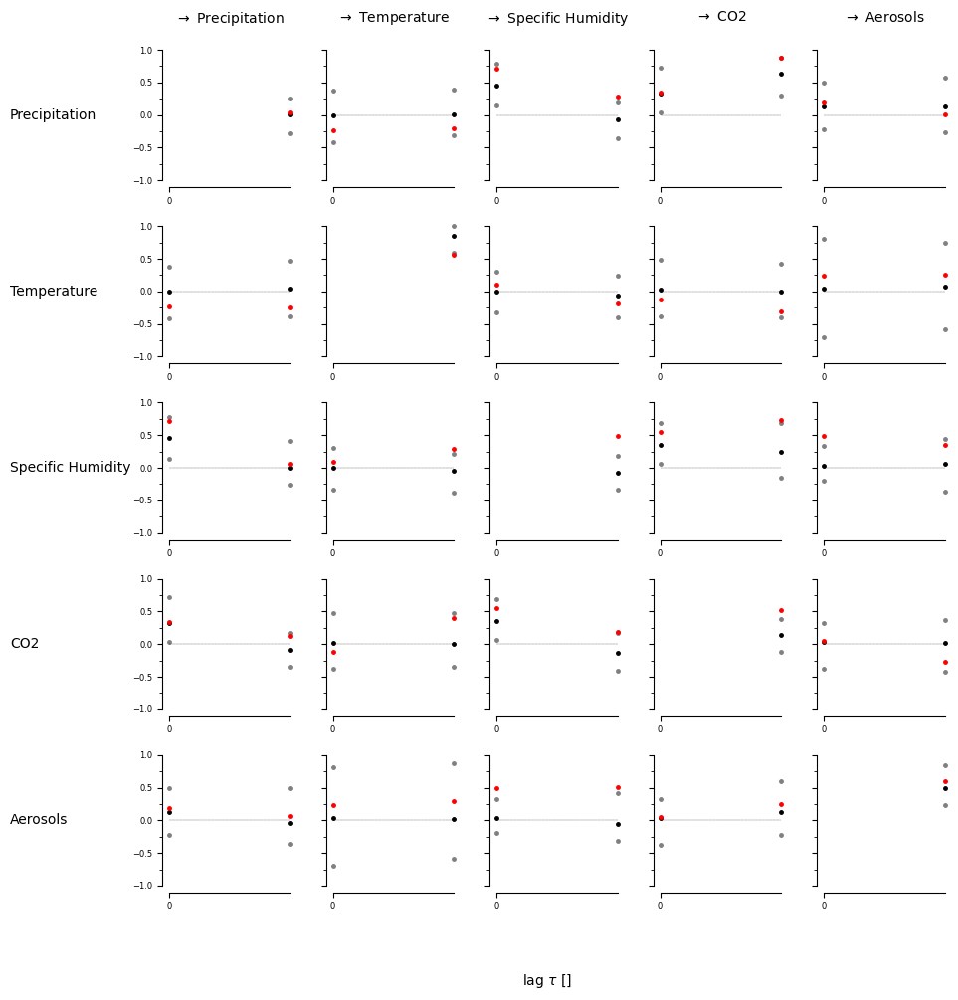

[[[False False]
  [False False]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[ True False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


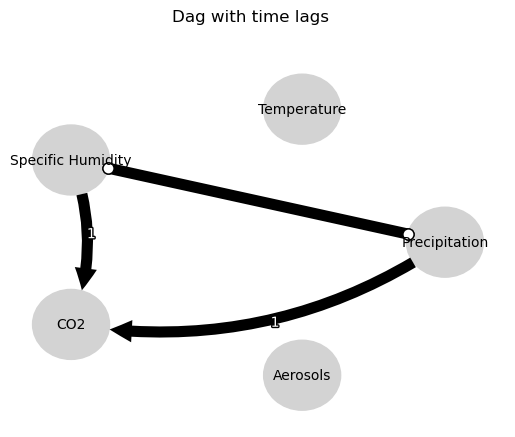

Negative precipitation values in event 108: 0


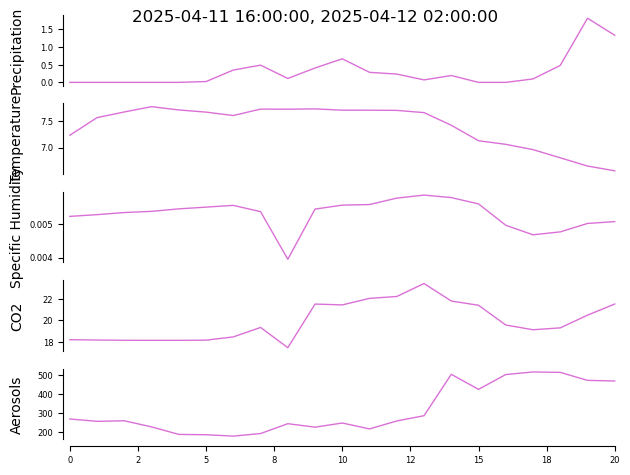


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


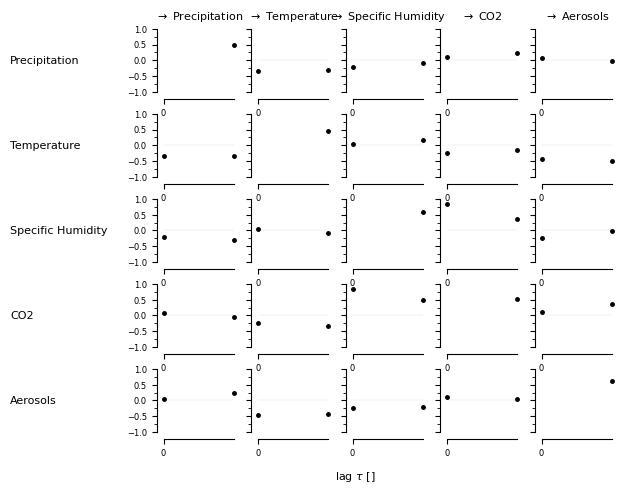

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.03066, |min_val| =  0.496

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.04994, |min_v

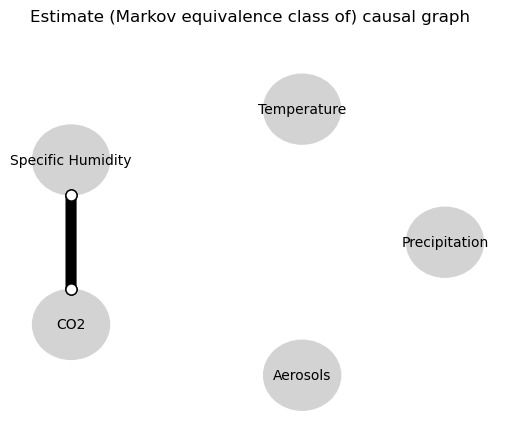

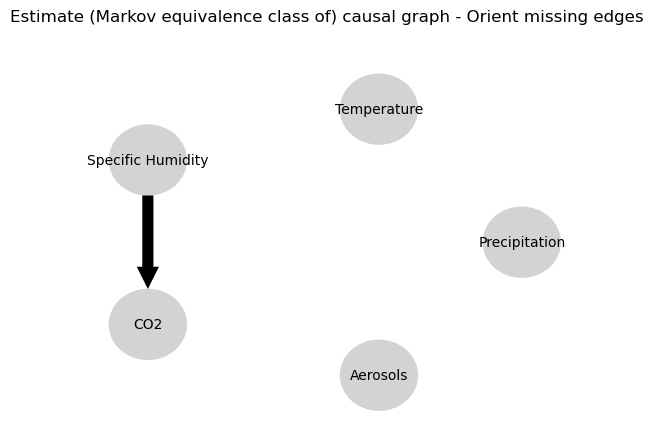

0.0
0.42026005687827284
-0.228391340914642
0.10582091052162927
0.045627341692827526
0.07817319343166637
0.08409926793123557
0.05606440584657194
-0.052221793771035495
-0.06294667538710104
-0.228391340914642
-0.1439321473876864
0.0
-0.10547922601974258
0.35676726659790997
-0.023073754194065148
-0.08895252413192711
0.012485590492782191
0.021380218614586714
-0.0194454036740397
0.35676726659790997
-0.01509212496796763
0.0
-0.013274860383387484
0.47743583779654847
0.056747149746075136
-0.013580669085460847
0.012417215645038475
-0.08895252413192711
-0.024366625789354373
0.47743583779654847
-0.07005177805505611
0.0
-0.03655518127841182
0.14005723186338231
0.08687349093036395
0.021380218614586714
0.04867220698504734
-0.013580669085460847
-0.0361921399903951
0.14005723186338231
-0.03783628252171145
0.0
0.5283411591292633


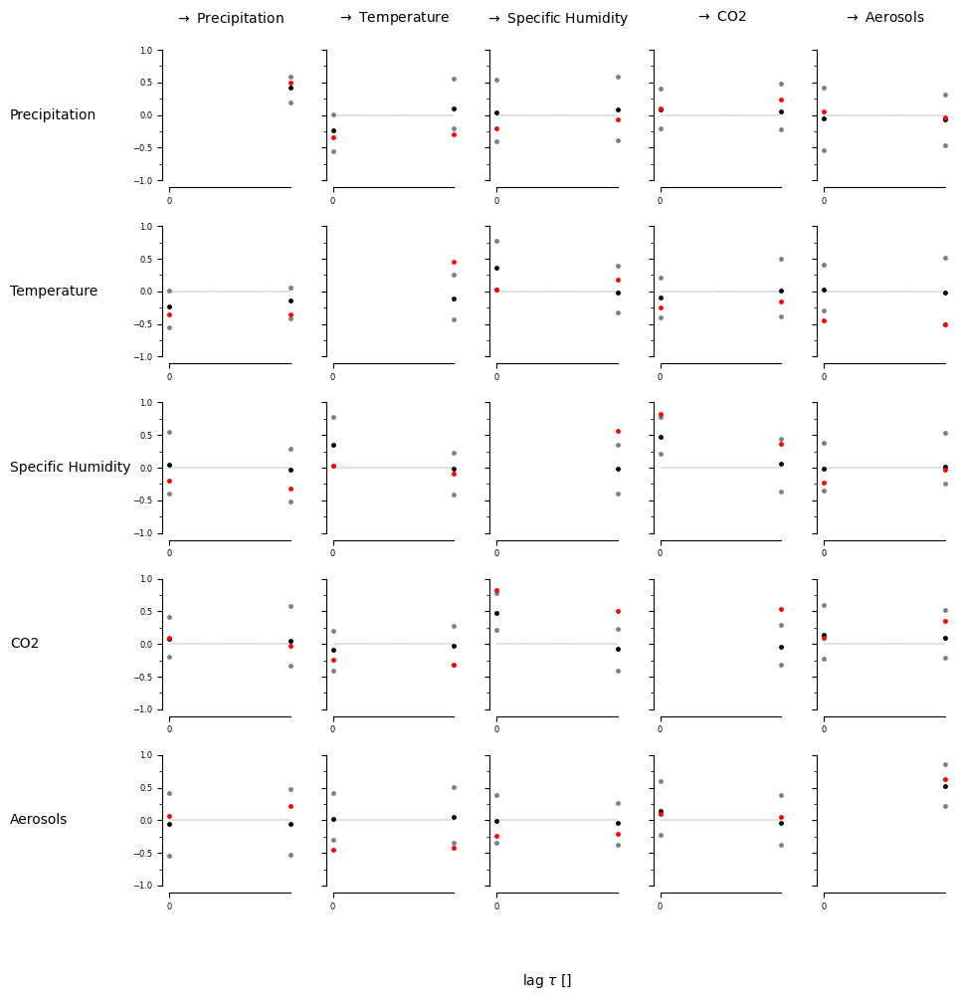

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


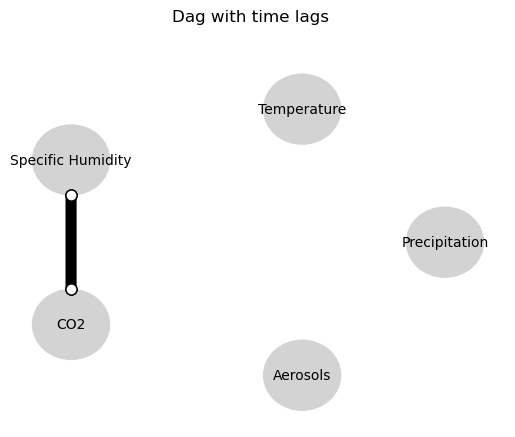

Negative precipitation values in event 109: 0


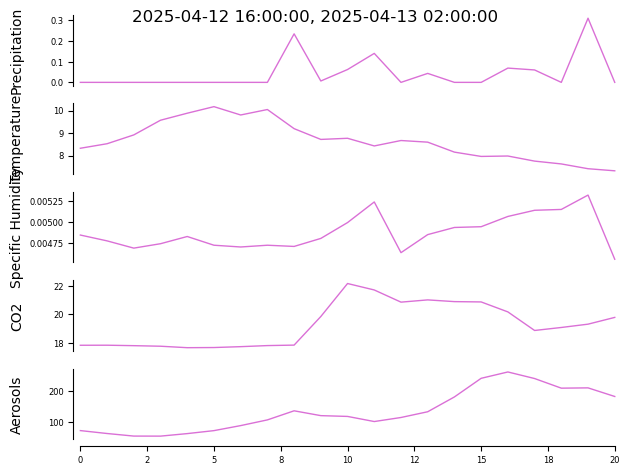


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


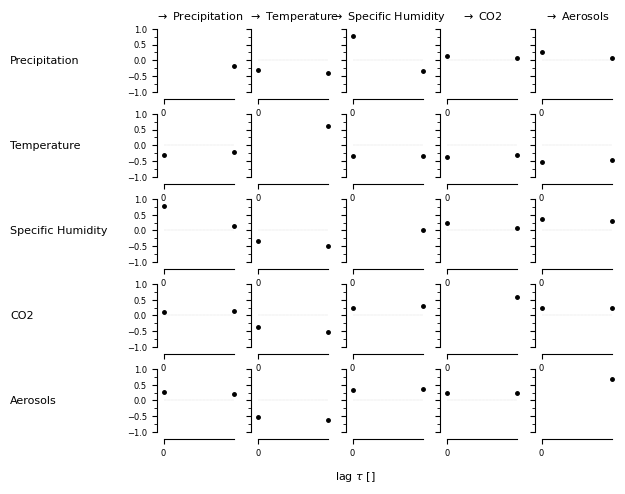

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.04923, |min_val| =  0.470

    Variable Specific Humidity has 0 link(s):

    Va

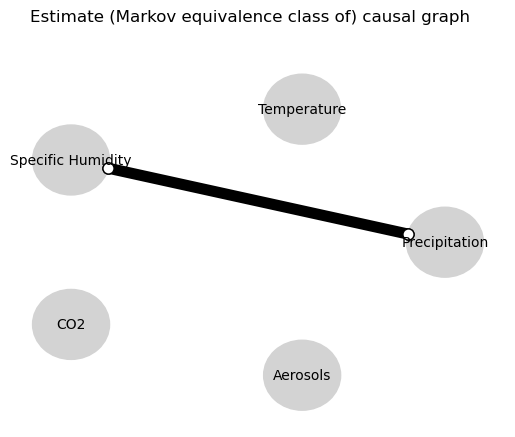

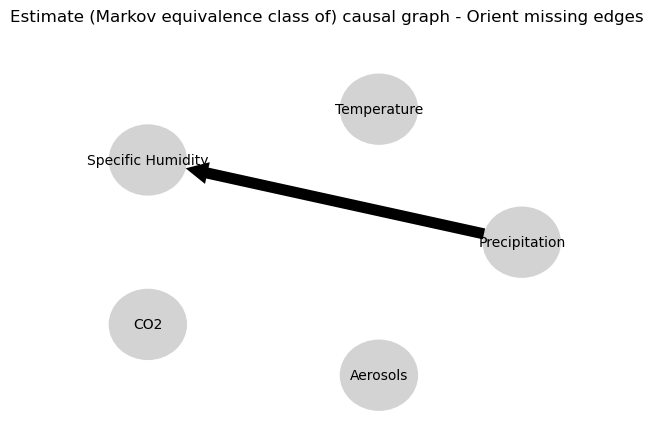

0.0
-0.02184828790782884
-0.22709815620039775
-0.01018138238532553
0.5151228803727084
-0.057616939946935536
-0.019484520102729674
-0.04206510562627847
0.015636634324097284
0.0367345523209867
-0.22709815620039775
0.009484484006343948
0.0
0.0009102324869811625
-0.40105917352005505
-0.002266850175577939
-0.10276471184560948
-0.039510869026394786
0.0563220093615204
0.03525698404247428
-0.40105917352005505
0.04931237293512491
0.0
-0.03922452843892206
0.07370541796619194
0.015697737930413732
-0.04560587035594889
-0.005508444133022209
-0.10276471184560948
-0.003003961075787019
0.07370541796619194
0.07502768946141773
0.0
0.43141181389375977
-0.14876256252932935
-0.08783593889833778
0.0563220093615204
-0.035543309948332956
-0.04560587035594889
-0.07193839487566896
-0.14876256252932935
-0.09837170939509814
0.0
0.517547907260546


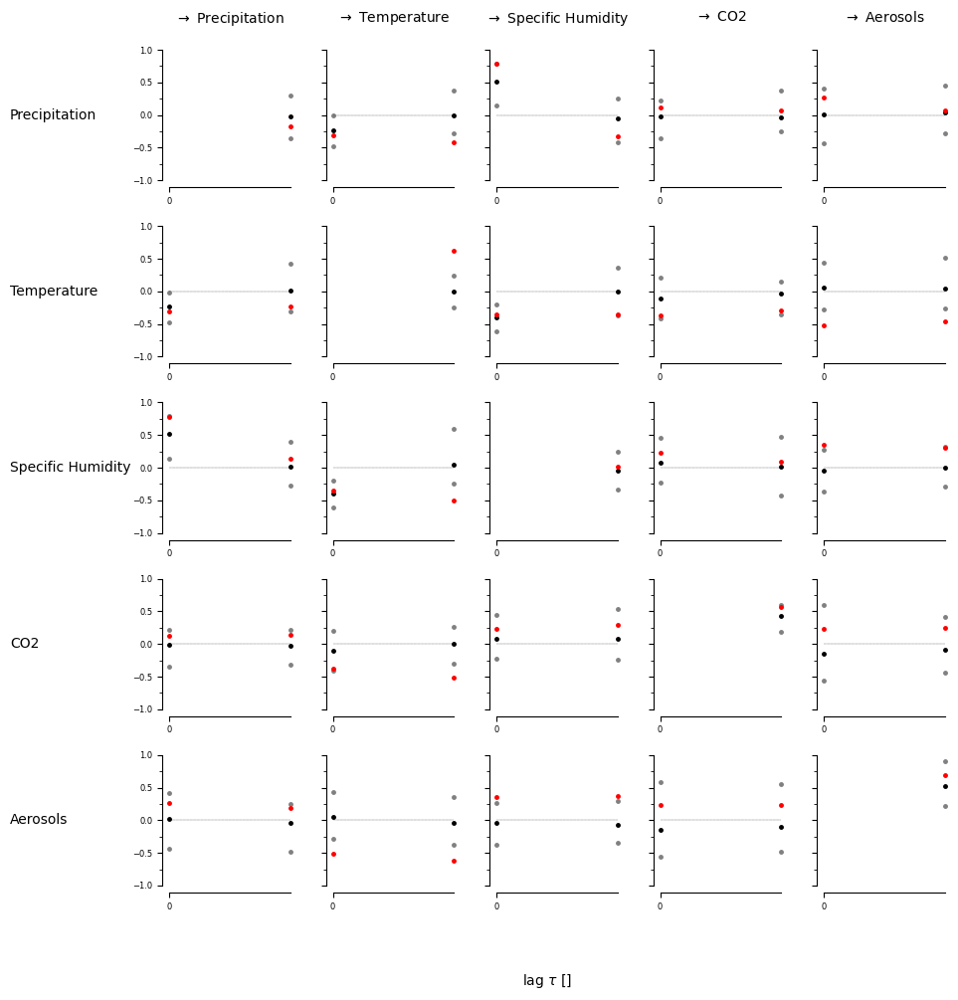

[[[False False]
  [False False]
  [ True False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[ True False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False  True]]]


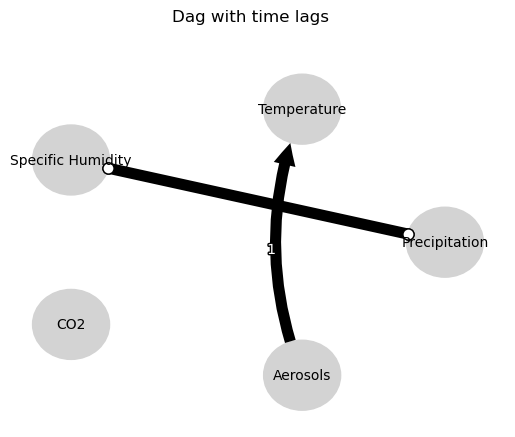

Negative precipitation values in event 110: 0


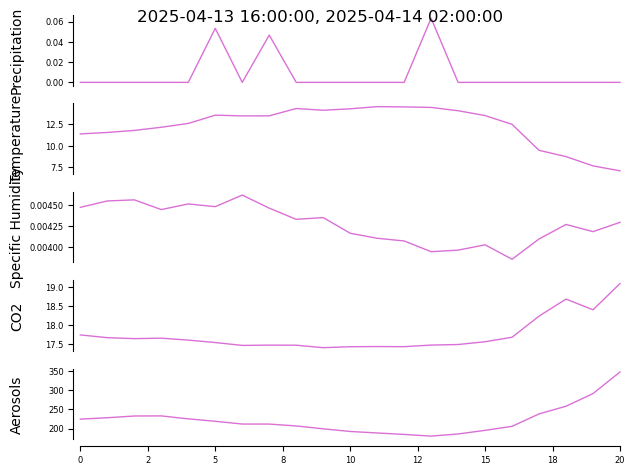


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


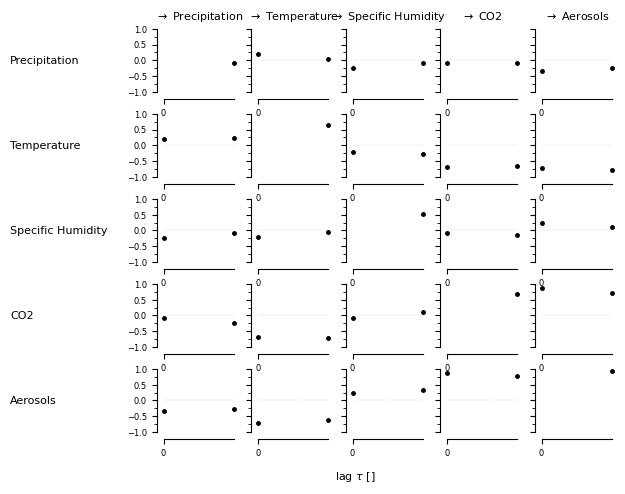

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.02864, |min_val| =  0.515

    Variable Specific Humidity has 1 link(s):
        (Specif

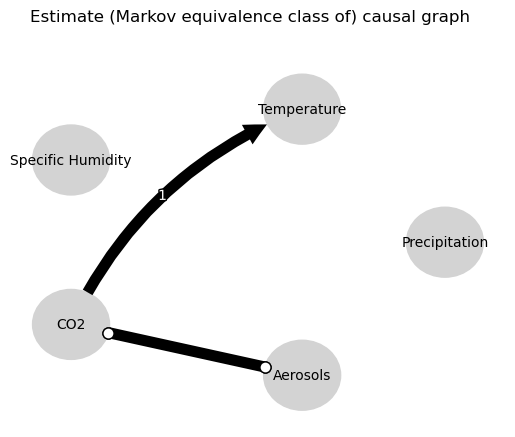

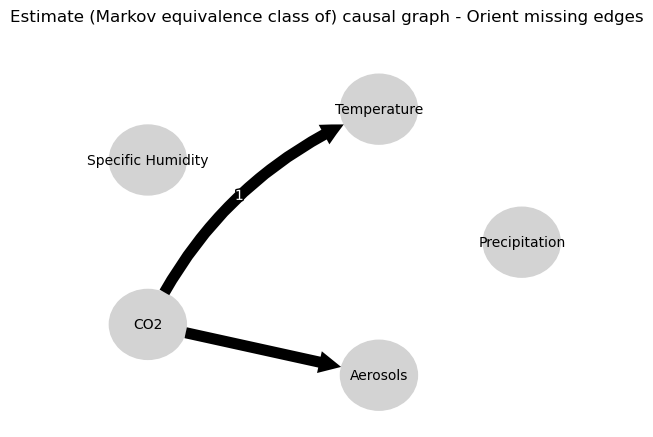

0.0
-0.06480725657675646
-0.01142738516743749
0.1928785355493676
-0.004715328790349991
-0.004507991009195966
-0.1690496240257057
0.0124730199654209
-0.22362836413198736
0.012555448788384162
-0.01142738516743749
-0.07293995280335118
0.0
0.030987677908292214
0.020884003807618148
0.007983404378440275
-0.061542816432987986
0.08894548956041991
-0.04224609968962762
0.04630067589304917
0.020884003807618148
0.03879584430360651
0.0
-0.035523106585426935
-0.03210752128916838
0.058407887425077194
0.19033043796488483
-0.008415583024904066
-0.061542816432987986
-0.7764273573070721
-0.03210752128916838
-0.03257484998424106
0.0
-0.00974316335893904
0.8503816282892852
-0.008904666621880445
-0.04224609968962762
-0.6960193698414012
0.19033043796488483
-0.02491008381615549
0.8503816282892852
-0.008738695177414825
0.0
-0.04595451916457171


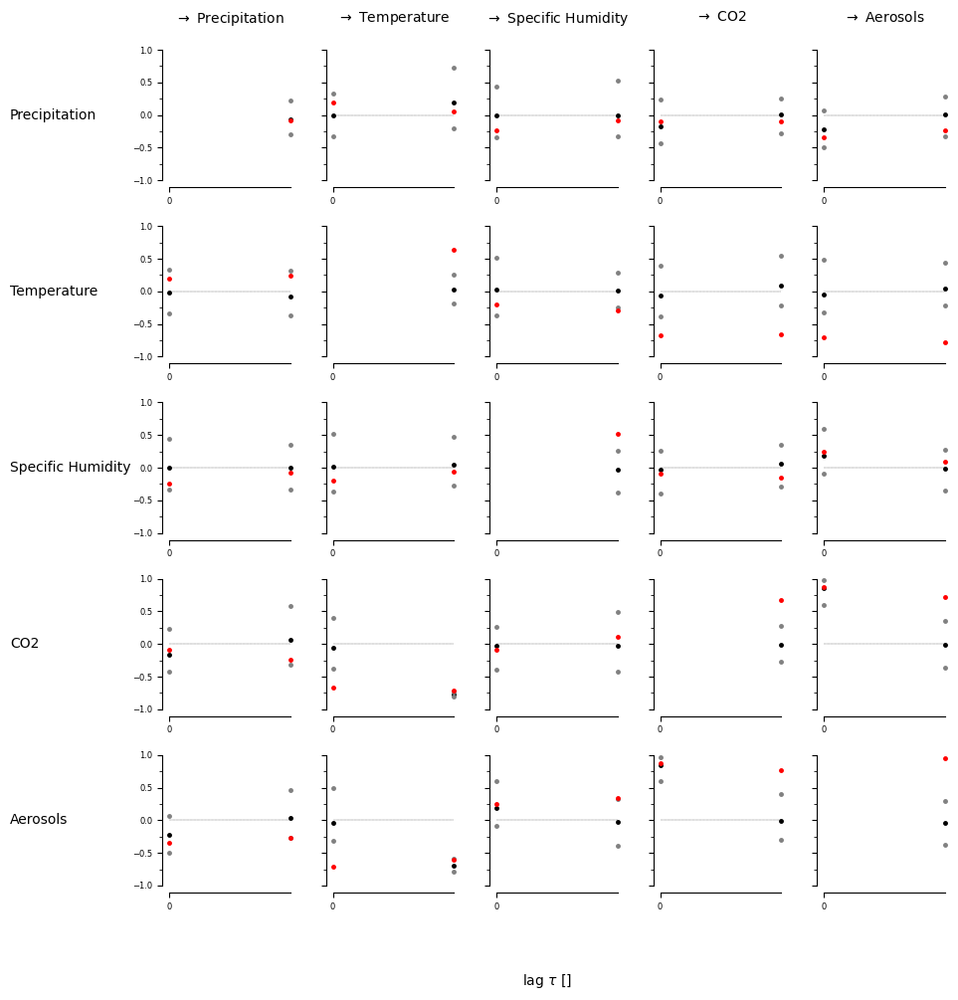

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [ True  True]
  [False  True]]]


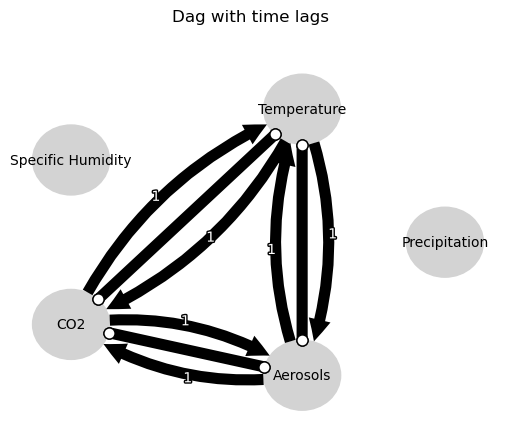

Negative precipitation values in event 111: 0


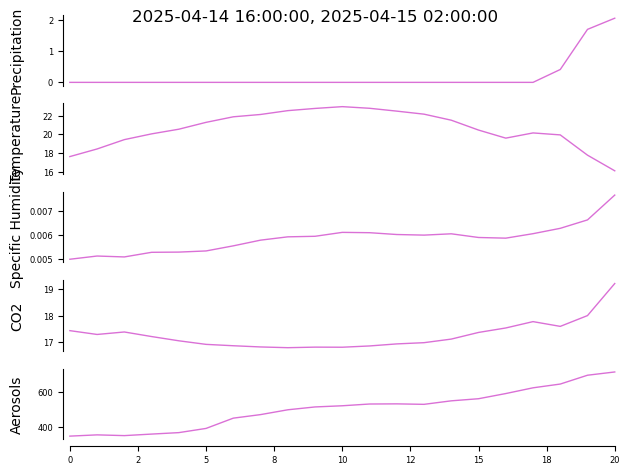


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


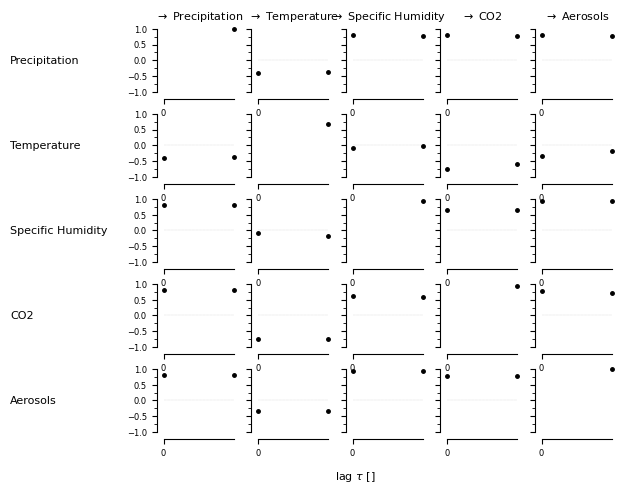

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 3 link(s):
        (Precipitation -1): max_pval = 0.00000, |min_val| =  0.988
        (CO2 -1): max_pval = 0.04803, |min_val| =  0.486
        (Aerosols -1): max_pval = 0.

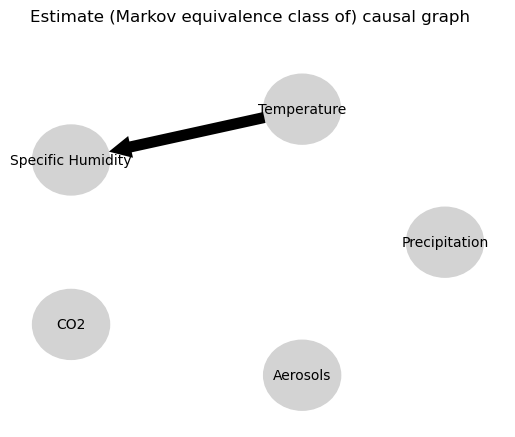

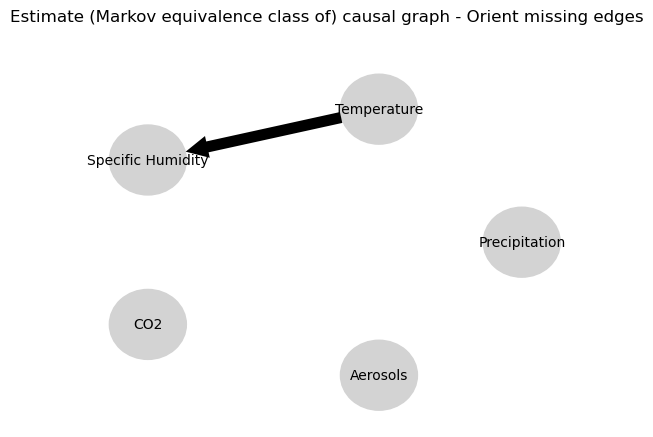

0.0
0.9889698687996403
0.005074989235530364
0.01046782394934266
-0.0546644671070425
-0.052521448776881294
0.03170048200653889
0.03329905311764262
0.10184775868137823
0.10212643012236532
0.005074989235530364
0.0007584135559715775
0.0
-0.03353998088348513
0.07690838225569792
0.06511828172387926
0.04191435765154166
-0.03765746342502073
0.0072634355039851994
0.015015797215357056
0.07690838225569792
0.14809800108944943
0.0
0.918966181832838
0.36032572182203365
0.3701774327664407
0.14606759061046043
0.13913001013213663
0.04191435765154166
0.048914562594316875
0.36032572182203365
0.3611101168412434
0.0
0.982225167664302
0.17636137614141978
0.17086059924380842
0.0072634355039851994
0.025637887980239568
0.14606759061046043
0.11236581896889744
0.17636137614141978
0.24533989950481097
0.0
0.5983091143064897


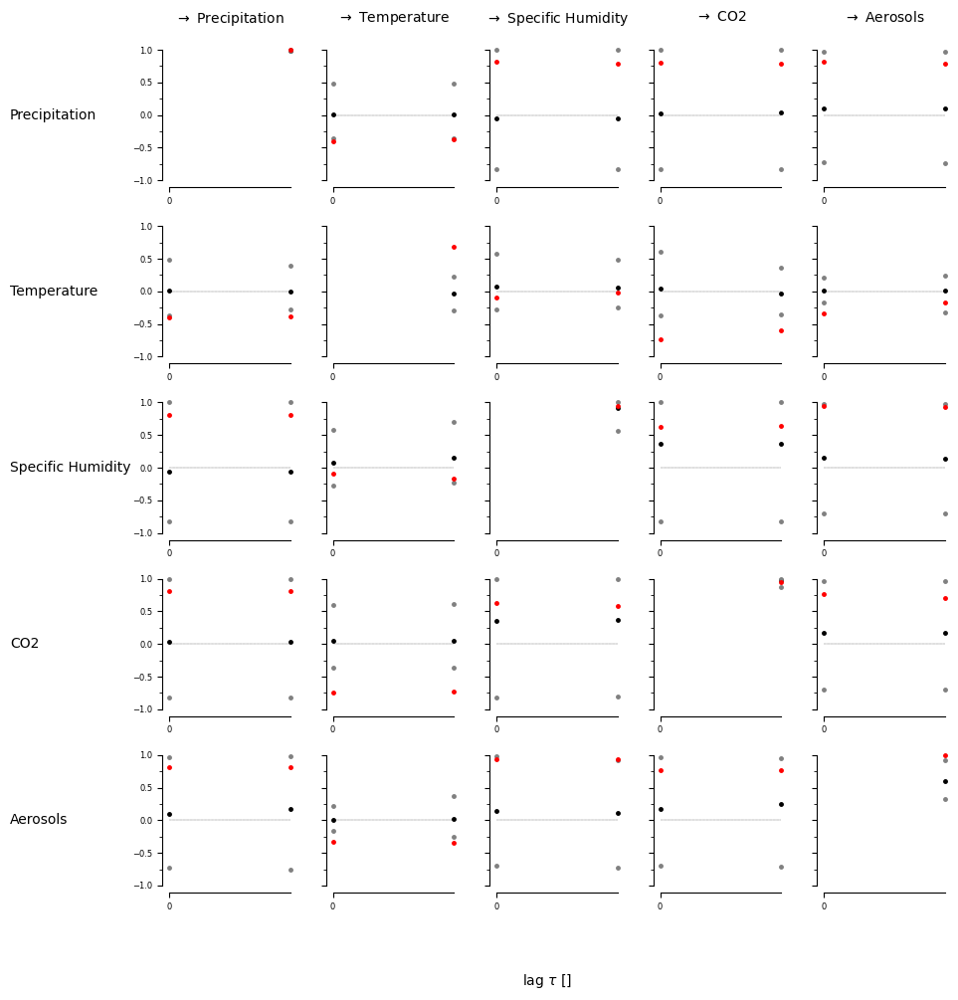

[[[False  True]
  [False False]
  [ True  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[ True  True]
  [False False]
  [False  True]
  [ True  True]
  [ True  True]]

 [[ True  True]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[ True  True]
  [False False]
  [ True  True]
  [ True  True]
  [False  True]]]


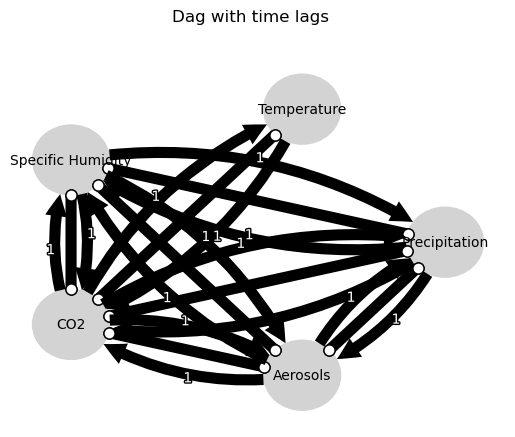

Negative precipitation values in event 112: 0


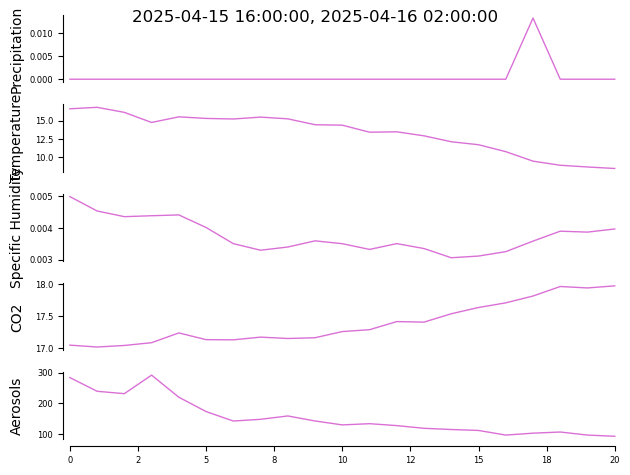


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


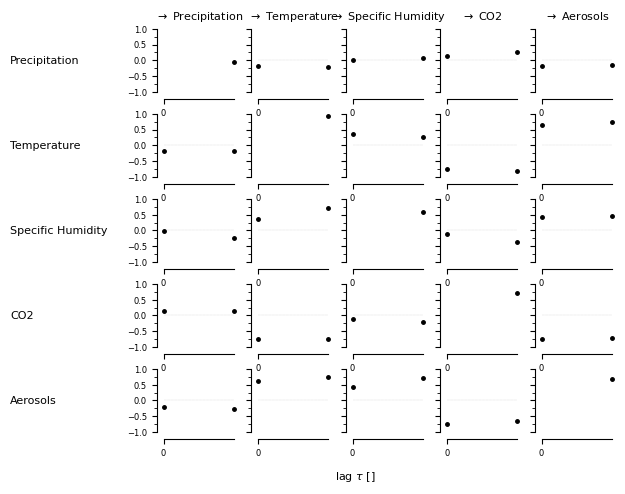

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 2 link(s):
        (Temperature -1): max_pval = 0.00001, |min_val| =  0.855
        (Aerosols -1): max_pval = 0.01436, |min_val| =

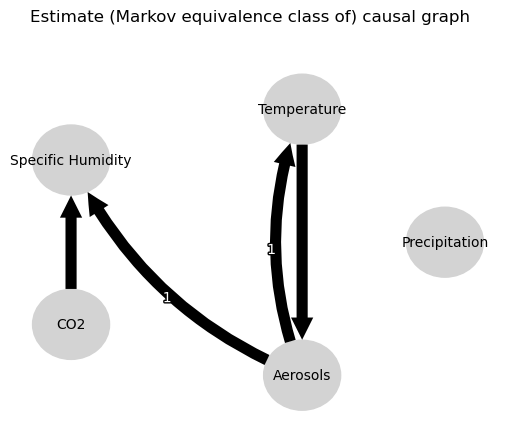

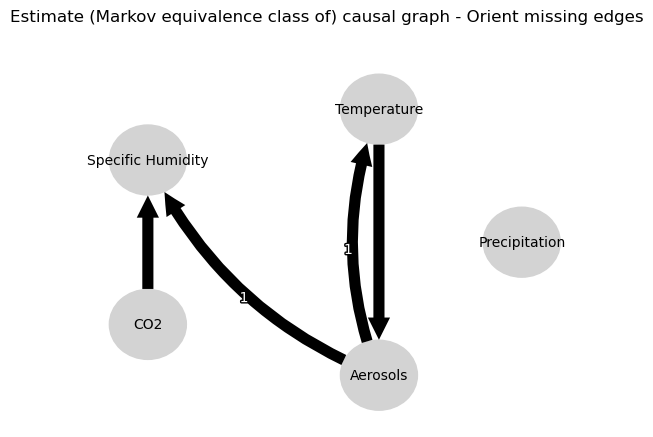

0.0
-0.0778606890207601
-0.08393565488750872
-0.08566958376088452
0.12119000415379275
-0.08286907960879655
0.18584721581452648
-0.057085732847433346
-0.06436168224504939
-0.06888489195635887
-0.08393565488750872
0.10992778173920294
0.0
0.4860026155869254
0.06009959145358713
-0.04780879442682324
0.06560250387934105
0.017812865153189635
-0.053186299943956836
0.23503448715090905
0.06009959145358713
0.0636436887478294
0.0
0.029424332705644134
0.44637460912777743
-0.03694005276922421
0.09610259431274229
-0.025345993473240402
0.06560250387934105
-0.046106898522657216
0.44637460912777743
-0.12211093363703764
0.0
-0.08839174874883969
-0.09022244090161026
-0.008346542523154171
-0.053186299943956836
0.21515086471886402
0.09610259431274229
0.5979727355407517
-0.09022244090161026
-0.07032333685433335
0.0
0.037951769544694196


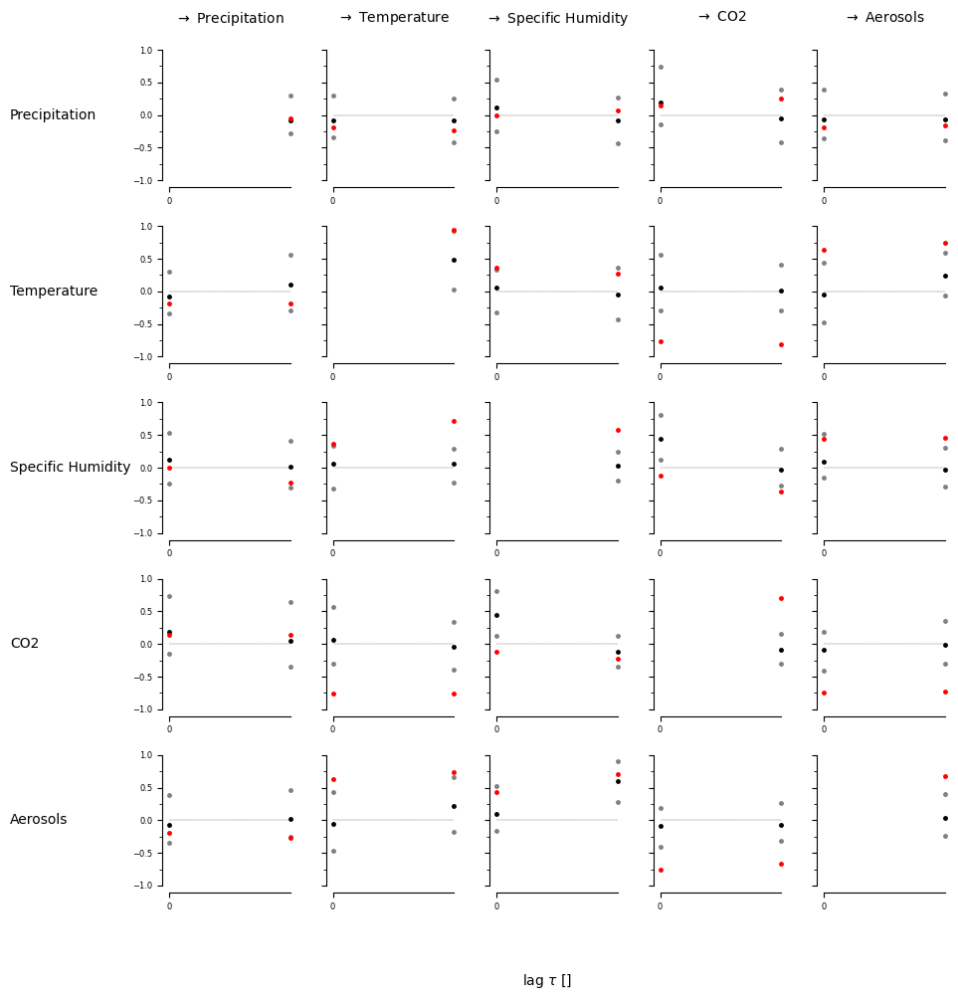

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False  True]
  [ True  True]
  [False  True]]]


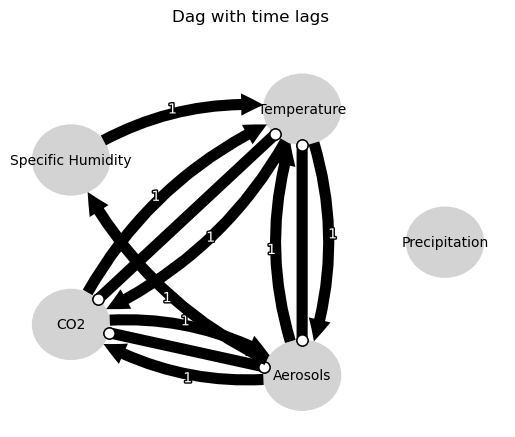

Negative precipitation values in event 113: 0


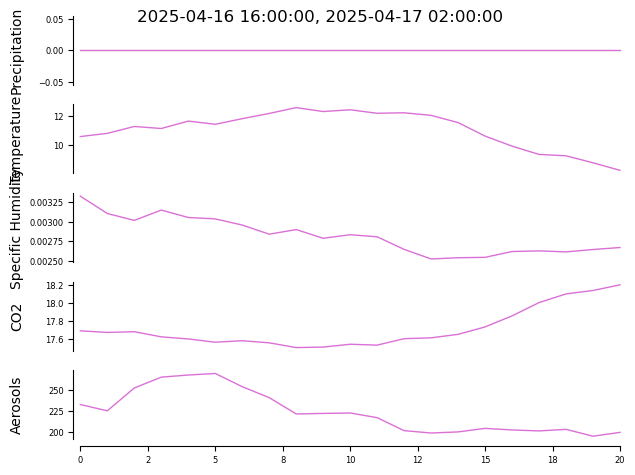


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


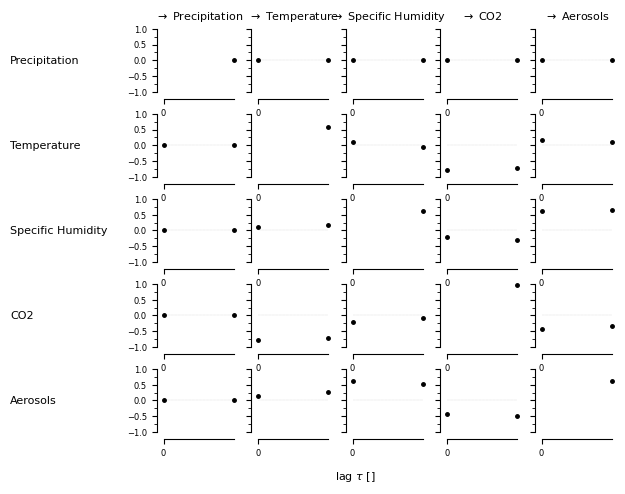

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.04020, |min_val| =  0.487

    Variable Specific Humidity has 0 link(s):

    Variable C

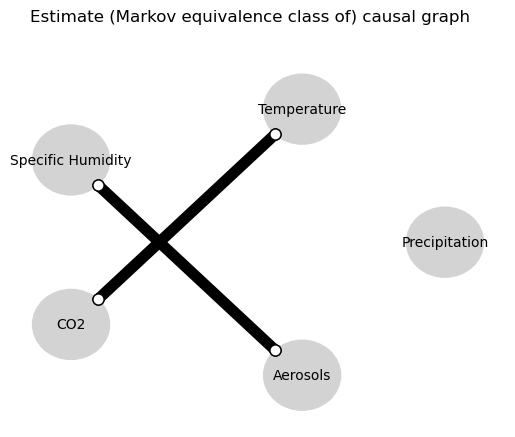

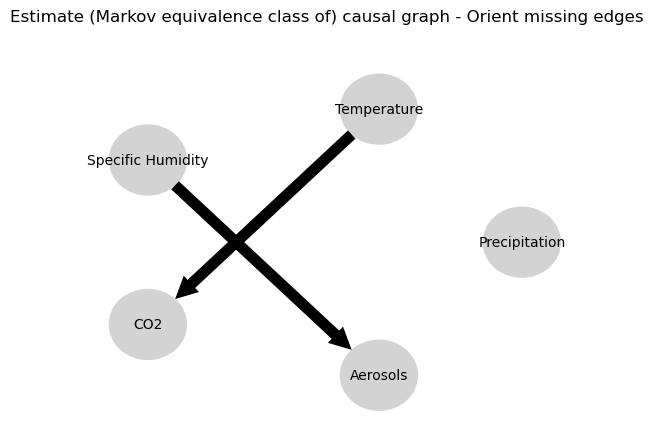

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.020228380182020292
0.25505013819114786
-0.0482675875917982
-0.6052403175807258
-0.3079604905316221
0.3420894669565328
-0.056676505001936175
0.25505013819114786
-0.033150420081189194
0.0
-0.07867648369105812
-0.3305681094695277
-0.191145023624153
0.7654539415539507
-0.0834094729392
-0.6052403175807258
0.1511795167437456
-0.3305681094695277
0.10561703265343163
0.0
0.3226513801236601
-0.3700672508660952
0.0985169550686949
0.3420894669565328
-0.020191492538820577
0.7654539415539507
-0.03954237270775153
-0.3700672508660952
-0.21946124373250367
0.0
-0.0676180179397053


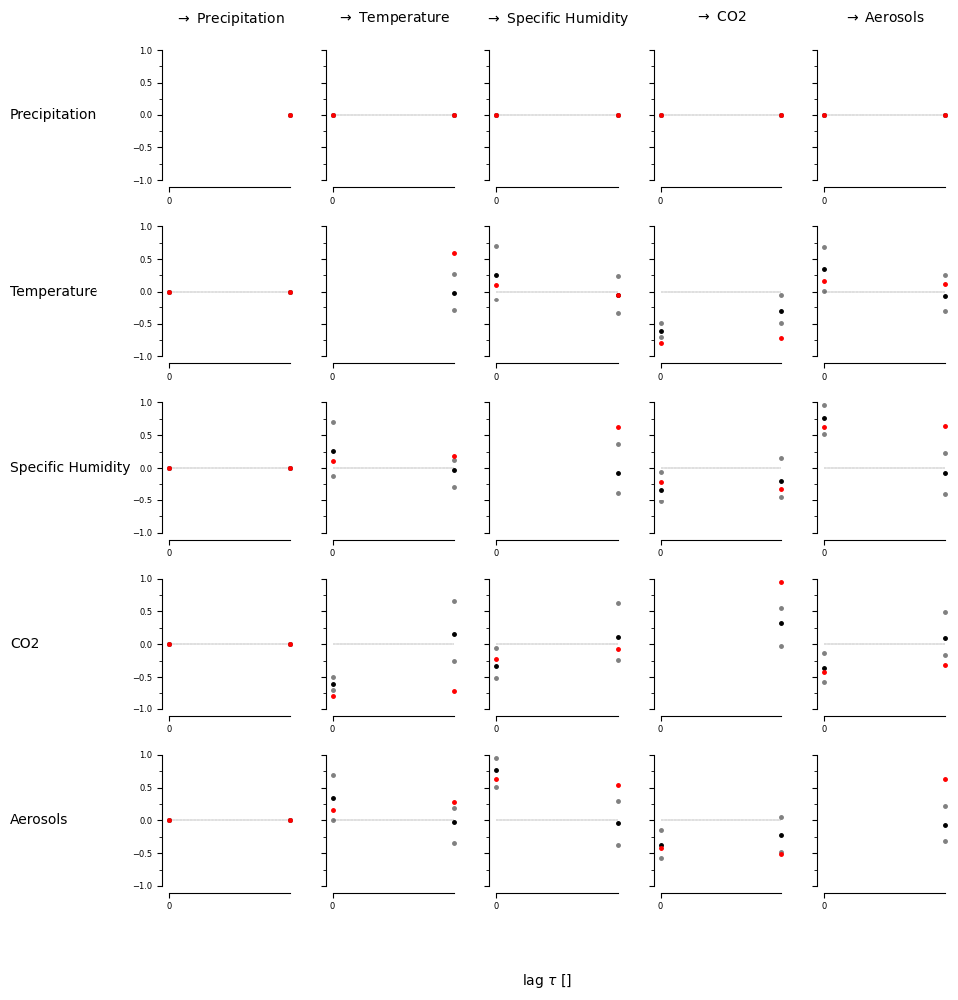

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False  True]]]


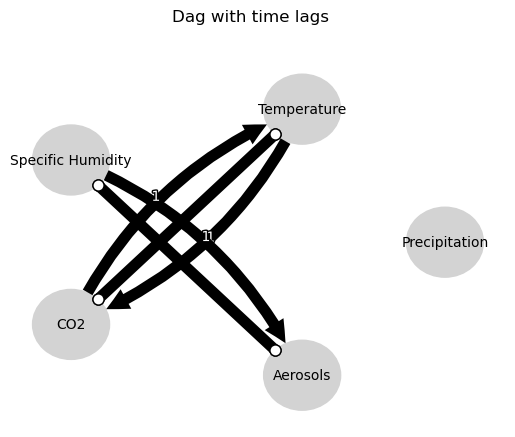

Negative precipitation values in event 114: 0


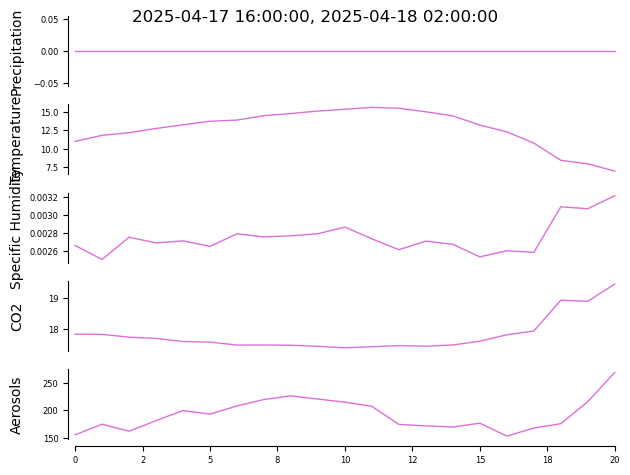


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


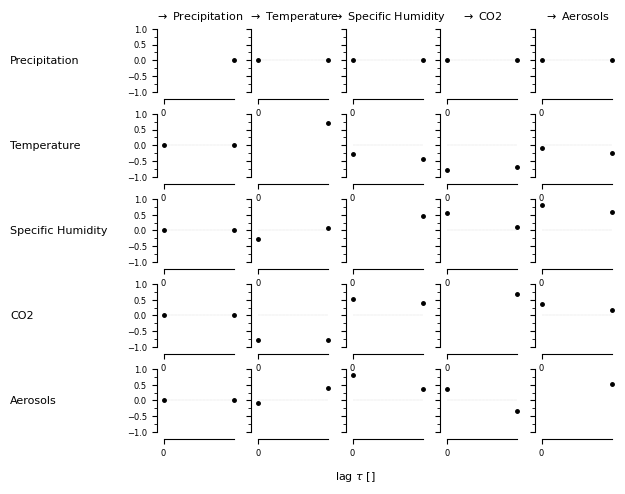

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.02488, |min_val| =  0.526

    Variable Specific Humidity has 0 link(s):

    Variable C

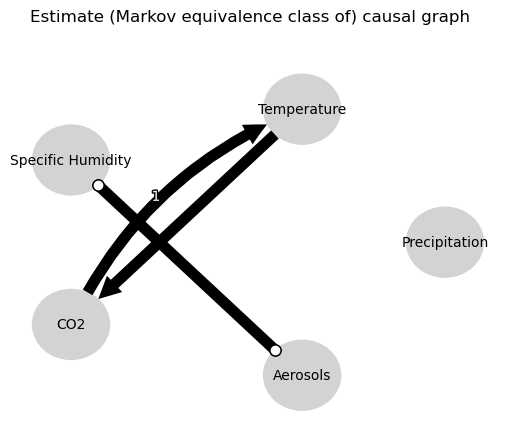

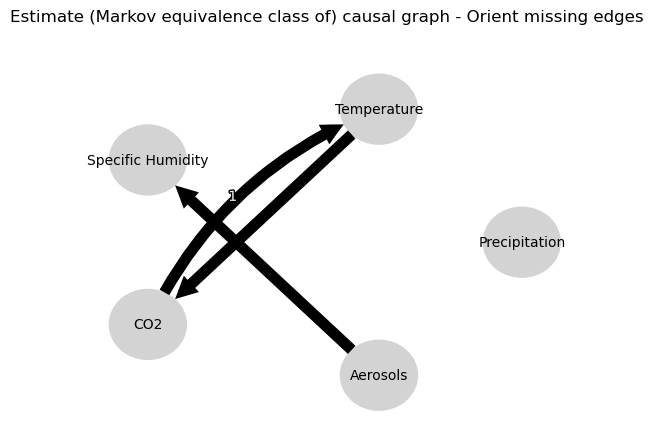

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.8667470078707258
0.015602952723728417
-0.007988880695834684
-0.7934651461032611
-0.7501121726105014
0.05160508702250892
-0.0384724156565395
0.015602952723728417
-0.021386365588143337
0.0
-0.051507213640740505
0.009815305955375211
0.008704288614051063
0.5562005367688828
0.00687290893022237
-0.7934651461032611
-0.7784389460176834
0.009815305955375211
-0.04322190500158814
0.0
0.8927702158374381
-0.025647828861523354
-0.031500385448896155
0.05160508702250892
-0.014243065900910264
0.5562005367688828
-0.04627538889899625
-0.025647828861523354
-0.014490982471290164
0.0
-0.043810455435720375


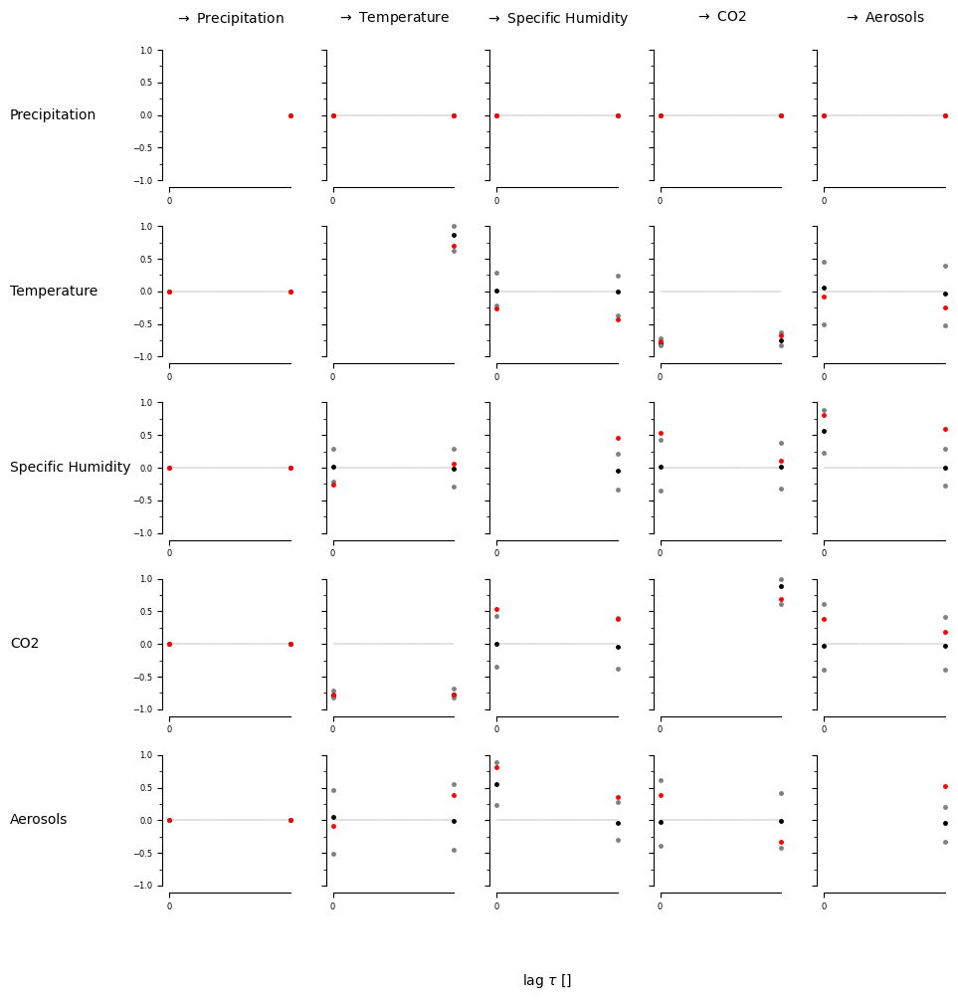

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False False]]]


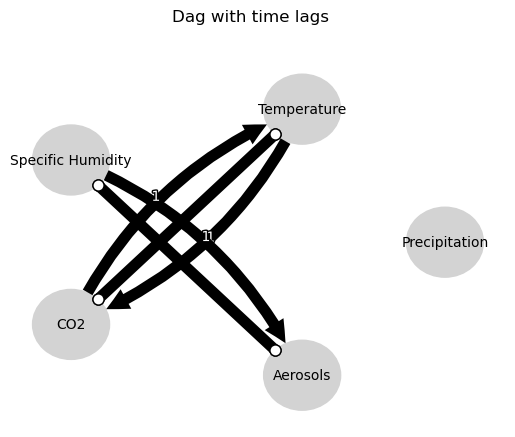

Negative precipitation values in event 115: 0


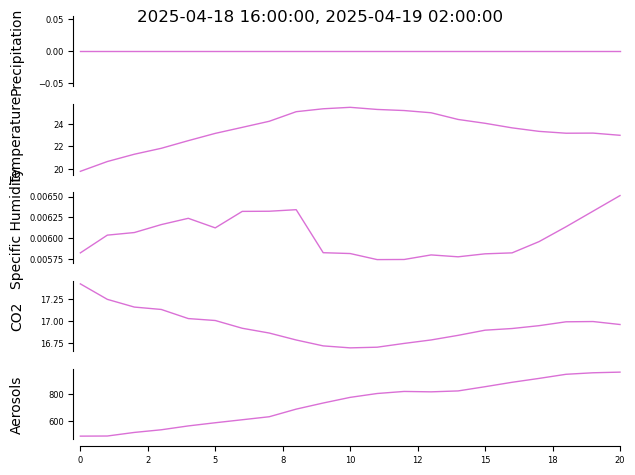


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


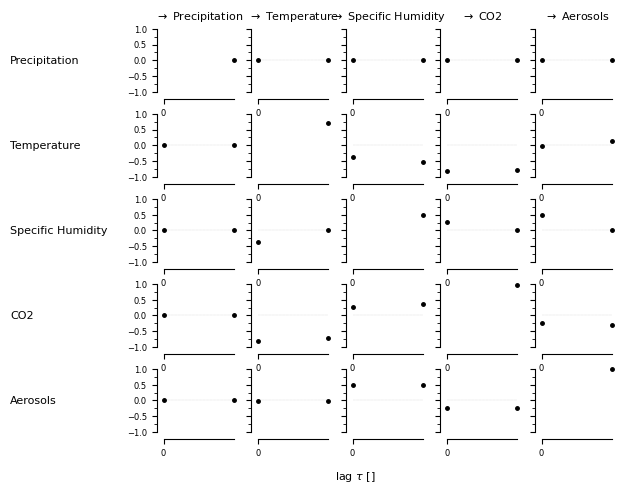

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 2 link(s):
        (Aerosols -1): max_pval = 0.03386, |min_val| =  0.488
        (T

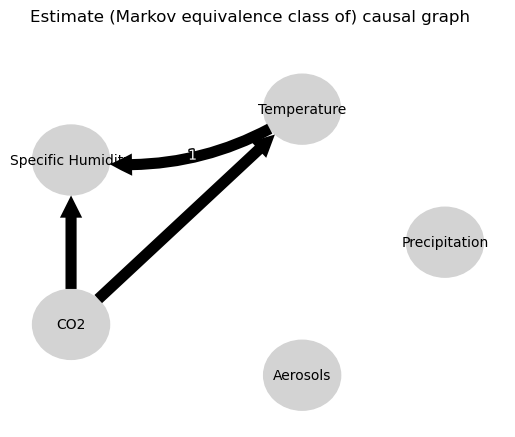

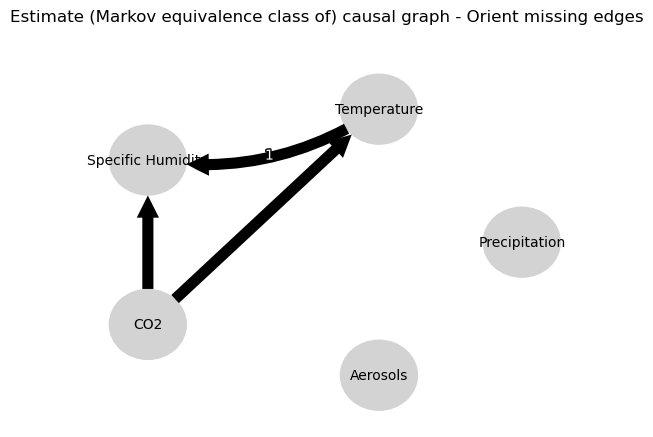

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.39529586478755196
0.08892069164929758
-0.21671947588516802
-0.743612107879288
-0.39088986654272245
0.20040356270358514
0.14508834595455106
0.08892069164929758
0.02027027158699852
0.0
-0.07858568377306566
-0.05880616653801578
-0.04495650489902567
0.01379991423856501
-0.039654660512448495
-0.743612107879288
-0.47483249962282664
-0.05880616653801578
0.16570645698464273
0.0
0.43531480362866476
-0.1930834316338814
-0.09224541165697284
0.20040356270358514
0.046249888756852105
0.01379991423856501
-0.038265874861926306
-0.1930834316338814
-0.07363366766248856
0.0
0.5567233104902264


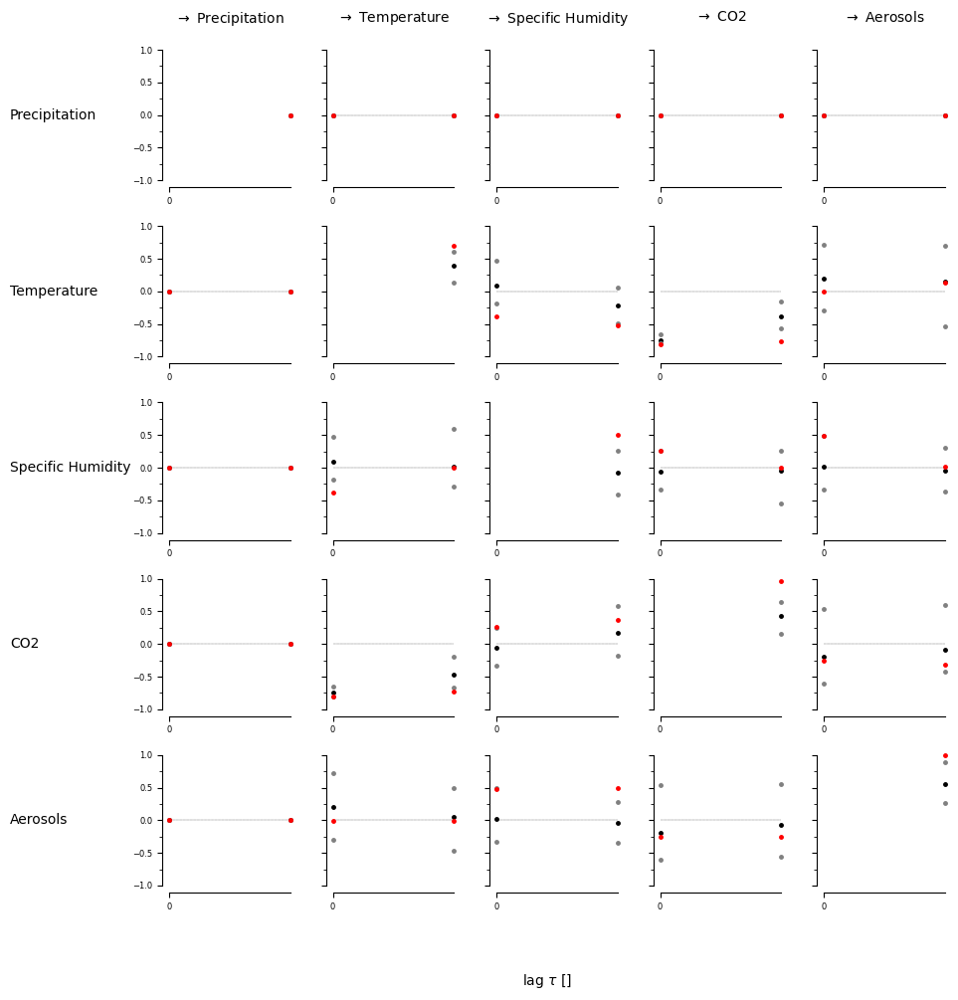

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


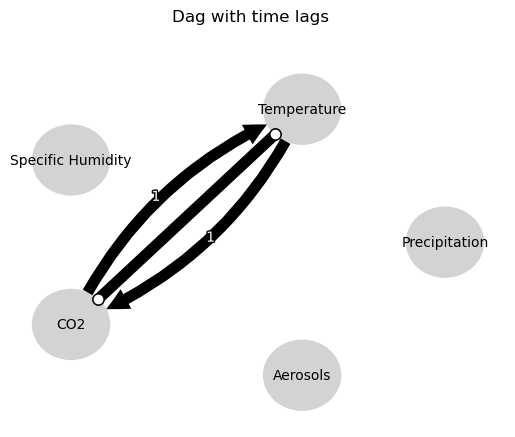

Negative precipitation values in event 116: 0


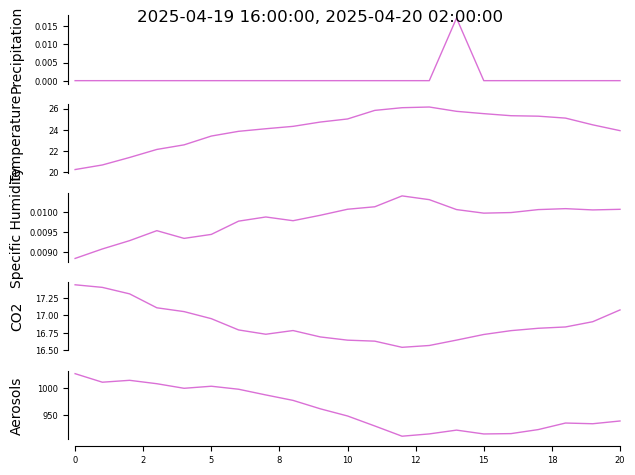


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


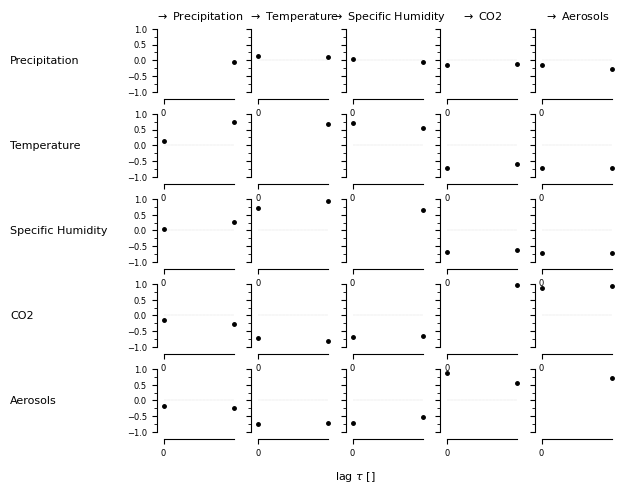

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Temperature -1): max_pval = 0.00021, |min_val| =  0.752

    Variable Temperature has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00000, |m

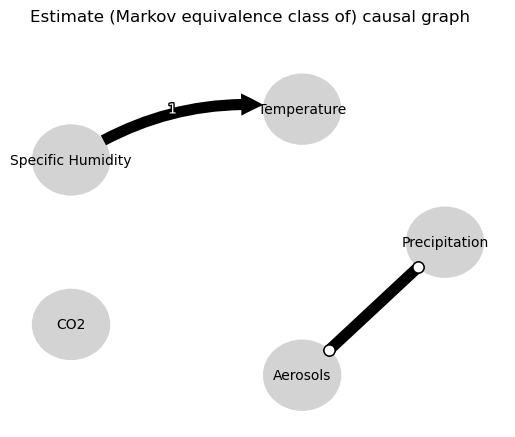

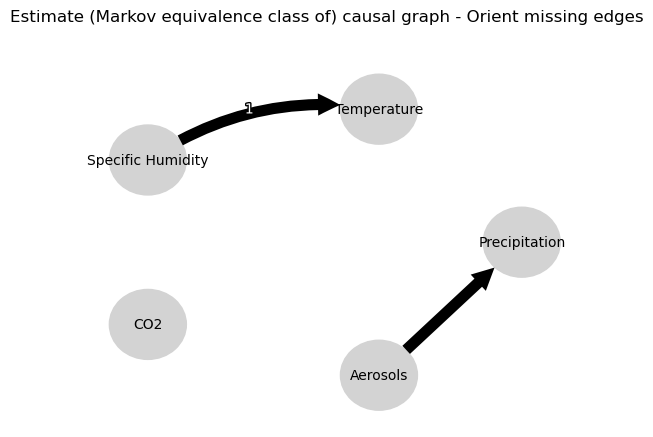

0.0
-0.06537735632936814
-0.01169771593336772
0.09969862277349213
0.06411202238362526
0.0008241014073307888
0.04058627110893302
0.01382510617958174
-0.10994907830335796
0.04991560373612204
-0.01169771593336772
-0.04368461079894411
0.0
0.008944169794854894
0.04614371602173769
-0.05710731207570131
-0.11769741783299136
-0.08648466631049244
-0.10616800726154393
-0.001463583029404214
0.04614371602173769
0.8374040886015124
0.0
-0.05268998797219991
0.03967132504391312
0.026586801505887304
-0.7013578675078659
-0.02527727653193172
-0.11769741783299136
0.03904481487044784
0.03967132504391312
0.04779008788185228
0.0
0.47957216953762427
-0.1800802861655856
-0.023655636364060484
-0.10616800726154393
-0.6353721214760742
-0.7013578675078659
0.11186369189807643
-0.1800802861655856
-0.13033169046654142
0.0
-0.0438664419562254


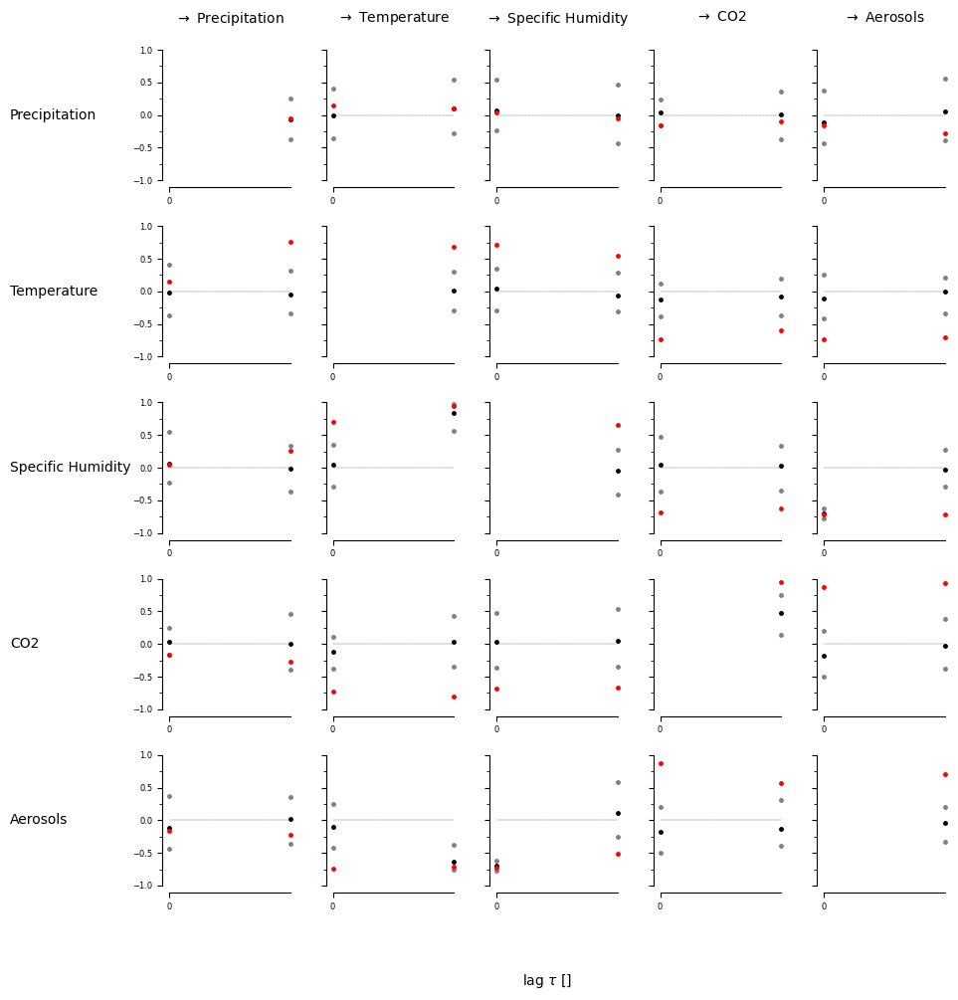

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False  True]
  [False  True]
  [ True False]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True False]
  [ True False]
  [False  True]]]


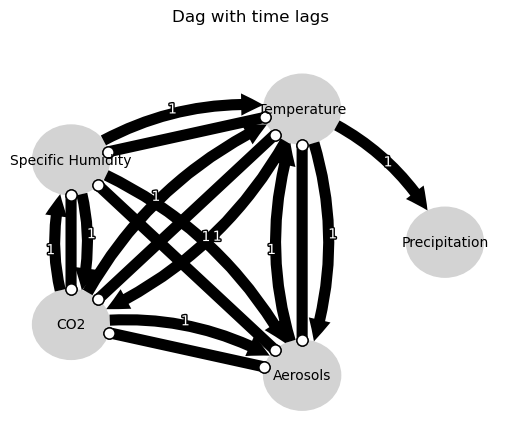

Negative precipitation values in event 117: 0


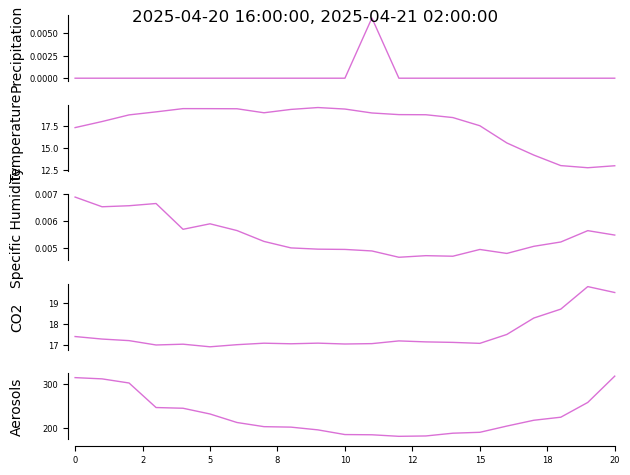


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


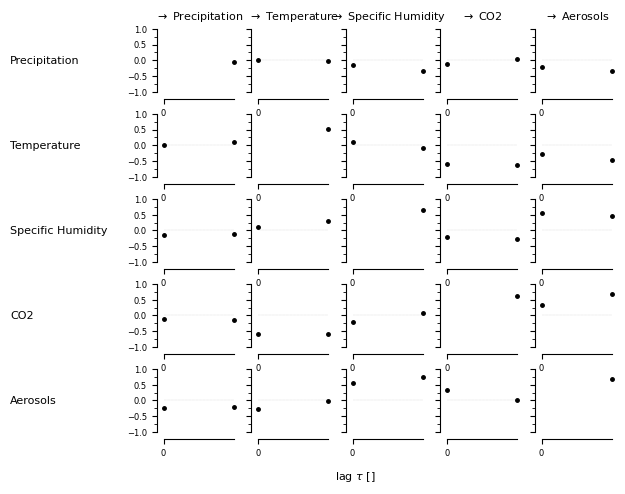

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Aerosols -1): max_pval = 0.01513, |min_val| =  0.562

    Varia

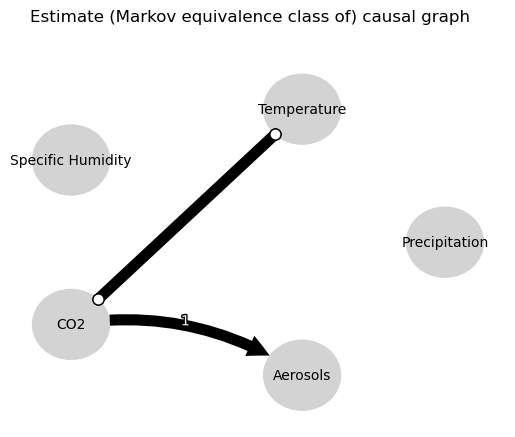

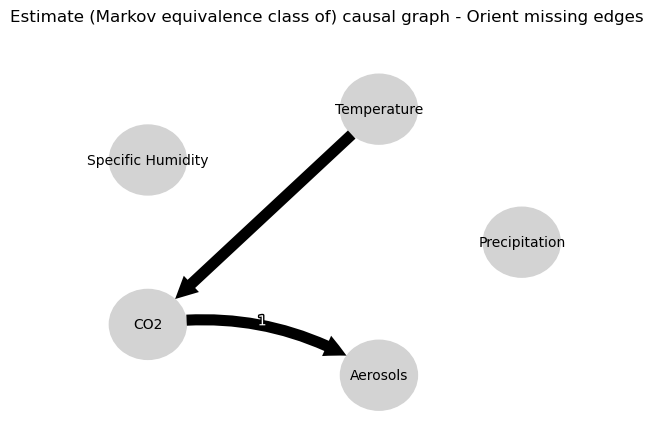

0.0
-0.06939059303414494
0.128091745518848
0.02907943247605486
-0.12364940158110975
0.007218937345650765
-0.11600505527080199
-0.037812617783953
-0.08360850797445044
-0.037657653239329666
0.128091745518848
-0.03081924041547772
0.0
-0.040246823287850224
-0.025266630062381456
-0.02588582943948
-0.7498811076576335
0.044950808560259216
0.07582952314845971
-0.5035994559725295
-0.025266630062381456
-0.018023641560618413
0.0
-0.05880955744078189
0.08907103371715176
-0.03224257628121381
0.571807962413398
0.05584203914092118
-0.7498811076576335
0.022473355833634526
0.08907103371715176
-0.004633055742381422
0.0
-0.03846309538581818
-0.0822922444840352
0.5503445192548654
0.07582952314845971
0.029696604835189277
0.571807962413398
-0.05895201706022505
-0.0822922444840352
-0.054567469553751954
0.0
-0.09276365511981578


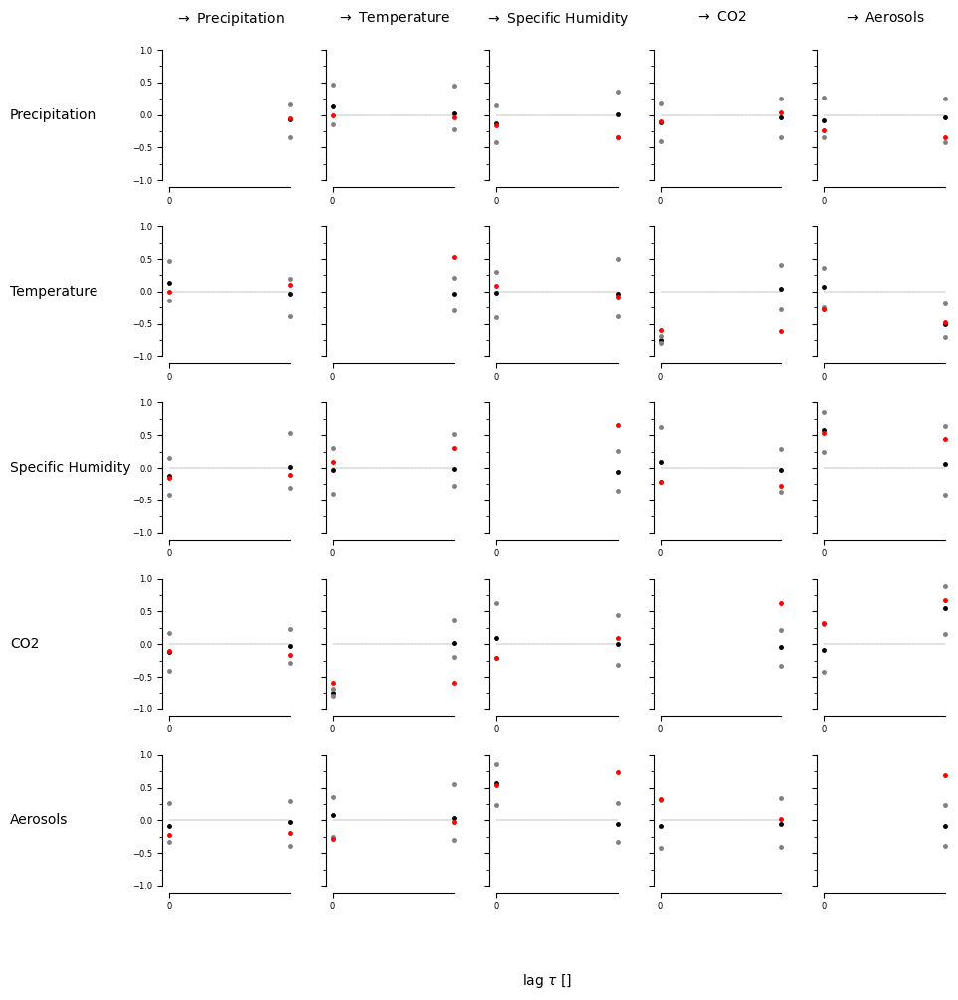

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False  True]]]


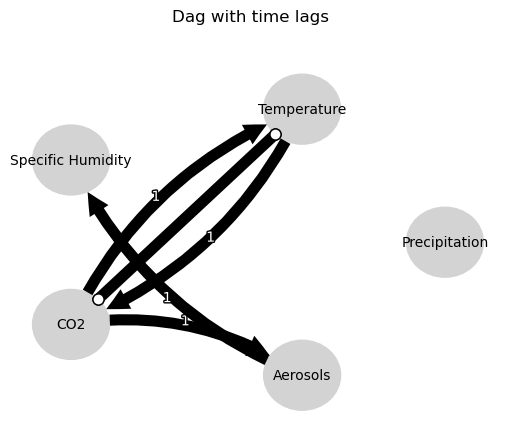

Negative precipitation values in event 118: 0


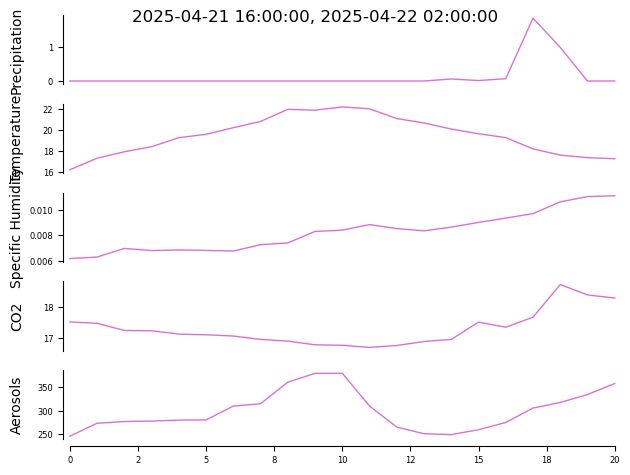


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


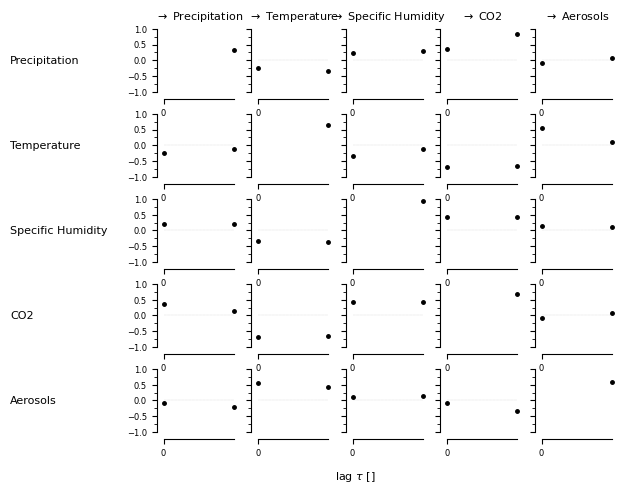

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00000, |min_val| =  0.942



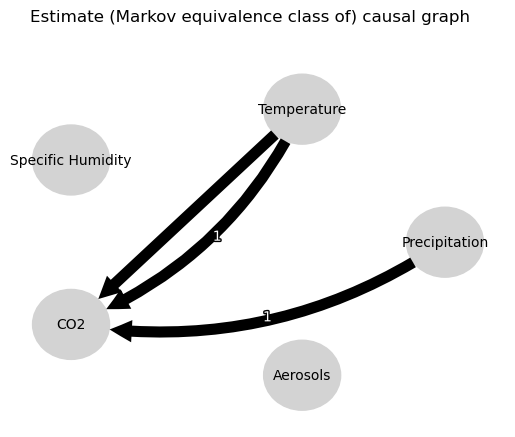

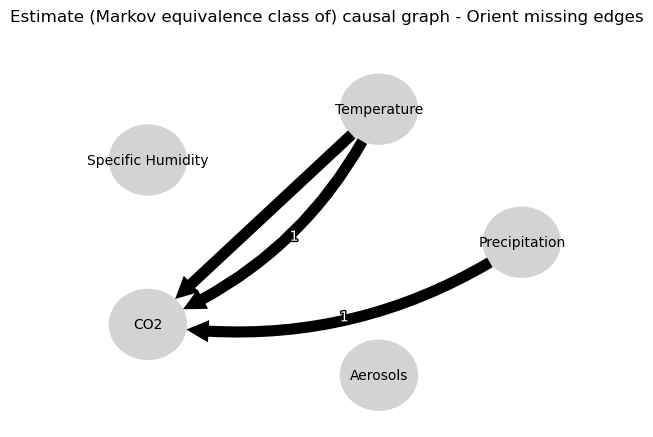

0.0
-0.10827365362464897
-0.2079192304486753
0.04724834998043997
0.0601295738418618
0.10478914026573359
0.19942208837431868
0.27684712426667824
0.04230841200221495
0.059386092984330445
-0.2079192304486753
0.0574940573040268
0.0
-0.04876203083568185
-0.038837980344654875
-0.06272513093906602
-0.6320469939081936
0.10827355415670911
-0.07645717626493269
-0.047056880556976474
-0.038837980344654875
-0.05904970145700396
0.0
0.613081401938993
0.04072832889611973
0.0686494882218358
0.13931854165097232
0.07790050723419581
-0.6320469939081936
0.015896579408064517
0.04072832889611973
-0.014032165353330961
0.0
-0.09432433548169125
0.15123612588245608
0.13387720193607106
-0.07645717626493269
0.04803206922209954
0.13931854165097232
0.14722954017079112
0.15123612588245608
-0.029525506042270534
0.0
0.49928933229599315


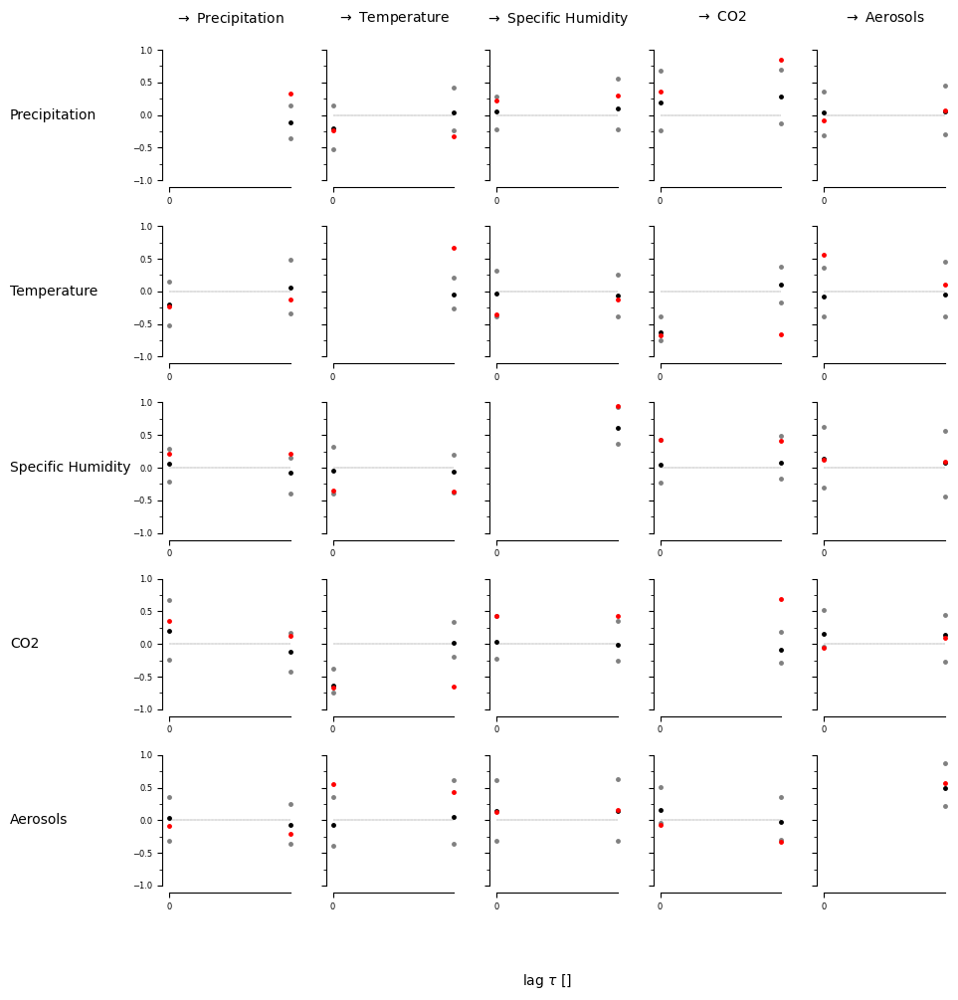

[[[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


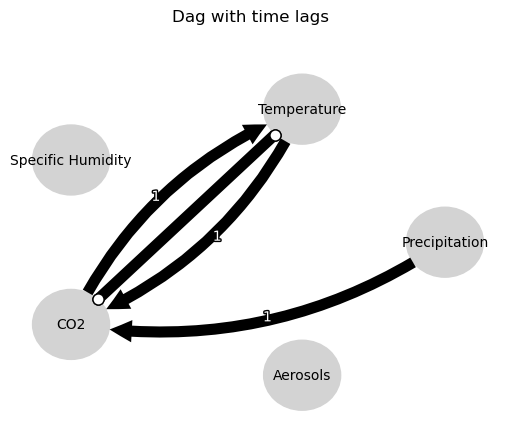

Negative precipitation values in event 119: 0


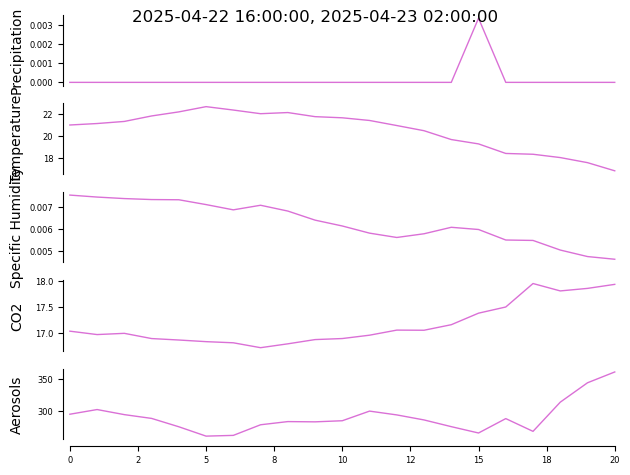


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


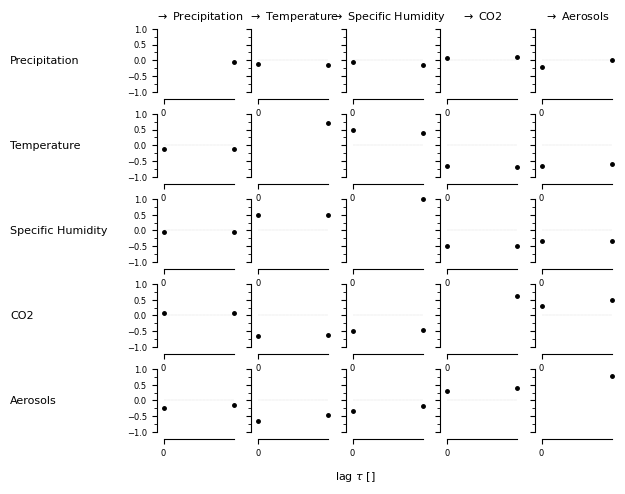

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.03185, |min_val| =  0.507

    Variable Specific Humidity has 1 link(s):
       

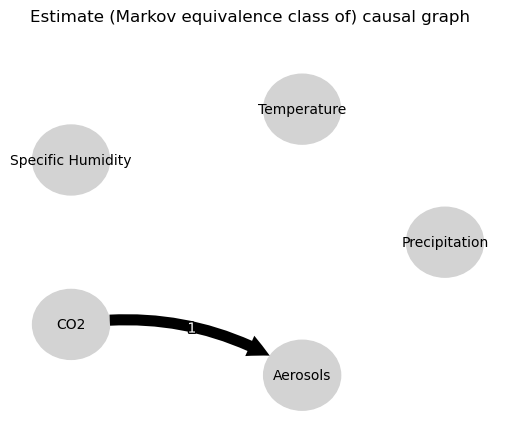

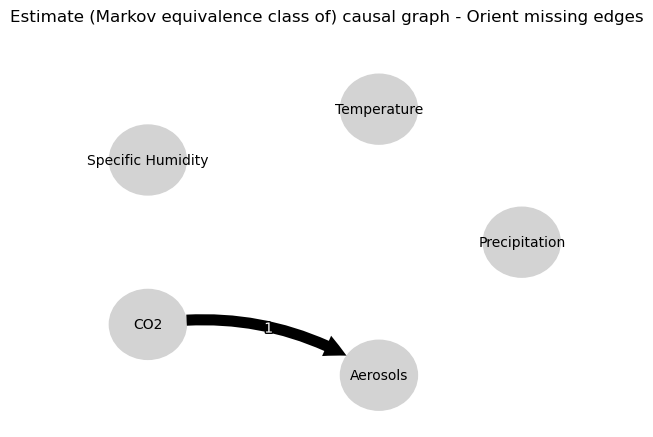

0.0
-0.042639698818091744
0.06806783145247988
0.02980895742879939
-0.05608975258209988
-0.04980388382997882
0.05298590934256348
0.050724646866751
-0.20288047544518564
-0.08842563310608957
0.06806783145247988
0.06671306611565318
0.0
0.8074172449006131
-0.0679195187424914
-0.051997716119681105
-0.05484198680378586
-0.027104000179014865
-0.04434985717357046
-0.033590629383357
-0.0679195187424914
-0.03893624196537826
0.0
0.5591861083591338
-0.07261197830385985
-0.004523688215420271
-0.14196998592609333
-0.06980355235101117
-0.05484198680378586
-0.07241581397851132
-0.07261197830385985
0.03172770649895818
0.0
-0.11823643904455389
-0.1923543612897901
0.37817875281249785
-0.04434985717357046
-0.012378863305633873
-0.14196998592609333
-0.147094052766204
-0.1923543612897901
-0.05709486343932814
0.0
0.37762713475505605


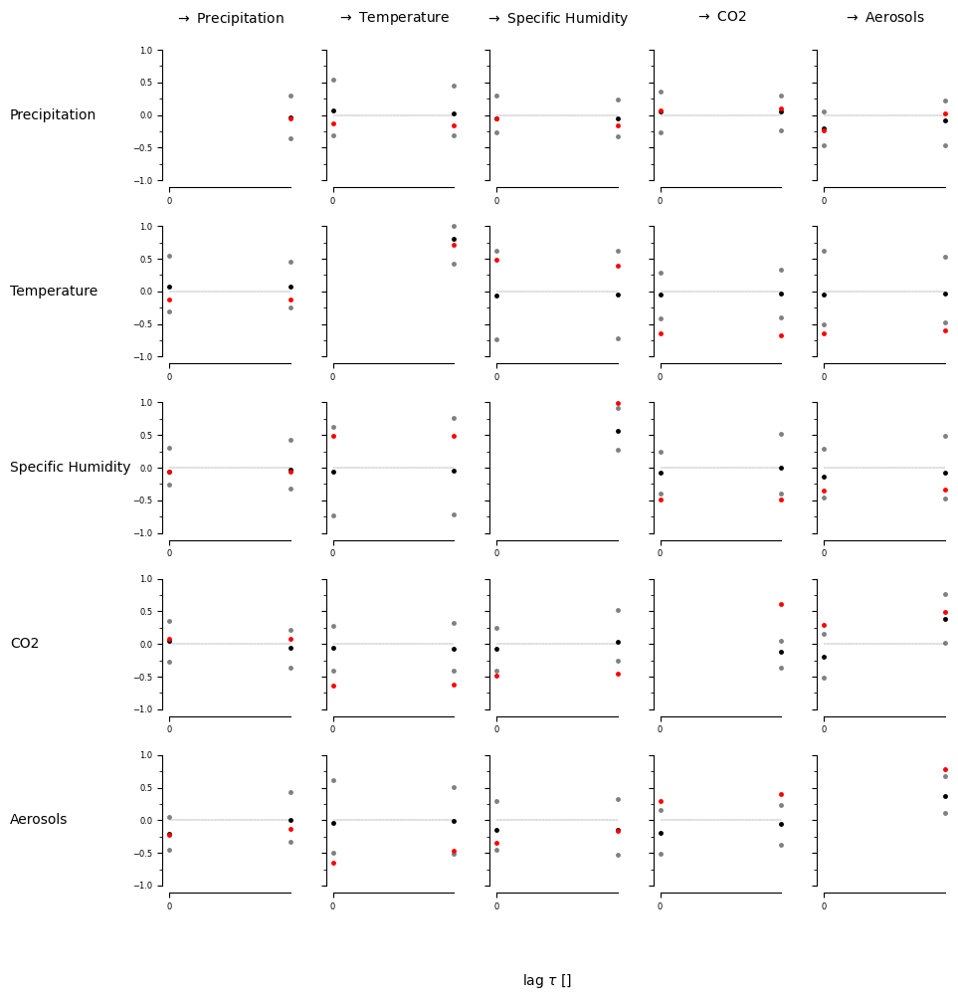

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False False]
  [False  True]]]


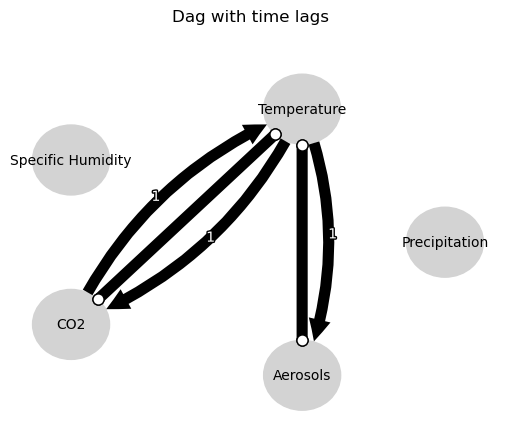

Negative precipitation values in event 120: 0


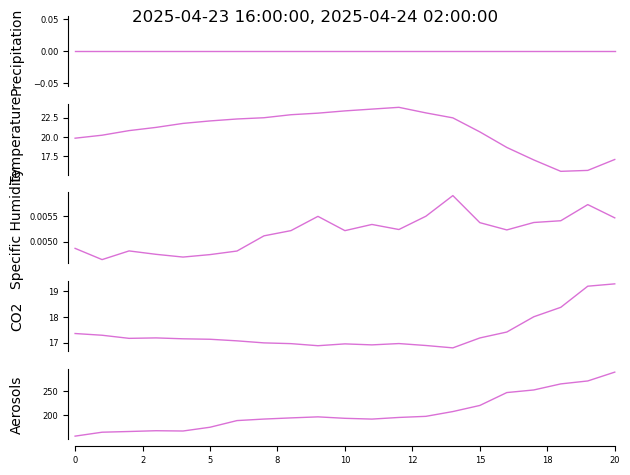


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


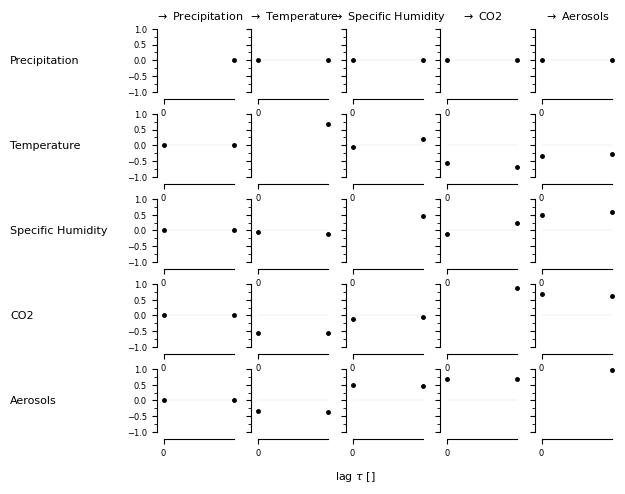

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.03070, |min_val| =  0.510

    Variable Specific Humidity has 0 link(s):

    Va

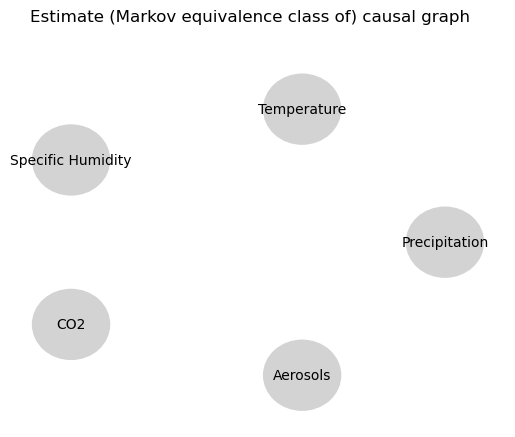

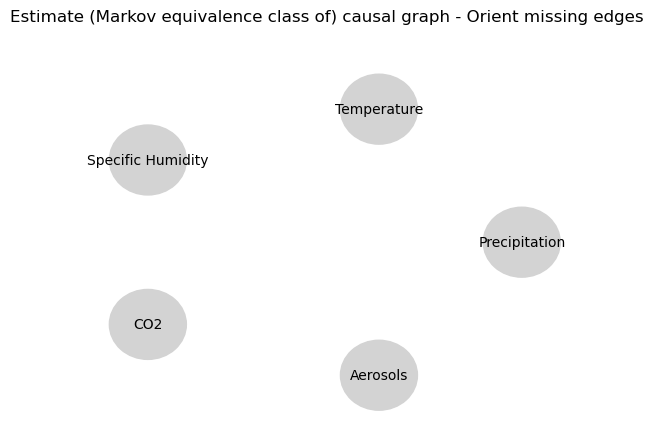

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.4986795807280656
-0.0982999624370834
0.15634207293313787
-0.06222697747135109
0.02048334016559034
-0.022348578880029914
-0.02260948512018684
-0.0982999624370834
-0.07854651180225727
0.0
-0.06463542084470952
0.017261473441635977
0.0031249915515473427
-0.020949111951295004
-0.04428441072572323
-0.06222697747135109
-0.03181776417791789
0.017261473441635977
-0.03232343964498205
0.0
0.9329414976824555
-0.11432099676547679
-0.10813370507558091
-0.022348578880029914
0.017798650586703175
-0.020949111951295004
0.0375253921942462
-0.11432099676547679
-0.10517932004514664
0.0
0.7572825991376863


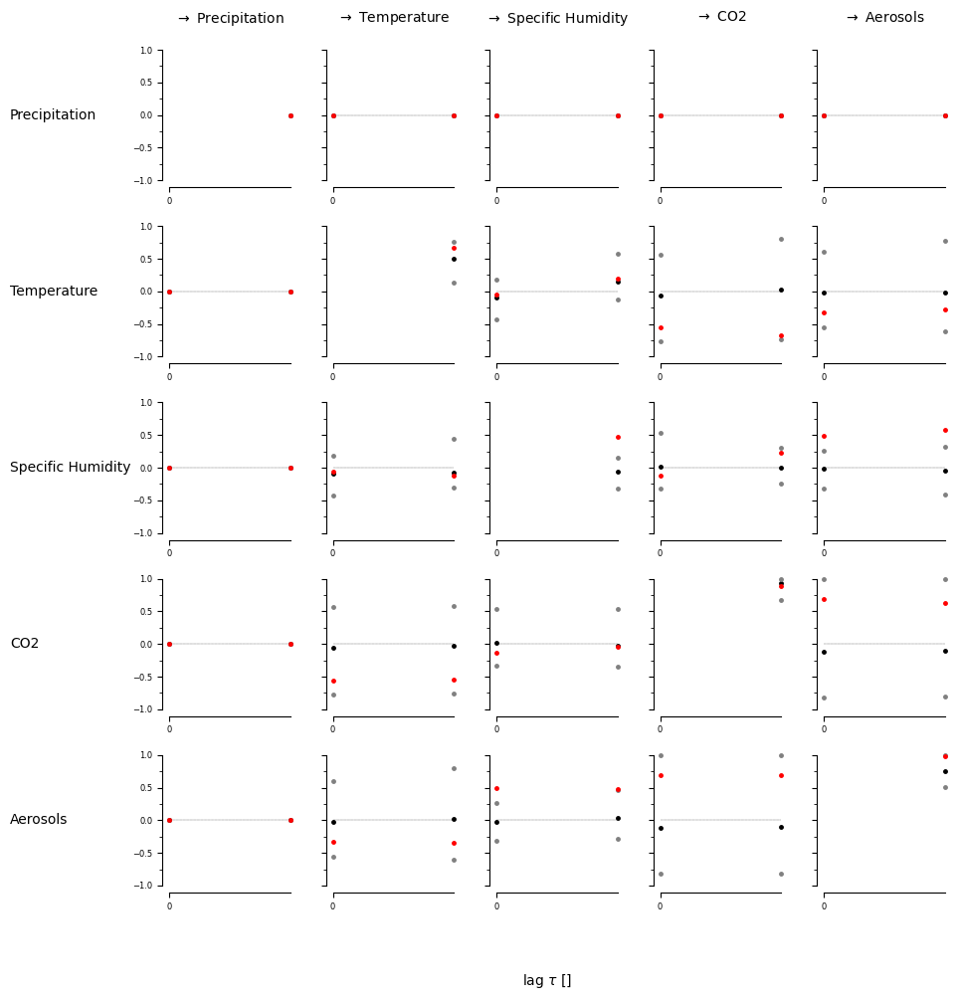

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False  True]]]


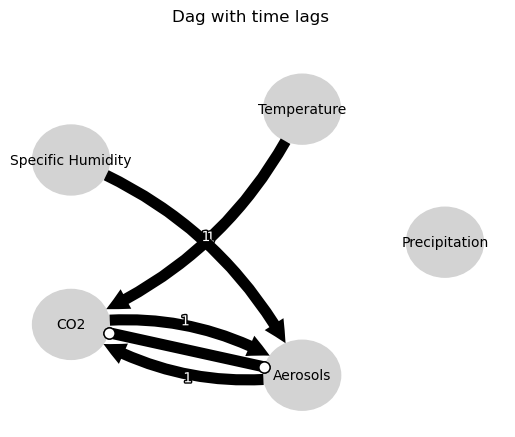

Negative precipitation values in event 121: 0


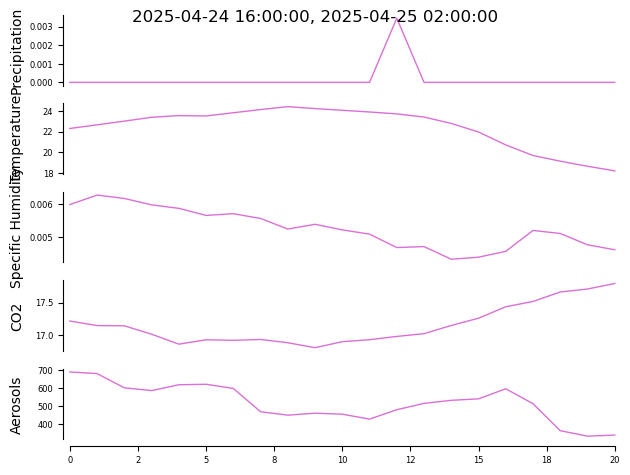


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


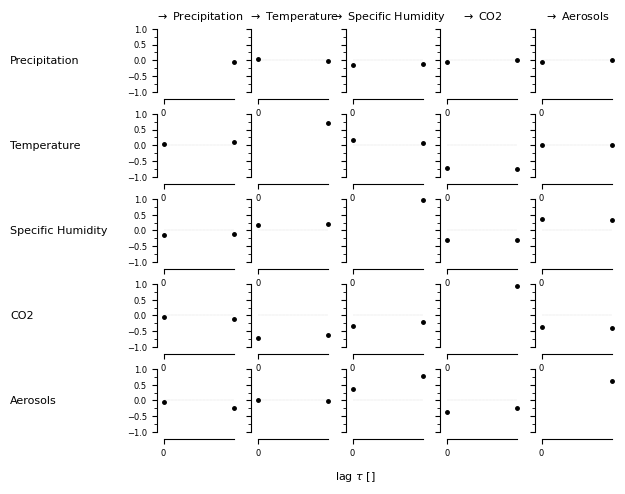

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.04893, |min_val| =  0.470

    Variable Specific Humidity has 1 link(s):
       

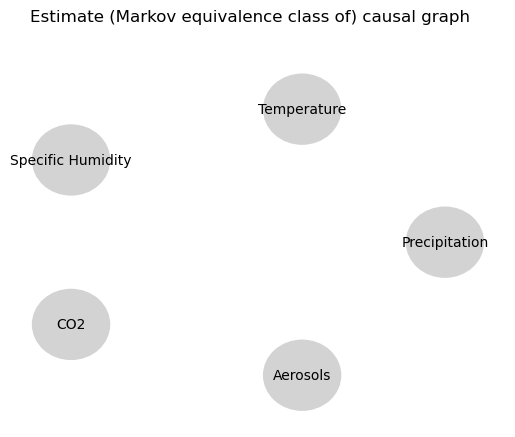

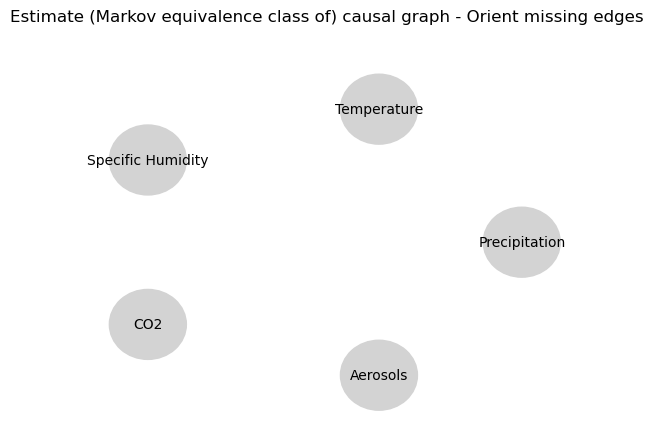

0.0
-0.084642760415173
0.010662804682114268
-0.008140695658599302
-0.17944725428386868
-0.09954830110399951
0.01181821786342413
-0.04141516980430764
0.1414009040043571
0.04887323879545509
0.010662804682114268
0.01083193632474843
0.0
0.8300009610634176
0.061993319599112695
0.015579027790612225
-0.2479322856044973
-0.19936550557764426
0.10906471664923638
0.11850708656619498
0.061993319599112695
0.07236101877754993
0.0
0.47394053290835547
-0.16540746377663723
-0.15868480570028862
-0.07925196538428768
-0.06388512586335296
-0.2479322856044973
-0.21494616239332334
-0.16540746377663723
-0.12534378896379797
0.0
0.7865458163811522
-0.04827130193584812
-0.010349809654209419
0.10906471664923638
0.10189068095682709
-0.07925196538428768
-0.10172755878609105
-0.04827130193584812
-0.043145153522640964
0.0
0.49147978775650364


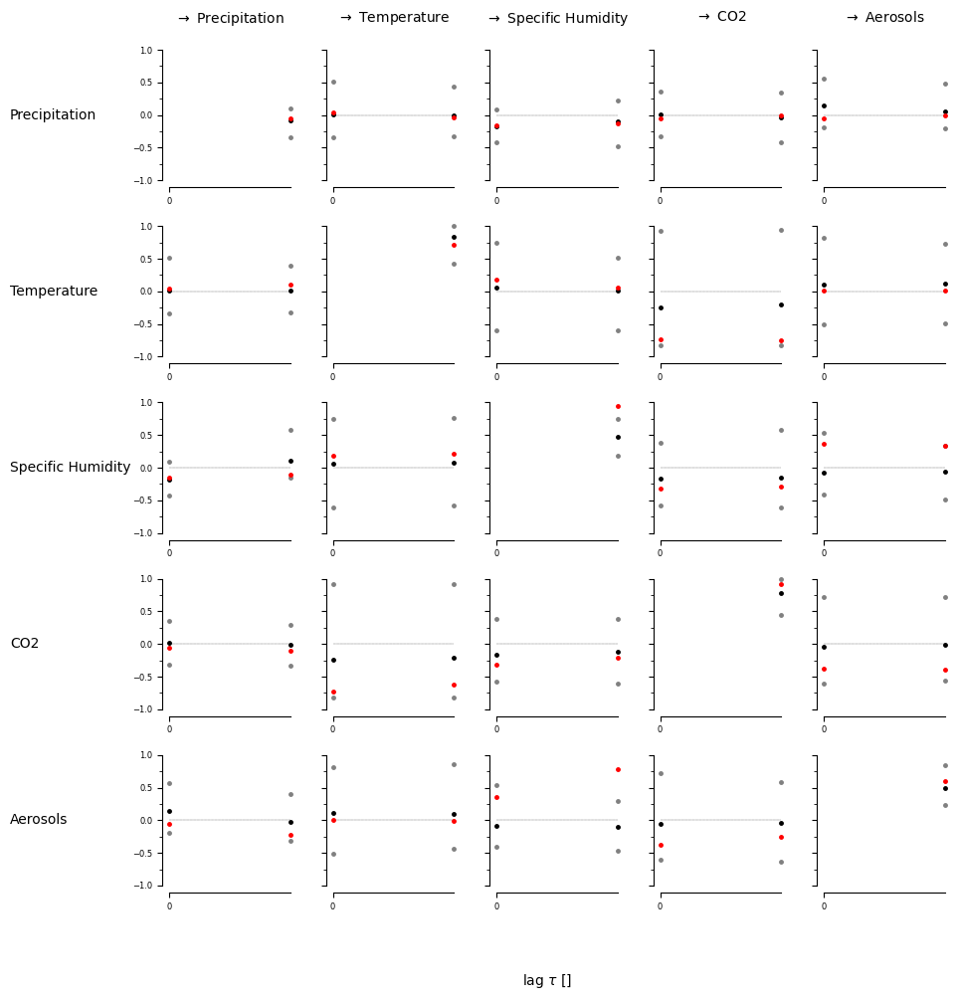

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False  True]]]


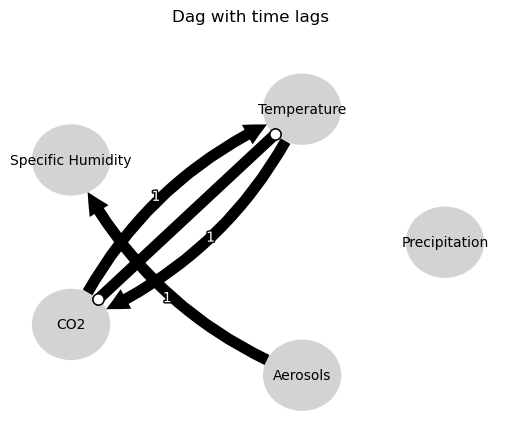

Negative precipitation values in event 122: 0


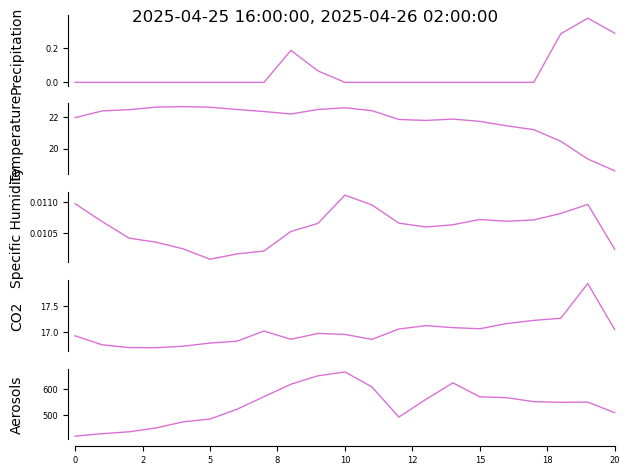


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


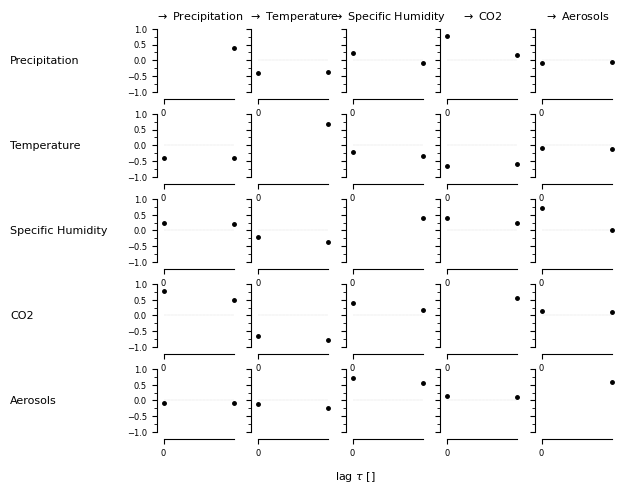

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (CO2 -1): max_pval = 0.03605, |min_val| =  0.483

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.01129, |min_val| =  0.582

    

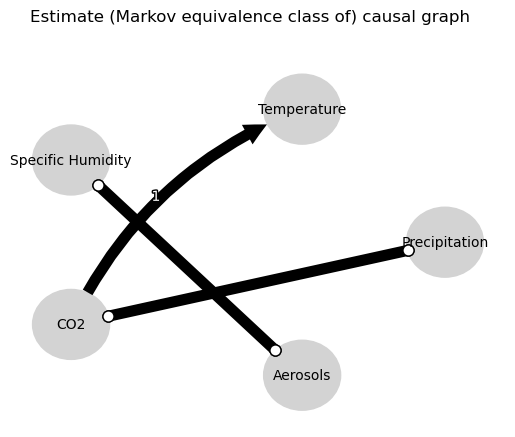

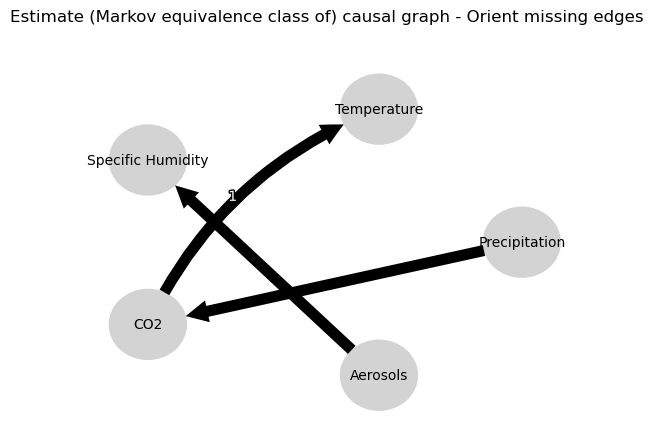

0.0
-0.06761585895856569
-0.129361574812055
-0.44330903684754225
0.23238694564159
-0.002338073899159689
0.5091752124105986
-0.05017334121160389
0.019040957712010132
-0.04081997887525681
-0.129361574812055
0.05041119854798613
0.0
0.09335789611223323
-0.04576692917167778
0.020831201733469664
-0.20262600346540366
0.07920261495682554
0.15499253059006043
-0.017253870751464267
-0.04576692917167778
-0.3798947772298546
0.0
-0.014689828748182976
0.4634162193078065
-0.04090948954141496
0.3557918176667682
-0.009630769218785331
-0.20262600346540366
-0.7143349236261197
0.4634162193078065
0.046876518871146675
0.0
-0.004221031007752459
0.1785104134791915
0.02867696816094457
0.15499253059006043
-0.17708935110805574
0.3557918176667682
0.051619322973169256
0.1785104134791915
-0.02668674454168931
0.0
-0.0438664419562254


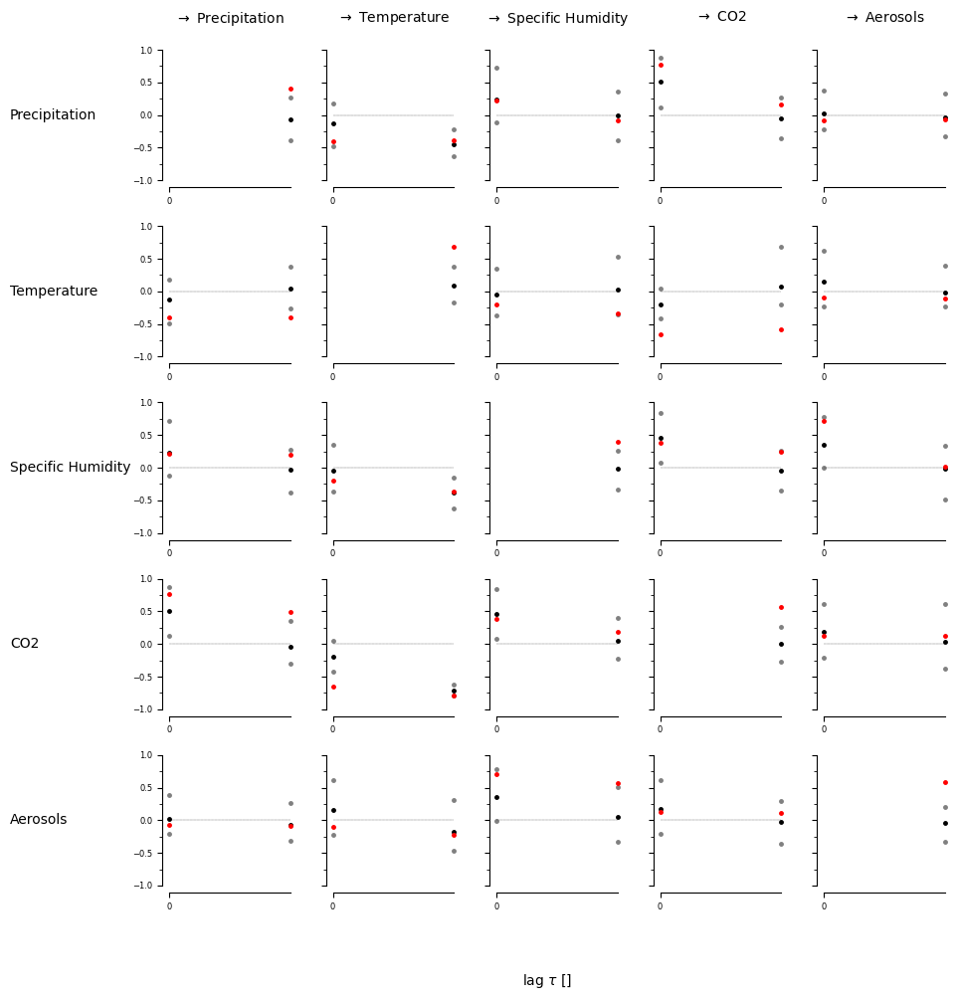

[[[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [ True False]]

 [[ True False]
  [ True  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False  True]]]


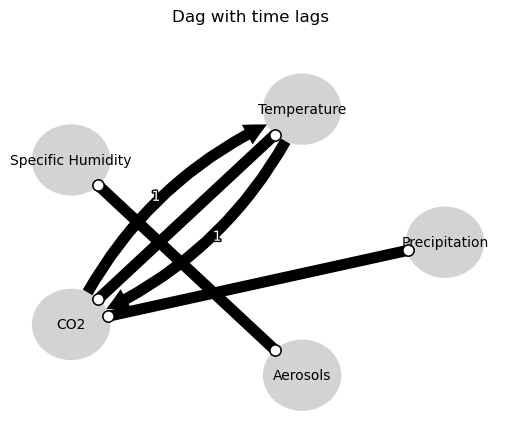

Negative precipitation values in event 123: 0


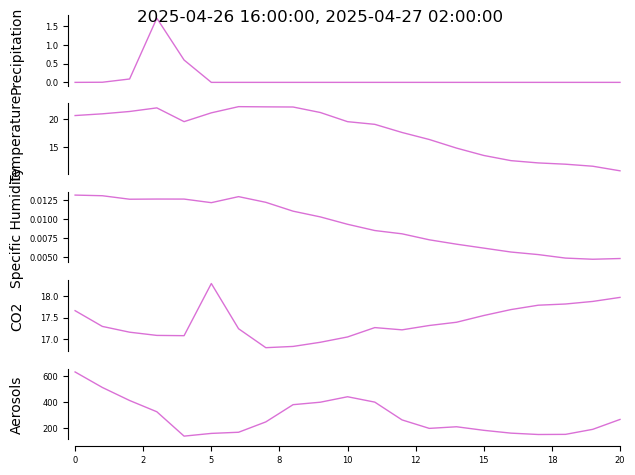


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


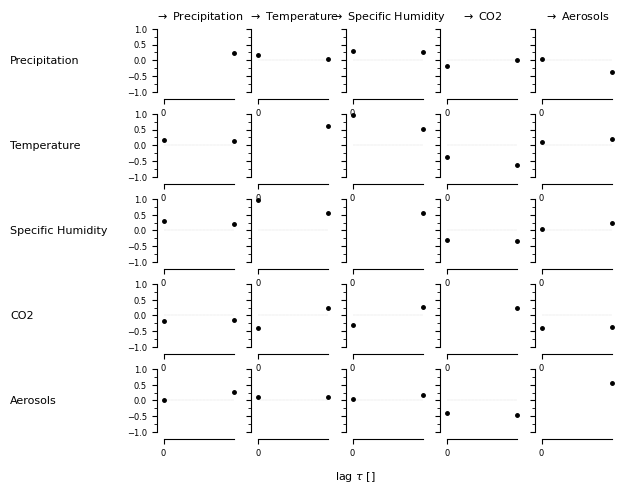

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 2 link(s):
        (Temperature -1): max_pval = 0.

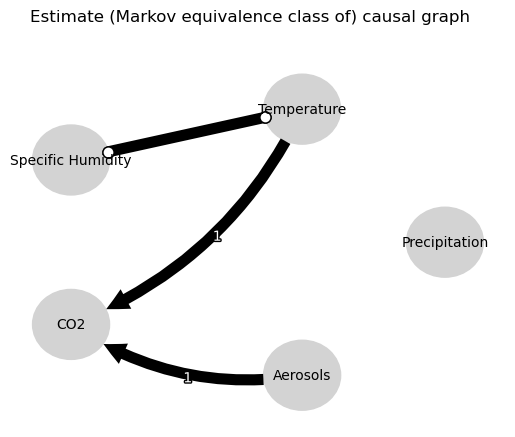

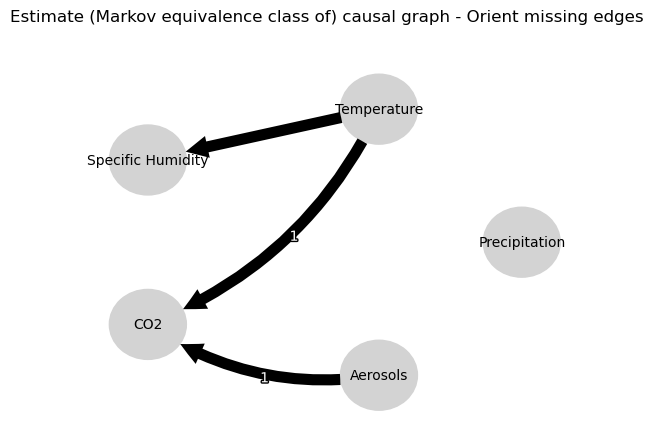

0.0
-0.057863237888404084
0.2958067509035377
0.004484894447649449
0.3449193548203367
-0.005106830299115128
0.01705496070692499
-0.22518603234394505
-0.13166083139741536
-0.097036365033614
0.2958067509035377
0.025604897790743354
0.0
-0.046143564678613164
0.8736801686234266
-0.03681837806116476
0.047810596309037286
-0.5803424585651583
0.06345531051449153
-0.003542062868687117
0.8736801686234266
-0.027141477275571133
0.0
-0.05043098297738737
0.12230035389864155
-0.538467985283665
-0.03663660999232831
-0.07221942162133549
0.047810596309037286
0.045840379973498976
0.12230035389864155
0.012860234692324968
0.0
-0.06846789874844965
-0.14844197980404225
-0.056340127123968096
0.06345531051449153
-0.05140938233090086
-0.03663660999232831
-0.012273605572194457
-0.14844197980404225
-0.14552956131636804
0.0
0.4022909348495142


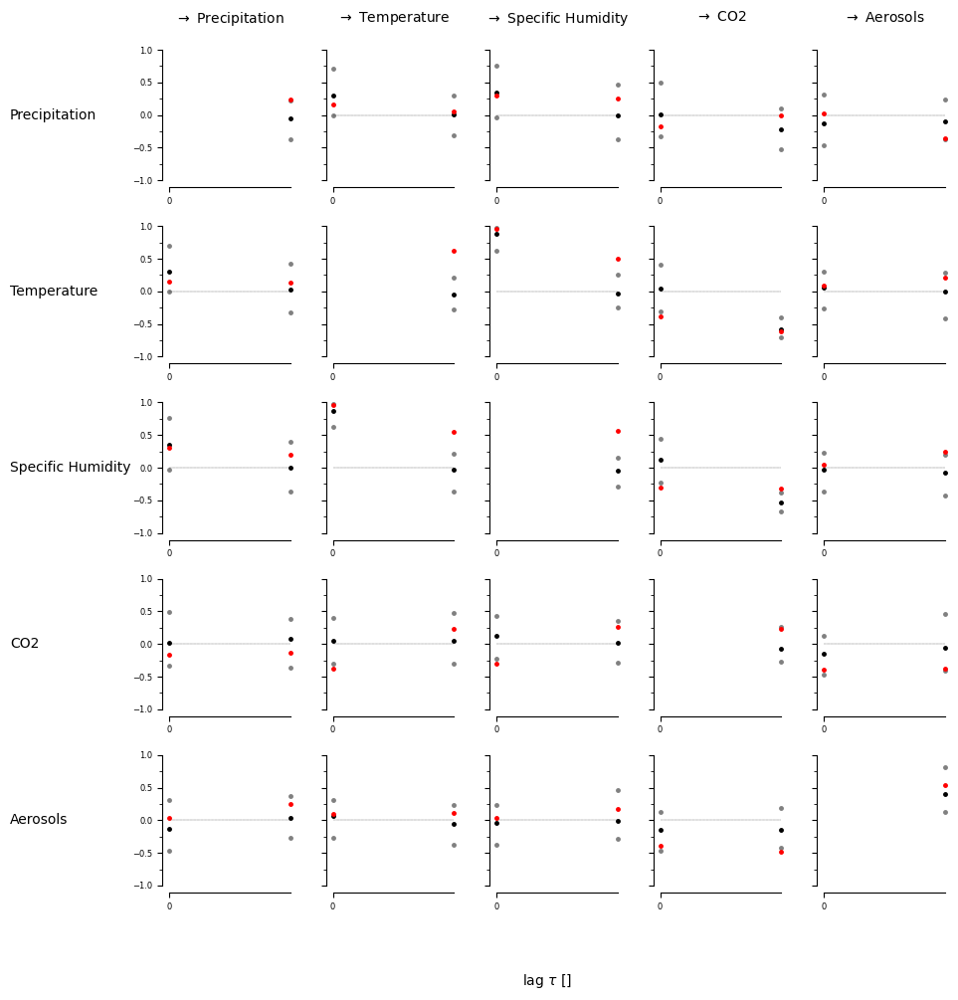

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


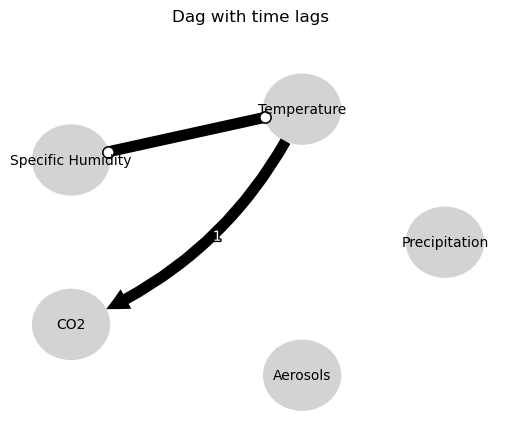

Negative precipitation values in event 124: 0


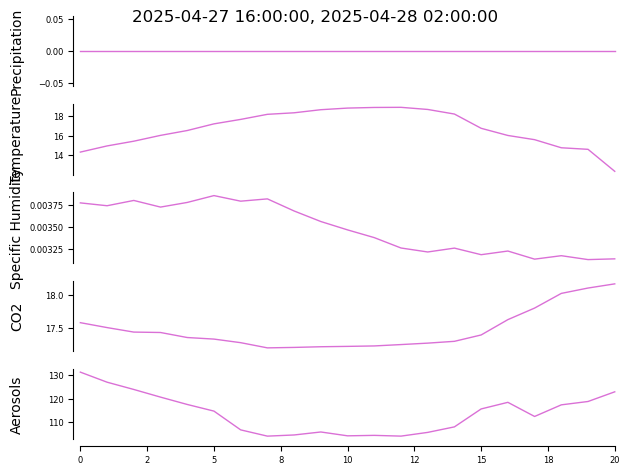


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


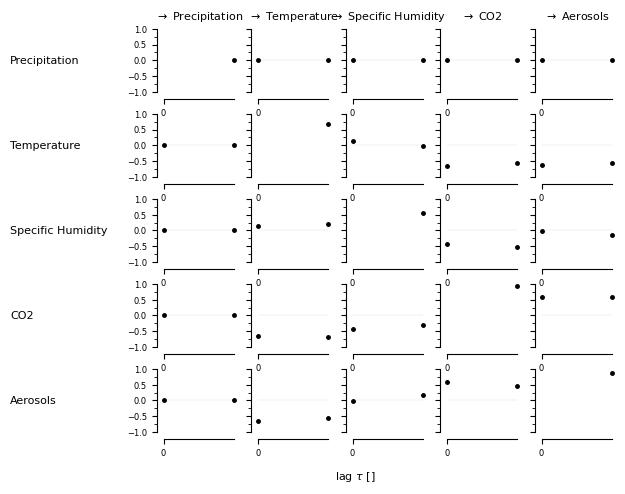

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.01416, |min_val| =  0.552



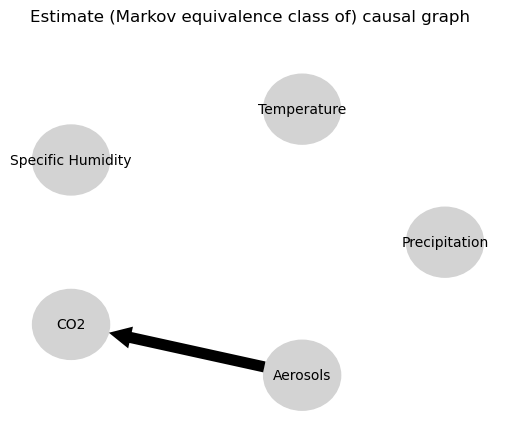

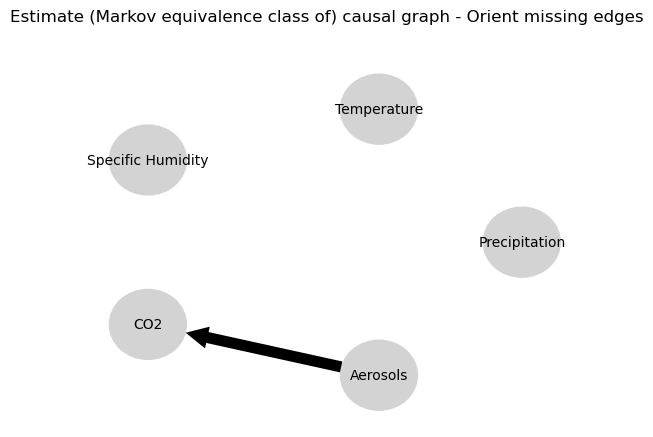

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.052812743679357975
0.14335628717229287
0.05740016426050581
0.010427642906710907
-0.0324173789995652
-0.21854009503784153
-0.1610511061326582
0.14335628717229287
-0.00994116436173282
0.0
-0.06629069811859674
-0.022796879220235523
0.012807753615023548
-0.30259760410723285
-0.19609480615953467
0.010427642906710907
0.015031994473869657
-0.022796879220235523
0.03363497549073495
0.0
0.9169296547835644
-0.042544927832817055
-0.06588433476042985
-0.21854009503784153
0.053247038912917335
-0.30259760410723285
0.06293657611473505
-0.042544927832817055
-0.01712425538104091
0.0
0.48663054272072964


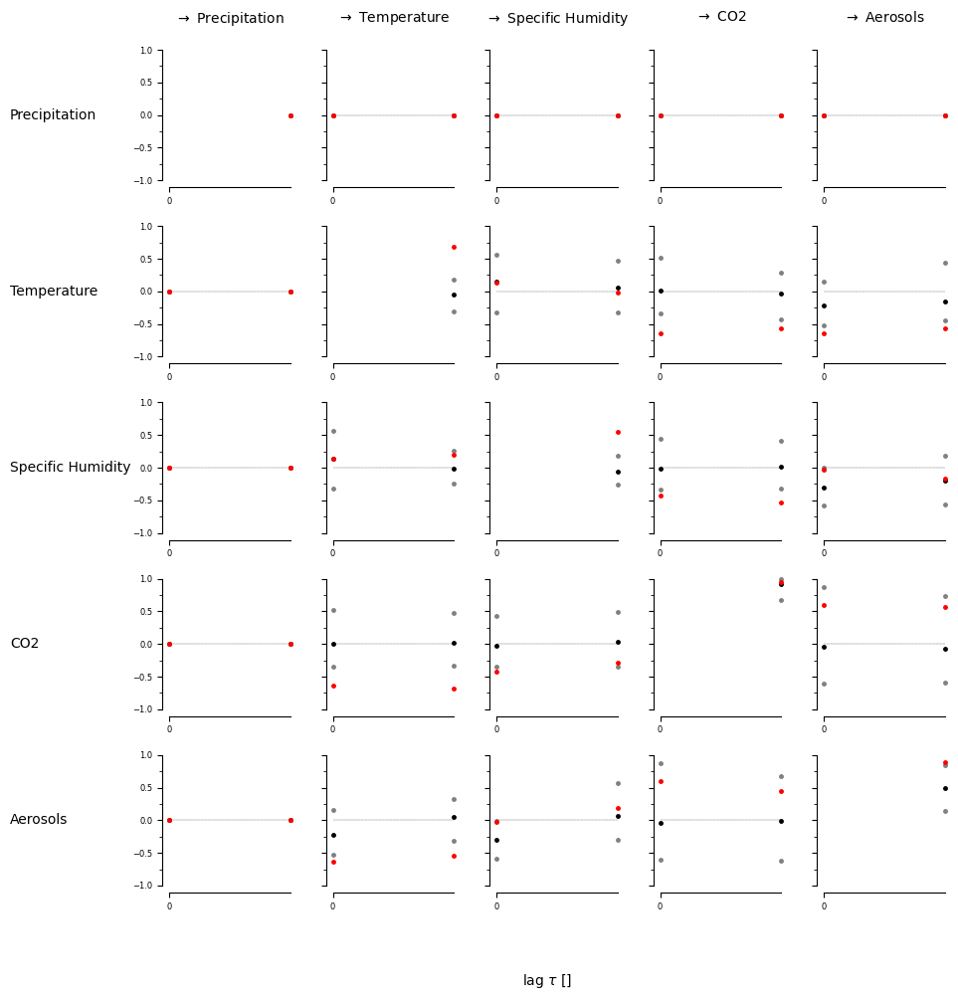

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True False]
  [ True False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True False]]

 [[False False]
  [ True False]
  [False False]
  [ True False]
  [False  True]]]


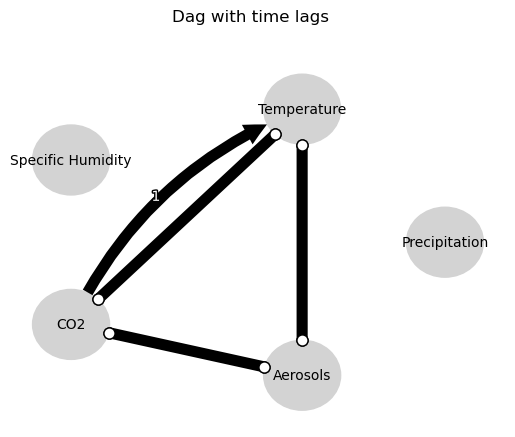

Negative precipitation values in event 125: 0


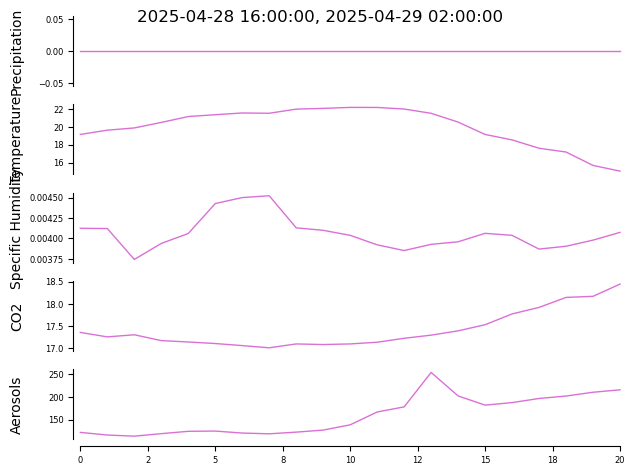


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


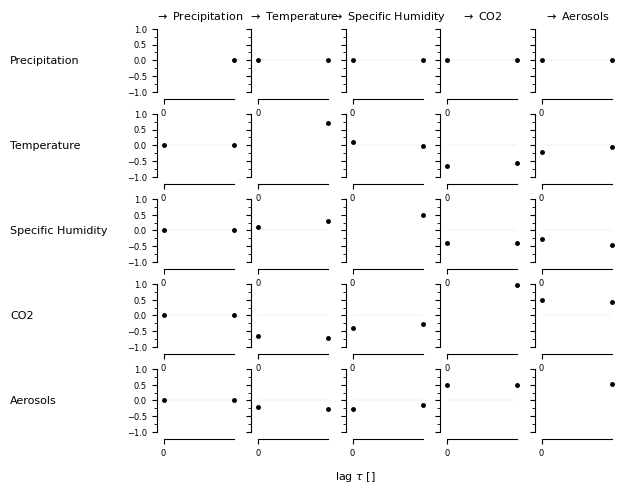

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.04004, |min_val| =  0.488

    Variable Specific Humidity has 1 link(s):
        (Specif

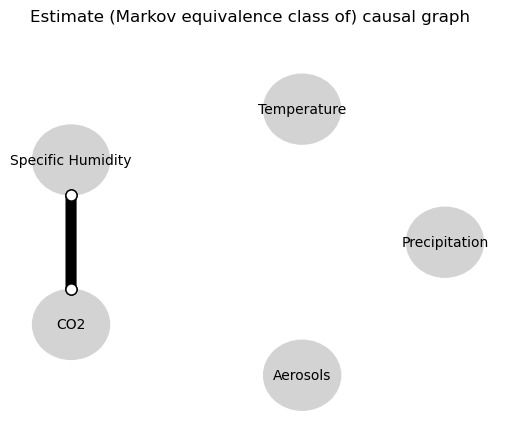

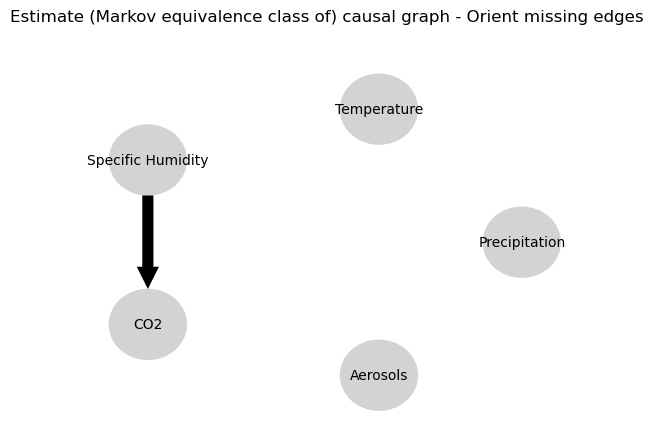

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.025577075294723087
0.31445527206686985
0.01999755675626596
0.017500484457505516
0.009702629453681774
-0.4459254234402319
-0.011361986995257116
0.31445527206686985
0.03188316306792173
0.0
-0.05969995950602154
0.039151995218195575
0.02377682288443152
-0.3372904381630665
0.034713080295646875
0.017500484457505516
0.060585740737353115
0.039151995218195575
0.09829454058091233
0.0
0.8664774020268885
0.019727654695009905
-0.10565352833422402
-0.4459254234402319
-0.004888739886610468
-0.3372904381630665
0.0020286859377998136
0.019727654695009905
-0.007635689823409156
0.0
-0.04748240169821973


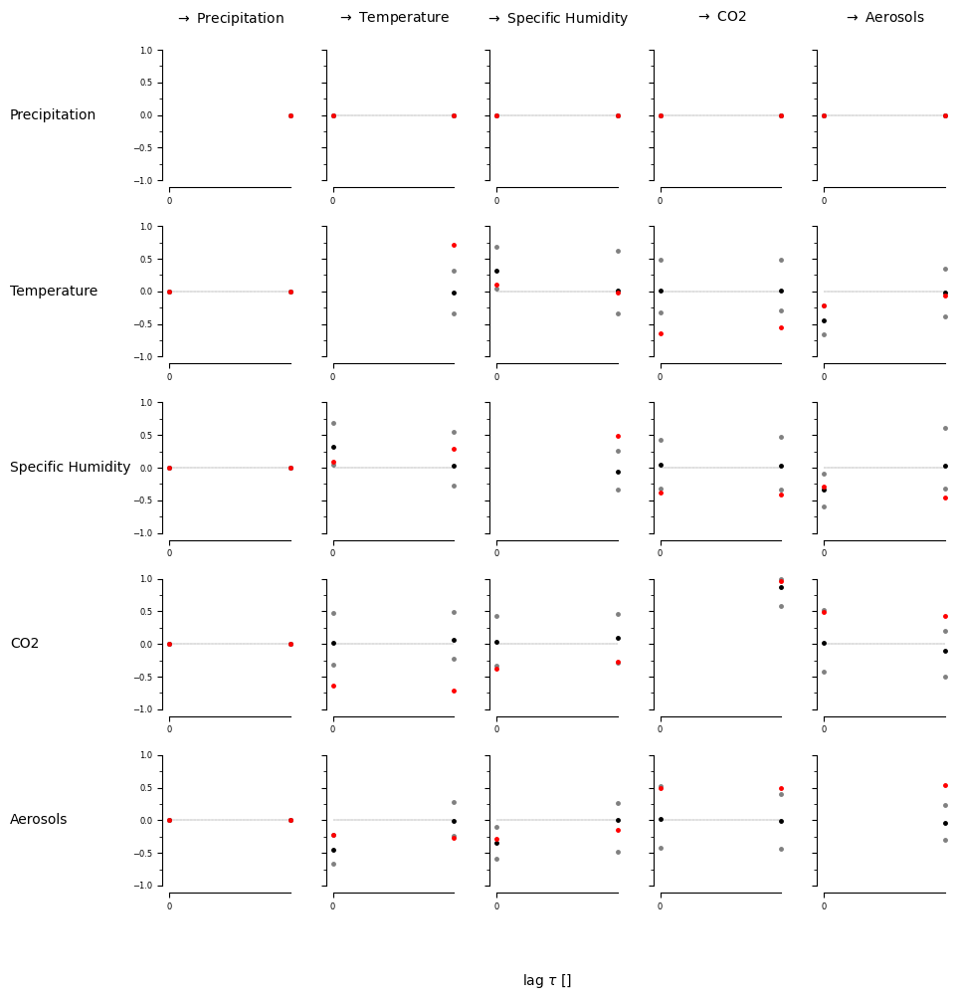

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


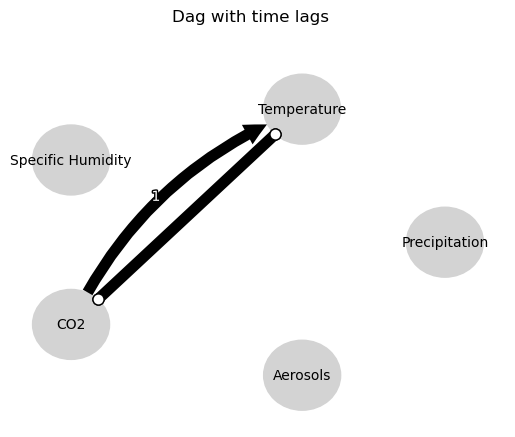

Negative precipitation values in event 126: 0


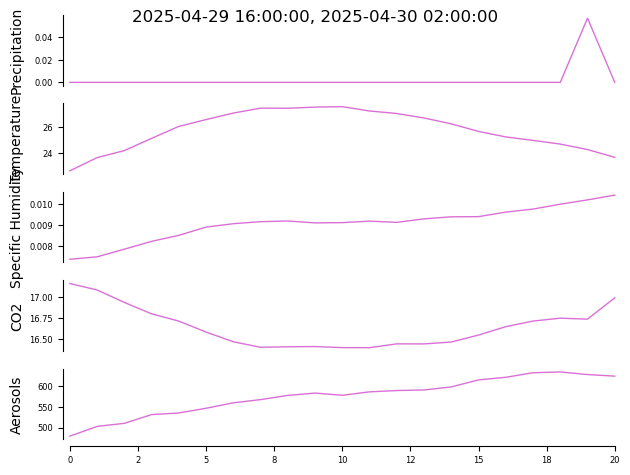


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


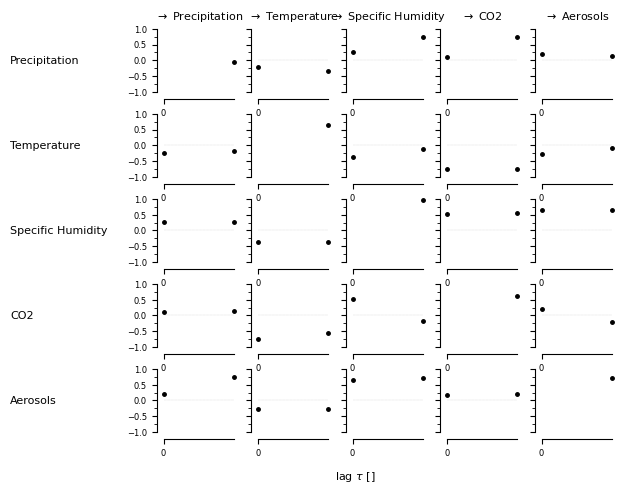

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Aerosols -1): max_pval = 0.00021, |min_val| =  0.752

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (S

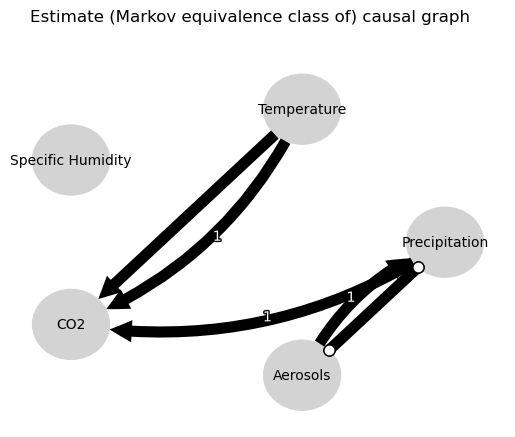

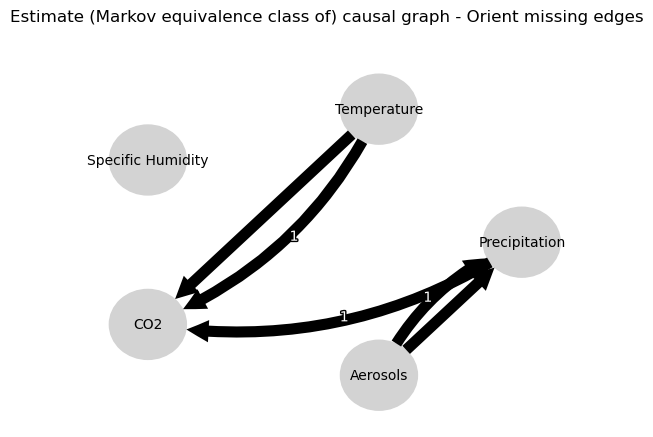

0.0
-0.015817397106577608
-0.2039555117850715
0.03316674839340558
0.03395573776514668
0.008528257620175693
-0.018436538607594095
0.316727780765782
-0.07935617231827764
-0.022943049413809986
-0.2039555117850715
0.02004431462341808
0.0
-0.07437307715326665
-0.1576587261077463
-0.07448598816810222
0.0064816868470562875
-0.7855035870227756
-0.11039558823208845
-0.08506250325190855
-0.1576587261077463
0.12884684960429574
0.0
0.5266547884339731
0.08098412499864588
0.18261802139397862
-0.07250368614578881
-0.08399658872281823
0.0064816868470562875
0.06136344693763327
0.08098412499864588
0.06990940858716209
0.0
-0.07427645102130649
0.03366399658966974
0.0694793294804346
-0.11039558823208845
0.005091555683725524
-0.07250368614578881
-0.013042732915720157
0.03366399658966974
0.05601493896726497
0.0
0.5039886627724774


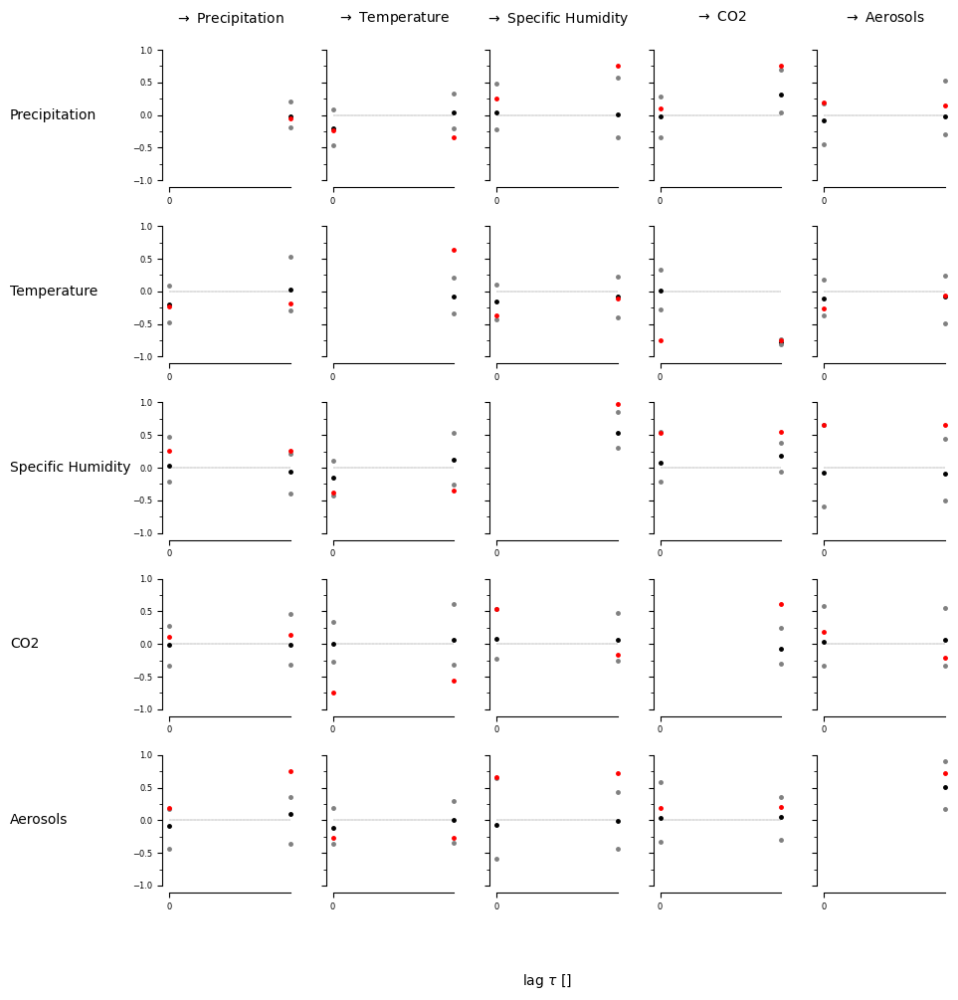

[[[False False]
  [False False]
  [False  True]
  [False  True]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [ True False]
  [False False]
  [False  True]
  [False False]]

 [[False  True]
  [False False]
  [ True  True]
  [False False]
  [False  True]]]


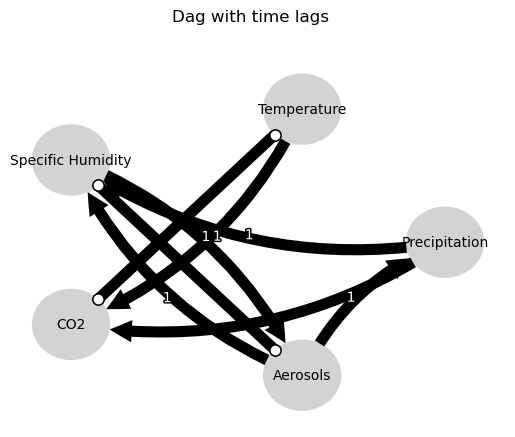

Negative precipitation values in event 127: 0


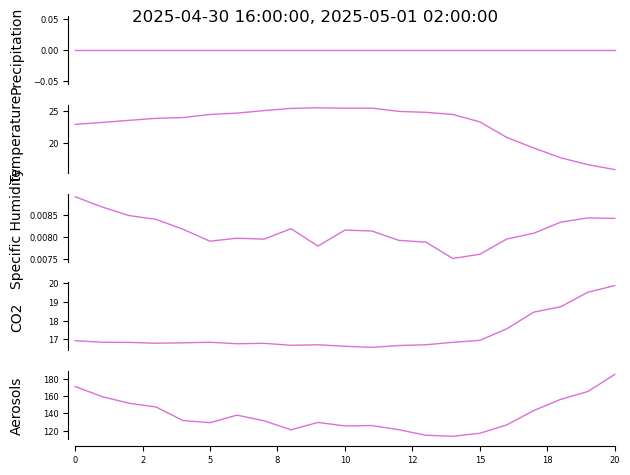


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


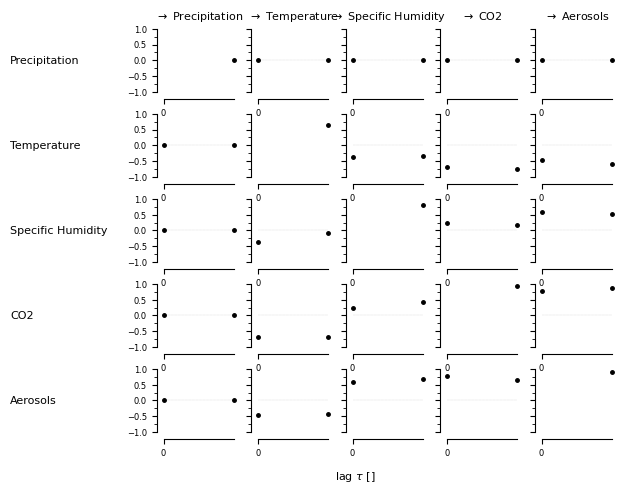

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00221, |min_val| =  0.673



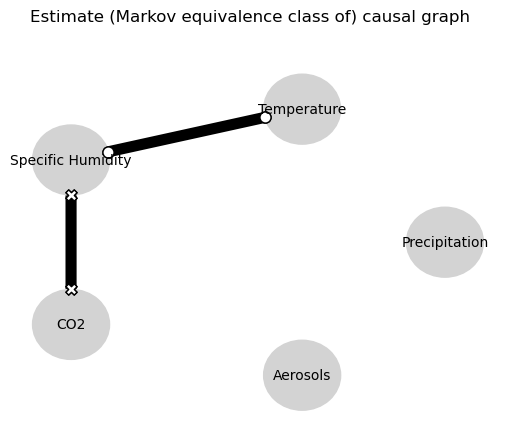

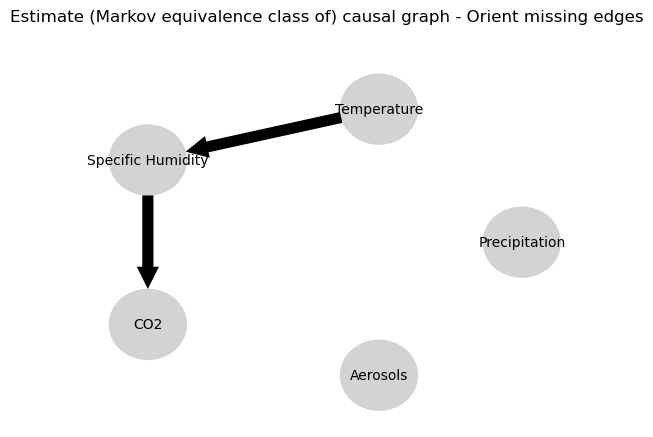

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.020825236520633707
-0.3180095892255523
-0.15707217166044635
0.06176643127111945
0.040820893696579964
-0.6014961529180564
0.00858561099405404
-0.3180095892255523
0.06375821362285167
0.0
0.3307631395075453
0.026312944572055234
0.02698551106160588
0.3720994072411448
-0.07757265918544114
0.06176643127111945
0.07683713015894773
0.026312944572055234
0.03259954426843142
0.0
0.947617140920741
-0.03144401011955967
-0.03854540555107988
-0.6014961529180564
0.0016126685995385647
0.3720994072411448
0.17770022038056119
-0.03144401011955967
-0.0004705786842239786
0.0
-0.044268020748363474


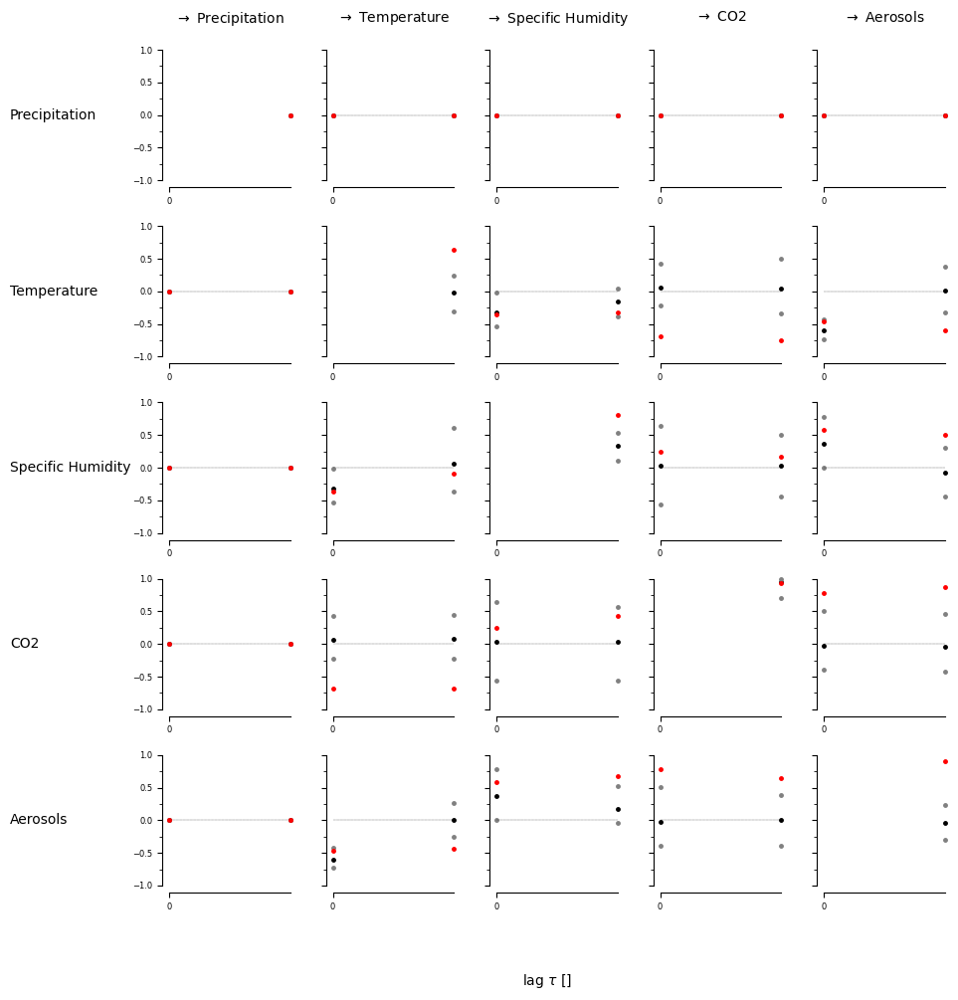

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [ True  True]
  [ True  True]
  [False  True]]]


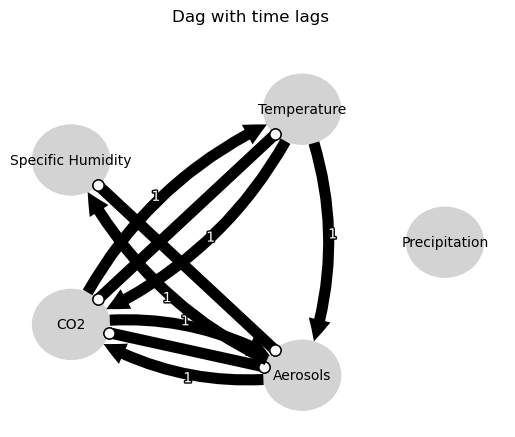

Negative precipitation values in event 128: 0


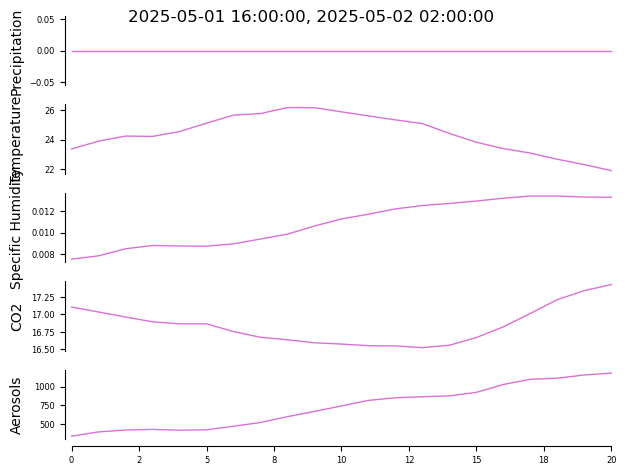


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


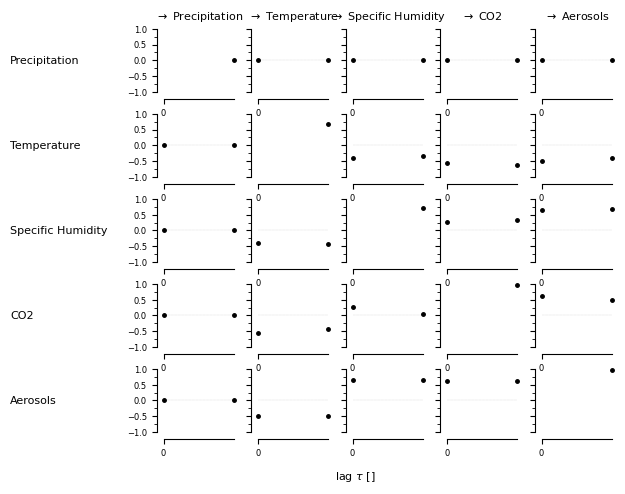

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00772, |min_val| =  0.606

    Variable Specific Humidity has 0 link(s):

    Va

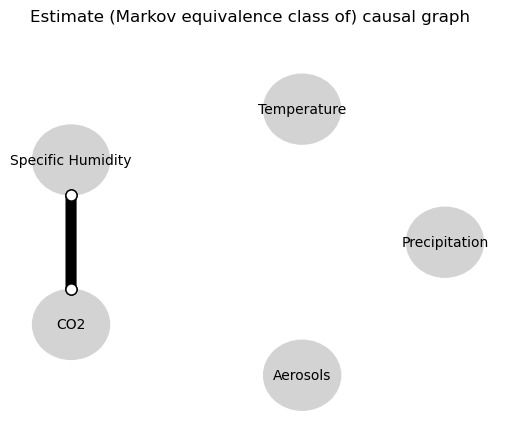

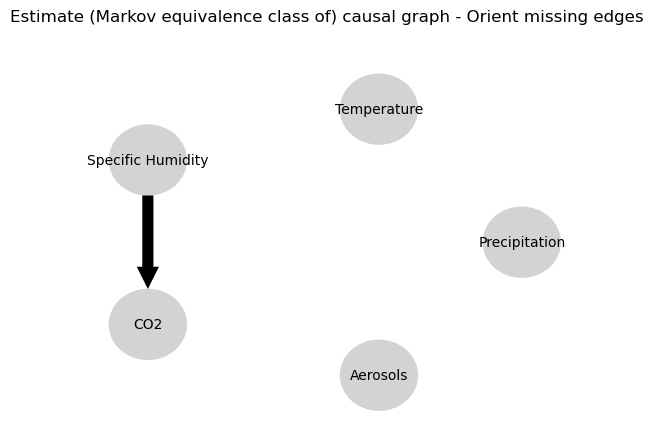

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.6514175023694215
-0.12485047339868968
0.32484771500170884
-0.43264742029422104
-0.3589776624202898
-0.10323842426670016
0.3120062742402408
-0.12485047339868968
-0.06984547838971372
0.0
-0.03800634429262594
-0.01893290837102287
-0.03503988706416341
0.9387131288154256
-0.045109136042490366
-0.43264742029422104
-0.361240641866264
-0.01893290837102287
-0.24382469627324296
0.0
0.8342786170282395
-0.015114447076465183
-0.2405189978269783
-0.10323842426670016
-0.06582587187880569
0.9387131288154256
-0.030894632586206724
-0.015114447076465183
-0.03260193385677747
0.0
-0.045829378279399216


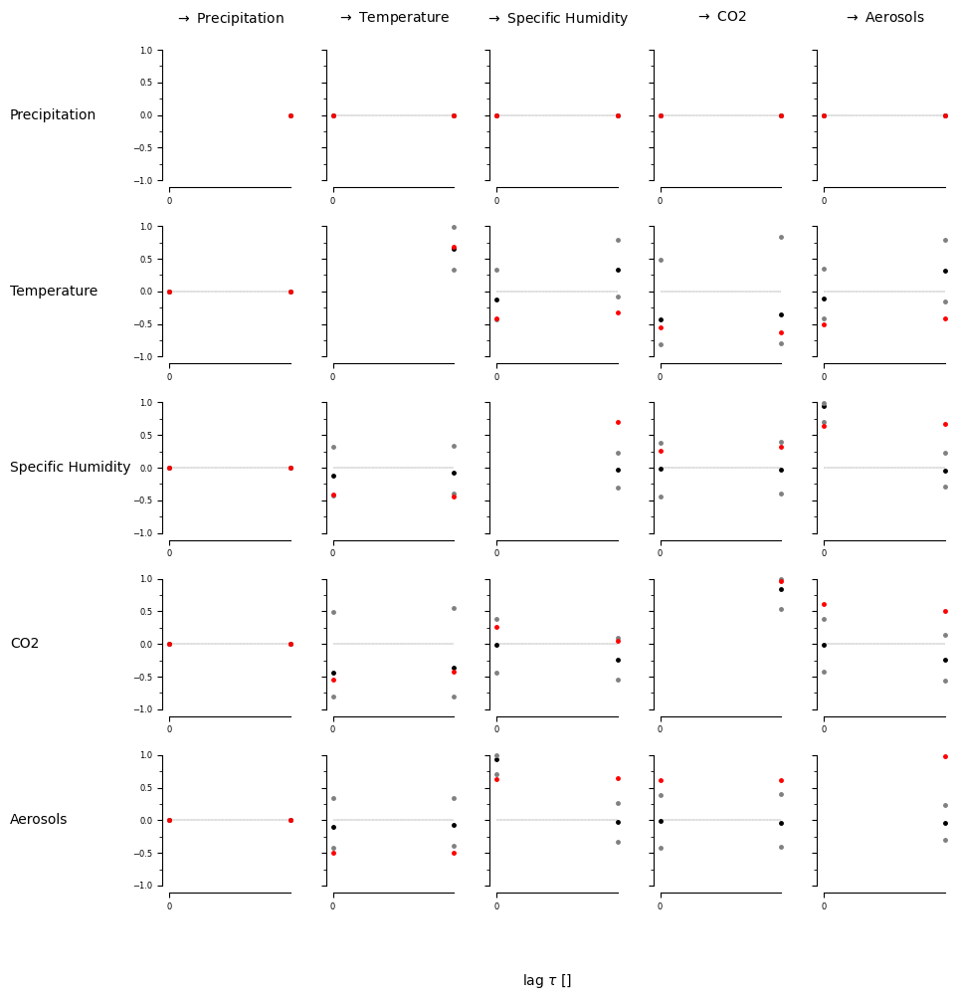

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True False]]

 [[False False]
  [False False]
  [ True  True]
  [ True  True]
  [False  True]]]


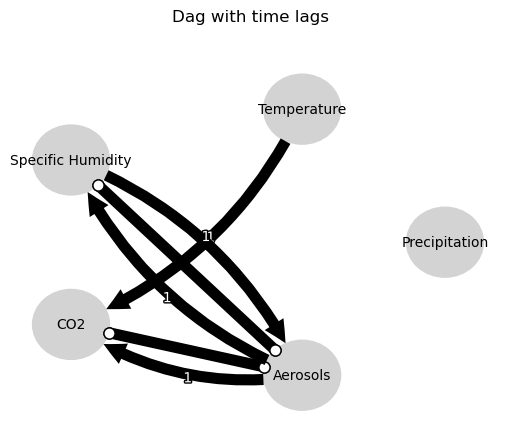

Negative precipitation values in event 129: 0


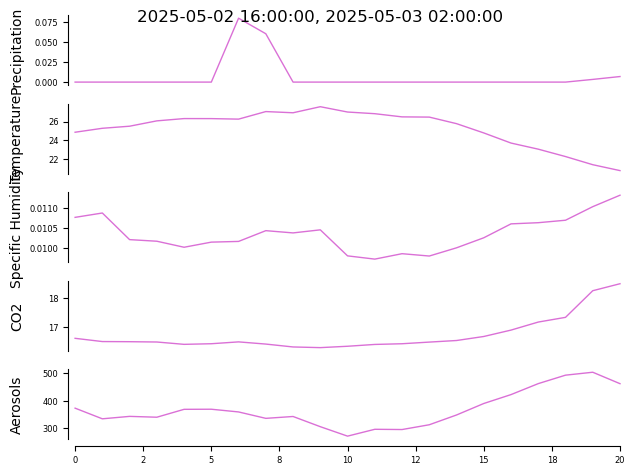


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


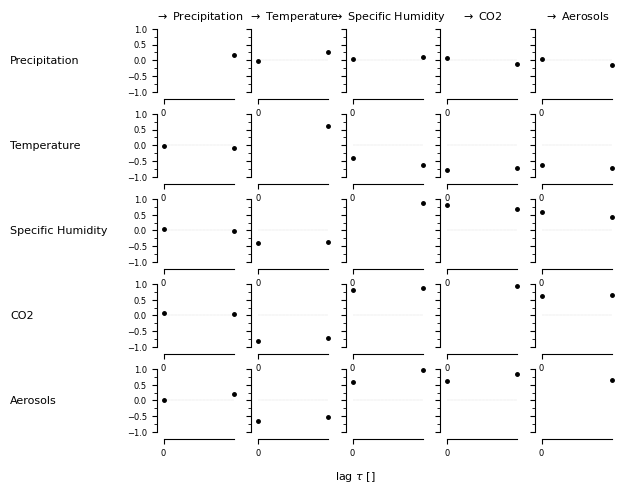

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.03802, |min_val| =  0.492

    Variable Specific Humidity has 2 link(s):
        (Aeroso

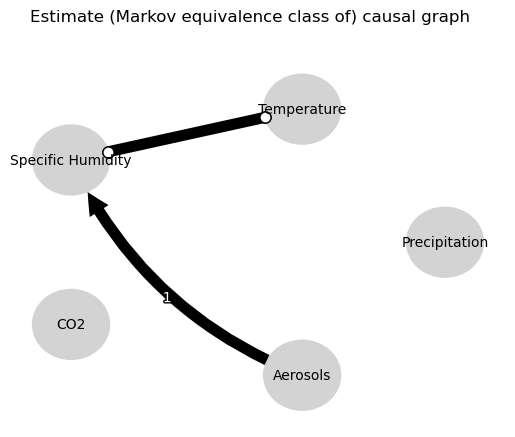

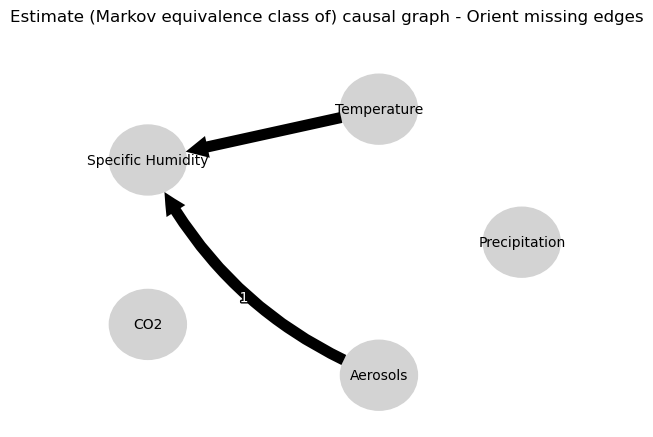

0.0
-0.03448867555245157
0.22807993272220103
0.035686583951140265
-0.07826285861441917
-0.09447862393640857
0.034046645172016894
0.00747527737790274
-0.08568169561168434
-0.027278285968945208
0.22807993272220103
0.03708531063374146
0.0
-0.016448710097389747
0.02717861500711629
-0.6799445230629015
0.049602319594962065
0.0366468661145023
-0.7388077090156712
0.03458994640466194
0.02717861500711629
-0.09219661191117819
0.0
-0.13332516772036104
0.0006210438951203425
-0.011501112726764984
-0.13933508679479975
0.029721315049762127
0.049602319594962065
0.08134935578285887
0.0006210438951203425
0.01647182579419263
0.0
0.9496755205142432
-0.025117620385646293
-0.06362545171556418
-0.7388077090156712
-0.009747546392948062
-0.13933508679479975
0.8534912337001435
-0.025117620385646293
-0.011910477160720736
0.0
-0.045829378279399216


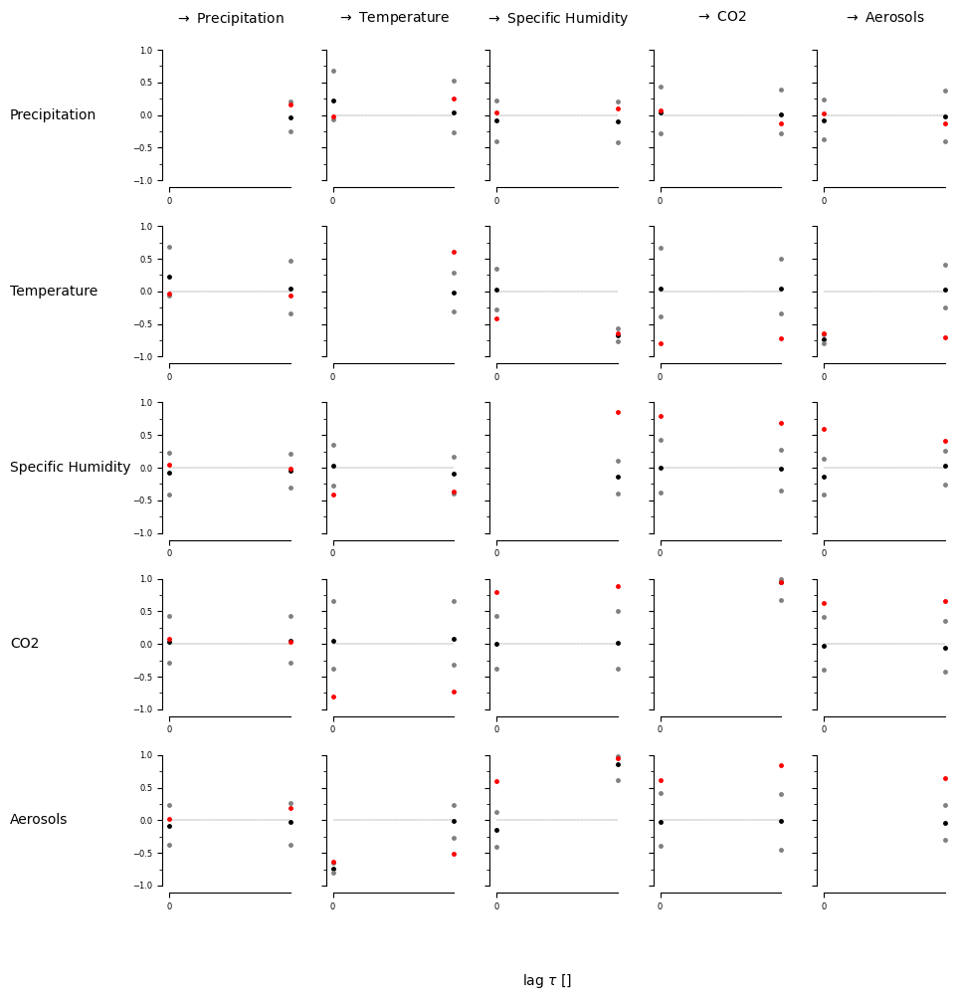

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [ True  True]
  [ True False]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True False]
  [ True  True]
  [ True  True]
  [False  True]]]


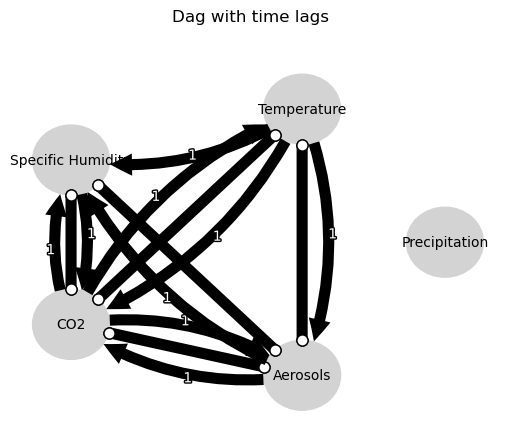

Negative precipitation values in event 130: 0


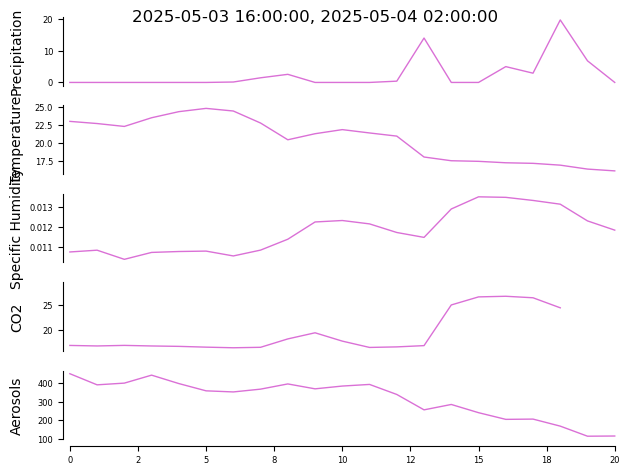


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


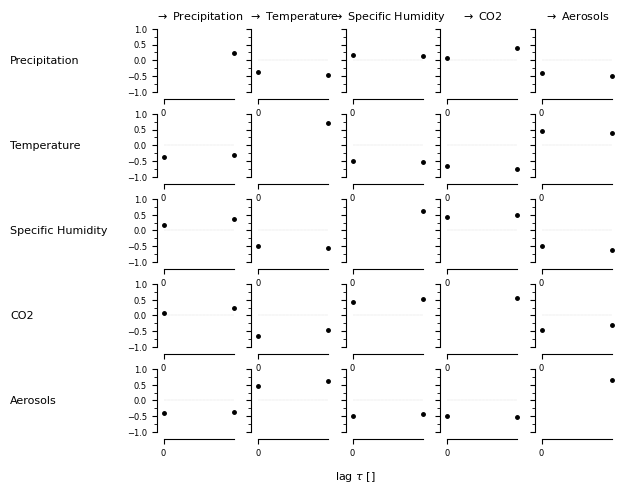

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 2 link(s):
        (Temperature -1): max_pval = 0.00664, |min_val| =  0.615
        (Aerosols -1): max_pval = 0.03597, |min_val| =

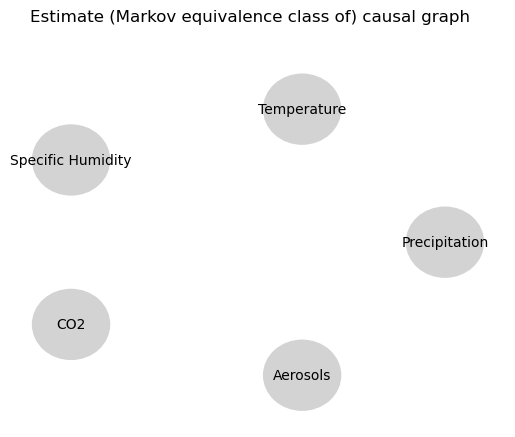

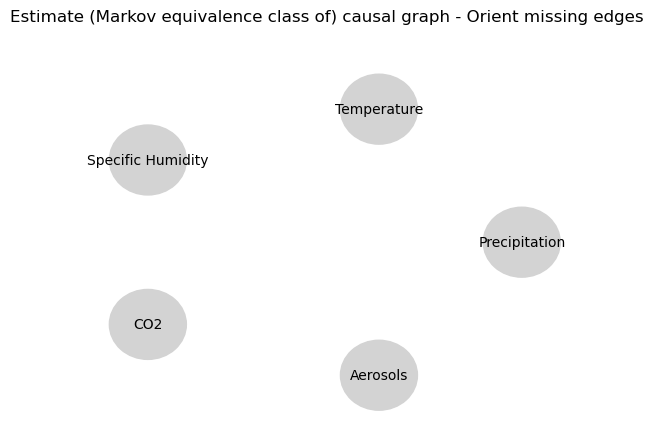

0.0
-0.01784831589308661
-0.3611611678896634
0.04088295985372988
0.27662416937750667
-0.018199440739810665
0.13824740745528716
-0.03644784118840562
-0.052368236034124924
-0.03489231430456658
-0.3611611678896634
0.04215069816858539
0.0
-0.06900111187210159
-0.6269842888853159
0.11126210814916687
-0.6506910291114228
0.1033508026731689
-0.032053057234218606
-0.021306819433749267
-0.6269842888853159
0.04117799923101143
0.0
-0.09450240077229632
0.6872855459539501
-0.07299023695591209
0.04226041224269537
0.08233504616949247
-0.6506910291114228
0.04011532118108073
0.6872855459539501
-0.09810085443197172
0.0
-0.11126520992240935
0.10791628167970678
0.07215890223744666
-0.032053057234218606
-0.04644099579960375
0.04226041224269537
0.044012692536047164
0.10791628167970678
0.06043309740884937
0.0
0.553298657563526


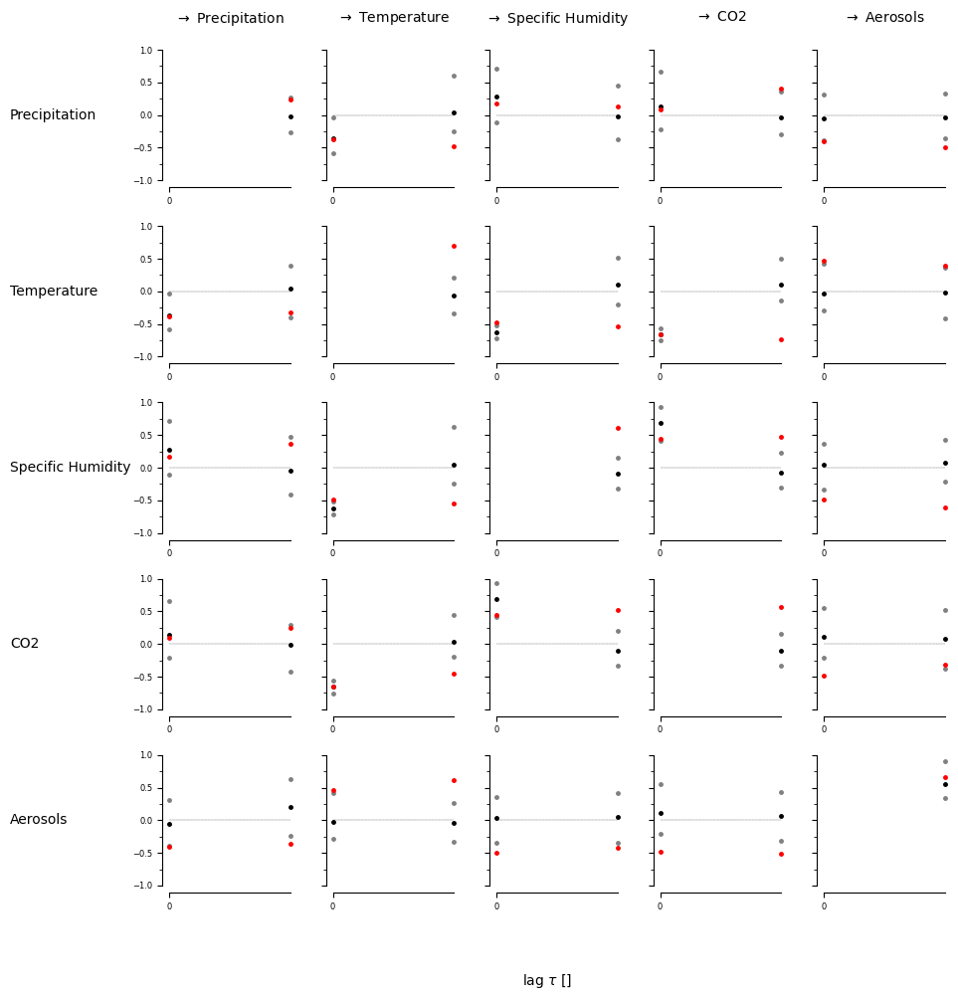

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False  True]]

 [[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False  True]]]


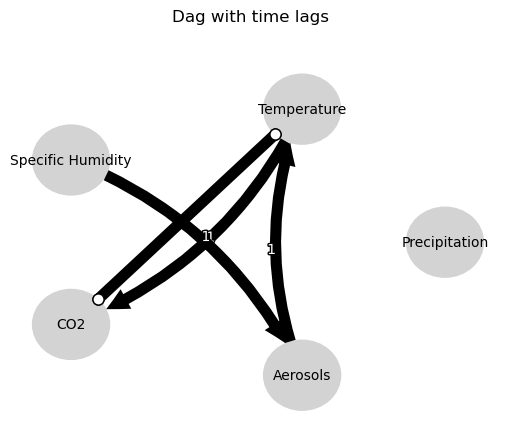

Negative precipitation values in event 131: 0


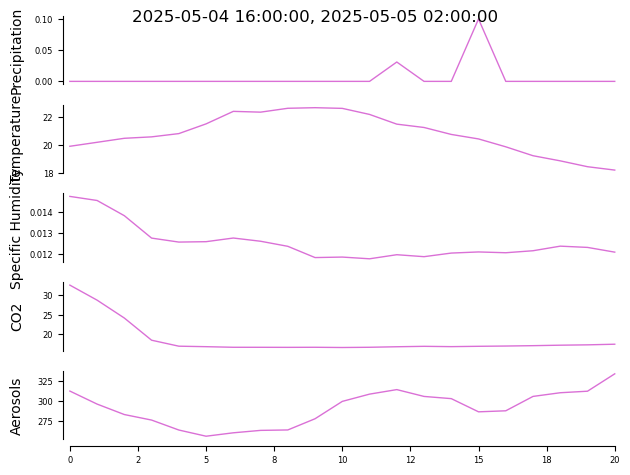


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


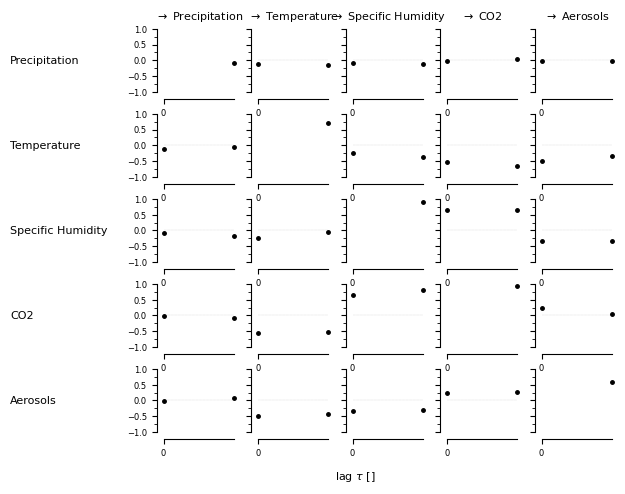

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.01189, |min_val| =  0.579

    Variable Specific Humidity has 1 link(s):
       

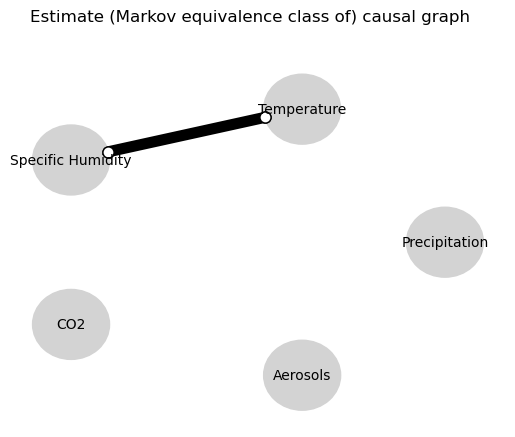

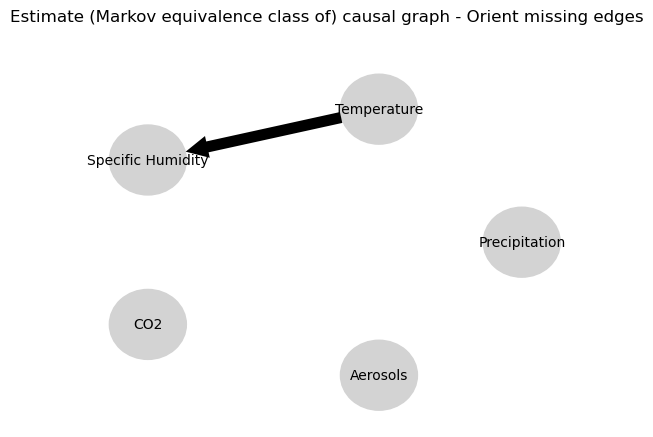

0.0
0.006755179620050911
-0.0739476452297153
-0.10106677879597789
0.041951197068017955
0.07837741765561866
0.06436242026077951
0.0448575813844803
-0.07630730943483309
-0.0903451896353013
-0.0739476452297153
0.027329113939106246
0.0
0.599912499159794
-0.23101328099353916
-0.24053188750060753
-0.1793019263285361
-0.10488413053420101
-0.16943972429867918
-0.10701162179887323
-0.23101328099353916
-0.22991221996282082
0.0
0.40104062900788306
0.5578342727481111
0.16123706090224973
-0.03480558819298796
-0.046912562729625656
-0.1793019263285361
-0.1851261694473935
0.5578342727481111
0.2312407372562828
0.0
0.3079495498076626
0.12043299475786426
0.06837529506425415
-0.16943972429867918
-0.09015375476347999
-0.03480558819298796
0.005178540581871584
0.12043299475786426
0.04152565614980488
0.0
0.5278410590309465


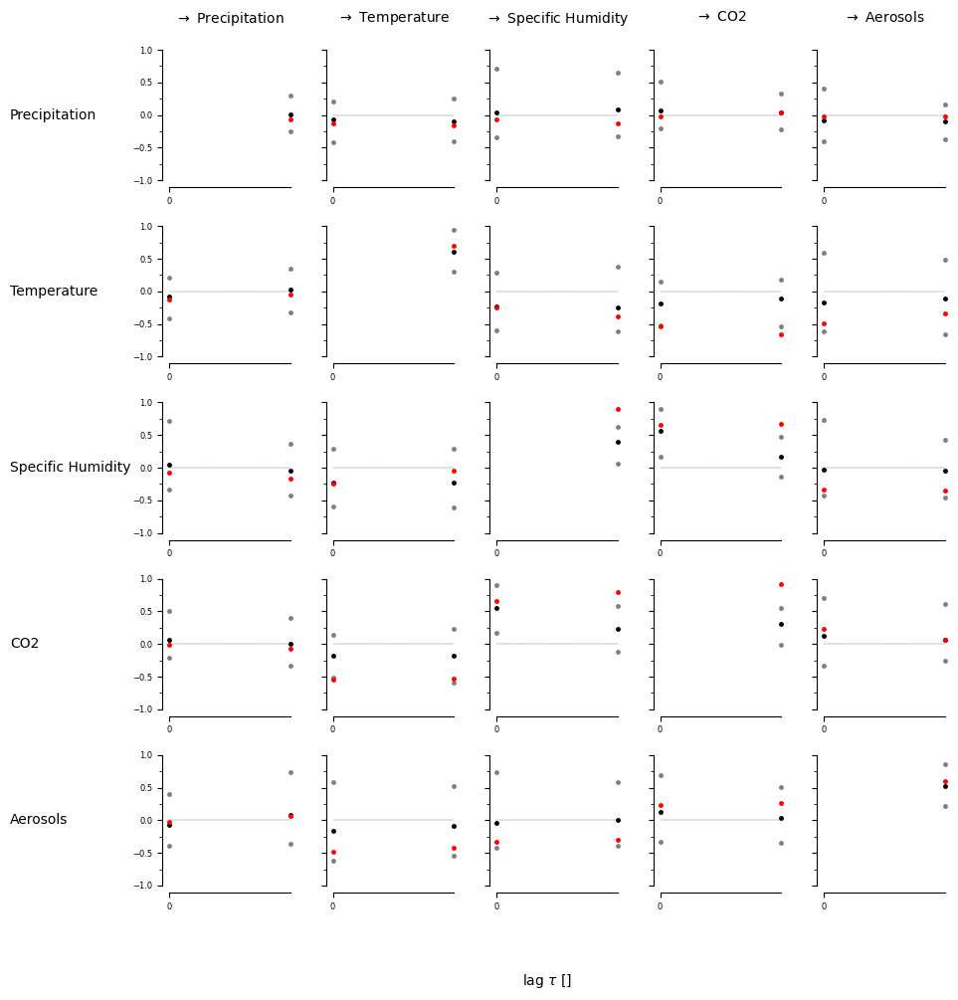

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


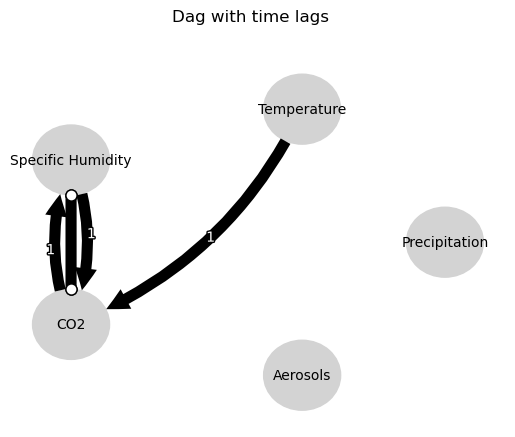

Negative precipitation values in event 132: 0


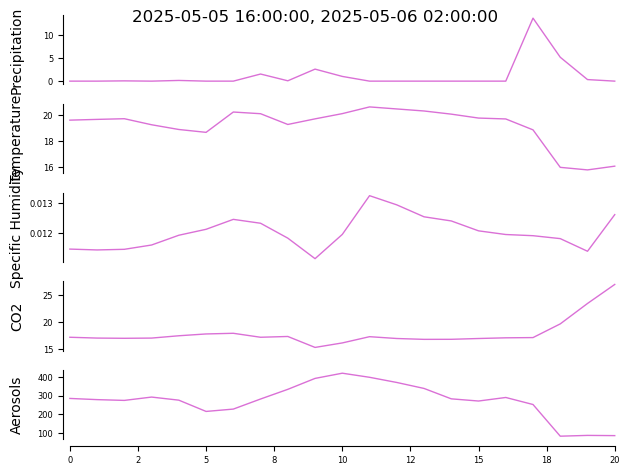


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


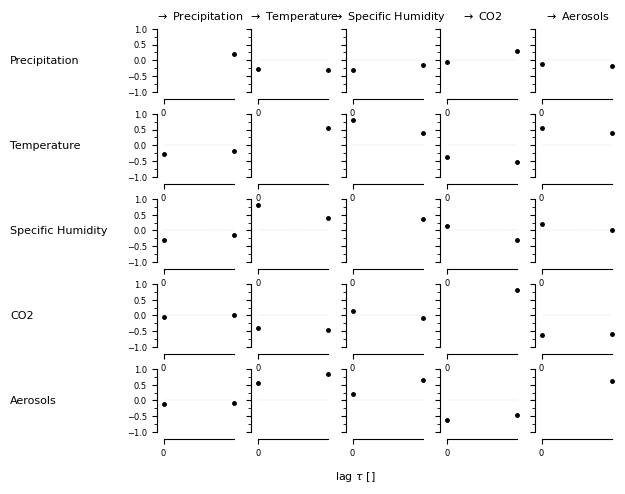

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Aerosols -1): max_pval = 0.00018, |min_val| =  0.771

    Variable Specific Humidity has 1 link(s):
        (A

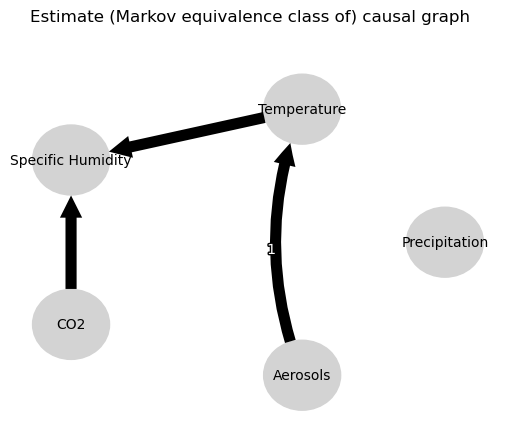

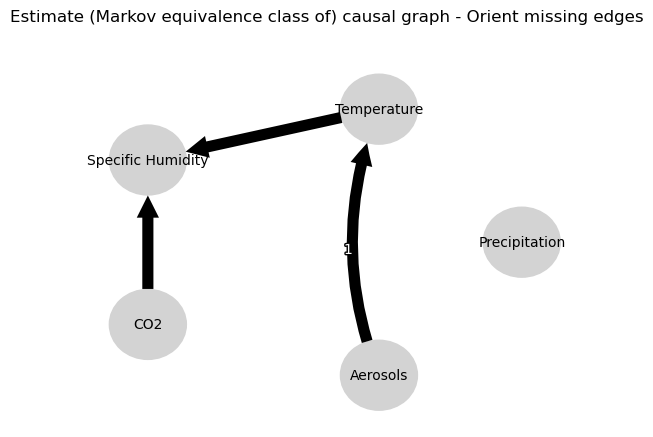

0.0
-0.06895487775817867
-0.11647618518533744
-0.045593640004196724
-0.04989557572434901
-0.010499553787370195
-0.0479219506227965
0.0007117930089620584
-0.10103655508334076
0.0498189659533108
-0.11647618518533744
0.05122682186927182
0.0
0.042833072934472215
0.11848769731470012
0.06563580095049804
0.08551617650458827
0.06376216992964127
0.09385612472780978
-0.022492405297071607
0.11848769731470012
0.05247048630930591
0.0
0.955604195242988
0.9835810736386564
0.9722630529307265
0.03142179592306002
0.02943716886774893
0.08551617650458827
0.08554701087834025
0.9835810736386564
0.9826289641096242
0.0
0.9980211513000097
0.04466880140633035
0.048012109939021254
0.09385612472780978
0.7279676660338364
0.03142179592306002
0.10427229012145212
0.04466880140633035
0.07009320382458104
0.0
-0.04596803662864672


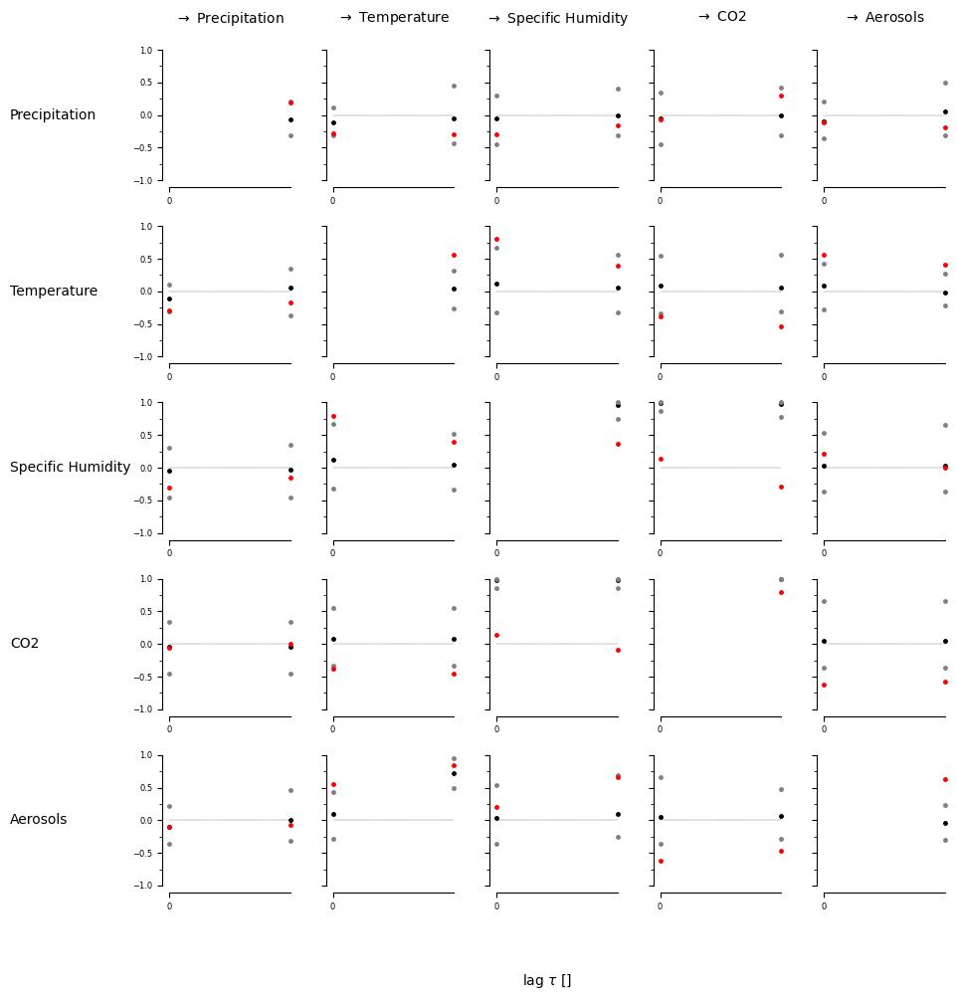

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False False]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False  True]
  [False  True]
  [ True False]
  [False  True]]]


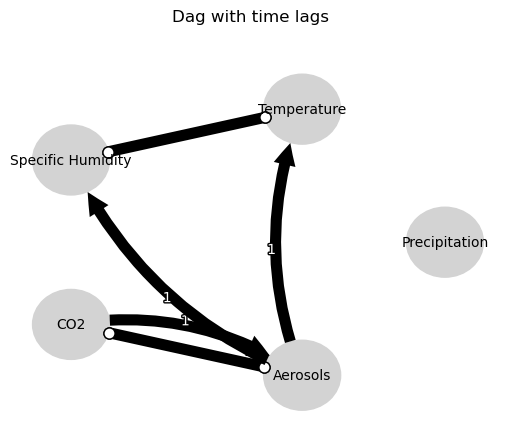

Negative precipitation values in event 133: 0


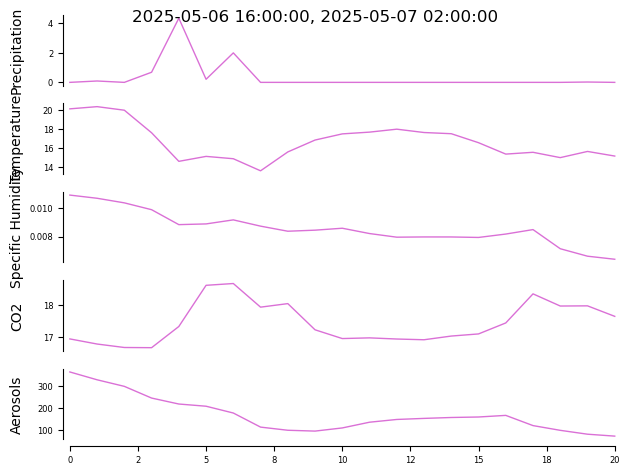


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


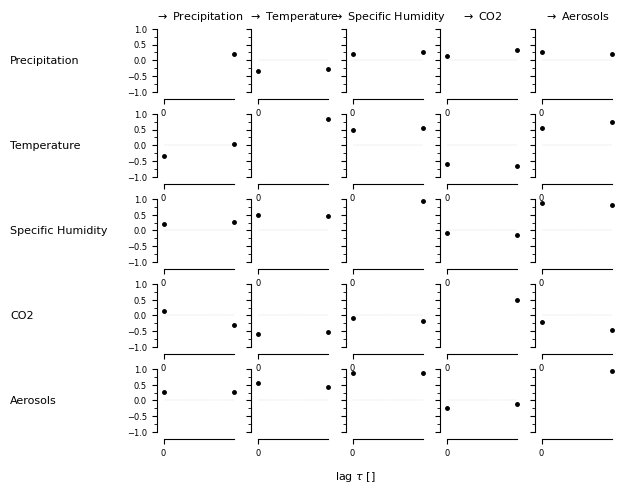

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00037, |min_val| =  0.747

    Variable Specific Humidity has 1 link(s):
       

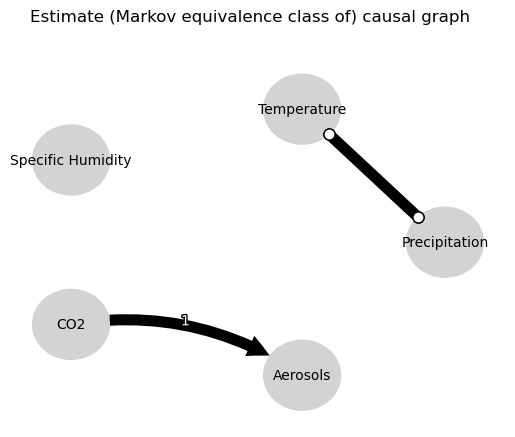

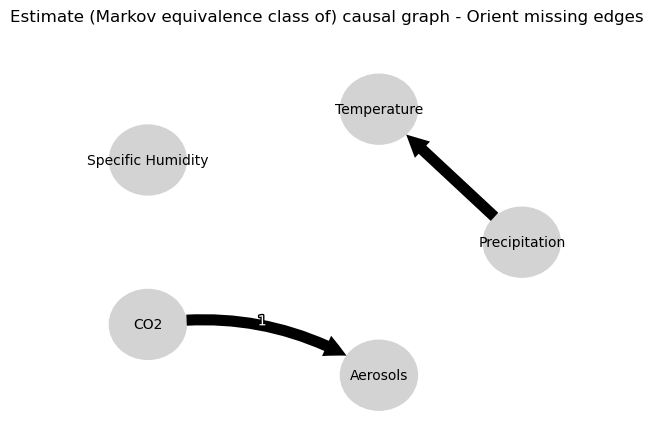

0.0
-0.038166634382704054
-0.3481932919752051
-0.1827202549182509
-0.16761874089255013
-0.054523165532674785
0.10694089258818422
0.05055152766730265
-0.03300301233545228
-0.08377275304031005
-0.3481932919752051
0.07643181098818454
0.0
0.4446755690475957
0.33513729478236803
0.18363029938705677
-0.09584669548040807
-0.041463858566229736
0.256631627815036
0.21578243190679117
0.33513729478236803
0.22356656149359286
0.0
0.5283816986906837
-0.06802920520357679
-0.03965416186093031
0.09410072911781245
0.0920990927642997
-0.09584669548040807
-0.05842435070955377
-0.06802920520357679
-0.010086171439119848
0.0
-0.03396010764922936
0.07537177065137153
-0.4461105907035742
0.256631627815036
0.14932487624470214
0.09410072911781245
0.031295713355892235
0.07537177065137153
0.08495053234420022
0.0
0.4781443180409003


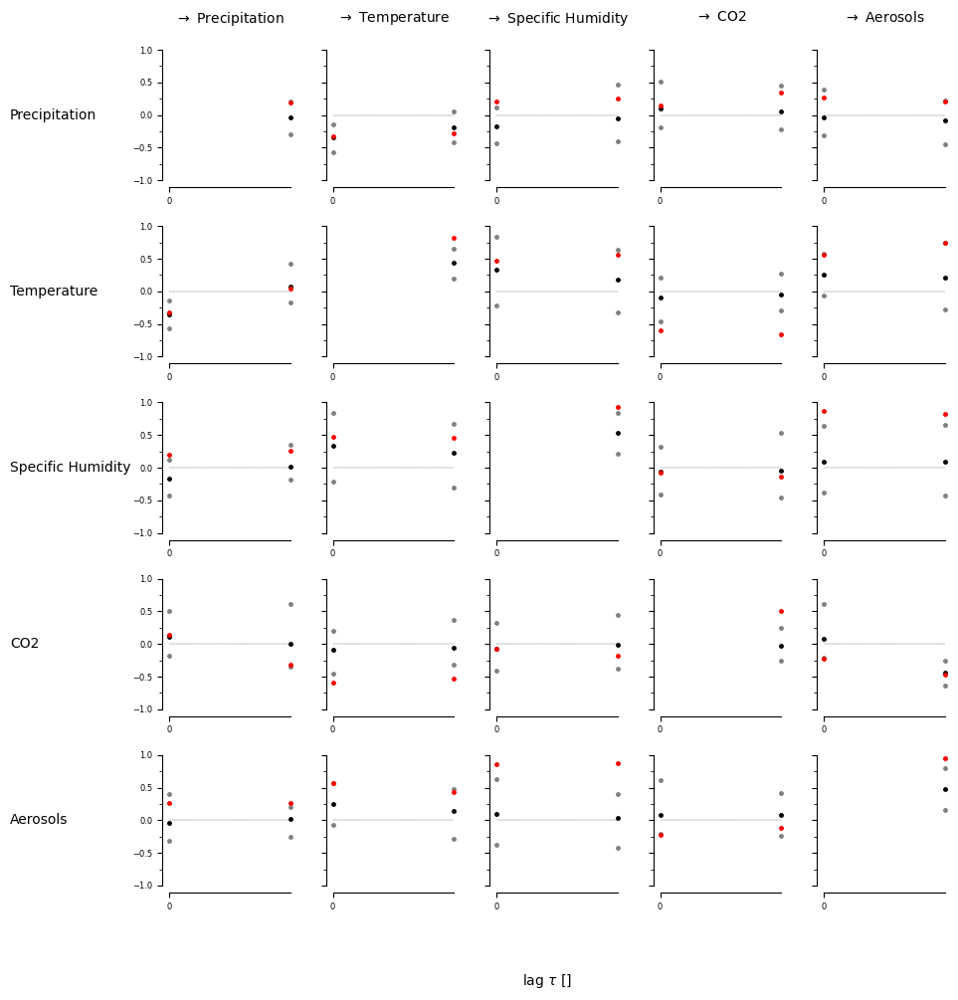

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [ True  True]
  [False False]
  [False  True]]]


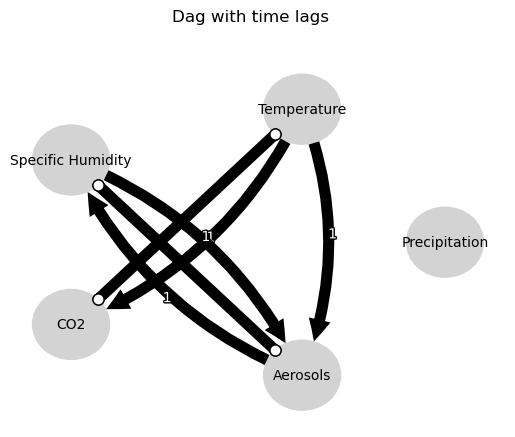

Negative precipitation values in event 134: 0


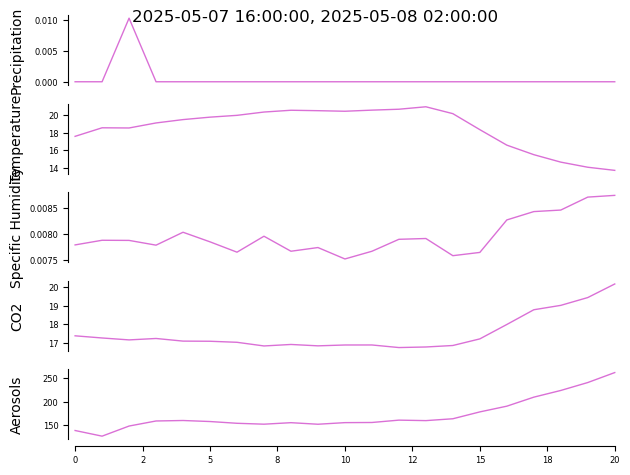


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


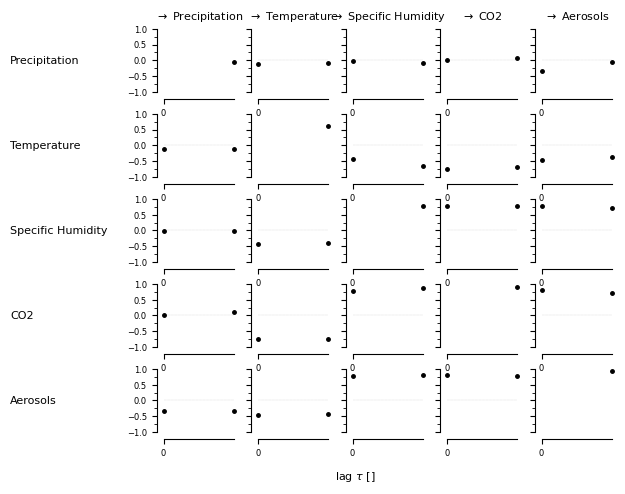

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.02115, |min_val| =  0.538

    Variable Specific Humidity has 2 link(s):
        (CO2 -1

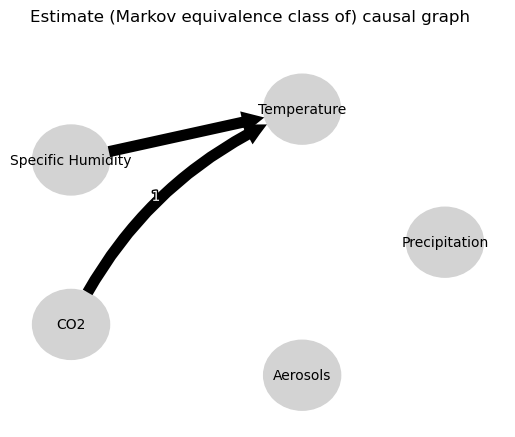

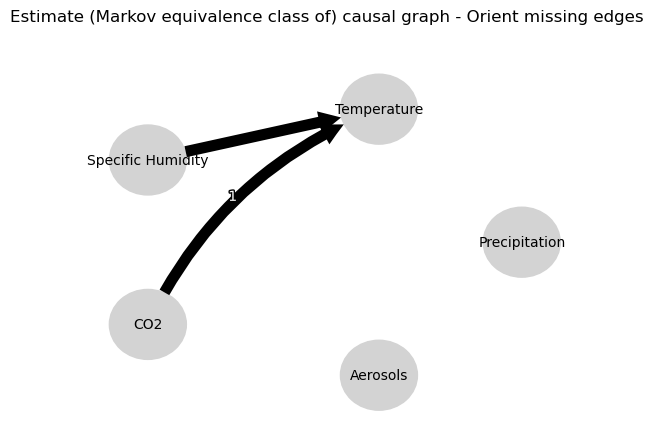

0.0
0.0063126008878497675
0.07690243709567286
0.07676555912079149
0.01798460773945463
-0.0924165931359893
-0.10644393068090796
-0.08838174547517183
-0.0849194459862725
-0.10080653359879906
0.07690243709567286
0.10664377029895697
0.0
0.8366244088220184
-0.05440977426497815
0.07415120596268138
-0.7724760768088889
-0.7746522506863125
-0.28433959623584315
-0.30630115715748146
-0.05440977426497815
0.05764814658289245
0.0
-0.07660387748529848
-0.04998189833623754
-0.022512016909224348
-0.06207682482177188
-0.05444379466253631
-0.7724760768088889
-0.7496441843372579
-0.04998189833623754
-0.06346798354663578
0.0
0.9554923812264194
0.41042333342457693
0.4248603140337229
-0.28433959623584315
-0.2787485496022516
-0.06207682482177188
-0.07354065946918338
0.41042333342457693
0.4238570149240567
0.0
0.9008056398285826


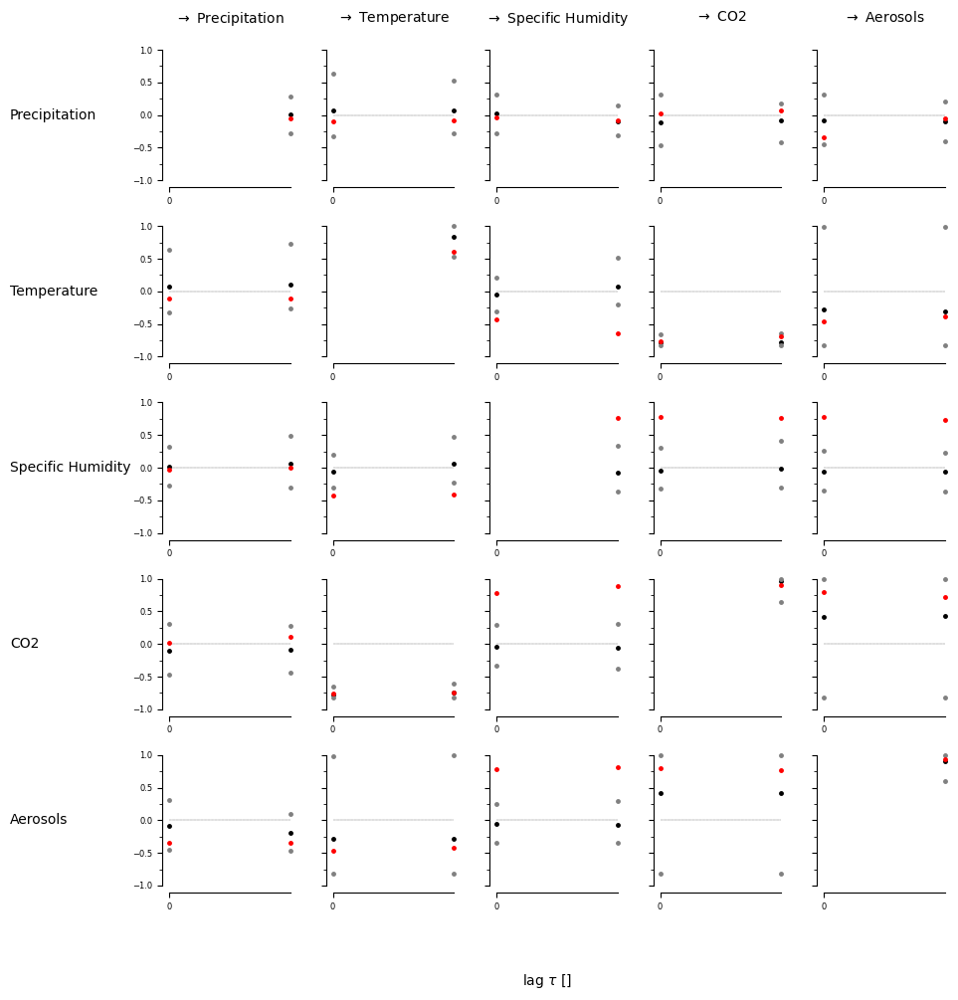

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [ True  True]
  [ True  True]
  [False  True]]]


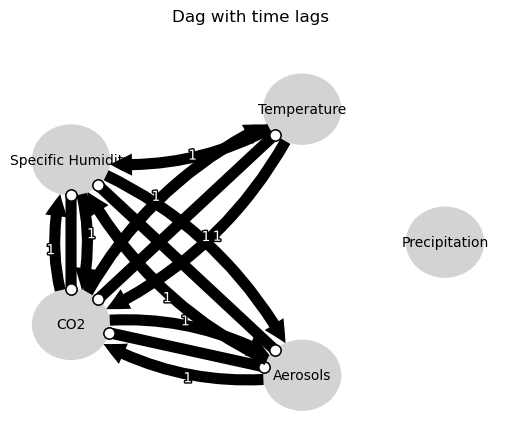

Negative precipitation values in event 135: 0


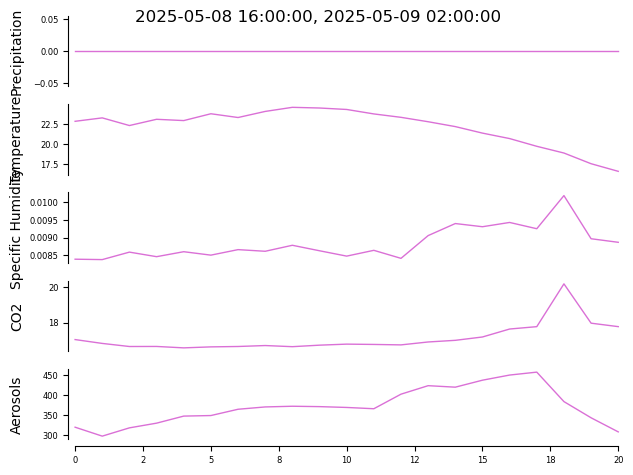


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


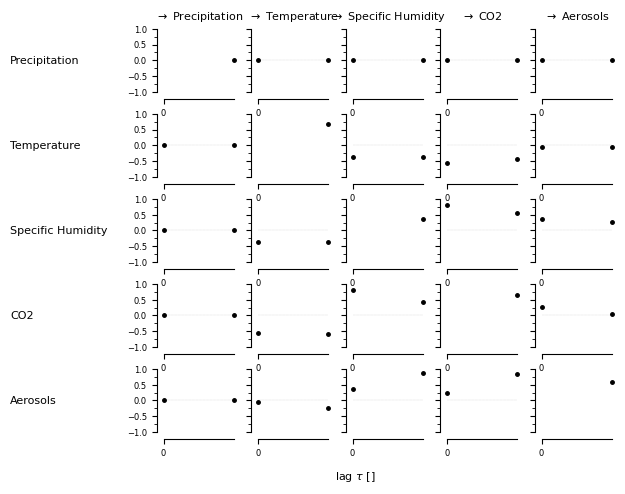

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.03417, |min_val| =  0.501

    Variable Specific Humidity has 1 link(s):
       

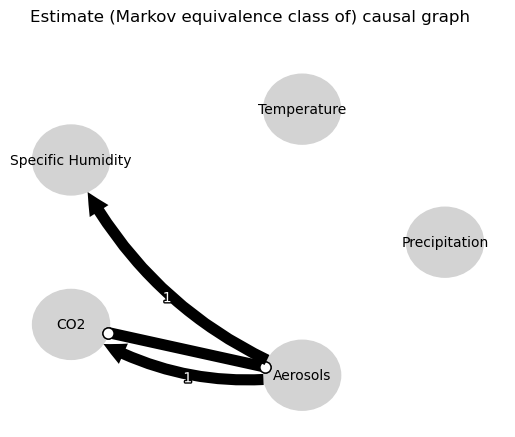

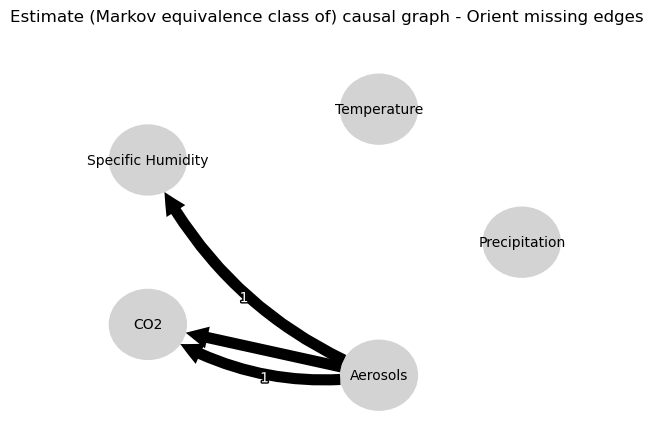

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.8966034824356459
0.16450584287729134
0.1753836456703732
0.06509045700297442
0.07392266437891742
0.165669921225689
0.155049054877374
0.16450584287729134
0.09716610839717103
0.0
0.1498115705597769
0.6753712120467043
0.1565626705106017
0.23238613245641235
0.13121134558265038
0.06509045700297442
0.037769324199541626
0.6753712120467043
-0.042004899276234124
0.0
-0.028719929484251915
-0.07099080553983379
-0.08944219225223168
0.165669921225689
0.17259860408356303
0.23238613245641235
0.6766354178024425
-0.07099080553983379
0.5162340748680928
0.0
0.48456230414910373


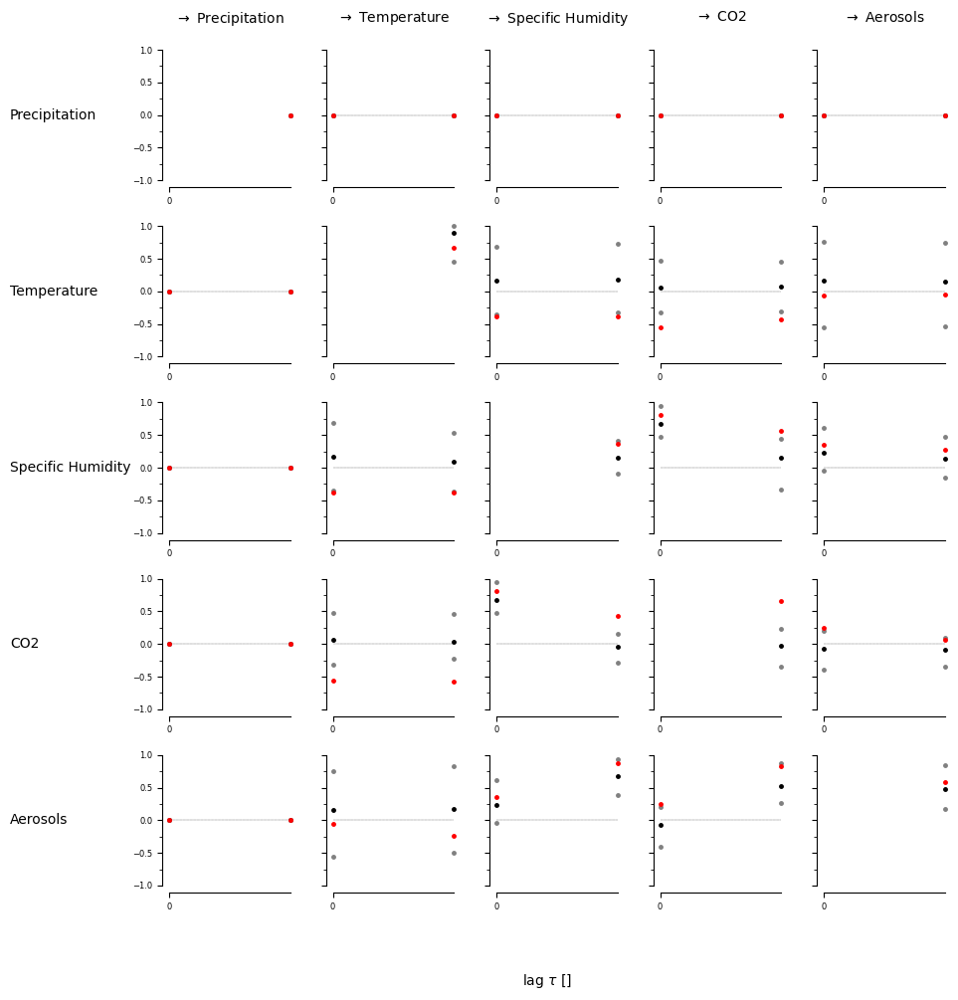

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [False  True]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False  True]
  [False  True]]]


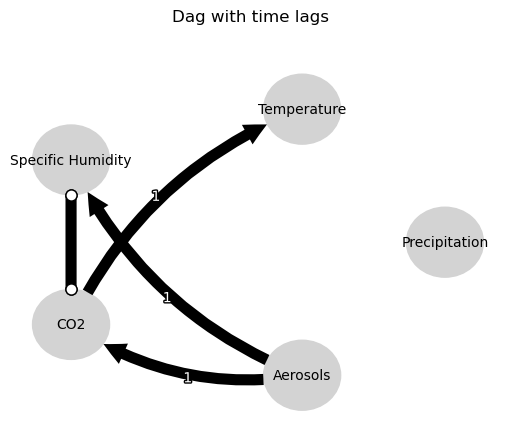

Negative precipitation values in event 136: 0


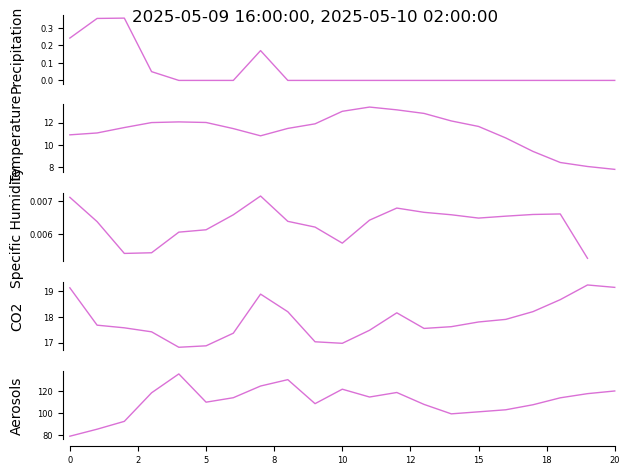


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


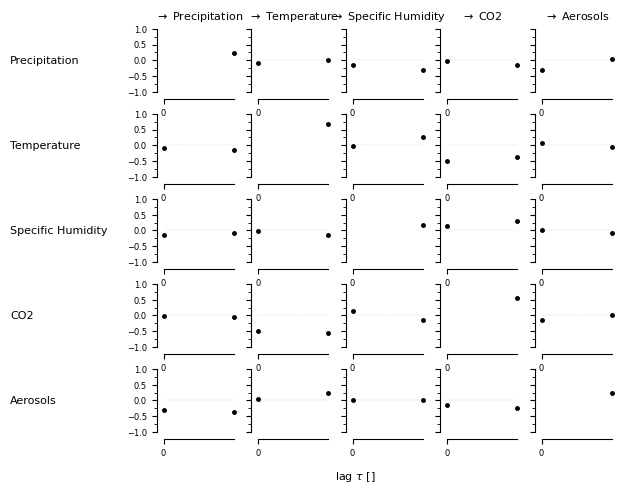

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.02069, |min_val| =  0.540

    Variable Specific Humidity has 0 link(s):

    Va

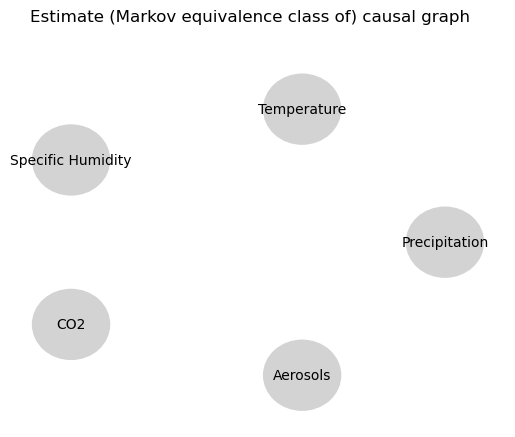

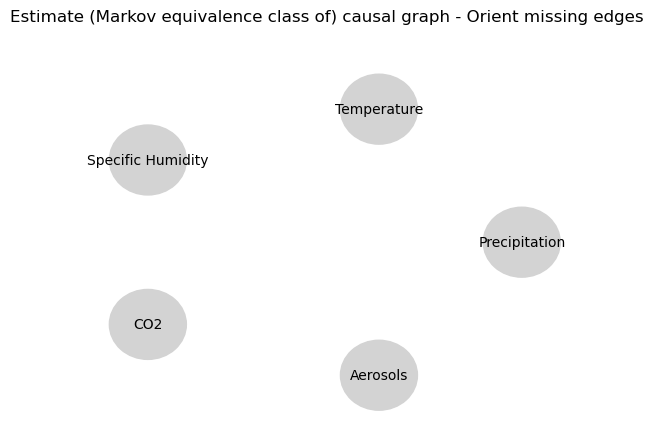

0.0
-0.04857965706514801
0.03132965886428633
-0.02238341394683942
-0.1237358315031197
-0.008066613864541569
-0.12350078783936085
-0.09660649805270742
-0.4218260573120142
0.04435912987548859
0.03132965886428633
-0.11301000255297321
0.0
0.6738478415615808
-0.11045427096777248
0.13508989825708215
-0.11848775223061687
0.036612400893198775
0.03003479936942964
-0.08919173165992406
-0.11045427096777248
-0.0820111647300867
0.0
-0.05301214804437013
0.17750182025627448
0.014690469961721736
-0.05875292128768018
0.02390775171653452
-0.11848775223061687
-0.0036250028292442284
0.17750182025627448
-0.0043246877646111685
0.0
0.3217090037259654
0.21341221840908092
0.012776243637309774
0.03003479936942964
0.026353102780992576
-0.05875292128768018
0.0380789191311471
0.21341221840908092
0.10093253418709792
0.0
-0.04596803662864672


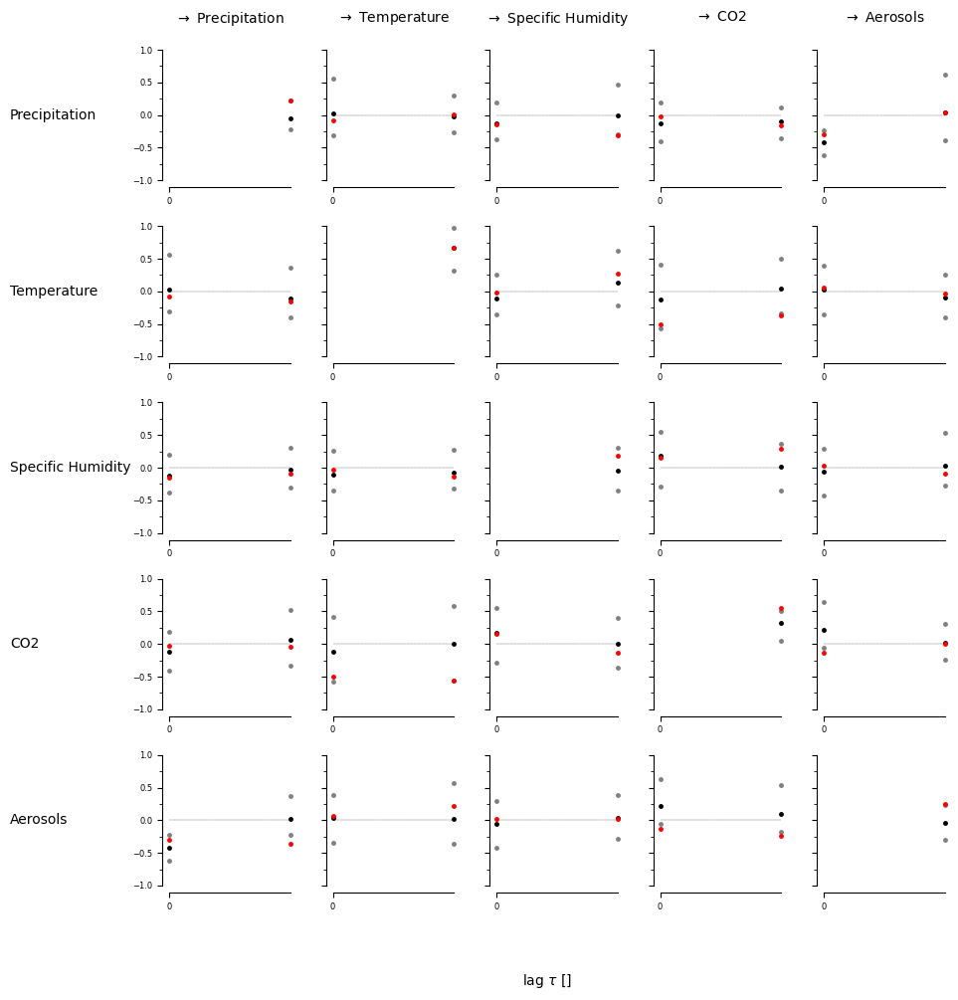

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


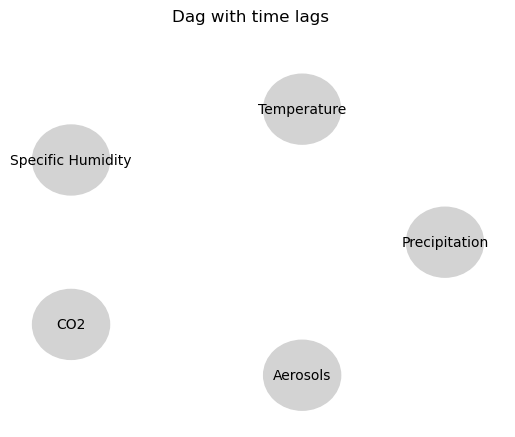

Negative precipitation values in event 137: 0


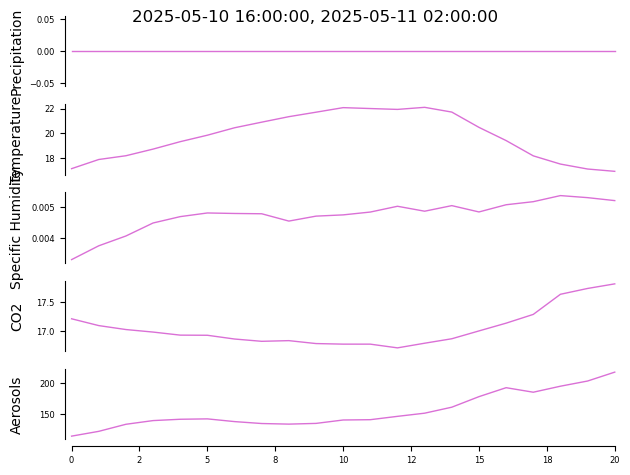


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


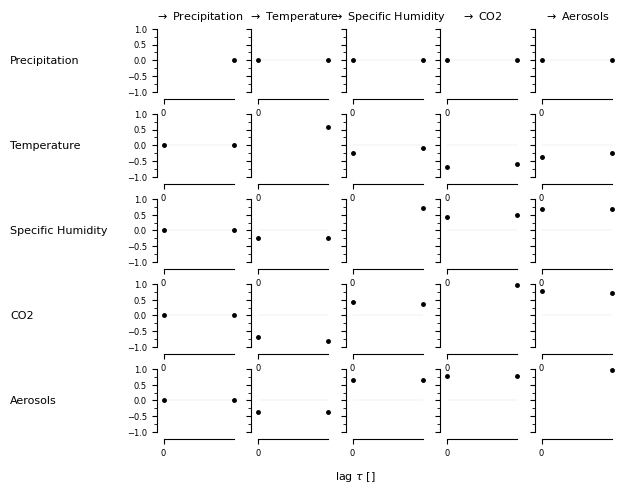

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.00143, |min_val| =  0.693

    Variable Specific Humidity has 0 link(s):

    Variable C

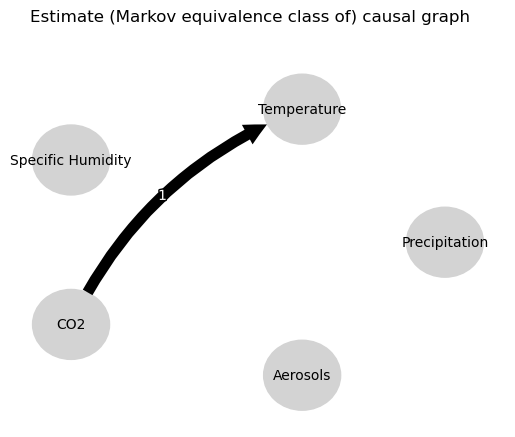

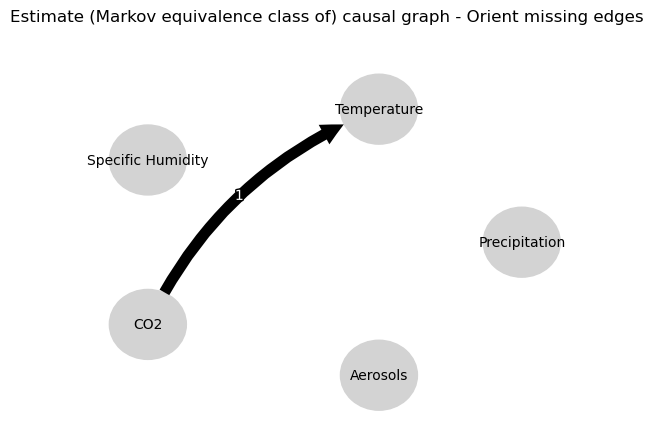

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.6842110658364287
0.16132514256186037
0.003027451733954232
-0.6637774458657572
-0.6273570464178928
-0.08543149349444165
-0.08008462698038556
0.16132514256186037
-0.06568757700690124
0.0
-0.10243431396128715
0.08532510140274198
0.011250327927085768
-0.0024719280012053587
-0.0038839666707659705
-0.6637774458657572
-0.717971529143408
0.08532510140274198
-0.08616208105150767
0.0
0.8023921485296914
0.11361937789637724
0.10581832824917782
-0.08543149349444165
-0.09021272578552919
-0.0024719280012053587
0.10205866131401563
0.11361937789637724
0.12677843541906822
0.0
0.6865757321220946


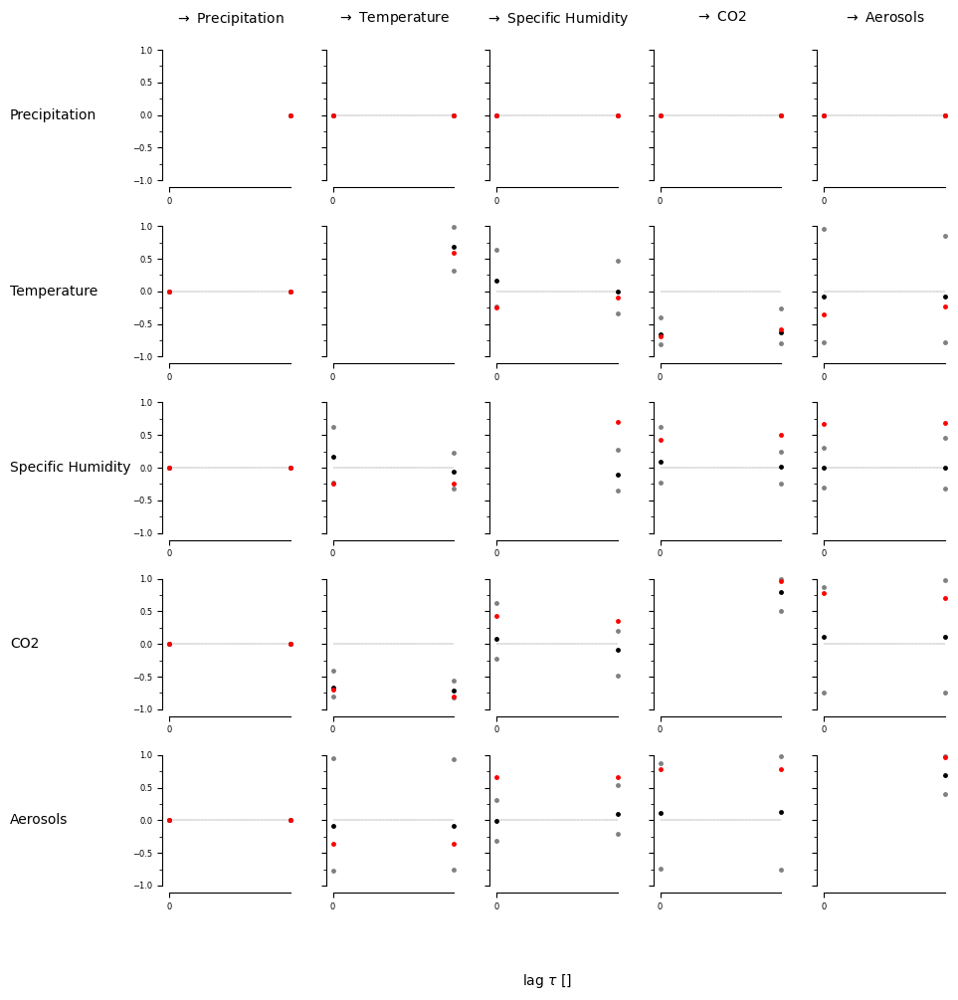

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [ True  True]
  [ True  True]
  [False  True]]]


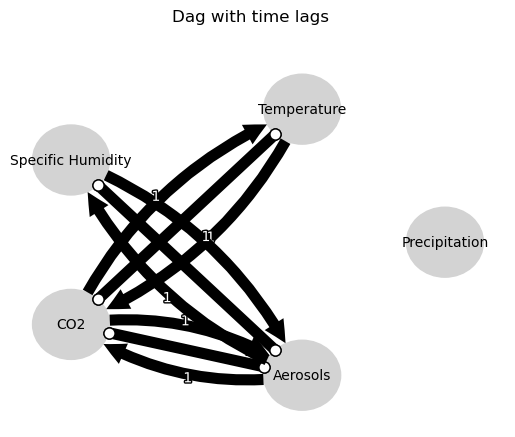

Negative precipitation values in event 138: 0


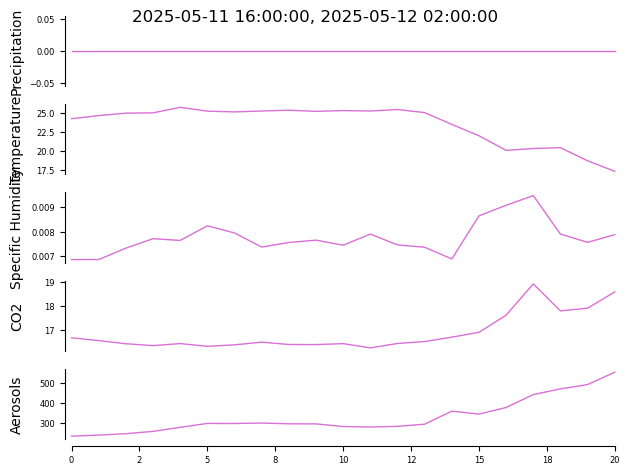


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


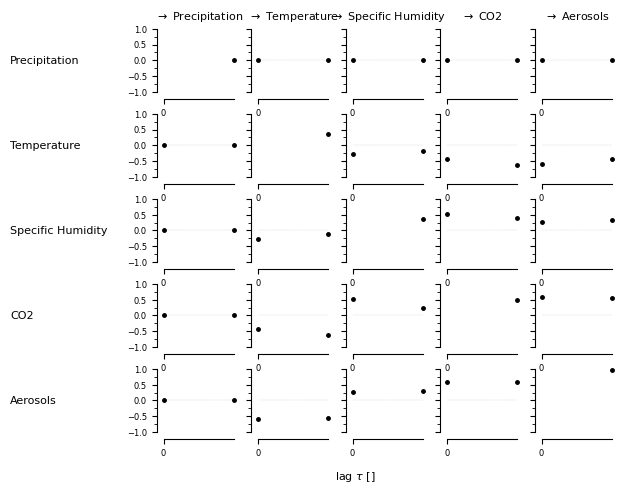

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 1 link(s):
        (Temperature -1): max_pval = 0.

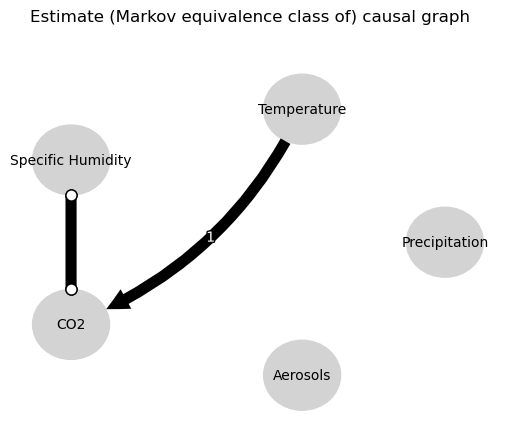

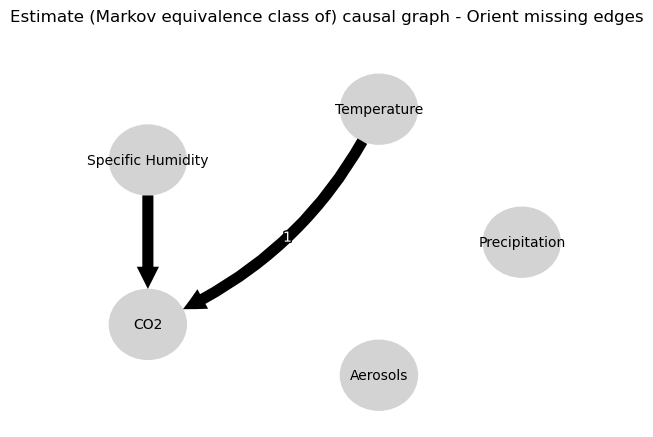

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.08133777434755027
-0.33570432842201825
0.05289047087112364
-0.044664070096826256
-0.7569439871969057
0.05495518405955265
0.013154149989586176
-0.33570432842201825
-0.023963466339677563
0.0
-0.018469742942873055
0.05171194110175774
0.34987090830268447
-0.053318366989150406
-0.034812433894205456
-0.044664070096826256
0.055486931346445195
0.05171194110175774
0.005335534079581364
0.0
-0.0185834320009971
-0.018817065995866473
-0.011504933785523343
0.05495518405955265
0.08209490061284293
-0.053318366989150406
-0.07111131990679177
-0.018817065995866473
-0.05618747794466691
0.0
0.8650870714813259


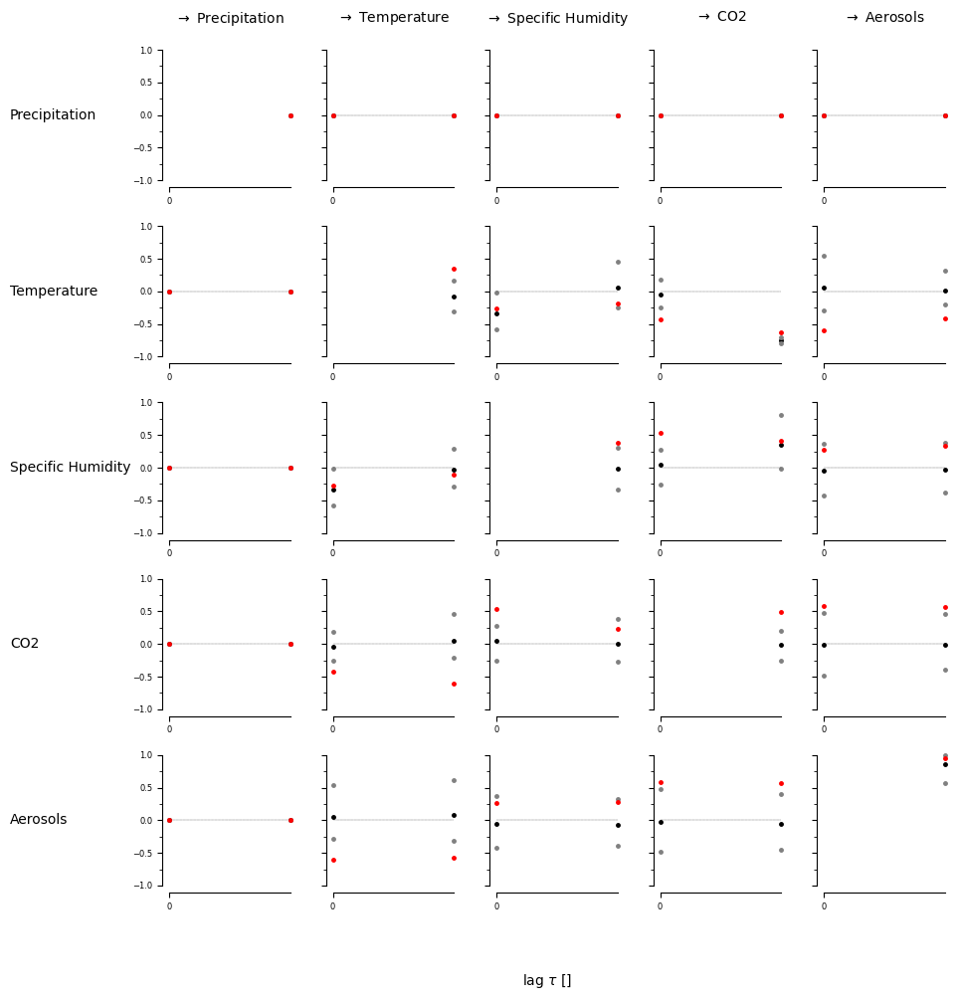

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [ True False]]

 [[False False]
  [ True False]
  [False False]
  [ True False]
  [False  True]]]


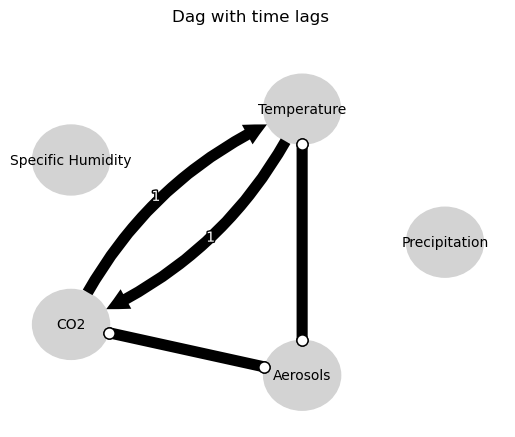

Negative precipitation values in event 139: 0


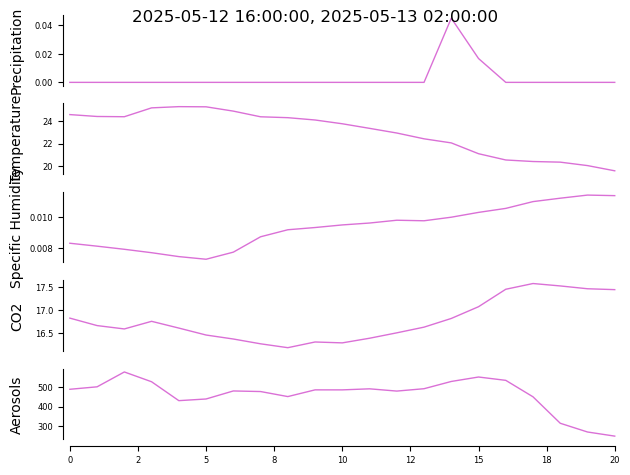


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


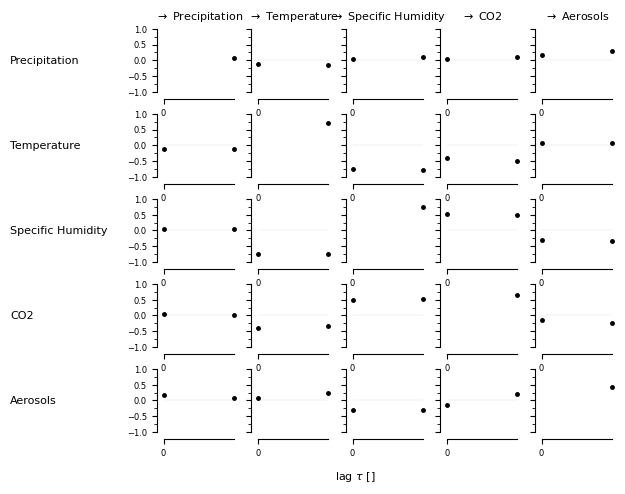

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 1 link(s):
        (CO2 -1): max_pval = 0.01807, |

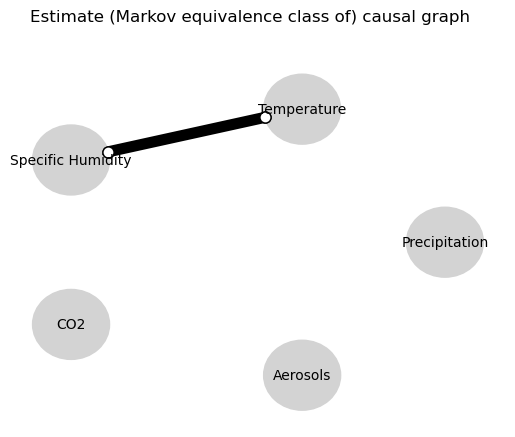

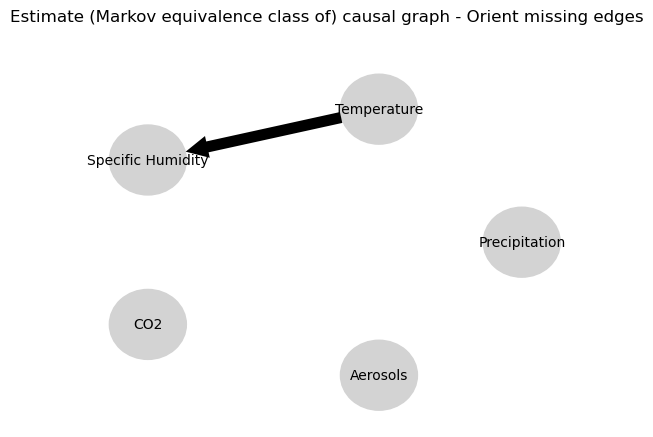

0.0
-0.011084398812547375
-0.08732788639403535
0.05170839489677339
0.1385956004727152
0.03240367753220796
0.04546108571182352
-0.027041986982615895
0.16973191101113558
0.030215885928817153
-0.08732788639403535
0.029289484233911835
0.0
-0.02432195490031207
-0.7682356567999077
0.04358948163148538
-0.6783642955769977
0.033925564954674685
0.49775045164136206
0.004296039545010233
-0.7682356567999077
0.034184521802305884
0.0
-0.08853640479864923
0.612157452361487
-0.06968084108775915
-0.4194405791539951
-0.0011722608270614808
-0.6783642955769977
0.037538391220845936
0.612157452361487
-0.09314876470403154
0.0
-0.09444985915173068
-0.4351195078301624
-0.017109790824846986
0.49775045164136206
0.0409217492494183
-0.4194405791539951
0.032646697602466086
-0.4351195078301624
-0.012548541205997823
0.0
-0.0438664419562254


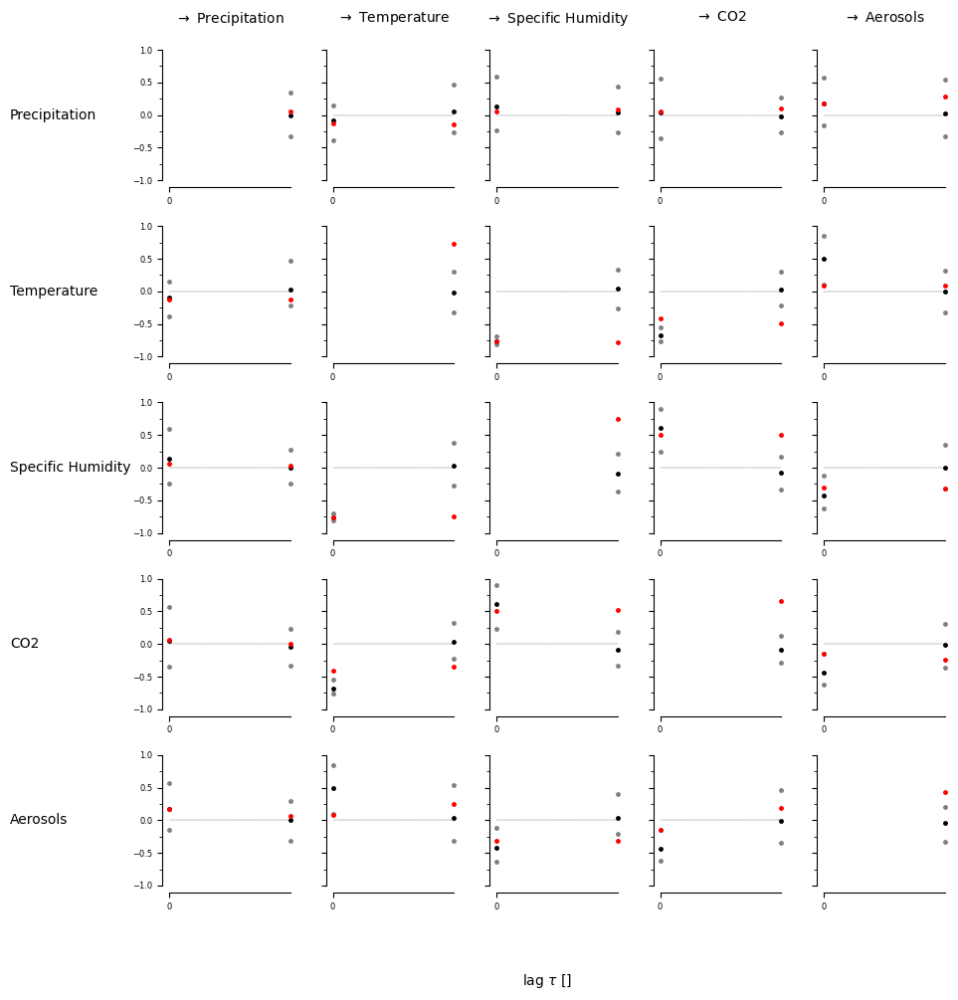

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


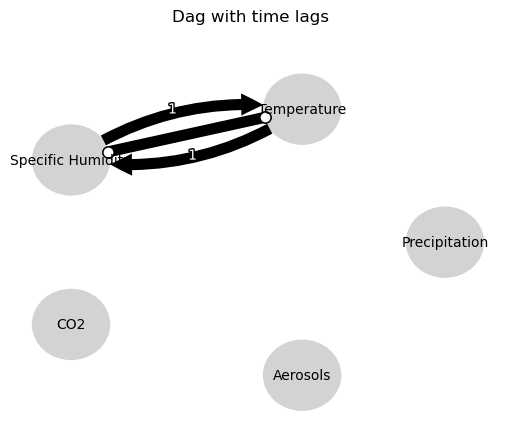

Negative precipitation values in event 140: 0


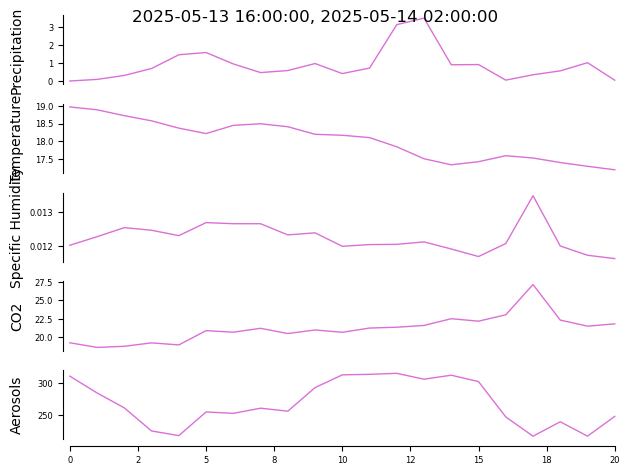


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


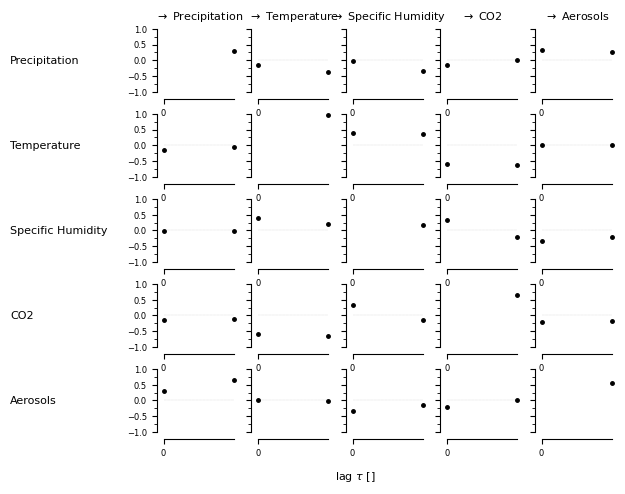

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Aerosols -1): max_pval = 0.00345, |min_val| =  0.636

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00000, |min_val| =

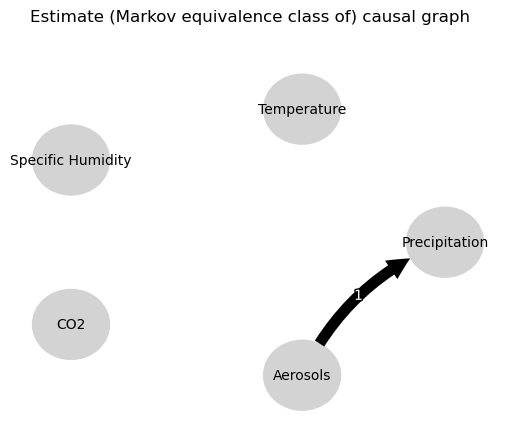

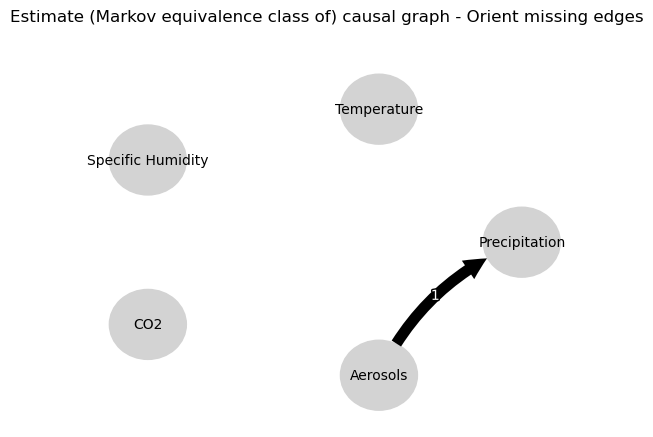

0.0
-0.05868166380604037
-0.20963386617382
-0.1330674338658505
0.0326330715180745
0.007622672989610182
0.01494840328489633
0.020619732037160197
0.06734802518301568
-0.02702855998028633
-0.20963386617382
0.18553381631941404
0.0
0.530666500711669
0.18918631007768932
0.034111915462506914
0.03761145282765458
0.009645366215321251
-0.09224021744088202
-0.02006223804239638
0.18918631007768932
0.06602843474423263
0.0
-0.0008823999472841677
0.14388926469800822
-0.016962715514998006
-0.33713225249981155
-0.0863751289555801
0.03761145282765458
-0.03413223670577202
0.14388926469800822
-0.018751513085941786
0.0
-0.03485706427626794
0.020540904652018
0.03454570455873638
-0.09224021744088202
-0.07688454941631953
-0.33713225249981155
0.12116226655019406
0.020540904652018
0.06657392199161025
0.0
-0.043810455435720375


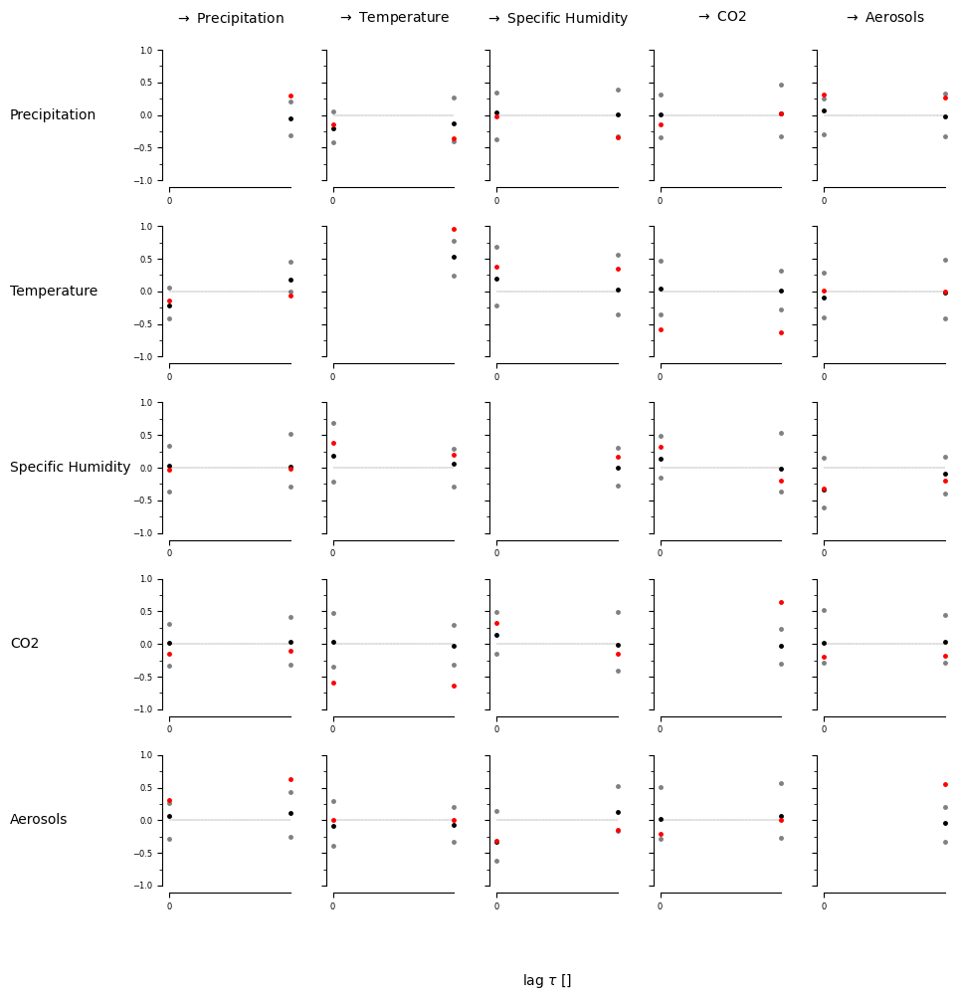

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False  True]
  [False False]
  [False False]
  [False False]
  [False False]]]


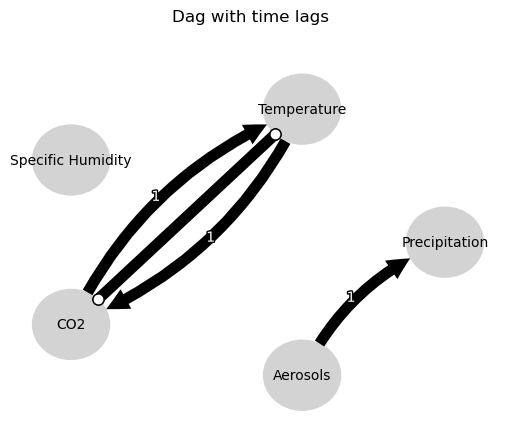

Negative precipitation values in event 141: 0


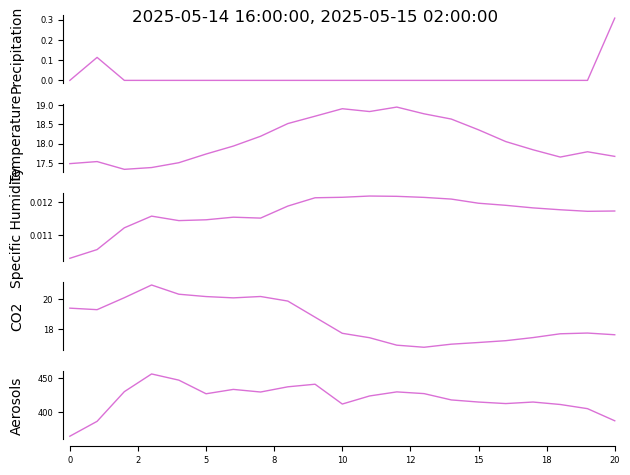


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


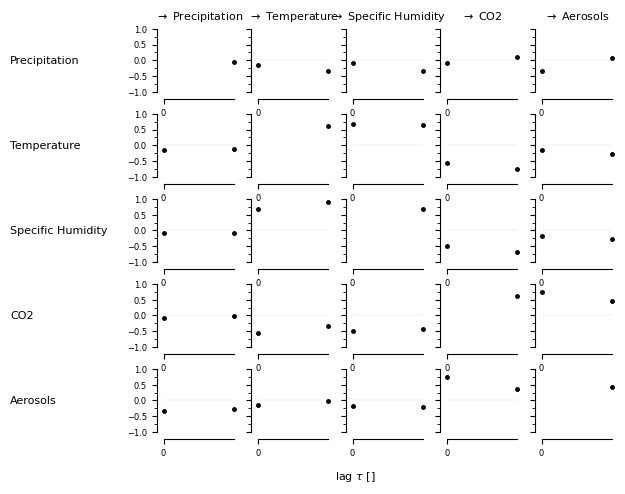

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00002, |min_val| =  0.831

    Variable Specific Humidity has 0 link(s):



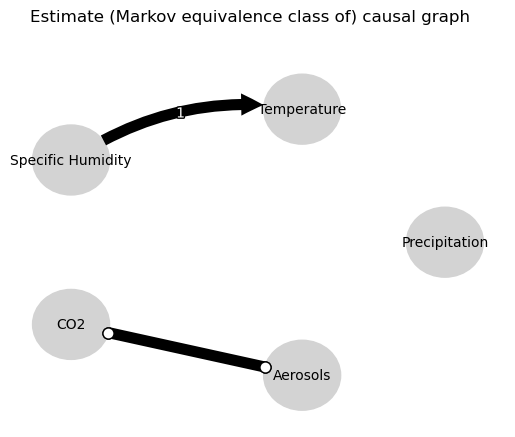

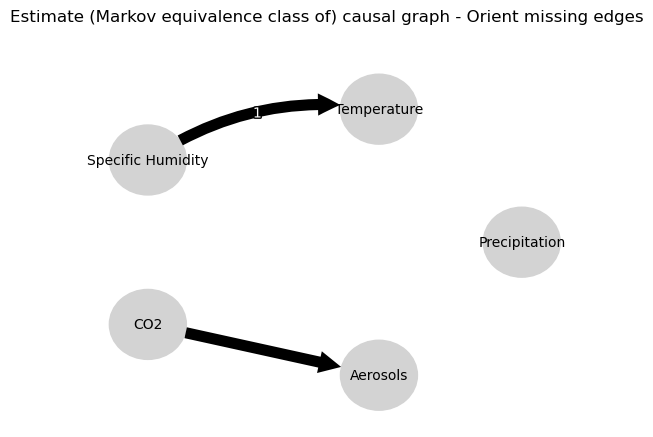

0.0
-0.04493546857287976
-0.06571128613085266
-0.08194393414109183
-0.15538814588680552
0.02562526953071091
-0.053336664701045915
0.05338216550964449
-0.46824260895090547
0.05990080332864254
-0.06571128613085266
-0.08188763384022583
0.0
-0.02966130660054169
0.058613446964954206
0.011705665571568203
-0.0492675419689064
-0.010189095897314895
0.058089965367480366
0.011412348800533257
0.058613446964954206
0.5392147224525612
0.0
-0.111410926789705
-0.5343893995485369
0.06497948588725164
0.13052734317254786
0.031162415876534455
-0.0492675419689064
-0.3278293297760955
-0.5343893995485369
0.0005980563484045409
0.0
-0.032735106100742616
0.3696536702016227
-0.0526716431988165
0.058089965367480366
0.0675568782564397
0.13052734317254786
-0.01633794355038219
0.3696536702016227
-0.030852846584258853
0.0
-0.041337821407721326


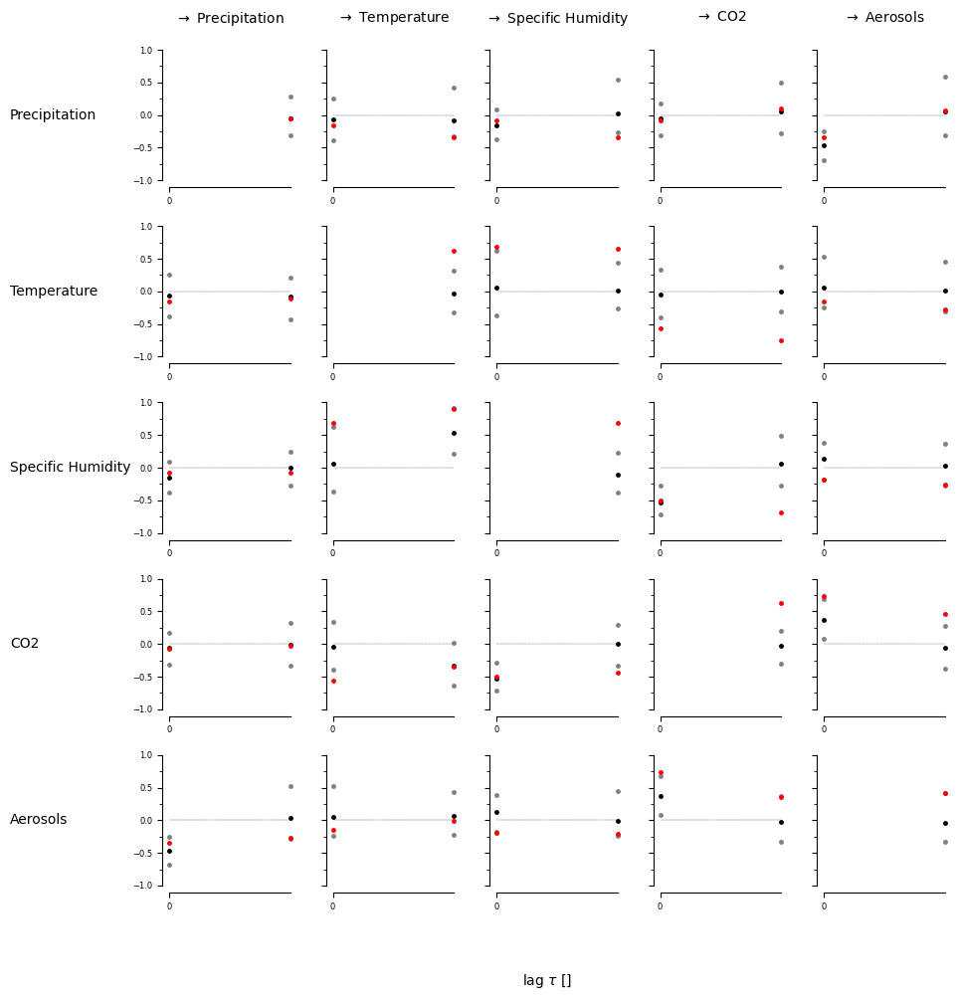

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [ True  True]
  [False  True]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]]


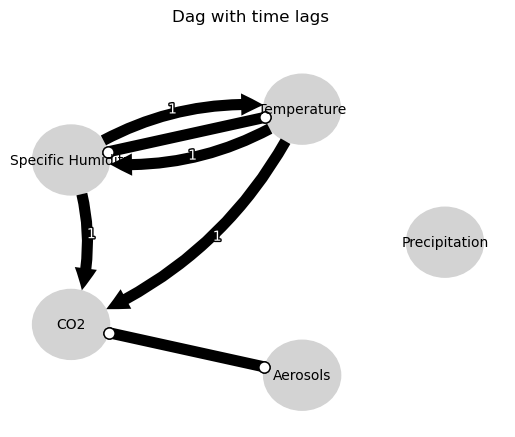

Negative precipitation values in event 142: 0


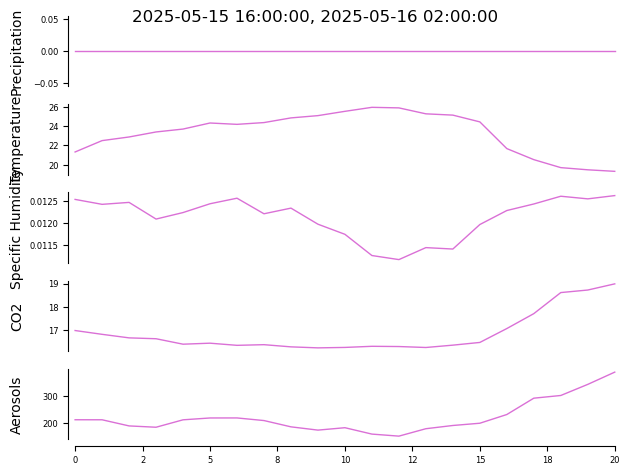


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


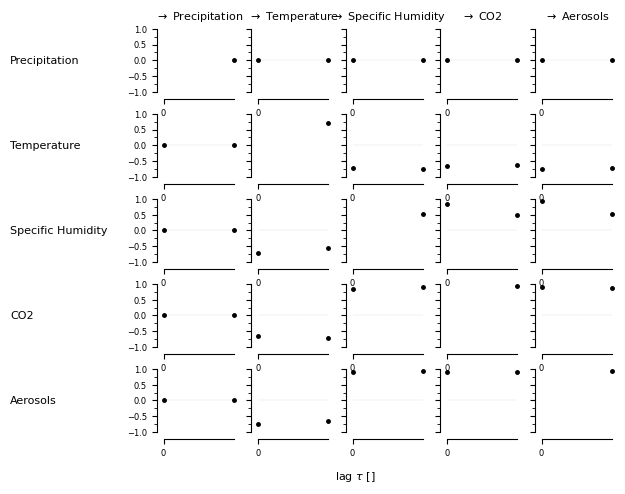

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.03275, |min_val| =  0.505

    Variable Specific Humidity has 1 link(s):
        (Aeroso

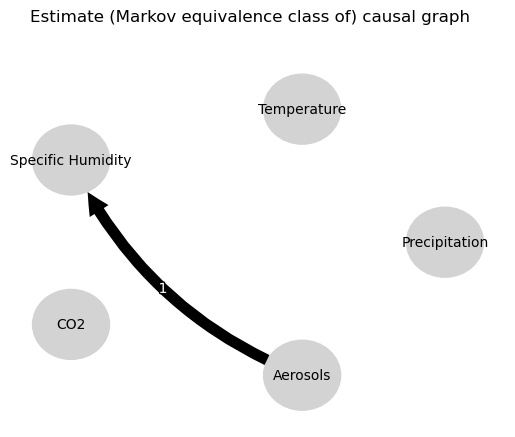

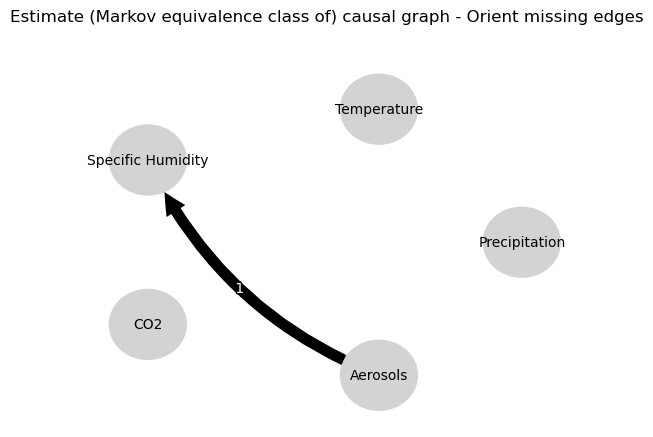

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.08557049832440804
0.01672174714982803
0.032733514391387504
0.004838220788398958
-0.02202356066550782
0.03390693749514116
-0.0006709980475898515
0.01672174714982803
0.05804631062418282
0.0
0.7326842477785257
0.16923088190759292
0.15690090360713904
0.8175256658122475
0.7825380547887487
0.004838220788398958
0.04611578864251843
0.16923088190759292
0.1537922417947837
0.0
0.8376650483752321
0.18079642619282157
0.1794318871422115
0.03390693749514116
0.06706479598036177
0.8175256658122475
0.8581315309358514
0.18079642619282157
0.17688136942609958
0.0
0.861789700322479


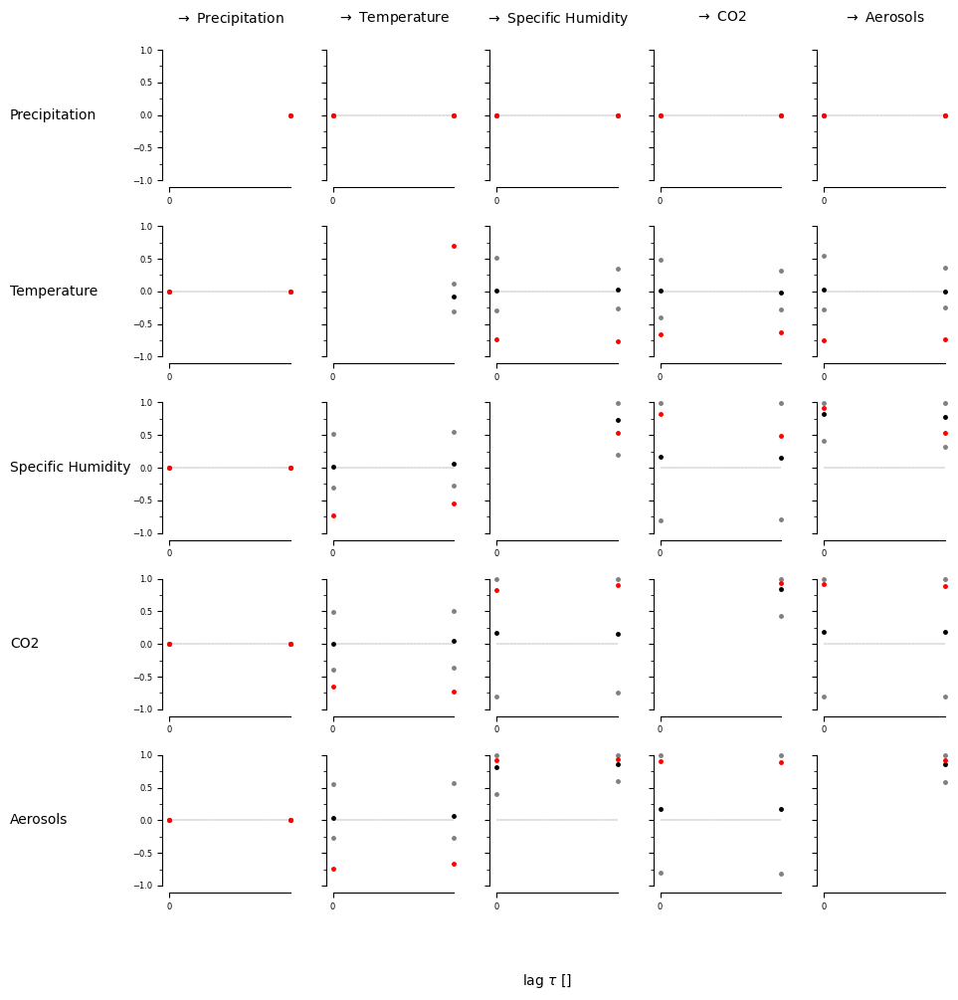

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True False]
  [False False]
  [ True False]
  [ True False]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [ True  True]
  [False  True]]]


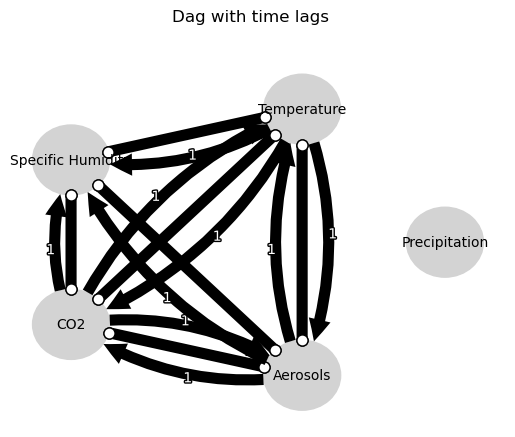

Negative precipitation values in event 143: 0


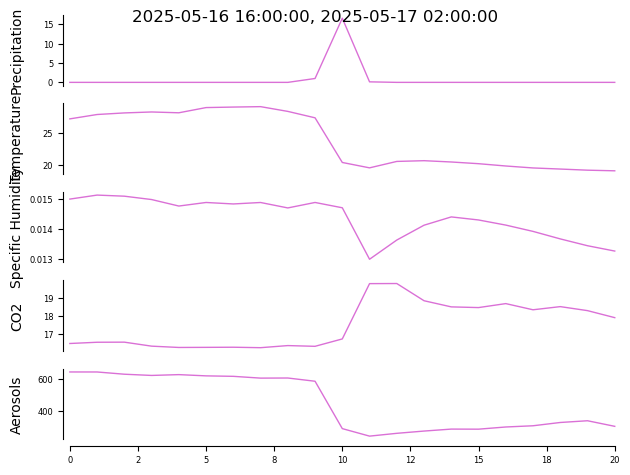


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


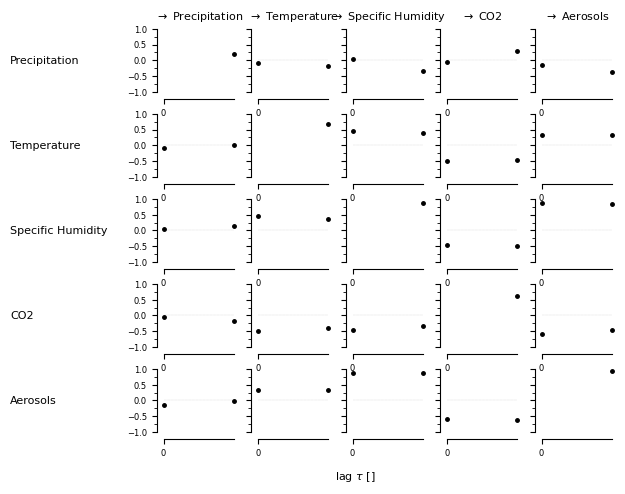

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00156, |min_val| =  0.674

    Variable Specific Humidity has 0 link(s):

    Va

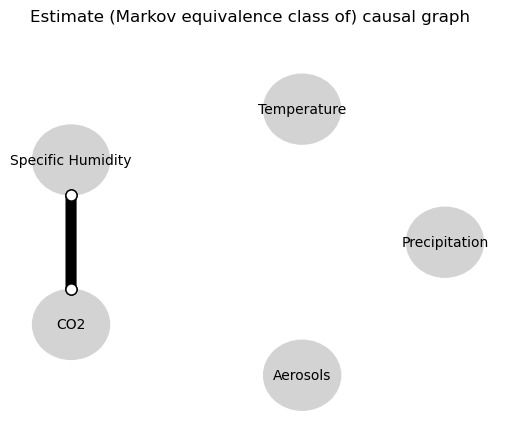

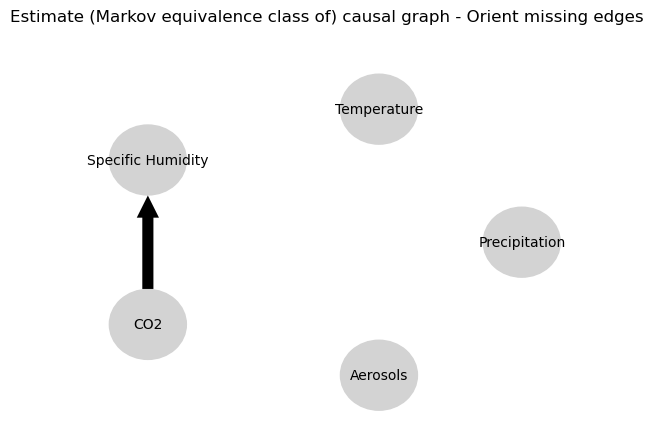

0.0
-0.05612466841713215
-0.36057411285990154
-0.2931305258746225
0.11455213252219866
-0.053337176083425496
-0.08135688103874164
0.04722685529691674
-0.41046779891560436
-0.3270193661210196
-0.36057411285990154
0.2118334687043961
0.0
0.5297402161302184
-0.005919479582383253
-0.018918568662444946
-0.01478990817807507
0.009403488293095164
0.8203795805211023
0.4592177063086835
-0.005919479582383253
-0.029793279471514052
0.0
-0.08538146814225452
-0.6732022291192855
0.0589792501247555
0.026368392194464983
-0.03269056933736471
-0.01478990817807507
-0.014556546003545211
-0.6732022291192855
0.006444112474676914
0.0
-0.022632270196667758
-0.04588445026594148
-0.009643064034258892
0.8203795805211023
0.5242901259380494
0.026368392194464983
-0.023365878414883762
-0.04588445026594148
-0.0027092572045961816
0.0
0.5121195179784007


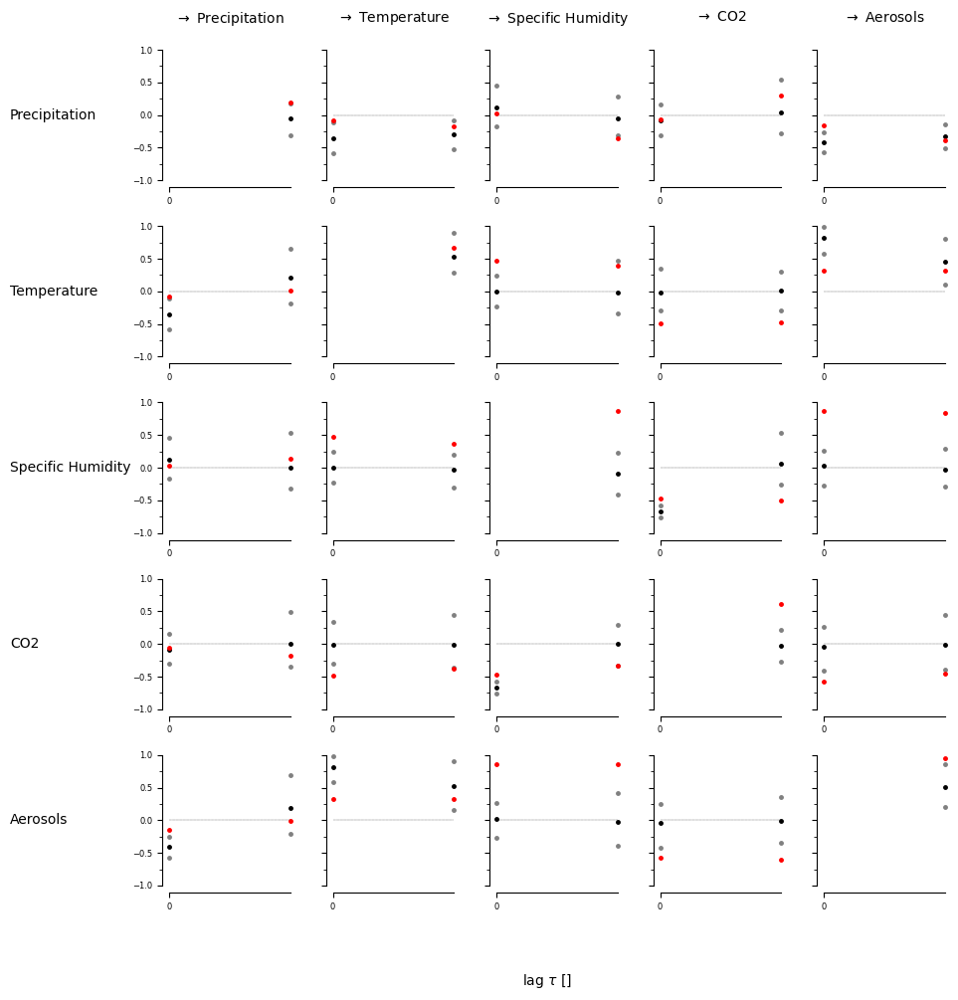

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [ True  True]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [ True False]]

 [[False False]
  [False False]
  [ True  True]
  [ True  True]
  [False  True]]]


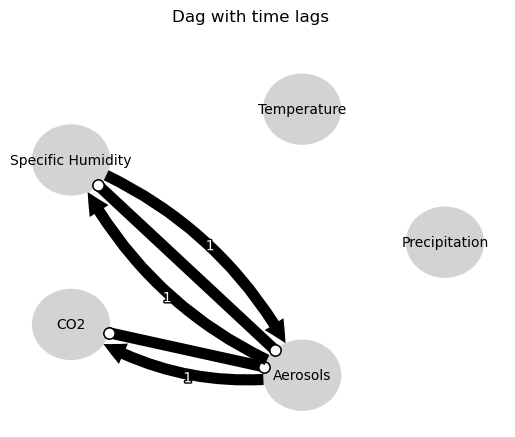

Negative precipitation values in event 144: 0


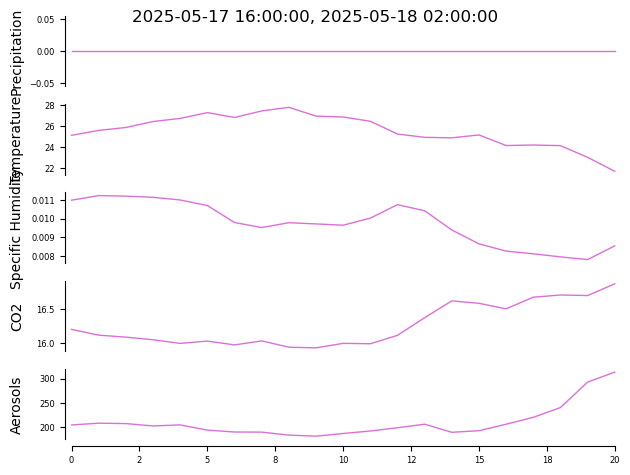


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


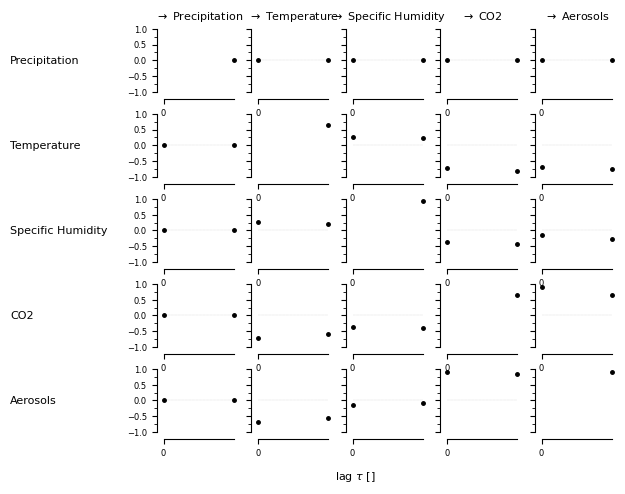

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00000, |min_val| =  0.944



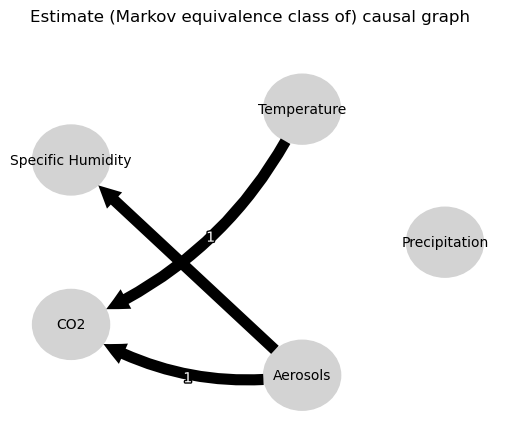

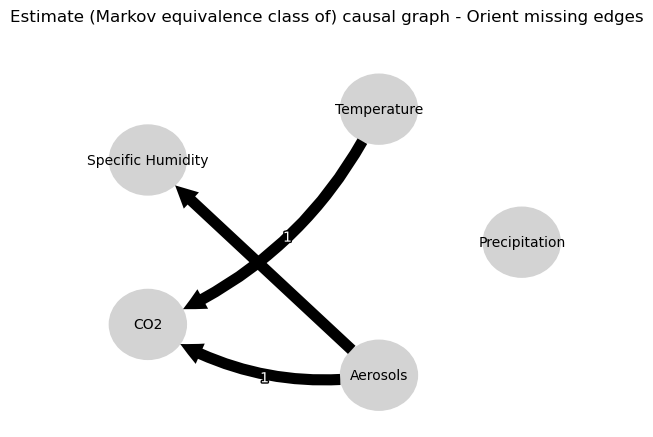

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.030309421446297283
-0.025387459552827396
-0.005354425290134264
0.0248765513878204
-0.37810021210163686
-0.04112926989119286
-0.0022184070011845008
-0.025387459552827396
-0.022837192782203457
0.0
0.9211698355350602
-0.5692652607014478
-0.5780585249068891
0.9251348566997829
0.8948338853250412
0.0248765513878204
0.018718120440383946
-0.5692652607014478
-0.5799860437901182
0.0
0.5452402074547005
-0.5804850703787007
-0.5541285596671812
-0.04112926989119286
-0.005165052019906098
0.9251348566997829
0.8937228526412703
-0.5804850703787007
-0.5813343369223467
0.0
0.9041654593157522


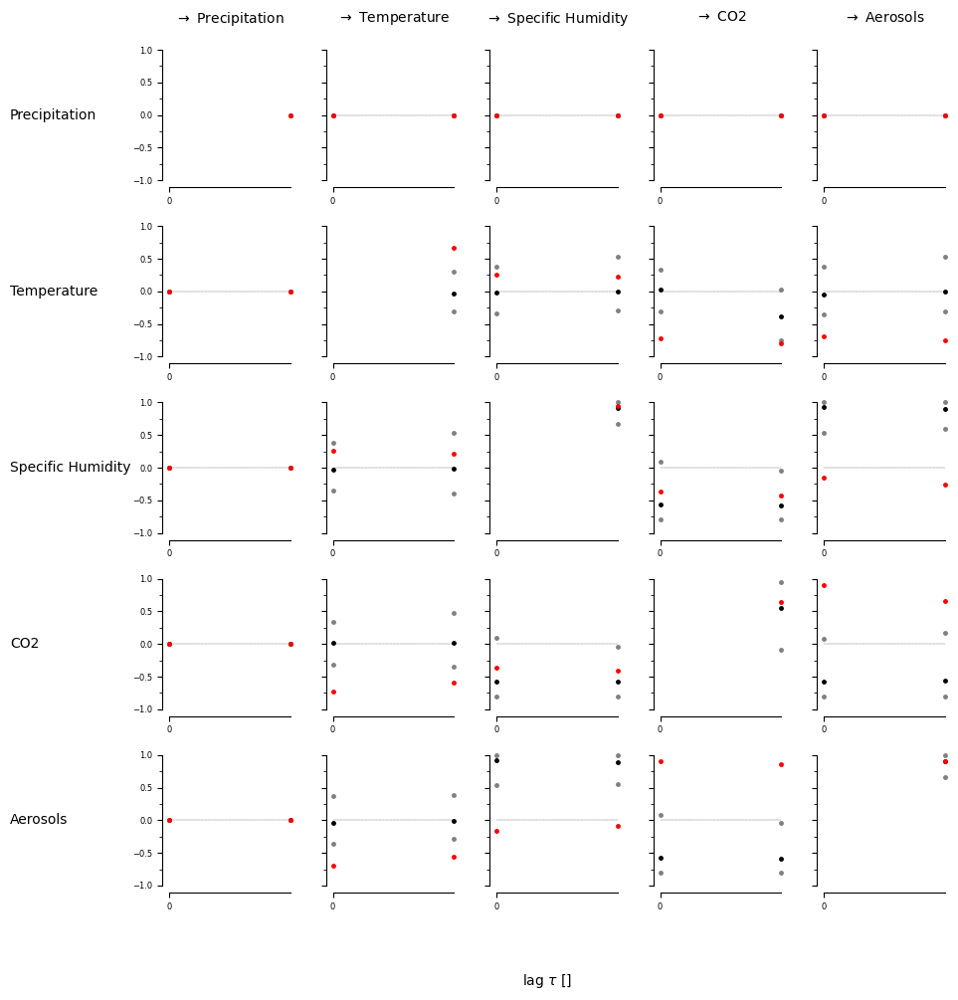

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True False]
  [False False]
  [ True  True]
  [False  True]]]


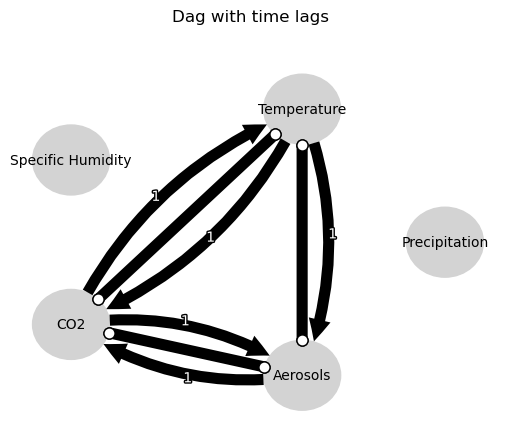

Negative precipitation values in event 145: 0


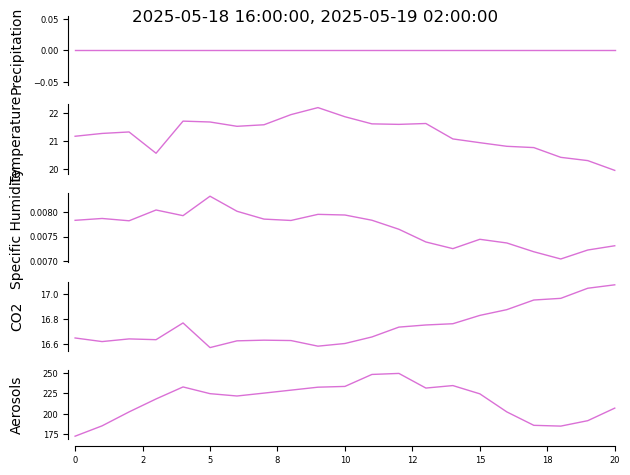


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


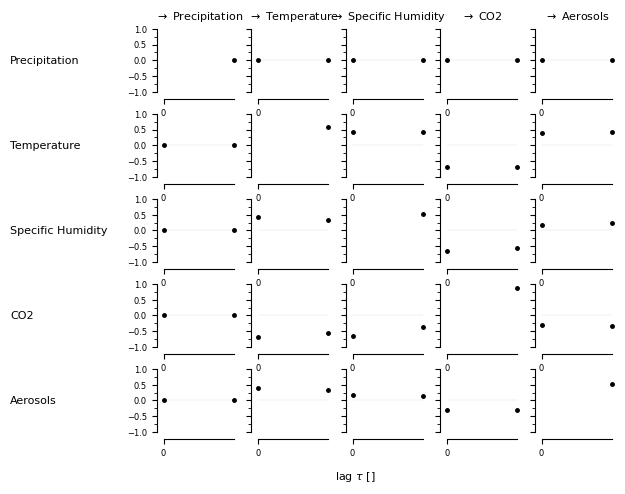

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.02422, |min_val| =  0.514



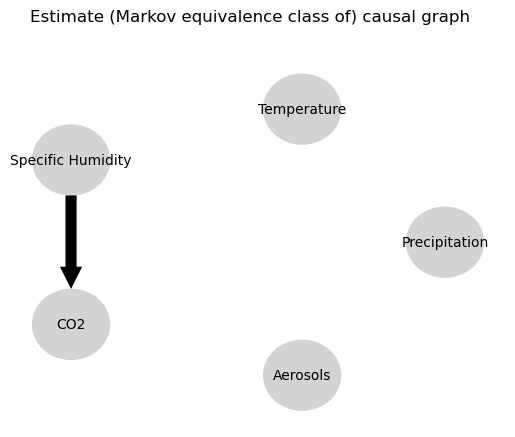

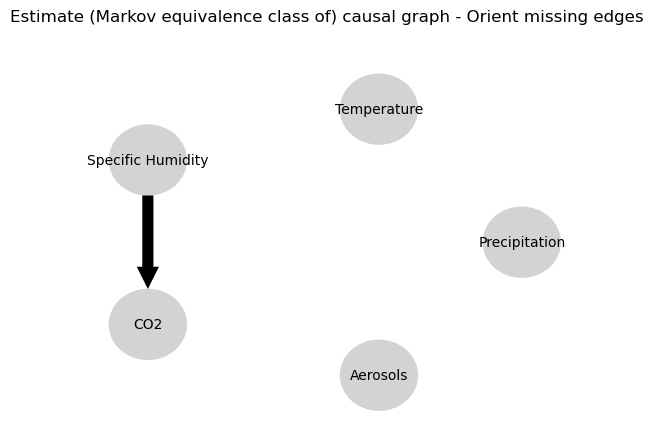

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.03780870541506336
0.5107316875529485
-0.03354175823317355
-0.365618769658228
-0.20872763660460916
0.61891445591088
0.004867380087404293
0.5107316875529485
-0.03958981476729743
0.0
-0.07374398652616843
-0.4701113995073578
-0.29369294565966636
0.38792115429043833
-0.049641535625933576
-0.365618769658228
0.05071224589872005
-0.4701113995073578
0.10853780739023304
0.0
0.4182077052734639
-0.23306599669438813
0.02794209686723299
0.61891445591088
0.0023414899164574112
0.38792115429043833
-0.013447143258097361
-0.23306599669438813
-0.16050590788554747
0.0
-0.0438664419562254


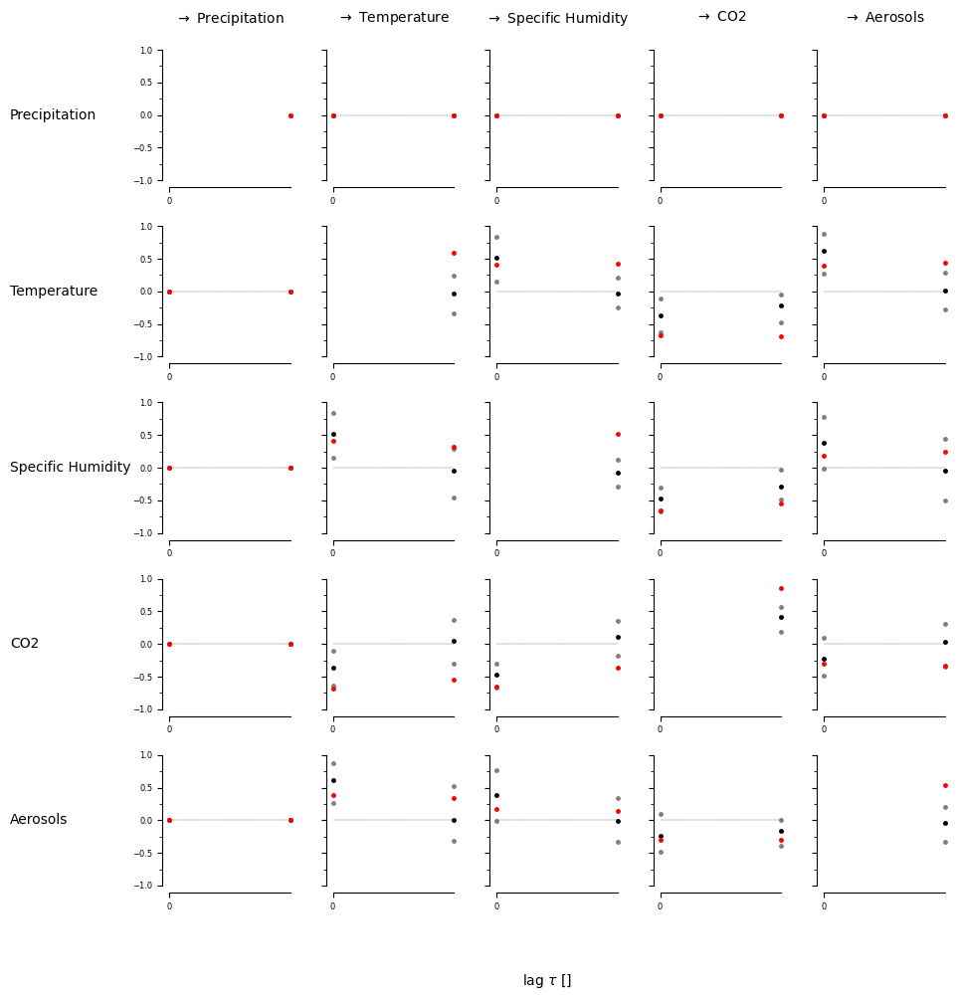

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [ True False]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


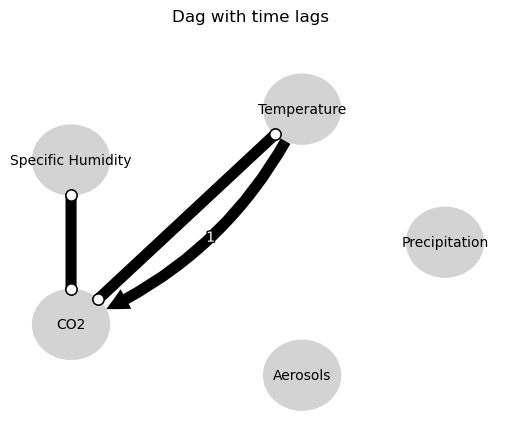

Negative precipitation values in event 146: 0


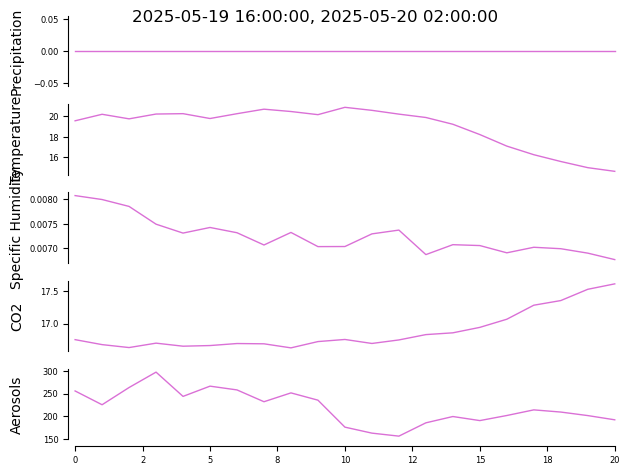


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


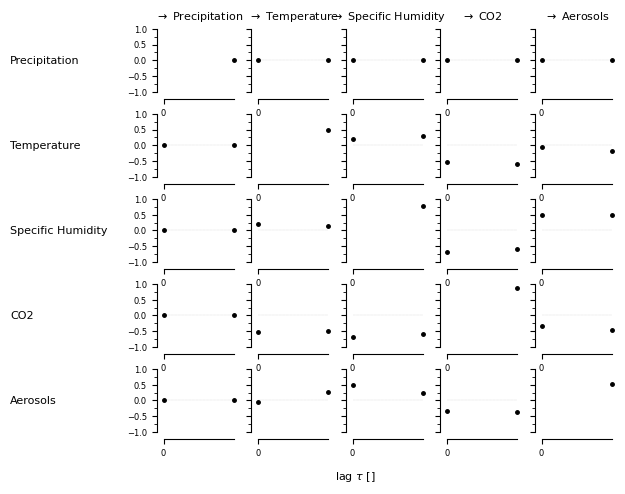

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00198, |min_val| =  0.678



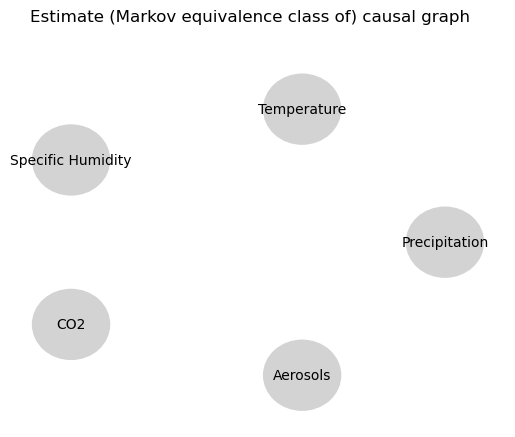

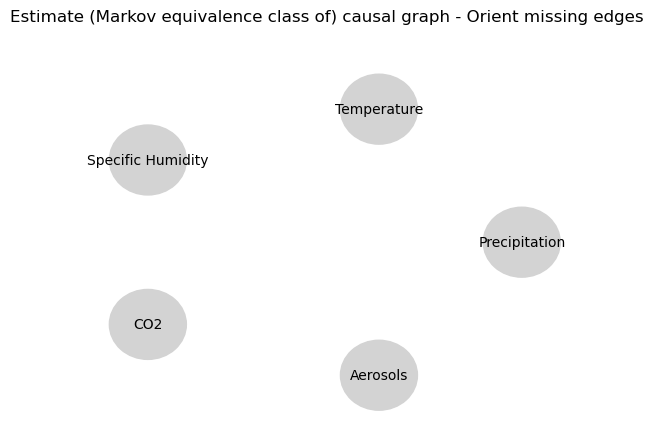

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.02016755433294191
0.459190044900778
-0.0642869377932645
0.06120517633728147
0.0336131628971178
0.2885999455132013
0.021168968257645693
0.459190044900778
-0.02408227438073424
0.0
-0.06608292032576671
-0.026087728353749742
0.03483381670354982
0.4510340316448442
-0.04292445430451967
0.06120517633728147
0.10328300906577383
-0.026087728353749742
0.04961062973896873
0.0
0.856697442645087
0.06699835178229963
0.05957874391544574
0.2885999455132013
0.02819802242556463
0.4510340316448442
0.031105228674511813
0.06699835178229963
0.05135876859013892
0.0
-0.04433762389057107


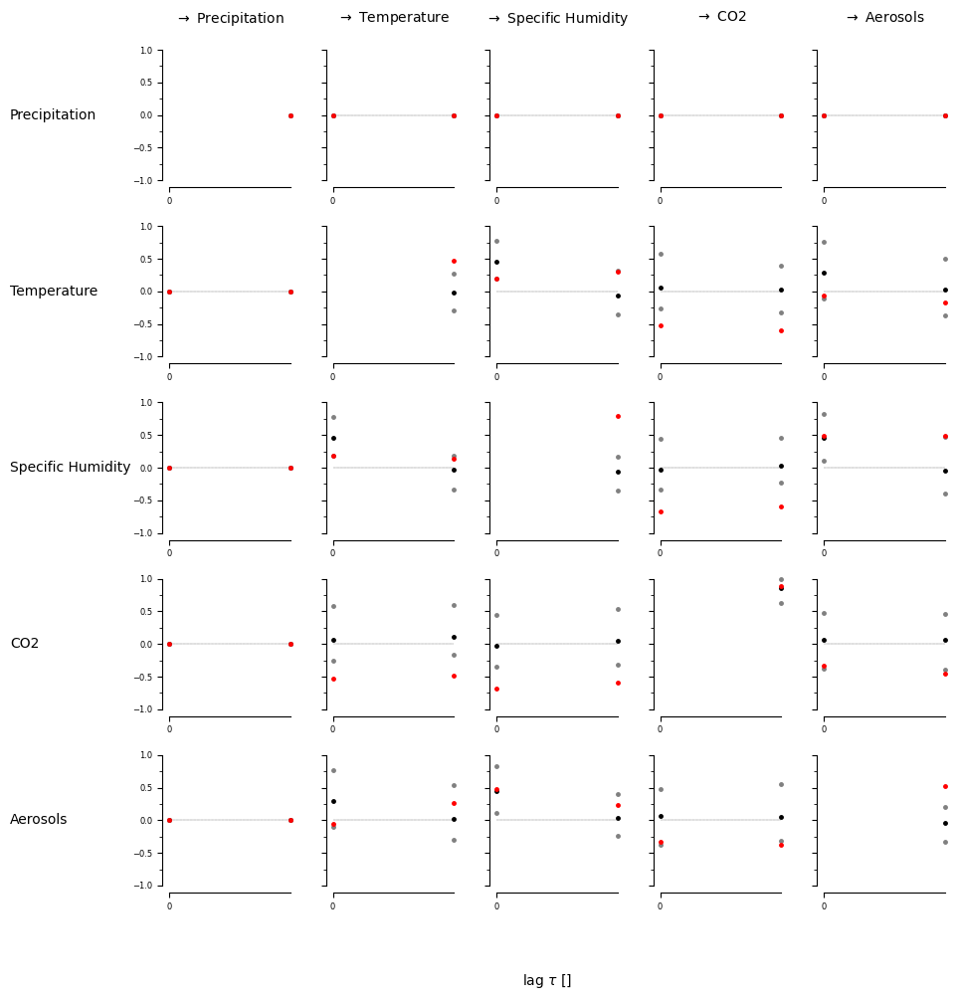

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [ True  True]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


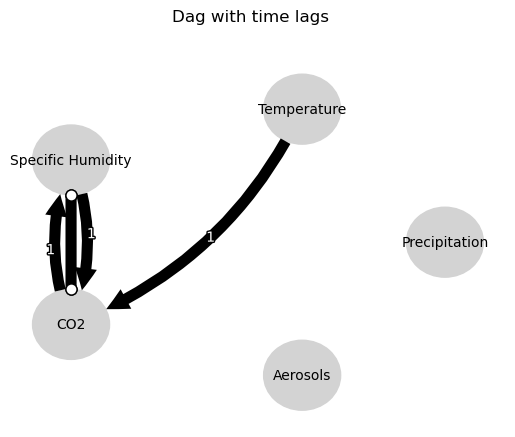

Negative precipitation values in event 147: 0


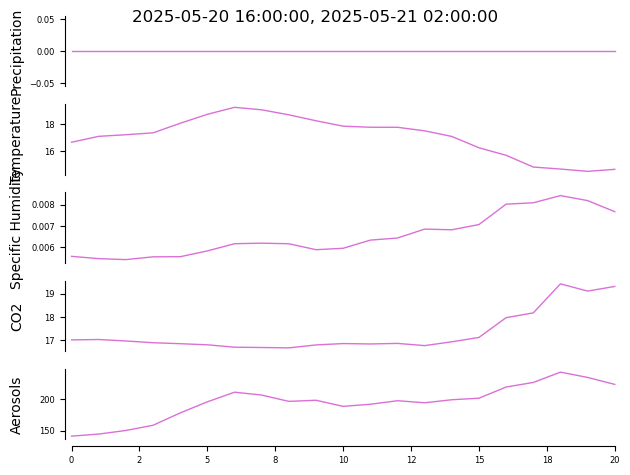


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


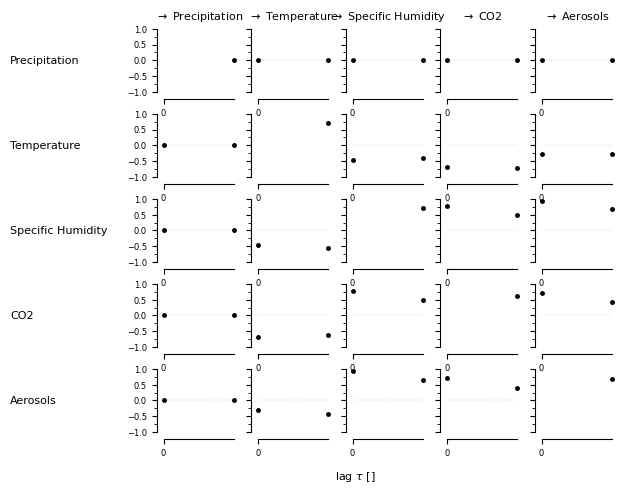

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.04624, |min_val| =  0.475

    Variable Specific Humidity has 0 link(s):

    Va

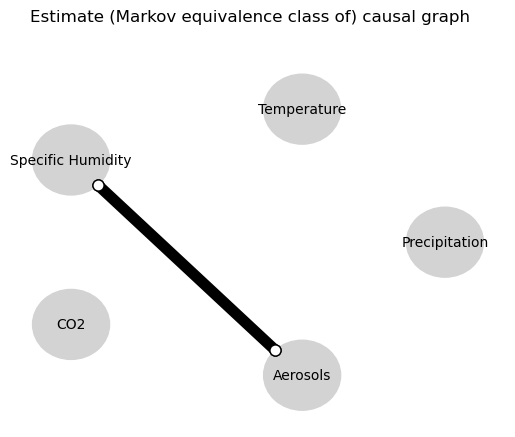

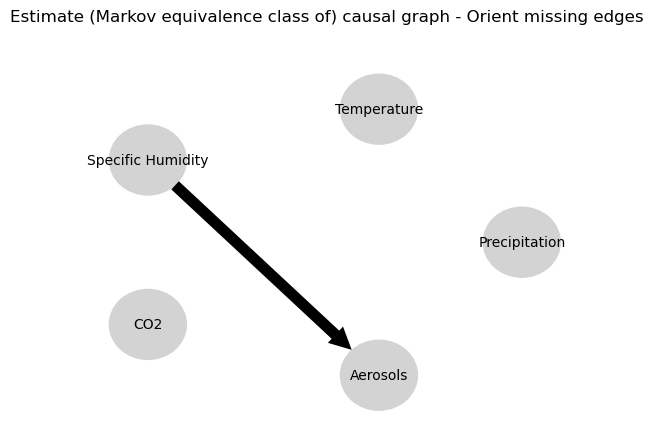

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.5887375558112209
-0.054934669194667864
0.16760086785067316
0.03653848000276718
0.06354726730098398
-0.05384804960288277
0.12661428814768194
-0.054934669194667864
-0.04127156236078012
0.0
-0.0363544572815293
0.7279055792376813
-0.03733062408707336
0.8108534751507881
-0.057262067603496426
0.03653848000276718
0.03724942883163123
0.7279055792376813
0.0032697734717156315
0.0
-0.02790738495177417
0.5722293578373201
-0.03313237774961465
-0.05384804960288277
-0.029841130623814972
0.8108534751507881
-0.009550703504163423
0.5722293578373201
0.002997919509811177
0.0
-0.02938495140783455


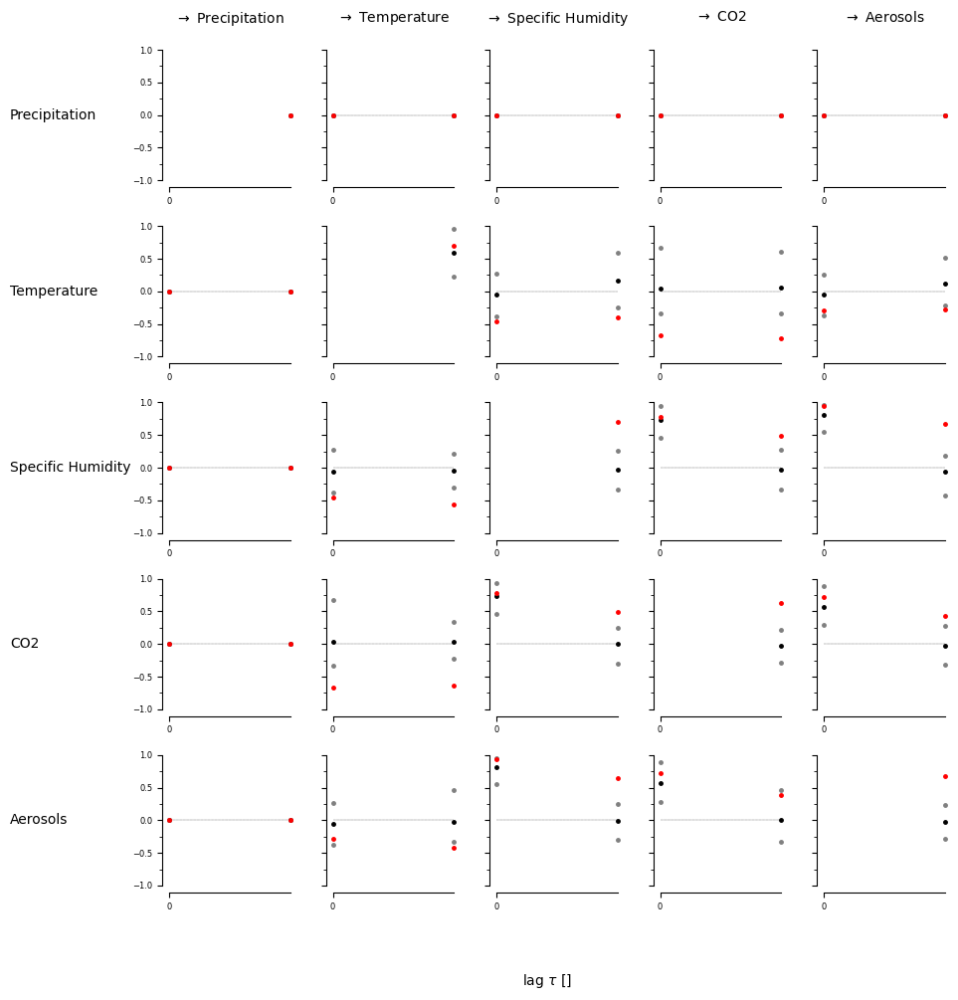

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True False]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True False]
  [False  True]
  [ True False]]

 [[False False]
  [False False]
  [ True  True]
  [ True False]
  [False  True]]]


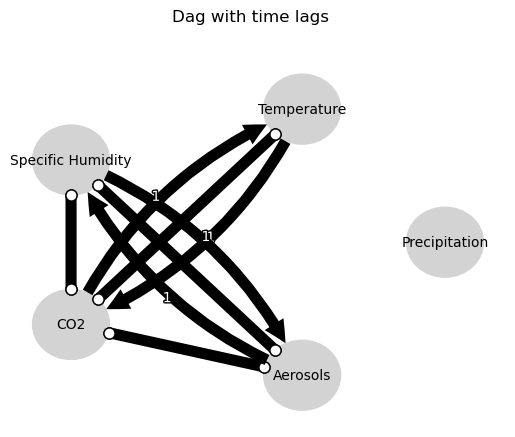

Negative precipitation values in event 148: 0


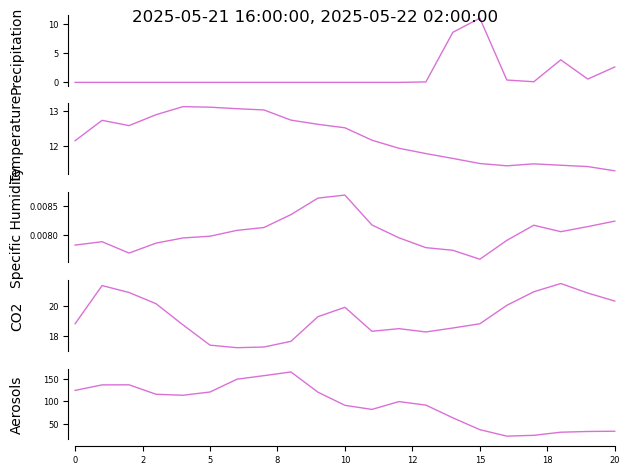


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


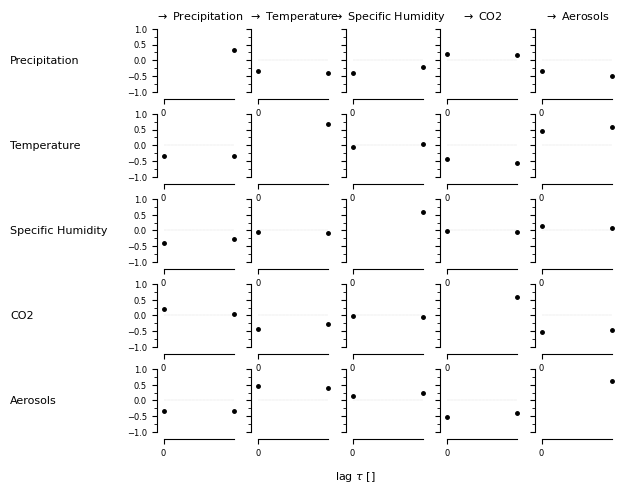

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00181, |min_val| =  0.667

    Variable Specific Humidity has 1 link(s):
       

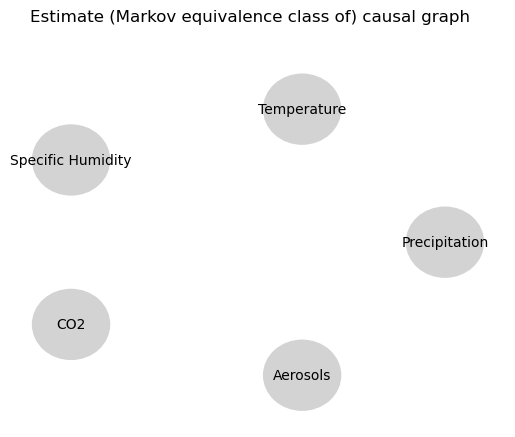

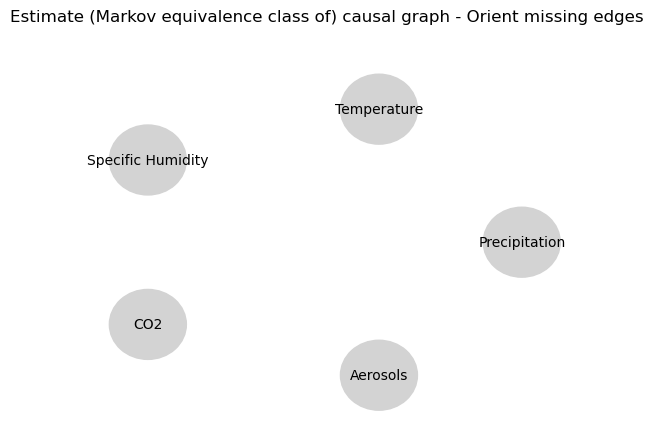

0.0
-0.08186739578078449
-0.12990284689186618
-0.10663690463842898
-0.2518089897868393
-0.1544386428080484
0.01641432720020506
-0.08891031230813727
-0.12087516102953841
-0.12851699589332918
-0.12990284689186618
-0.015123188412175416
0.0
0.5779010351391064
0.14864681717057385
0.09409370008214349
0.24721357653008053
0.09304405519699784
0.17904214794592244
0.18078931688561445
0.14864681717057385
0.05613014002043315
0.0
0.4070828982563538
0.26280466700011135
0.09561752548079878
-0.07980489179381085
-0.0487305931768413
0.24721357653008053
0.19787075722150596
0.26280466700011135
0.19120288623033413
0.0
0.36934727353606206
-0.09033114024534275
-0.10075806762272628
0.17904214794592244
0.1719087726194884
-0.07980489179381085
0.023675164099218785
-0.09033114024534275
-0.031068987402226477
0.0
0.525827370834926


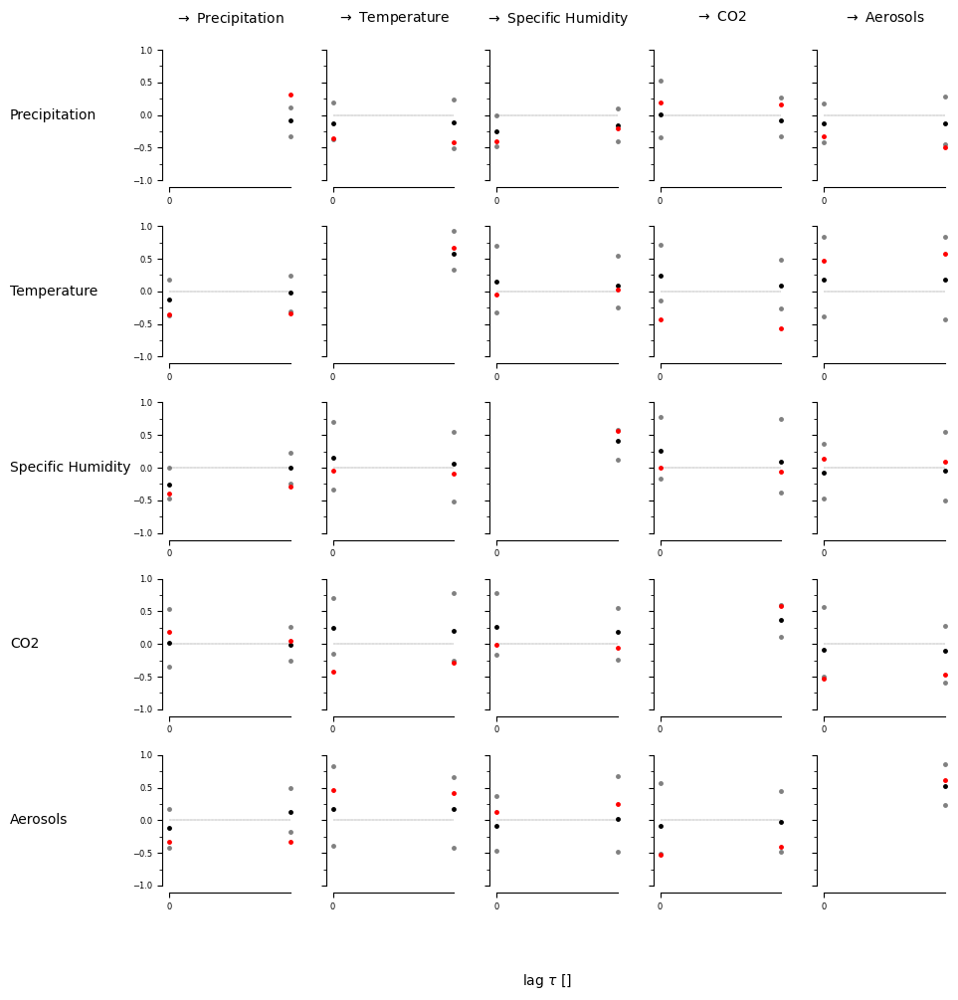

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False  True]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


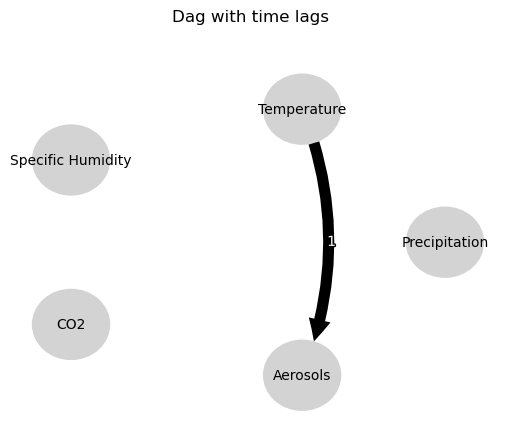

Negative precipitation values in event 149: 0


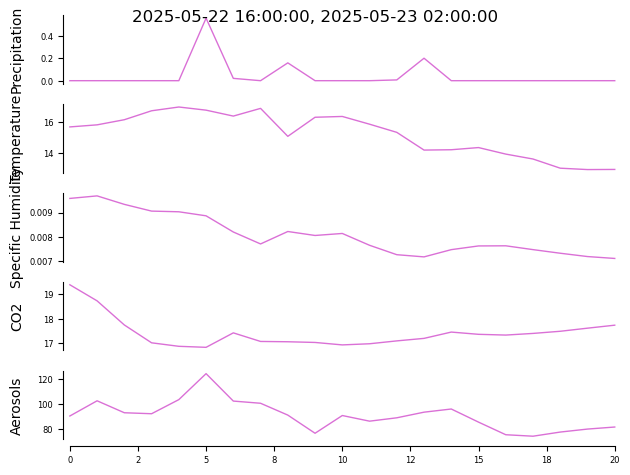


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


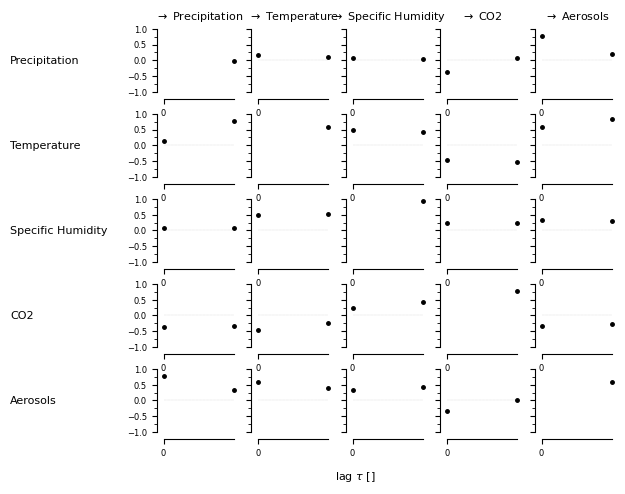

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Temperature -1): max_pval = 0.00007, |min_val| =  0.786

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.04252, |min_val

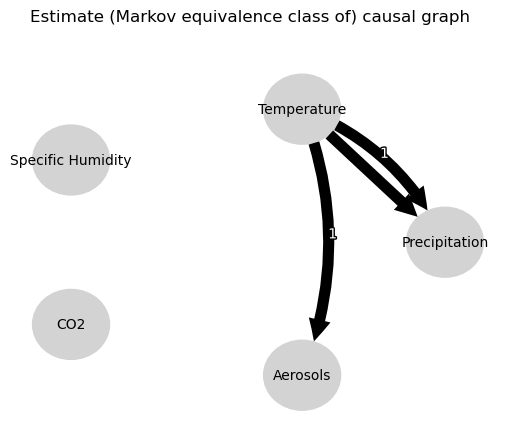

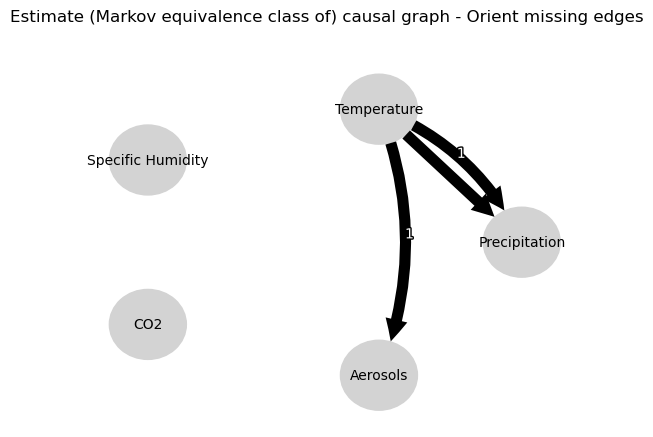

0.0
-0.2671604467285673
-0.32815819606167707
-0.0007907110566245897
-0.00916328262792427
0.009338944651276616
0.026115770664925254
0.053568934024734144
0.6245801589292216
-0.2714542859892584
-0.32815819606167707
0.6158948818463745
0.0
-0.03565236822049906
-0.06545651611394913
-0.01696053693520685
-0.41480821709985316
-0.21921042057718207
0.039975154244040224
0.6057406100467965
-0.06545651611394913
-0.010992069611117952
0.0
0.5050475268322488
-0.08517447717328544
-0.09068447744403257
-0.025464892933780164
-0.045880114235465126
-0.41480821709985316
0.0974082191260408
-0.08517447717328544
-0.015089253651832883
0.0
0.3219953495888358
-0.006087211246819658
-0.2743834836155861
0.039975154244040224
-0.024771500477087902
-0.025464892933780164
-0.0016821342289627542
-0.006087211246819658
0.036938088104556455
0.0
-0.007299158434063564


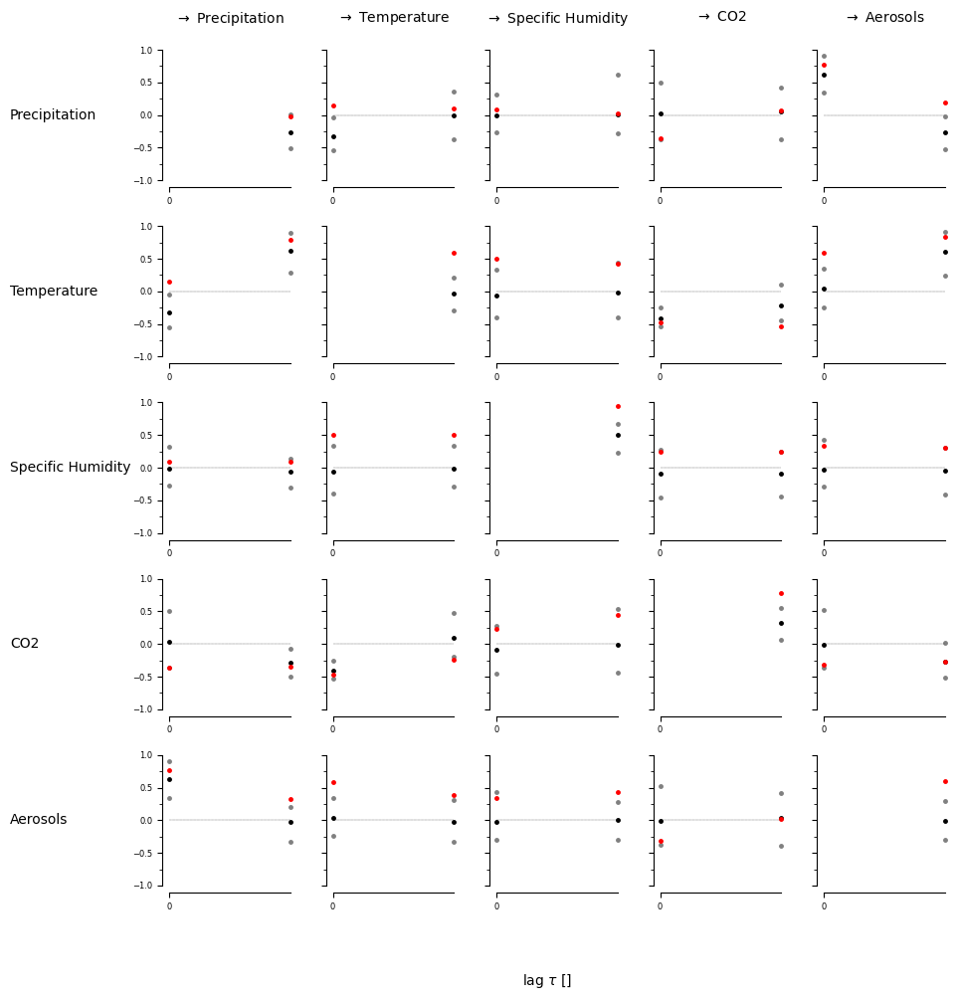

[[[False False]
  [False False]
  [False False]
  [False False]
  [ True False]]

 [[False  True]
  [False  True]
  [False False]
  [False False]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[ True False]
  [ True False]
  [False False]
  [False False]
  [False  True]]]


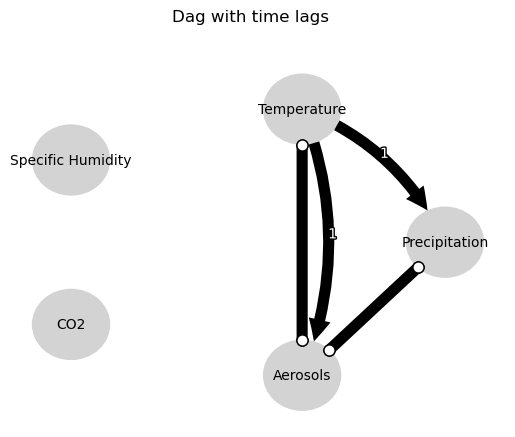

Negative precipitation values in event 150: 0


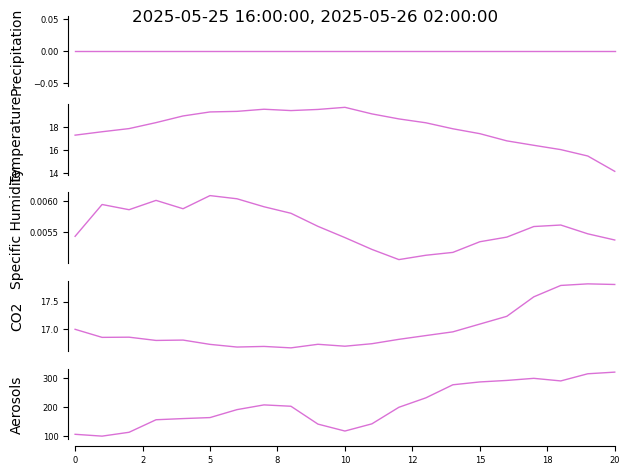


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


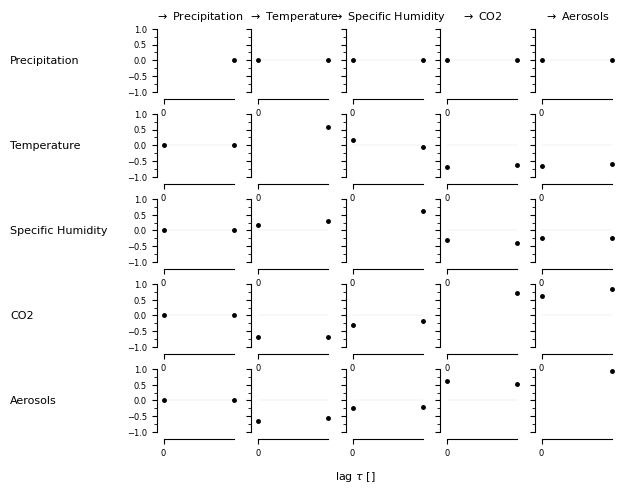

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (CO2 -1): max_pval = 0.04281, |min_val| =  0.482

    Variable Specific Humidity has 1 link(s):
        (Specif

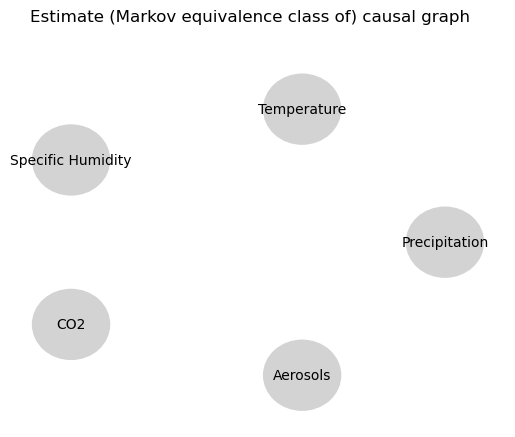

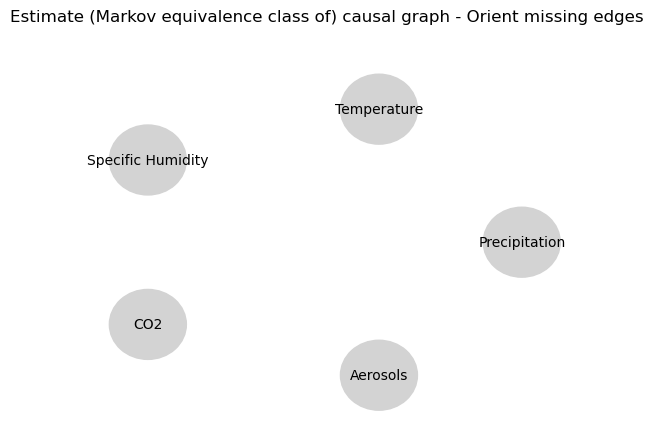

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.03054954040466538
0.23347587530096758
0.03527622662143677
-0.7558641107817323
0.0510134902462071
-0.11047948996070081
-0.04500844132758066
0.23347587530096758
0.042651246290861734
0.0
0.00041025546963648584
-0.2502646792729398
0.02877333501610354
-0.07232784055660434
-0.10968499809717745
-0.7558641107817323
0.07344145624220005
-0.2502646792729398
-0.016738445767022676
0.0
-0.1159731150477525
0.10926567830340508
0.03139064906167989
-0.11047948996070081
0.04199898262934674
-0.07232784055660434
0.11396014714960347
0.10926567830340508
0.028561399607452378
0.0
0.528413899135418


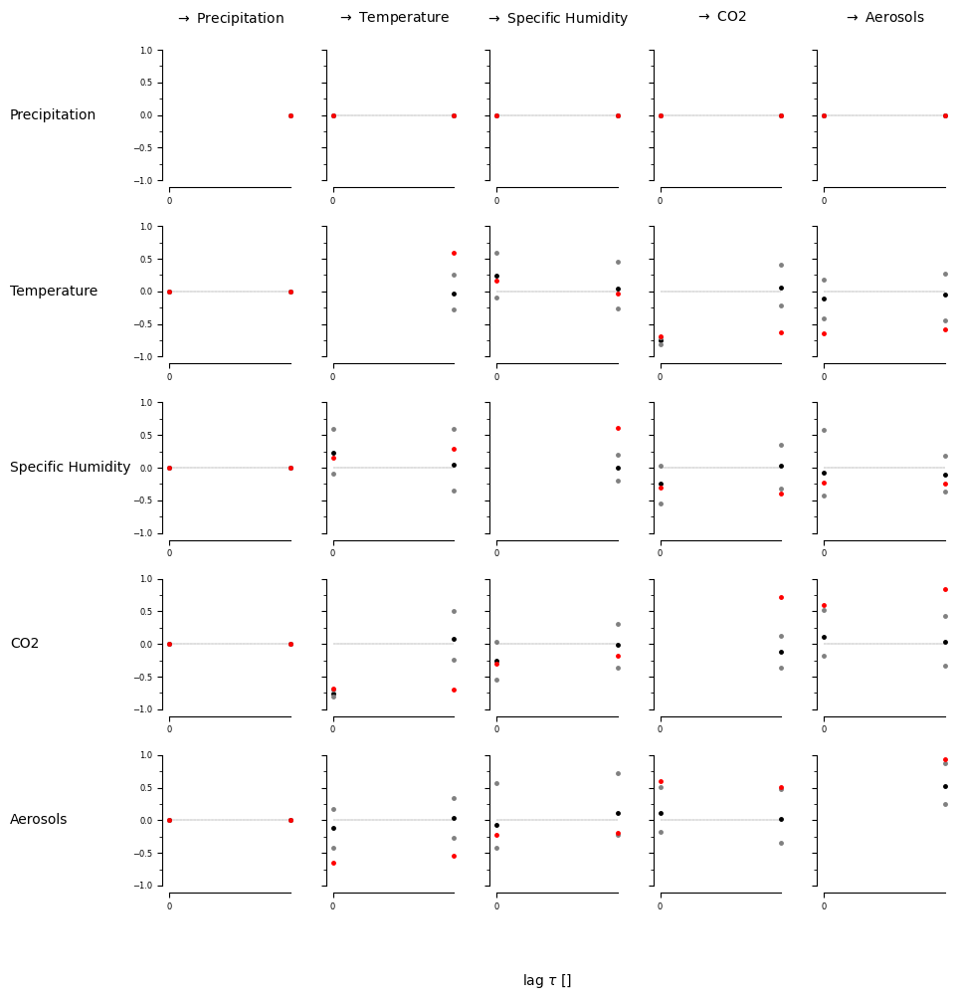

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True False]
  [False False]
  [ True False]
  [False  True]]]


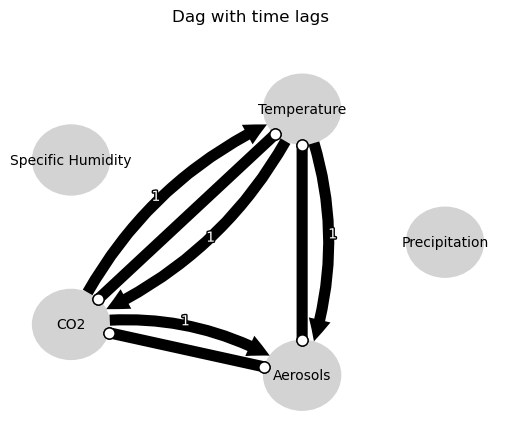

Negative precipitation values in event 151: 0


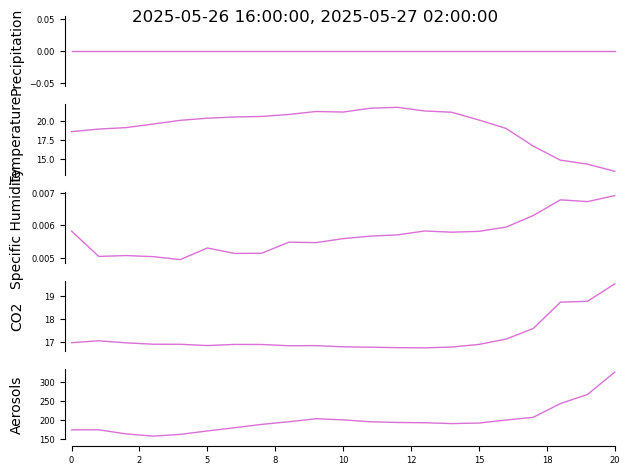


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


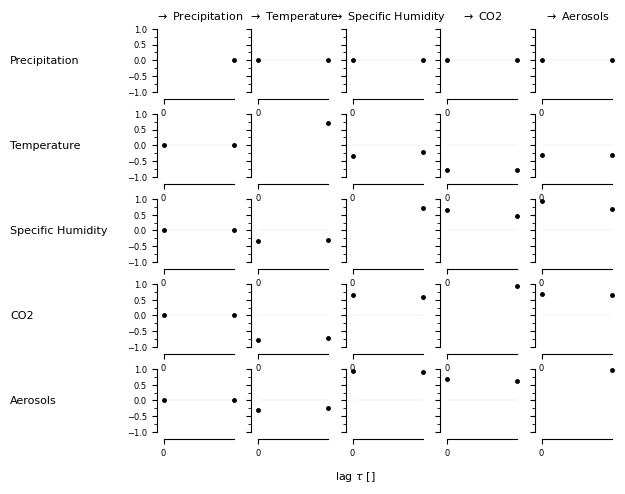

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Aerosols -1): max_pval = 0.00001, |min_val| =  0.838

    Varia

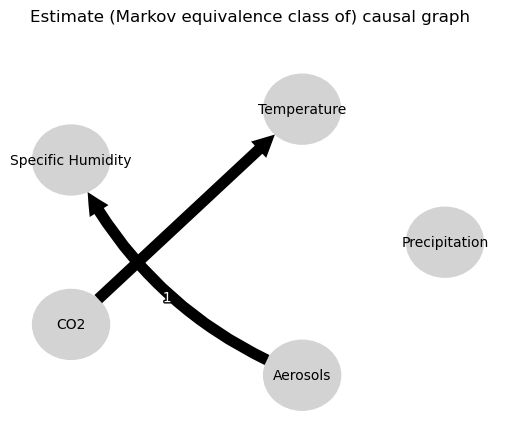

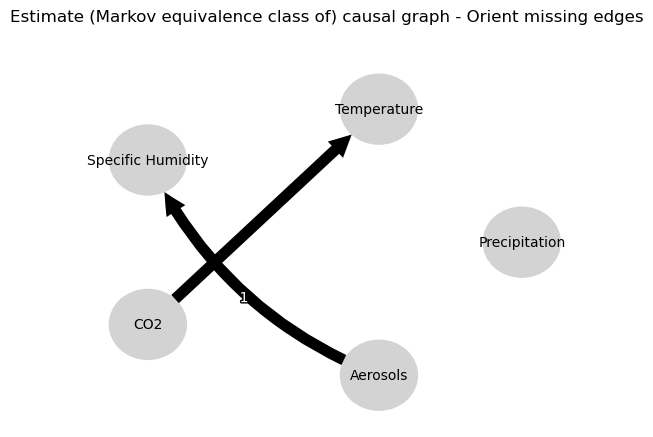

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.9086067806947724
-0.08783979020667552
-0.07858970023767624
-0.8030722544055329
-0.7796875853070825
-0.08586890738380525
-0.07985876964027681
-0.08783979020667552
-0.09250665138313882
0.0
0.9274324344319832
0.22422101421922794
0.21253468351226507
0.9571072697870555
0.9520511069917738
-0.8030722544055329
-0.7831537665225728
0.22422101421922794
0.19911049675146983
0.0
0.936737074933996
0.21884071348985265
0.21250785704963543
-0.08586890738380525
-0.09606021185746338
0.9571072697870555
0.9289851375867119
0.21884071348985265
0.21515480509752952
0.0
0.9350107488778011


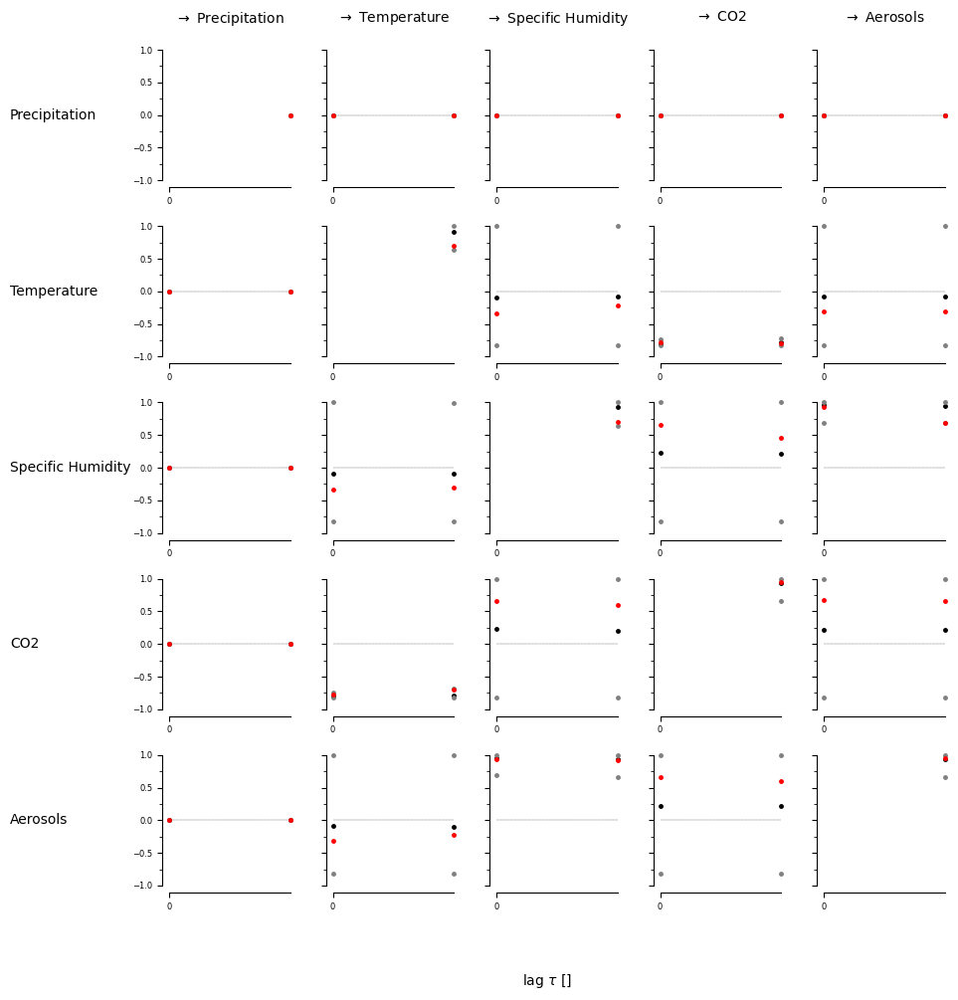

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True False]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [ True  True]
  [ True  True]
  [False  True]]]


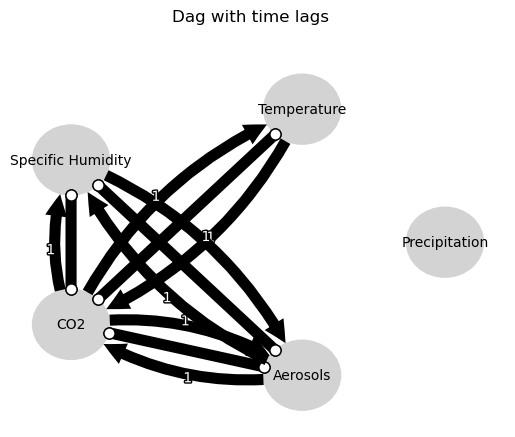

Negative precipitation values in event 152: 0


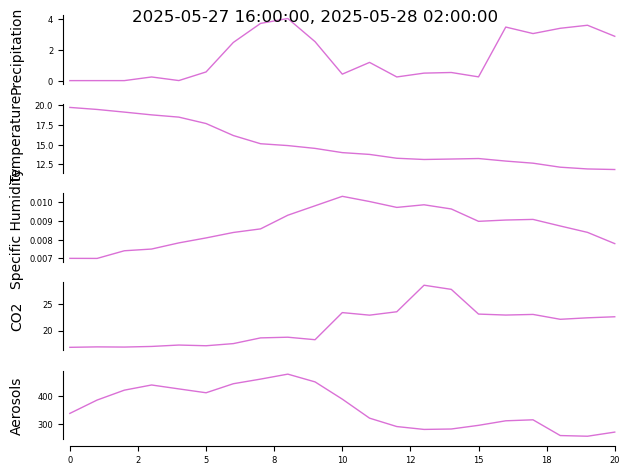


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


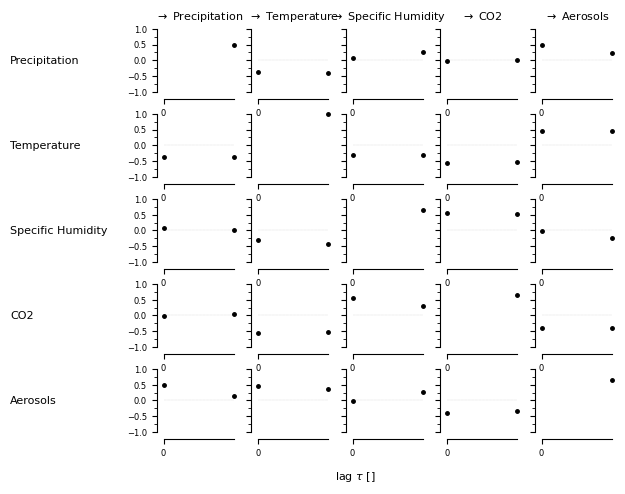

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.03709, |min_val| =  0.481

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00000, |min_v

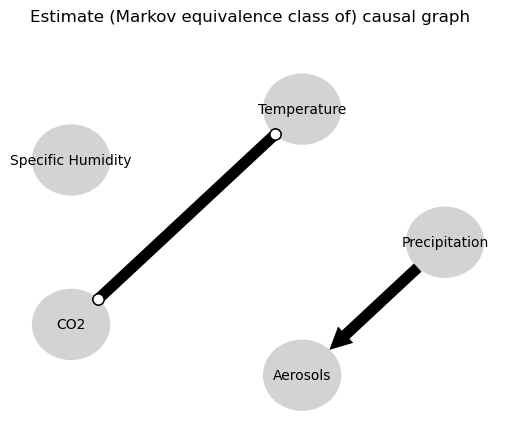

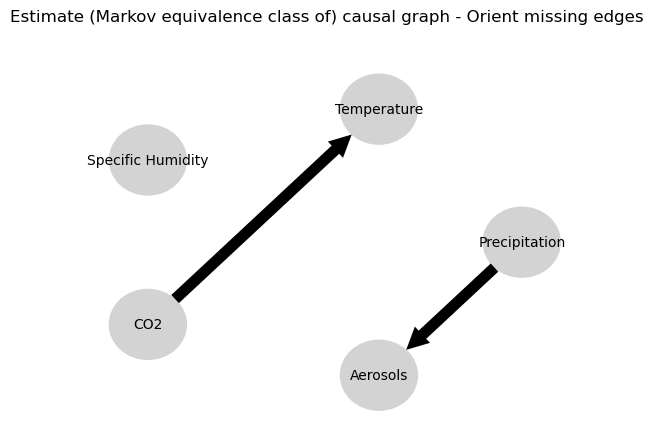

0.0
-0.08152047884710555
-0.07560387487174988
-0.07995113134217754
0.06445552305476712
0.044950095991964895
0.00750212799575659
0.007082146416534698
0.09665111601389632
0.02083556007503398
-0.07560387487174988
0.05164480166385885
0.0
0.5515179120857918
-0.19710799127806272
-0.08236962392663719
0.14058139344184842
-0.17203060758985542
-0.15925741007879549
-0.09921570193243544
-0.19710799127806272
-0.19744109749952063
0.0
0.5137593938071068
-0.14896412794553665
0.03526962688141637
-0.001404588654425983
-0.028913914549315075
0.14058139344184842
0.15716437258398194
-0.14896412794553665
-0.03489895913473427
0.0
-0.02241514367196414
-0.22872977852592372
-0.15160581926745434
-0.15925741007879549
-0.14490983086502687
-0.001404588654425983
-0.04332081645726057
-0.22872977852592372
0.07527900511746602
0.0
0.5306942760657803


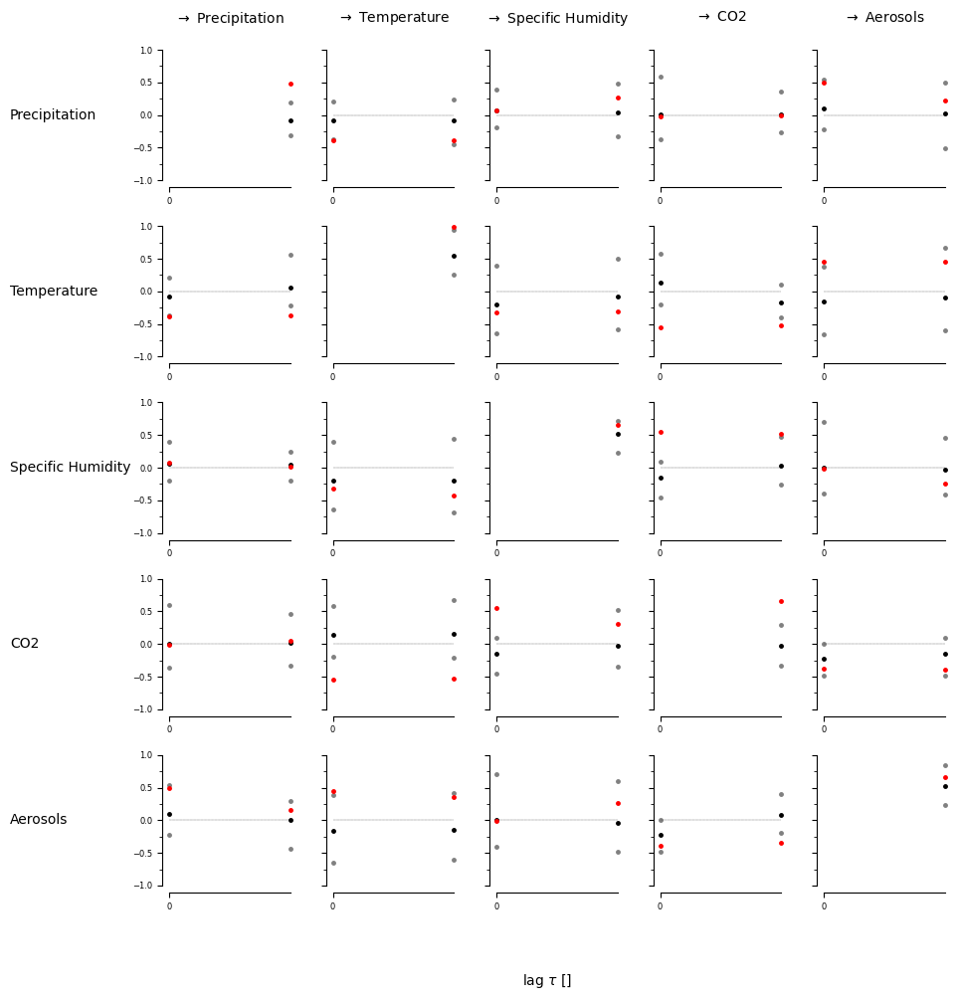

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


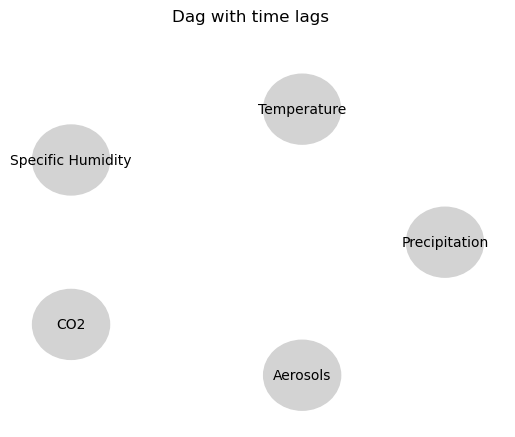

Negative precipitation values in event 153: 0


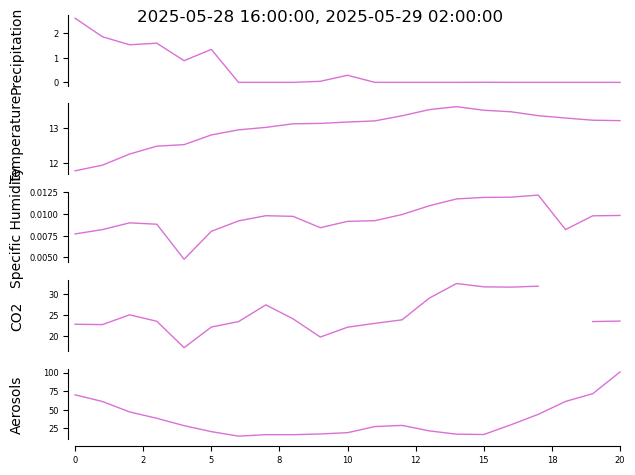


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


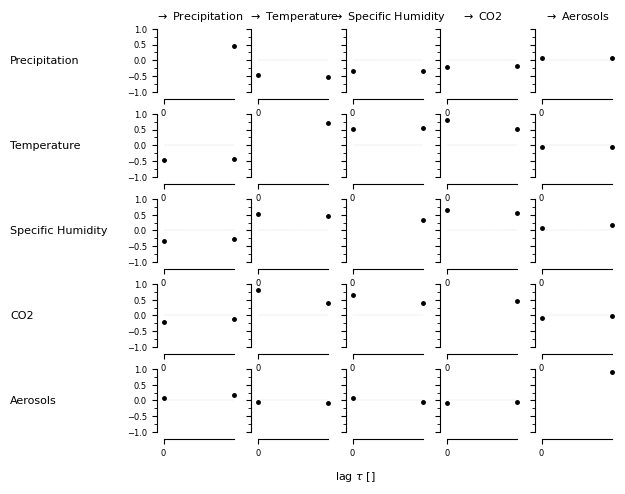

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.04876, |min_val| =  0.458

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00868, |min_v

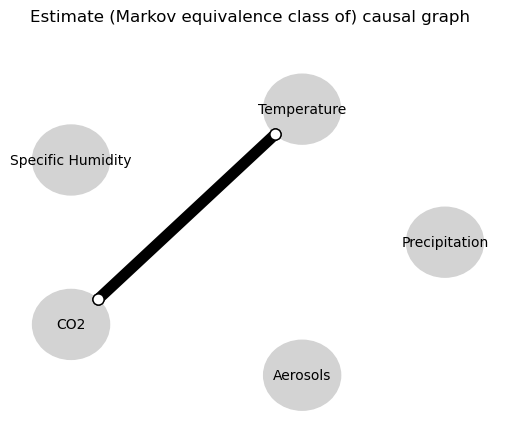

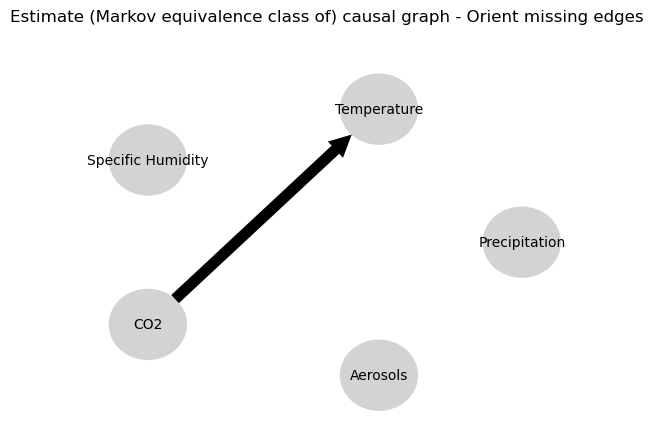

0.0
-0.07796379925069905
-0.6973713444344912
0.09835015322894379
-0.3996426473396007
-0.024265887616745307
-0.2671075369588317
0.016669940310038902
-0.08661020354392629
-0.08676004736392909
-0.6973713444344912
0.07034081942328498
0.0
-0.06232196401771812
0.5660413357181312
0.03356360208854627
0.46529190336921505
-0.00806344404620964
0.04624697058714097
0.030883072400048138
0.5660413357181312
-0.06570060888168366
0.0
-0.04219664617732228
0.8494074994120726
-0.05727678462418209
0.017336662777084108
0.015267511737720178
0.46529190336921505
-0.0831131574331991
0.8494074994120726
-0.0459090875104334
0.0
-0.048951222106454965
-0.03229818217583698
-0.007133844618436613
0.04624697058714097
-0.24035897432915795
0.017336662777084108
-0.14398672230218912
-0.03229818217583698
-0.10746630755937853
0.0
0.6561078677489794


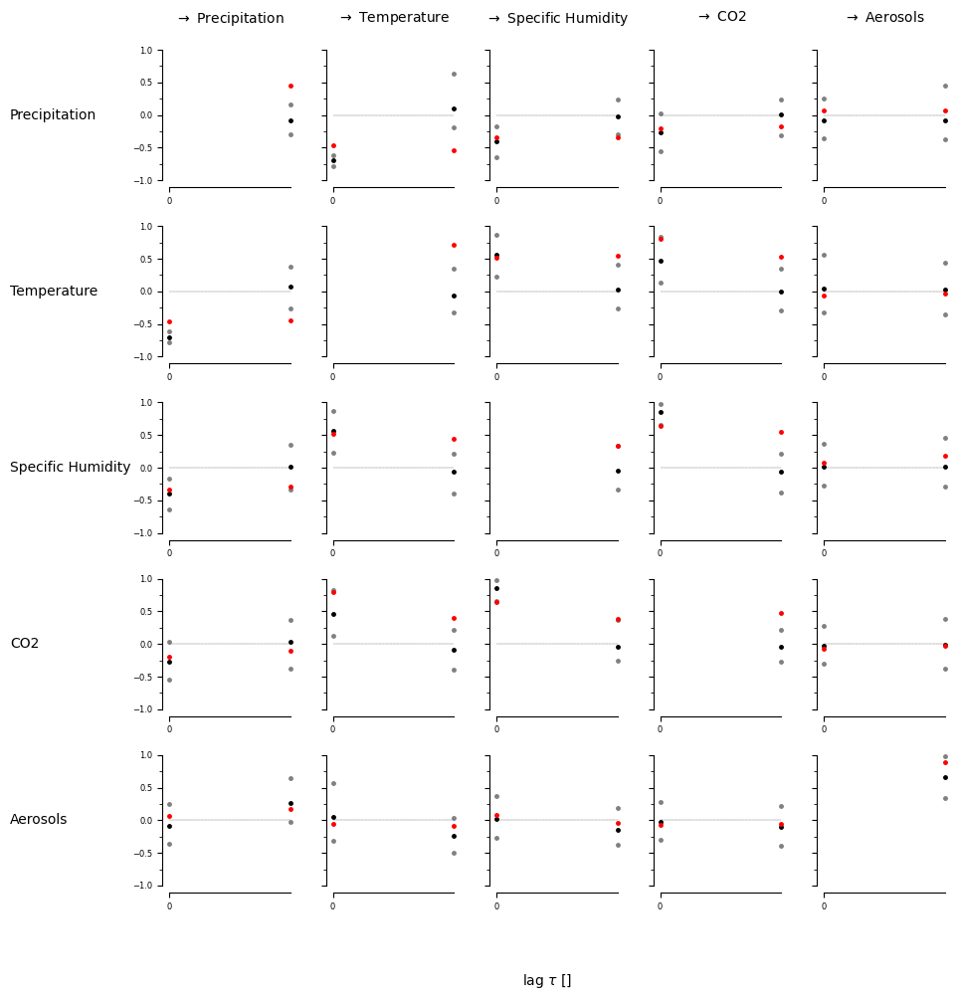

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True False]
  [False False]]

 [[False False]
  [ True False]
  [ True False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


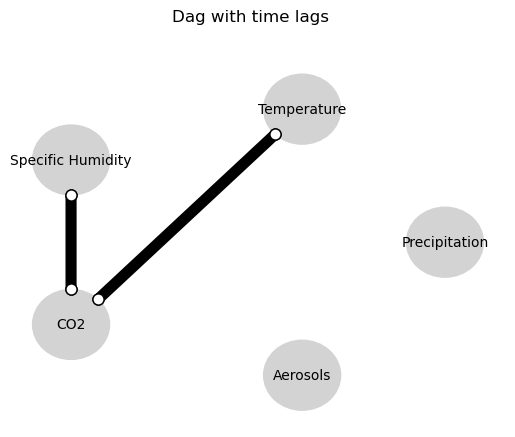

Negative precipitation values in event 154: 0


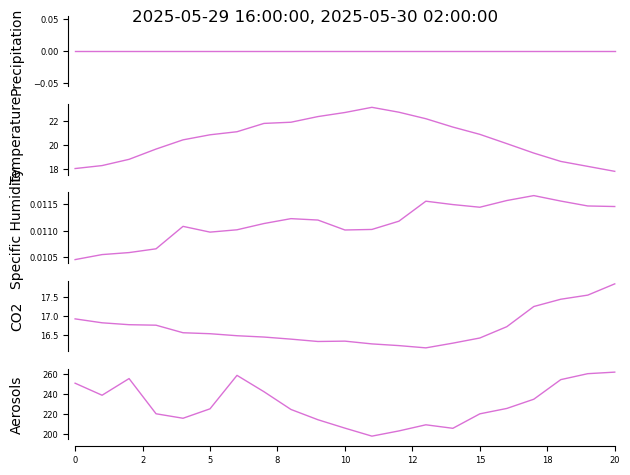


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


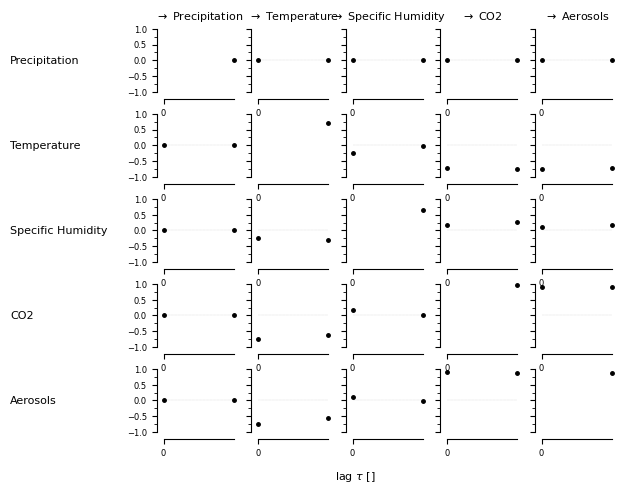

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00260, |min_val| =  0.650



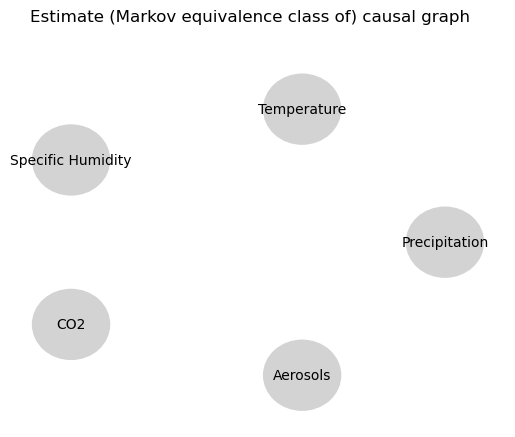

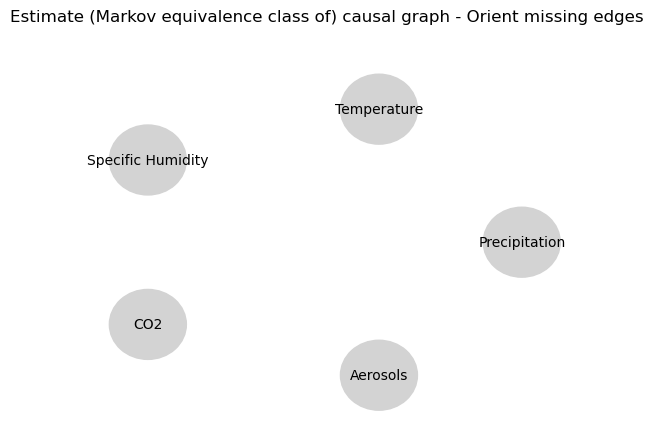

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.05368359679980614
0.031262621881411386
0.016696739281109912
0.021738865009753156
-0.0352088358062905
-0.5936468694746718
0.029504267023140917
0.031262621881411386
-0.035755664187599796
0.0
0.44962876367034477
0.038791582034205144
0.031835768495476084
-0.0818411269328574
0.06567155713878123
0.021738865009753156
0.0394101802299741
0.038791582034205144
0.02222952473390773
0.0
0.8144762247156837
-0.04642999843201763
-0.05747079960324385
-0.5936468694746718
0.020042531536908475
-0.0818411269328574
-0.030560908602543888
-0.04642999843201763
-0.025891902113920322
0.0
-0.045275220151085545


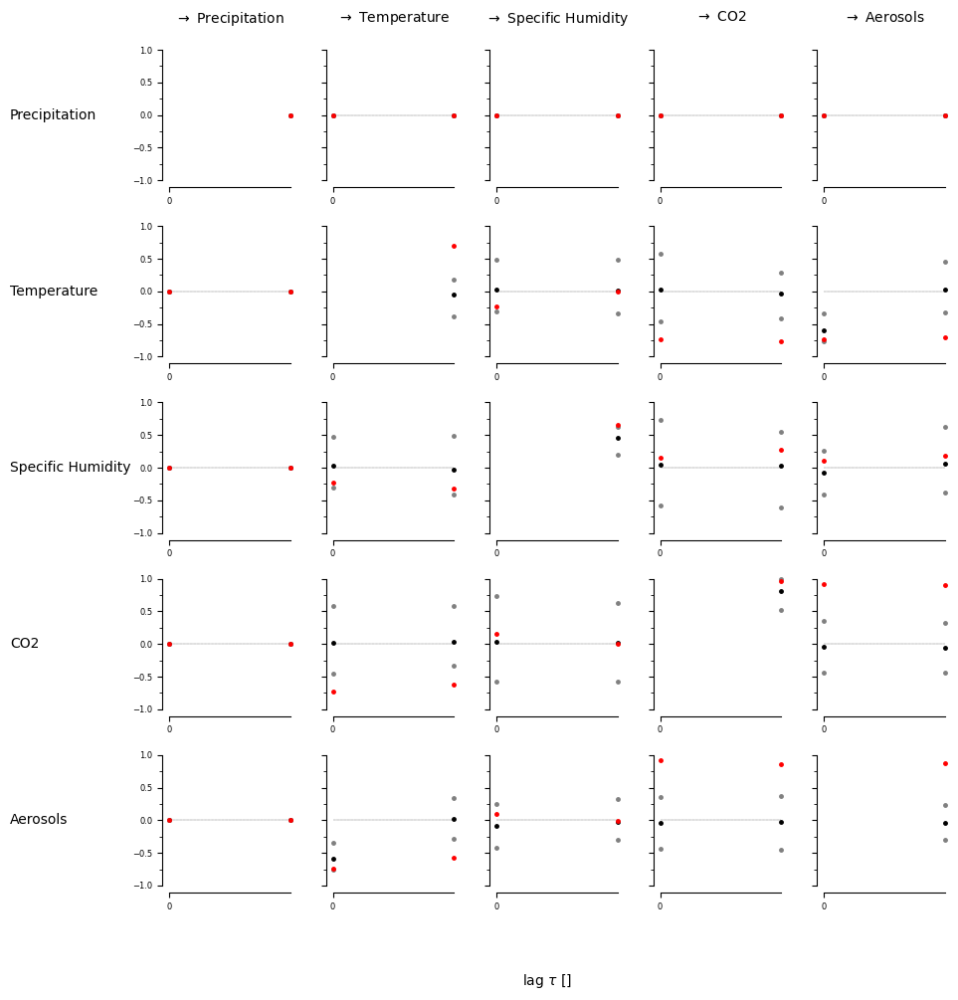

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True False]
  [False False]
  [ True  True]
  [False  True]]]


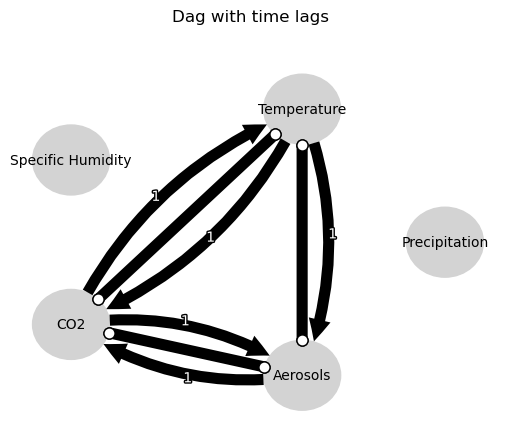

Negative precipitation values in event 155: 0


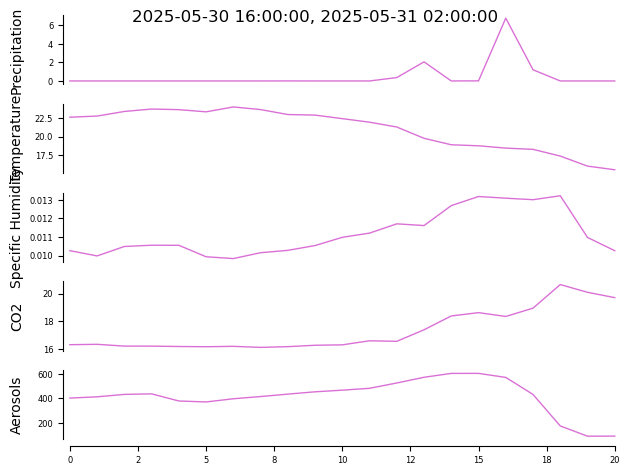


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


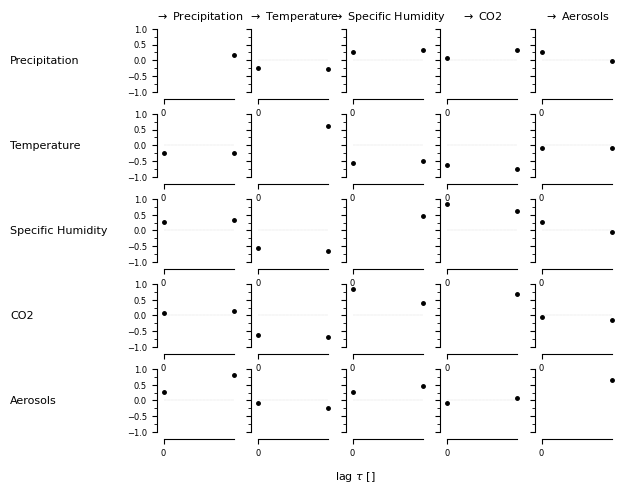

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Aerosols -1): max_pval = 0.00002, |min_val| =  0.822

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Varia

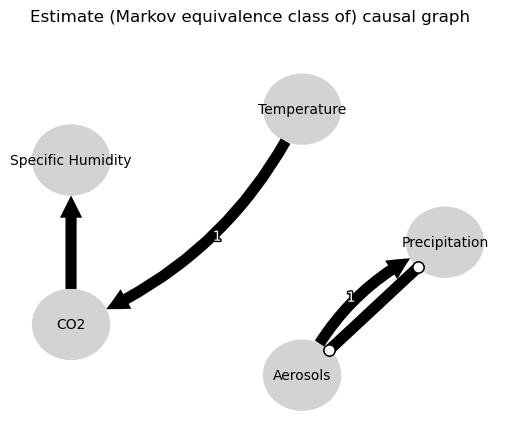

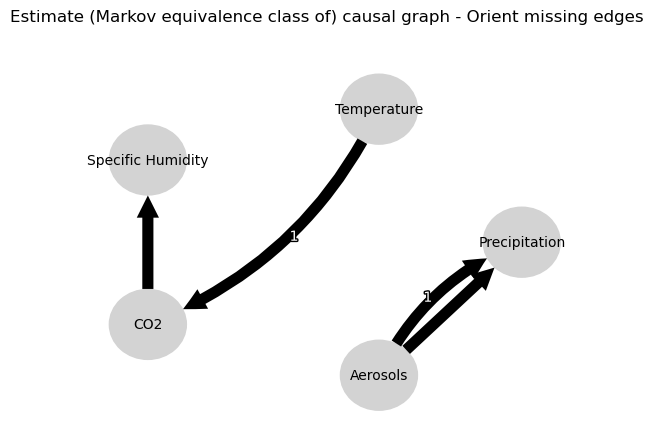

0.0
0.081308386740357
-0.31514190699952677
1.0027059073658417e-06
-0.04353657917510291
0.23058958262012874
-0.07629688592429924
0.35971002419692
0.22955229652814027
0.2132019457724548
-0.31514190699952677
0.0877114230806718
0.0
-0.08996241921373922
0.059381249294642245
-0.5486826609217132
0.02702774661697651
-0.7740899635645633
0.20163302861700566
0.1187101565860544
0.059381249294642245
0.03294144571178366
0.0
-0.029797160884669372
0.6376238979666028
-0.076163229909882
-0.12532802058605674
-0.06488116555759639
0.02702774661697651
0.020445838602123338
0.6376238979666028
0.06244190485511998
0.0
-0.059305092723013667
-0.17138569758991404
-0.11723780547747777
0.20163302861700566
-0.12740159056432182
-0.12532802058605674
-0.08597084204326183
-0.17138569758991404
-0.1257821942533731
0.0
0.5591963813961859


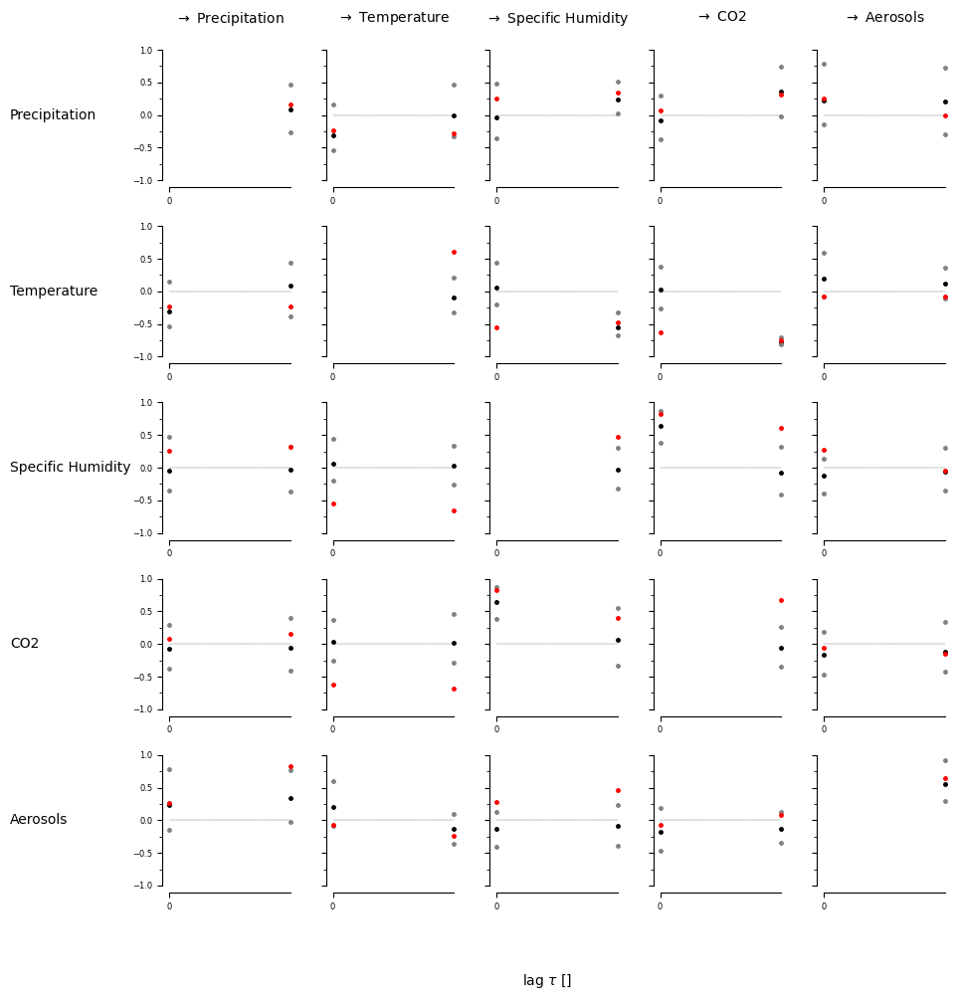

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [ True  True]
  [ True False]
  [False  True]
  [False False]]

 [[False  True]
  [False False]
  [False False]
  [False False]
  [False  True]]]


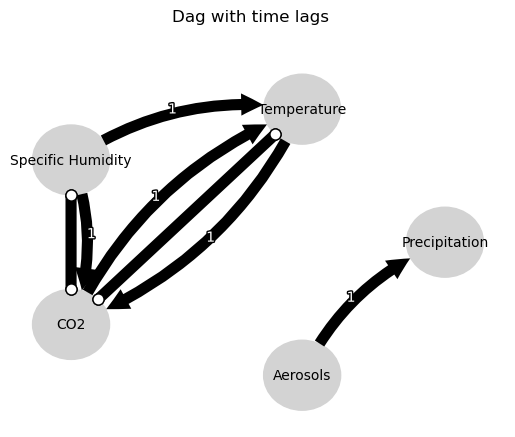

Negative precipitation values in event 156: 0


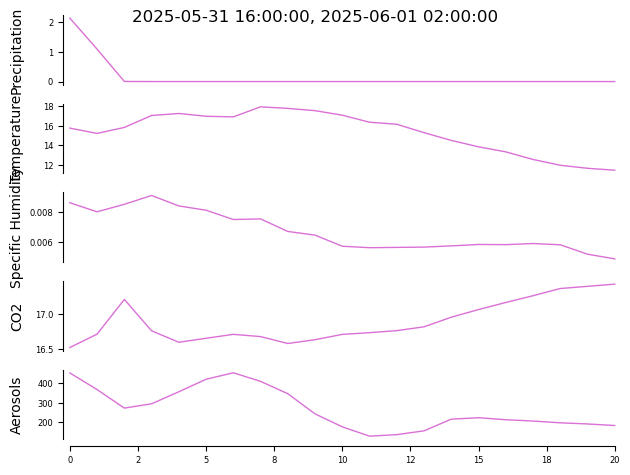


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


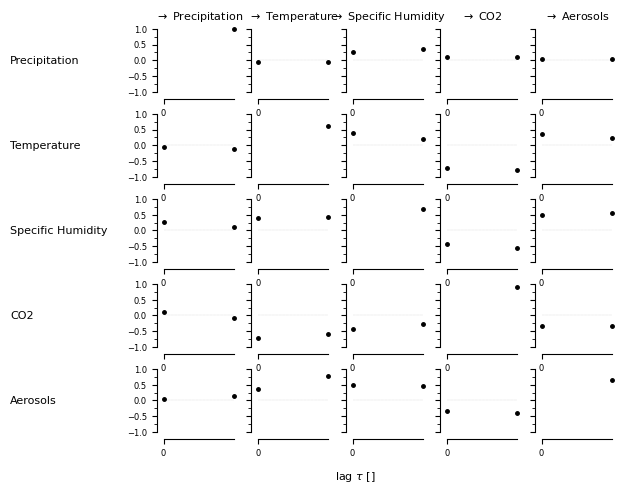

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 1 link(s):
        (Precipitation -1): max_pval = 0.00000, |min_val| =  0.993

    Variable Temperature has 1 link(s):
        (Aerosols -1): max_pval = 0.00018, |min_val|

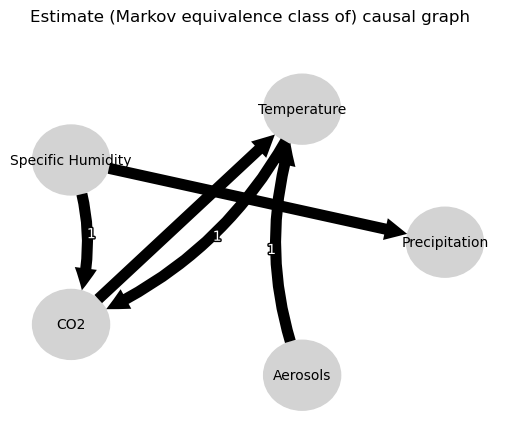

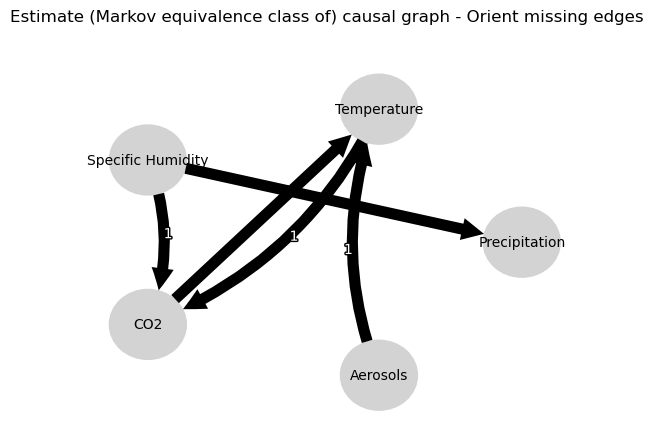

0.0
0.26360292824698245
-0.21619159621106118
-0.1840064990929328
-0.35112149689443906
-0.27463837644328315
-0.20517118417883592
0.34563123124698336
0.1652052897847674
0.12872323328535093
-0.21619159621106118
-0.08199522623351349
0.0
0.5937059222709259
0.42767158211814305
0.29124302688327613
-0.4853147031740585
-0.6472931392878876
0.07306368800764955
-0.03343059959874315
0.42767158211814305
0.3851074612640553
0.0
0.5254225118226222
-0.24273181809428568
-0.45331679138089814
0.0072653590373699265
-0.04510451535185112
-0.4853147031740585
-0.32082152626483196
-0.24273181809428568
-0.19207212906275642
0.0
0.3067980844485619
-0.03604209419766564
0.052263225618424586
0.07306368800764955
0.21715111079989718
0.0072653590373699265
-0.049986357827089684
-0.03604209419766564
-0.0023222801621006306
0.0
0.49388810256149784


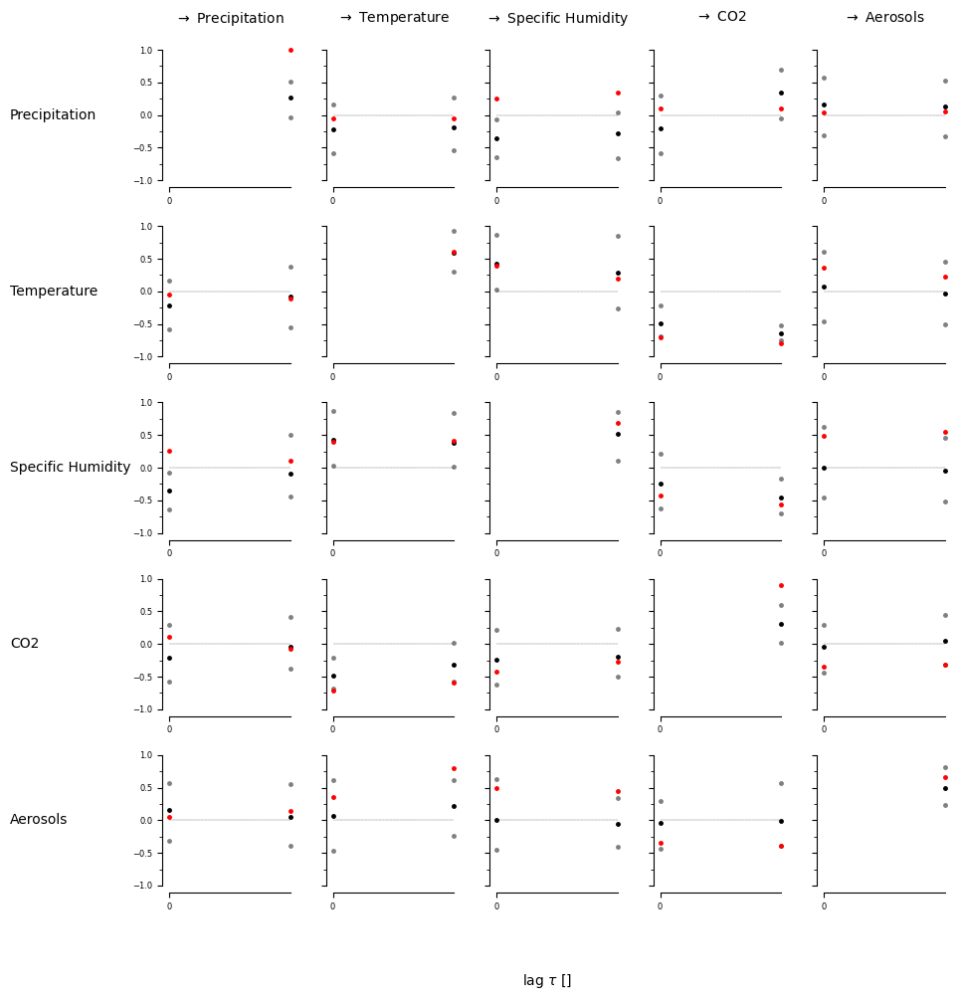

[[[False  True]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [False False]
  [False  True]]]


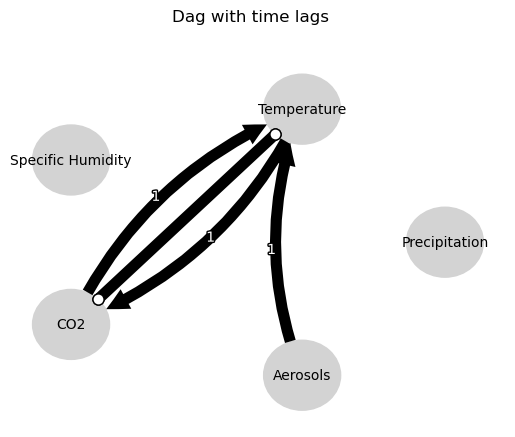

Negative precipitation values in event 157: 0


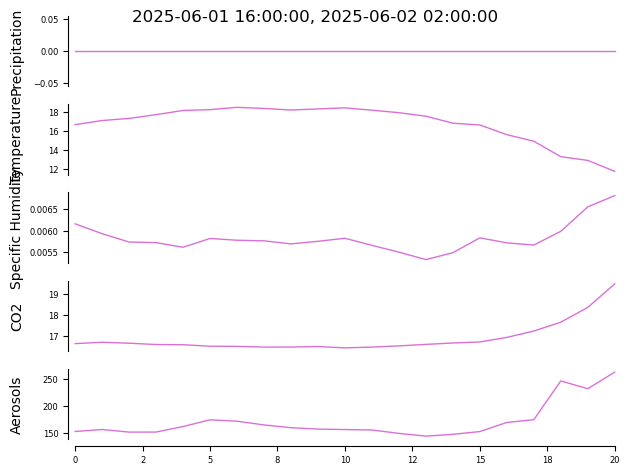


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


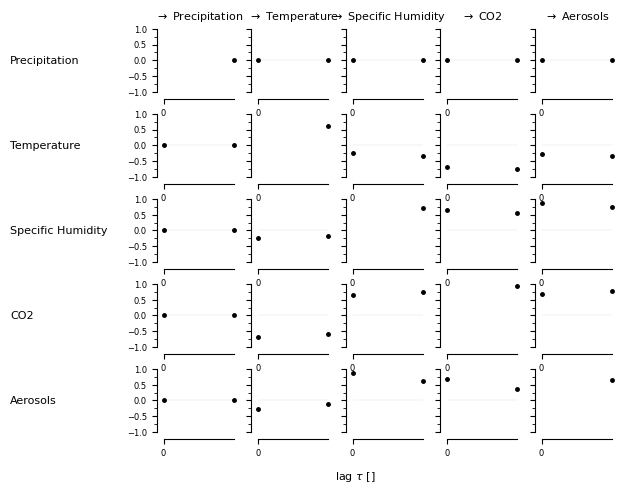

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (CO2 -1): max_pval = 0.01846, |min_val| =  0.562

    Variable C

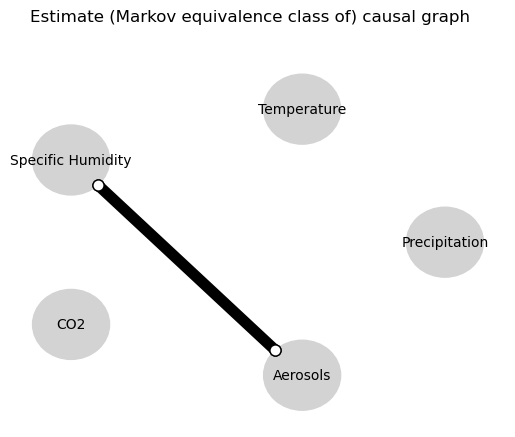

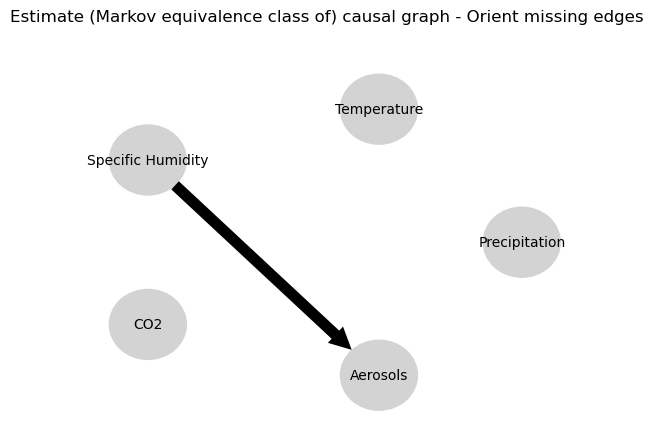

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.08349636639885445
-0.5793155850778147
0.14437061750577185
-0.0008473681105947083
-0.009062860250407543
-0.68169788711643
0.09179379672065038
-0.5793155850778147
0.012739385690558973
0.0
-0.07003395334042106
-0.012260513565112837
-0.022358814283558
0.7673195489154956
-0.045530758718763525
-0.0008473681105947083
-0.0008473681105947083
-0.012260513565112837
-0.012260513565112837
0.0
0.9999999999999999
-0.025697615004860116
-0.025697615004860116
-0.68169788711643
0.01651147845789707
0.7673195489154956
-0.07680744346027696
-0.025697615004860116
-0.03301655282147703
0.0
-0.04992387392531697


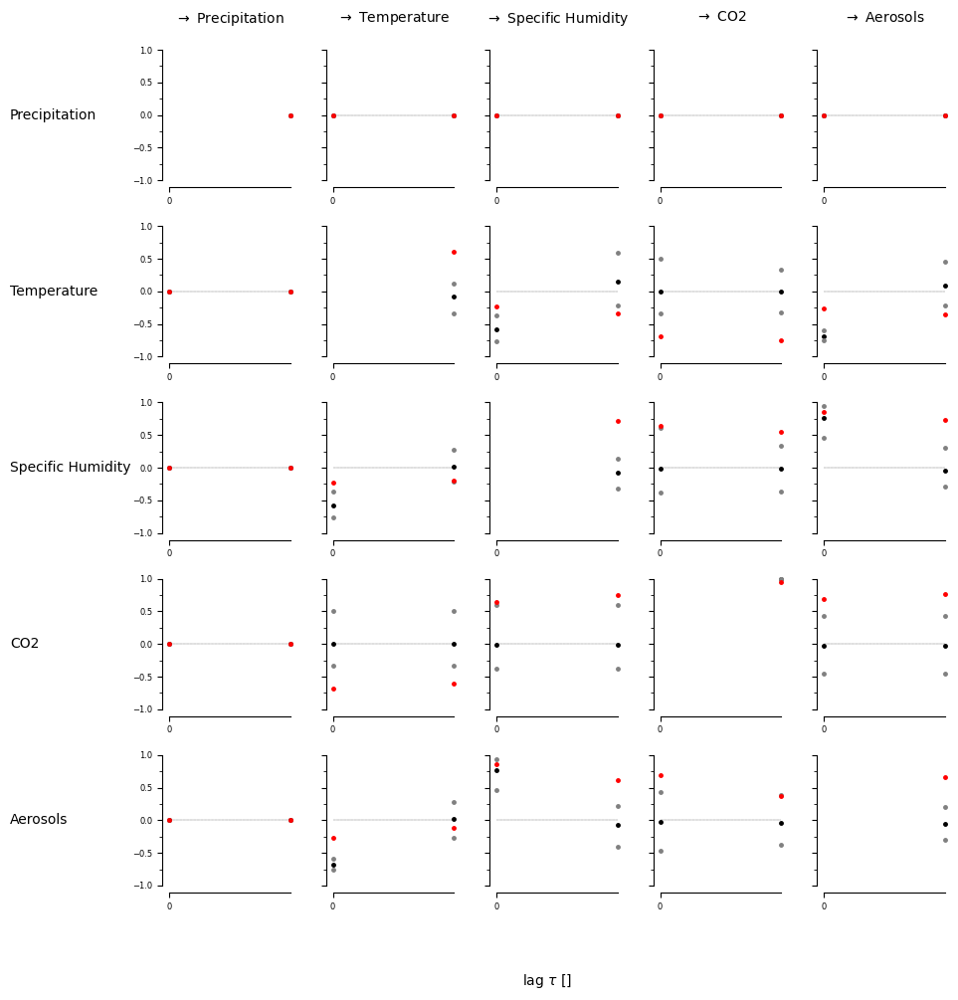

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True False]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [False False]
  [ True  True]
  [ True False]
  [False  True]]]


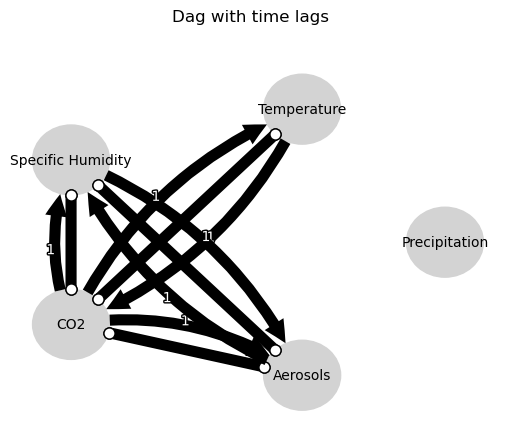

Negative precipitation values in event 158: 0


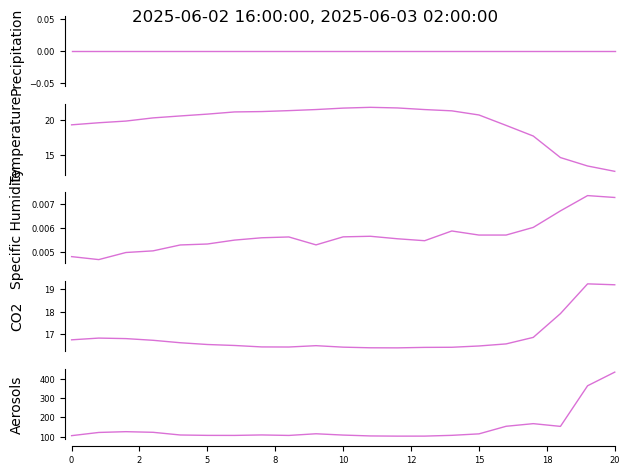


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


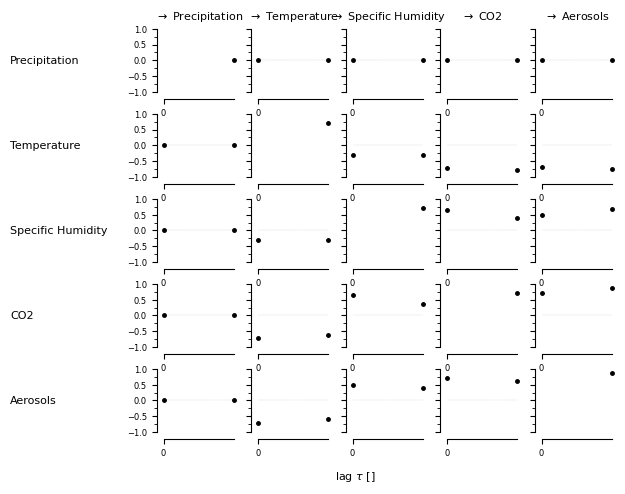

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00075, |min_val| =  0.705



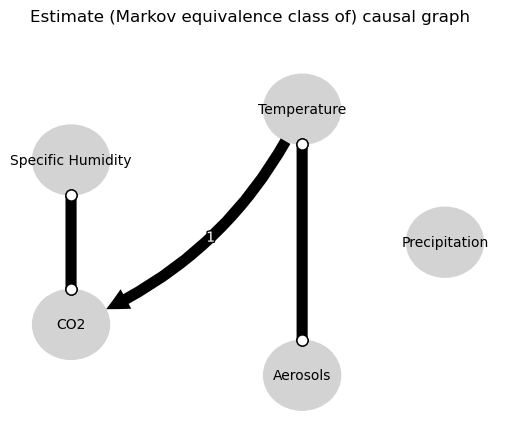

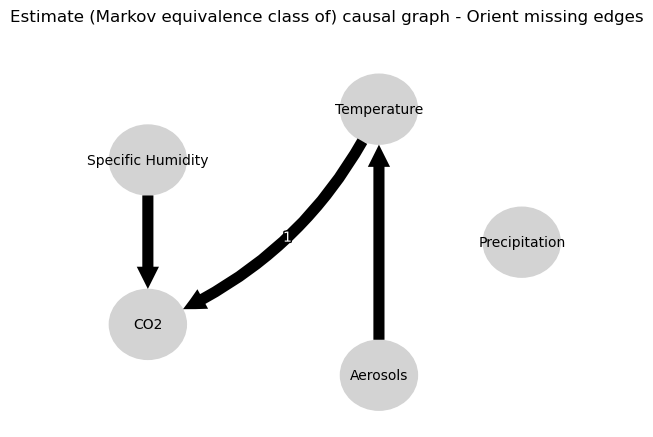

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.05797706893211176
-0.6446012350251978
-0.018157446459998235
-0.09868501073300491
-0.765098247829471
-0.7127978157977922
-0.014758033957017407
-0.6446012350251978
0.01505114546823775
0.0
0.0008178752029543839
0.21217738773751996
0.725962762536906
0.7107410070089055
0.019158705269796853
-0.09868501073300491
-0.02750432198677906
0.21217738773751996
0.02603889266430226
0.0
0.10085551350152204
0.14937795783947125
0.010859119909518652
-0.7127978157977922
0.05192197428467461
0.7107410070089055
0.0070069411930769555
0.14937795783947125
0.7570570621207995
0.0
-0.0438664419562254


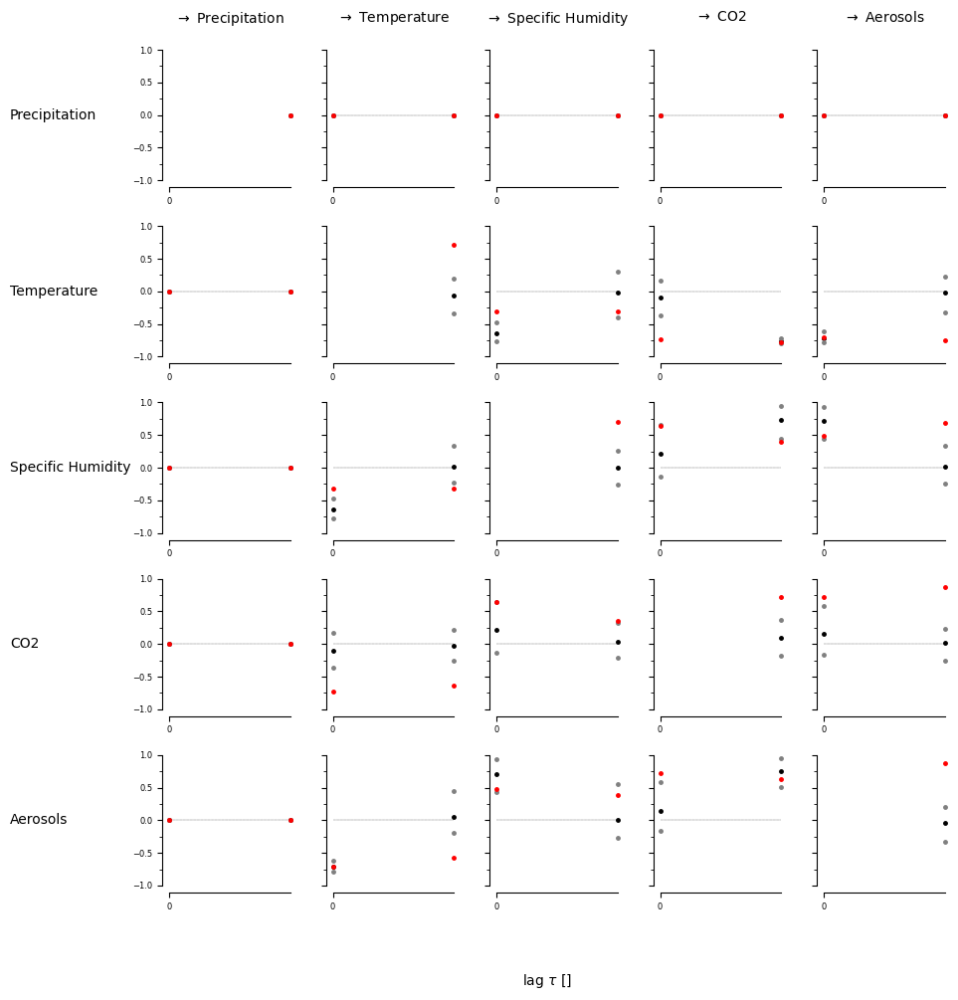

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [ True  True]]

 [[False False]
  [False False]
  [False  True]
  [ True False]
  [False  True]]

 [[False False]
  [ True  True]
  [ True False]
  [False  True]
  [ True  True]]

 [[False False]
  [ True False]
  [False False]
  [ True  True]
  [False  True]]]


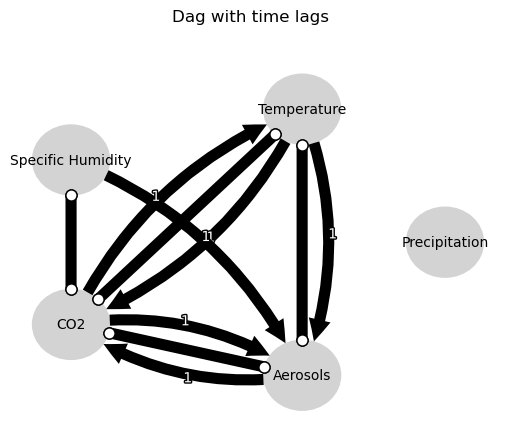

Negative precipitation values in event 159: 0


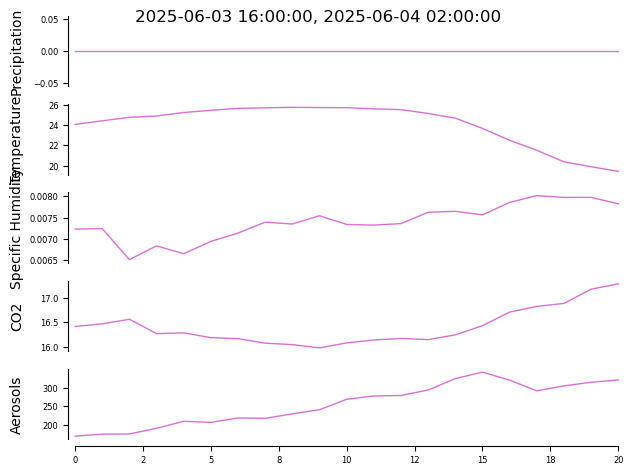


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


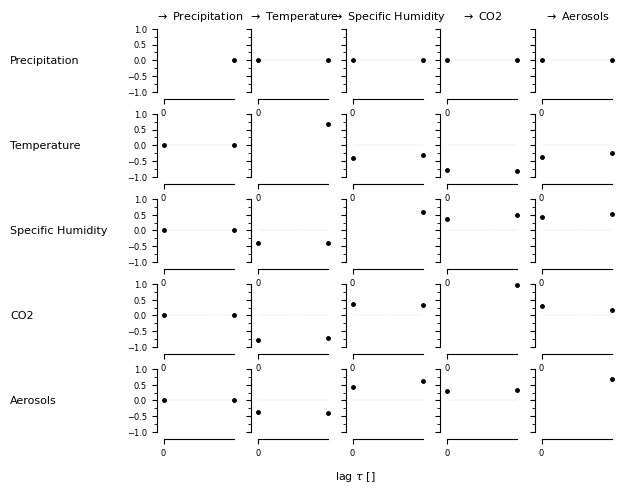

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Aerosols -1): max_pval = 0.04777, |min_val| =  0.472

    Varia

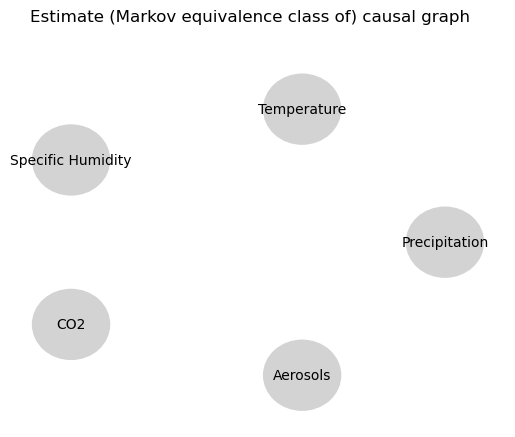

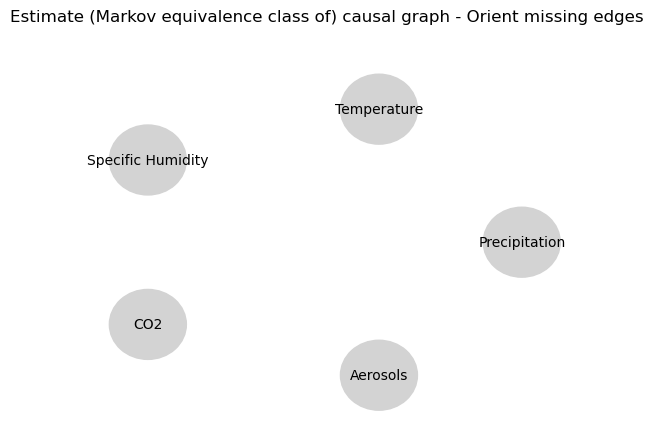

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.0731089060446603
-0.4979580604285199
-0.017766858781423547
-0.05717421749680105
-0.06349573491073947
0.008915622640032157
0.02891572947233585
-0.4979580604285199
0.057285728389371134
0.0
-0.03833804800269839
0.1036580789784096
0.01609163257745387
0.03653861037272791
0.03904896414781086
-0.05717421749680105
0.003145794382211674
0.1036580789784096
0.04018945071388187
0.0
0.8462288806919626
0.08705872842124643
0.06811665494478067
0.008915622640032157
-0.06419965399604013
0.03653861037272791
-0.010632168732035159
0.08705872842124643
0.0407938952939457
0.0
0.5216554281116834


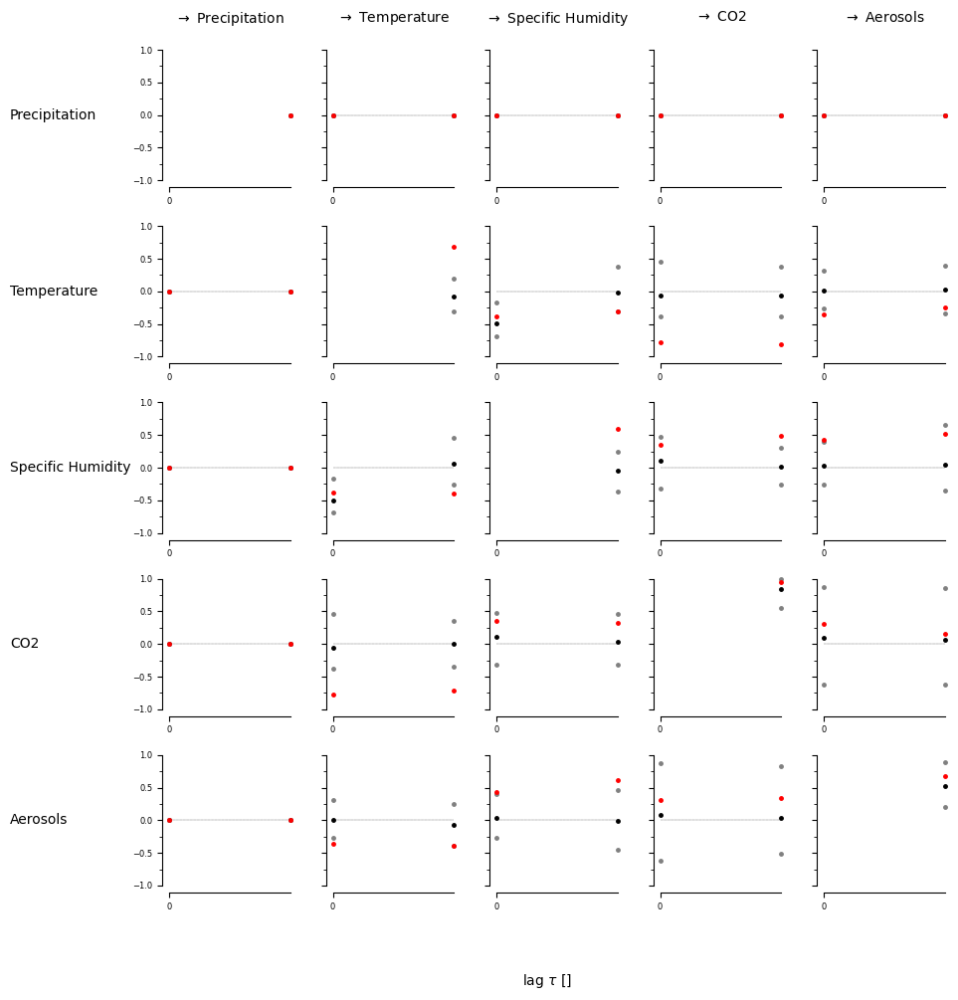

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False  True]]]


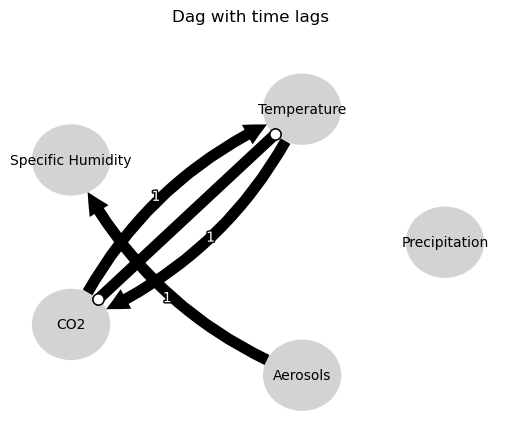

Negative precipitation values in event 160: 0


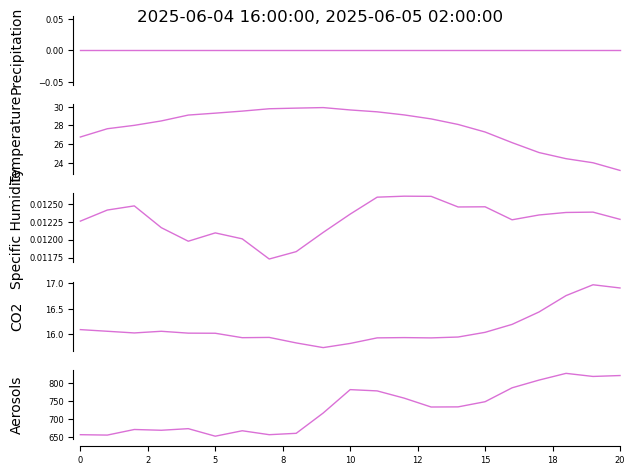


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


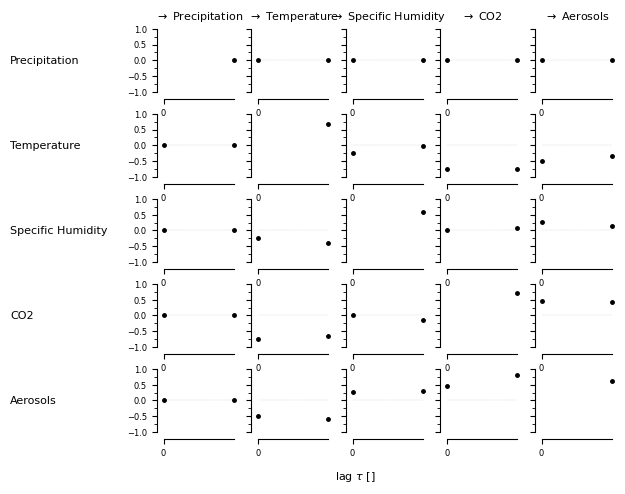

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Specific Humidity -1): max_pval = 0.00680, |min_val| =  0.598



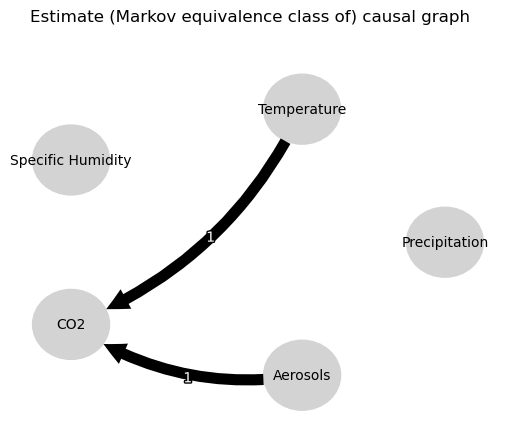

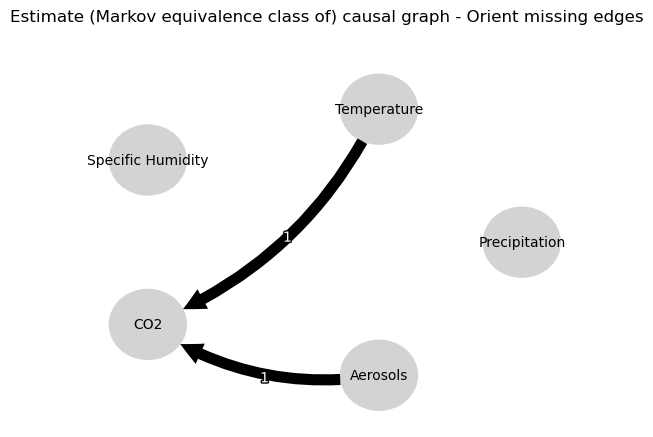

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
-0.0269521829398584
-0.031785142764820876
0.03919870195182494
0.033500823818319585
-0.775136945484032
-0.5710125738899589
-0.0028815254816877012
-0.031785142764820876
-0.022465895601541677
0.0
0.43922200754681856
-0.00994184969482732
0.10567356448594831
0.22985682567273422
-0.05499728152878246
0.033500823818319585
0.02196629971469267
-0.00994184969482732
-0.05487702456276563
0.0
-0.07171768197061472
-0.017261441968172187
0.013501067380751882
-0.5710125738899589
0.016898959544097186
0.22985682567273422
0.08045627993063269
-0.017261441968172187
0.6903015796859574
0.0
-0.047578446165179145


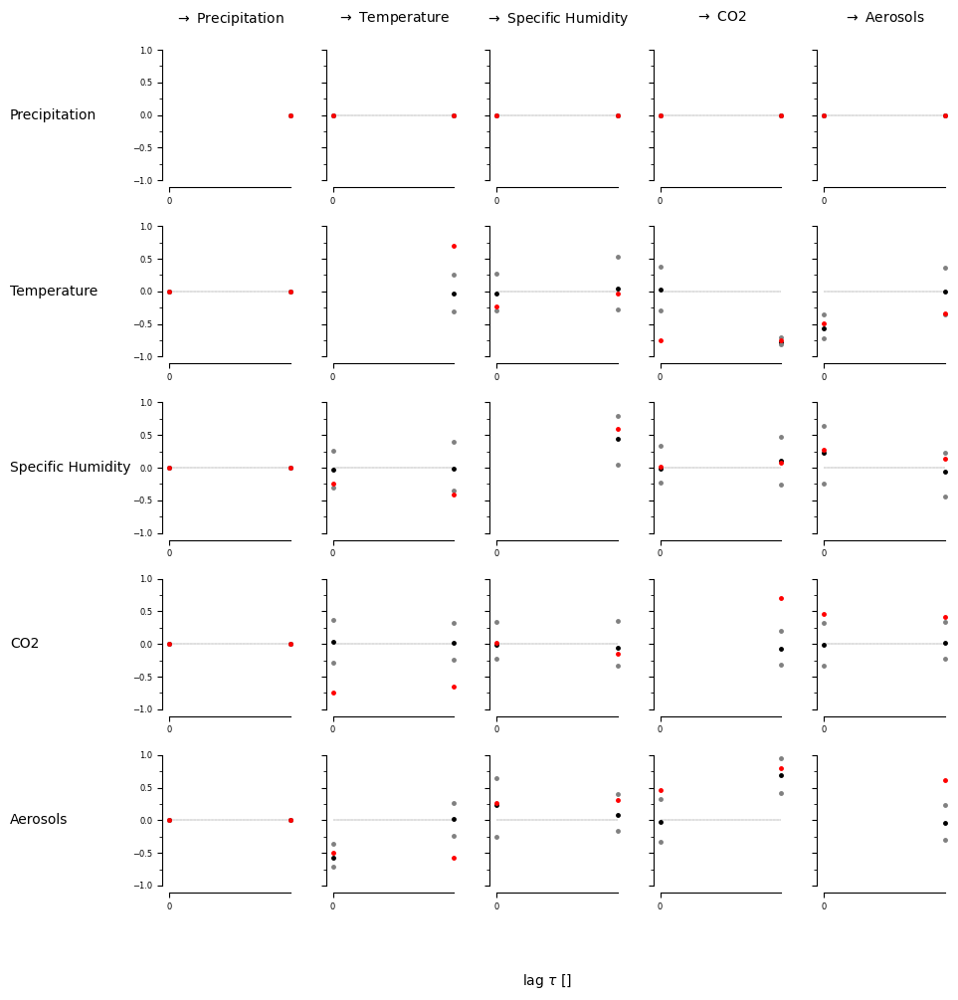

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False  True]]]


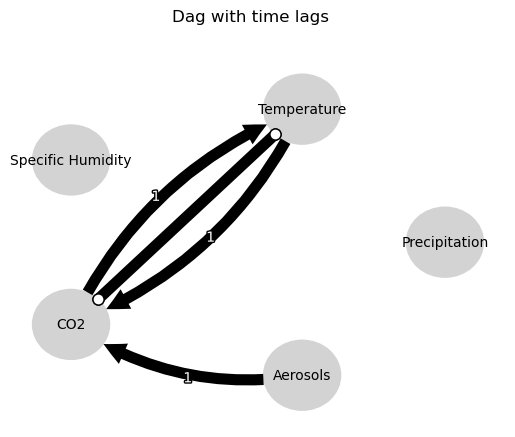

Negative precipitation values in event 161: 0


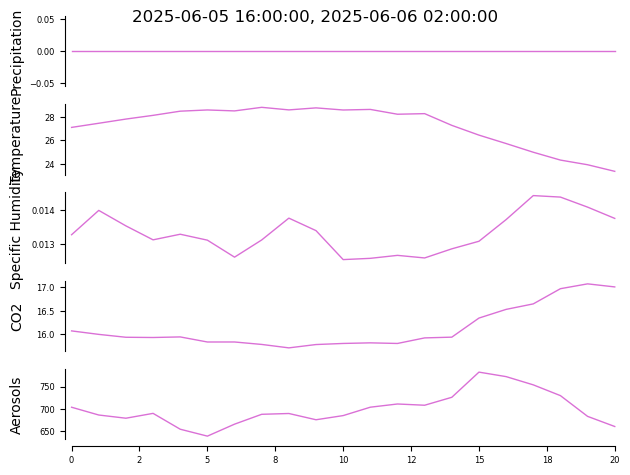


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


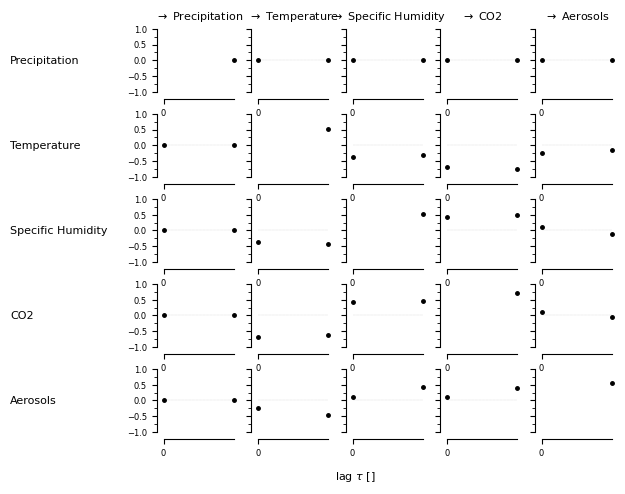

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 0 link(s):

    Variable CO2 has 1 link(s):
        (Temperature -1): max_pval = 0.

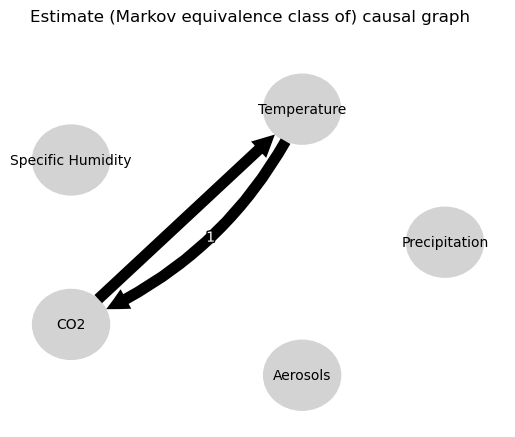

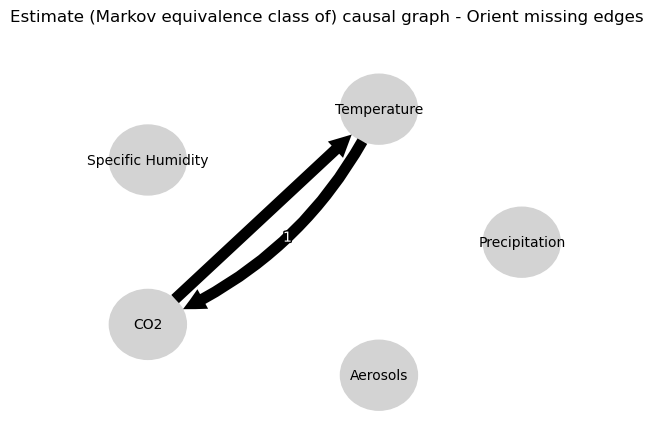

0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.8338425240543316
0.026349289822671092
-0.020120572428408295
-0.7609327994678893
-0.7355945148345625
0.04364387068725785
0.12025391373504359
0.026349289822671092
0.003902234273428229
0.0
-0.06828968219230938
-0.033666388071192106
-0.03332441572285143
-0.2517599399840479
-0.14880775974582333
-0.7609327994678893
-0.7021711006140445
-0.033666388071192106
0.001261517603112446
0.0
0.7627560208848162
-0.05530306239863426
-0.11865261745354223
0.04364387068725785
0.04773713681057212
-0.2517599399840479
0.07862440698535243
-0.05530306239863426
-0.022100694525935872
0.0
0.4962005643696365


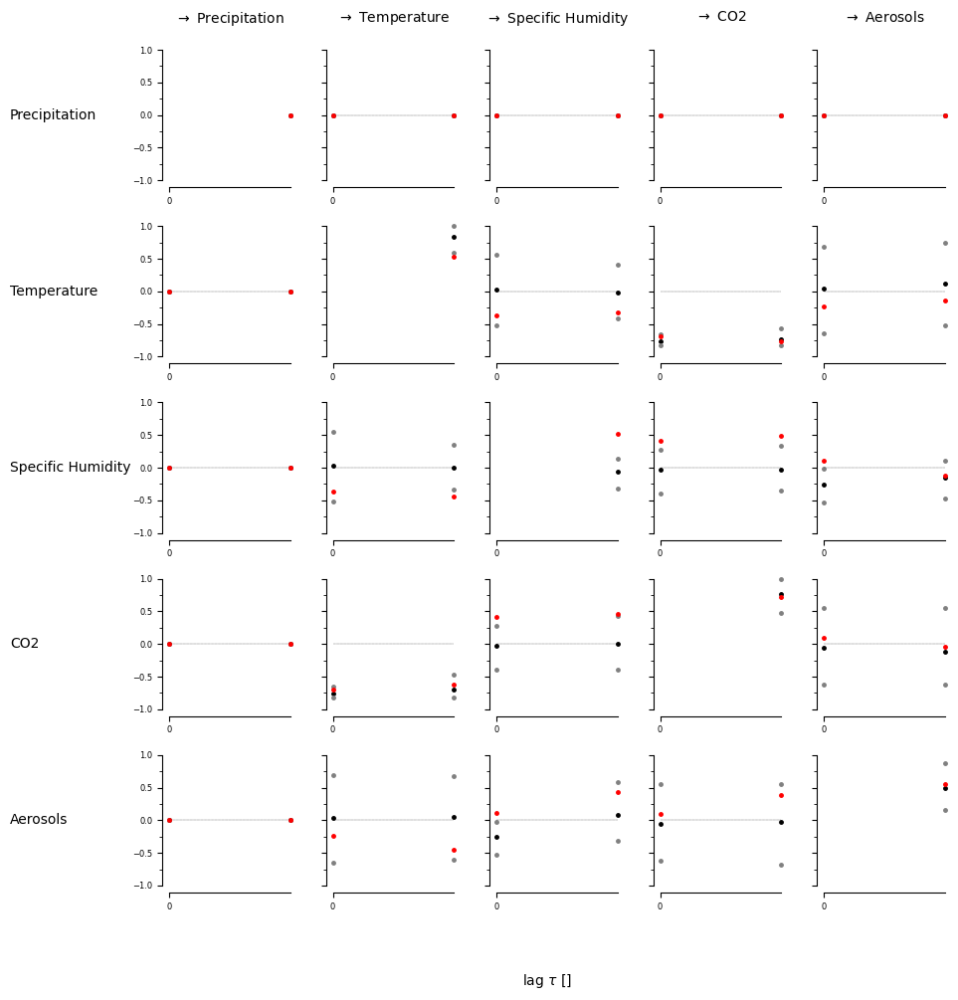

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True  True]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]]


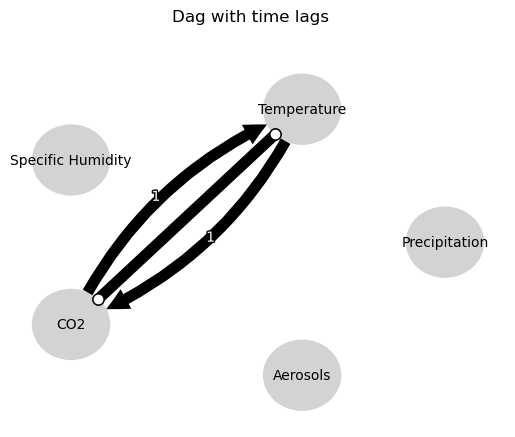

Negative precipitation values in event 162: 0


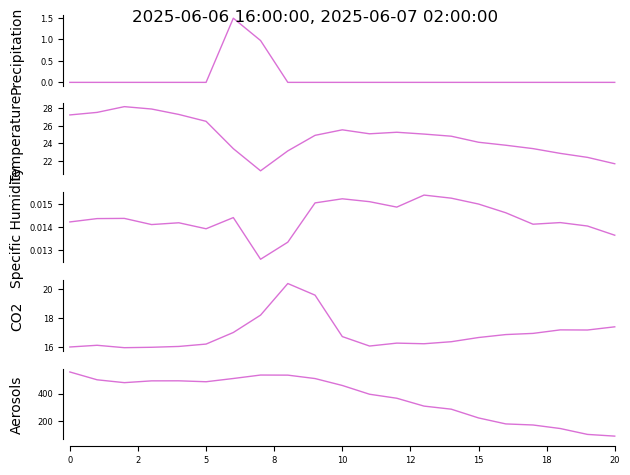


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


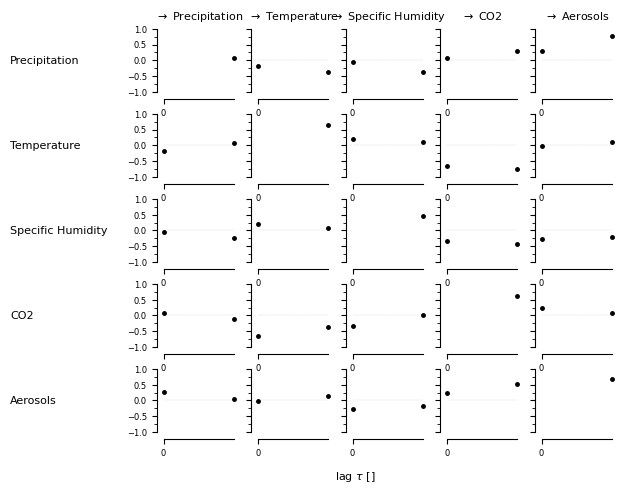

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00283, |min_val| =  0.646

    Variable Specific Humidity has 0 link(s):

    Va

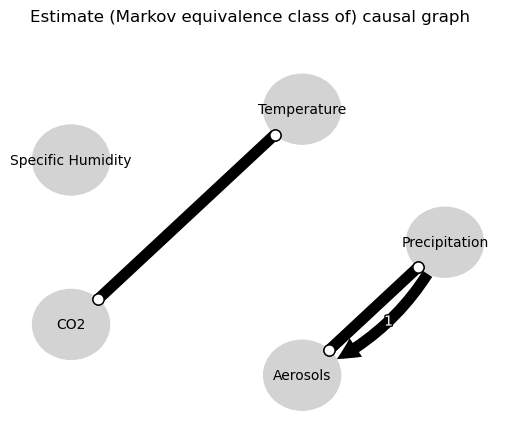

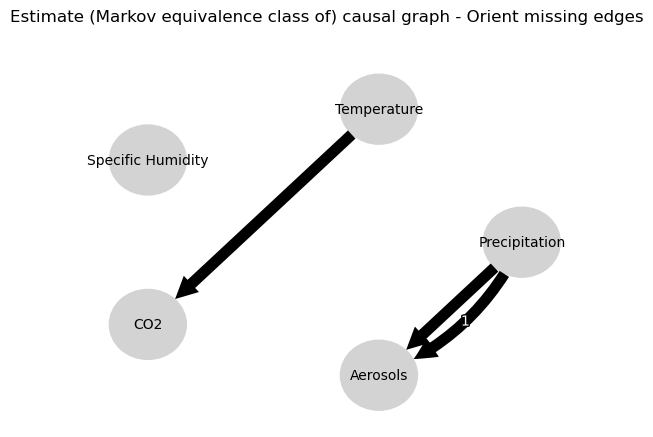

0.0
-0.04260495651342165
-0.3070057471504464
0.06707850001693537
-0.1998411871987051
-0.009431137763975916
0.10573552479376051
0.022089120567037837
0.028805971383763597
0.17419558111474157
-0.3070057471504464
-0.0008422213443928517
0.0
-0.08391484899226076
0.29885736649944145
-0.0028258588112805203
-0.4320735786448602
-0.01863470912978279
0.16289007380977114
0.023817815298205137
0.29885736649944145
-0.0518631848145501
0.0
-0.04735408675717627
-0.3168130961781514
-0.041617971529509565
-0.08656738400904396
-0.12425911422857583
-0.4320735786448602
0.03376407063908694
-0.3168130961781514
0.05277251705501188
0.0
-0.05105341268162382
-0.03310750746933437
-0.008649979980635455
0.16289007380977114
0.12356891283099722
-0.08656738400904396
0.20062189212441897
-0.03310750746933437
-0.07451601694268768
0.0
0.5803853380856804


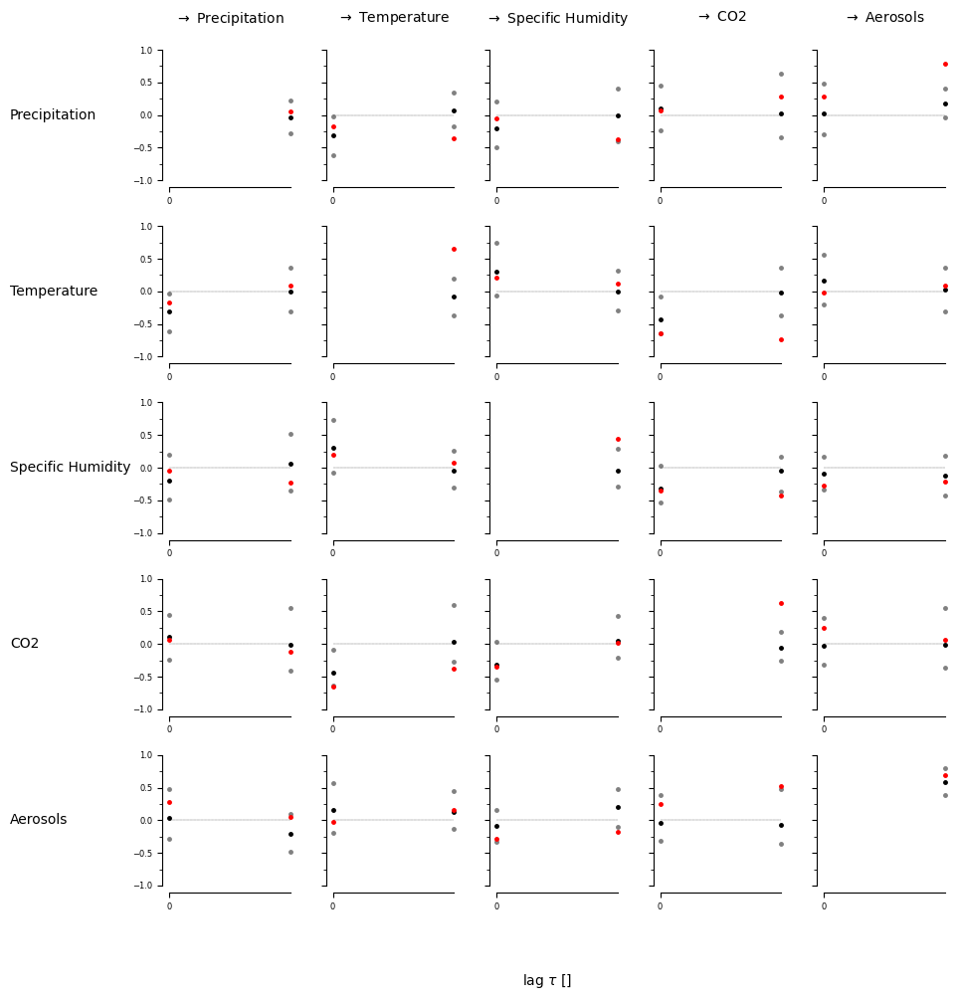

[[[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


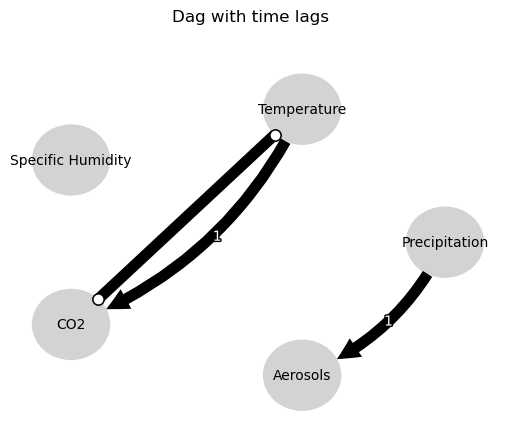

Negative precipitation values in event 163: 0


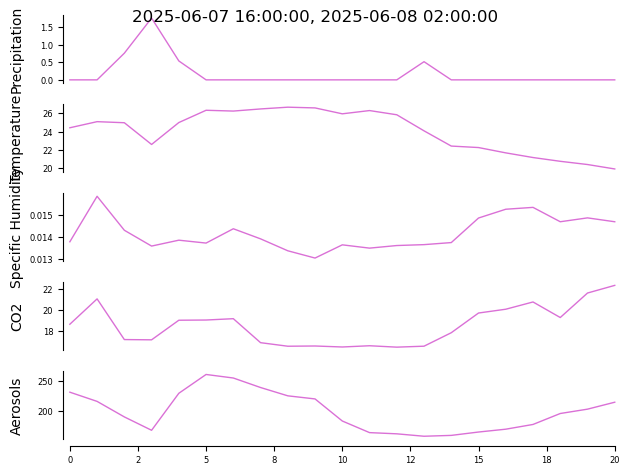


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


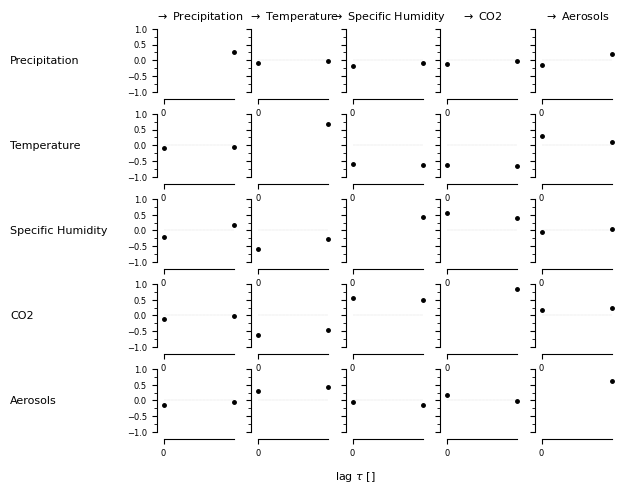

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.01413, |min_val| =  0.567

    Variable Specific Humidity has 1 link(s):
       

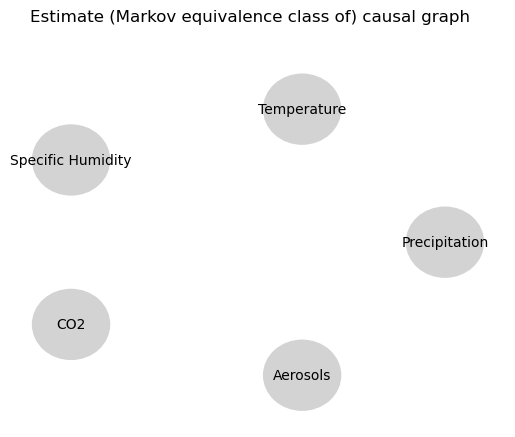

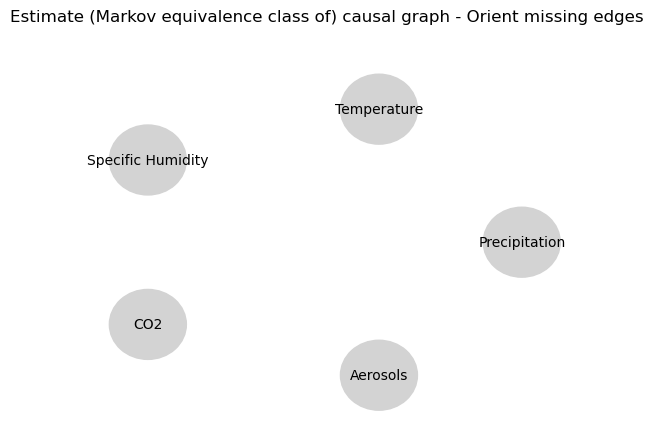

0.0
-0.04726074793958478
-0.07520645715687782
-0.045018619538009584
-0.17094346832537113
0.08046434882221491
-0.13865950588040868
-0.05859903325517491
-0.05451488419352146
-0.05629259920012156
-0.07520645715687782
0.0759362551844451
0.0
0.5283515016591182
-0.010868062795265398
0.01021950843391094
-0.0049847889070359416
-0.04206044148477492
0.35048234642256654
0.11592269968631191
-0.010868062795265398
-0.07189527337453097
0.0
-0.043587472643781634
0.31816651264066365
0.20295148785855072
0.06033547765849037
-0.03805126204743599
-0.0049847889070359416
-0.010985356627848282
0.31816651264066365
-0.09641109637143158
0.0
0.41120821237366706
0.2700860892819498
0.15127304044329654
0.35048234642256654
0.2651986180687203
0.06033547765849037
0.04044814851254149
0.2700860892819498
0.14424575998951253
0.0
0.4899518423788332


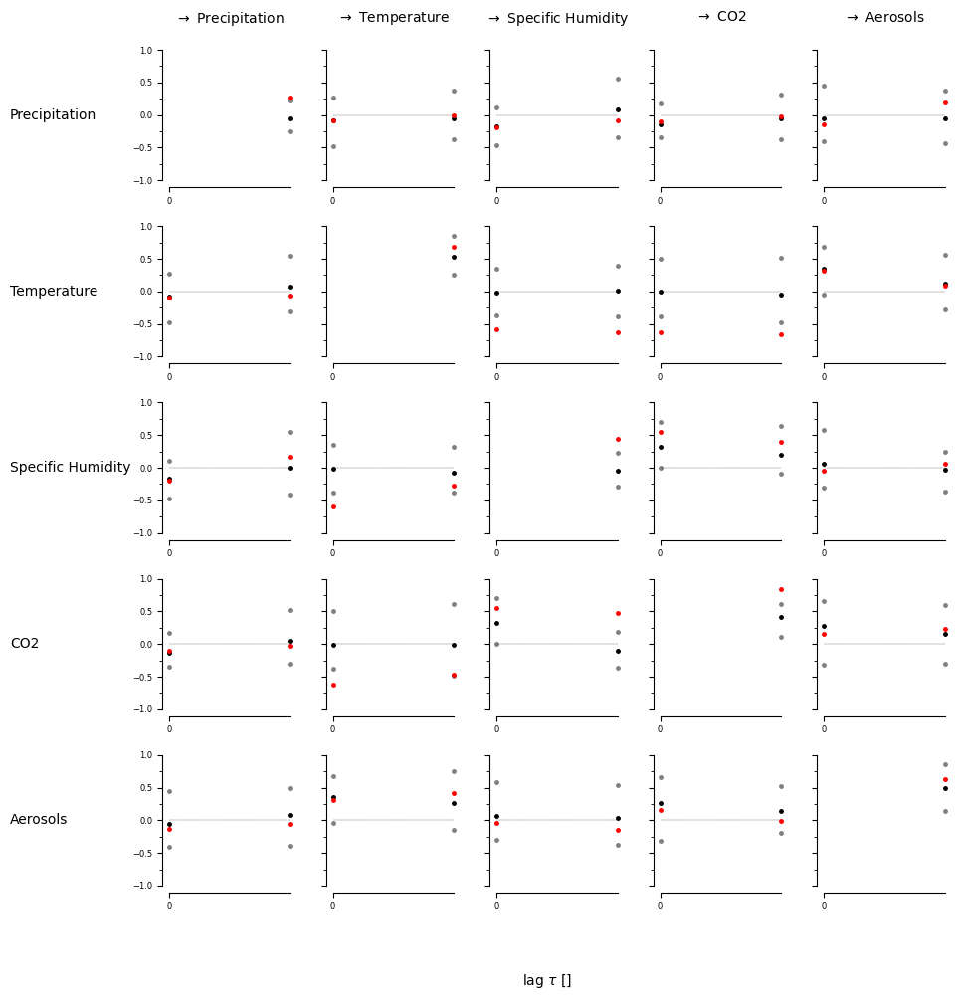

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [ True  True]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


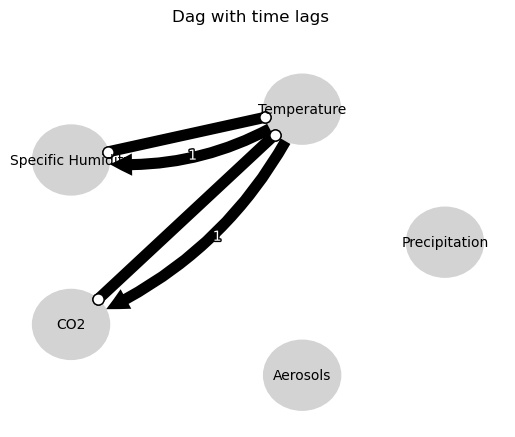

Negative precipitation values in event 164: 0


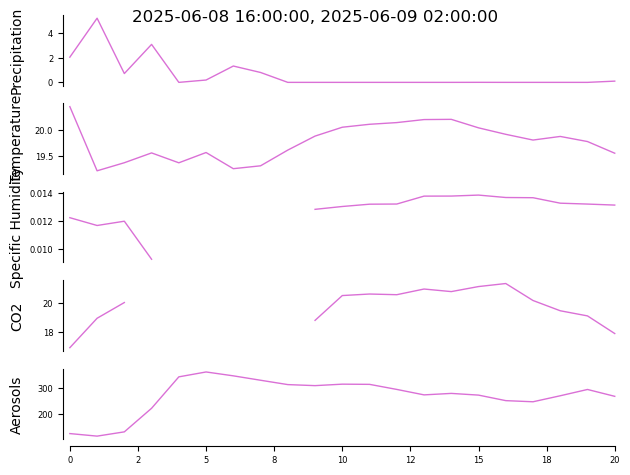


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


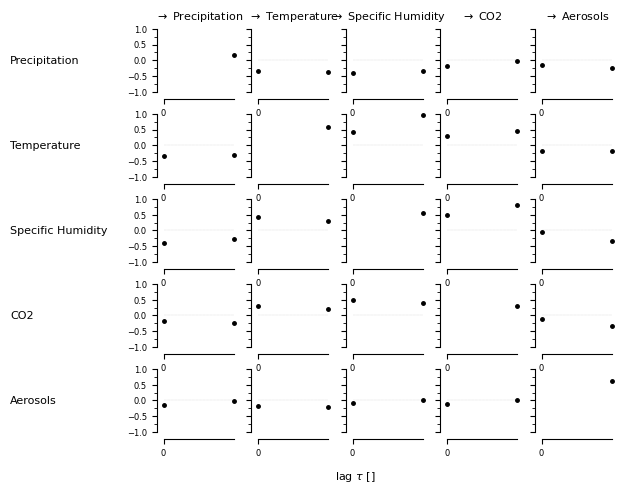

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.00783, |min_val| =  0.590

    Variable Specific Humidity has 1 link(s):
       

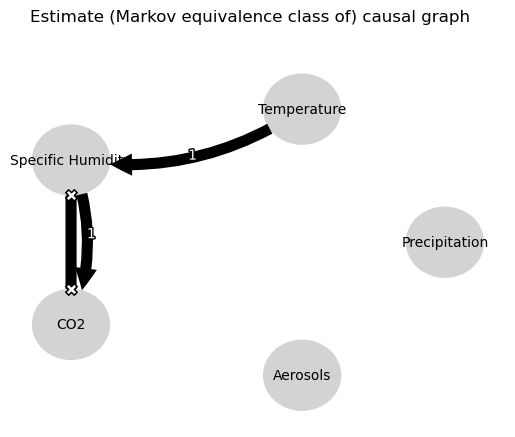

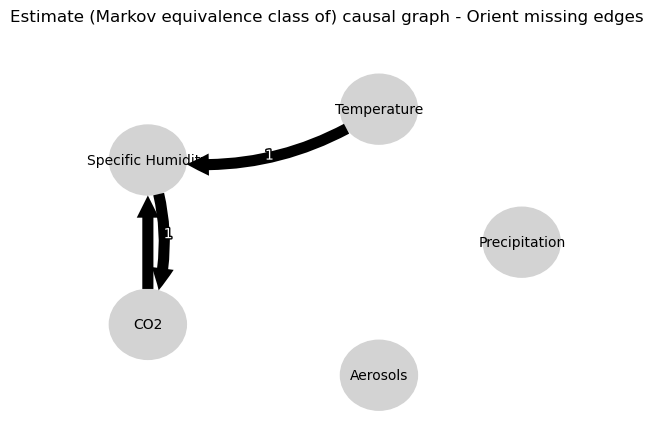

0.0
-0.03532774062542755
-0.6106625913614641
-0.250587118116331
-0.653115671262808
-0.16157732479293963
-0.1100203739160643
-0.13538257387391855
-0.3349492903604909
-0.2156294359859191
-0.6106625913614641
0.08118269180836533
0.0
0.2809796304392488
0.6502143923698501
0.1354142500630826
0.40613741728469965
0.13304679047058288
0.469803865842944
0.25010959371164704
0.6502143923698501
0.22401702735786416
0.0
0.1488559600125813
0.1389406580931901
0.13949064049283055
0.34110953506345876
0.2228481197351057
0.40613741728469965
0.083691862909149
0.1389406580931901
0.054939265227079655
0.0
-0.03325727389341661
0.03264771471183161
-0.007275874076526962
0.469803865842944
0.18809479538988988
0.34110953506345876
0.07724937061135678
0.03264771471183161
0.11438042110543792
0.0
0.4733075437265287


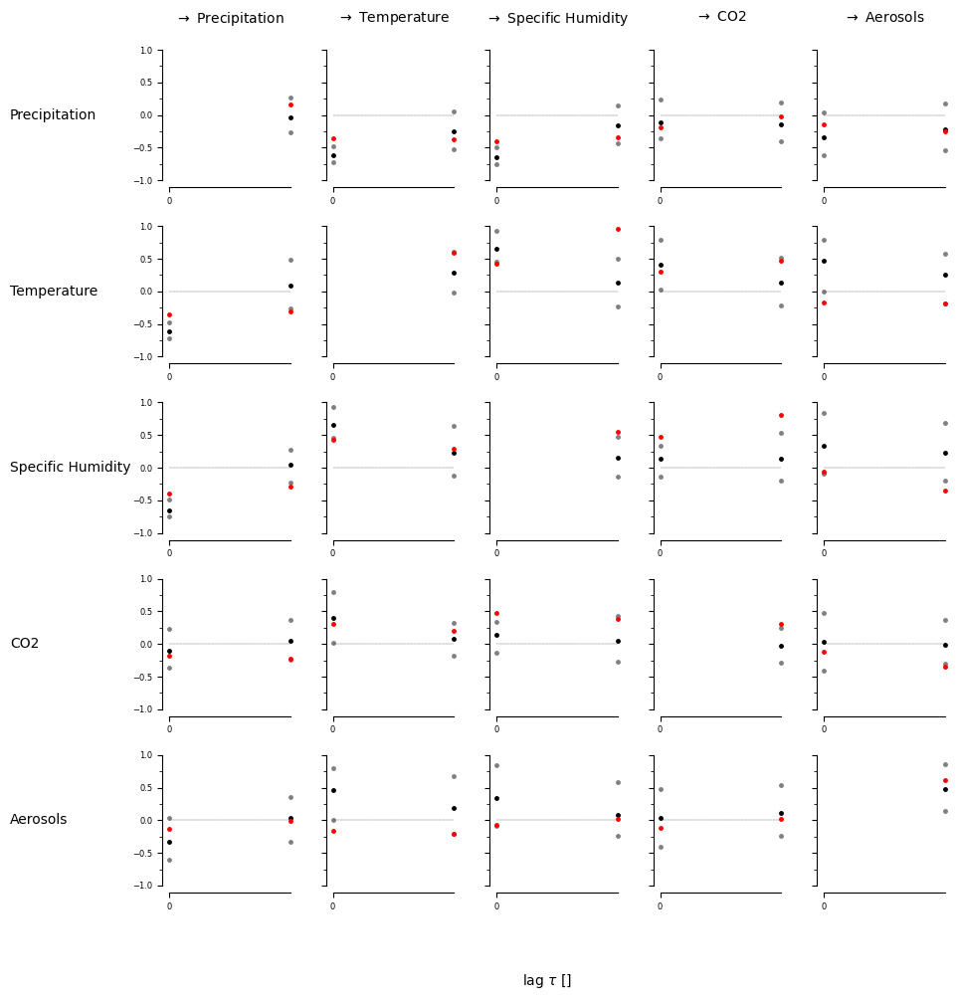

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False  True]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False  True]]]


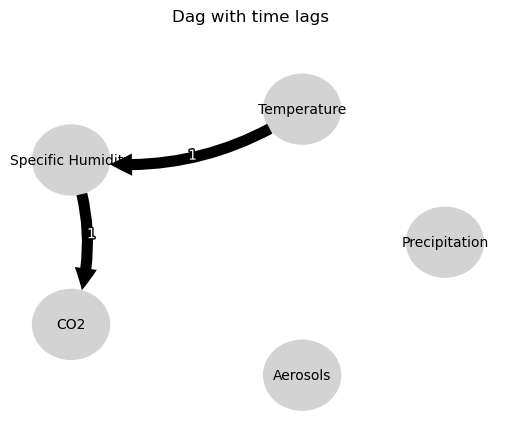

Negative precipitation values in event 165: 0


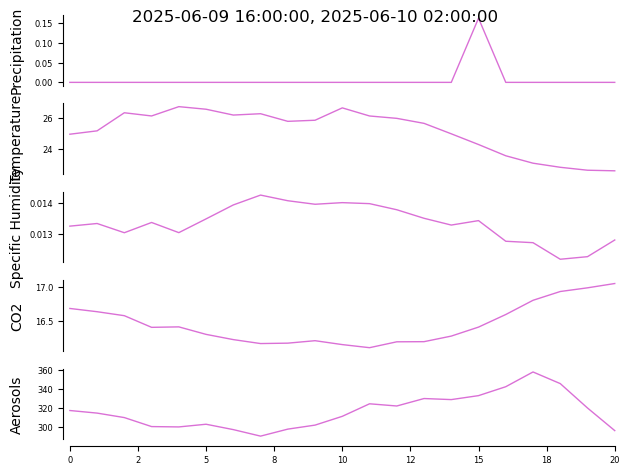


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


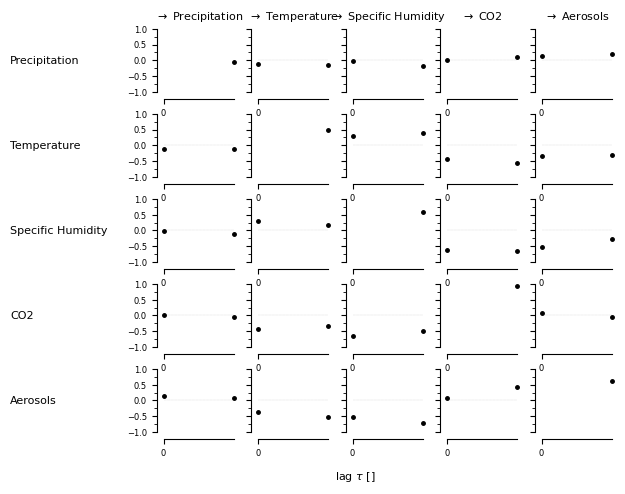

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 0 link(s):

    Variable Specific Humidity has 1 link(s):
        (Aerosols -1): max_pval = 0.01845, |min_val| =  0.548

    Varia

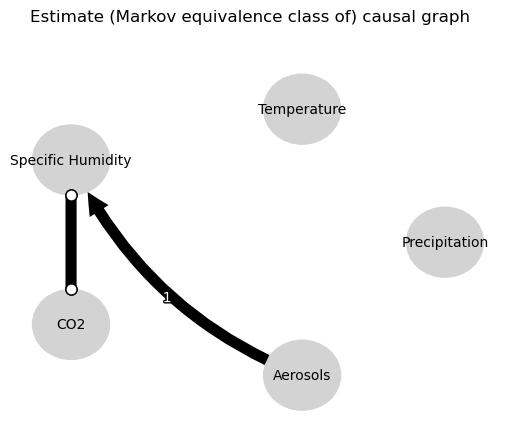

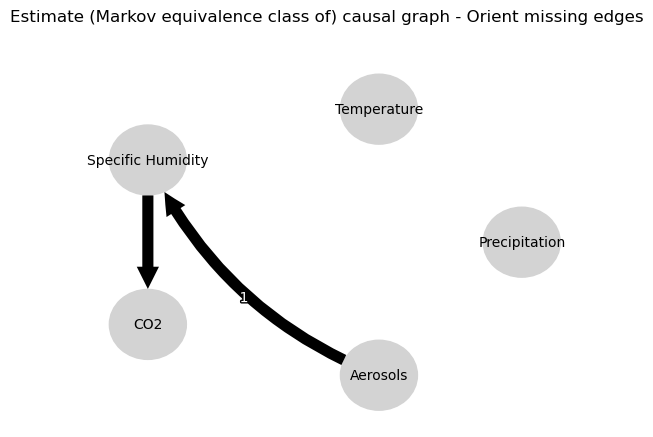

0.0
-0.05898430070133829
-0.12489044722788814
0.03586346497693224
0.1282819382309487
-0.045157801184835304
-0.033236484660236106
0.02380056641159572
0.05361336079185587
0.018742548777656236
-0.12489044722788814
-0.026101952550710707
0.0
-0.03317061777934523
0.11168111260206731
-0.07077965678163471
-0.24698964666643874
-0.1216179911697844
0.15092927974651385
0.09315211716189441
0.11168111260206731
0.05568833884880444
0.0
0.20201379882183074
-0.5427145897136071
-0.4471216452645199
-0.22694687866853963
-0.12374930450855551
-0.24698964666643874
-0.012287810103747195
-0.5427145897136071
-0.16621356277207458
0.0
0.5452228547792053
0.134654832152539
-0.007721314945783329
0.15092927974651385
-0.04776146163186738
-0.22694687866853963
-0.5919446282894396
0.134654832152539
0.46397990571036624
0.0
0.49212140833524726


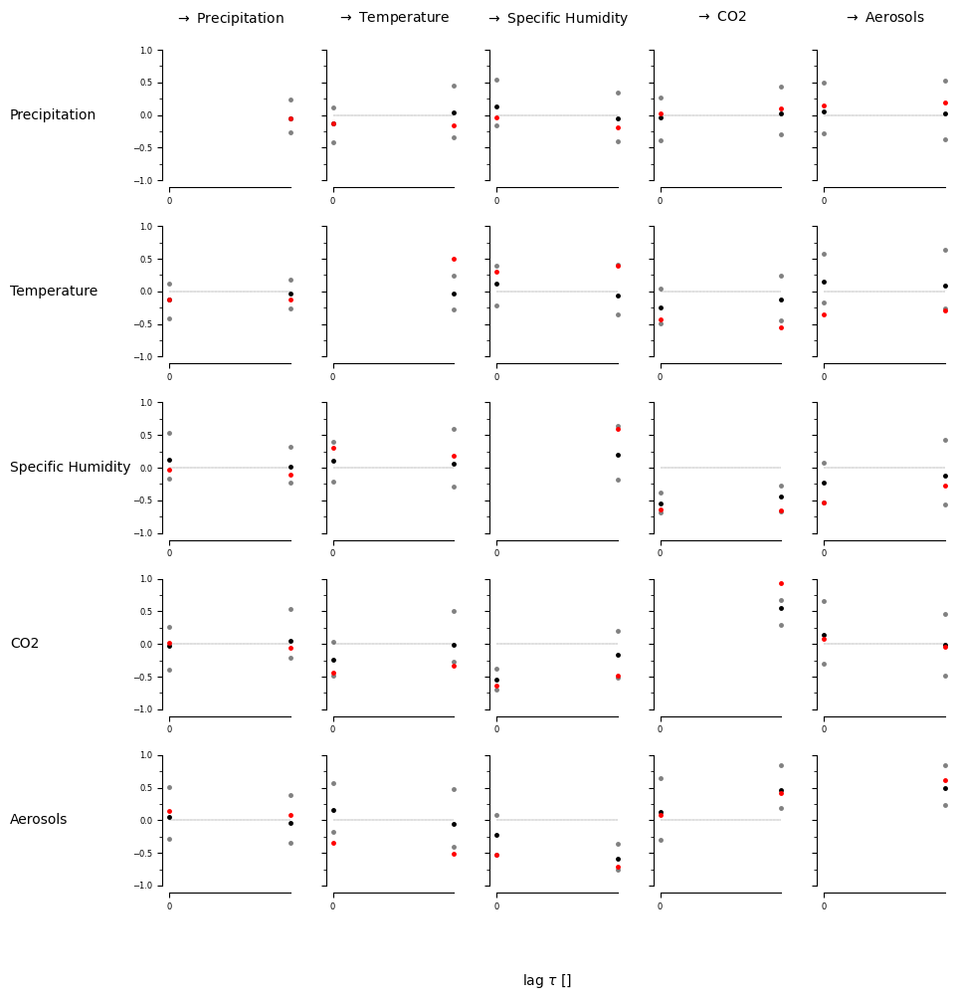

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [ True False]
  [False  True]
  [False False]]

 [[False False]
  [False False]
  [False  True]
  [False False]
  [False  True]]]


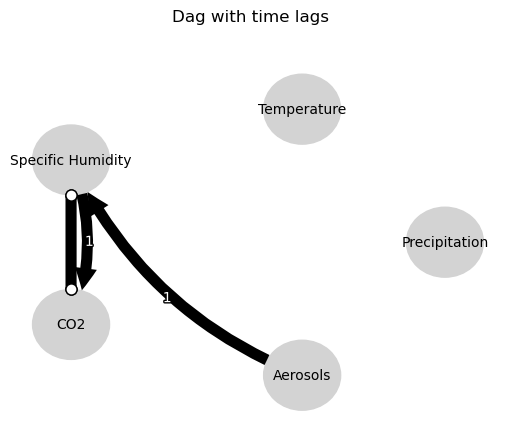

Negative precipitation values in event 166: 0


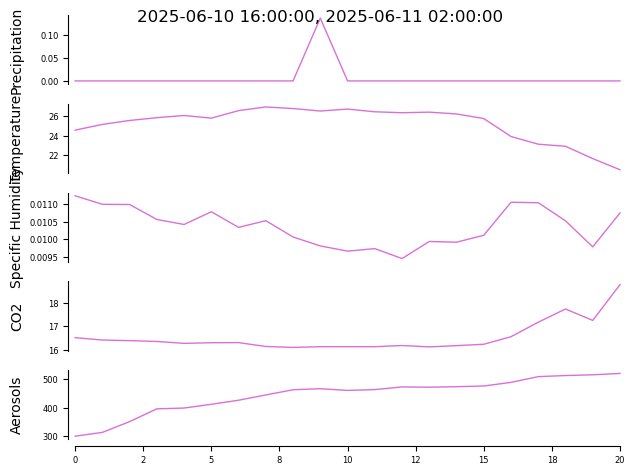


##
## Estimating lagged dependencies 
##

Parameters:

independence test = robust_par_corr
tau_min = 0
tau_max = 1


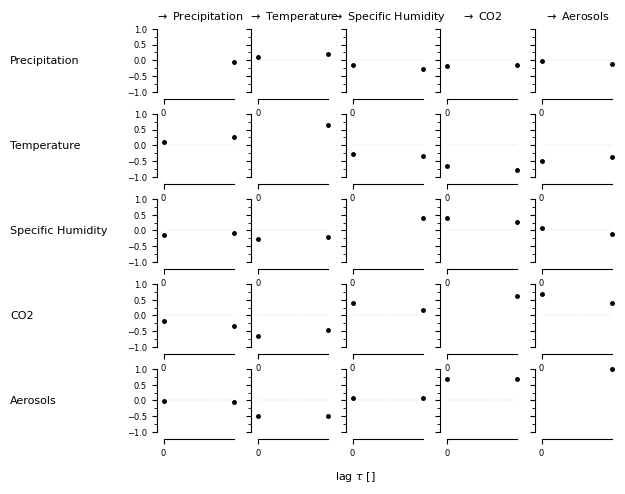

['__class__', '__delattr__', '__dict__', '__dir__', '__doc__', '__eq__', '__format__', '__ge__', '__getattribute__', '__getstate__', '__gt__', '__hash__', '__init__', '__init_subclass__', '__le__', '__lt__', '__module__', '__ne__', '__new__', '__reduce__', '__reduce_ex__', '__repr__', '__setattr__', '__sizeof__', '__str__', '__subclasshook__', '__weakref__', 'add_lagfuncs', 'axes_dict', 'fig', 'label_fontsize', 'label_space_left', 'label_space_top', 'labels', 'lag_array', 'lag_units', 'legend_fontsize', 'legend_width', 'savefig', 'tau_max', 'x_base']

##
## Step 1: PC1 algorithm for selecting lagged conditions
##

Parameters:
independence test = robust_par_corr
tau_min = 1
tau_max = 1
pc_alpha = [0.05]
max_conds_dim = None
max_combinations = 1



## Resulting lagged parent (super)sets:

    Variable Precipitation has 0 link(s):

    Variable Temperature has 1 link(s):
        (Temperature -1): max_pval = 0.01258, |min_val| =  0.575

    Variable Specific Humidity has 0 link(s):

    Va

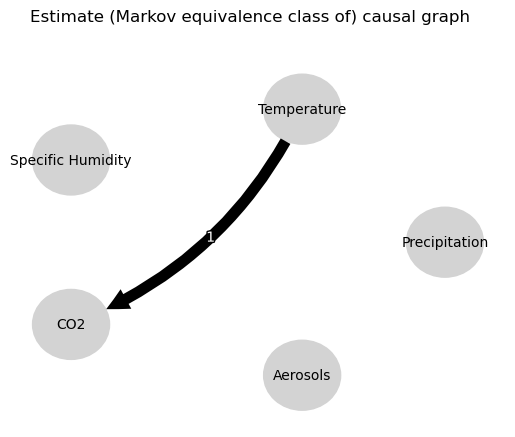

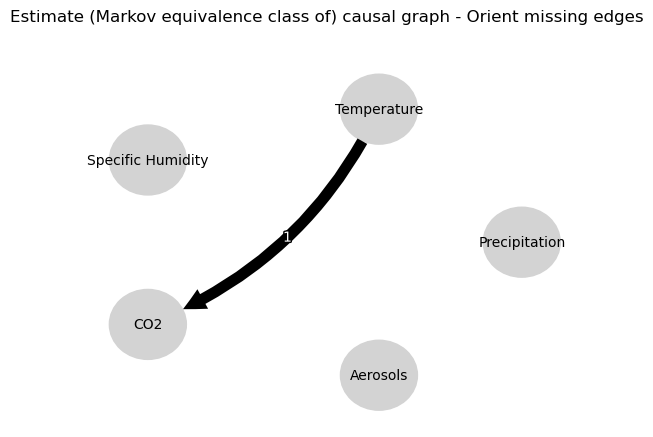

0.0
-0.07947896566314756
-0.028382025256224484
-0.045971895793406006
-0.1764859048398297
0.00714139220374332
0.007676539612933411
0.01697871634174343
-0.06550805158052089
-0.025177636801733905
-0.028382025256224484
-0.021188253541663933
0.0
0.9266293080472268
-0.10132421857353437
-0.08112605735566611
-0.7605097337785556
-0.7770520095604835
-0.04108516670891466
-0.03454682713911096
-0.10132421857353437
-0.0438784856183094
0.0
0.005042287287166905
0.07716044434163402
0.07832193103054255
0.19183528905333797
0.16325481299191785
-0.7605097337785556
-0.7357382333110605
0.07716044434163402
0.08103852345029514
0.0
0.8198810499341936
0.11535592314186083
0.0741247514572947
-0.04108516670891466
-0.05238555791819241
0.19183528905333797
-0.11089434069201404
0.11535592314186083
0.12477740845856339
0.0
0.4913496934326045


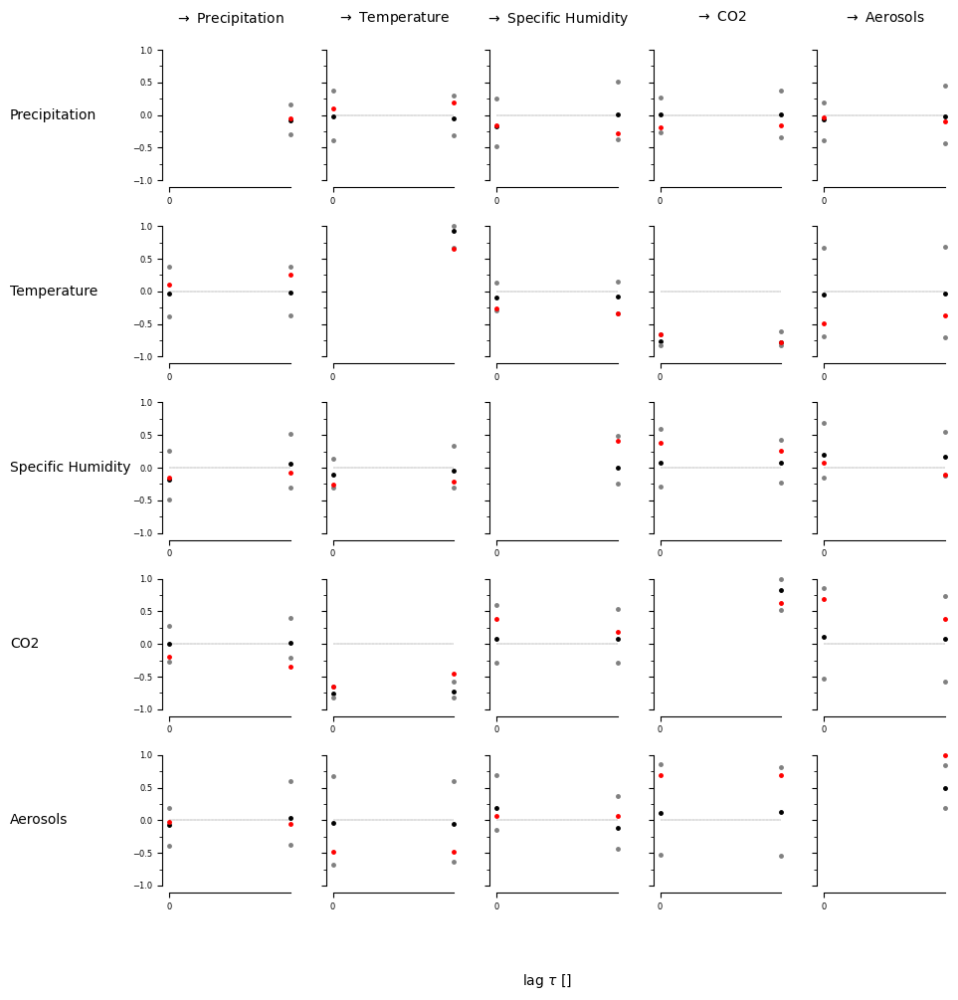

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [False False]
  [ True  True]
  [False False]]

 [[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [ True False]
  [False False]
  [False  True]
  [ True False]]

 [[False False]
  [False False]
  [False False]
  [ True  True]
  [False  True]]]


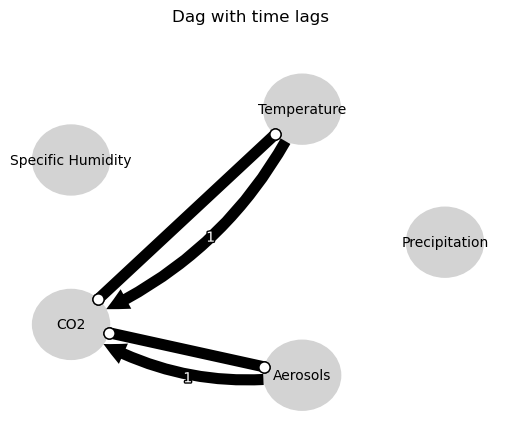

In [42]:
precipitaction = []

# Store Time lags
P_P_elem = []
P_T_elem = []
P_H_elem = []
P_CO2_elem =[]
P_aero_elem =[]

T_P_elem = []
T_T_elem = []
T_H_elem = []
T_CO2_elem =[]
T_aero_elem =[]


H_P_elem = []
H_T_elem = []
H_H_elem = []
H_CO2_elem =[]
H_aero_elem =[]

CO2_P_elem = []
CO2_T_elem = []
CO2_H_elem = []
CO2_CO2_elem =[]
CO2_aero_elem =[]

aero_P_elem = []
aero_T_elem = []
aero_H_elem = []
aero_CO2_elem =[]
aero_aero_elem =[]

#Store Correlation coeficients

# Store Time lags
P_P_coef = []
P_T_coef = []
P_H_coef = []
P_CO2_coef =[]
P_aero_coef =[]

T_P_coef = []
T_T_coef = []
T_H_coef = []
T_CO2_coef =[]
T_aero_coef =[]

H_P_coef = []
H_T_coef = []
H_H_coef = []
H_CO2_coef =[]
H_aero_coef =[]

CO2_P_coef = []
CO2_T_coef = []
CO2_H_coef = []
CO2_CO2_coef =[]
CO2_aero_coef =[]

aero_P_coef = []
aero_T_coef = []
aero_H_coef = []
aero_CO2_coef =[]
aero_aero_coef =[]


a=0


with PdfPages(path + f'{site}_30_CO2_aerosol_Causal_Discovery_DAGS_Night.pdf') as pdf:

    for rain in morning_events:

        var_names = ['Precipitation','Temperature', "Specific Humidity", "CO2", "Aerosols"]

        data = pd.read_csv(path + f"{site}_30_min_meteorological_CO2_aerosol_data.csv")
        data['time'] = pd.to_datetime(data['time'])

        data.set_index('time', inplace=True)

        # Rango del evento (sin resample)
        start_time, end_time = rain
        data_event = data[start_time:end_time]

        ##############################################################################################

        # Validation
        if data_event.empty:
            print(f"⚠️ Skipping event {a} ({start_time} to {end_time}) → no data in this window.")
            continue

        # Variables of interest
        numeric = data_event[["precipitation", 
                              "temperature", 
                              "co2 spec. humidity (meas)" ,
                              "co2 molar density", 
                              "total number conc"]]

        # Maksing
        negative_precip_mask = numeric["precipitation"] < 0
        print(f"Negative precipitation values in event {a}: {negative_precip_mask.sum()}")

        # Numpy Array
        data_array = numeric.to_numpy()

        # Reemplazo de valores negativos y NaNs
        data_array[negative_precip_mask.to_numpy(), :] = 999999  
        data_array[np.isnan(data_array)] = 999999

        T, N = data_array.shape  # <-- Asegúrate de hacerlo aquí

        # DataFrame
        dataframe = pp.DataFrame(data_array, var_names=var_names, missing_flag=999999)


        ######################################## PLOTTING  #############################################

        fig, axes = tp.plot_timeseries(dataframe=dataframe, color='orchid')


        # Change font size of y-labels
        for ax in axes:
            ax.set_ylabel(ax.get_ylabel(), fontsize=10) 


        fig.suptitle(f"{morning_events[a][0]}, {morning_events[a][1]}")

        # Align y-axis labels
        fig.align_ylabels(axes)
        plt.show()

        pdf.savefig(fig)  # Save this figure to PDF
        plt.close(fig)    # Close to free memory


        a=a+1


        ###############################################################################################

        tau_max = 1

        parcorr = RobustParCorr(significance='analytic')

        pcmci = PCMCI(
            dataframe=dataframe, 
            cond_ind_test=parcorr,
            verbosity=1)

        P_P     = []
        P_T     = []
        P_H     = []
        P_CO2   = []
        P_aero  = []                
        T_P     = []
        T_T     = []
        T_H     = []
        T_CO2   = []
        T_aero  = []
        H_P     = []
        H_T     = []
        H_H     = []
        H_CO2   = []
        H_aero  = []
        CO2_P   = []
        CO2_T   = []
        CO2_H   = []
        CO2_CO2 = []
        CO2_aero =[]
        aero_P  = []
        aero_T  = []
        aero_H  = []
        aero_CO2 = []
        aero_aero = []


        P_P_c     = []
        P_T_c     = []
        P_H_c    = []
        P_CO2_c   = []
        P_aero_c  = []                
        T_P_c     = []
        T_T_c     = []
        T_H_c     = []
        T_CO2_c   = []
        T_aero_c  = []
        H_P_c     = []
        H_T_c     = []
        H_H_c     = []
        H_CO2_c   = []
        H_aero_c  = []
        CO2_P_c   = []
        CO2_T_c   = []
        CO2_H_c   = []
        CO2_CO2_c = []
        CO2_aero_c =[]
        aero_P_c  = []
        aero_T_c  = []
        aero_H_c  = []
        aero_CO2_c = []
        aero_aero_c = []



        try:


            original_correlations = pcmci.get_lagged_dependencies(tau_max=tau_max, val_only=True)['val_matrix']

            lag_func_matrix = tp.plot_lagfuncs(val_matrix = original_correlations, 
                                               setup_args = {'var_names':var_names, 
                                                             'x_base':20, 'y_base':.5,
                                                             'label_fontsize': 8,
                                                             'label_space_left':0.25})


            print(dir(lag_func_matrix))
            plt.show()

            results = pcmci.run_pcmciplus(tau_max=tau_max, 
                                          pc_alpha=0.05,
                                          fdr_method='fdr_bh')

            ##################################### Plotting ####################################################

            fig, axes = tp.plot_graph(results['graph'], var_names=var_names, node_size=0.5)

            fig.suptitle(f"Estimate (Markov equivalence class of) causal graph")

            # Align y-axis labels
            fig.align_ylabels(axes)
            plt.show()

            ####################################################################################################

            val_matrix = results['val_matrix']
            variable_order = np.argsort(
                                np.abs(val_matrix).sum(axis=(0,2)))[::-1]

            # Transform conflicting links to unoriented links as a hack, might not work...
            graph = results['graph']
            graph[graph=='x-x'] = 'o-o'
            dag = pcmci._get_dag_from_cpdag(cpdag_graph=graph,
                                            variable_order=variable_order)

            ##################################### Plotting ####################################################

            fig, axes = tp.plot_graph(dag, var_names = var_names, node_size=0.5)

            fig.suptitle(f"Estimate (Markov equivalence class of) causal graph - Orient missing edges")

            # Align y-axis labels
            fig.align_ylabels(axes)
            plt.show()

            ####################################################################################################

            parents = toys.dag_to_links(dag)

            ###################################################################################################

            realizations = 30


            generator = surrogate_generator.generate_linear_model_from_data(dataframe, parents, tau_max, realizations=realizations, 
                        generate_noise_from='covariance')

            datasets = {}
            for r in range(realizations):
                datasets[r] = next(generator)

            #####################################################################################################

            correlations = np.zeros((realizations, N, N, tau_max + 1))

            for r in range(realizations):
                pcmci = PCMCI(
                    dataframe=pp.DataFrame(datasets[r]), 
                    cond_ind_test=RobustParCorr(),
                    verbosity=0)
                correlations[r] = pcmci.get_lagged_dependencies(tau_max=tau_max, val_only=True)['val_matrix']

            # Get mean and 5th and 95th quantile
            correlation_mean = correlations.mean(axis=0)

            correlation_interval = np.percentile(correlations, q=[5, 95], axis=0)

            met_vars = ['Precipitation','Temperature', "Specific Humidity", "CO2", "Aerosols"]

            for index in range(5):  # effect variable
                for ind in range(5):  # cause variable

                    effect_var = met_vars[index]
                    cause_var = met_vars[ind]

                    for coefficient, element in enumerate(correlation_mean[index][ind]):

                            if effect_var == "Precipitation":
                                if cause_var == "Precipitation":
                                    print(element)
                                    P_P_c.append(element)


                                elif cause_var == "Temperature":
                                    print(element)
                                    P_T_c.append(element)

                                elif cause_var == "Specific Humidity":
                                    print(element)
                                    P_H_c.append(element)

                                elif cause_var == "CO2":
                                    print(element)
                                    P_CO2_c.append(element)

                                elif cause_var == "Aerosols":
                                    print(element)
                                    P_aero_c.append(element)

                            ####################################

                            elif effect_var == "Temperature":
                                if cause_var == "Precipitation":
                                    print(element)
                                    T_P_c.append(element)

                                elif cause_var == "Temperature":
                                    print(element)
                                    T_T_c.append(element)

                                elif cause_var == "Specific Humidity":
                                    print(element)
                                    T_H_c.append(element)

                                elif cause_var == "CO2":
                                    print(element)
                                    T_CO2_c.append(element)

                                elif cause_var == "Aerosols":
                                    print(element)
                                    T_aero_c.append(element)

                            ####################################

                            elif effect_var == "Specific Humidity":
                                if cause_var == "Precipitation":
                                    #print(element)
                                    H_P_c.append(element)
                                elif cause_var == "Temperature":
                                    print(element)
                                    H_T_c.append(element)

                                elif cause_var == "Specific Humidity":
                                    print(element)
                                    H_H_c.append(element)

                                elif cause_var == "CO2":
                                    print(element)
                                    H_CO2_c.append(element)

                                elif cause_var == "Aerosols":
                                    print(element)
                                    H_aero_c.append(element)

                            #######################################

                            elif effect_var == "CO2":
                                if cause_var == "Precipitation":
                                    #print(element)
                                    CO2_P_c.append(element)
                                elif cause_var == "Temperature":
                                    print(element)
                                    CO2_T_c.append(element)

                                elif cause_var == "Specific Humidity":
                                    print(element)
                                    CO2_H_c.append(element)

                                elif cause_var == "CO2":
                                    print(element)
                                    CO2_CO2_c.append(element)

                                elif cause_var == "Aerosols":
                                    print(element)
                                    CO2_aero_c.append(element)

                             #######################################

                            elif effect_var == "Aerosols":
                                if cause_var == "Precipitation":
                                    #print(element)
                                    aero_P_c.append(element)
                                elif cause_var == "Temperature":
                                    print(element)
                                    aero_T_c.append(element)

                                elif cause_var == "Specific Humidity":
                                    print(element)
                                    aero_H_c.append(element)

                                elif cause_var == "CO2":
                                    print(element)
                                    aero_CO2_c.append(element)

                                elif cause_var == "Aerosols":
                                    print(element)
                                    aero_aero_c.append(element)


            P_P_coef.append(P_P_c)
            P_T_coef.append(P_T_c)
            P_H_coef.append(P_H_c)
            P_CO2_coef.append(P_CO2_c)
            P_aero_coef.append(P_aero_c)

            T_P_coef.append(T_P_c)
            T_T_coef.append(T_T_c)
            T_H_coef.append(T_H_c)
            T_CO2_coef.append(T_CO2_c)
            T_aero_coef.append(T_aero_c)

            H_P_coef.append(H_P_c)
            H_T_coef.append(H_T_c)
            H_H_coef.append(H_H_c)
            H_CO2_coef.append(H_CO2_c)
            H_aero_coef.append(H_aero_c)

            CO2_P_coef.append(CO2_P_c)
            CO2_T_coef.append(CO2_T_c)
            CO2_H_coef.append(CO2_H_c)
            CO2_CO2_coef.append(CO2_CO2_c)
            CO2_aero_coef.append(CO2_aero_c)

            aero_P_coef.append(aero_P_c)
            aero_T_coef.append(aero_T_c)
            aero_H_coef.append(aero_H_c)
            aero_CO2_coef.append(aero_CO2_c)
            aero_aero_coef.append(aero_aero_c)


            # Plot lag functions of mean and 5th and 95th quantile together with original correlation in one plot
            lag_func_matrix = tp.setup_matrix(N=N, tau_max=tau_max, x_base=10, figsize=(10, 10), var_names=var_names, label_space_left=0.17)
            lag_func_matrix.add_lagfuncs(val_matrix=correlation_mean, color='black')
            lag_func_matrix.add_lagfuncs(val_matrix=correlation_interval[0], color='grey')
            lag_func_matrix.add_lagfuncs(val_matrix=correlation_interval[1], color='grey')
            lag_func_matrix.add_lagfuncs(val_matrix=original_correlations, color='red')
            lag_func_matrix.savefig(name=None)

            pcmci = PCMCI(
                dataframe=dataframe, 
                cond_ind_test=parcorr,
                verbosity=0)

            original_correlations_pvals = pcmci.get_lagged_dependencies(tau_max=tau_max)['p_matrix'] 

            graph = original_correlations_pvals<0.01

            print(graph)

            fig, axes = tp.plot_graph(graph=graph, var_names=var_names, node_size=0.5)

            fig.suptitle(f"Dag with time lags")

            # Align y-axis labels
            fig.align_ylabels(axes)
            plt.show()

            pdf.savefig(fig)  # Save this figure to PDF
            plt.close(fig)    # Close to free memory

            N = len(met_vars)  # Esto debe valer 5
            for index in range(N):  # effect variable
                for ind in range(N):  # cause variable

                    effect_var = met_vars[index]
                    cause_var = met_vars[ind]

                    for lag, element in enumerate(graph[index][ind]):

                        if element == True:  
                            if effect_var == "Precipitation":
                                if cause_var == "Precipitation":
                                    P_P.append(lag)

                                elif cause_var == "Temperature":
                                    P_T.append(lag)

                                elif cause_var == "Specific Humidity":
                                    P_H.append(lag)

                                elif cause_var == "CO2":
                                    P_CO2.append(lag)

                                elif cause_var == "Aerosols":
                                    P_aero.append(lag)


                            ####################################

                            elif effect_var == "Temperature":
                                if cause_var == "Precipitation":

                                    T_P.append(lag)
                                elif cause_var == "Temperature":

                                    T_T.append(lag)
                                elif cause_var == "Specific Humidity":
                                    T_H.append(lag)

                                elif cause_var == "CO2":
                                    T_CO2.append(lag)

                                elif cause_var == "Aerosols":
                                    T_aero.append(lag)

                            ####################################

                            elif effect_var == "Specific Humidity":
                                if cause_var == "Precipitation":
                                    H_P.append(lag)

                                elif cause_var == "Temperature":
                                    H_T.append(lag)

                                elif cause_var == "Specific Humidity":
                                    H_H.append(lag)

                                elif cause_var == "CO2":
                                    H_CO2.append(lag)

                                elif cause_var == "Aerosols":
                                    H_aero.append(lag)

                            ####################################

                            elif effect_var == "CO2":
                                if cause_var == "Precipitation":
                                    CO2_P.append(lag)

                                elif cause_var == "Temperature":
                                    CO2_T.append(lag)

                                elif cause_var == "Specific Humidity":
                                    CO2_H.append(lag)

                                elif cause_var == "CO2":
                                    CO2_CO2.append(lag)

                                elif cause_var == "Aerosols":
                                    CO2_aero.append(lag)

                            ####################################

                            elif effect_var == "Aerosols":
                                if cause_var == "Precipitation":
                                    aero_P.append(lag)

                                elif cause_var == "Temperature":
                                    aero_T.append(lag)

                                elif cause_var == "Specific Humidity":
                                    aero_H.append(lag)

                                elif cause_var == "CO2":
                                    aero_CO2.append(lag)

                                elif cause_var == "Aerosols":
                                    aero_aero.append(lag)


                        else:
                            element == False

            P_P_elem.append(P_P)
            P_T_elem.append(P_T)
            P_H_elem.append(P_H)
            P_CO2_elem.append(P_CO2)
            P_aero_elem.append(P_aero)

            T_P_elem.append(T_P)
            T_T_elem.append(T_T)
            T_H_elem.append(T_H)
            T_CO2_elem.append(T_CO2)
            T_aero_elem.append(T_aero)

            H_P_elem.append(H_P)
            H_T_elem.append(H_T)
            H_H_elem.append(H_H)
            H_CO2_elem.append(H_CO2)
            H_aero_elem.append(H_aero)

            CO2_P_elem.append(CO2_P)
            CO2_T_elem.append(CO2_T)
            CO2_H_elem.append(CO2_H)
            CO2_CO2_elem.append(CO2_CO2)
            CO2_aero_elem.append(CO2_aero)

            aero_P_elem.append(aero_P)
            aero_T_elem.append(aero_T)
            aero_H_elem.append(aero_H)
            aero_CO2_elem.append(aero_CO2)
            aero_aero_elem.append(aero_aero)

        except ValueError as e:
            print(f"⚠️ Skipping event {a} ({morning_events[0]} → {morning_events[1]}) due to error: {e}")

            P_P_elem.append(np.nan)
            P_T_elem.append(np.nan)
            P_H_elem.append(np.nan)
            P_CO2_elem.append(np.nan)
            P_aero_elem.append(np.nan)

            T_P_elem.append(np.nan)
            T_T_elem.append(np.nan)
            T_H_elem.append(np.nan)
            T_CO2_elem.append(np.nan)
            T_aero_elem.append(np.nan)

            H_P_elem.append(np.nan)
            H_T_elem.append(np.nan)
            H_H_elem.append(np.nan)
            H_CO2_elem.append(np.nan)
            H_aero_elem.append(np.nan)

            CO2_P_elem.append(np.nan)
            CO2_T_elem.append(np.nan)
            CO2_H_elem.append(np.nan)
            CO2_CO2_elem.append(np.nan)
            CO2_aero_elem.append(np.nan)

            aero_P_elem.append(np.nan)
            aero_T_elem.append(np.nan)
            aero_H_elem.append(np.nan)
            aero_CO2_elem.append(np.nan)
            aero_aero_elem.append(np.nan)

            #######################################################################################

            P_P_coef.append(np.nan)
            P_T_coef.append(np.nan)
            P_H_coef.append(np.nan)
            P_CO2_coef.append(np.nan)
            P_aero_coef.append(np.nan)

            T_P_coef.append(np.nan)
            T_T_coef.append(np.nan)
            T_H_coef.append(np.nan)
            T_CO2_coef.append(np.nan)
            T_aero_coef.append(np.nan)

            H_P_coef.append(np.nan)
            H_T_coef.append(np.nan)
            H_H_coef.append(np.nan)
            H_CO2_coef.append(np.nan)
            H_aero_coef.append(np.nan)

            CO2_P_coef.append(np.nan)
            CO2_T_coef.append(np.nan)
            CO2_H_coef.append(np.nan)
            CO2_CO2_coef.append(np.nan)
            CO2_aero_coef.append(np.nan)

            aero_P_coef.append(np.nan)
            aero_T_coef.append(np.nan)
            aero_H_coef.append(np.nan)
            aero_CO2_coef.append(np.nan)
            aero_aero_coef.append(np.nan)

            continue



In [ ]:
print(dir(PCMCI))


In [43]:
#rainy_times['mean precipitation'] = precipitaction 

Events['P_P_coef'] = P_P_coef
Events['P_T_coef'] = P_T_coef
Events['P_H_coef'] = P_H_coef
Events['P_CO2_coef'] = P_CO2_coef
Events['P_aero_coef'] = P_aero_coef

Events['T_P_coef'] = T_P_coef
Events['T_T_coef'] = T_T_coef
Events['T_H_coef'] = T_H_coef
Events['T_CO2_coef'] = T_CO2_coef
Events['T_aero_coef'] = T_aero_coef

Events['H_P_coef'] = H_P_coef
Events['H_T_coef'] = H_T_coef
Events['H_H_coef'] = H_H_coef
Events['H_CO2_coef'] = H_CO2_coef
Events['H_aero_coef'] = H_aero_coef

Events['CO2_P_coef'] = CO2_P_coef
Events['CO2_T_coef'] = CO2_T_coef
Events['CO2_H_coef'] = CO2_H_coef
Events['CO2_CO2_coef'] = CO2_CO2_coef
Events['CO2_aero_coef'] = CO2_aero_coef

Events['aero_P_coef'] = aero_P_coef
Events['aero_T_coef'] = aero_T_coef
Events['aero_H_coef'] = aero_H_coef
Events['aero_CO2_coef'] = aero_CO2_coef
Events['aero_aero_coef'] = aero_aero_coef

###############################################################

Events['P_P_elem'] = P_P_elem 
Events['P_T_elem'] = P_T_elem 
Events['P_H_elem'] = P_H_elem 
Events['P_CO2_elem'] = P_CO2_elem 
Events['P_aero_elem'] = P_aero_elem 

Events['T_P_elem'] = T_P_elem 
Events['T_T_elem'] = T_T_elem 
Events['T_H_elem'] = T_H_elem 
Events['T_CO2_elem'] = T_CO2_elem 
Events['T_aero_elem'] = T_aero_elem 

Events['H_P_elem'] = H_P_elem 
Events['H_T_elem'] = H_T_elem 
Events['H_H_elem'] = H_H_elem 
Events['H_CO2_elem'] = H_CO2_elem 
Events['H_aero_elem'] = H_aero_elem 

Events['CO2_P_elem'] = CO2_P_elem 
Events['CO2_T_elem'] = CO2_T_elem 
Events['CO2_H_elem'] = CO2_H_elem 
Events['CO2_CO2_elem'] = CO2_CO2_elem 
Events['CO2_aero_elem'] = CO2_aero_elem 

Events['aero_P_elem'] = aero_P_elem 
Events['aero_T_elem'] = aero_T_elem 
Events['aero_H_elem'] = aero_H_elem 
Events['aero_CO2_elem'] = aero_CO2_elem 
Events['aero_aero_elem'] = aero_aero_elem 


Events.to_csv(path + f"{site}_resumen_night_10h.csv", index=False)

In [16]:
print("Shape before filtering:", numeric.shape)
print("NaN count per column:", numeric.isna().sum())

Shape before filtering: (21, 5)
NaN count per column: precipitation                0
temperature                  0
co2 spec. humidity (meas)    0
co2 molar density            0
total number conc            0
dtype: int64


In [18]:
print(f"val_matrix shape: {original_correlations.shape}")
print(f"N: {N}, tau_max: {tau_max}")

val_matrix shape: (5, 5, 2)
N: 23, tau_max: 1
